# Analysis of Twitter Dataset: Death of Queen Elizabeth 

This notebook will guide you through the process of analyzing the twitter dataset ["Death of Queen Elizabeth"](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Dataset_death%20of%20queen%20Elizabeth.zip)  

The dataset contains 534,964 tweets from 1 september to 19 september 2022 with one of the following hashtags: #queenelibath, #abolishthemonarchy, and #queueforthequeen. The data was storaged on [iCANDID](https://icandid.libis.be/#/), a datahub infrastructure developped by KU Leuven support unit LIBIS. The file **death_of_queen_Elizabeth.csv** was downloaded from iCANDID, but this platform is currently only  available to KU Leuven staff and students.

The previous internship notebook [Magister Dixit Collection](https://github.com/martinaverna/Magister-Dixit-Metadata-Exploration/blob/master/Magister-Dixit-Jupyter-Notebook.ipynb) provide the enlightment of this project.


# Table of Contents  
1. [Explore the dataset](#1.-Explore-the-dataset)
2. [General Analysis](#2.-General-Analysis)  
    2.1 [Distrubtion of number of tweets each day](#2.1Distrubtion-of-number-of-tweets-each-day)  
    2.2 [Top 10 lanuages tweets written in](#2.2Top-10-lanuages-tweets-written-in)  
    2.3 [Average Length](#2.3-Average-Length)
3. [Social Network Analysis (SNA) of tweets](#3.Social-Network-Analysis-(SNA)-of-tweets)  
    3.1 [Data preparation for Gephi Visualization](#3.1Data-preparation-for-Gephi-Visualization)  
    &emsp;&emsp;3.1.1 [Co-occurring Hashtag Network](#3.1.1Co-occurring-Hashtag-Network)  
    &emsp;&emsp;3.1.2 [Mention@ Network](#3.1.2Mention@-Network)  
    &emsp;&emsp;3.1.3 [Reply Network](#3.1.3Reply-Network)  
    3.2 [Gephi Visualization](#3.2-Gephi-Visualization)  
    3.3 [Text Mining of Key Users](#3.3-Text-Mining-of-Key-Users )  
    &emsp;&emsp;3.3.1 [Text Analysis of tweets of the account '@Arad87709987'](#3.3.1-Text-Analysis-of-tweets-of-the-account-'@Arad87709987')  
    &emsp;&emsp;3.3.2 [Text Analysis of tweets of the account '@talhamuneeb7700'](#3.3.2-Text-Analysis-of-tweets-of-the-account-'@talhamuneeb7700')  
    &emsp;&emsp;3.3.3 [Text Analysis of tweets of the account '@talhamuneeb7700'](#3.3.3-Text-Analysis-of-tweets-of-the-account '@talhamuneeb7700')  
    &emsp;&emsp;3.3.4 [Text Analysis of tweets of the account '@nika6547'](#3.3.4-Text-Analysis-of-tweets-of-the-account-'@nika6547')  
    &emsp;&emsp;3.3.5 [Text Analysis of tweets of the account '@HighwaySqueak](#3.3.5-Text-Analysis-of-tweets-of-the-account-'@HighwaySqueak')
4. [Text Analysis](#4.Text-Analysis)  
    4.1 [Data preporcessing](#4.1Data-preporcessing)        
    &emsp;&emsp;4.1.1[Emoji & url removel](#4.1.1Emoji-&-url-removel)  
    &emsp;&emsp;4.1.2[Punctuation removel](#4.1.2Punctuation-removel)  
    &emsp;&emsp;4.1.3[Tokenization and stopwords removal](#4.1.3Tokenization-and-stopwords-removal)  
    &emsp;&emsp;4.1.4[Stemming & Lemmatization](#4.1.4Stemming-&-Lemmatization)  
    4.2 [Word Cloud of the Most Frequent 100 words](#4.2-Word-Cloud-of-the-Most-Frequent-100-words)  
    4.3 [Topic modeling: LDA Model](#4.3Topic-modeling:-LDA-Model)
    
     

## 1. Explore the dataset

First of all, all of the libraries needed are imported and categorized into three groups with different purposes. 

In [1]:
#Required libraries

#Base and Cleaning 
import pandas as pd
import numpy as np
import emoji
import re
import string
from itertools import combinations

#Visualizations
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt 
from wordcloud import WordCloud

#Natural Language Processing (NLP)
import nltk
# nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer
import nltk
from nltk.probability import FreqDist
# nltk.download('omw-1.4')
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
import gensim
from spacy.tokenizer import Tokenizer
from gensim.corpora import Dictionary
from gensim.models.ldamulticore import LdaMulticore
from nltk.corpus import stopwords

Due to the large size of the dataset, its link on GIthub cannot be directly loaded and open here. If you wish to run the code yourself, please download the dataset as a [zip file](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Twitter_death%20of%20queen%20Elizabeth.zip) and open it as a Pandas dataframe by reading the unziped csv file path on your local computer. 

In [2]:
# You can replace the file path as the one on your computer 
df = pd.read_csv(r"D:\KU Leuven\Master thesis\Dataset\queen.csv", sep= "\t", header = 0)
df.head()

,id,type,legislationType,author,author_alternateName,name,description,articleBody,text,printEdition,...,keywords,mentions,duration,contentUrl,about,inLanguage,contentLocation,associatedMedia,sdDatePublished,updatetime
0,iCANDID_twitter_1569232525175754752,Message,NaN,promaleadhomes,@surethinzzpato,My account of being arrested in #Oxford today ...,NaN,NaN,My account of being arrested in #Oxford today ...,NaN,...,"Oxford, NotMyKing, CharlesIII",Bright Green,NaN,NaN,NaN,English,NaN,NaN,2023-03-21T10:34:03.838108789Z,2023-03-21T10:34:03.838108789Z
1,iCANDID_twitter_1569231978511347712,Message,NaN,Radzinski,@zdravkov12,#FuckImperialism #AbolishTheMonarchy https://t...,NaN,NaN,#FuckImperialism #AbolishTheMonarchy https://t...,NaN,...,"FuckImperialism, AbolishTheMonarchy",NaN,NaN,NaN,NaN,Undetermined,NaN,NaN,2023-03-21T10:34:03.838528792Z,2023-03-21T10:34:03.838528792Z
2,iCANDID_twitter_1569231229186199552,Message,NaN,The Other Daryl no not that one,@e_winzar,@RedbirdEl We've had hostile government since ...,NaN,NaN,@RedbirdEl We've had hostile government since ...,NaN,...,"Conservativeskill, CapitalismKills, ClassWar, ...",RedbirdEl ☮ Ⓥ Vegan Communist ☭ Stop #naziUkraine,NaN,NaN,NaN,English,NaN,NaN,2023-03-21T10:34:03.838768932Z,2023-03-21T10:34:03.838768932Z
3,iCANDID_twitter_1569230511721320448,Message,NaN,หลวงเป็ดส์ | รอเป็นเป็ดโปร,@ChaiiInMunich,แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...,NaN,NaN,แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...,NaN,...,"ยกเลิก112, AbolishTheMonarchy",NaN,NaN,NaN,NaN,Thai,NaN,NaN,2023-03-21T10:34:03.839029819Z,2023-03-21T10:34:03.839029819Z
4,iCANDID_twitter_1569229351987679233,Message,NaN,Man In The Shed,@Think_Blue_Sky,"@BeckettUnite Ultimately, once the ceremonies ...",NaN,NaN,"@BeckettUnite Ultimately, once the ceremonies ...",NaN,...,AbolishTheMonarchy,Howard Beckett,NaN,NaN,NaN,English,NaN,https://pbs.twimg.com/media/FccFx6gWQAADrNi.pn...,2023-03-21T10:34:03.839226427Z,2023-03-21T10:34:03.839226427Z


In [3]:
df.columns

Index(['id', 'type', 'legislationType', 'author', 'author_alternateName',
       'name', 'description', 'articleBody', 'text', 'printEdition',
       'articleSection', 'sender', 'sender_alternateName', 'recipient',
       'recipient_alternateName', 'legislationPassedBy',
       'legislationResponsible', 'retweet', 'datePublished', 'url', 'provider',
       'publisher', 'link', 'pagination', 'keywords', 'mentions', 'duration',
       'contentUrl', 'about', 'inLanguage', 'contentLocation',
       'associatedMedia', 'sdDatePublished', 'updatetime'],
      dtype='object')

In [4]:
df.shape

(534964, 34)

## 2. General Analysis

In this phase, I conducted several aggregation manipulations to offer a basic overview of the dataset.

### 2.1Distrubtion of number of tweets each day 

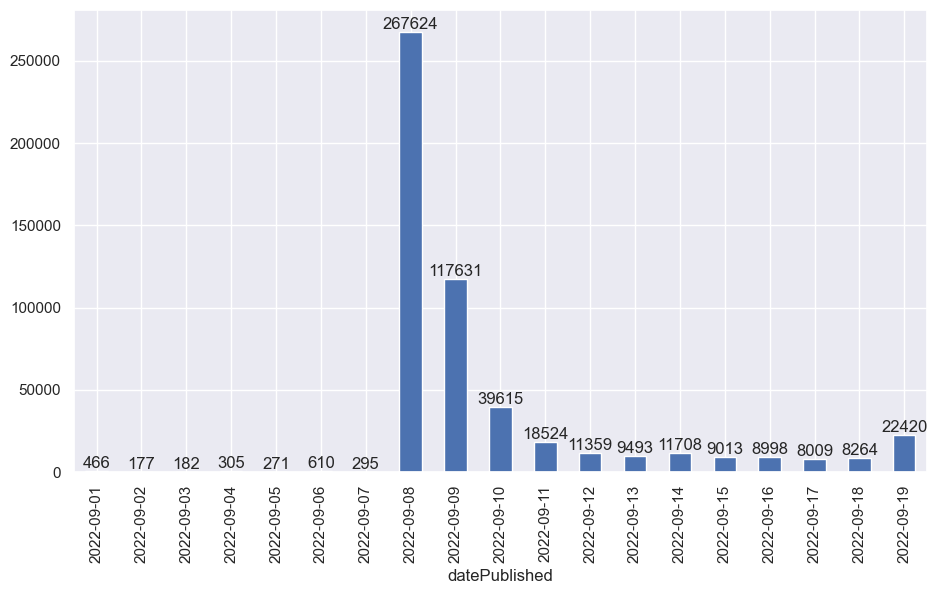

In [5]:
# explore the distrubtion of number of tweets each day 

sns.set(rc={'figure.figsize':(11,6)})

ax = df.groupby(['datePublished'])['id'].count().plot.bar()

#to deisplay the value above each bar
for i in ax.containers:
    ax.bar_label(i,)

### 2.2Top 10 lanuages tweets written in 

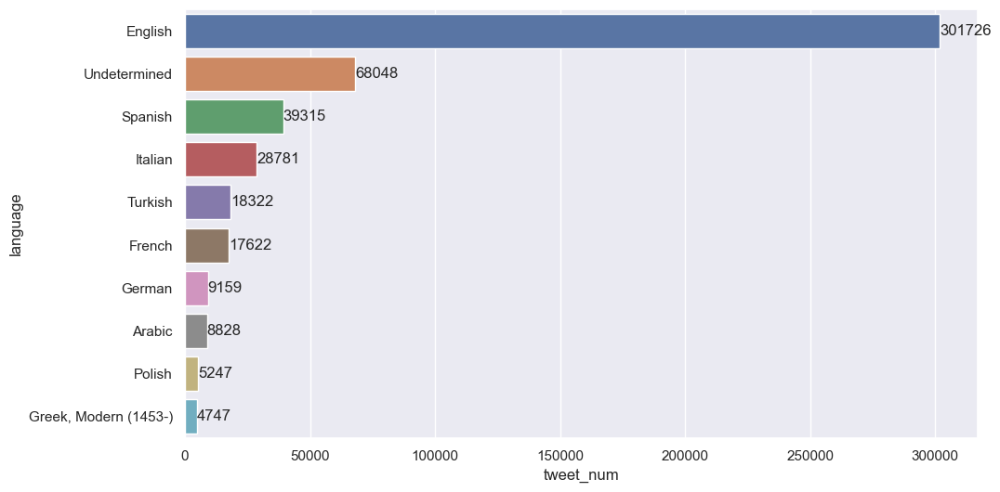

In [6]:
# filter top 10 common langages that tweets used and visualize  

lang = df.groupby(['inLanguage'])['id'].count().sort_values(ascending = False).head(10).reset_index()

lang = lang.rename(columns = {'inLanguage':'language','id' : 'tweet_num'})
lang

ax_lang = sns.barplot(x='tweet_num', y='language', data = lang, order = lang.sort_values('tweet_num',ascending = False).language) 
    
for i in ax_lang.containers:
    ax_lang.bar_label(i,)

### 2.3 Average Length  

In [7]:
#store the length of each tweet in a list 
#create a new column based on this list
len_tweet = []
for sent in df['text']:
    text = re.sub(r'https?\:\/\/[a-zA-Z0-9\-\.]+\.[a-zA-Z]{2,3}(\/\S*)?','',sent)
    len_tweet.append(len(text))

df['len_tweet'] = len_tweet
df['len_tweet']

0         182
1          37
2         162
3         241
4          82
         ... 
534959    205
534960     34
534961     34
534962     43
534963    144
Name: len_tweet, Length: 534964, dtype: int64

In [9]:
#the avergae length of all tweets
df['len_tweet'].mean()

127.49384818417688

In [10]:
#the median length of all tweets
df['len_tweet'].median()

109.0

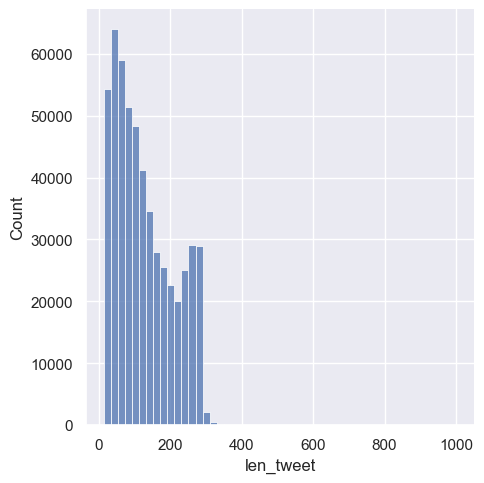

In [11]:
#visualize the distribution of length of the tweets 
df.groupby('len_tweet')
sns.displot(x='len_tweet', bins = 50 ,data=df) 

## 3.Social Network Analysis (SNA) of tweets 

The SNA would be executed by two tools: Python and Gephi. The node and edge files will be prepared here through python and visualizations are generated in Gephi.

### 3.1Data preparation for Gephi Visualization

#### 3.1.1Co-occurring Hashtag Network 

In [12]:
raw_hashtag = df["text"]
raw_hashtag.head()

0    My account of being arrested in #Oxford today ...
1    #FuckImperialism #AbolishTheMonarchy https://t...
2    @RedbirdEl We've had hostile government since ...
3    แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...
4    @BeckettUnite Ultimately, once the ceremonies ...
Name: text, dtype: object

In [13]:
#find all hashtag pairs cooccured in the same tweet

#extract hashtags from text in each row
data_cotag = []
for i in raw_hashtag:
    # each list returned contains every hashtag in the corresponding tweet
    tag = re.findall(r'#[\w\d]+', i) 
    # Combine the hashtags in each tweet in pairs 
    # indicate the co-occur relationship between two hashtags in the same tweet
    for co_tag in combinations(tag, 2):
        lst = list(co_tag)
        data_cotag.append(lst)
data_cotag


[['#Oxford', '#NotMyKing'],
 ['#Oxford', '#CharlesIII'],
 ['#Oxford', '#AbolishtheMonarchy'],
 ['#Oxford', '#NotMyKing'],
 ['#NotMyKing', '#CharlesIII'],
 ['#NotMyKing', '#AbolishtheMonarchy'],
 ['#NotMyKing', '#NotMyKing'],
 ['#CharlesIII', '#AbolishtheMonarchy'],
 ['#CharlesIII', '#NotMyKing'],
 ['#AbolishtheMonarchy', '#NotMyKing'],
 ['#FuckImperialism', '#AbolishTheMonarchy'],
 ['#Conservativeskill', '#CapitalismKills'],
 ['#Conservativeskill', '#ClassWar'],
 ['#Conservativeskill', '#AbolishTheMonarchy'],
 ['#Conservativeskill', '#AbolishTheHouseOfLords'],
 ['#Conservativeskill', '#ElectoralReformNow'],
 ['#CapitalismKills', '#ClassWar'],
 ['#CapitalismKills', '#AbolishTheMonarchy'],
 ['#CapitalismKills', '#AbolishTheHouseOfLords'],
 ['#CapitalismKills', '#ElectoralReformNow'],
 ['#ClassWar', '#AbolishTheMonarchy'],
 ['#ClassWar', '#AbolishTheHouseOfLords'],
 ['#ClassWar', '#ElectoralReformNow'],
 ['#AbolishTheMonarchy', '#AbolishTheHouseOfLords'],
 ['#AbolishTheMonarchy', '#Electo

In [14]:
# create a new dataframe containing only hashtags and co-occur hashtags
df_hashtag = pd.DataFrame(data_cotag, columns = ["hashtag","co-hashtag"])
df_hashtag

,hashtag,co-hashtag
0,#Oxford,#NotMyKing
1,#Oxford,#CharlesIII
2,#Oxford,#AbolishtheMonarchy
3,#Oxford,#NotMyKing
4,#NotMyKing,#CharlesIII
...,...,...
3744455,#Scotland,#QueenElizabeth
3744456,#QueenElizabethII,#QueenElizabeth
3744457,#QueenElizabeth,#queensfuneral
3744458,#QueenElizabeth,#RIPQueenElizabeth


In [15]:
#filter the hashtags that used to query the dataset 
indexHashtag = df_hashtag[(df_hashtag['hashtag'].isin(['#QueenElizabeth','#queenelizabeth','#QueueForTheQueen','#queueforthequeen','#AbolishTheMonarchy',
                             '#abolishthemonarchy'])) | (df_hashtag['co-hashtag'].isin(['#QueenElizabeth','#queenelizabeth','#QueueForTheQueen','#queueforthequeen','#AbolishTheMonarchy',
                             '#abolishthemonarchy']))].index
                            
df_hashtag.drop(indexHashtag , inplace=True)
df_hashtag

,hashtag,co-hashtag
0,#Oxford,#NotMyKing
1,#Oxford,#CharlesIII
2,#Oxford,#AbolishtheMonarchy
3,#Oxford,#NotMyKing
4,#NotMyKing,#CharlesIII
...,...,...
3744446,#Stocks,#StockstoWatch
3744447,#Stocks,#Inflation
3744449,#StockstoWatch,#Inflation
3744453,#QueenElizabethII,#RAFNortholt


In [16]:
# create the nodes file for co-occurring hashtag networks
a = pd.Series(df_hashtag["hashtag"].values, name = "hashtag")
b = pd.Series(df_hashtag["co-hashtag"].values, name = "hashtag")

# extract every single hashatag and assign id for them 
df_nodes = pd.concat([a,b]).to_frame().drop_duplicates()
df_nodes.reset_index(drop = True, inplace= True)
df_nodes["id"] = df_nodes.index + 1
df_nodes = df_nodes.loc[:,["id","hashtag"]] 
df_nodes

,id,hashtag
0,1,#Oxford
1,2,#NotMyKing
2,3,#CharlesIII
3,4,#AbolishtheMonarchy
4,5,#Conservativeskill
...,...,...
99661,99662,#talkingshit
99662,99663,#OPSWA
99663,99664,#tekst
99664,99665,#Willow


In [17]:
# save nodes dataframe to csv file, the path can be changed based on the location on your computer
df_nodes.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag_nodes.csv",index=False)

Create edge file for co-occuring hashtags 

In [18]:
# locate id number for each hashtag in two columns respectively 
df_rawedges = df_hashtag.join(df_nodes.set_index('hashtag'), on='hashtag')
df_rawedges = df_rawedges.join(df_nodes.set_index('hashtag'), on='co-hashtag',lsuffix="_1")
df_rawedges

,hashtag,co-hashtag,id_1,id
0,#Oxford,#NotMyKing,1,2
1,#Oxford,#CharlesIII,1,3
2,#Oxford,#AbolishtheMonarchy,1,4
3,#Oxford,#NotMyKing,1,2
4,#NotMyKing,#CharlesIII,2,3
...,...,...,...,...
3744446,#Stocks,#StockstoWatch,23819,82008
3744447,#Stocks,#Inflation,23819,2534
3744449,#StockstoWatch,#Inflation,82008,2534
3744453,#QueenElizabethII,#RAFNortholt,109,74777


In [19]:
#create the edges file
df_edges = df_rawedges.iloc[:,2:4].rename(columns={"id_1": "source", "id": "target"})
df_edges['type'] = 'undirected'
df_edges['weight'] = '1'
df_edges

,source,target,type,weight
0,1,2,undirected,1
1,1,3,undirected,1
2,1,4,undirected,1
3,1,2,undirected,1
4,2,3,undirected,1
...,...,...,...,...
3744446,23819,82008,undirected,1
3744447,23819,2534,undirected,1
3744449,82008,2534,undirected,1
3744453,109,74777,undirected,1


In [21]:
# save edges dataframe to csv file 
df_edges.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag_edges.csv",index=False)

#### 3.1.2Mention@ Network

In [22]:
raw_mention = df['text']
raw_mention

0         My account of being arrested in #Oxford today ...
1         #FuckImperialism #AbolishTheMonarchy https://t...
2         @RedbirdEl We've had hostile government since ...
3         แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...
4         @BeckettUnite Ultimately, once the ceremonies ...
                                ...                        
534959    Ferienparks @CenterParcsUK in Großbritannien s...
534960    #Scotland #QueenElizabeth 🏴󠁧󠁢󠁳󠁣󠁴󠁿 https://t.co...
534961    #QueenElizabethII #QueenElizabeth https://t.co...
534962    She's just passed overhead #QueenElizabeth htt...
534963    Just me… and I mean in the nicest possible way...
Name: text, Length: 534964, dtype: object

In [23]:
#extract mention@ from text in each row
#data_mention list contains every '@accountname' in the corresponding tweet

data_mention = []
for i in raw_mention:
    mention = re.findall(r'@[\w\d]+', i) 
    data_mention.append(mention)
data_mention

[['@BrightGrn'],
 [],
 ['@RedbirdEl'],
 [],
 ['@BeckettUnite'],
 ['@SevilleCalculat'],
 [],
 [],
 [],
 [],
 [],
 ['@chunkymark'],
 [],
 ['@CanadianPress', '@CdnPressPoli'],
 ['@RuthSampson11', '@BeckettUnite'],
 [],
 ['@EdinburghLive_'],
 [],
 ['@PhoenixWo1f'],
 ['@SholaMos1'],
 [],
 [],
 ['@AaronBastani', '@gemandmoll'],
 ['@BBCNews', '@Channel4News', '@itvnews', '@SkyNews'],
 ['@BeckettUnite'],
 ['@franceinfoplus'],
 [],
 [],
 [],
 [],
 ['@EdinburghLive_'],
 [],
 [],
 [],
 [],
 [],
 ['@Etsy'],
 [],
 [],
 ['@ScotNational'],
 ['@Markus_Soeder'],
 ['@TheSocialistDad'],
 [],
 [],
 ['@MsproNoshad'],
 [],
 ['@nytimes'],
 [],
 ['@EdinburghLive_'],
 ['@swanseagds', '@EMB46840636', '@HelenRSalisbury'],
 [],
 ['@BBCBreaking'],
 ['@Lolbeelolbee'],
 ['@zoeharcombe'],
 [],
 [],
 [],
 [],
 [],
 ['@JohnStanners', '@danbloom1'],
 ['@PromisesLabour', '@FUFowlers', '@JoshRomOnAir'],
 ['@WetSpamFan', '@Moonfiyah'],
 ['@ImInnocent1961'],
 ['@medievaltrees'],
 [],
 [],
 [],
 ['@CraigMurrayOrg'],
 [],
 ['

In [24]:
# form a new dataframe with authors and mentioned users in the tweets
author_mention = pd.DataFrame(
    {
        "author": df['author_alternateName'], 
        "mentioned_user": data_mention
    })
author_mention

,author,mentioned_user
0,@surethinzzpato,[@BrightGrn]
1,@zdravkov12,[]
2,@e_winzar,[@RedbirdEl]
3,@ChaiiInMunich,[]
4,@Think_Blue_Sky,[@BeckettUnite]
...,...,...
534959,@MarcBichtemann,[@CenterParcsUK]
534960,@MDplusthree,[]
534961,@topbrewer,[]
534962,@robinmuirhead,[]


In [25]:
# convert each elements in the list to a seperate cell value
# and drop rows showing NAN, where no mentioned users in one's tweet
author_mention = author_mention.explode('mentioned_user').dropna()
author_mention

,author,mentioned_user
0,@surethinzzpato,@BrightGrn
2,@e_winzar,@RedbirdEl
4,@Think_Blue_Sky,@BeckettUnite
5,@thescotsquine,@SevilleCalculat
11,@Think_Blue_Sky,@chunkymark
...,...,...
534944,@Ania_Raczkowska,@RadioZET_NEWS
534953,@felixsupreme305,@PapaOblock
534954,@spectralsailor,@UKLabour
534954,@spectralsailor,@Conservatives


In [26]:
# create the nodes file for 'mention@' relation
c = pd.Series(author_mention["author"].values, name = "user")
d = pd.Series(author_mention["mentioned_user"].values, name = "user")

# extract every single user and assign id for them 
df_nodes_1 = pd.concat([c,d]).to_frame().drop_duplicates()
df_nodes_1.reset_index(drop = True, inplace= True)
df_nodes_1["id"] = df_nodes_1.index + 1
df_nodes_1 = df_nodes_1.loc[:,["id","user"]] 
df_nodes_1


,id,user
0,1,@surethinzzpato
1,2,@e_winzar
2,3,@Think_Blue_Sky
3,4,@thescotsquine
4,5,@MoCooray
...,...,...
103106,103107,@PrinceHarryMar1
103107,103108,@LanaWolf1872
103108,103109,@PeacockTVCare
103109,103110,@BBCSurreyTravel


In [27]:
# save the nodes file as csv file
df_nodes_1.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\mention_nodes.csv",index=False)

In [28]:
# locate id number for each user in two columns respectively 
df_rawedges_1 = author_mention.join(df_nodes_1.set_index('user'), on='author')
df_rawedges_1 = df_rawedges_1.join(df_nodes_1.set_index('user'), on='mentioned_user',lsuffix="_1")
df_rawedges_1

,author,mentioned_user,id_1,id
0,@surethinzzpato,@BrightGrn,1,45826
2,@e_winzar,@RedbirdEl,2,46
4,@Think_Blue_Sky,@BeckettUnite,3,45827
5,@thescotsquine,@SevilleCalculat,4,45828
11,@Think_Blue_Sky,@chunkymark,3,45829
...,...,...,...,...
534944,@Ania_Raczkowska,@RadioZET_NEWS,1970,48376
534953,@felixsupreme305,@PapaOblock,45823,103111
534954,@spectralsailor,@UKLabour,45824,45979
534954,@spectralsailor,@Conservatives,45824,45994


In [29]:
# create a edges file  
df_edges_1 = df_rawedges_1.iloc[:,2:4].rename(columns={"id_1": "source", "id": "target"})
df_edges_1['type'] = 'directed'
df_edges_1['weight'] = '1'
df_edges_1 

,source,target,type,weight
0,1,45826,directed,1
2,2,46,directed,1
4,3,45827,directed,1
5,4,45828,directed,1
11,3,45829,directed,1
...,...,...,...,...
534944,1970,48376,directed,1
534953,45823,103111,directed,1
534954,45824,45979,directed,1
534954,45824,45994,directed,1


In [30]:
# save the edges dataframe as csv file
df_edges_1.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\mention_edges.csv",index=False)

#### 3.1.3Reply Network

In [31]:
# locate coloumns of senders and recipients, which indicates the "reply to" relationship  
reply_to = df[['sender_alternateName','recipient_alternateName']].dropna()
reply_to

,sender_alternateName,recipient_alternateName
2,@e_winzar,@RedbirdEl
4,@Think_Blue_Sky,@BeckettUnite
5,@thescotsquine,@SevilleCalculat
11,@Think_Blue_Sky,@chunkymark
14,@Whirleysloth,@RuthSampson11
...,...,...
534903,@orangeplanetuk,@BBCBreaking
534910,@CindyWh44947139,@hrrysgreysuit
534913,@NancyLipschult2,@QueenLilibet_
534919,@GadgetMichael,@itvnews


In [32]:
# create a nodes file 
e = pd.Series(reply_to["sender_alternateName"].values, name = "user")
f = pd.Series(reply_to["recipient_alternateName"].values, name = "user")

# extract evry signle user name (containing all sends' and recipents' name) and assign id for them
df_nodes_2 = pd.concat([e,f]).to_frame().drop_duplicates()
df_nodes_2.reset_index(drop = True, inplace= True)
df_nodes_2["id"] = df_nodes_2.index + 1
df_nodes_2 = df_nodes_2.loc[:,["id","user"]] 
df_nodes_2

,id,user
0,1,@e_winzar
1,2,@Think_Blue_Sky
2,3,@thescotsquine
3,4,@Whirleysloth
4,5,@123facts123
...,...,...
48309,48310,@twittersecurity
48310,48311,@AscensoInglesok
48311,48312,@EmergencyBod
48312,48313,@LanaWolfUK


In [33]:
# save the nodes dataframe as csv file  
df_nodes_2.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\replyto_nodes.csv",index=False)

In [34]:
# locate id number for each user name in two columns respectively 
df_rawedges_2 = reply_to.join(df_nodes_2.set_index('user'), on='sender_alternateName')
df_rawedges_2 = df_rawedges_2.join(df_nodes_2.set_index('user'), on='recipient_alternateName',lsuffix="_1")
df_rawedges_2

,sender_alternateName,recipient_alternateName,id_1,id
2,@e_winzar,@RedbirdEl,1,38
4,@Think_Blue_Sky,@BeckettUnite,2,25671
5,@thescotsquine,@SevilleCalculat,3,25672
11,@Think_Blue_Sky,@chunkymark,2,25673
14,@Whirleysloth,@RuthSampson11,4,25674
...,...,...,...,...
534903,@orangeplanetuk,@BBCBreaking,25669,25685
534910,@CindyWh44947139,@hrrysgreysuit,483,27872
534913,@NancyLipschult2,@QueenLilibet_,25670,12726
534919,@GadgetMichael,@itvnews,23894,25781


In [35]:
# form a edges file 
df_edges_2 = df_rawedges_2.iloc[:,2:4].rename(columns={"id_1": "source", "id": "target"})
df_edges_2['type'] = 'directed'
df_edges_2['weight'] = '1'
df_edges_2 

,source,target,type,weight
2,1,38,directed,1
4,2,25671,directed,1
5,3,25672,directed,1
11,2,25673,directed,1
14,4,25674,directed,1
...,...,...,...,...
534903,25669,25685,directed,1
534910,483,27872,directed,1
534913,25670,12726,directed,1
534919,23894,25781,directed,1


In [36]:
# save the edges dataframe as csv file
df_edges_2.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\replyto_edges.csv",index=False)

### 3.2 Gephi Visualization

The manipulations of network visualization are conducted in Gephi.Let's open Gephi and run the following file.

* [Hashtag.gephi](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Social%20Network%20Analysis/Gephi%20File/Hashtag_community_dec.gephi)
* [Mention.gephi](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Social%20Network%20Analysis/Gephi%20File/mention.gephi)
* [Replyto.gephi](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Social%20Network%20Analysis/Gephi%20File/Replyto.gephi)

Related node and edge file can be found [here](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/tree/main/Social%20Network%20Analysis/Node%20%26%20Edge%20File) 


You can also compare your trial with the completed visualizations here:  

* [Mention network visualizations from four metrics](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/mention_vis.png)  
* [Reply network visualizations from four metrics](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/reply_vis.jpg)  
* [co-occurring hashtag network visualization](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Social%20Network%20Analysis/Gephi%20File/hashtag_commu.png)

You will find the visualization of hashtag network is different from the other two, because the volume of data for hashtag nodes and edges is too large to work with in Gephi. To find the most apprend outcome, I manually filter it in Python using the criteria that the edge weight should be greater than or equal to 100. Afterwards, the results will be exported from Python to import back into Gephi for visualization.

#### Hashtag Network: Filtering  

The file read here is the edge file exported from Gephi with weight merged, where the weight for same edge would be summed.  
The processed file [hashtag edge with weight](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Social%20Network%20Analysis/hashtag%20edge%20with%20weight.graphml.csv) can be downloaded from my github. 

In [38]:
# the path can be changed to the location where you store the "hashtag edge file with weight" file
df_tag_weight = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag edge with weight.graphml.csv")
df_tag_weight

,Source,Target,Type,Id,Label,timeset,Weight
0,1,2,Undirected,2749608,NaN,NaN,7
1,1,3,Undirected,2749609,NaN,NaN,4
2,1,4,Undirected,2749610,NaN,NaN,3
3,2,3,Undirected,2749612,NaN,NaN,72
4,2,4,Undirected,2749613,NaN,NaN,45
...,...,...,...,...,...,...,...
986822,82007,23819,Undirected,5499208,NaN,NaN,1
986823,82007,82008,Undirected,5499209,NaN,NaN,1
986824,82007,2534,Undirected,5499210,NaN,NaN,1
986825,23819,82008,Undirected,5499211,NaN,NaN,1


In [39]:
bools = df_tag_weight['Weight'] > 99
df_filtered = df_tag_weight[bools]
df_filtered

,Source,Target,Type,Id,Label,timeset,Weight
5,2,2,Undirected,2749614,NaN,NaN,210
189,2,55,Undirected,2749803,NaN,NaN,675
216,2,139,Undirected,2749836,NaN,NaN,290
223,40,13618,Undirected,2749843,NaN,NaN,112
232,42,45,Undirected,2749852,NaN,NaN,119
...,...,...,...,...,...,...,...
897382,1038,97,Undirected,5180044,NaN,NaN,213
899968,214,10903,Undirected,5186200,NaN,NaN,220
902437,10903,2067,Undirected,5194037,NaN,NaN,218
912623,10903,97,Undirected,5227741,NaN,NaN,212


In [40]:
#save the result filtered 
df_filtered.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag edge with weight100.csv",index=False)

### 3.3 Text Mining of Key Users 

From the result of mention and reply network, we can see that @Arad87709987, @nika6547, @talhamuneeb7700, and @Brijend84228427 show the significance in out-degree centrality measures. So let's mine the tweets of these accounts throught two means: aggregate hashtags they used and examine the frequent word in the tweets of each user.  

#### 3.3.1 Text Analysis of tweets of the account '@Arad87709987'

In [41]:
#group all tweets text of the account
df_m1 = df.loc[df['author_alternateName'] == '@Arad87709987'][['author_alternateName','text']]
df_m1

,author_alternateName,text
159371,@Arad87709987,@rothdanielle Queen has expired. It should hav...
159386,@Arad87709987,@rothdanielle @IsraelHayomHeb @BismuthBoaz @Ar...
159440,@Arad87709987,@Now14Israel @Arielidan20 Queen has expired. I...
159448,@Arad87709987,@Arielidan20 Queen has expired. It should have...
159475,@Arad87709987,@Now14Israel @MaggieTabibi @ornitfsw Queen has...
...,...,...
335228,@Arad87709987,@LeandroSelister The Queen’s consumption date ...
335243,@Arad87709987,@gofiliberto The Queen’s consumption date is o...
342033,@Arad87709987,@BBCBreaking The Queen’s consumption date is o...
342063,@Arad87709987,@BBCBreaking The Queen’s consumption date is o...


In [42]:
#extract all hashtags, and store in a list
m1_tag = []
for x in df_m1['text']:
    tag = re.findall(r'#[\w\d]+', x) 
    for hashtag in tag:
        m1_tag.append(hashtag)
m1_tag

#create a dataframe based on the list m1_tag
df_m1_tag = pd.DataFrame(
    {
        "index" : range(len(m1_tag)),
        "m1_hashtag": m1_tag}) 
df_m1_tag

,index,m1_hashtag
0,0,#Queen
1,1,#Elizabeth
2,2,#QueenElizabeth
3,3,#Queen
4,4,#Elizabeth
...,...,...
2471,2471,#Elizabeth
2472,2472,#QueenElizabeth
2473,2473,#Queen
2474,2474,#Elizabeth


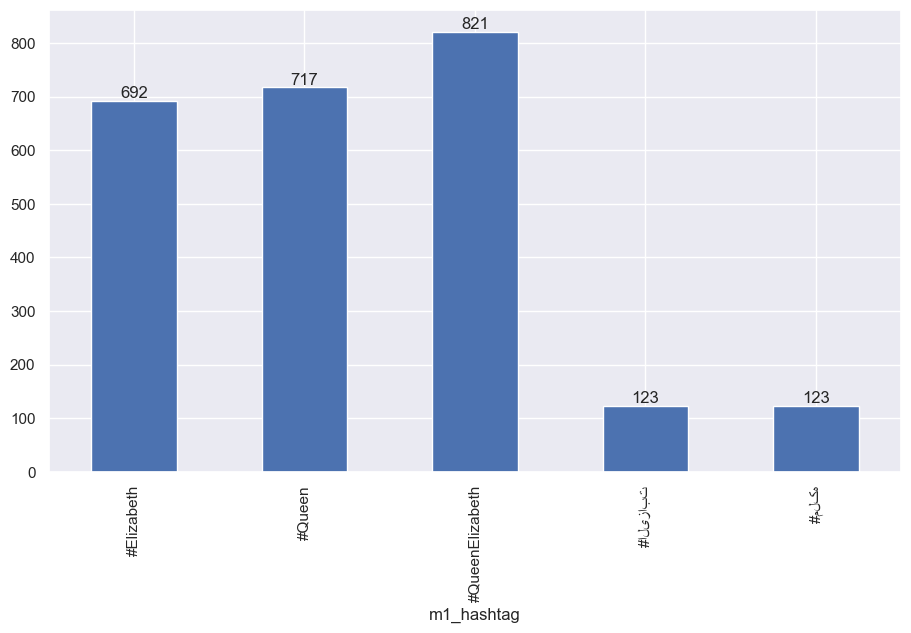

In [43]:
#visualize the hashtag aggregation 

sns.set(rc={'figure.figsize':(11,6)})

ax_m1=df_m1_tag.groupby(['m1_hashtag'])["index"].count().plot.bar()

for m in ax_m1.containers:
    ax_m1.bar_label(m,)

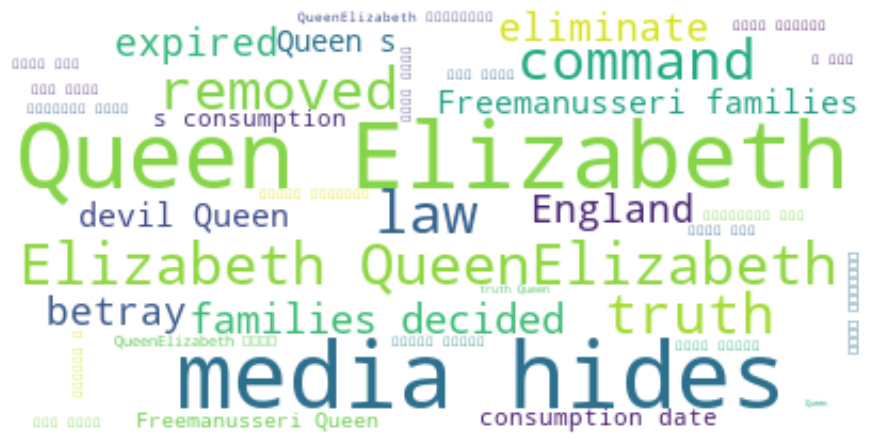

In [44]:
# create the word cloud to show the word frequency 
txt_lst = []
for t in df_m1['text']:
    txt_lst.append(t)
    text = " ".join(txt_lst)

wordcloud = WordCloud(background_color = 'white').generate(text)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#### 3.3.2 Text Analysis of tweets of the account '@talhamuneeb7700'

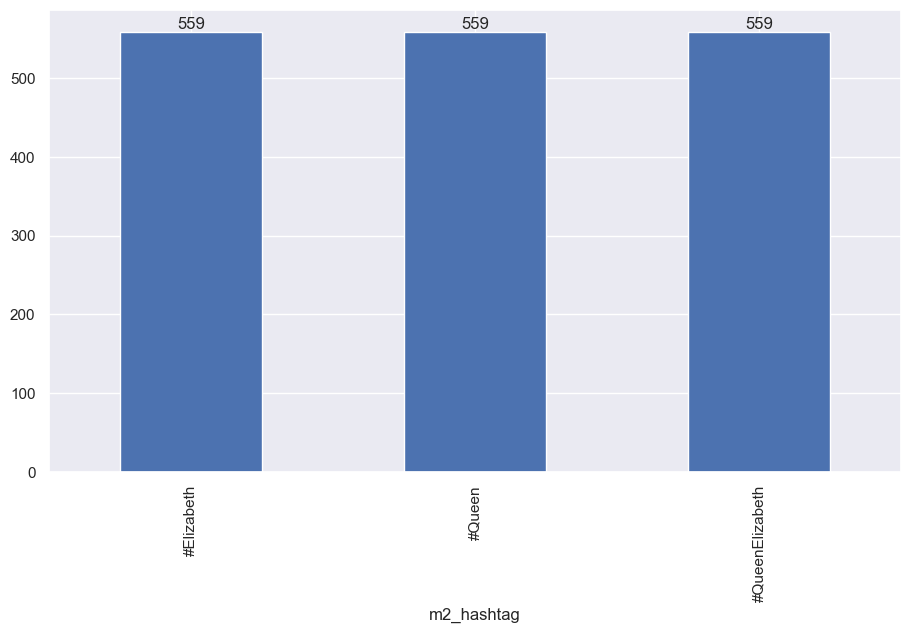

In [45]:
#group all tweet texts of the account '@talhamuneeb7700'
df_m2 = df.loc[df['author_alternateName'] == '@talhamuneeb7700'][['author_alternateName','text']]

#extract hashtags and store them in the list 
m2_tag = []
for y in df_m2['text']:
    tag2 = re.findall(r'#[\w\d]+', x) 
    for hashtag2 in tag2:
        m2_tag.append(hashtag2)

#create a dataframe based on the previous list m2_tag
df_m2_tag = pd.DataFrame(
    {
        "index" : range(len(m2_tag)),
        "m2_hashtag": m2_tag})

#visualize the hashtag aggregation

sns.set(rc={'figure.figsize':(11,6)})
ax_m2=df_m2_tag.groupby(['m2_hashtag'])["index"].count().plot.bar()
for m in ax_m2.containers:
    ax_m2.bar_label(m,)

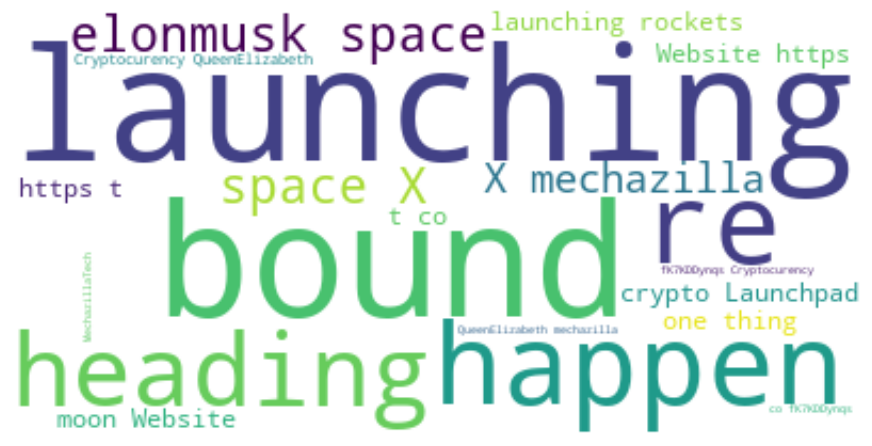

In [46]:
# create the word cloud to show the word frequency 
txt2_lst = []
for t2 in df_m2['text']:
    txt2_lst.append(t2)
    text2 = " ".join(txt2_lst)

wordcloud = WordCloud(background_color = 'white').generate(text2)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#### 3.3.3 Text Analysis of tweets of the account '@talhamuneeb7700'

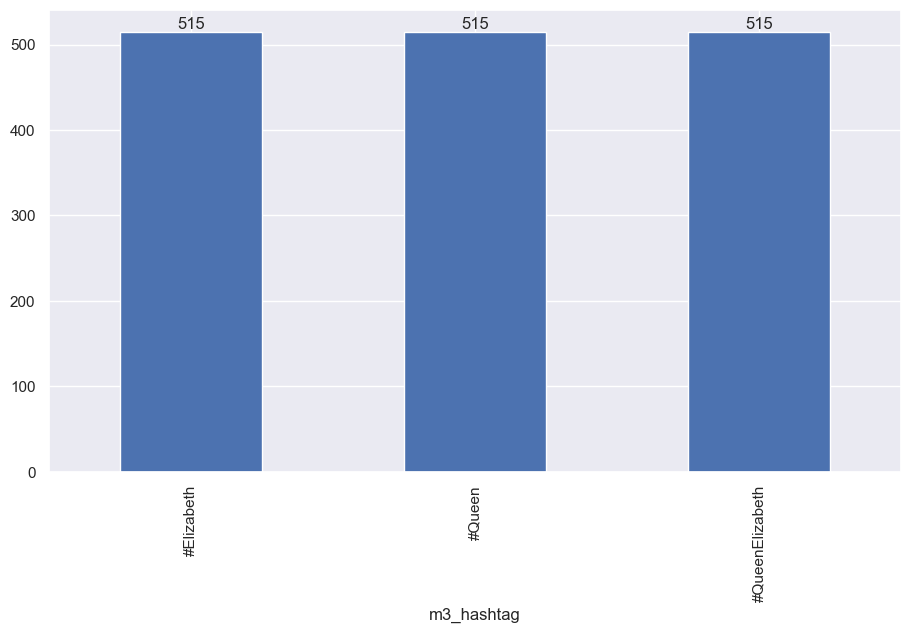

In [48]:
# group all tweet texts of the account '@lordweapon7228'
df_m3 = df.loc[df['author_alternateName'] == '@lordweapon7228'][['author_alternateName','text']]

#extract hashtags and store them in the list 
m3_tag = []
for z in df_m3['text']:
    tag3 = re.findall(r'#[\w\d]+', x) 
    for hashtag3 in tag3:
        m3_tag.append(hashtag3)

#create a dataframe based on the previous list m3_tag
df_m3_tag = pd.DataFrame(
    {
        "index" : range(len(m3_tag)),
        "m3_hashtag": m3_tag})

#visualize the hashtag aggregation
sns.set(rc={'figure.figsize':(11,6)})
ax_m3=df_m3_tag.groupby(['m3_hashtag'])["index"].count().plot.bar()
for m in ax_m3.containers:
    ax_m3.bar_label(m,)

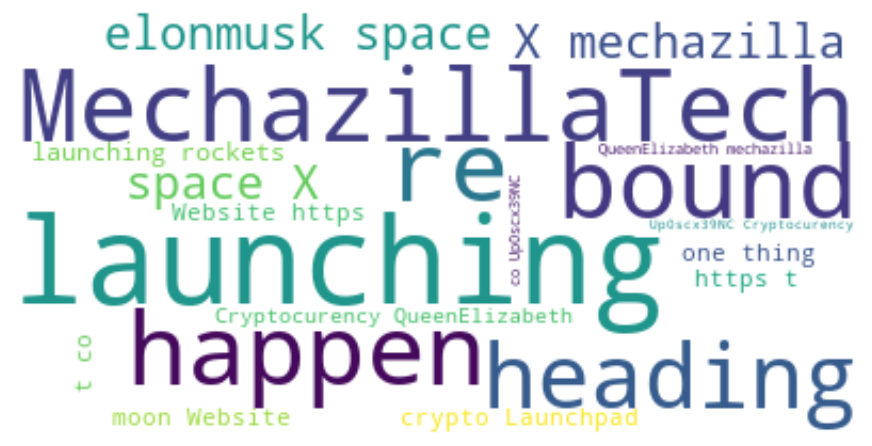

In [49]:
# create the word cloud to show the word frequency 

txt3_lst = []
for t3 in df_m3['text']:
    txt3_lst.append(t3)
    text3 = " ".join(txt3_lst)

wordcloud = WordCloud(background_color = 'white').generate(text3)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#### 3.3.4 Text Analysis of tweets of the account '@nika6547'

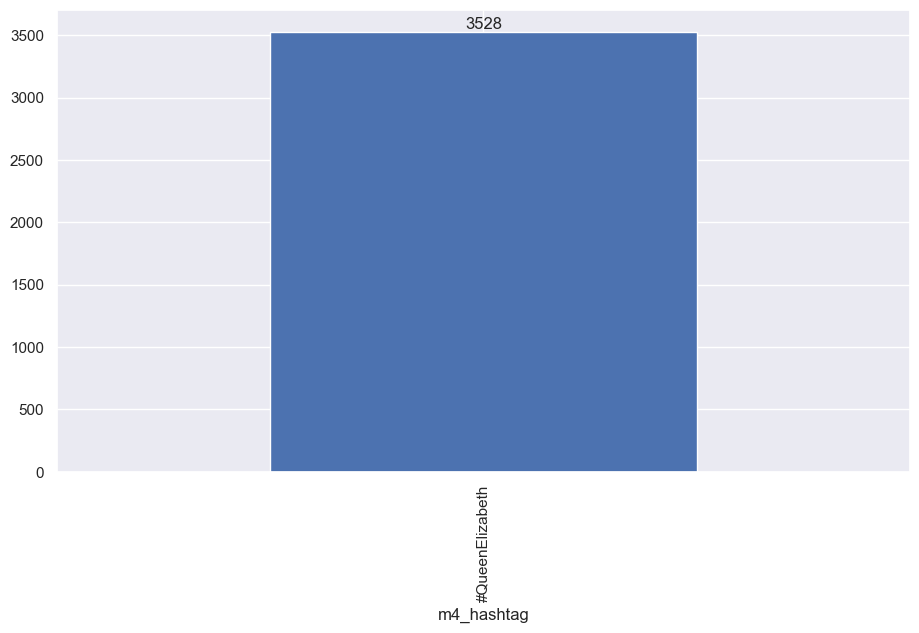

In [50]:
# group all tweet texts of the account '@nika6547'
df_m4 = df.loc[df['author_alternateName'] == '@nika6547'][['author_alternateName','text']]

# extract hashtags and store them in the list 
m4_tag = []
for z in df_m4['text']:
    tag4 = re.findall(r'#[\w\d]+', x) 
    for hashtag4 in tag4:
        m4_tag.append(hashtag3)

# create a dataframe based on the previous list m4_tag
df_m4_tag = pd.DataFrame(
    {
        "index" : range(len(m4_tag)),
        "m4_hashtag": m4_tag})

# visualize the hashtag aggregation
sns.set(rc={'figure.figsize':(11,6)})
ax_m4=df_m4_tag.groupby(['m4_hashtag'])["index"].count().plot.bar()
for m in ax_m4.containers:
    ax_m4.bar_label(m,)

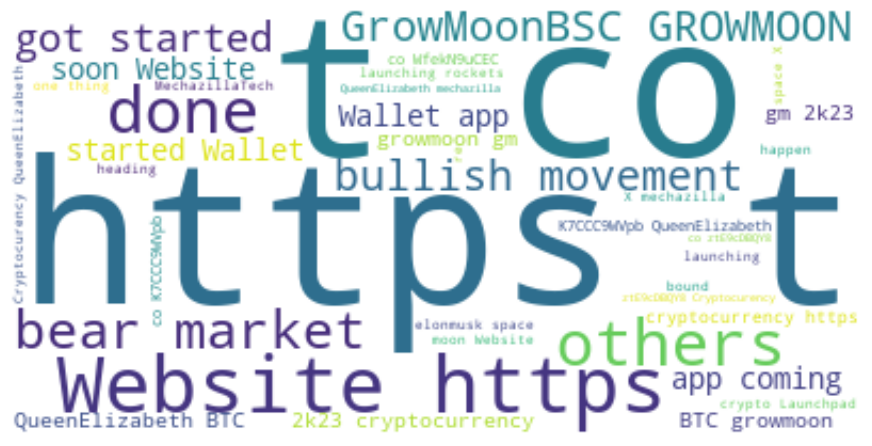

In [51]:
# create the word cloud to show the word frequency 
txt4_lst = []
for t4 in df_m4['text']:
    txt4_lst.append(t4)
    text4 = " ".join(txt4_lst)
    
wordcloud = WordCloud(background_color = 'white').generate(text4)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

Further interpretation of these four users and their tweet content is provided in the internship thesis.

#### 3.3.5 Text Analysis of tweets of the account '@HighwaySqueak'  

On the other hand, @HighwaySqueak shows as the most important gatekeeper in both mention and reply network, employing the largest influence on information transmission through the networks. Thus, let's also mine the hashtags and frequent words of this account.  


In [52]:
# group all tweet texts of the account '@HighwaySqueak'
df_m5 = df.loc[df['author_alternateName'] == '@HighwaySqueak'][['author_alternateName','text']]

# extract hashtags and store them in the list 
m5_tag = []
for q in df_m5['text']:
    tag5 = re.findall(r'#[\w\d]+', q) 
    for hashtag5 in tag5:
        m5_tag.append(hashtag5)

# create a dataframe based on the previous list m4_tag
df_m5_tag = pd.DataFrame(
    {
        "index" : range(len(m5_tag)),
        "m5_hashtag": m5_tag})

# extract the top 5 most common hashtags 
df_m5_tag.groupby(['m5_hashtag'])["index"].count().sort_values(ascending = False).head(5)

m5_hashtag
#AbolishTheMonarchy    271
#NotMyKing             132
#NotMyPrince            71
#IndyWales              21
#EnoughIsEnough         13
Name: index, dtype: int64

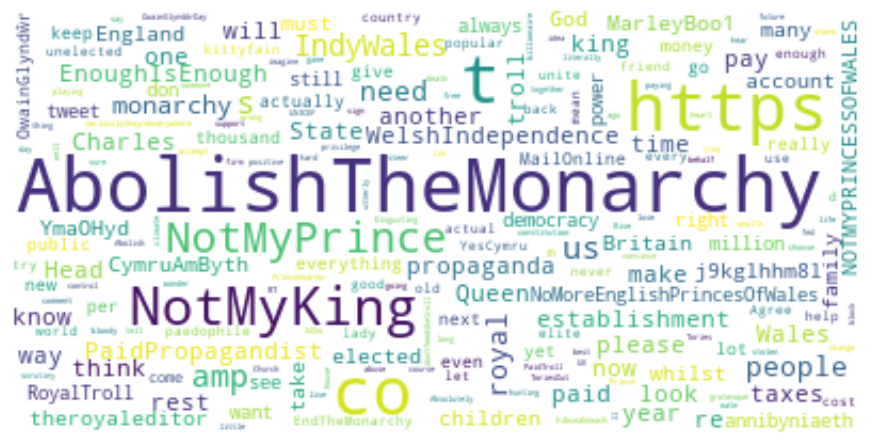

In [53]:
# create the word cloud to show the word frequency 
txt5_lst = []
for t5 in df_m5['text']:
    txt5_lst.append(t5)
text5 = " ".join(txt5_lst)

wordcloud = WordCloud(background_color = 'white', collocations=False).generate(text5)

# Display the generated image:
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis("off")
plt.show()


## 4.Text Analysis

In this phase, all English written tweets will be analyzed by two ways: word cloud generation and topic modeling. First, raw texts need to be preprocessed with the common Natual Language Processing (NLP) pipeline with removing emojis, punctuations, tokenizing, lemmetizaing, ect. But since the way this dataset retrieved, the hashtags used for query would appear more frequently, which leads to bais of the result. To emlinate this, **the preprocessed data for word cloud excludes all hashtags**. But in topic modeling, the hashtags are important as they imply the summary of the tweet. Thus, **the preprocessed data for topic modeling includes all hashtags**. Afterwards, world cloud and topic modeling will be conducted.

### 4.1Data preporcessing

All text data is manipulated under the pandas dataframe, where new extended columns are created to store the result of last performance.

In [54]:
# first filter tweets in English
df_en = df.loc[df['inLanguage']=='English'].loc[:,['datePublished','text']]
df_en

,datePublished,text
0,2022-09-12,My account of being arrested in #Oxford today ...
2,2022-09-12,@RedbirdEl We've had hostile government since ...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin..."
6,2022-09-12,"Along with the Queen, Britain is laying to res..."
...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...


**Removing Hashtags or not**  
* Preprocessing1 with removing hashtags: Initiate the following codes to remove hashtags and conduct all subsequent preprocessing manipulation  
* Preprocessing2 with keeping hashtags: Skip the following the codes and start preprocessing from [4.1.1Emoji & Url Removel](#-4.1.1Emoji-&-Url-Removel)

NOTE: It could be better to save both results as csv.file into local computer to avoid running of these processes repeatedly.

In [55]:
# define a function to remove all hashtags
def hashtag_removal(text):
    text_free_of_hashtag = re.sub(r'#\w+','',text)
    return text_free_of_hashtag

df_en['no_hashtags'] = df_en['text'].apply(hashtag_removal)
df_en

,datePublished,text,no_hashtags
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin..."
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res..."
...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...


#### 4.1.1Emoji & Url Removel

In [56]:
# define funtions to remove emojis and urls in the tweet texts

def emoji_removal(text):
    clean_text = emoji.replace_emoji(text, replace = '')
    return clean_text

def URL_removal(text):
    text = re.sub(r'https?\:\/\/[a-zA-Z0-9\-\.]+\.[a-zA-Z]{2,3}(\/\S*)?','',text)
    return text

# Apply the function to get tweets without emojis
df_en['no_emoji_tweets'] = df_en['text'].apply(emoji_removal)

# Create a new column with no url tweets
df_en['no_url_tweets'] = df_en['no_emoji_tweets'].apply(URL_removal)

df_en

,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin..."
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res..."
...,...,...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth


#### 4.1.2 Punctuation Removel 

In [57]:
# define a function to remove all punctuation and hashtag 

def punctuation_removal(text):
    text_free_of_punctuation = re.sub(r'[^\w\s]', '', text)
    return text_free_of_punctuation

df_en['no_punctuation'] = df_en['no_url_tweets'].apply(punctuation_removal)
df_en

,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets,no_punctuation
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...,My account of being arrested in Oxford today f...
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,RedbirdEl Weve had hostile government since 1...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...",BeckettUnite Ultimately once the ceremonies ar...
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...",SevilleCalculat Meanwhile from someone living ...
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...",Along with the Queen Britain is laying to rest...
...,...,...,...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners amp Losers Stocks Tank Af...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...,QueenElizabethII QueenElizabeth over Stoke on ...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of StokeonTrent ...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth,Shes just passed overhead QueenElizabeth


#### 4.1.3Tokenization and stopwords removal

In [58]:
# define functions to tokenize the text and remove stopwords 

def tokenization(text):
    return [token.lower() for token in nltk.word_tokenize(text)]

def stopwords_removal(corpus):
    corpus_filtered = [token for token in corpus if not token in stopwords.words('english')]
    return corpus_filtered


In [80]:
# apply functions above and create new coloumns to disply results: tokens_without_punctuations, tokens_without_stopwords

df_en_copy = df_en.copy() # avoid over write the results on the original file
df_en_copy['tokens_without_punctuation'] = df_en_copy['no_punctuation'].apply(tokenization)
df_en_copy['tokens_without_stopwords'] = df_en_copy['tokens_without_punctuation'].apply(stopwords_removal)

df_en_copy

,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets,no_punctuation,tokens_without_punctuation,tokens_without_stopwords
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...,My account of being arrested in Oxford today f...,"[my, account, of, being, arrested, in, oxford,...","[account, arrested, oxford, today, voicing, an..."
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,RedbirdEl Weve had hostile government since 1...,"[redbirdel, weve, had, hostile, government, si...","[redbirdel, weve, hostile, government, since, ..."
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...",BeckettUnite Ultimately once the ceremonies ar...,"[beckettunite, ultimately, once, the, ceremoni...","[beckettunite, ultimately, ceremonies, abolish..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...",SevilleCalculat Meanwhile from someone living ...,"[sevillecalculat, meanwhile, from, someone, li...","[sevillecalculat, meanwhile, someone, living, ..."
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...",Along with the Queen Britain is laying to rest...,"[along, with, the, queen, britain, is, laying,...","[along, queen, britain, laying, rest, sacred, ..."
...,...,...,...,...,...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners amp Losers Stocks Tank Af...,"[stock, market, winners, amp, losers, stocks, ...","[stock, market, winners, amp, losers, stocks, ..."
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...,QueenElizabethII QueenElizabeth over Stoke on ...,"[queenelizabethii, queenelizabeth, over, stoke...","[queenelizabethii, queenelizabeth, stoke, tren..."
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of StokeonTrent ...,"[now, passing, just, to, the, east, of, stokeo...","[passing, east, stokeontrent, 23000ft, queenel..."
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth,Shes just passed overhead QueenElizabeth,"[shes, just, passed, overhead, queenelizabeth]","[shes, passed, overhead, queenelizabeth]"


In [81]:
# If you are conducting preprocessing1 with removing hashtasg,run this code to save the result temporarily
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_no_hashtag.csv") 

In [ ]:
# If you are conducting preprocessing2 with keeping hashtasg,run this code to save the result temporarily
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_hashtag.csv") 

Since there are numerous for loop running on top of our large-volumned dataset in this stage, it would take more than 10 hours to complete.   
So, if you want to run the subsequent codes after this step by yourself, please feel free to read csv. file[corpus_no_hashtag](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Text%20Analysis/corpus-no-hashtag.zip) and continue.

NOTE:If you load the [corpus_no_hashtag.csv](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Text%20Analysis/corpus-no-hashtag.zip) or [corpus_hashtags.csv](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Text%20Analysis/corpus-hashtag.zip) to continue, please use the function str2lst to convert string content back to corpus list.

In [61]:
# define a function to transfer string to list 
def str2lst(string):
    string = str(string)
    return string.split(', ')

# use codses here to load result from last step 
# but the previous lists in each cells become string after saving
# so "[]" and "''" are deleted by openrefine in advance to simplify converting string back to list

df_en_copy = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus-no-hashtag.csv")
df_en_copy['tokens_without_stopwords'] = df_en_copy['tokens_without_stopwords'].apply(str2lst)
df_en_copy

,Column,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets,no_punctuation,tokens_without_punctuation,tokens_without_stopwords
0,0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...,My account of being arrested in Oxford today f...,"my, account, of, being, arrested, in, oxford, ...","[account, arrested, oxford, today, voicing, an..."
1,2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,RedbirdEl Weve had hostile government since 1...,"redbirdel, weve, had, hostile, government, sin...","[redbirdel, weve, hostile, government, since, ..."
2,4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...",BeckettUnite Ultimately once the ceremonies ar...,"beckettunite, ultimately, once, the, ceremonie...","[beckettunite, ultimately, ceremonies, abolish..."
3,5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...",SevilleCalculat Meanwhile from someone living ...,"sevillecalculat, meanwhile, from, someone, liv...","[sevillecalculat, meanwhile, someone, living, ..."
4,6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...",Along with the Queen Britain is laying to rest...,"along, with, the, queen, britain, is, laying, ...","[along, queen, britain, laying, rest, sacred, ..."
...,...,...,...,...,...,...,...,...,...
301721,534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners amp Losers Stocks Tank Af...,"stock, market, winners, amp, losers, stocks, t...","[stock, market, winners, amp, losers, stocks, ..."
301722,534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...,QueenElizabethII QueenElizabeth over Stoke on ...,"queenelizabethii, queenelizabeth, over, stoke,...","[queenelizabethii, queenelizabeth, stoke, tren..."
301723,534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of StokeonTrent ...,"now, passing, just, to, the, east, of, stokeon...","[passing, east, stokeontrent, 23000ft, queenel..."
301724,534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth,Shes just passed overhead QueenElizabeth,"shes, just, passed, overhead, queenelizabeth","[shes, passed, overhead, queenelizabeth]"


#### 4.1.4Stemming & Lemmatization

In [62]:
# define a funtion to conduct Lemmatization
def lemmatization(corpus): 
    
    # Create WordNetLemmatizer object 
    wnl = WordNetLemmatizer()
    
    corpus_lemmas = []
    for word in corpus:
        word = wnl.lemmatize(word)
        corpus_lemmas.append(word)
    return corpus_lemmas

# apply lemmatization into df_en_copy
df_en_copy['tokens_lemma'] = df_en_copy['tokens_without_stopwords'].apply(lemmatization)
df_en_copy

,Column,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets,no_punctuation,tokens_without_punctuation,tokens_without_stopwords,tokens_lemma
0,0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...,My account of being arrested in Oxford today f...,"my, account, of, being, arrested, in, oxford, ...","[account, arrested, oxford, today, voicing, an...","[account, arrested, oxford, today, voicing, an..."
1,2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,RedbirdEl Weve had hostile government since 1...,"redbirdel, weve, had, hostile, government, sin...","[redbirdel, weve, hostile, government, since, ...","[redbirdel, weve, hostile, government, since, ..."
2,4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...",BeckettUnite Ultimately once the ceremonies ar...,"beckettunite, ultimately, once, the, ceremonie...","[beckettunite, ultimately, ceremonies, abolish...","[beckettunite, ultimately, ceremony, abolishth..."
3,5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...",SevilleCalculat Meanwhile from someone living ...,"sevillecalculat, meanwhile, from, someone, liv...","[sevillecalculat, meanwhile, someone, living, ...","[sevillecalculat, meanwhile, someone, living, ..."
4,6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...",Along with the Queen Britain is laying to rest...,"along, with, the, queen, britain, is, laying, ...","[along, queen, britain, laying, rest, sacred, ...","[along, queen, britain, laying, rest, sacred, ..."
...,...,...,...,...,...,...,...,...,...,...
301721,534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners amp Losers Stocks Tank Af...,"stock, market, winners, amp, losers, stocks, t...","[stock, market, winners, amp, losers, stocks, ...","[stock, market, winner, amp, loser, stock, tan..."
301722,534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...,QueenElizabethII QueenElizabeth over Stoke on ...,"queenelizabethii, queenelizabeth, over, stoke,...","[queenelizabethii, queenelizabeth, stoke, tren...","[queenelizabethii, queenelizabeth, stoke, tren..."
301723,534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of StokeonTrent ...,"now, passing, just, to, the, east, of, stokeon...","[passing, east, stokeontrent, 23000ft, queenel...","[passing, east, stokeontrent, 23000ft, queenel..."
301724,534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth,Shes just passed overhead QueenElizabeth,"shes, just, passed, overhead, queenelizabeth","[shes, passed, overhead, queenelizabeth]","[shes, passed, overhead, queenelizabeth]"


In [ ]:
# If you are conducting preprocessing1 with removing hashtasg, activate this code
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_no_hashtag_final.csv") 

In [ ]:
# If you are conducting preprocessing1 with keeping hashtasg, activate this code
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_hashtag_final.csv") 

### 4.2 Word Cloud of the Most Frequent 100 words

Using the corpus_no_hashtag_final.csv, the most frequent 100 tokens are extracted, based on which a word cloud is generated. 

In [63]:
# load the corpus_no_hashtag_final.csv file to initiate

df_en_copy1 = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus-no-hashtag-final.csv")
df_en_copy1['tokens_lemma'] = df_en_copy1['tokens_lemma'].apply(str2lst)

In [64]:
# build a corpus with plain words
corpus = []
for lst in df_en_copy1['tokens_lemma']:
    for word in lst:
        corpus.append(word)
corpus

['account',
 'arrested',
 'oxford',
 'today',
 'voicing',
 'antimonarchy',
 'opinion',
 'thanks',
 'brightgrn',
 'publishing',
 'notmyking',
 'charlesiii',
 'abolishthemonarchynotmyking',
 'redbirdel',
 'weve',
 'hostile',
 'government',
 'since',
 '1979',
 'conservativeskill',
 'capitalismkills',
 'classwar',
 'abolishthemonarchy',
 'abolishthehouseoflords',
 'electoralreformnow',
 'beckettunite',
 'ultimately',
 'ceremony',
 'abolishthemonarchy',
 'sevillecalculat',
 'meanwhile',
 'someone',
 'living',
 'scotland',
 'went',
 'see',
 'young',
 'son',
 'historic',
 'event',
 'royalist',
 'monarchy',
 'abolished',
 'absolutely',
 'yes',
 'abolishthemonarchy',
 'notmyking',
 'along',
 'queen',
 'britain',
 'laying',
 'rest',
 'sacred',
 'national',
 'image',
 'never',
 'abolishthemonarchy',
 'unelected',
 'unaccountable',
 'head',
 'state',
 'dare',
 'ask',
 'question',
 'peasant',
 'knowyourplace',
 'doffyourcap',
 'abolishthemonarchy',
 'abolishthemonarchy',
 'glasgowrangers',
 'ranger

In [65]:
# count word frequency with nltk library

from nltk.probability import FreqDist
word_freq = FreqDist(corpus)
top_100 = word_freq.most_common(100)
top_100

[('queenelizabeth', 263967),
 ('queen', 128928),
 ('elizabeth', 49755),
 ('ii', 30443),
 ('rest', 30442),
 ('abolishthemonarchy', 29811),
 ('queenelizabethii', 28454),
 ('peace', 26106),
 ('rip', 22340),
 ('king', 20089),
 ('majesty', 19418),
 ('people', 17587),
 ('amp', 16211),
 ('royal', 15900),
 ('family', 15704),
 ('london', 15107),
 ('royalfamily', 15026),
 ('death', 14577),
 ('one', 14464),
 ('uk', 13747),
 ('time', 13601),
 ('day', 13473),
 ('like', 13185),
 ('charles', 12779),
 ('life', 12278),
 ('world', 12164),
 ('year', 12141),
 ('god', 12056),
 ('british', 11439),
 ('may', 10801),
 ('u', 10711),
 ('died', 10532),
 ('today', 10140),
 ('kingcharles', 9964),
 ('monarch', 9926),
 ('kingcharlesiii', 9613),
 ('news', 9348),
 ('funeral', 8985),
 ('im', 8861),
 ('sad', 8613),
 ('respect', 8510),
 ('new', 8308),
 ('bridge', 8236),
 ('live', 8192),
 ('queueforthequeen', 8001),
 ('96', 7951),
 ('dont', 7931),
 ('get', 7823),
 ('long', 7804),
 ('country', 7804),
 ('see', 7682),
 ('mona

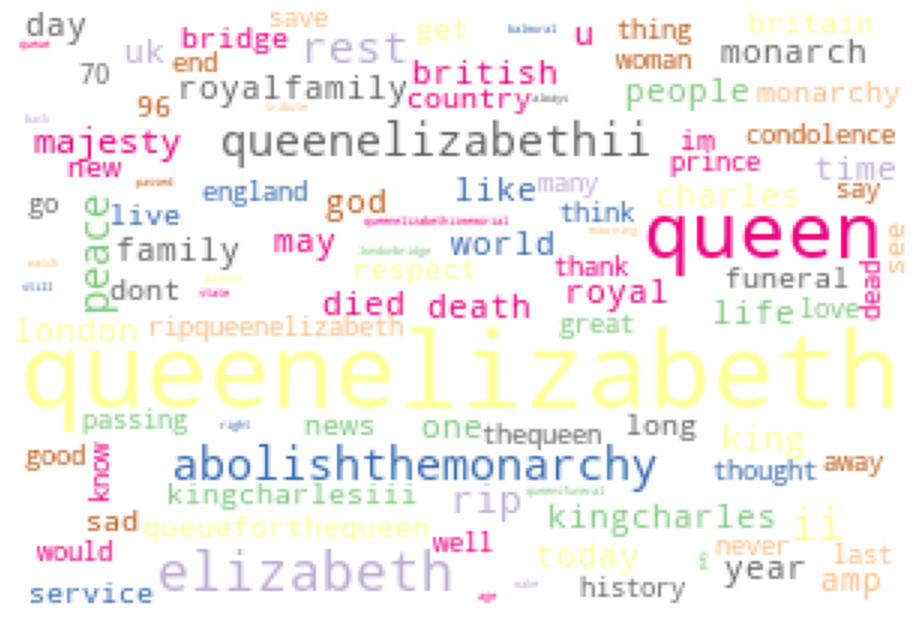

In [66]:
# transform word_freq list to dictionary 
top_100_dic = dict((key, value) for key, value in top_100)

#Create Word Cloud of top 50 words
wordcloud = WordCloud(width = 300, height = 200,colormap = 'Accent', max_font_size=200, background_color = 'white').generate_from_frequencies(top_100_dic)

# plt.figure(figsize = (8, 12), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()


### 4.3Topic modeling: LDA Model 

The topics of all English tweets are extracted by LDA model, propessing based on the [corpus_hashtag_final.csv](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/Text-Analysis-Output/corpus-hashtag-final.zip) file. 

In [67]:
# load the corpus_hashtag_final.csv file to initiate 

df_en_copy2 = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus-hashtag-final.csv")
df_en_copy2['tokens_lemma'] = df_en_copy2['tokens_lemma'].apply(str2lst)


In [68]:
# Create a id2word dictionary
word_id = Dictionary(df_en_copy2['tokens_lemma'] )
print(len(word_id))

# Filtering Extremes
word_id.filter_extremes(no_below=2,no_above = 0.9)
print(len(word_id))

#view integer mappings
word_id.token2id

173043
62020


{'abolishthemonarchynotmyking': 0,
 'account': 1,
 'antimonarchy': 2,
 'arrested': 3,
 'brightgrn': 4,
 'charlesiii': 5,
 'notmyking': 6,
 'opinion': 7,
 'oxford': 8,
 'publishing': 9,
 'thanks': 10,
 'today': 11,
 'voicing': 12,
 '1979': 13,
 'abolishthehouseoflords': 14,
 'abolishthemonarchy': 15,
 'capitalismkills': 16,
 'classwar': 17,
 'conservativeskill': 18,
 'electoralreformnow': 19,
 'government': 20,
 'hostile': 21,
 'redbirdel': 22,
 'since': 23,
 'weve': 24,
 'beckettunite': 25,
 'ceremony': 26,
 'ultimately': 27,
 'abolished': 28,
 'absolutely': 29,
 'event': 30,
 'historic': 31,
 'living': 32,
 'meanwhile': 33,
 'monarchy': 34,
 'royalist': 35,
 'scotland': 36,
 'see': 37,
 'sevillecalculat': 38,
 'someone': 39,
 'son': 40,
 'went': 41,
 'yes': 42,
 'young': 43,
 'along': 44,
 'britain': 45,
 'image': 46,
 'laying': 47,
 'national': 48,
 'never': 49,
 'queen': 50,
 'rest': 51,
 'sacred': 52,
 'ask': 53,
 'dare': 54,
 'head': 55,
 'peasant': 56,
 'question': 57,
 'state': 

In [69]:
# Creating a corpus object 
doc_term_matrix = [word_id.doc2bow(x) for x in df_en_copy2['tokens_lemma']]
doc_term_matrix

[[(0, 1),
  (1, 1),
  (2, 1),
  (3, 1),
  (4, 1),
  (5, 1),
  (6, 1),
  (7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1)],
 [(13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 1),
  (18, 1),
  (19, 1),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 1)],
 [(15, 1), (25, 1), (26, 1), (27, 1)],
 [(6, 1),
  (15, 1),
  (28, 1),
  (29, 1),
  (30, 1),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1)],
 [(15, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 1),
  (51, 1),
  (52, 1)],
 [(15, 1),
  (53, 1),
  (54, 1),
  (55, 1),
  (56, 1),
  (57, 1),
  (58, 1),
  (59, 1),
  (60, 1)],
 [(15, 1),
  (47, 1),
  (50, 1),
  (58, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1)],
 [(15, 1), (26, 1), (27, 1), (75, 1)],
 [(15, 1),
  (76, 1),
  (77, 1),
  (78, 6),
  (

In [71]:
# Instantiating a Base LDA model 
base_model = LdaMulticore(corpus= doc_term_matrix, num_topics= 6, id2word= word_id,workers=10, random_state=10, passes=5) 

In [72]:
# Filtering for words 
words = [re.findall(r'"([^"]*)"',t[1]) for t in base_model.print_topics()]

In [73]:
# Create Topics
topics = [' '.join(t[0:10]) for t in words]

for id, t in enumerate(topics): 
    print(f"------ Topic {id} ------")
    print(t, end="\n\n")

------ Topic 0 ------
queenelizabeth abolishthemonarchy queen dont people like get monarchy know time

------ Topic 1 ------
queenelizabeth queenelizabethii queen btc soon growmoon got kingcharlesiii kingcharles harry

------ Topic 2 ------
queenelizabeth queen life amp world family rip majesty service woman

------ Topic 3 ------
queenelizabeth queen funeral queueforthequeen respect people day queue death state

------ Topic 4 ------
queenelizabeth launching mechazilla one happen crypto thing x live website

------ Topic 5 ------
queenelizabeth queen elizabeth ii rest peace king rip queenelizabethii majesty



In [76]:
#Creating Topic Distance Visualization 

import pyLDAvis.gensim
pyLDAvis.enable_notebook()
pyLDAvis.gensim.prepare(base_model, doc_term_matrix, word_id)
     

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5      0.207980  0.172170       1        1  22.309091
0     -0.023191 -0.193640       2        1  21.622150
2      0.147049 -0.045712       3        1  21.277906
3      0.011268 -0.087386       4        1  18.797387
1     -0.126550  0.009784       5        1   9.318023
4     -0.216557  0.144784       6        1   6.675441, topic_info=           Term           Freq          Total Category  logprob  loglift
204   elizabeth   46632.000000   46632.000000  Default  30.0000  30.0000
50        queen  122925.000000  122925.000000  Default  29.0000  29.0000
2732         ii   28413.000000   28413.000000  Default  28.0000  28.0000
51         rest   29213.000000   29213.000000  Default  27.0000  27.0000
2739      peace   25160.000000   25160.000000  Default  26.0000  26.0000
...         ...            ...            ...      ...      ...      ...
335        news    1709.524086    9276.117425   Topic6  -5.0052   1.0155
287       death    1537.696945   15115.503307   Topic6  -5.1111   0.4213
121         new    1052.549520    8306.261778   Topic6  -5.4902   0.6409
1285      black     885.823808    2738.450759   Topic6  -5.6626   1.5781
50        queen     996.417591  122925.297806   Topic6  -5.5450  -2.1084

[505 rows x 6 columns], token_table=       Topic      Freq             Term
term                                   
3158       1  0.975234             1926
3158       3  0.007856             1926
3158       4  0.006733             1926
3158       6  0.010100             1926
2738       1  0.995955         19262022
...      ...       ...              ...
1839       5  0.002259               yr
1839       6  0.762427               yr
23869      4  0.996283  الملكه_اليزابيث
11594      4  0.996066         بريطانيا
48959      4  0.992040        قناة_الغد

[1694 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 1, 3, 4, 2, 5])

In [77]:
# assign the topics to each tweet 
count = 0 
for i in base_model[doc_term_matrix]:
    print("tweet:", count+1, i)
    count += 1

tweet: 1 [(0, 0.59647346), (1, 0.3549107), (2, 0.012140244), (3, 0.012127246), (4, 0.012243013), (5, 0.012105398)]
tweet: 2 [(0, 0.097483106), (1, 0.013021769), (2, 0.013028007), (3, 0.8504369), (4, 0.013015917), (5, 0.0130142905)]
tweet: 3 [(0, 0.8323734), (1, 0.033390187), (2, 0.033413976), (3, 0.033950403), (4, 0.03339113), (5, 0.033480912)]
tweet: 4 [(0, 0.75052524), (3, 0.21402869)]
tweet: 5 [(0, 0.23186305), (1, 0.015211624), (2, 0.015367094), (3, 0.44120967), (4, 0.015199839), (5, 0.2811487)]
tweet: 6 [(0, 0.91628206), (1, 0.016683666), (2, 0.016706651), (3, 0.016936813), (4, 0.016684024), (5, 0.016706735)]
tweet: 7 [(0, 0.30356842), (1, 0.064786494), (3, 0.6050114)]
tweet: 8 [(0, 0.83169895), (1, 0.03353377), (2, 0.033557754), (3, 0.03404941), (4, 0.033534765), (5, 0.033625342)]
tweet: 9 [(0, 0.52045095), (1, 0.11013107), (2, 0.21835263), (3, 0.138029)]
tweet: 10 [(0, 0.9068752), (1, 0.018608773), (2, 0.018621115), (3, 0.018785695), (4, 0.01853645), (5, 0.018572772)]
tweet: 11 

tweet: 440 [(0, 0.5623088), (2, 0.34191573), (3, 0.075873785)]
tweet: 441 [(0, 0.95800835)]
tweet: 442 [(0, 0.77099764), (1, 0.011217309), (2, 0.011244803), (3, 0.011378449), (4, 0.01121403), (5, 0.1839478)]
tweet: 443 [(0, 0.83290464), (1, 0.033408254), (2, 0.033484235), (3, 0.033478197), (4, 0.033361893), (5, 0.033362772)]
tweet: 444 [(0, 0.17613743), (1, 0.22992778), (2, 0.43450335), (3, 0.121758446), (4, 0.018808538), (5, 0.018864494)]
tweet: 445 [(0, 0.92373407), (1, 0.015213221), (2, 0.015347826), (3, 0.015309195), (4, 0.015207026), (5, 0.015188687)]
tweet: 446 [(0, 0.4397669), (2, 0.25946128), (3, 0.23249215), (4, 0.05454222)]
tweet: 447 [(0, 0.2758164), (2, 0.26547167), (3, 0.43848476)]
tweet: 448 [(0, 0.83290535), (1, 0.033395465), (2, 0.03344049), (3, 0.033463195), (4, 0.033382516), (5, 0.033412963)]
tweet: 449 [(0, 0.88678855), (1, 0.010586937), (2, 0.010629833), (3, 0.07080551), (4, 0.010591701), (5, 0.010597426)]
tweet: 450 [(0, 0.5834719), (1, 0.0189355), (2, 0.34149656),

tweet: 820 [(0, 0.015194156), (1, 0.015343978), (2, 0.31085166), (3, 0.6279782), (4, 0.015344756), (5, 0.015287256)]
tweet: 821 [(0, 0.14154926), (2, 0.6488142), (3, 0.18164851)]
tweet: 822 [(0, 0.041884407), (1, 0.042708587), (2, 0.04197502), (3, 0.042802997), (4, 0.788503), (5, 0.042126007)]
tweet: 823 [(0, 0.020912148), (1, 0.020890703), (2, 0.19801964), (3, 0.0210407), (4, 0.021054048), (5, 0.7180827)]
tweet: 824 [(2, 0.6153476), (5, 0.3614854)]
tweet: 825 [(0, 0.015384364), (1, 0.015429668), (2, 0.015530739), (3, 0.47639918), (4, 0.46180084), (5, 0.015455166)]
tweet: 826 [(1, 0.795565), (5, 0.1723566)]
tweet: 827 [(2, 0.15716144), (3, 0.31126505), (5, 0.50359434)]
tweet: 828 [(2, 0.5336521), (3, 0.4461747)]
tweet: 829 [(0, 0.2724838), (3, 0.69691217)]
tweet: 830 [(0, 0.92373717), (1, 0.015270007), (2, 0.015258443), (3, 0.015246728), (4, 0.015203872), (5, 0.015283766)]
tweet: 831 [(0, 0.021842077), (1, 0.021856956), (2, 0.022430677), (3, 0.51009244), (4, 0.021862749), (5, 0.4019151

tweet: 1194 [(3, 0.4234675), (4, 0.15148659), (5, 0.39976135)]
tweet: 1195 [(0, 0.010525519), (1, 0.010455116), (2, 0.3555645), (3, 0.60252464), (4, 0.010464041), (5, 0.010466182)]
tweet: 1196 [(1, 0.11017796), (2, 0.4248651), (3, 0.13016623), (5, 0.32092893)]
tweet: 1197 [(0, 0.020951124), (1, 0.34029523), (2, 0.5759108), (3, 0.020991037), (4, 0.020916585), (5, 0.020935232)]
tweet: 1198 [(0, 0.012029454), (1, 0.3310097), (2, 0.012004508), (3, 0.6208982), (4, 0.012027378), (5, 0.012030776)]
tweet: 1199 [(0, 0.016728362), (1, 0.016725985), (2, 0.016792003), (3, 0.55456716), (4, 0.016746197), (5, 0.37844032)]
tweet: 1200 [(1, 0.14205912), (2, 0.82592225)]
tweet: 1201 [(0, 0.02098288), (1, 0.021014089), (2, 0.020970574), (3, 0.89504474), (4, 0.021022996), (5, 0.020964742)]
tweet: 1202 [(0, 0.012893296), (1, 0.4215012), (2, 0.012978079), (3, 0.5268653), (4, 0.012866415), (5, 0.012895671)]
tweet: 1203 [(0, 0.021038814), (1, 0.02107147), (2, 0.021053825), (3, 0.8949629), (4, 0.020918788), (5

tweet: 1579 [(0, 0.018760875), (1, 0.01865321), (2, 0.22676393), (3, 0.6984629), (4, 0.018692842), (5, 0.01866627)]
tweet: 1580 [(1, 0.18595637), (2, 0.62906885), (3, 0.15844828)]
tweet: 1581 [(2, 0.3322461), (3, 0.4223338), (5, 0.22125043)]
tweet: 1582 [(0, 0.027819978), (1, 0.027826162), (2, 0.027862238), (3, 0.027820833), (4, 0.027814733), (5, 0.86085606)]
tweet: 1583 [(1, 0.9649036)]
tweet: 1584 [(0, 0.014142403), (1, 0.45918697), (2, 0.1857358), (3, 0.014188918), (4, 0.014194727), (5, 0.31255114)]
tweet: 1585 [(1, 0.048495125), (2, 0.40520236), (3, 0.52759904)]
tweet: 1586 [(0, 0.012946902), (1, 0.22336063), (2, 0.012930142), (3, 0.7249816), (4, 0.012899254), (5, 0.01288145)]
tweet: 1587 [(3, 0.36010903), (5, 0.60456574)]
tweet: 1588 [(2, 0.08253527), (3, 0.6276611), (4, 0.0714647), (5, 0.20235652)]
tweet: 1589 [(3, 0.53386307), (4, 0.4378355)]
tweet: 1590 [(0, 0.9060885), (1, 0.018592097), (2, 0.018873874), (3, 0.018986184), (4, 0.018849395), (5, 0.018610045)]
tweet: 1591 [(2, 0.

tweet: 1935 [(2, 0.8325902), (4, 0.14028473)]
tweet: 1936 [(3, 0.45241246), (4, 0.20162618), (5, 0.31927672)]
tweet: 1937 [(0, 0.67345285), (3, 0.29733235)]
tweet: 1938 [(0, 0.108301215), (1, 0.7451258), (2, 0.010521459), (3, 0.11505496), (4, 0.010461838), (5, 0.010534778)]
tweet: 1939 [(0, 0.014131118), (1, 0.01414858), (2, 0.7148826), (3, 0.014171462), (4, 0.22858533), (5, 0.014080853)]
tweet: 1940 [(0, 0.011934455), (1, 0.0120812105), (2, 0.0120034525), (3, 0.58783495), (4, 0.011963444), (5, 0.36418253)]
tweet: 1941 [(0, 0.43228182), (1, 0.011930924), (2, 0.011999938), (3, 0.5199278), (4, 0.011928429), (5, 0.011931067)]
tweet: 1942 [(0, 0.045565464), (1, 0.04535693), (2, 0.04530591), (3, 0.7730486), (4, 0.045379996), (5, 0.045343097)]
tweet: 1943 [(0, 0.0113337), (1, 0.011189086), (2, 0.7382335), (3, 0.011233366), (4, 0.011182028), (5, 0.21682835)]
tweet: 1944 [(1, 0.14680591), (2, 0.19708577), (3, 0.35663474), (4, 0.22425008), (5, 0.06633457)]
tweet: 1945 [(1, 0.13940983), (2, 0.30

tweet: 2289 [(0, 0.01858184), (1, 0.018556906), (2, 0.018944962), (3, 0.7444775), (4, 0.18076032), (5, 0.018678458)]
tweet: 2290 [(3, 0.9558722)]
tweet: 2291 [(0, 0.014101738), (1, 0.743564), (2, 0.01437815), (3, 0.19972655), (4, 0.014049987), (5, 0.014179524)]
tweet: 2292 [(1, 0.965005)]
tweet: 2293 [(0, 0.013927054), (1, 0.013936192), (2, 0.014109924), (3, 0.9299744), (4, 0.013965724), (5, 0.0140866665)]
tweet: 2294 [(1, 0.9650043)]
tweet: 2295 [(1, 0.9650048)]
tweet: 2296 [(1, 0.96500456)]
tweet: 2297 [(1, 0.965005)]
tweet: 2298 [(1, 0.96500456)]
tweet: 2299 [(4, 0.85754585), (5, 0.12567496)]
tweet: 2300 [(1, 0.96500486)]
tweet: 2301 [(1, 0.9649977)]
tweet: 2302 [(1, 0.965005)]
tweet: 2303 [(0, 0.018581834), (1, 0.018556902), (2, 0.018934553), (3, 0.7445155), (4, 0.18073276), (5, 0.018678436)]
tweet: 2304 [(1, 0.96500486)]
tweet: 2305 [(0, 0.018750083), (1, 0.018702988), (2, 0.018687265), (3, 0.32576245), (4, 0.5993312), (5, 0.018765999)]
tweet: 2306 [(0, 0.013012609), (1, 0.0128960

tweet: 2643 [(5, 0.9678714)]
tweet: 2644 [(2, 0.42058238), (3, 0.5563209)]
tweet: 2645 [(5, 0.96786183)]
tweet: 2646 [(0, 0.6483971), (2, 0.3160479)]
tweet: 2647 [(0, 0.023967171), (1, 0.023854205), (2, 0.023973351), (3, 0.6949913), (4, 0.023867406), (5, 0.20934662)]
tweet: 2648 [(0, 0.013162368), (1, 0.012969119), (2, 0.013015247), (3, 0.4766504), (4, 0.013052794), (5, 0.47115013)]
tweet: 2649 [(0, 0.023613874), (1, 0.8808343), (2, 0.023878265), (3, 0.023714561), (4, 0.024308914), (5, 0.023650067)]
tweet: 2650 [(0, 0.033448443), (1, 0.033434466), (2, 0.033452895), (3, 0.83281976), (4, 0.033467714), (5, 0.033376735)]
tweet: 2651 [(0, 0.5638698), (2, 0.2420388), (3, 0.17611569)]
tweet: 2652 [(2, 0.83307475), (3, 0.12930928)]
tweet: 2653 [(0, 0.013971841), (1, 0.013908945), (2, 0.103121266), (3, 0.8411316), (4, 0.013908258), (5, 0.013958004)]
tweet: 2654 [(0, 0.020914989), (1, 0.020918129), (2, 0.02094468), (3, 0.89518696), (4, 0.020912105), (5, 0.021123096)]
tweet: 2655 [(0, 0.033638682

tweet: 3085 [(0, 0.015270931), (1, 0.015186197), (2, 0.015365338), (3, 0.92378664), (4, 0.015174815), (5, 0.015216102)]
tweet: 3086 [(0, 0.018679224), (1, 0.018645978), (2, 0.01868953), (3, 0.9066594), (4, 0.018608354), (5, 0.018717486)]
tweet: 3087 [(0, 0.027835), (1, 0.027847052), (2, 0.86064345), (3, 0.027844325), (4, 0.027846811), (5, 0.027983326)]
tweet: 3088 [(3, 0.72252166), (5, 0.252575)]
tweet: 3089 [(0, 0.015266144), (1, 0.0152570745), (2, 0.39101192), (3, 0.30674025), (4, 0.25643656), (5, 0.015288007)]
tweet: 3090 [(0, 0.027859928), (1, 0.027903268), (2, 0.027921854), (3, 0.8604988), (4, 0.027868075), (5, 0.027948136)]
tweet: 3091 [(0, 0.011991091), (1, 0.01197125), (2, 0.011994963), (3, 0.78814155), (4, 0.012028547), (5, 0.16387257)]
tweet: 3092 [(0, 0.22217488), (2, 0.23650934), (4, 0.4296732), (5, 0.09804694)]
tweet: 3093 [(0, 0.010006962), (1, 0.0102098705), (2, 0.018556314), (3, 0.9412818), (4, 0.010001083)]
tweet: 3094 [(0, 0.8129411), (1, 0.12073862), (2, 0.016615018)

tweet: 3556 [(0, 0.013917463), (1, 0.01390995), (2, 0.9302517), (3, 0.013953731), (4, 0.013930521), (5, 0.01403665)]
tweet: 3557 [(4, 0.96357566)]
tweet: 3558 [(0, 0.78150946), (1, 0.015342556), (2, 0.015310129), (3, 0.15731952), (4, 0.015261902), (5, 0.015256435)]
tweet: 3559 [(2, 0.19250005), (5, 0.76988566)]
tweet: 3560 [(2, 0.35925606), (3, 0.30548197), (5, 0.3122671)]
tweet: 3561 [(4, 0.9635753)]
tweet: 3562 [(0, 0.015779017), (1, 0.015786577), (2, 0.09706483), (3, 0.44016626), (4, 0.01591899), (5, 0.41528428)]
tweet: 3563 [(0, 0.012868871), (1, 0.012873027), (2, 0.0129696755), (3, 0.012893809), (4, 0.012839495), (5, 0.9355551)]
tweet: 3564 [(0, 0.013907926), (1, 0.014041303), (2, 0.01410512), (3, 0.014103248), (4, 0.013960314), (5, 0.92988205)]
tweet: 3565 [(2, 0.795125), (4, 0.18170007)]
tweet: 3566 [(0, 0.1005717), (1, 0.012084588), (2, 0.012068361), (3, 0.5737403), (4, 0.012043866), (5, 0.2894912)]
tweet: 3567 [(4, 0.9635746)]
tweet: 3568 [(0, 0.016710438), (1, 0.29596817), (2

tweet: 3999 [(1, 0.5114747), (3, 0.18263303), (5, 0.2849216)]
tweet: 4000 [(1, 0.09541707), (2, 0.69660586), (3, 0.18220106)]
tweet: 4001 [(0, 0.018553926), (1, 0.018564802), (2, 0.30924088), (3, 0.616455), (4, 0.018580498), (5, 0.018604835)]
tweet: 4002 [(0, 0.6035905), (1, 0.31193402), (2, 0.021062521), (3, 0.021343533), (4, 0.021001477), (5, 0.021067986)]
tweet: 4003 [(0, 0.013023961), (1, 0.01293484), (2, 0.7042727), (3, 0.24400605), (4, 0.0128688635), (5, 0.01289358)]
tweet: 4004 [(0, 0.018601872), (1, 0.018575413), (2, 0.018676585), (3, 0.90701413), (4, 0.01857476), (5, 0.018557169)]
tweet: 4005 [(0, 0.015368247), (1, 0.0152469035), (2, 0.015418996), (3, 0.7847346), (4, 0.015164613), (5, 0.1540666)]
tweet: 4006 [(1, 0.9508925)]
tweet: 4007 [(0, 0.25917864), (1, 0.015259298), (2, 0.36262673), (3, 0.15882406), (4, 0.18889624), (5, 0.015215031)]
tweet: 4008 [(0, 0.012999782), (1, 0.0131992735), (2, 0.013201397), (3, 0.5910505), (4, 0.013481289), (5, 0.35606775)]
tweet: 4009 [(0, 0.3

tweet: 4344 [(0, 0.021005102), (1, 0.020929743), (2, 0.2880095), (3, 0.62816566), (4, 0.020941095), (5, 0.020948887)]
tweet: 4345 [(0, 0.015333708), (1, 0.01560012), (2, 0.01535836), (3, 0.9229602), (4, 0.015292733), (5, 0.015454826)]
tweet: 4346 [(0, 0.033427205), (1, 0.03395128), (2, 0.83171177), (3, 0.033907343), (4, 0.033437036), (5, 0.03356539)]
tweet: 4347 [(1, 0.6570953), (3, 0.23932758), (5, 0.080548316)]
tweet: 4348 [(0, 0.011270118), (1, 0.011173139), (2, 0.17438258), (3, 0.7808782), (4, 0.0111456355), (5, 0.011150331)]
tweet: 4349 [(0, 0.23226556), (2, 0.46488562), (4, 0.2773675)]
tweet: 4350 [(0, 0.016732363), (1, 0.48554438), (2, 0.01673941), (3, 0.44752043), (4, 0.016724365), (5, 0.016739046)]
tweet: 4351 [(0, 0.011211588), (1, 0.011208842), (2, 0.011217806), (3, 0.26907972), (4, 0.011224662), (5, 0.6860574)]
tweet: 4352 [(0, 0.011946063), (1, 0.22091576), (2, 0.012004714), (3, 0.3774787), (4, 0.011937309), (5, 0.36571747)]
tweet: 4353 [(0, 0.011156694), (1, 0.01147847), 

tweet: 4772 [(0, 0.0111094285), (1, 0.01112501), (2, 0.011114217), (3, 0.8705665), (4, 0.084736295), (5, 0.011348566)]
tweet: 4773 [(2, 0.41279566), (3, 0.3875371), (5, 0.18332127)]
tweet: 4774 [(0, 0.011939732), (1, 0.012011005), (2, 0.011948963), (3, 0.46532235), (4, 0.011933011), (5, 0.48684493)]
tweet: 4775 [(0, 0.17494273), (1, 0.6376772), (2, 0.065481946), (3, 0.0933328), (4, 0.014242305), (5, 0.014323062)]
tweet: 4776 [(0, 0.012866439), (1, 0.0128690405), (2, 0.012883672), (3, 0.7611496), (4, 0.012868385), (5, 0.18736291)]
tweet: 4777 [(0, 0.6587782), (3, 0.31328014)]
tweet: 4778 [(0, 0.010648382), (1, 0.10967144), (2, 0.14969322), (3, 0.7086761), (4, 0.010655717), (5, 0.01065516)]
tweet: 4779 [(0, 0.011977751), (1, 0.011960161), (2, 0.011994506), (3, 0.6704205), (4, 0.12160626), (5, 0.17204079)]
tweet: 4780 [(2, 0.062906586), (3, 0.9113074)]
tweet: 4781 [(0, 0.8946305), (1, 0.021019753), (2, 0.021043163), (3, 0.021183472), (4, 0.020955732), (5, 0.021167366)]
tweet: 4782 [(0, 0.

tweet: 5170 [(0, 0.018718889), (1, 0.3299275), (2, 0.01861949), (3, 0.5955249), (4, 0.018613504), (5, 0.01859566)]
tweet: 5171 [(0, 0.018982425), (1, 0.4009727), (2, 0.018982913), (3, 0.52294326), (4, 0.019032868), (5, 0.019085819)]
tweet: 5172 [(2, 0.87118), (4, 0.09940014)]
tweet: 5173 [(2, 0.18253681), (3, 0.7895002)]
tweet: 5174 [(0, 0.011957118), (1, 0.011936268), (2, 0.012016366), (3, 0.94016653), (4, 0.011938283), (5, 0.011985493)]
tweet: 5175 [(0, 0.01402559), (1, 0.013992924), (2, 0.0140270805), (3, 0.9299763), (4, 0.013989506), (5, 0.013988617)]
tweet: 5176 [(3, 0.9580477)]
tweet: 5177 [(1, 0.23995455), (3, 0.6087619), (5, 0.1316043)]
tweet: 5178 [(0, 0.0140521405), (1, 0.5483552), (2, 0.014112748), (3, 0.39547417), (4, 0.014005015), (5, 0.014000695)]
tweet: 5179 [(0, 0.023832427), (1, 0.023840526), (2, 0.023883753), (3, 0.8807909), (4, 0.023826033), (5, 0.023826381)]
tweet: 5180 [(0, 0.04186734), (1, 0.042029966), (2, 0.042465396), (3, 0.78959584), (4, 0.041980527), (5, 0.04

tweet: 5627 [(0, 0.015321804), (1, 0.55272955), (2, 0.2223115), (3, 0.015451472), (4, 0.17867446), (5, 0.015511221)]
tweet: 5628 [(0, 0.41482615), (2, 0.18711652), (3, 0.30188438), (4, 0.08359716)]
tweet: 5629 [(0, 0.013924285), (1, 0.7310572), (2, 0.01391566), (3, 0.21321662), (4, 0.013921753), (5, 0.0139644435)]
tweet: 5630 [(1, 0.21193913), (2, 0.15540259), (3, 0.60977376)]
tweet: 5631 [(0, 0.018729068), (1, 0.018611388), (2, 0.018845996), (3, 0.76256955), (4, 0.16248694), (5, 0.018757049)]
tweet: 5632 [(4, 0.97871476)]
tweet: 5633 [(0, 0.012950523), (1, 0.012797815), (2, 0.012859169), (3, 0.93558794), (4, 0.013015707), (5, 0.012788874)]
tweet: 5634 [(0, 0.028096033), (1, 0.027926702), (2, 0.028246844), (3, 0.8599752), (4, 0.02785631), (5, 0.02789888)]
tweet: 5635 [(0, 0.012208873), (1, 0.011970959), (2, 0.012181326), (3, 0.012061149), (4, 0.20899), (5, 0.7425877)]
tweet: 5636 [(2, 0.7347351), (3, 0.2360089)]
tweet: 5637 [(2, 0.3507214), (3, 0.6120053)]
tweet: 5638 [(0, 0.058013022)

tweet: 6089 [(0, 0.041823454), (1, 0.042747065), (2, 0.7891498), (3, 0.042285126), (4, 0.04183898), (5, 0.042155594)]
tweet: 6090 [(0, 0.2770429), (1, 0.012894727), (2, 0.32711235), (3, 0.35707876), (4, 0.0129594905), (5, 0.012911823)]
tweet: 6091 [(0, 0.016844837), (1, 0.01683806), (2, 0.016741607), (3, 0.74906355), (4, 0.18374446), (5, 0.016767506)]
tweet: 6092 [(0, 0.5810229), (1, 0.32937196), (2, 0.06557709)]
tweet: 6093 [(0, 0.4379958), (1, 0.21315072), (2, 0.010038855), (3, 0.31865424), (4, 0.010028959), (5, 0.010131494)]
tweet: 6094 [(0, 0.47545692), (1, 0.018729497), (2, 0.018779235), (3, 0.4495924), (4, 0.018734034), (5, 0.018707903)]
tweet: 6095 [(2, 0.6086705), (3, 0.3594367)]
tweet: 6096 [(0, 0.36465055), (2, 0.050226305), (3, 0.56301993)]
tweet: 6097 [(0, 0.023959035), (1, 0.023967715), (2, 0.024228869), (3, 0.3780812), (4, 0.52575874), (5, 0.02400444)]
tweet: 6098 [(0, 0.50659704), (1, 0.018636951), (2, 0.018706093), (3, 0.41881958), (4, 0.01862587), (5, 0.018614473)]
twe

tweet: 6583 [(0, 0.017007506), (1, 0.016766714), (2, 0.3729419), (3, 0.32464275), (4, 0.016784882), (5, 0.25185624)]
tweet: 6584 [(2, 0.24603324), (3, 0.5153524), (5, 0.21846405)]
tweet: 6585 [(2, 0.62074834), (5, 0.3560807)]
tweet: 6586 [(0, 0.01545142), (1, 0.015313462), (2, 0.16907), (3, 0.7694476), (4, 0.015417793), (5, 0.015299673)]
tweet: 6587 [(0, 0.011282712), (1, 0.011186425), (2, 0.057999358), (3, 0.011304683), (4, 0.89703524), (5, 0.0111915935)]
tweet: 6588 [(0, 0.023865933), (1, 0.023980465), (2, 0.02391782), (3, 0.88039947), (4, 0.023904797), (5, 0.023931468)]
tweet: 6589 [(0, 0.12697347), (1, 0.21298954), (2, 0.012891335), (3, 0.33069184), (4, 0.012901423), (5, 0.30355242)]
tweet: 6590 [(0, 0.0112233525), (1, 0.011225951), (2, 0.011373665), (3, 0.47824615), (4, 0.16407678), (5, 0.32385412)]
tweet: 6591 [(0, 0.6411712), (1, 0.014172674), (2, 0.014174179), (3, 0.014262017), (4, 0.30207723), (5, 0.014142656)]
tweet: 6592 [(0, 0.020895543), (1, 0.021129984), (2, 0.02126532), 

tweet: 7020 [(0, 0.010555694), (1, 0.010539101), (2, 0.55311704), (3, 0.3382504), (4, 0.07693476), (5, 0.010603009)]
tweet: 7021 [(0, 0.52756584), (1, 0.22935566), (3, 0.22116481)]
tweet: 7022 [(0, 0.61196154), (1, 0.028000591), (2, 0.028105143), (3, 0.028055174), (4, 0.027867684), (5, 0.2760098)]
tweet: 7023 [(0, 0.41660085), (1, 0.010538211), (2, 0.29152754), (3, 0.26026535), (4, 0.010460594), (5, 0.010607457)]
tweet: 7024 [(0, 0.015266772), (1, 0.16699558), (2, 0.015446434), (3, 0.7714819), (4, 0.01532846), (5, 0.015480925)]
tweet: 7025 [(0, 0.010541193), (1, 0.01063563), (2, 0.098235), (3, 0.8594193), (4, 0.010622979), (5, 0.010545914)]
tweet: 7026 [(0, 0.52443415), (1, 0.01680998), (2, 0.016816275), (3, 0.4083683), (4, 0.016789766), (5, 0.016781548)]
tweet: 7027 [(0, 0.018573936), (1, 0.018581737), (2, 0.1631338), (3, 0.01858827), (4, 0.018567385), (5, 0.7625549)]
tweet: 7028 [(0, 0.023909835), (1, 0.25703952), (2, 0.646978), (3, 0.02398694), (4, 0.02394705), (5, 0.024138665)]
twe

tweet: 7447 [(3, 0.35466763), (4, 0.12361959), (5, 0.50073606)]
tweet: 7448 [(0, 0.49579963), (1, 0.013983561), (2, 0.014162194), (3, 0.4478124), (4, 0.013963231), (5, 0.014278971)]
tweet: 7449 [(0, 0.018963143), (1, 0.018952074), (2, 0.018868199), (3, 0.018822432), (4, 0.50879216), (5, 0.415602)]
tweet: 7450 [(2, 0.63532525), (5, 0.33677655)]
tweet: 7451 [(0, 0.018568315), (1, 0.01868811), (2, 0.90701985), (3, 0.018562686), (4, 0.018551055), (5, 0.018609993)]
tweet: 7452 [(0, 0.2638321), (2, 0.6597426), (3, 0.05771138)]
tweet: 7453 [(0, 0.42153567), (2, 0.15011217), (3, 0.4110918)]
tweet: 7454 [(0, 0.016848842), (1, 0.016751096), (2, 0.016776947), (3, 0.49912283), (4, 0.016884236), (5, 0.43361604)]
tweet: 7455 [(2, 0.9579996)]
tweet: 7456 [(2, 0.08086758), (4, 0.8932305)]
tweet: 7457 [(0, 0.7006412), (1, 0.014108301), (2, 0.0139862755), (3, 0.014291352), (4, 0.013940619), (5, 0.2430322)]
tweet: 7458 [(0, 0.012884183), (1, 0.012915396), (2, 0.9353367), (3, 0.012986101), (4, 0.012868974

tweet: 7876 [(0, 0.35018563), (1, 0.014158028), (2, 0.014071537), (3, 0.35699525), (4, 0.13952877), (5, 0.12506078)]
tweet: 7877 [(0, 0.012035472), (1, 0.012015296), (2, 0.50879633), (3, 0.13893177), (4, 0.011983149), (5, 0.31623802)]
tweet: 7878 [(0, 0.015955431), (1, 0.083218694), (2, 0.015899995), (3, 0.5049545), (4, 0.14731294), (5, 0.23265842)]
tweet: 7879 [(0, 0.40585285), (2, 0.16438822), (3, 0.18258403), (5, 0.2351652)]
tweet: 7880 [(1, 0.7673208), (3, 0.09177162), (5, 0.11882471)]
tweet: 7881 [(0, 0.04179708), (1, 0.04184126), (2, 0.7906395), (3, 0.041797485), (4, 0.041818086), (5, 0.04210658)]
tweet: 7882 [(0, 0.0111224735), (1, 0.011121357), (2, 0.49981865), (3, 0.011132613), (4, 0.011120497), (5, 0.4556844)]
tweet: 7883 [(0, 0.38764608), (1, 0.4396871), (2, 0.043075316), (3, 0.043215606), (4, 0.043149974), (5, 0.04322593)]
tweet: 7884 [(0, 0.02786602), (1, 0.02811726), (2, 0.028023597), (3, 0.55723244), (4, 0.027928928), (5, 0.33083174)]
tweet: 7885 [(0, 0.041754153), (1, 0

tweet: 8279 [(0, 0.24852507), (4, 0.7209125)]
tweet: 8280 [(0, 0.02406592), (1, 0.024171773), (2, 0.024141122), (3, 0.87955195), (4, 0.023953002), (5, 0.024116242)]
tweet: 8281 [(2, 0.74648637), (3, 0.06151071), (5, 0.1691138)]
tweet: 8282 [(0, 0.016779937), (1, 0.36400327), (2, 0.016851606), (3, 0.4828238), (4, 0.016763072), (5, 0.10277832)]
tweet: 8283 [(0, 0.01226941), (1, 0.01228407), (2, 0.47210667), (3, 0.40890613), (4, 0.012152649), (5, 0.08228108)]
tweet: 8284 [(0, 0.20741479), (3, 0.7667437)]
tweet: 8285 [(2, 0.4007589), (4, 0.56542724)]
tweet: 8286 [(0, 0.01519565), (1, 0.21694446), (2, 0.015221585), (3, 0.015339597), (4, 0.015219226), (5, 0.7220795)]
tweet: 8287 [(0, 0.9531461)]
tweet: 8288 [(0, 0.0141712865), (1, 0.7991315), (2, 0.14461264), (3, 0.014032421), (4, 0.013999302), (5, 0.014052882)]
tweet: 8289 [(0, 0.020920398), (1, 0.021103408), (2, 0.4629307), (3, 0.45299026), (4, 0.020957995), (5, 0.021097237)]
tweet: 8290 [(0, 0.010438195), (1, 0.5265015), (2, 0.01045262), 

tweet: 8704 [(0, 0.41031757), (1, 0.17483671), (2, 0.010546385), (3, 0.010505953), (4, 0.010523581), (5, 0.3832698)]
tweet: 8705 [(2, 0.85367966), (3, 0.12305284)]
tweet: 8706 [(0, 0.013947283), (1, 0.014088565), (2, 0.013981935), (3, 0.19022003), (4, 0.013953102), (5, 0.7538091)]
tweet: 8707 [(2, 0.88621926), (3, 0.09185622)]
tweet: 8708 [(0, 0.020871896), (1, 0.021093322), (2, 0.020909699), (3, 0.020994555), (4, 0.020947397), (5, 0.89518315)]
tweet: 8709 [(2, 0.2822735), (3, 0.3031591), (4, 0.39420757)]
tweet: 8710 [(0, 0.22178175), (1, 0.34216988), (2, 0.112457216), (3, 0.30981094)]
tweet: 8711 [(0, 0.016735487), (1, 0.016757738), (2, 0.7317175), (3, 0.016740536), (4, 0.016730465), (5, 0.20131831)]
tweet: 8712 [(0, 0.012840838), (1, 0.012959781), (2, 0.012892737), (3, 0.012903314), (4, 0.012887931), (5, 0.9355154)]
tweet: 8713 [(0, 0.016765287), (1, 0.016821174), (2, 0.57289773), (3, 0.016789747), (4, 0.1251752), (5, 0.25155088)]
tweet: 8714 [(0, 0.03361237), (1, 0.40775383), (2, 0.

tweet: 9127 [(0, 0.014429232), (1, 0.14935721), (2, 0.7925082), (3, 0.014575561), (4, 0.014653074), (5, 0.014476792)]
tweet: 9128 [(0, 0.014136043), (1, 0.5480544), (2, 0.39567366), (3, 0.014049769), (4, 0.013984676), (5, 0.014101482)]
tweet: 9129 [(0, 0.015184936), (1, 0.015301688), (2, 0.015269357), (3, 0.46535704), (4, 0.01524541), (5, 0.47364154)]
tweet: 9130 [(0, 0.013910562), (1, 0.013936462), (2, 0.0140142515), (3, 0.0139406305), (4, 0.013910308), (5, 0.93028784)]
tweet: 9131 [(1, 0.27628165), (2, 0.6840636)]
tweet: 9132 [(0, 0.0105718), (1, 0.010683576), (2, 0.69677246), (3, 0.260721), (4, 0.010527367), (5, 0.0107237995)]
tweet: 9133 [(2, 0.68299735), (5, 0.2850185)]
tweet: 9134 [(0, 0.011139138), (1, 0.011204727), (2, 0.011159994), (3, 0.17692986), (4, 0.011182393), (5, 0.7783839)]
tweet: 9135 [(0, 0.011138164), (1, 0.011146634), (2, 0.011233316), (3, 0.011148281), (4, 0.011126703), (5, 0.9442069)]
tweet: 9136 [(0, 0.016756633), (1, 0.016833108), (2, 0.24558108), (3, 0.4150449

tweet: 9545 [(0, 0.016767533), (1, 0.6853269), (2, 0.016948188), (3, 0.24743578), (4, 0.016763523), (5, 0.016758082)]
tweet: 9546 [(0, 0.0139727), (1, 0.014156461), (2, 0.014009894), (3, 0.3281724), (4, 0.014071287), (5, 0.61561733)]
tweet: 9547 [(0, 0.48432806), (1, 0.014012675), (2, 0.013991758), (3, 0.0140117), (4, 0.013996566), (5, 0.4596592)]
tweet: 9548 [(0, 0.027885929), (1, 0.5770047), (2, 0.028105292), (3, 0.31089547), (4, 0.028037654), (5, 0.028070986)]
tweet: 9549 [(0, 0.010541936), (1, 0.010576312), (2, 0.14317402), (3, 0.81467825), (4, 0.010475112), (5, 0.010554389)]
tweet: 9550 [(5, 0.9636128)]
tweet: 9551 [(0, 0.27676064), (1, 0.02105367), (2, 0.021081353), (3, 0.23371755), (4, 0.02110215), (5, 0.42628464)]
tweet: 9552 [(3, 0.62506837), (4, 0.039701216), (5, 0.3165842)]
tweet: 9553 [(0, 0.024023093), (1, 0.02411588), (2, 0.024034318), (3, 0.8798642), (4, 0.023958521), (5, 0.02400398)]
tweet: 9554 [(0, 0.03344221), (1, 0.0334982), (2, 0.03356287), (3, 0.83243704), (4, 0.0

tweet: 9954 [(0, 0.021430958), (1, 0.7243058), (2, 0.021880439), (3, 0.18932527), (4, 0.021385873), (5, 0.021671653)]
tweet: 9955 [(0, 0.1313744), (2, 0.83951336)]
tweet: 9956 [(0, 0.027900496), (1, 0.027992362), (2, 0.25984615), (3, 0.46397427), (4, 0.19220665), (5, 0.028080076)]
tweet: 9957 [(0, 0.04188119), (1, 0.041917883), (2, 0.04237636), (3, 0.042123426), (4, 0.041873224), (5, 0.7898279)]
tweet: 9958 [(0, 0.014297777), (1, 0.08469545), (2, 0.014245042), (3, 0.4767265), (4, 0.014275512), (5, 0.39575976)]
tweet: 9959 [(0, 0.013039992), (1, 0.012922032), (2, 0.6871087), (3, 0.012960876), (4, 0.26080182), (5, 0.013166595)]
tweet: 9960 [(0, 0.03339154), (1, 0.033408567), (2, 0.033670384), (3, 0.033408035), (4, 0.03339029), (5, 0.8327312)]
tweet: 9961 [(0, 0.023845205), (1, 0.023864858), (2, 0.023982966), (3, 0.0238481), (4, 0.023838354), (5, 0.88062054)]
tweet: 9962 [(0, 0.027897311), (1, 0.027836509), (2, 0.02798995), (3, 0.027846677), (4, 0.027822003), (5, 0.8606075)]
tweet: 9963 [

tweet: 10359 [(0, 0.011152228), (1, 0.01117914), (2, 0.13304678), (3, 0.28250462), (4, 0.011148893), (5, 0.55096835)]
tweet: 10360 [(0, 0.013939957), (1, 0.01408575), (2, 0.013945141), (3, 0.5377934), (4, 0.0139339045), (5, 0.40630186)]
tweet: 10361 [(0, 0.534209), (4, 0.42610243)]
tweet: 10362 [(1, 0.33537117), (2, 0.10349067), (3, 0.45109457), (5, 0.09382548)]
tweet: 10363 [(0, 0.012865447), (1, 0.012913758), (2, 0.012886043), (3, 0.39056864), (4, 0.01304711), (5, 0.557719)]
tweet: 10364 [(1, 0.25514027), (2, 0.29440904), (3, 0.18912335), (5, 0.24731573)]
tweet: 10365 [(0, 0.20987694), (2, 0.23173697), (3, 0.53349173)]
tweet: 10366 [(0, 0.01199432), (1, 0.011994252), (2, 0.38300574), (3, 0.5689962), (4, 0.011957965), (5, 0.012051559)]
tweet: 10367 [(3, 0.57634306), (5, 0.3883677)]
tweet: 10368 [(0, 0.2404703), (1, 0.012946907), (2, 0.012907324), (3, 0.52689946), (4, 0.19382852), (5, 0.012947525)]
tweet: 10369 [(2, 0.3936613), (3, 0.57829237)]
tweet: 10370 [(0, 0.39578667), (3, 0.4498

tweet: 10756 [(3, 0.4762381), (4, 0.28196454), (5, 0.2260946)]
tweet: 10757 [(0, 0.016708039), (1, 0.016716693), (2, 0.016719356), (3, 0.91599727), (4, 0.016704025), (5, 0.01715464)]
tweet: 10758 [(0, 0.8267741), (1, 0.010097298), (2, 0.13282606), (3, 0.010062043), (4, 0.010035106), (5, 0.010205351)]
tweet: 10759 [(0, 0.83184135), (1, 0.03352733), (2, 0.033844084), (3, 0.03370767), (4, 0.033496946), (5, 0.033582646)]
tweet: 10760 [(0, 0.04191264), (1, 0.041698355), (2, 0.04180648), (3, 0.7911217), (4, 0.04178341), (5, 0.0416774)]
tweet: 10761 [(3, 0.7498772), (5, 0.2313752)]
tweet: 10762 [(0, 0.82678205), (1, 0.010097293), (2, 0.13281815), (3, 0.010062038), (4, 0.010035101), (5, 0.010205359)]
tweet: 10763 [(0, 0.12899837), (1, 0.016871972), (2, 0.016883653), (3, 0.39560953), (4, 0.016844794), (5, 0.42479172)]
tweet: 10764 [(0, 0.01854675), (1, 0.018622648), (2, 0.01858324), (3, 0.018643433), (4, 0.018555919), (5, 0.907048)]
tweet: 10765 [(0, 0.3153733), (1, 0.016719338), (2, 0.01679137

tweet: 11216 [(0, 0.9182511), (5, 0.054929864)]
tweet: 11217 [(0, 0.2547413), (1, 0.015204002), (2, 0.01525924), (3, 0.6843179), (4, 0.015189519), (5, 0.015288056)]
tweet: 11218 [(2, 0.48725384), (3, 0.48569286)]
tweet: 11219 [(0, 0.72424626), (2, 0.06716664), (3, 0.18826732)]
tweet: 11220 [(1, 0.12138846), (2, 0.1505798), (3, 0.552719), (4, 0.1574769)]
tweet: 11221 [(0, 0.26313794), (1, 0.286674), (2, 0.010780573), (3, 0.41779283), (4, 0.010863719), (5, 0.010750964)]
tweet: 11222 [(0, 0.015261165), (1, 0.015236289), (2, 0.015340923), (3, 0.9234576), (4, 0.015329657), (5, 0.01537438)]
tweet: 11223 [(2, 0.32227972), (5, 0.6486599)]
tweet: 11224 [(2, 0.08144093), (3, 0.16551064), (5, 0.7314323)]
tweet: 11225 [(0, 0.9181061), (5, 0.05507415)]
tweet: 11226 [(2, 0.95343226)]
tweet: 11227 [(2, 0.32017452), (3, 0.651649)]
tweet: 11228 [(3, 0.8691054), (4, 0.10156478)]
tweet: 11229 [(2, 0.3719609), (3, 0.59762836)]
tweet: 11230 [(0, 0.010494787), (1, 0.010494297), (2, 0.010515393), (3, 0.85654

tweet: 11690 [(0, 0.2375381), (3, 0.7366126)]
tweet: 11691 [(3, 0.4266769), (5, 0.5412445)]
tweet: 11692 [(3, 0.36914185), (5, 0.59538037)]
tweet: 11693 [(0, 0.012889251), (1, 0.012854455), (2, 0.012879526), (3, 0.9356544), (4, 0.012858668), (5, 0.012863728)]
tweet: 11694 [(0, 0.19415194), (1, 0.7095205), (2, 0.024262192), (3, 0.024153084), (4, 0.023900153), (5, 0.02401216)]
tweet: 11695 [(0, 0.010464906), (1, 0.7405267), (2, 0.010485268), (3, 0.21747059), (4, 0.01047788), (5, 0.010574681)]
tweet: 11696 [(1, 0.16575512), (2, 0.6481968), (5, 0.16040047)]
tweet: 11697 [(1, 0.10576711), (2, 0.1436078), (3, 0.7311481)]
tweet: 11698 [(2, 0.80834246), (5, 0.1648904)]
tweet: 11699 [(0, 0.0140713705), (1, 0.31425577), (2, 0.5176834), (3, 0.014119785), (4, 0.014038157), (5, 0.12583151)]
tweet: 11700 [(3, 0.96349823)]
tweet: 11701 [(2, 0.1164255), (3, 0.8499929)]
tweet: 11702 [(0, 0.024078975), (1, 0.02395906), (2, 0.023932762), (3, 0.88034034), (4, 0.023837825), (5, 0.023851044)]
tweet: 11703 [

tweet: 12083 [(2, 0.71258503), (3, 0.10766961), (5, 0.15881377)]
tweet: 12084 [(2, 0.06798946), (3, 0.8985262)]
tweet: 12085 [(0, 0.021937193), (1, 0.022054901), (2, 0.63873285), (3, 0.2731186), (4, 0.02202743), (5, 0.022129025)]
tweet: 12086 [(0, 0.0139257945), (1, 0.013925804), (2, 0.12979451), (3, 0.8144106), (4, 0.013927012), (5, 0.014016294)]
tweet: 12087 [(3, 0.8284381), (5, 0.1397096)]
tweet: 12088 [(2, 0.39928633), (3, 0.40461677), (4, 0.1675181)]
tweet: 12089 [(3, 0.78114617), (4, 0.17938305)]
tweet: 12090 [(0, 0.23658969), (2, 0.07698066), (3, 0.6610295)]
tweet: 12091 [(0, 0.011992283), (1, 0.011993302), (2, 0.011984064), (3, 0.9400011), (4, 0.011960862), (5, 0.012068422)]
tweet: 12092 [(0, 0.01141376), (1, 0.011371551), (2, 0.011409785), (3, 0.9430644), (4, 0.011367007), (5, 0.011373525)]
tweet: 12093 [(0, 0.6718612), (1, 0.010534285), (2, 0.28603694), (3, 0.0105657), (4, 0.010499944), (5, 0.010501985)]
tweet: 12094 [(2, 0.7376567), (3, 0.23377675)]
tweet: 12095 [(0, 0.01204

tweet: 12547 [(1, 0.055235054), (3, 0.90915835)]
tweet: 12548 [(0, 0.016888713), (1, 0.01689664), (2, 0.016927952), (3, 0.79571354), (4, 0.13668425), (5, 0.016888836)]
tweet: 12549 [(1, 0.9579687)]
tweet: 12550 [(0, 0.02096977), (1, 0.02123689), (2, 0.020941602), (3, 0.89501184), (4, 0.020907909), (5, 0.020931989)]
tweet: 12551 [(0, 0.015307494), (1, 0.015265712), (2, 0.015202179), (3, 0.92384833), (4, 0.015189812), (5, 0.015186479)]
tweet: 12552 [(0, 0.041710638), (1, 0.041688666), (2, 0.04178062), (3, 0.7914153), (4, 0.041719753), (5, 0.04168502)]
tweet: 12553 [(2, 0.6253311), (3, 0.34093726)]
tweet: 12554 [(0, 0.16872896), (1, 0.024127109), (2, 0.024275606), (3, 0.42280987), (4, 0.33590573), (5, 0.024152739)]
tweet: 12555 [(0, 0.091726094), (2, 0.36912224), (5, 0.5181997)]
tweet: 12556 [(0, 0.012904076), (1, 0.012891636), (2, 0.9354021), (3, 0.013036144), (4, 0.0128577035), (5, 0.012908336)]
tweet: 12557 [(2, 0.39587027), (3, 0.5722569)]
tweet: 12558 [(1, 0.16940379), (2, 0.7917182)

tweet: 12945 [(0, 0.012463828), (1, 0.0123203825), (2, 0.012499382), (3, 0.7409959), (4, 0.20940334), (5, 0.012317206)]
tweet: 12946 [(0, 0.041934628), (1, 0.48778623), (2, 0.042269148), (3, 0.34394985), (4, 0.04194242), (5, 0.04211768)]
tweet: 12947 [(0, 0.1454885), (1, 0.61738765), (2, 0.011980278), (3, 0.20124754), (4, 0.011925642), (5, 0.01197041)]
tweet: 12948 [(0, 0.5904909), (1, 0.0129439095), (2, 0.15590781), (3, 0.21484944), (4, 0.012885761), (5, 0.012922212)]
tweet: 12949 [(0, 0.011227967), (1, 0.011218108), (2, 0.01128074), (3, 0.5399264), (4, 0.011241556), (5, 0.4151052)]
tweet: 12950 [(0, 0.01856918), (1, 0.018566785), (2, 0.018572757), (3, 0.90715724), (4, 0.01855625), (5, 0.018577792)]
tweet: 12951 [(0, 0.011164569), (1, 0.011165984), (2, 0.011174617), (3, 0.48759398), (4, 0.011158718), (5, 0.46774212)]
tweet: 12952 [(0, 0.49505097), (1, 0.018589368), (2, 0.01878039), (3, 0.43037722), (4, 0.018588526), (5, 0.01861347)]
tweet: 12953 [(0, 0.0239173), (1, 0.023915386), (2, 

tweet: 13329 [(3, 0.472126), (5, 0.48946956)]
tweet: 13330 [(0, 0.02093761), (1, 0.020958306), (2, 0.020934481), (3, 0.89527595), (4, 0.020968612), (5, 0.020925056)]
tweet: 13331 [(0, 0.013985645), (1, 0.42763683), (2, 0.014163787), (3, 0.01404034), (4, 0.014081549), (5, 0.5160918)]
tweet: 13332 [(0, 0.28281614), (1, 0.012537549), (2, 0.012436489), (3, 0.012403272), (4, 0.012355296), (5, 0.66745126)]
tweet: 13333 [(3, 0.9579221)]
tweet: 13334 [(3, 0.9290784), (4, 0.048301265)]
tweet: 13335 [(0, 0.012041627), (1, 0.012173894), (2, 0.01202763), (3, 0.9396612), (4, 0.012026429), (5, 0.012069197)]
tweet: 13336 [(3, 0.9664606)]
tweet: 13337 [(0, 0.33096194), (1, 0.011235678), (2, 0.011157233), (3, 0.47065288), (4, 0.011171347), (5, 0.16482094)]
tweet: 13338 [(3, 0.9558451)]
tweet: 13339 [(1, 0.31396738), (5, 0.64642507)]
tweet: 13340 [(0, 0.013926575), (1, 0.013910557), (2, 0.01394918), (3, 0.93002486), (4, 0.013924875), (5, 0.014263966)]
tweet: 13341 [(0, 0.012913188), (1, 0.012894283), (2

tweet: 13721 [(0, 0.25768274), (3, 0.35517877), (5, 0.36953384)]
tweet: 13722 [(1, 0.955213)]
tweet: 13723 [(0, 0.16510676), (2, 0.4216436), (5, 0.38782585)]
tweet: 13724 [(0, 0.013962674), (1, 0.013919202), (2, 0.01398943), (3, 0.8331146), (4, 0.013902411), (5, 0.111111656)]
tweet: 13725 [(0, 0.015385829), (1, 0.7225191), (2, 0.015304688), (3, 0.21582659), (4, 0.015567063), (5, 0.015396728)]
tweet: 13726 [(2, 0.13595942), (4, 0.7852492), (5, 0.054744378)]
tweet: 13727 [(3, 0.95952207)]
tweet: 13728 [(0, 0.5254792), (1, 0.021143634), (2, 0.39042562), (3, 0.02096875), (4, 0.020971863), (5, 0.021010986)]
tweet: 13729 [(3, 0.96018094)]
tweet: 13730 [(3, 0.9635086)]
tweet: 13731 [(0, 0.21180554), (1, 0.011157192), (2, 0.011285894), (3, 0.7434271), (4, 0.011173028), (5, 0.011151288)]
tweet: 13732 [(0, 0.021161929), (1, 0.3496744), (2, 0.5662683), (3, 0.02100894), (4, 0.020910902), (5, 0.020975465)]
tweet: 13733 [(0, 0.3863225), (3, 0.39055958), (5, 0.19491506)]
tweet: 13734 [(0, 0.018591177

tweet: 14058 [(1, 0.17337826), (2, 0.7996316)]
tweet: 14059 [(0, 0.021503517), (1, 0.021107456), (2, 0.021575794), (3, 0.8931107), (4, 0.021224903), (5, 0.021477599)]
tweet: 14060 [(0, 0.020867603), (1, 0.020867357), (2, 0.020880371), (3, 0.8956825), (4, 0.020853493), (5, 0.020848632)]
tweet: 14061 [(0, 0.024249293), (1, 0.024262726), (2, 0.024295978), (3, 0.878422), (4, 0.024249908), (5, 0.024520053)]
tweet: 14062 [(0, 0.027930574), (1, 0.027925849), (2, 0.027910063), (3, 0.69097674), (4, 0.1973458), (5, 0.02791102)]
tweet: 14063 [(3, 0.43021017), (5, 0.5323707)]
tweet: 14064 [(1, 0.06993116), (3, 0.89479065)]
tweet: 14065 [(0, 0.88021284), (1, 0.023915144), (2, 0.023994016), (3, 0.023976624), (4, 0.023950933), (5, 0.023950463)]
tweet: 14066 [(0, 0.0140748555), (1, 0.014086176), (2, 0.47123918), (3, 0.4720817), (4, 0.014119473), (5, 0.0143986)]
tweet: 14067 [(2, 0.22348121), (3, 0.7506938)]
tweet: 14068 [(0, 0.041858785), (1, 0.04179043), (2, 0.041745022), (3, 0.7911196), (4, 0.041804

tweet: 14459 [(0, 0.07441302), (1, 0.32820177), (3, 0.57709247)]
tweet: 14460 [(0, 0.28181237), (3, 0.6913073)]
tweet: 14461 [(3, 0.9556982)]
tweet: 14462 [(0, 0.011976345), (1, 0.011950692), (2, 0.01196647), (3, 0.4323408), (4, 0.011936892), (5, 0.5198288)]
tweet: 14463 [(0, 0.73265576), (5, 0.23344146)]
tweet: 14464 [(3, 0.95074016)]
tweet: 14465 [(0, 0.0129121365), (1, 0.012922733), (2, 0.26613584), (3, 0.6821907), (4, 0.012876702), (5, 0.012961864)]
tweet: 14466 [(0, 0.2759627), (2, 0.5172858), (3, 0.1788495)]
tweet: 14467 [(0, 0.024028935), (1, 0.023843363), (2, 0.024289167), (3, 0.88017964), (4, 0.023823362), (5, 0.023835504)]
tweet: 14468 [(0, 0.17221981), (1, 0.021377461), (2, 0.17518508), (3, 0.5883482), (4, 0.021443572), (5, 0.021425828)]
tweet: 14469 [(0, 0.019177351), (1, 0.018569956), (2, 0.0188845), (3, 0.43778408), (4, 0.018546496), (5, 0.48703757)]
tweet: 14470 [(0, 0.0139863035), (1, 0.01399388), (2, 0.014249014), (3, 0.6144997), (4, 0.3292482), (5, 0.0140229)]
tweet: 

tweet: 14882 [(0, 0.16926096), (1, 0.011272597), (2, 0.46367964), (3, 0.33334517), (4, 0.011258187), (5, 0.011183467)]
tweet: 14883 [(0, 0.3736105), (1, 0.042146023), (2, 0.042161867), (3, 0.45766768), (4, 0.042109616), (5, 0.04230435)]
tweet: 14884 [(1, 0.86001885), (5, 0.110636085)]
tweet: 14885 [(2, 0.31174377), (3, 0.66342056)]
tweet: 14886 [(0, 0.03376449), (1, 0.033575363), (2, 0.0336908), (3, 0.8317511), (4, 0.033647783), (5, 0.0335705)]
tweet: 14887 [(0, 0.36230874), (1, 0.51506853), (5, 0.09285494)]
tweet: 14888 [(0, 0.0155029055), (1, 0.015306387), (2, 0.015618798), (3, 0.8066934), (4, 0.13159233), (5, 0.015286181)]
tweet: 14889 [(0, 0.24867491), (3, 0.71404433)]
tweet: 14890 [(0, 0.020878429), (1, 0.021060603), (2, 0.67339295), (3, 0.24268754), (4, 0.020905318), (5, 0.021075144)]
tweet: 14891 [(0, 0.32381496), (2, 0.35646892), (3, 0.16431652), (5, 0.14383477)]
tweet: 14892 [(0, 0.123663016), (1, 0.012880829), (2, 0.012899627), (3, 0.8245101), (4, 0.012878662), (5, 0.01316776

tweet: 15279 [(1, 0.48318103), (5, 0.4904619)]
tweet: 15280 [(1, 0.07341083), (3, 0.8960655)]
tweet: 15281 [(2, 0.97605115)]
tweet: 15282 [(0, 0.0335641), (1, 0.033599846), (2, 0.03354261), (3, 0.033727754), (4, 0.83202654), (5, 0.033539083)]
tweet: 15283 [(2, 0.97605246)]
tweet: 15284 [(2, 0.5702735), (3, 0.39606583)]
tweet: 15285 [(0, 0.041893397), (1, 0.79041207), (2, 0.04186487), (3, 0.0418673), (4, 0.041905586), (5, 0.042056758)]
tweet: 15286 [(0, 0.011986923), (1, 0.01221048), (2, 0.012138532), (3, 0.93980616), (4, 0.011930656), (5, 0.011927227)]
tweet: 15287 [(1, 0.18110348), (3, 0.29414943), (5, 0.5050957)]
tweet: 15288 [(0, 0.021009332), (1, 0.021051459), (2, 0.02092267), (3, 0.89490545), (4, 0.021020267), (5, 0.021090835)]
tweet: 15289 [(0, 0.101735614), (1, 0.226449), (3, 0.14745696), (5, 0.51014227)]
tweet: 15290 [(1, 0.4795502), (3, 0.25977227), (5, 0.23964253)]
tweet: 15291 [(2, 0.9753443)]
tweet: 15292 [(0, 0.02389831), (1, 0.023900673), (2, 0.024426613), (3, 0.678706), 

tweet: 15740 [(0, 0.97007996)]
tweet: 15741 [(0, 0.015308705), (1, 0.34250855), (2, 0.5963491), (3, 0.01531603), (4, 0.015254043), (5, 0.015263567)]
tweet: 15742 [(0, 0.4344806), (3, 0.53341985)]
tweet: 15743 [(0, 0.016847154), (1, 0.43642905), (2, 0.49663576), (3, 0.016743807), (4, 0.016665602), (5, 0.016678613)]
tweet: 15744 [(0, 0.011164446), (1, 0.011235564), (2, 0.011176706), (3, 0.4554947), (4, 0.011174925), (5, 0.49975365)]
tweet: 15745 [(3, 0.95058495)]
tweet: 15746 [(0, 0.49519667), (1, 0.041723948), (2, 0.042711366), (3, 0.33678922), (4, 0.041763876), (5, 0.04181494)]
tweet: 15747 [(0, 0.09663649), (2, 0.6106261), (3, 0.2707767)]
tweet: 15748 [(0, 0.35812375), (3, 0.5362278), (4, 0.04703155), (5, 0.046146717)]
tweet: 15749 [(0, 0.65460193), (1, 0.02804794), (2, 0.028075855), (3, 0.23354878), (4, 0.027877303), (5, 0.027848242)]
tweet: 15750 [(0, 0.020958724), (1, 0.020933514), (2, 0.020988336), (3, 0.8951668), (4, 0.020816075), (5, 0.021136582)]
tweet: 15751 [(0, 0.010634575),

tweet: 16169 [(0, 0.023921585), (1, 0.023831354), (2, 0.023845589), (3, 0.88075936), (4, 0.023821302), (5, 0.023820862)]
tweet: 16170 [(0, 0.4370734), (1, 0.26534587), (3, 0.27164736)]
tweet: 16171 [(0, 0.016728852), (1, 0.016824197), (2, 0.016814707), (3, 0.91594845), (4, 0.016809175), (5, 0.016874673)]
tweet: 16172 [(0, 0.20951243), (2, 0.28739586), (3, 0.3770719), (4, 0.113047436)]
tweet: 16173 [(0, 0.22975808), (2, 0.595899), (3, 0.14829606)]
tweet: 16174 [(0, 0.027829032), (1, 0.027904026), (2, 0.0278563), (3, 0.27502558), (4, 0.027829671), (5, 0.61355543)]
tweet: 16175 [(0, 0.79021424), (1, 0.041925546), (2, 0.041952983), (3, 0.042001564), (4, 0.04188007), (5, 0.042025615)]
tweet: 16176 [(0, 0.23738046), (1, 0.4055861), (3, 0.33053967)]
tweet: 16177 [(0, 0.05587173), (1, 0.71975875), (2, 0.056095686), (3, 0.05607158), (4, 0.05593518), (5, 0.056267086)]
tweet: 16178 [(0, 0.024014609), (1, 0.024074087), (2, 0.02386486), (3, 0.8802052), (4, 0.023866612), (5, 0.023974642)]
tweet: 161

tweet: 16595 [(3, 0.9527674)]
tweet: 16596 [(0, 0.017842768), (1, 0.01834102), (2, 0.017888108), (3, 0.9104657), (4, 0.017713472), (5, 0.017748984)]
tweet: 16597 [(1, 0.9582858)]
tweet: 16598 [(1, 0.95828474)]
tweet: 16599 [(0, 0.73045063), (1, 0.021137897), (2, 0.021003932), (3, 0.18546434), (4, 0.020992076), (5, 0.02095111)]
tweet: 16600 [(1, 0.07050895), (3, 0.8901112)]
tweet: 16601 [(1, 0.9582858)]
tweet: 16602 [(0, 0.034667116), (1, 0.034705117), (2, 0.03472864), (3, 0.59335357), (4, 0.2677523), (5, 0.034793206)]
tweet: 16603 [(0, 0.17089824), (3, 0.7894098)]
tweet: 16604 [(0, 0.72059435), (1, 0.015204682), (2, 0.01541077), (3, 0.015270313), (4, 0.015298721), (5, 0.21822119)]
tweet: 16605 [(0, 0.014188243), (1, 0.014205314), (2, 0.014151125), (3, 0.8778182), (4, 0.06551726), (5, 0.014119856)]
tweet: 16606 [(3, 0.39031258), (5, 0.57877296)]
tweet: 16607 [(0, 0.46843278), (1, 0.17867908), (3, 0.33268183)]
tweet: 16608 [(0, 0.01194194), (1, 0.24839726), (2, 0.01198634), (3, 0.7036956

tweet: 17047 [(0, 0.01534256), (1, 0.34224835), (2, 0.59653586), (3, 0.015351617), (4, 0.015256027), (5, 0.015265544)]
tweet: 17048 [(0, 0.016782913), (1, 0.43543306), (2, 0.49753153), (3, 0.016799208), (4, 0.016719595), (5, 0.016733678)]
tweet: 17049 [(0, 0.015556345), (1, 0.35605678), (2, 0.5818107), (3, 0.015565066), (4, 0.015500486), (5, 0.015510591)]
tweet: 17050 [(0, 0.03385408), (1, 0.033458117), (2, 0.34589303), (3, 0.51997614), (4, 0.033366222), (5, 0.03345241)]
tweet: 17051 [(0, 0.01554047), (1, 0.35521367), (2, 0.58271736), (3, 0.015549119), (4, 0.015484694), (5, 0.015494703)]
tweet: 17052 [(0, 0.055787195), (1, 0.055616725), (2, 0.055624425), (3, 0.72171664), (4, 0.055668585), (5, 0.055586454)]
tweet: 17053 [(0, 0.016782915), (1, 0.43543464), (2, 0.49752995), (3, 0.01679921), (4, 0.016719596), (5, 0.01673368)]
tweet: 17054 [(0, 0.016784968), (1, 0.43455613), (2, 0.49840546), (3, 0.016800182), (4, 0.01671959), (5, 0.01673365)]
tweet: 17055 [(0, 0.016782919), (1, 0.43530896),

tweet: 17422 [(0, 0.15453355), (1, 0.01292106), (2, 0.012910927), (3, 0.5640028), (4, 0.0128981285), (5, 0.24273352)]
tweet: 17423 [(0, 0.013021211), (1, 0.012968737), (2, 0.012946945), (3, 0.9352369), (4, 0.01291613), (5, 0.012910084)]
tweet: 17424 [(3, 0.83485377), (5, 0.13821207)]
tweet: 17425 [(3, 0.3019213), (5, 0.6709172)]
tweet: 17426 [(0, 0.012879707), (1, 0.01287722), (2, 0.22708431), (3, 0.012993765), (4, 0.05262799), (5, 0.681537)]
tweet: 17427 [(0, 0.04204189), (1, 0.041992784), (2, 0.042193133), (3, 0.78960866), (4, 0.042096168), (5, 0.04206741)]
tweet: 17428 [(0, 0.011348603), (1, 0.011336549), (2, 0.25533023), (3, 0.22782126), (4, 0.011323826), (5, 0.4828395)]
tweet: 17429 [(2, 0.3078349), (3, 0.6625963)]
tweet: 17430 [(0, 0.34379238), (1, 0.08501039), (2, 0.012010041), (3, 0.5353016), (4, 0.011941066), (5, 0.011944518)]
tweet: 17431 [(0, 0.018610852), (1, 0.01874785), (2, 0.8602559), (3, 0.018694188), (4, 0.018577391), (5, 0.06511381)]
tweet: 17432 [(3, 0.57630044), (5,

tweet: 17861 [(0, 0.5605632), (3, 0.4088382)]
tweet: 17862 [(1, 0.84014696), (2, 0.07466774), (3, 0.059520084)]
tweet: 17863 [(0, 0.013953868), (1, 0.0141065335), (2, 0.014071898), (3, 0.62142915), (4, 0.0139341075), (5, 0.32250443)]
tweet: 17864 [(0, 0.01526554), (1, 0.015180314), (2, 0.0152187245), (3, 0.92397803), (4, 0.015161983), (5, 0.015195355)]
tweet: 17865 [(0, 0.22562611), (1, 0.4121706), (2, 0.012105866), (3, 0.3259812), (4, 0.012055754), (5, 0.012060441)]
tweet: 17866 [(1, 0.7261204), (5, 0.24477531)]
tweet: 17867 [(0, 0.01671356), (1, 0.016688889), (2, 0.016726736), (3, 0.916342), (4, 0.016767684), (5, 0.016761113)]
tweet: 17868 [(0, 0.028182069), (1, 0.027913995), (2, 0.0279872), (3, 0.86000013), (4, 0.027935104), (5, 0.027981482)]
tweet: 17869 [(3, 0.48216447), (5, 0.47805563)]
tweet: 17870 [(0, 0.016768198), (1, 0.016726783), (2, 0.016792553), (3, 0.016758377), (4, 0.29980356), (5, 0.6331505)]
tweet: 17871 [(3, 0.7259667), (4, 0.08235834), (5, 0.172586)]
tweet: 17872 [(

tweet: 18341 [(0, 0.7972766), (2, 0.17216751)]
tweet: 18342 [(3, 0.7133288), (4, 0.25117552)]
tweet: 18343 [(0, 0.5009067), (3, 0.36497796), (5, 0.11189355)]
tweet: 18344 [(0, 0.019249937), (1, 0.7217085), (2, 0.01894552), (3, 0.20242813), (4, 0.018896002), (5, 0.018771928)]
tweet: 18345 [(0, 0.015410884), (1, 0.015212969), (2, 0.015398697), (3, 0.9234407), (4, 0.015219973), (5, 0.015316751)]
tweet: 18346 [(1, 0.8598115), (4, 0.106615074)]
tweet: 18347 [(1, 0.43067077), (5, 0.5426134)]
tweet: 18348 [(0, 0.0140578), (1, 0.014085122), (2, 0.014067336), (3, 0.9292937), (4, 0.014338857), (5, 0.014157197)]
tweet: 18349 [(0, 0.027809633), (1, 0.027835013), (2, 0.02783169), (3, 0.8603241), (4, 0.02797692), (5, 0.028222652)]
tweet: 18350 [(0, 0.015346085), (1, 0.015325343), (2, 0.015291125), (3, 0.92336524), (4, 0.015285667), (5, 0.015386556)]
tweet: 18351 [(0, 0.033558223), (1, 0.03341054), (2, 0.033437274), (3, 0.83286595), (4, 0.03336941), (5, 0.033358563)]
tweet: 18352 [(2, 0.7059812), (3,

tweet: 18802 [(0, 0.4914242), (1, 0.21780662), (2, 0.07358891), (3, 0.20575114)]
tweet: 18803 [(1, 0.9577261)]
tweet: 18804 [(0, 0.74631286), (1, 0.07943148), (2, 0.15131427)]
tweet: 18805 [(0, 0.011162909), (1, 0.01125374), (2, 0.011187344), (3, 0.94398344), (4, 0.01126578), (5, 0.011146767)]
tweet: 18806 [(0, 0.020897763), (1, 0.021095993), (2, 0.021122728), (3, 0.39855084), (4, 0.02091325), (5, 0.51741946)]
tweet: 18807 [(0, 0.023899732), (1, 0.16981088), (2, 0.023826087), (3, 0.6429964), (4, 0.023830075), (5, 0.11563683)]
tweet: 18808 [(0, 0.015237241), (1, 0.015277756), (2, 0.015359461), (3, 0.92350364), (4, 0.015192459), (5, 0.015429463)]
tweet: 18809 [(5, 0.9678406)]
tweet: 18810 [(3, 0.9555431)]
tweet: 18811 [(0, 0.018582152), (1, 0.018776672), (2, 0.018662868), (3, 0.5012155), (4, 0.018643273), (5, 0.42411947)]
tweet: 18812 [(0, 0.011186221), (1, 0.011293378), (2, 0.011313328), (3, 0.9438111), (4, 0.011146896), (5, 0.011249099)]
tweet: 18813 [(5, 0.9678265)]
tweet: 18814 [(5, 

tweet: 19294 [(0, 0.014015855), (1, 0.15939026), (2, 0.014026857), (3, 0.17881042), (4, 0.013959684), (5, 0.61979693)]
tweet: 19295 [(0, 0.3459391), (2, 0.22741464), (3, 0.40470672)]
tweet: 19296 [(0, 0.024057645), (1, 0.024331847), (2, 0.02384912), (3, 0.7540921), (4, 0.023841882), (5, 0.14982744)]
tweet: 19297 [(0, 0.011250844), (1, 0.011169569), (2, 0.011188876), (3, 0.94407254), (4, 0.01114029), (5, 0.011177896)]
tweet: 19298 [(0, 0.023893353), (1, 0.023874803), (2, 0.023873605), (3, 0.88005203), (4, 0.023992456), (5, 0.02431371)]
tweet: 19299 [(3, 0.9533638)]
tweet: 19300 [(0, 0.014075626), (1, 0.013977651), (2, 0.11110379), (3, 0.8328359), (4, 0.013989677), (5, 0.014017325)]
tweet: 19301 [(2, 0.66772246), (3, 0.29862097)]
tweet: 19302 [(0, 0.12052164), (1, 0.015280505), (2, 0.015279195), (3, 0.81832933), (4, 0.015309782), (5, 0.015279516)]
tweet: 19303 [(2, 0.41910952), (3, 0.26982635), (5, 0.29012835)]
tweet: 19304 [(3, 0.7544033), (5, 0.21896741)]
tweet: 19305 [(0, 0.35414475),

tweet: 19664 [(0, 0.62275493), (1, 0.01046436), (2, 0.010513289), (3, 0.3353455), (4, 0.010471942), (5, 0.010449963)]
tweet: 19665 [(0, 0.010460275), (1, 0.0104368515), (2, 0.010459019), (3, 0.94754356), (4, 0.010430735), (5, 0.010669565)]
tweet: 19666 [(0, 0.011251241), (1, 0.011142459), (2, 0.011181762), (3, 0.9441287), (4, 0.011135136), (5, 0.0111607425)]
tweet: 19667 [(0, 0.59971017), (1, 0.07367812), (2, 0.09782493), (4, 0.21275684)]
tweet: 19668 [(2, 0.23168264), (3, 0.7346717)]
tweet: 19669 [(3, 0.7504657), (4, 0.03747369), (5, 0.19569357)]
tweet: 19670 [(0, 0.5484829), (2, 0.20754181), (5, 0.22455648)]
tweet: 19671 [(0, 0.6561224), (1, 0.11789948), (4, 0.20472008)]
tweet: 19672 [(3, 0.96503025)]
tweet: 19673 [(0, 0.20767716), (1, 0.012941294), (2, 0.012867653), (3, 0.740457), (4, 0.013158657), (5, 0.01289824)]
tweet: 19674 [(0, 0.01678948), (1, 0.016751947), (2, 0.01688959), (3, 0.9159938), (4, 0.016776128), (5, 0.016799057)]
tweet: 19675 [(0, 0.020948866), (1, 0.020888463), (2

tweet: 20112 [(0, 0.25169078), (3, 0.07377937), (5, 0.65080917)]
tweet: 20113 [(5, 0.967875)]
tweet: 20114 [(0, 0.017208876), (1, 0.017208502), (2, 0.4355835), (3, 0.30893323), (4, 0.203601), (5, 0.01746491)]
tweet: 20115 [(3, 0.96347386)]
tweet: 20116 [(5, 0.96779174)]
tweet: 20117 [(5, 0.96787024)]
tweet: 20118 [(5, 0.9678209)]
tweet: 20119 [(0, 0.01396514), (1, 0.014094771), (2, 0.013995682), (3, 0.93005466), (4, 0.013943351), (5, 0.013946429)]
tweet: 20120 [(5, 0.9678784)]
tweet: 20121 [(5, 0.96783996)]
tweet: 20122 [(5, 0.967867)]
tweet: 20123 [(5, 0.9677922)]
tweet: 20124 [(5, 0.96787125)]
tweet: 20125 [(0, 0.112499475), (1, 0.010526599), (2, 0.3595295), (3, 0.49619955), (4, 0.010533339), (5, 0.010711506)]
tweet: 20126 [(5, 0.96899295)]
tweet: 20127 [(5, 0.9678029)]
tweet: 20128 [(5, 0.9678035)]
tweet: 20129 [(5, 0.96787107)]
tweet: 20130 [(0, 0.97205865)]
tweet: 20131 [(0, 0.012052725), (1, 0.012059789), (2, 0.01206163), (3, 0.73749536), (4, 0.012069466), (5, 0.21426101)]
tweet:

tweet: 20544 [(2, 0.36423016), (3, 0.60521686)]
tweet: 20545 [(1, 0.953495)]
tweet: 20546 [(3, 0.3716121), (5, 0.60154116)]
tweet: 20547 [(0, 0.016822463), (1, 0.01678566), (2, 0.6552997), (3, 0.27742925), (4, 0.016847463), (5, 0.016815495)]
tweet: 20548 [(3, 0.9664297)]
tweet: 20549 [(3, 0.9535032)]
tweet: 20550 [(0, 0.011231384), (1, 0.0111659765), (2, 0.08944983), (3, 0.8655777), (4, 0.0112397075), (5, 0.01133545)]
tweet: 20551 [(0, 0.011971612), (1, 0.012033833), (2, 0.012042689), (3, 0.75079894), (4, 0.012004985), (5, 0.20114799)]
tweet: 20552 [(0, 0.027942687), (1, 0.027912444), (2, 0.027886031), (3, 0.86046714), (4, 0.027863074), (5, 0.027928628)]
tweet: 20553 [(3, 0.958237)]
tweet: 20554 [(0, 0.016956234), (1, 0.016700495), (2, 0.016889878), (3, 0.91603315), (4, 0.016711004), (5, 0.016709251)]
tweet: 20555 [(0, 0.018954635), (1, 0.36102104), (2, 0.42001048), (3, 0.16225837), (4, 0.018858334), (5, 0.01889719)]
tweet: 20556 [(2, 0.1945525), (3, 0.78377926)]
tweet: 20557 [(5, 0.95

tweet: 20892 [(3, 0.90812135), (4, 0.06266482)]
tweet: 20893 [(0, 0.018559067), (1, 0.018585758), (2, 0.018642964), (3, 0.8450521), (4, 0.019076547), (5, 0.08008352)]
tweet: 20894 [(0, 0.48735747), (1, 0.012069826), (2, 0.012012354), (3, 0.46438026), (4, 0.012182378), (5, 0.011997722)]
tweet: 20895 [(5, 0.9651984)]
tweet: 20896 [(0, 0.028001992), (1, 0.59994906), (2, 0.028161652), (3, 0.28732976), (4, 0.02849233), (5, 0.028065212)]
tweet: 20897 [(0, 0.69756365), (1, 0.20603082), (2, 0.024183674), (3, 0.024110679), (4, 0.024068946), (5, 0.02404227)]
tweet: 20898 [(0, 0.56252575), (1, 0.033642106), (2, 0.03340524), (3, 0.30367428), (4, 0.033409517), (5, 0.033343047)]
tweet: 20899 [(1, 0.14984885), (2, 0.43986717), (5, 0.38067147)]
tweet: 20900 [(0, 0.29528752), (1, 0.015203934), (2, 0.0153004555), (3, 0.6437429), (4, 0.01521999), (5, 0.015245221)]
tweet: 20901 [(0, 0.02398006), (1, 0.023966044), (2, 0.024043927), (3, 0.8793019), (4, 0.024477975), (5, 0.024230078)]
tweet: 20902 [(0, 0.290

tweet: 21304 [(3, 0.96603155)]
tweet: 21305 [(0, 0.027798515), (1, 0.027872367), (2, 0.027891794), (3, 0.8600257), (4, 0.028595975), (5, 0.027815668)]
tweet: 21306 [(0, 0.011267732), (1, 0.011265217), (2, 0.0112213595), (3, 0.8501143), (4, 0.01127889), (5, 0.104852475)]
tweet: 21307 [(0, 0.011320134), (1, 0.011174406), (2, 0.011377867), (3, 0.6836556), (4, 0.011251474), (5, 0.27122048)]
tweet: 21308 [(3, 0.8756951), (5, 0.087115034)]
tweet: 21309 [(3, 0.8763209), (4, 0.09446578)]
tweet: 21310 [(0, 0.9650268)]
tweet: 21311 [(0, 0.26934966), (2, 0.27181438), (3, 0.43785256)]
tweet: 21312 [(0, 0.041773044), (1, 0.041767597), (2, 0.041816507), (3, 0.791179), (4, 0.041743126), (5, 0.041720714)]
tweet: 21313 [(0, 0.45876968), (3, 0.5142325)]
tweet: 21314 [(1, 0.6093433), (2, 0.21391656), (3, 0.15618962)]
tweet: 21315 [(2, 0.2767625), (3, 0.6877463)]
tweet: 21316 [(0, 0.014046684), (1, 0.2579223), (2, 0.16468407), (3, 0.53512055), (4, 0.014081442), (5, 0.014144973)]
tweet: 21317 [(0, 0.284294

tweet: 21742 [(0, 0.035350807), (3, 0.9377466)]
tweet: 21743 [(0, 0.010424379), (1, 0.24847619), (2, 0.010425984), (3, 0.18433227), (4, 0.010434108), (5, 0.53590715)]
tweet: 21744 [(0, 0.03345804), (1, 0.033656433), (2, 0.03336096), (3, 0.8318762), (4, 0.034273237), (5, 0.03337509)]
tweet: 21745 [(3, 0.96338385)]
tweet: 21746 [(0, 0.010152753), (1, 0.9503622)]
tweet: 21747 [(0, 0.010048977), (5, 0.95012426)]
tweet: 21748 [(1, 0.6772748), (4, 0.28320932)]
tweet: 21749 [(0, 0.01007184), (5, 0.9501013)]
tweet: 21750 [(0, 0.88321006), (1, 0.010491585), (2, 0.010472978), (3, 0.07489071), (4, 0.010480435), (5, 0.010454259)]
tweet: 21751 [(2, 0.5923949), (3, 0.20015903), (5, 0.18194382)]
tweet: 21752 [(3, 0.59037906), (5, 0.38427323)]
tweet: 21753 [(1, 0.4831291), (2, 0.23789638), (4, 0.05101533), (5, 0.2080697)]
tweet: 21754 [(2, 0.162148), (3, 0.72360736), (4, 0.09320266)]
tweet: 21755 [(0, 0.028812608), (1, 0.26421848), (2, 0.029126577), (3, 0.62004644), (4, 0.028846785), (5, 0.028949143)]

tweet: 22182 [(0, 0.28311613), (3, 0.6900443)]
tweet: 22183 [(0, 0.012846447), (1, 0.01286987), (2, 0.012886402), (3, 0.6351169), (4, 0.16488832), (5, 0.16139205)]
tweet: 22184 [(0, 0.016851535), (1, 0.016712666), (2, 0.016895149), (3, 0.91594565), (4, 0.01670197), (5, 0.016892977)]
tweet: 22185 [(0, 0.4117997), (1, 0.010081028), (2, 0.4534225), (3, 0.1044878), (4, 0.010036347), (5, 0.010172608)]
tweet: 22186 [(0, 0.23643023), (2, 0.35573918), (4, 0.38749066)]
tweet: 22187 [(0, 0.11397992), (1, 0.16819243), (3, 0.6898203)]
tweet: 22188 [(0, 0.027921874), (1, 0.5204855), (2, 0.36756283), (3, 0.027991636), (4, 0.027866974), (5, 0.028171182)]
tweet: 22189 [(0, 0.22996397), (1, 0.018560322), (2, 0.018728064), (3, 0.69564205), (4, 0.018568553), (5, 0.018537065)]
tweet: 22190 [(0, 0.015176341), (1, 0.82774234), (2, 0.015173639), (3, 0.015170999), (4, 0.111543454), (5, 0.015193176)]
tweet: 22191 [(0, 0.01407138), (1, 0.3142484), (2, 0.5177044), (3, 0.014119793), (4, 0.014038167), (5, 0.125817

tweet: 22656 [(0, 0.014103723), (1, 0.014307719), (2, 0.013968446), (3, 0.929771), (4, 0.013933788), (5, 0.013915307)]
tweet: 22657 [(0, 0.01117327), (1, 0.011145051), (2, 0.2807106), (3, 0.67460847), (4, 0.011154623), (5, 0.011207955)]
tweet: 22658 [(0, 0.51383364), (2, 0.33712733), (3, 0.124772266)]
tweet: 22659 [(0, 0.010512328), (1, 0.2968412), (2, 0.010479744), (3, 0.34751204), (4, 0.010443106), (5, 0.32421157)]
tweet: 22660 [(0, 0.016783064), (1, 0.43526775), (2, 0.49769664), (3, 0.016799306), (4, 0.016719595), (5, 0.01673367)]
tweet: 22661 [(3, 0.9617389)]
tweet: 22662 [(2, 0.7814186), (3, 0.07098863), (5, 0.13085945)]
tweet: 22663 [(0, 0.37959465), (3, 0.58294326)]
tweet: 22664 [(0, 0.10642533), (1, 0.8600447)]
tweet: 22665 [(0, 0.018829953), (1, 0.018573329), (2, 0.30496743), (3, 0.6204782), (4, 0.018606696), (5, 0.018544365)]
tweet: 22666 [(2, 0.6329568), (3, 0.33265904)]
tweet: 22667 [(3, 0.95072603)]
tweet: 22668 [(0, 0.13408579), (1, 0.020877281), (2, 0.020981424), (3, 0.6

tweet: 23085 [(3, 0.18413898), (4, 0.045171864), (5, 0.74414605)]
tweet: 23086 [(0, 0.091661185), (1, 0.011445132), (2, 0.284951), (3, 0.34657222), (4, 0.10472818), (5, 0.16064228)]
tweet: 23087 [(0, 0.014056344), (1, 0.014393429), (2, 0.01420029), (3, 0.9294532), (4, 0.013939427), (5, 0.013957275)]
tweet: 23088 [(2, 0.14867423), (3, 0.36928847), (5, 0.45249566)]
tweet: 23089 [(0, 0.0131188035), (1, 0.0130532645), (2, 0.013518192), (3, 0.934212), (4, 0.013051649), (5, 0.013046081)]
tweet: 23090 [(0, 0.015183301), (1, 0.015207542), (2, 0.015208917), (3, 0.9239042), (4, 0.015177131), (5, 0.015318875)]
tweet: 23091 [(0, 0.47896656), (1, 0.027935784), (2, 0.027948836), (3, 0.028048165), (4, 0.028119283), (5, 0.4089814)]
tweet: 23092 [(0, 0.012207889), (1, 0.93920034), (2, 0.012092716), (3, 0.012195403), (4, 0.012199706), (5, 0.012103949)]
tweet: 23093 [(1, 0.108148955), (3, 0.46546984), (5, 0.40629095)]
tweet: 23094 [(0, 0.012206445), (1, 0.939202), (2, 0.012092712), (3, 0.0121953925), (4,

tweet: 23463 [(0, 0.14683425), (2, 0.36085466), (3, 0.47531602)]
tweet: 23464 [(0, 0.023968361), (1, 0.3938308), (2, 0.023915665), (3, 0.02392695), (4, 0.1908069), (5, 0.3435513)]
tweet: 23465 [(1, 0.96195096)]
tweet: 23466 [(0, 0.033406418), (1, 0.03351826), (2, 0.033958804), (3, 0.033414), (4, 0.03342616), (5, 0.8322764)]
tweet: 23467 [(0, 0.033711396), (1, 0.033493534), (2, 0.03360341), (3, 0.83219), (4, 0.03346028), (5, 0.033541467)]
tweet: 23468 [(0, 0.016784627), (1, 0.017004976), (2, 0.9156033), (3, 0.016935404), (4, 0.016786385), (5, 0.016885305)]
tweet: 23469 [(1, 0.9619508)]
tweet: 23470 [(0, 0.0418599), (1, 0.041784044), (2, 0.041949175), (3, 0.0417644), (4, 0.042267855), (5, 0.7903746)]
tweet: 23471 [(0, 0.9399255), (1, 0.011940689), (2, 0.01209658), (3, 0.012051606), (4, 0.012010565), (5, 0.0119750835)]
tweet: 23472 [(0, 0.49010748), (1, 0.13910356), (2, 0.081414804), (3, 0.27931696)]
tweet: 23473 [(1, 0.96195114)]
tweet: 23474 [(0, 0.01531245), (1, 0.015441093), (2, 0.015

tweet: 23837 [(0, 0.012923632), (1, 0.012970737), (2, 0.5847658), (3, 0.012964125), (4, 0.012875803), (5, 0.36349994)]
tweet: 23838 [(0, 0.011181705), (1, 0.07410968), (2, 0.34756064), (3, 0.544735), (4, 0.011162661), (5, 0.01125028)]
tweet: 23839 [(0, 0.05663957), (1, 0.05618792), (2, 0.055939734), (3, 0.71777546), (4, 0.05758777), (5, 0.055869572)]
tweet: 23840 [(1, 0.45308825), (5, 0.5117248)]
tweet: 23841 [(1, 0.3388167), (2, 0.35977572), (5, 0.28514513)]
tweet: 23842 [(0, 0.25847465), (1, 0.3202196), (3, 0.39810845)]
tweet: 23843 [(0, 0.010510803), (1, 0.11782375), (2, 0.010533388), (3, 0.681381), (4, 0.010470028), (5, 0.169281)]
tweet: 23844 [(2, 0.85766935), (5, 0.11184165)]
tweet: 23845 [(3, 0.73804885), (4, 0.23193362)]
tweet: 23846 [(0, 0.24144475), (3, 0.22675426), (4, 0.5084713)]
tweet: 23847 [(0, 0.010502456), (1, 0.010519714), (2, 0.18249214), (3, 0.0811871), (4, 0.010477906), (5, 0.7048207)]
tweet: 23848 [(0, 0.3738532), (1, 0.02794875), (2, 0.027947403), (3, 0.325827), 

tweet: 24264 [(1, 0.95793504)]
tweet: 24265 [(0, 0.011377227), (1, 0.011363063), (2, 0.49649233), (3, 0.011505212), (4, 0.4578945), (5, 0.011367641)]
tweet: 24266 [(0, 0.5497711), (1, 0.094066836), (2, 0.22735512), (3, 0.11286398)]
tweet: 24267 [(0, 0.36104694), (1, 0.43484324), (2, 0.17045392), (3, 0.01122105), (4, 0.011220429), (5, 0.011214447)]
tweet: 24268 [(0, 0.53085864), (1, 0.021167625), (2, 0.38483608), (3, 0.02110279), (4, 0.020922828), (5, 0.021112062)]
tweet: 24269 [(0, 0.016725624), (1, 0.63715726), (2, 0.2958417), (3, 0.016771296), (4, 0.01673309), (5, 0.01677109)]
tweet: 24270 [(0, 0.011193072), (1, 0.11385377), (2, 0.8413697), (3, 0.011201278), (4, 0.011182713), (5, 0.011199486)]
tweet: 24271 [(0, 0.15200213), (1, 0.41665545), (2, 0.27631432), (4, 0.0726256), (5, 0.073493846)]
tweet: 24272 [(1, 0.95060366)]
tweet: 24273 [(0, 0.011971499), (1, 0.011967447), (2, 0.4637124), (3, 0.011942484), (4, 0.011923868), (5, 0.4884823)]
tweet: 24274 [(0, 0.082047015), (1, 0.08145245)

tweet: 24619 [(2, 0.27893558), (3, 0.30000275), (5, 0.40160334)]
tweet: 24620 [(0, 0.018596103), (1, 0.018695662), (2, 0.018908536), (3, 0.018756462), (4, 0.018583812), (5, 0.90645945)]
tweet: 24621 [(0, 0.1940474), (1, 0.023979241), (2, 0.02397255), (3, 0.43637958), (4, 0.29757747), (5, 0.024043797)]
tweet: 24622 [(3, 0.35438594), (5, 0.6116286)]
tweet: 24623 [(2, 0.8710694), (3, 0.10198712)]
tweet: 24624 [(3, 0.34365678), (5, 0.6226114)]
tweet: 24625 [(3, 0.3444159), (5, 0.6218478)]
tweet: 24626 [(0, 0.023891168), (1, 0.88029706), (2, 0.023909545), (3, 0.024006058), (4, 0.023879714), (5, 0.024016451)]
tweet: 24627 [(2, 0.09174172), (3, 0.8746785)]
tweet: 24628 [(0, 0.5986547), (1, 0.18343896), (2, 0.018736511), (3, 0.018785236), (4, 0.01866592), (5, 0.16171865)]
tweet: 24629 [(0, 0.011936055), (1, 0.011972289), (2, 0.5738972), (3, 0.011956982), (4, 0.011930834), (5, 0.37830672)]
tweet: 24630 [(3, 0.10667311), (5, 0.8613727)]
tweet: 24631 [(0, 0.011943847), (1, 0.012056532), (2, 0.011

tweet: 25008 [(0, 0.38348275), (1, 0.24972185), (2, 0.21288854), (3, 0.13891484)]
tweet: 25009 [(0, 0.03347998), (1, 0.03370247), (2, 0.03349557), (3, 0.0337274), (4, 0.831913), (5, 0.0336816)]
tweet: 25010 [(1, 0.9619876)]
tweet: 25011 [(0, 0.024803849), (1, 0.024500055), (2, 0.02482238), (3, 0.8771349), (4, 0.024440994), (5, 0.024297785)]
tweet: 25012 [(0, 0.3710038), (1, 0.40049085), (2, 0.20189686)]
tweet: 25013 [(3, 0.8205829), (5, 0.14753668)]
tweet: 25014 [(0, 0.02116731), (1, 0.021076955), (2, 0.02111878), (3, 0.7660478), (4, 0.021096926), (5, 0.14949228)]
tweet: 25015 [(0, 0.42581323), (1, 0.11458583), (2, 0.15003571), (3, 0.29264414)]
tweet: 25016 [(0, 0.011945375), (1, 0.13142489), (2, 0.70166665), (3, 0.13098903), (4, 0.011935654), (5, 0.012038372)]
tweet: 25017 [(1, 0.9619916)]
tweet: 25018 [(1, 0.96198875)]
tweet: 25019 [(0, 0.5300154), (1, 0.44272852)]
tweet: 25020 [(0, 0.016802236), (1, 0.91560566), (2, 0.016893344), (3, 0.016949696), (4, 0.016925683), (5, 0.016823433)]

tweet: 25365 [(0, 0.38513425), (1, 0.56927645), (2, 0.011182023), (3, 0.012053884), (4, 0.011171624), (5, 0.011181812)]
tweet: 25366 [(1, 0.9532478)]
tweet: 25367 [(1, 0.53608805), (2, 0.10778765), (4, 0.33209452)]
tweet: 25368 [(0, 0.09694249), (2, 0.7833623), (3, 0.09160816)]
tweet: 25369 [(1, 0.23688807), (2, 0.17725137), (3, 0.5649042)]
tweet: 25370 [(0, 0.016704636), (1, 0.016870262), (2, 0.016786134), (3, 0.01679056), (4, 0.016751261), (5, 0.9160971)]
tweet: 25371 [(0, 0.028741444), (1, 0.30910963), (2, 0.028718995), (3, 0.21111293), (4, 0.39338943), (5, 0.028927555)]
tweet: 25372 [(2, 0.4622171), (3, 0.08634468), (5, 0.433486)]
tweet: 25373 [(0, 0.041750487), (1, 0.04177085), (2, 0.04182276), (3, 0.041750245), (4, 0.04175534), (5, 0.7911503)]
tweet: 25374 [(1, 0.21758787), (2, 0.15855564), (5, 0.6004643)]
tweet: 25375 [(1, 0.12359337), (2, 0.7059605), (3, 0.1464642)]
tweet: 25376 [(1, 0.86069703), (2, 0.10993321)]
tweet: 25377 [(3, 0.4317198), (5, 0.533098)]
tweet: 25378 [(0, 0.

tweet: 25726 [(1, 0.5152513), (5, 0.4538561)]
tweet: 25727 [(0, 0.015266218), (1, 0.14589226), (2, 0.25310966), (3, 0.555051), (4, 0.015310512), (5, 0.015370335)]
tweet: 25728 [(1, 0.1497601), (2, 0.70800495), (5, 0.117090285)]
tweet: 25729 [(0, 0.012946719), (1, 0.012930349), (2, 0.012942028), (3, 0.31582925), (4, 0.01288083), (5, 0.63247085)]
tweet: 25730 [(0, 0.5779493), (1, 0.2868794), (2, 0.033735983), (3, 0.033921156), (4, 0.03373029), (5, 0.033783857)]
tweet: 25731 [(0, 0.024229344), (1, 0.87877846), (2, 0.024235966), (3, 0.024249244), (4, 0.024241725), (5, 0.02426527)]
tweet: 25732 [(0, 0.35302773), (2, 0.6114933)]
tweet: 25733 [(0, 0.013122873), (1, 0.013054579), (2, 0.6171231), (3, 0.013033359), (4, 0.012956415), (5, 0.33070964)]
tweet: 25734 [(1, 0.6589442), (5, 0.31006774)]
tweet: 25735 [(1, 0.833527), (3, 0.13303214)]
tweet: 25736 [(0, 0.012022564), (1, 0.012177358), (2, 0.0120439), (3, 0.93980557), (4, 0.011955285), (5, 0.011995321)]
tweet: 25737 [(0, 0.010431533), (1, 0.

tweet: 26122 [(0, 0.01393869), (1, 0.4528841), (2, 0.12884317), (3, 0.014085391), (4, 0.014016516), (5, 0.37623212)]
tweet: 26123 [(0, 0.012852627), (1, 0.012896649), (2, 0.9356569), (3, 0.012859408), (4, 0.012851517), (5, 0.012882923)]
tweet: 26124 [(2, 0.27886486), (3, 0.2903178), (5, 0.40555108)]
tweet: 26125 [(1, 0.10317153), (2, 0.27376512), (3, 0.60111994)]
tweet: 26126 [(0, 0.016821975), (1, 0.016882448), (2, 0.016740156), (3, 0.9160375), (4, 0.01673194), (5, 0.016786002)]
tweet: 26127 [(0, 0.32533443), (1, 0.440996), (2, 0.010031412), (3, 0.010081866), (5, 0.20355812)]
tweet: 26128 [(2, 0.7394823), (5, 0.22104622)]
tweet: 26129 [(0, 0.023947712), (1, 0.8797904), (2, 0.023946404), (3, 0.024432711), (4, 0.023871683), (5, 0.024011059)]
tweet: 26130 [(2, 0.3929787), (5, 0.57180953)]
tweet: 26131 [(3, 0.41107923), (5, 0.5552887)]
tweet: 26132 [(0, 0.012853211), (1, 0.0128969215), (2, 0.9356542), (3, 0.01285999), (4, 0.012852097), (5, 0.01288351)]
tweet: 26133 [(1, 0.3803349), (5, 0.

tweet: 26546 [(1, 0.14765465), (3, 0.5415874), (4, 0.070820786), (5, 0.22520049)]
tweet: 26547 [(2, 0.30037305), (4, 0.5415119), (5, 0.14013486)]
tweet: 26548 [(0, 0.20816682), (1, 0.2918444), (2, 0.16133577), (3, 0.011325281), (4, 0.3160552), (5, 0.011272562)]
tweet: 26549 [(0, 0.011157944), (1, 0.01119709), (2, 0.011185634), (3, 0.94403267), (4, 0.0111503415), (5, 0.011276376)]
tweet: 26550 [(2, 0.28098202), (4, 0.5344384), (5, 0.16662058)]
tweet: 26551 [(2, 0.9651196)]
tweet: 26552 [(0, 0.024154687), (1, 0.024159295), (2, 0.20255102), (3, 0.70061976), (4, 0.024266861), (5, 0.024248356)]
tweet: 26553 [(0, 0.54074717), (1, 0.10578637), (3, 0.10473382), (5, 0.2309894)]
tweet: 26554 [(1, 0.4181462), (3, 0.11248054), (5, 0.4398523)]
tweet: 26555 [(2, 0.28103846), (4, 0.53435457), (5, 0.16664794)]
tweet: 26556 [(0, 0.3278551), (1, 0.17532854), (2, 0.3152946), (4, 0.16681032)]
tweet: 26557 [(0, 0.012900693), (1, 0.012967865), (2, 0.57626724), (3, 0.37209943), (4, 0.012850038), (5, 0.012914

tweet: 26948 [(0, 0.9471889), (1, 0.010627692), (2, 0.01051498), (3, 0.010501296), (4, 0.01065376), (5, 0.010513377)]
tweet: 26949 [(0, 0.023900483), (1, 0.024239704), (2, 0.02389159), (3, 0.023922635), (4, 0.023894776), (5, 0.8801508)]
tweet: 26950 [(0, 0.23256898), (1, 0.25454152), (2, 0.013963681), (3, 0.47104248), (4, 0.013939953), (5, 0.013943375)]
tweet: 26951 [(0, 0.36960053), (1, 0.122275576), (2, 0.014318101), (3, 0.0146087), (4, 0.46486607), (5, 0.014330988)]
tweet: 26952 [(0, 0.015314116), (1, 0.28469497), (2, 0.015274702), (3, 0.16540869), (4, 0.015491538), (5, 0.503816)]
tweet: 26953 [(0, 0.010476157), (1, 0.010467065), (2, 0.010608876), (3, 0.542313), (4, 0.010485716), (5, 0.4156492)]
tweet: 26954 [(0, 0.023907637), (1, 0.023947997), (2, 0.024193464), (3, 0.024028966), (4, 0.023934318), (5, 0.87998766)]
tweet: 26955 [(1, 0.37638393), (3, 0.4423476), (5, 0.15615866)]
tweet: 26956 [(0, 0.2138278), (1, 0.01396656), (2, 0.01404907), (3, 0.7302478), (4, 0.01397199), (5, 0.0139

tweet: 27331 [(1, 0.3509231), (2, 0.3539452), (3, 0.27219927)]
tweet: 27332 [(0, 0.20746905), (1, 0.018712016), (2, 0.018713038), (3, 0.717624), (4, 0.018814908), (5, 0.018666979)]
tweet: 27333 [(0, 0.64659905), (1, 0.013064584), (2, 0.012941229), (3, 0.013018907), (4, 0.012927587), (5, 0.3014486)]
tweet: 27334 [(0, 0.49406406), (1, 0.44489047), (2, 0.015265156), (3, 0.015301226), (4, 0.015196204), (5, 0.015282873)]
tweet: 27335 [(0, 0.01689221), (1, 0.06646323), (2, 0.4989739), (3, 0.01687), (4, 0.016855879), (5, 0.3839448)]
tweet: 27336 [(1, 0.19265546), (3, 0.13984393), (5, 0.64169496)]
tweet: 27337 [(0, 0.19731884), (1, 0.019109206), (2, 0.018843733), (3, 0.727042), (4, 0.018866966), (5, 0.018819228)]
tweet: 27338 [(2, 0.73803544), (3, 0.2266738)]
tweet: 27339 [(0, 0.027811242), (1, 0.02781799), (2, 0.02790418), (3, 0.027812181), (4, 0.027812472), (5, 0.86084193)]
tweet: 27340 [(0, 0.013918312), (1, 0.013985176), (2, 0.013931439), (3, 0.2692759), (4, 0.013924018), (5, 0.67496514)]


tweet: 27717 [(0, 0.016736884), (1, 0.01674312), (2, 0.016853597), (3, 0.9157494), (4, 0.016818428), (5, 0.01709863)]
tweet: 27718 [(2, 0.51679283), (3, 0.2191437), (5, 0.24470645)]
tweet: 27719 [(0, 0.39051184), (1, 0.24153922), (2, 0.18703564), (3, 0.16566716)]
tweet: 27720 [(0, 0.28278473), (1, 0.33417323), (3, 0.2938615), (4, 0.0771373)]
tweet: 27721 [(4, 0.9506076)]
tweet: 27722 [(2, 0.37632185), (3, 0.5883044)]
tweet: 27723 [(1, 0.09258104), (2, 0.7418259), (5, 0.14869614)]
tweet: 27724 [(0, 0.013049853), (1, 0.01291611), (2, 0.013030454), (3, 0.93514496), (4, 0.012863927), (5, 0.012994693)]
tweet: 27725 [(2, 0.58298963), (3, 0.17075548), (5, 0.2266811)]
tweet: 27726 [(0, 0.011899564), (1, 0.27351236), (2, 0.011840722), (3, 0.15189666), (4, 0.011843867), (5, 0.5390069)]
tweet: 27727 [(0, 0.9392468), (1, 0.012109879), (2, 0.012164752), (3, 0.012234673), (4, 0.012167574), (5, 0.012076406)]
tweet: 27728 [(0, 0.76176894), (1, 0.017144173), (2, 0.16953765), (3, 0.01733088), (4, 0.0171

tweet: 28173 [(0, 0.90343165), (4, 0.0627654)]
tweet: 28174 [(0, 0.66524035), (1, 0.267816), (2, 0.016796974), (3, 0.016775312), (4, 0.016683506), (5, 0.016687805)]
tweet: 28175 [(0, 0.78154945), (1, 0.0152645), (2, 0.015275806), (3, 0.015277259), (4, 0.015307675), (5, 0.15732533)]
tweet: 28176 [(0, 0.86889344), (1, 0.09335916)]
tweet: 28177 [(0, 0.43327117), (3, 0.53437835)]
tweet: 28178 [(0, 0.37478256), (1, 0.25686273), (2, 0.111113094), (3, 0.24201997)]
tweet: 28179 [(0, 0.7150588), (1, 0.024171336), (2, 0.024518358), (3, 0.0239084), (4, 0.023855956), (5, 0.18848716)]
tweet: 28180 [(0, 0.64528203), (1, 0.028444014), (2, 0.2425185), (3, 0.02791572), (4, 0.02785896), (5, 0.02798079)]
tweet: 28181 [(0, 0.50831395), (1, 0.027928706), (2, 0.02800134), (3, 0.028253064), (4, 0.3795907), (5, 0.027912294)]
tweet: 28182 [(0, 0.64769465), (2, 0.3186613)]
tweet: 28183 [(0, 0.8168214), (1, 0.14889869)]
tweet: 28184 [(0, 0.6766033), (1, 0.016855966), (2, 0.25565237), (3, 0.016927786), (4, 0.0169

tweet: 28639 [(0, 0.525053), (1, 0.35958126), (3, 0.09133107)]
tweet: 28640 [(0, 0.8952217), (1, 0.020846346), (2, 0.0212261), (3, 0.020936761), (4, 0.020877142), (5, 0.020891963)]
tweet: 28641 [(0, 0.35975444), (2, 0.5273132), (3, 0.08886913)]
tweet: 28642 [(0, 0.9436503), (1, 0.011198036), (2, 0.011422803), (3, 0.011265202), (4, 0.011162358), (5, 0.011301306)]
tweet: 28643 [(0, 0.71411735), (1, 0.013937409), (2, 0.014063233), (3, 0.23001777), (4, 0.0139256995), (5, 0.01393855)]
tweet: 28644 [(0, 0.72131944), (1, 0.056056134), (2, 0.055618975), (3, 0.05563482), (4, 0.05580602), (5, 0.055564605)]
tweet: 28645 [(0, 0.4750748), (1, 0.020955767), (2, 0.4410869), (3, 0.020984659), (4, 0.020975145), (5, 0.020922722)]
tweet: 28646 [(0, 0.9439401), (1, 0.01119884), (2, 0.011226421), (3, 0.011237809), (4, 0.011197173), (5, 0.011199644)]
tweet: 28647 [(0, 0.5095362), (1, 0.027958566), (2, 0.028323732), (3, 0.2104444), (4, 0.19578943), (5, 0.027947625)]
tweet: 28648 [(0, 0.46016568), (1, 0.28655

tweet: 29211 [(0, 0.8801224), (2, 0.09483286)]
tweet: 29212 [(0, 0.83170766), (1, 0.033630498), (2, 0.033602294), (3, 0.034226727), (4, 0.033348367), (5, 0.033484448)]
tweet: 29213 [(0, 0.16843589), (1, 0.7961719)]
tweet: 29214 [(0, 0.92395097), (1, 0.0152249), (2, 0.015223112), (3, 0.015239013), (4, 0.015188503), (5, 0.0151734855)]
tweet: 29215 [(0, 0.8329), (1, 0.033370856), (2, 0.03352158), (3, 0.033469852), (4, 0.03336809), (5, 0.033369575)]
tweet: 29216 [(0, 0.4930706), (2, 0.46727657)]
tweet: 29217 [(0, 0.8328978), (1, 0.03337086), (2, 0.033524666), (3, 0.033469018), (4, 0.033368092), (5, 0.033369575)]
tweet: 29218 [(0, 0.94763), (1, 0.010422137), (2, 0.010451681), (3, 0.010539258), (4, 0.010542746), (5, 0.01041423)]
tweet: 29219 [(0, 0.83289367), (1, 0.033370867), (2, 0.03352864), (3, 0.033469085), (4, 0.0333681), (5, 0.033369582)]
tweet: 29220 [(0, 0.7218461), (1, 0.05562048), (2, 0.055678733), (3, 0.055717453), (4, 0.055569123), (5, 0.055568114)]
tweet: 29221 [(0, 0.56690687),

tweet: 29683 [(0, 0.5056602), (2, 0.27328488), (3, 0.19765629)]
tweet: 29684 [(0, 0.016793147), (1, 0.01677627), (2, 0.91587055), (3, 0.01697144), (4, 0.016802223), (5, 0.01678638)]
tweet: 29685 [(3, 0.19682059), (5, 0.76961696)]
tweet: 29686 [(0, 0.018663261), (1, 0.01861637), (2, 0.33745706), (3, 0.4300289), (4, 0.17662393), (5, 0.018610498)]
tweet: 29687 [(3, 0.107366644), (5, 0.8553184)]
tweet: 29688 [(0, 0.013053645), (1, 0.012942763), (2, 0.013092032), (3, 0.93515545), (4, 0.012886327), (5, 0.012869792)]
tweet: 29689 [(0, 0.033600595), (1, 0.03365023), (2, 0.03350464), (3, 0.83184785), (4, 0.033559598), (5, 0.033837046)]
tweet: 29690 [(0, 0.0112106195), (1, 0.011242608), (2, 0.41818893), (3, 0.5369757), (4, 0.0111667635), (5, 0.011215406)]
tweet: 29691 [(0, 0.033491813), (1, 0.033546574), (2, 0.83244354), (3, 0.03351431), (4, 0.033448063), (5, 0.03355569)]
tweet: 29692 [(0, 0.016976694), (1, 0.016949859), (2, 0.016924964), (3, 0.91539526), (4, 0.01686804), (5, 0.016885173)]
tweet

tweet: 30075 [(0, 0.30627567), (1, 0.20764644), (2, 0.01396026), (3, 0.01403306), (4, 0.014062287), (5, 0.4440223)]
tweet: 30076 [(0, 0.015250133), (1, 0.015236103), (2, 0.015314196), (3, 0.9236858), (4, 0.015201353), (5, 0.015312399)]
tweet: 30077 [(0, 0.015288654), (1, 0.12078291), (2, 0.8179716), (3, 0.01531478), (4, 0.015281522), (5, 0.0153605705)]
tweet: 30078 [(0, 0.7195492), (1, 0.05601865), (2, 0.056146063), (3, 0.056011602), (4, 0.05594696), (5, 0.056327563)]
tweet: 30079 [(0, 0.011966863), (1, 0.011984314), (2, 0.0119663235), (3, 0.30987325), (4, 0.012022494), (5, 0.64218676)]
tweet: 30080 [(0, 0.011220512), (1, 0.011266554), (2, 0.011212184), (3, 0.9439028), (4, 0.01115618), (5, 0.011241768)]
tweet: 30081 [(0, 0.012859272), (1, 0.012859085), (2, 0.9357103), (3, 0.01285599), (4, 0.012850904), (5, 0.01286446)]
tweet: 30082 [(2, 0.650093), (5, 0.31273526)]
tweet: 30083 [(0, 0.027881324), (1, 0.86027646), (2, 0.027965847), (3, 0.028038817), (4, 0.027894374), (5, 0.027943185)]
tw

tweet: 30475 [(0, 0.28723624), (3, 0.68689466)]
tweet: 30476 [(1, 0.052670922), (3, 0.48933905), (4, 0.12813014), (5, 0.3184999)]
tweet: 30477 [(0, 0.016721623), (1, 0.016613923), (2, 0.016772877), (3, 0.8104971), (4, 0.122778416), (5, 0.016616078)]
tweet: 30478 [(3, 0.9677599)]
tweet: 30479 [(0, 0.027900662), (1, 0.027859243), (2, 0.028059), (3, 0.86014354), (4, 0.02813444), (5, 0.027903127)]
tweet: 30480 [(3, 0.953247)]
tweet: 30481 [(0, 0.26999068), (1, 0.0120578725), (2, 0.12199124), (3, 0.47414047), (4, 0.012066156), (5, 0.109753564)]
tweet: 30482 [(0, 0.014015003), (1, 0.014075249), (2, 0.013970148), (3, 0.9299152), (4, 0.014042813), (5, 0.013981598)]
tweet: 30483 [(0, 0.5331206), (1, 0.021066602), (2, 0.021069182), (3, 0.021214532), (4, 0.38242602), (5, 0.021103103)]
tweet: 30484 [(3, 0.88056993), (5, 0.08219022)]
tweet: 30485 [(0, 0.15972507), (3, 0.7722686), (4, 0.049936444)]
tweet: 30486 [(0, 0.012984648), (1, 0.012909447), (2, 0.012927654), (3, 0.9349963), (4, 0.012909931), 

tweet: 30916 [(4, 0.9743193)]
tweet: 30917 [(2, 0.068707235), (3, 0.8450283), (5, 0.05798839)]
tweet: 30918 [(1, 0.9507469)]
tweet: 30919 [(0, 0.39561537), (1, 0.28720742), (2, 0.010727071), (3, 0.010744827), (4, 0.28498015), (5, 0.010725184)]
tweet: 30920 [(0, 0.012986314), (1, 0.37499222), (2, 0.012967448), (3, 0.5732603), (4, 0.012905812), (5, 0.012887908)]
tweet: 30921 [(0, 0.373368), (1, 0.5803853), (2, 0.01124422), (3, 0.01126656), (4, 0.011195528), (5, 0.012540373)]
tweet: 30922 [(0, 0.03376749), (1, 0.03344797), (2, 0.033730127), (3, 0.8321724), (4, 0.033501584), (5, 0.03338037)]
tweet: 30923 [(0, 0.245748), (1, 0.016818365), (2, 0.016844), (3, 0.6870187), (4, 0.016751017), (5, 0.01681997)]
tweet: 30924 [(0, 0.02784089), (1, 0.02780696), (2, 0.028006371), (3, 0.8603499), (4, 0.027857943), (5, 0.028137974)]
tweet: 30925 [(0, 0.020911047), (1, 0.6761228), (2, 0.020888023), (3, 0.020923765), (4, 0.24013713), (5, 0.02101722)]
tweet: 30926 [(0, 0.012142697), (1, 0.011953271), (2, 0.

tweet: 31350 [(0, 0.25901753), (1, 0.17588611), (3, 0.14947394), (4, 0.3995572)]
tweet: 31351 [(3, 0.95071787)]
tweet: 31352 [(2, 0.19080132), (3, 0.73802197), (4, 0.04797393)]
tweet: 31353 [(0, 0.04113973), (1, 0.041421663), (2, 0.7924569), (3, 0.042395882), (4, 0.04116527), (5, 0.041420516)]
tweet: 31354 [(0, 0.7676281), (1, 0.017807987), (2, 0.017791137), (3, 0.017805165), (4, 0.017732998), (5, 0.16123462)]
tweet: 31355 [(0, 0.30603725), (1, 0.011349019), (2, 0.114456736), (3, 0.35770428), (4, 0.19904971), (5, 0.011402989)]
tweet: 31356 [(0, 0.08571968), (1, 0.3588695), (3, 0.2323174), (5, 0.31137577)]
tweet: 31357 [(3, 0.85202867), (4, 0.10819527), (5, 0.010065215)]
tweet: 31358 [(0, 0.010198417), (1, 0.010081078), (2, 0.36617714), (3, 0.593356), (4, 0.010094349), (5, 0.010092953)]
tweet: 31359 [(0, 0.027785698), (1, 0.02781327), (2, 0.027788663), (3, 0.86103785), (4, 0.027789786), (5, 0.027784698)]
tweet: 31360 [(1, 0.11392974), (4, 0.8522815)]
tweet: 31361 [(0, 0.46985897), (4, 0

tweet: 31724 [(0, 0.016846966), (1, 0.9152699), (2, 0.016962057), (3, 0.017046802), (4, 0.016849494), (5, 0.017024757)]
tweet: 31725 [(3, 0.96639943)]
tweet: 31726 [(0, 0.2751779), (1, 0.024206802), (2, 0.024021093), (3, 0.2704982), (4, 0.024096997), (5, 0.38199902)]
tweet: 31727 [(0, 0.016741455), (1, 0.53796345), (2, 0.016771343), (3, 0.25459433), (4, 0.1569777), (5, 0.016951725)]
tweet: 31728 [(0, 0.121871635), (3, 0.8500235)]
tweet: 31729 [(0, 0.012031323), (1, 0.36141703), (2, 0.012013712), (3, 0.52046984), (4, 0.011994528), (5, 0.082073554)]
tweet: 31730 [(0, 0.013997424), (1, 0.014022379), (2, 0.27662683), (3, 0.01424733), (4, 0.29246548), (5, 0.38864058)]
tweet: 31731 [(0, 0.012254977), (1, 0.20627056), (2, 0.012360376), (3, 0.35660923), (4, 0.012226995), (5, 0.4002779)]
tweet: 31732 [(0, 0.014027326), (1, 0.32389003), (2, 0.6198912), (3, 0.014088482), (4, 0.013979416), (5, 0.014123524)]
tweet: 31733 [(1, 0.30827618), (3, 0.6658601)]
tweet: 31734 [(3, 0.66928), (5, 0.3001554)]


tweet: 32128 [(0, 0.58134735), (3, 0.19566704), (5, 0.20006543)]
tweet: 32129 [(0, 0.05573631), (1, 0.05605905), (2, 0.05598929), (3, 0.05635256), (4, 0.05580326), (5, 0.7200595)]
tweet: 32130 [(0, 0.5532994), (1, 0.014118047), (2, 0.014011159), (3, 0.39053187), (4, 0.014021467), (5, 0.014018023)]
tweet: 32131 [(0, 0.012133302), (1, 0.012018991), (2, 0.012064247), (3, 0.9396747), (4, 0.012020455), (5, 0.012088305)]
tweet: 32132 [(0, 0.013932019), (1, 0.014021029), (2, 0.014107261), (3, 0.014023583), (4, 0.013946651), (5, 0.92996943)]
tweet: 32133 [(3, 0.4397319), (4, 0.1577492), (5, 0.38367608)]
tweet: 32134 [(0, 0.0105073815), (1, 0.010577396), (2, 0.8070069), (3, 0.15090263), (4, 0.010474148), (5, 0.010531584)]
tweet: 32135 [(0, 0.014109148), (1, 0.5368526), (2, 0.18022203), (3, 0.0140859075), (4, 0.0140344035), (5, 0.24069595)]
tweet: 32136 [(0, 0.04180263), (1, 0.042079646), (2, 0.042728268), (3, 0.042271845), (4, 0.042064603), (5, 0.789053)]
tweet: 32137 [(0, 0.011336403), (1, 0.0

tweet: 32575 [(3, 0.6145825), (5, 0.35754302)]
tweet: 32576 [(0, 0.020865437), (1, 0.020856291), (2, 0.02087064), (3, 0.89559567), (4, 0.02086337), (5, 0.02094862)]
tweet: 32577 [(2, 0.20396604), (3, 0.5966043), (4, 0.17412896)]
tweet: 32578 [(1, 0.06567566), (2, 0.23358758), (3, 0.3912017), (4, 0.23700806), (5, 0.064630106)]
tweet: 32579 [(0, 0.027839083), (1, 0.027808363), (2, 0.028031968), (3, 0.76947385), (4, 0.11864042), (5, 0.028206315)]
tweet: 32580 [(2, 0.9533876)]
tweet: 32581 [(0, 0.08336043), (1, 0.08357601), (2, 0.083342865), (3, 0.5828102), (4, 0.083482094), (5, 0.08342838)]
tweet: 32582 [(0, 0.18131456), (1, 0.016824305), (2, 0.016905878), (3, 0.7512371), (4, 0.016913483), (5, 0.016804727)]
tweet: 32583 [(0, 0.020934079), (1, 0.021050926), (2, 0.6396634), (3, 0.276567), (4, 0.02088417), (5, 0.020900423)]
tweet: 32584 [(0, 0.20278929), (3, 0.7702558)]
tweet: 32585 [(0, 0.011167789), (1, 0.011202469), (2, 0.011176484), (3, 0.11563023), (4, 0.011226975), (5, 0.8395961)]
twee

tweet: 33046 [(0, 0.82553494), (4, 0.15629113)]
tweet: 33047 [(0, 0.24614461), (1, 0.6185366), (2, 0.03380556), (3, 0.033562306), (4, 0.033441722), (5, 0.0345092)]
tweet: 33048 [(0, 0.8606364), (1, 0.027825952), (2, 0.027940992), (3, 0.027910855), (4, 0.02789857), (5, 0.027787227)]
tweet: 33049 [(0, 0.7912638), (1, 0.041704025), (2, 0.041719176), (3, 0.04169743), (4, 0.04170563), (5, 0.04190991)]
tweet: 33050 [(0, 0.4254068), (1, 0.2153857), (2, 0.010036422), (3, 0.16855165), (5, 0.17075005)]
tweet: 33051 [(0, 0.8026149), (1, 0.016715541), (2, 0.13030484), (3, 0.0167507), (4, 0.01674983), (5, 0.016864154)]
tweet: 33052 [(0, 0.2703639), (2, 0.70475)]
tweet: 33053 [(0, 0.8331241), (1, 0.033374716), (2, 0.033375572), (3, 0.033393558), (4, 0.033367272), (5, 0.033364747)]
tweet: 33054 [(0, 0.36409765), (1, 0.19342957), (3, 0.26873717), (4, 0.07156121), (5, 0.09401167)]
tweet: 33055 [(0, 0.859489), (1, 0.028207581), (2, 0.028425112), (3, 0.028028153), (4, 0.027877467), (5, 0.027972715)]
twee

tweet: 33592 [(0, 0.38510907), (1, 0.585325)]
tweet: 33593 [(0, 0.62336016), (1, 0.10385181), (2, 0.01262526), (3, 0.19285505), (4, 0.012457551), (5, 0.05485015)]
tweet: 33594 [(0, 0.18845668), (3, 0.59886396), (5, 0.18614514)]
tweet: 33595 [(0, 0.7216548), (1, 0.056007106), (2, 0.055561367), (3, 0.055576008), (4, 0.055592008), (5, 0.055608757)]
tweet: 33596 [(0, 0.42556253), (1, 0.54608107)]
tweet: 33597 [(0, 0.5979084), (3, 0.17952965), (4, 0.19266036)]
tweet: 33598 [(0, 0.7630302), (4, 0.112523295), (5, 0.10417533)]
tweet: 33599 [(0, 0.86071), (1, 0.027795272), (2, 0.027860738), (3, 0.027897367), (4, 0.02784782), (5, 0.027888758)]
tweet: 33600 [(0, 0.8606204), (1, 0.02789518), (2, 0.0279033), (3, 0.027902635), (4, 0.027822508), (5, 0.027856018)]
tweet: 33601 [(0, 0.55156016), (1, 0.02104421), (2, 0.021058382), (3, 0.3644348), (4, 0.02090633), (5, 0.020996055)]
tweet: 33602 [(0, 0.6861463), (1, 0.027794851), (2, 0.027874053), (3, 0.027914576), (4, 0.2023973), (5, 0.027872887)]
tweet:

tweet: 34067 [(0, 0.69575095), (1, 0.02781743), (2, 0.027886039), (3, 0.027927307), (4, 0.027839152), (5, 0.19277908)]
tweet: 34068 [(0, 0.57500327), (2, 0.32849577), (4, 0.0721665)]
tweet: 34069 [(0, 0.93982166), (1, 0.011967565), (2, 0.012045661), (3, 0.0121538155), (4, 0.012045772), (5, 0.011965547)]
tweet: 34070 [(0, 0.5096768), (1, 0.027826602), (2, 0.3789289), (3, 0.027889682), (4, 0.027821397), (5, 0.027856592)]
tweet: 34071 [(0, 0.9629047)]
tweet: 34072 [(0, 0.57502466), (2, 0.3284744), (4, 0.0721665)]
tweet: 34073 [(0, 0.8607102), (1, 0.02779527), (2, 0.027860627), (3, 0.027897261), (4, 0.027847782), (5, 0.027888853)]
tweet: 34074 [(0, 0.63444316), (1, 0.09043909), (2, 0.2414841), (3, 0.011239489), (4, 0.011169288), (5, 0.011224842)]
tweet: 34075 [(0, 0.58322024), (1, 0.0153470505), (2, 0.015201501), (3, 0.015219941), (4, 0.015241708), (5, 0.35576954)]
tweet: 34076 [(0, 0.86070716), (1, 0.027795274), (2, 0.02786072), (3, 0.027899355), (4, 0.027847834), (5, 0.027889622)]
tweet:

tweet: 34547 [(0, 0.9436846), (1, 0.011165718), (2, 0.011419906), (3, 0.011281008), (4, 0.011228238), (5, 0.011220555)]
tweet: 34548 [(0, 0.95253617)]
tweet: 34549 [(0, 0.87888676), (1, 0.040069718), (2, 0.06090972)]
tweet: 34550 [(0, 0.7908882), (1, 0.04169406), (2, 0.0421388), (3, 0.041842077), (4, 0.041687123), (5, 0.04174976)]
tweet: 34551 [(0, 0.6849233), (1, 0.024043025), (2, 0.21897753), (3, 0.024304882), (4, 0.023871802), (5, 0.023879478)]
tweet: 34552 [(0, 0.8237477), (1, 0.03522235), (2, 0.03521539), (3, 0.035217147), (4, 0.03521732), (5, 0.03538008)]
tweet: 34553 [(0, 0.6640892), (1, 0.011970396), (2, 0.012065799), (3, 0.28796667), (4, 0.011954968), (5, 0.011952946)]
tweet: 34554 [(0, 0.3023974), (2, 0.23026806), (3, 0.44934684)]
tweet: 34555 [(0, 0.83219385), (1, 0.03342759), (2, 0.03345143), (3, 0.033980038), (4, 0.033428572), (5, 0.033518538)]
tweet: 34556 [(0, 0.7740649), (1, 0.13014461), (2, 0.023963848), (3, 0.024110265), (4, 0.023850156), (5, 0.02386621)]
tweet: 34557

tweet: 35019 [(0, 0.4883736), (1, 0.19366206), (2, 0.14350124), (3, 0.15769319)]
tweet: 35020 [(0, 0.6496261), (1, 0.033686213), (2, 0.03387097), (3, 0.03378069), (4, 0.034008738), (5, 0.21502727)]
tweet: 35021 [(0, 0.6480204), (1, 0.013965281), (2, 0.29606846), (3, 0.01408698), (4, 0.013923996), (5, 0.013934924)]
tweet: 35022 [(0, 0.5400985), (1, 0.041797552), (2, 0.29276827), (3, 0.041776262), (4, 0.04178925), (5, 0.041770194)]
tweet: 35023 [(0, 0.8354119), (1, 0.015211361), (2, 0.103426725), (3, 0.015536962), (4, 0.015210235), (5, 0.015202789)]
tweet: 35024 [(0, 0.6321687), (1, 0.018630512), (2, 0.29303113), (3, 0.018895954), (4, 0.018634398), (5, 0.018639274)]
tweet: 35025 [(0, 0.9613715)]
tweet: 35026 [(0, 0.58158827), (1, 0.09090441), (2, 0.14454988), (3, 0.012237014), (4, 0.15857896), (5, 0.012141463)]
tweet: 35027 [(0, 0.9710014)]
tweet: 35028 [(0, 0.28080335), (1, 0.0119635975), (2, 0.012108862), (3, 0.012003385), (4, 0.011929745), (5, 0.6711911)]
tweet: 35029 [(0, 0.5984816),

tweet: 35501 [(0, 0.6606094), (1, 0.020917062), (2, 0.021016682), (3, 0.255716), (4, 0.020871393), (5, 0.020869412)]
tweet: 35502 [(0, 0.5990003), (1, 0.01282791), (2, 0.3493487), (3, 0.013138104), (4, 0.01282657), (5, 0.012858423)]
tweet: 35503 [(0, 0.5338268), (1, 0.43080565)]
tweet: 35504 [(0, 0.45441923), (3, 0.42067224), (5, 0.10191151)]
tweet: 35505 [(0, 0.6189872), (1, 0.023876034), (2, 0.023880055), (3, 0.02387129), (4, 0.023835149), (5, 0.28555027)]
tweet: 35506 [(0, 0.618364), (3, 0.3421068)]
tweet: 35507 [(0, 0.26039833), (1, 0.27078542), (2, 0.230669), (3, 0.02394994), (4, 0.19029537), (5, 0.023901913)]
tweet: 35508 [(0, 0.21842046), (3, 0.7442462)]
tweet: 35509 [(0, 0.753087), (4, 0.2095383)]
tweet: 35510 [(0, 0.70699435), (1, 0.25268614), (2, 0.010166124), (3, 0.010147713), (4, 0.010004985), (5, 0.010000648)]
tweet: 35511 [(0, 0.42269576), (1, 0.010493948), (2, 0.010521248), (3, 0.2004606), (4, 0.010509739), (5, 0.34531873)]
tweet: 35512 [(0, 0.82082397), (4, 0.14193058)]

tweet: 35893 [(0, 0.9237547), (1, 0.015262877), (2, 0.015274422), (3, 0.015335664), (4, 0.015174191), (5, 0.015198139)]
tweet: 35894 [(0, 0.5011034), (1, 0.034266565), (2, 0.033867814), (3, 0.033882383), (4, 0.03383822), (5, 0.36304158)]
tweet: 35895 [(0, 0.9581674)]
tweet: 35896 [(0, 0.58358556), (3, 0.3904335)]
tweet: 35897 [(0, 0.721154), (1, 0.055594046), (2, 0.056100387), (3, 0.055915713), (4, 0.055584416), (5, 0.05565147)]
tweet: 35898 [(0, 0.7207499), (2, 0.25220516)]
tweet: 35899 [(0, 0.6356407), (1, 0.013005835), (2, 0.012848561), (3, 0.012867731), (4, 0.0128504895), (5, 0.3127867)]
tweet: 35900 [(0, 0.55279875), (1, 0.012526236), (2, 0.25053462), (3, 0.012618625), (4, 0.1589314), (5, 0.01259036)]
tweet: 35901 [(0, 0.45282117), (1, 0.015481022), (2, 0.13800195), (3, 0.36304694), (4, 0.015316628), (5, 0.015332277)]
tweet: 35902 [(0, 0.83287925), (1, 0.033440568), (2, 0.033470273), (3, 0.033510014), (4, 0.0333573), (5, 0.033342637)]
tweet: 35903 [(0, 0.72152334), (1, 0.05574086)

tweet: 36339 [(0, 0.44010597), (4, 0.53813547)]
tweet: 36340 [(0, 0.7218502), (1, 0.055594422), (2, 0.05580271), (3, 0.055623993), (4, 0.055566095), (5, 0.05556258)]
tweet: 36341 [(0, 0.92341274), (1, 0.015342032), (2, 0.015221929), (3, 0.01533991), (4, 0.015421344), (5, 0.015262103)]
tweet: 36342 [(0, 0.76383775), (2, 0.12424181), (4, 0.09162965)]
tweet: 36343 [(0, 0.83429486), (2, 0.1365522)]
tweet: 36344 [(0, 0.59891546), (1, 0.0112546), (2, 0.011355844), (3, 0.28634334), (4, 0.08088995), (5, 0.011240822)]
tweet: 36345 [(0, 0.6155762), (1, 0.016715335), (2, 0.31749707), (3, 0.016812453), (4, 0.016692305), (5, 0.016706659)]
tweet: 36346 [(0, 0.9651272)]
tweet: 36347 [(0, 0.7648652), (2, 0.10305239), (5, 0.110920005)]
tweet: 36348 [(0, 0.4940847), (2, 0.25295734), (3, 0.14123625), (4, 0.09752926)]
tweet: 36349 [(0, 0.63346606), (1, 0.023855036), (2, 0.27044475), (3, 0.02400815), (4, 0.02435506), (5, 0.023870949)]
tweet: 36350 [(0, 0.7026696), (3, 0.2005563), (4, 0.07026219)]
tweet: 36

tweet: 36818 [(0, 0.69801503), (1, 0.16855025), (2, 0.012182138), (3, 0.097222395), (4, 0.011994574), (5, 0.012035588)]
tweet: 36819 [(0, 0.87919974), (1, 0.02410466), (2, 0.024126455), (3, 0.024097512), (4, 0.0238698), (5, 0.024601778)]
tweet: 36820 [(0, 0.9162093), (1, 0.016689414), (2, 0.01681244), (3, 0.016795347), (4, 0.016696123), (5, 0.01679735)]
tweet: 36821 [(0, 0.53870326), (1, 0.041691255), (2, 0.041681178), (3, 0.04167847), (4, 0.29455048), (5, 0.041695304)]
tweet: 36822 [(0, 0.4031654), (2, 0.25444248), (3, 0.32133305)]
tweet: 36823 [(0, 0.791165), (1, 0.041685555), (2, 0.041722596), (3, 0.041708745), (4, 0.042000804), (5, 0.041717324)]
tweet: 36824 [(0, 0.7624215), (1, 0.020861717), (2, 0.1539997), (3, 0.020954583), (4, 0.020844404), (5, 0.02091812)]
tweet: 36825 [(0, 0.25698924), (3, 0.40232432), (4, 0.060083028), (5, 0.26594523)]
tweet: 36826 [(0, 0.9300098), (1, 0.013943863), (2, 0.013964285), (3, 0.01408476), (4, 0.014056322), (5, 0.013940963)]
tweet: 36827 [(0, 0.975

tweet: 37378 [(0, 0.4389695), (1, 0.011968601), (2, 0.27189237), (3, 0.25311902), (4, 0.011943746), (5, 0.012106766)]
tweet: 37379 [(0, 0.8458083), (1, 0.06478301), (3, 0.07355958)]
tweet: 37380 [(0, 0.8319631), (1, 0.03344297), (2, 0.033714354), (3, 0.03360632), (4, 0.0338389), (5, 0.033434357)]
tweet: 37381 [(0, 0.83084166), (1, 0.13144717)]
tweet: 37382 [(0, 0.92364734), (1, 0.015273394), (2, 0.015278736), (3, 0.015248386), (4, 0.0151747735), (5, 0.015377363)]
tweet: 37383 [(0, 0.8606761), (1, 0.027873283), (2, 0.027862817), (3, 0.027867699), (4, 0.027861012), (5, 0.02785902)]
tweet: 37384 [(0, 0.28979608), (1, 0.0169418), (2, 0.64235127), (3, 0.016959758), (4, 0.01692189), (5, 0.017029162)]
tweet: 37385 [(0, 0.83280975), (1, 0.03335678), (2, 0.03358826), (3, 0.033530988), (4, 0.033349603), (5, 0.03336464)]
tweet: 37386 [(0, 0.73185974), (3, 0.24114081)]
tweet: 37387 [(0, 0.43455422), (1, 0.012957476), (2, 0.19342636), (3, 0.3331838), (4, 0.012892786), (5, 0.012985325)]
tweet: 37388

tweet: 37853 [(0, 0.4173884), (1, 0.2795246), (2, 0.2606446), (3, 0.014106138), (4, 0.014197755), (5, 0.014138501)]
tweet: 37854 [(0, 0.96346086)]
tweet: 37855 [(0, 0.815178), (1, 0.012884959), (2, 0.13309823), (3, 0.0129700955), (4, 0.012862555), (5, 0.013006231)]
tweet: 37856 [(0, 0.97414386)]
tweet: 37857 [(0, 0.930097), (1, 0.014077985), (2, 0.013997174), (3, 0.013936561), (4, 0.013991003), (5, 0.013900306)]
tweet: 37858 [(0, 0.6794132), (1, 0.016914843), (2, 0.017247295), (3, 0.017084105), (4, 0.2524307), (5, 0.016909862)]
tweet: 37859 [(0, 0.7911658), (1, 0.041685555), (2, 0.041722592), (3, 0.04170874), (4, 0.04199999), (5, 0.041717324)]
tweet: 37860 [(0, 0.9068196), (1, 0.018704474), (2, 0.018669827), (3, 0.01860941), (4, 0.018621366), (5, 0.018575296)]
tweet: 37861 [(0, 0.8609565), (1, 0.027815085), (2, 0.027807841), (3, 0.027811218), (4, 0.027808733), (5, 0.027800651)]
tweet: 37862 [(0, 0.3732873), (1, 0.027927455), (2, 0.028242977), (3, 0.514854), (4, 0.027833547), (5, 0.0278

tweet: 38412 [(0, 0.7910831), (1, 0.041974746), (2, 0.041800402), (3, 0.041712508), (4, 0.0417206), (5, 0.041708674)]
tweet: 38413 [(0, 0.6437902), (1, 0.027867183), (2, 0.027949825), (3, 0.24473016), (4, 0.027837673), (5, 0.027825017)]
tweet: 38414 [(0, 0.7910914), (1, 0.041966558), (2, 0.041800357), (3, 0.041712496), (4, 0.041720584), (5, 0.041708663)]
tweet: 38415 [(0, 0.60579383), (1, 0.29636055), (5, 0.079215005)]
tweet: 38416 [(0, 0.7911683), (1, 0.041701697), (2, 0.04186688), (3, 0.04188487), (4, 0.041688256), (5, 0.041690014)]
tweet: 38417 [(0, 0.76332676), (1, 0.15229261), (2, 0.021255234), (3, 0.021130327), (4, 0.021038434), (5, 0.020956658)]
tweet: 38418 [(0, 0.8291704), (4, 0.14270648)]
tweet: 38419 [(0, 0.7914437), (1, 0.04169273), (2, 0.041690845), (3, 0.04168256), (4, 0.041716214), (5, 0.04177395)]
tweet: 38420 [(0, 0.8426781), (1, 0.012948626), (2, 0.012995313), (3, 0.105468504), (4, 0.012959212), (5, 0.012950244)]
tweet: 38421 [(0, 0.79113704), (1, 0.04178972), (2, 0.0

tweet: 38920 [(0, 0.7861904), (3, 0.18479751)]
tweet: 38921 [(0, 0.44344366), (1, 0.30699575), (2, 0.012926439), (3, 0.013127796), (4, 0.21052489), (5, 0.012981499)]
tweet: 38922 [(0, 0.58760643), (1, 0.22609864), (4, 0.15947215)]
tweet: 38923 [(0, 0.39857706), (1, 0.086253375), (3, 0.49192962)]
tweet: 38924 [(0, 0.56414413), (1, 0.24802886), (4, 0.1598385)]
tweet: 38925 [(0, 0.21693413), (2, 0.75964564)]
tweet: 38926 [(0, 0.25394273), (1, 0.01678673), (2, 0.3543025), (3, 0.016739914), (4, 0.016730927), (5, 0.34149718)]
tweet: 38927 [(0, 0.92184174), (5, 0.051106557)]
tweet: 38928 [(0, 0.5661218), (1, 0.26223266), (4, 0.14367001)]
tweet: 38929 [(0, 0.5006737), (2, 0.31783706), (3, 0.15414098)]
tweet: 38930 [(0, 0.7562867), (1, 0.013974289), (2, 0.013962193), (3, 0.013942061), (4, 0.014062968), (5, 0.18777181)]
tweet: 38931 [(0, 0.93963885), (1, 0.012083745), (2, 0.012076445), (3, 0.012072564), (4, 0.012002042), (5, 0.012126357)]
tweet: 38932 [(0, 0.37171102), (1, 0.27115256), (2, 0.012

tweet: 39401 [(0, 0.22818254), (1, 0.45054722), (4, 0.29522306)]
tweet: 39402 [(0, 0.93025213), (1, 0.013931719), (2, 0.013978823), (3, 0.01398667), (4, 0.013923659), (5, 0.01392699)]
tweet: 39403 [(0, 0.8594539), (1, 0.028069401), (2, 0.028294345), (3, 0.028134916), (4, 0.02802719), (5, 0.028020192)]
tweet: 39404 [(0, 0.76295215), (1, 0.0133827375), (2, 0.013326462), (3, 0.18383256), (4, 0.013251016), (5, 0.013255101)]
tweet: 39405 [(0, 0.48822525), (1, 0.24366778), (4, 0.24687491)]
tweet: 39406 [(0, 0.90712136), (1, 0.01848325), (2, 0.01863921), (3, 0.018782891), (4, 0.018485807), (5, 0.018487528)]
tweet: 39407 [(0, 0.3264848), (1, 0.013920979), (2, 0.014151537), (3, 0.6175624), (4, 0.013918971), (5, 0.013961308)]
tweet: 39408 [(0, 0.8601621), (1, 0.027964862), (2, 0.028132278), (3, 0.028049953), (4, 0.027888097), (5, 0.027802749)]
tweet: 39409 [(0, 0.8791976), (1, 0.024603687), (2, 0.024166297), (3, 0.024116023), (4, 0.023990113), (5, 0.023926264)]
tweet: 39410 [(0, 0.79115516), (1,

tweet: 39883 [(0, 0.80387783), (1, 0.010465499), (2, 0.010517245), (3, 0.154256), (4, 0.010441495), (5, 0.010441913)]
tweet: 39884 [(0, 0.42578703), (1, 0.044070832), (3, 0.23405261), (5, 0.28191623)]
tweet: 39885 [(0, 0.44821438), (3, 0.5259449)]
tweet: 39886 [(0, 0.90695226), (1, 0.018585717), (2, 0.01864398), (3, 0.018626465), (4, 0.018579109), (5, 0.018612465)]
tweet: 39887 [(0, 0.21551052), (1, 0.01115592), (2, 0.58831066), (3, 0.011189175), (4, 0.16258472), (5, 0.011248979)]
tweet: 39888 [(0, 0.8573771), (5, 0.10904658)]
tweet: 39889 [(0, 0.8154805), (1, 0.015179271), (2, 0.12374436), (3, 0.015258816), (4, 0.015173242), (5, 0.015163863)]
tweet: 39890 [(0, 0.8954918), (1, 0.020897178), (2, 0.02090618), (3, 0.020927235), (4, 0.020889224), (5, 0.020888403)]
tweet: 39891 [(0, 0.9504119), (3, 0.010223158)]
tweet: 39892 [(0, 0.71786225), (1, 0.015178395), (2, 0.22120124), (3, 0.015288824), (4, 0.015259304), (5, 0.015210018)]
tweet: 39893 [(0, 0.93019176), (1, 0.01394409), (2, 0.0139997

tweet: 40417 [(1, 0.438071), (2, 0.49231723), (4, 0.050039046)]
tweet: 40418 [(0, 0.86080074), (1, 0.027789503), (2, 0.027853971), (3, 0.027889589), (4, 0.027812397), (5, 0.02785378)]
tweet: 40419 [(0, 0.683723), (1, 0.027797956), (2, 0.027877405), (3, 0.027918877), (4, 0.20481043), (5, 0.02787243)]
tweet: 40420 [(0, 0.6826471), (3, 0.24295491), (5, 0.049114898)]
tweet: 40421 [(0, 0.8607289), (1, 0.027818305), (2, 0.02786334), (3, 0.0279267), (4, 0.027821634), (5, 0.02784114)]
tweet: 40422 [(0, 0.7899478), (1, 0.04177988), (2, 0.042062934), (3, 0.04191168), (4, 0.042508464), (5, 0.04178927)]
tweet: 40423 [(0, 0.8607127), (1, 0.027796589), (2, 0.027860131), (3, 0.027905898), (4, 0.027812127), (5, 0.027912507)]
tweet: 40424 [(0, 0.86074895), (1, 0.027799932), (2, 0.027869016), (3, 0.02789786), (4, 0.027833015), (5, 0.02785121)]
tweet: 40425 [(0, 0.86074513), (1, 0.027792828), (2, 0.027888581), (3, 0.027894853), (4, 0.027827935), (5, 0.027850658)]
tweet: 40426 [(0, 0.86072826), (1, 0.0278

tweet: 40932 [(0, 0.081642464), (1, 0.010112185), (2, 0.19914559), (3, 0.6889342), (4, 0.010072128), (5, 0.010093406)]
tweet: 40933 [(0, 0.8313434), (1, 0.011933142), (2, 0.012042969), (3, 0.12069732), (4, 0.011927465), (5, 0.012055695)]
tweet: 40934 [(0, 0.9578837)]
tweet: 40935 [(0, 0.48655605), (1, 0.024488365), (2, 0.024484366), (3, 0.41549388), (4, 0.024480302), (5, 0.024497028)]
tweet: 40936 [(0, 0.50628114), (1, 0.02118678), (2, 0.021146473), (3, 0.02101853), (4, 0.020977356), (5, 0.40938976)]
tweet: 40937 [(0, 0.86046517), (1, 0.027922723), (2, 0.02795223), (3, 0.027967187), (4, 0.027860321), (5, 0.02783237)]
tweet: 40938 [(0, 0.85993344), (1, 0.02799752), (2, 0.028024646), (3, 0.028072227), (4, 0.027985895), (5, 0.027986227)]
tweet: 40939 [(0, 0.7139322), (1, 0.012894136), (2, 0.012930306), (3, 0.15240285), (4, 0.0949437), (5, 0.012896798)]
tweet: 40940 [(0, 0.30655116), (1, 0.055055402), (3, 0.34094962), (5, 0.28204274)]
tweet: 40941 [(0, 0.79145783), (1, 0.041724), (2, 0.041

tweet: 41394 [(0, 0.9554495)]
tweet: 41395 [(0, 0.42457762), (1, 0.02097179), (2, 0.020980995), (3, 0.49159083), (4, 0.021012288), (5, 0.0208665)]
tweet: 41396 [(0, 0.79154074), (1, 0.041698977), (2, 0.041700523), (3, 0.041685726), (4, 0.041693036), (5, 0.041681014)]
tweet: 41397 [(0, 0.8542206), (3, 0.11217548)]
tweet: 41398 [(0, 0.79053724), (1, 0.041776184), (2, 0.0423663), (3, 0.041843437), (4, 0.04180116), (5, 0.041675627)]
tweet: 41399 [(0, 0.48992854), (1, 0.013173866), (2, 0.012866959), (3, 0.0128711695), (4, 0.012844389), (5, 0.4583151)]
tweet: 41400 [(0, 0.790971), (1, 0.041847724), (2, 0.041706808), (3, 0.041847926), (4, 0.04174765), (5, 0.041878927)]
tweet: 41401 [(0, 0.81268185), (2, 0.16238074)]
tweet: 41402 [(0, 0.791461), (1, 0.041689854), (2, 0.041722294), (3, 0.04169325), (4, 0.04169201), (5, 0.04174164)]
tweet: 41403 [(0, 0.6442666), (1, 0.021002099), (2, 0.020988775), (3, 0.020949129), (4, 0.2717185), (5, 0.02107492)]
tweet: 41404 [(0, 0.906414), (1, 0.018991062), (

tweet: 41923 [(3, 0.775621), (5, 0.19840738)]
tweet: 41924 [(2, 0.7167674), (3, 0.25639206)]
tweet: 41925 [(0, 0.012864247), (1, 0.27825657), (2, 0.012964799), (3, 0.4254251), (4, 0.012862564), (5, 0.2576267)]
tweet: 41926 [(0, 0.011128373), (1, 0.011122461), (2, 0.26443124), (3, 0.011127684), (4, 0.011122536), (5, 0.69106776)]
tweet: 41927 [(0, 0.01518342), (1, 0.015229791), (2, 0.015265302), (3, 0.45801142), (4, 0.015180123), (5, 0.48112997)]
tweet: 41928 [(3, 0.9598833)]
tweet: 41929 [(0, 0.01684683), (1, 0.016877703), (2, 0.12784958), (3, 0.28969395), (4, 0.53186816), (5, 0.016863838)]
tweet: 41930 [(0, 0.3239587), (1, 0.1820499), (3, 0.20171481), (4, 0.2790258)]
tweet: 41931 [(3, 0.40311086), (5, 0.56483614)]
tweet: 41932 [(0, 0.012118674), (1, 0.012082893), (2, 0.23297201), (3, 0.7187635), (4, 0.012016997), (5, 0.012045928)]
tweet: 41933 [(2, 0.7759686), (5, 0.19346997)]
tweet: 41934 [(0, 0.02785256), (1, 0.028318146), (2, 0.027946489), (3, 0.028089542), (4, 0.02799821), (5, 0.85

tweet: 42269 [(2, 0.50171036), (3, 0.47145864)]
tweet: 42270 [(0, 0.024072213), (1, 0.8799175), (2, 0.024074296), (3, 0.024045011), (4, 0.02393461), (5, 0.02395637)]
tweet: 42271 [(0, 0.018556163), (1, 0.018782953), (2, 0.018569127), (3, 0.01879023), (4, 0.018564345), (5, 0.90673715)]
tweet: 42272 [(0, 0.016732365), (1, 0.30944875), (2, 0.016867468), (3, 0.62342197), (4, 0.016755031), (5, 0.016774418)]
tweet: 42273 [(2, 0.15342006), (3, 0.32599816), (5, 0.49089822)]
tweet: 42274 [(0, 0.010410265), (1, 0.13931295), (2, 0.25424778), (3, 0.010537118), (4, 0.010529026), (5, 0.57496285)]
tweet: 42275 [(2, 0.89492536), (4, 0.069815025)]
tweet: 42276 [(0, 0.17953286), (1, 0.6196633), (2, 0.015262251), (3, 0.015287516), (4, 0.01521219), (5, 0.15504189)]
tweet: 42277 [(0, 0.024087502), (1, 0.024159783), (2, 0.024156732), (3, 0.87953633), (4, 0.023932617), (5, 0.024127053)]
tweet: 42278 [(0, 0.3508364), (1, 0.13559672), (2, 0.014059105), (3, 0.47152323), (4, 0.014002149), (5, 0.01398238)]
tweet:

tweet: 42708 [(0, 0.33686918), (1, 0.04881235), (2, 0.44438738), (3, 0.15523948)]
tweet: 42709 [(0, 0.32731685), (1, 0.020947449), (2, 0.58873004), (3, 0.021039113), (4, 0.020984009), (5, 0.020982552)]
tweet: 42710 [(0, 0.86009747), (1, 0.028145457), (2, 0.027876949), (3, 0.027944013), (4, 0.027846994), (5, 0.028089147)]
tweet: 42711 [(0, 0.5920082), (1, 0.27347812), (2, 0.033702906), (3, 0.03360885), (4, 0.033735525), (5, 0.03346641)]
tweet: 42712 [(0, 0.82391244), (1, 0.068776734), (5, 0.080632515)]
tweet: 42713 [(0, 0.8327737), (1, 0.03339767), (2, 0.033494487), (3, 0.03362997), (4, 0.033350416), (5, 0.033353753)]
tweet: 42714 [(0, 0.83161503), (1, 0.033786587), (2, 0.03361605), (3, 0.033461303), (4, 0.033485997), (5, 0.03403497)]
tweet: 42715 [(0, 0.8229057), (1, 0.13215706), (2, 0.011236444), (3, 0.011229981), (4, 0.011203299), (5, 0.011267512)]
tweet: 42716 [(0, 0.77348936), (3, 0.1996653)]
tweet: 42717 [(0, 0.32903594), (2, 0.42297605), (3, 0.10114198), (5, 0.13529429)]
tweet: 4

tweet: 43176 [(0, 0.54794204), (1, 0.010495534), (2, 0.40994698), (3, 0.010530634), (4, 0.010496116), (5, 0.010588695)]
tweet: 43177 [(0, 0.842832), (1, 0.03162732), (2, 0.031280495), (3, 0.03133371), (4, 0.031293157), (5, 0.03163327)]
tweet: 43178 [(0, 0.7910031), (1, 0.041834984), (2, 0.04173571), (3, 0.041811425), (4, 0.04187301), (5, 0.04174177)]
tweet: 43179 [(0, 0.6963917), (1, 0.011929885), (2, 0.25554723), (3, 0.012058134), (4, 0.011938389), (5, 0.012134674)]
tweet: 43180 [(0, 0.26494032), (1, 0.013961781), (2, 0.014061109), (3, 0.32643324), (4, 0.3665009), (5, 0.014102634)]
tweet: 43181 [(0, 0.27534464), (1, 0.033584673), (2, 0.5904295), (3, 0.033527266), (4, 0.033403896), (5, 0.033710044)]
tweet: 43182 [(0, 0.73610383), (3, 0.23036265)]
tweet: 43183 [(0, 0.49708942), (1, 0.16602208), (2, 0.010519317), (3, 0.010502653), (4, 0.13210478), (5, 0.18376175)]
tweet: 43184 [(0, 0.7260987), (3, 0.23849586)]
tweet: 43185 [(0, 0.67119133), (1, 0.13677898), (5, 0.17107327)]
tweet: 43186 

tweet: 43693 [(0, 0.6401514), (1, 0.021111215), (2, 0.021190586), (3, 0.14944752), (4, 0.021368725), (5, 0.14673057)]
tweet: 43694 [(0, 0.36545286), (1, 0.016700754), (2, 0.016749237), (3, 0.016755758), (4, 0.016695991), (5, 0.56764543)]
tweet: 43695 [(0, 0.6957396), (1, 0.027795121), (2, 0.027873471), (3, 0.027914384), (4, 0.19281898), (5, 0.027858423)]
tweet: 43696 [(0, 0.91952616), (3, 0.05784947)]
tweet: 43697 [(0, 0.68372804), (1, 0.027797952), (2, 0.027877398), (3, 0.02791881), (4, 0.20480536), (5, 0.027872428)]
tweet: 43698 [(0, 0.86068904), (1, 0.027798563), (2, 0.027870066), (3, 0.027895017), (4, 0.027816504), (5, 0.027930815)]
tweet: 43699 [(0, 0.6188733), (1, 0.010587747), (2, 0.010505867), (3, 0.33901933), (4, 0.0104733445), (5, 0.0105404155)]
tweet: 43700 [(0, 0.66128725), (1, 0.12754579), (2, 0.0106515065), (3, 0.17919397), (4, 0.01064863), (5, 0.010672854)]
tweet: 43701 [(0, 0.5443367), (1, 0.024090298), (2, 0.02391558), (3, 0.024080956), (4, 0.35973287), (5, 0.023843598

tweet: 44199 [(0, 0.6876578), (3, 0.28568366)]
tweet: 44200 [(0, 0.8381051), (3, 0.12462016)]
tweet: 44201 [(0, 0.6149767), (1, 0.014125235), (2, 0.014009849), (3, 0.32841173), (4, 0.014346863), (5, 0.014129673)]
tweet: 44202 [(0, 0.935634), (1, 0.012860055), (2, 0.012888558), (3, 0.012919362), (4, 0.012846143), (5, 0.012851888)]
tweet: 44203 [(0, 0.8326229), (1, 0.033465143), (2, 0.033433005), (3, 0.033738285), (4, 0.03336389), (5, 0.033376772)]
tweet: 44204 [(0, 0.34464842), (1, 0.6151315), (2, 0.010057108), (3, 0.010073004), (4, 0.010064304), (5, 0.010025688)]
tweet: 44205 [(0, 0.89518094), (1, 0.020958964), (2, 0.021043554), (3, 0.020962216), (4, 0.020928971), (5, 0.020925352)]
tweet: 44206 [(0, 0.9000135), (2, 0.07315616)]
tweet: 44207 [(0, 0.8642055), (3, 0.10655652)]
tweet: 44208 [(0, 0.79115456), (1, 0.041742895), (2, 0.041733682), (3, 0.041902132), (4, 0.0417343), (5, 0.041732445)]
tweet: 44209 [(0, 0.8122458), (1, 0.015239691), (2, 0.01518534), (3, 0.12698714), (4, 0.01516361

tweet: 44709 [(0, 0.88677675), (4, 0.07669046)]
tweet: 44710 [(0, 0.8609647), (1, 0.02784027), (2, 0.027790442), (3, 0.02781724), (4, 0.027799988), (5, 0.027787335)]
tweet: 44711 [(0, 0.74874127), (3, 0.22073328)]
tweet: 44712 [(0, 0.6723875), (1, 0.012847139), (2, 0.012916931), (3, 0.013055481), (4, 0.14892225), (5, 0.1398707)]
tweet: 44713 [(0, 0.09423377), (1, 0.62789744), (2, 0.018367771), (3, 0.0183138), (4, 0.14541881), (5, 0.095768414)]
tweet: 44714 [(0, 0.64309967), (1, 0.05427812), (2, 0.28222492)]
tweet: 44715 [(0, 0.3029211), (1, 0.51475304), (2, 0.15560599)]
tweet: 44716 [(0, 0.6933039), (2, 0.27735904)]
tweet: 44717 [(0, 0.45212767), (1, 0.033453584), (2, 0.03348767), (3, 0.033462524), (4, 0.41406876), (5, 0.03339982)]
tweet: 44718 [(0, 0.6955818), (1, 0.023937974), (2, 0.20858903), (3, 0.024072317), (4, 0.023917828), (5, 0.023901075)]
tweet: 44719 [(0, 0.9396673), (1, 0.0119391745), (2, 0.012041125), (3, 0.012066901), (4, 0.012180105), (5, 0.012105396)]
tweet: 44720 [(0, 

tweet: 45162 [(0, 0.47297704), (1, 0.12157333), (3, 0.38126615)]
tweet: 45163 [(0, 0.5863186), (1, 0.033434328), (2, 0.033348646), (3, 0.28018206), (4, 0.03337474), (5, 0.033341635)]
tweet: 45164 [(0, 0.8608283), (1, 0.027877828), (2, 0.027819254), (3, 0.027867625), (4, 0.027811063), (5, 0.027795963)]
tweet: 45165 [(0, 0.50657207), (1, 0.011204809), (2, 0.01128758), (3, 0.44845673), (4, 0.011256056), (5, 0.01122275)]
tweet: 45166 [(0, 0.8317491), (1, 0.033880964), (2, 0.033679172), (3, 0.033625457), (4, 0.03355811), (5, 0.033507213)]
tweet: 45167 [(0, 0.72082573), (1, 0.05585023), (2, 0.055829685), (3, 0.05583518), (4, 0.055831425), (5, 0.05582774)]
tweet: 45168 [(0, 0.94404244), (1, 0.011164698), (2, 0.011166484), (3, 0.011284585), (4, 0.011162613), (5, 0.011179125)]
tweet: 45169 [(0, 0.6936357), (1, 0.0185824), (2, 0.018699992), (3, 0.018711865), (4, 0.018566445), (5, 0.23180358)]
tweet: 45170 [(0, 0.702709), (1, 0.014064409), (2, 0.013956766), (3, 0.014110986), (4, 0.013947968), (5,

tweet: 45755 [(0, 0.577862), (3, 0.3824582)]
tweet: 45756 [(0, 0.8330603), (1, 0.033400625), (2, 0.033387378), (3, 0.03338703), (4, 0.033383563), (5, 0.03338103)]
tweet: 45757 [(0, 0.8349211), (1, 0.033041812), (2, 0.033010922), (3, 0.03301087), (4, 0.03301068), (5, 0.033004586)]
tweet: 45758 [(0, 0.8955473), (1, 0.020897415), (2, 0.02087723), (3, 0.020895585), (4, 0.020908482), (5, 0.020874003)]
tweet: 45759 [(0, 0.860825), (1, 0.027842896), (2, 0.027833482), (3, 0.027838241), (4, 0.027831031), (5, 0.027829342)]
tweet: 45760 [(0, 0.86082566), (1, 0.027829694), (2, 0.02782218), (3, 0.0278309), (4, 0.02781735), (5, 0.027874202)]
tweet: 45761 [(0, 0.86082566), (1, 0.027829688), (2, 0.02782218), (3, 0.0278309), (4, 0.02781735), (5, 0.02787421)]
tweet: 45762 [(0, 0.60027003), (1, 0.018576097), (2, 0.32513744), (3, 0.018729845), (4, 0.018570568), (5, 0.01871604)]
tweet: 45763 [(0, 0.86078435), (1, 0.027889317), (2, 0.027823528), (3, 0.027857793), (4, 0.027818259), (5, 0.027826745)]
tweet: 4

tweet: 46274 [(0, 0.5814112), (3, 0.24037255), (5, 0.1542518)]
tweet: 46275 [(0, 0.8607277), (1, 0.027818307), (2, 0.02786334), (3, 0.02792785), (4, 0.027821636), (5, 0.027841145)]
tweet: 46276 [(0, 0.19818757), (1, 0.53070676), (2, 0.24286918)]
tweet: 46277 [(0, 0.8603498), (1, 0.027847111), (2, 0.027927142), (3, 0.02814702), (4, 0.027895536), (5, 0.02783339)]
tweet: 46278 [(0, 0.6801578), (1, 0.027835032), (2, 0.02791544), (3, 0.027957309), (4, 0.20823427), (5, 0.027900163)]
tweet: 46279 [(0, 0.6747758), (1, 0.029148545), (2, 0.029136125), (3, 0.029165698), (4, 0.20864436), (5, 0.029129522)]
tweet: 46280 [(0, 0.832719), (1, 0.033417944), (2, 0.033558045), (3, 0.033522137), (4, 0.033408646), (5, 0.033374213)]
tweet: 46281 [(0, 0.9400379), (1, 0.011969478), (2, 0.012001674), (3, 0.012084884), (4, 0.011957769), (5, 0.011948288)]
tweet: 46282 [(0, 0.7029965), (1, 0.023954472), (2, 0.023973962), (3, 0.20059088), (4, 0.02391846), (5, 0.024565767)]
tweet: 46283 [(0, 0.79122216), (1, 0.04175

tweet: 46788 [(0, 0.6035565), (2, 0.19586676), (3, 0.17369366)]
tweet: 46789 [(0, 0.86063874), (1, 0.027791176), (2, 0.027949344), (3, 0.027953027), (4, 0.027810544), (5, 0.027857138)]
tweet: 46790 [(0, 0.94438475), (1, 0.011124961), (2, 0.011124124), (3, 0.011133427), (4, 0.011117484), (5, 0.011115278)]
tweet: 46791 [(0, 0.884407), (5, 0.0922259)]
tweet: 46792 [(0, 0.835372), (2, 0.13954253)]
tweet: 46793 [(0, 0.86067814), (1, 0.027828623), (2, 0.02787149), (3, 0.027920427), (4, 0.027825916), (5, 0.027875416)]
tweet: 46794 [(0, 0.6740026), (1, 0.02087129), (2, 0.24252644), (3, 0.020880748), (4, 0.020876348), (5, 0.020842588)]
tweet: 46795 [(0, 0.8606558), (1, 0.027790846), (2, 0.027856069), (3, 0.027887378), (4, 0.027967786), (5, 0.027842157)]
tweet: 46796 [(0, 0.8945244), (1, 0.02107104), (2, 0.021225981), (3, 0.021148996), (4, 0.02100123), (5, 0.021028372)]
tweet: 46797 [(0, 0.34126425), (1, 0.3055475), (2, 0.014184726), (3, 0.31073), (4, 0.0140830865), (5, 0.014190382)]
tweet: 4679

tweet: 47286 [(0, 0.67558634), (1, 0.016756797), (2, 0.016810188), (3, 0.25725356), (4, 0.016884567), (5, 0.016708545)]
tweet: 47287 [(0, 0.40932247), (1, 0.011178393), (2, 0.011162559), (3, 0.4350314), (4, 0.122204006), (5, 0.011101153)]
tweet: 47288 [(0, 0.5664592), (1, 0.023985783), (2, 0.023882352), (3, 0.19335943), (4, 0.16844504), (5, 0.023868235)]
tweet: 47289 [(0, 0.75726056), (1, 0.19491696), (2, 0.011956857), (3, 0.011962268), (4, 0.01195188), (5, 0.011951471)]
tweet: 47290 [(0, 0.8930977), (1, 0.021353677), (2, 0.021387614), (3, 0.021380039), (4, 0.021393767), (5, 0.021387203)]
tweet: 47291 [(0, 0.87943274), (1, 0.024095422), (2, 0.024115983), (3, 0.024116063), (4, 0.024071403), (5, 0.024168378)]
tweet: 47292 [(0, 0.88711655), (1, 0.07930727)]
tweet: 47293 [(0, 0.13360846), (1, 0.01412432), (2, 0.014032043), (3, 0.7564949), (4, 0.06768087), (5, 0.014059465)]
tweet: 47294 [(0, 0.5701253), (1, 0.10906045), (2, 0.27878022), (3, 0.014014453), (4, 0.013997598), (5, 0.014022018)]


tweet: 47860 [(0, 0.7233012), (1, 0.01414553), (2, 0.22050089), (3, 0.014066609), (4, 0.01393498), (5, 0.014050772)]
tweet: 47861 [(0, 0.6147644), (1, 0.322741), (2, 0.015619778), (3, 0.015634444), (4, 0.015624358), (5, 0.015616057)]
tweet: 47862 [(0, 0.65418094), (1, 0.01114122), (2, 0.30109033), (3, 0.01124787), (4, 0.0111708855), (5, 0.011168763)]
tweet: 47863 [(0, 0.88007313), (1, 0.023993347), (2, 0.024000918), (3, 0.023973765), (4, 0.023928452), (5, 0.024030386)]
tweet: 47864 [(0, 0.30599332), (1, 0.47890976), (2, 0.14917193), (3, 0.021919927), (4, 0.021967564), (5, 0.022037476)]
tweet: 47865 [(0, 0.9559382)]
tweet: 47866 [(0, 0.7154315), (2, 0.102961995), (4, 0.16123185)]
tweet: 47867 [(0, 0.5989261), (1, 0.033511728), (2, 0.033523638), (3, 0.034009803), (4, 0.26530346), (5, 0.034725282)]
tweet: 47868 [(0, 0.3081657), (1, 0.656362)]
tweet: 47869 [(0, 0.41533723), (1, 0.01688579), (2, 0.51728433), (3, 0.016813545), (4, 0.016808001), (5, 0.016871145)]
tweet: 47870 [(0, 0.095300734

tweet: 48384 [(0, 0.56184), (3, 0.27326313), (5, 0.14391553)]
tweet: 48385 [(0, 0.9351055), (1, 0.012940758), (2, 0.012985269), (3, 0.013114735), (4, 0.012910066), (5, 0.012943654)]
tweet: 48386 [(0, 0.2598473), (1, 0.01702392), (2, 0.01692539), (3, 0.6726815), (4, 0.016774014), (5, 0.016747903)]
tweet: 48387 [(0, 0.6520081), (2, 0.1594952), (3, 0.16646792)]
tweet: 48388 [(0, 0.7849894), (1, 0.01878394), (2, 0.01870699), (3, 0.13999511), (4, 0.018707382), (5, 0.018817151)]
tweet: 48389 [(0, 0.45977858), (1, 0.097487256), (3, 0.37581125), (5, 0.05300313)]
tweet: 48390 [(0, 0.71349573), (1, 0.013921773), (2, 0.014032792), (3, 0.23070182), (4, 0.013922841), (5, 0.013925077)]
tweet: 48391 [(0, 0.69206995), (1, 0.014013801), (2, 0.014052532), (3, 0.2518688), (4, 0.013995894), (5, 0.013998998)]
tweet: 48392 [(0, 0.6025121), (1, 0.015195953), (2, 0.33652282), (3, 0.015242922), (4, 0.0153393075), (5, 0.0151869105)]
tweet: 48393 [(0, 0.8810325), (3, 0.061375845), (4, 0.03894019)]
tweet: 48394 [

tweet: 48884 [(0, 0.695552), (1, 0.01113441), (2, 0.0112326965), (3, 0.25973928), (4, 0.011123901), (5, 0.011217723)]
tweet: 48885 [(0, 0.602722), (1, 0.023906214), (2, 0.023894211), (3, 0.30153382), (4, 0.024047233), (5, 0.023896545)]
tweet: 48886 [(0, 0.964881)]
tweet: 48887 [(0, 0.8604096), (1, 0.027718399), (2, 0.027987156), (3, 0.028326936), (4, 0.027768271), (5, 0.027789673)]
tweet: 48888 [(0, 0.8605724), (1, 0.027963575), (2, 0.027867917), (3, 0.027903022), (4, 0.02786763), (5, 0.027825488)]
tweet: 48889 [(0, 0.75049883), (2, 0.11529446), (3, 0.11390457)]
tweet: 48890 [(0, 0.47383073), (1, 0.033401694), (2, 0.034076557), (3, 0.3914118), (4, 0.033626314), (5, 0.033652946)]
tweet: 48891 [(0, 0.7211945), (3, 0.24837065)]
tweet: 48892 [(0, 0.47202772), (2, 0.5010807)]
tweet: 48893 [(0, 0.043371957), (1, 0.042952605), (2, 0.78444874), (3, 0.04332365), (4, 0.042958822), (5, 0.042944234)]
tweet: 48894 [(0, 0.74549896), (1, 0.011064002), (2, 0.011181312), (3, 0.011104478), (4, 0.1201134

tweet: 49413 [(0, 0.740838), (1, 0.17482011), (2, 0.020942576), (3, 0.021258129), (4, 0.021066902), (5, 0.021074312)]
tweet: 49414 [(0, 0.69310015), (1, 0.0998813), (2, 0.015433111), (3, 0.015260809), (4, 0.16114633), (5, 0.015178269)]
tweet: 49415 [(0, 0.68365544), (1, 0.01861692), (2, 0.018646171), (3, 0.24187589), (4, 0.018646976), (5, 0.018558543)]
tweet: 49416 [(0, 0.58014506), (1, 0.010443396), (2, 0.2719252), (3, 0.11656333), (4, 0.010480135), (5, 0.01044286)]
tweet: 49417 [(0, 0.90667814), (1, 0.018776195), (2, 0.018713528), (3, 0.01863503), (4, 0.018597238), (5, 0.018599804)]
tweet: 49418 [(0, 0.31905812), (1, 0.02136653), (2, 0.021437949), (3, 0.31561634), (4, 0.021304019), (5, 0.30121702)]
tweet: 49419 [(0, 0.9353283), (1, 0.013003265), (2, 0.012877399), (3, 0.012998783), (4, 0.012845321), (5, 0.012946894)]
tweet: 49420 [(0, 0.7215054), (1, 0.028109059), (2, 0.16629091), (3, 0.028072868), (4, 0.027938547), (5, 0.028083213)]
tweet: 49421 [(0, 0.88064677), (1, 0.023868328), (2

tweet: 50025 [(0, 0.40494338), (1, 0.15711619), (3, 0.41089335)]
tweet: 50026 [(0, 0.8543264), (2, 0.116427496)]
tweet: 50027 [(0, 0.21423416), (1, 0.02784644), (2, 0.027862102), (3, 0.67432815), (4, 0.02789455), (5, 0.027834581)]
tweet: 50028 [(0, 0.4449669), (2, 0.37086555), (3, 0.16546237)]
tweet: 50029 [(0, 0.79113674), (1, 0.041789766), (2, 0.041707855), (3, 0.04178523), (4, 0.041880876), (5, 0.041699503)]
tweet: 50030 [(0, 0.87971306), (1, 0.024335774), (2, 0.02395104), (3, 0.02418468), (4, 0.023942579), (5, 0.023872906)]
tweet: 50031 [(0, 0.74198014), (3, 0.22576644)]
tweet: 50032 [(0, 0.48464477), (1, 0.012229961), (2, 0.012159062), (3, 0.3874888), (4, 0.09129509), (5, 0.012182307)]
tweet: 50033 [(0, 0.7913833), (1, 0.041723862), (2, 0.041737985), (3, 0.041716795), (4, 0.041725002), (5, 0.041712996)]
tweet: 50034 [(0, 0.79118264), (1, 0.04170575), (2, 0.0417044), (3, 0.04197787), (4, 0.041744877), (5, 0.041684423)]
tweet: 50035 [(0, 0.44482204), (1, 0.44326398), (2, 0.027878137

tweet: 50520 [(0, 0.68941784), (2, 0.17032905), (5, 0.12059665)]
tweet: 50521 [(0, 0.7274128), (1, 0.015436208), (2, 0.015380718), (3, 0.21116059), (4, 0.0153319985), (5, 0.015277704)]
tweet: 50522 [(0, 0.74702746), (1, 0.07785776), (3, 0.14717692)]
tweet: 50523 [(0, 0.923424), (1, 0.015235495), (2, 0.015260369), (3, 0.015460754), (4, 0.015212496), (5, 0.015406918)]
tweet: 50524 [(0, 0.72109), (1, 0.055817585), (2, 0.055633094), (3, 0.055807542), (4, 0.056028105), (5, 0.055623636)]
tweet: 50525 [(0, 0.84311384), (1, 0.12326968)]
tweet: 50526 [(0, 0.5871411), (2, 0.38357696)]
tweet: 50527 [(0, 0.9158968), (1, 0.016895317), (2, 0.016767535), (3, 0.01687159), (4, 0.016700698), (5, 0.016868077)]
tweet: 50528 [(0, 0.36646456), (3, 0.35496894), (4, 0.24892853)]
tweet: 50529 [(0, 0.7219608), (1, 0.055625632), (2, 0.05559856), (3, 0.055607826), (4, 0.055611365), (5, 0.055595823)]
tweet: 50530 [(0, 0.58185405), (1, 0.012894135), (2, 0.36651987), (3, 0.013042872), (4, 0.012833541), (5, 0.0128554

tweet: 51014 [(0, 0.79212624), (2, 0.1763804)]
tweet: 51015 [(0, 0.9296121), (1, 0.014161458), (2, 0.0140424315), (3, 0.014173021), (4, 0.013965783), (5, 0.014045197)]
tweet: 51016 [(0, 0.64845455), (1, 0.023853336), (2, 0.02402634), (3, 0.25595453), (4, 0.023871817), (5, 0.023839429)]
tweet: 51017 [(0, 0.72009206), (1, 0.016727231), (2, 0.016796466), (3, 0.21286254), (4, 0.016728338), (5, 0.016793389)]
tweet: 51018 [(0, 0.64868456), (1, 0.033493023), (2, 0.21626848), (3, 0.033560853), (4, 0.03390264), (5, 0.03409042)]
tweet: 51019 [(0, 0.8754366), (1, 0.024891127), (2, 0.025034508), (3, 0.024907416), (4, 0.024855666), (5, 0.024874676)]
tweet: 51020 [(0, 0.6742551), (3, 0.29888156)]
tweet: 51021 [(0, 0.9123944), (1, 0.017517716), (2, 0.017569758), (3, 0.017511528), (4, 0.017503481), (5, 0.017503127)]
tweet: 51022 [(0, 0.55716234), (2, 0.0892962), (3, 0.3306055)]
tweet: 51023 [(0, 0.83247226), (1, 0.033454094), (2, 0.033713356), (3, 0.03353199), (4, 0.033364948), (5, 0.03346329)]
tweet:

tweet: 51520 [(0, 0.72119737), (1, 0.22697088), (2, 0.012945466), (3, 0.013054672), (4, 0.013007789), (5, 0.012823829)]
tweet: 51521 [(0, 0.8041264), (1, 0.0152086215), (2, 0.015253975), (3, 0.015247468), (4, 0.13465008), (5, 0.015513464)]
tweet: 51522 [(0, 0.501604), (1, 0.08527781), (3, 0.3920046)]
tweet: 51523 [(0, 0.9075556), (1, 0.01837853), (2, 0.018718362), (3, 0.01862593), (4, 0.018363211), (5, 0.018358389)]
tweet: 51524 [(0, 0.43315974), (2, 0.39290732), (3, 0.15457529)]
tweet: 51525 [(0, 0.94388777), (1, 0.011155009), (2, 0.011177586), (3, 0.011508791), (4, 0.011146256), (5, 0.011124592)]
tweet: 51526 [(0, 0.9206712), (4, 0.056151386)]
tweet: 51527 [(0, 0.6977365), (3, 0.21846545), (4, 0.059634566)]
tweet: 51528 [(0, 0.68162453), (3, 0.28100407)]
tweet: 51529 [(0, 0.7298597), (2, 0.1288302), (3, 0.121900536)]
tweet: 51530 [(0, 0.7756086), (1, 0.1861744)]
tweet: 51531 [(0, 0.59196705), (1, 0.01691563), (2, 0.017088823), (3, 0.34017995), (4, 0.016873699), (5, 0.016974814)]
twee

tweet: 51971 [(0, 0.44886824), (1, 0.24464428), (2, 0.2800107)]
tweet: 51972 [(0, 0.7914274), (1, 0.041689664), (2, 0.04176408), (3, 0.041687112), (4, 0.04173608), (5, 0.041695677)]
tweet: 51973 [(0, 0.9633606)]
tweet: 51974 [(0, 0.74454975), (1, 0.21080521), (2, 0.011171675), (3, 0.011203906), (4, 0.011082262), (5, 0.011187252)]
tweet: 51975 [(0, 0.519803), (1, 0.011998207), (2, 0.011936399), (3, 0.18761687), (4, 0.15485792), (5, 0.113787636)]
tweet: 51976 [(0, 0.77096254), (1, 0.018881643), (2, 0.15371303), (3, 0.018810729), (4, 0.018876769), (5, 0.018755319)]
tweet: 51977 [(0, 0.7569002), (3, 0.21126063)]
tweet: 51978 [(0, 0.9153279), (1, 0.016767927), (2, 0.01717812), (3, 0.016937334), (4, 0.016867291), (5, 0.01692145)]
tweet: 51979 [(0, 0.7911632), (1, 0.04168556), (2, 0.041722596), (3, 0.04170875), (4, 0.04200253), (5, 0.04171733)]
tweet: 51980 [(0, 0.5359052), (1, 0.012851215), (2, 0.01296785), (3, 0.4125458), (4, 0.012876014), (5, 0.012853935)]
tweet: 51981 [(0, 0.79125345), (1

tweet: 52457 [(0, 0.45198134), (3, 0.5199693)]
tweet: 52458 [(0, 0.72662455), (1, 0.0152568985), (2, 0.015328468), (3, 0.21249595), (4, 0.015129833), (5, 0.015164324)]
tweet: 52459 [(0, 0.6022918), (3, 0.14078178), (5, 0.23400712)]
tweet: 52460 [(0, 0.8121419), (1, 0.01047775), (2, 0.14583217), (3, 0.010547837), (4, 0.010488211), (5, 0.01051214)]
tweet: 52461 [(0, 0.60233235), (3, 0.14070885), (5, 0.23403949)]
tweet: 52462 [(0, 0.5627535), (1, 0.37570995), (2, 0.0154173495), (3, 0.015426382), (4, 0.015396083), (5, 0.015296745)]
tweet: 52463 [(0, 0.19536139), (1, 0.19712657), (3, 0.5845819)]
tweet: 52464 [(0, 0.46447745), (3, 0.43580332), (4, 0.08022264)]
tweet: 52465 [(0, 0.8214471), (1, 0.017046293), (2, 0.017074626), (3, 0.11037669), (4, 0.017048646), (5, 0.017006697)]
tweet: 52466 [(0, 0.6934545), (3, 0.21452244), (4, 0.069983885)]
tweet: 52467 [(0, 0.38609907), (3, 0.5816417)]
tweet: 52468 [(0, 0.6630755), (1, 0.020892521), (2, 0.021015123), (3, 0.25310996), (4, 0.021019576), (5, 0

tweet: 52931 [(0, 0.90644187), (1, 0.018750915), (2, 0.018653857), (3, 0.018734328), (4, 0.018623983), (5, 0.018795026)]
tweet: 52932 [(0, 0.9397416), (1, 0.011947981), (2, 0.012235216), (3, 0.012058112), (4, 0.0119923), (5, 0.012024775)]
tweet: 52933 [(0, 0.9238967), (1, 0.0152630815), (2, 0.015218718), (3, 0.015232483), (4, 0.015169477), (5, 0.015219579)]
tweet: 52934 [(0, 0.81195736), (3, 0.06116435), (5, 0.10382761)]
tweet: 52935 [(0, 0.89536804), (1, 0.020939311), (2, 0.020939011), (3, 0.020927938), (4, 0.020948704), (5, 0.020876972)]
tweet: 52936 [(0, 0.77283037), (1, 0.15273762), (2, 0.018616572), (3, 0.018649543), (4, 0.018563358), (5, 0.018602563)]
tweet: 52937 [(0, 0.6565222), (1, 0.28709358), (2, 0.014207392), (3, 0.014092532), (4, 0.0139913475), (5, 0.014092941)]
tweet: 52938 [(0, 0.76125455), (1, 0.018811563), (2, 0.1635165), (3, 0.018846042), (4, 0.01879042), (5, 0.01878097)]
tweet: 52939 [(0, 0.53249735), (1, 0.016780833), (2, 0.0167524), (3, 0.40033504), (4, 0.016756183

tweet: 53458 [(0, 0.4399342), (1, 0.16295479), (3, 0.29037297), (4, 0.09309866)]
tweet: 53459 [(0, 0.72164416), (1, 0.05568639), (2, 0.055666145), (3, 0.055671513), (4, 0.055667803), (5, 0.055664025)]
tweet: 53460 [(0, 0.83311033), (1, 0.033409968), (2, 0.033382554), (3, 0.03337974), (4, 0.03336334), (5, 0.033354085)]
tweet: 53461 [(0, 0.58777934), (3, 0.3852799)]
tweet: 53462 [(0, 0.79017746), (1, 0.041792806), (2, 0.042205285), (3, 0.04188449), (4, 0.04211928), (5, 0.041820653)]
tweet: 53463 [(0, 0.94626355), (1, 0.010772124), (2, 0.010762247), (3, 0.0107502565), (4, 0.01073342), (5, 0.010718427)]
tweet: 53464 [(0, 0.32648274), (3, 0.5824669), (4, 0.06261567)]
tweet: 53465 [(0, 0.60749036), (1, 0.015069225), (2, 0.015123339), (3, 0.3322406), (4, 0.015011168), (5, 0.0150652705)]
tweet: 53466 [(0, 0.6614599), (1, 0.013915414), (2, 0.013995295), (3, 0.28282315), (4, 0.013905171), (5, 0.013901009)]
tweet: 53467 [(0, 0.6392692), (2, 0.32526094)]
tweet: 53468 [(0, 0.68059266), (1, 0.024158

tweet: 53982 [(0, 0.91534173), (1, 0.017161189), (2, 0.016782954), (3, 0.017096784), (4, 0.016870402), (5, 0.016746916)]
tweet: 53983 [(0, 0.6821818), (1, 0.20643519), (2, 0.027893817), (3, 0.027894624), (4, 0.02779314), (5, 0.02780145)]
tweet: 53984 [(0, 0.85995305), (1, 0.027912365), (2, 0.02860592), (3, 0.027839039), (4, 0.02786403), (5, 0.027825644)]
tweet: 53985 [(0, 0.5755362), (1, 0.020873295), (2, 0.34094092), (3, 0.020898212), (4, 0.020866109), (5, 0.02088527)]
tweet: 53986 [(0, 0.543659), (1, 0.015278244), (2, 0.39506438), (3, 0.015398014), (4, 0.015309246), (5, 0.0152911)]
tweet: 53987 [(0, 0.71251136), (3, 0.25332874)]
tweet: 53988 [(0, 0.8676417), (3, 0.09841122)]
tweet: 53989 [(0, 0.6186133), (1, 0.058552608), (2, 0.012086573), (3, 0.28678244), (4, 0.01197177), (5, 0.011993252)]
tweet: 53990 [(0, 0.69747835), (3, 0.26299798)]
tweet: 53991 [(0, 0.66953605), (3, 0.29325953)]
tweet: 53992 [(0, 0.7368484), (1, 0.021025233), (2, 0.02099615), (3, 0.1789198), (4, 0.021131605), (

tweet: 54482 [(0, 0.26719952), (2, 0.61152613), (5, 0.10419118)]
tweet: 54483 [(0, 0.72166616), (1, 0.05560303), (2, 0.0558523), (3, 0.055696845), (4, 0.05558006), (5, 0.05560158)]
tweet: 54484 [(0, 0.4792861), (1, 0.018969918), (2, 0.018931165), (3, 0.22085358), (4, 0.01903019), (5, 0.24292906)]
tweet: 54485 [(0, 0.5543968), (1, 0.11497066), (3, 0.30830538)]
tweet: 54486 [(0, 0.5102962), (2, 0.19991131), (4, 0.15250657), (5, 0.120419845)]
tweet: 54487 [(0, 0.48454732), (2, 0.068581976), (3, 0.4184171)]
tweet: 54488 [(0, 0.46400735), (1, 0.16961148), (2, 0.29457355), (3, 0.023970123), (4, 0.023894025), (5, 0.023943476)]
tweet: 54489 [(0, 0.759396), (3, 0.20675266)]
tweet: 54490 [(0, 0.7174336), (3, 0.25052974)]
tweet: 54491 [(0, 0.85969335), (1, 0.027853105), (2, 0.028247356), (3, 0.028138505), (4, 0.02788077), (5, 0.028186923)]
tweet: 54492 [(0, 0.5832009), (1, 0.08341387), (2, 0.08334206), (3, 0.083360955), (4, 0.0833476), (5, 0.08333462)]
tweet: 54493 [(0, 0.6638942), (1, 0.22434074

tweet: 54995 [(0, 0.49974102), (1, 0.011230559), (2, 0.011236153), (3, 0.45521456), (4, 0.011253087), (5, 0.011324601)]
tweet: 54996 [(0, 0.71928036), (1, 0.011196036), (2, 0.011277474), (3, 0.23562692), (4, 0.011185567), (5, 0.011433617)]
tweet: 54997 [(0, 0.30327737), (1, 0.4907321), (2, 0.012942393), (3, 0.012940003), (4, 0.16716854), (5, 0.012939618)]
tweet: 54998 [(0, 0.7812625), (1, 0.0119379815), (2, 0.011957902), (3, 0.011970075), (4, 0.011948105), (5, 0.17092343)]
tweet: 54999 [(0, 0.8608279), (1, 0.027803473), (2, 0.02790357), (3, 0.027867388), (4, 0.027793322), (5, 0.027804337)]
tweet: 55000 [(0, 0.3179442), (1, 0.041753825), (2, 0.041810222), (3, 0.04201888), (4, 0.042289197), (5, 0.5141837)]
tweet: 55001 [(0, 0.5776714), (1, 0.011218684), (2, 0.011330689), (3, 0.37747377), (4, 0.011139085), (5, 0.011166386)]
tweet: 55002 [(0, 0.5055644), (2, 0.36172226), (4, 0.11075705)]
tweet: 55003 [(0, 0.47899196), (1, 0.023971561), (2, 0.023893096), (3, 0.42540538), (4, 0.02387037), (5

tweet: 55534 [(0, 0.48129213), (4, 0.12269187), (5, 0.37798727)]
tweet: 55535 [(0, 0.58920854), (2, 0.1545594), (3, 0.22653423)]
tweet: 55536 [(0, 0.9355801), (1, 0.012851098), (2, 0.012846134), (3, 0.012856933), (4, 0.012843767), (5, 0.013021976)]
tweet: 55537 [(0, 0.8105999), (1, 0.037856705), (2, 0.03791249), (3, 0.03791709), (4, 0.037864853), (5, 0.03784896)]
tweet: 55538 [(0, 0.9477327), (1, 0.010446218), (2, 0.010496413), (3, 0.01046303), (4, 0.010431333), (5, 0.010430322)]
tweet: 55539 [(0, 0.8123424), (1, 0.0111652035), (2, 0.011183509), (3, 0.011173127), (4, 0.011134606), (5, 0.14300114)]
tweet: 55540 [(0, 0.52580804), (1, 0.096067324), (3, 0.35144255)]
tweet: 55541 [(0, 0.48224834), (1, 0.40685874), (2, 0.027724862), (3, 0.027656483), (4, 0.027570928), (5, 0.027940674)]
tweet: 55542 [(0, 0.9068887), (1, 0.01859553), (2, 0.018589508), (3, 0.018642519), (4, 0.018582925), (5, 0.01870078)]
tweet: 55543 [(0, 0.29915163), (1, 0.013927846), (2, 0.6450029), (3, 0.013999051), (4, 0.01

tweet: 56109 [(0, 0.83297163), (1, 0.03338058), (2, 0.033477463), (3, 0.03337887), (4, 0.03340731), (5, 0.03338422)]
tweet: 56110 [(0, 0.83297014), (1, 0.033380583), (2, 0.033478808), (3, 0.03337887), (4, 0.033407316), (5, 0.033384223)]
tweet: 56111 [(0, 0.6588631), (1, 0.028039232), (2, 0.22892788), (3, 0.028037395), (4, 0.028090967), (5, 0.028041434)]
tweet: 56112 [(0, 0.83297163), (1, 0.03338058), (2, 0.033477418), (3, 0.03337887), (4, 0.03340731), (5, 0.03338422)]
tweet: 56113 [(0, 0.7914409), (1, 0.04169762), (2, 0.04169491), (3, 0.041726556), (4, 0.041746374), (5, 0.041693617)]
tweet: 56114 [(0, 0.30599606), (2, 0.01001006), (3, 0.6540827), (5, 0.0100245895)]
tweet: 56115 [(0, 0.7911381), (1, 0.04178973), (2, 0.04170785), (3, 0.041785218), (4, 0.0418796), (5, 0.041699506)]
tweet: 56116 [(0, 0.45325103), (1, 0.033986263), (2, 0.033871036), (3, 0.033611953), (4, 0.41130507), (5, 0.033974595)]
tweet: 56117 [(0, 0.17825866), (1, 0.018749366), (2, 0.018650707), (3, 0.74694824), (4, 0.

tweet: 56790 [(0, 0.53556055), (1, 0.041813556), (2, 0.04180405), (3, 0.04180244), (4, 0.29680037), (5, 0.042219047)]
tweet: 56791 [(0, 0.79116267), (1, 0.04168556), (2, 0.0417226), (3, 0.04170875), (4, 0.04200309), (5, 0.04171733)]
tweet: 56792 [(0, 0.79121816), (1, 0.041766673), (2, 0.04174447), (3, 0.04170937), (4, 0.041739747), (5, 0.04182158)]
tweet: 56793 [(0, 0.79116404), (1, 0.041685555), (2, 0.041722596), (3, 0.041708745), (4, 0.04200173), (5, 0.041717324)]
tweet: 56794 [(0, 0.6213328), (1, 0.033521663), (2, 0.033535115), (3, 0.033550818), (4, 0.24454832), (5, 0.033511247)]
tweet: 56795 [(0, 0.915859), (1, 0.016753888), (2, 0.016720597), (3, 0.017198578), (4, 0.016738657), (5, 0.016729306)]
tweet: 56796 [(0, 0.5416853), (1, 0.04154682), (2, 0.29218462), (3, 0.041525166), (4, 0.04154135), (5, 0.041516725)]
tweet: 56797 [(0, 0.7913029), (1, 0.04169133), (2, 0.04168608), (3, 0.041686784), (4, 0.04169237), (5, 0.04194057)]
tweet: 56798 [(0, 0.7913101), (1, 0.04169133), (2, 0.04168

tweet: 57380 [(0, 0.055810668), (1, 0.055854898), (2, 0.0558679), (3, 0.055809774), (4, 0.055821255), (5, 0.72083557)]
tweet: 57381 [(2, 0.19196923), (5, 0.7741937)]
tweet: 57382 [(0, 0.04176907), (1, 0.04179672), (2, 0.042219393), (3, 0.041781485), (4, 0.04176938), (5, 0.79066396)]
tweet: 57383 [(0, 0.013718751), (1, 0.013664124), (2, 0.013790779), (3, 0.61098784), (4, 0.013917308), (5, 0.3339212)]
tweet: 57384 [(1, 0.4221384), (3, 0.035585172), (5, 0.52214736)]
tweet: 57385 [(0, 0.02782583), (1, 0.0278349), (2, 0.027861789), (3, 0.02783176), (4, 0.02781784), (5, 0.8608279)]
tweet: 57386 [(0, 0.028059984), (1, 0.027853373), (2, 0.02799989), (3, 0.028053792), (4, 0.4183705), (5, 0.4696625)]
tweet: 57387 [(0, 0.056319248), (1, 0.056159545), (2, 0.056209184), (3, 0.71895427), (4, 0.055966694), (5, 0.056391113)]
tweet: 57388 [(0, 0.016603623), (1, 0.016520081), (2, 0.4570876), (3, 0.016662497), (4, 0.13349602), (5, 0.35963017)]
tweet: 57389 [(0, 0.33868194), (1, 0.021033267), (2, 0.577068

tweet: 57806 [(0, 0.49734214), (1, 0.08573393), (3, 0.39673814)]
tweet: 57807 [(0, 0.02086763), (1, 0.021017341), (2, 0.020949114), (3, 0.020986626), (4, 0.020929586), (5, 0.8952497)]
tweet: 57808 [(0, 0.8153377), (2, 0.15334038)]
tweet: 57809 [(0, 0.01672861), (1, 0.01673895), (2, 0.016719414), (3, 0.016753748), (4, 0.016706454), (5, 0.9163528)]
tweet: 57810 [(0, 0.31993675), (1, 0.19502947), (3, 0.456975)]
tweet: 57811 [(2, 0.06983655), (3, 0.42919812), (5, 0.4807901)]
tweet: 57812 [(0, 0.023920573), (1, 0.58419096), (2, 0.0241908), (3, 0.023914149), (4, 0.023854105), (5, 0.3199294)]
tweet: 57813 [(0, 0.01675526), (1, 0.016892029), (2, 0.01672291), (3, 0.016745096), (4, 0.016718948), (5, 0.91616577)]
tweet: 57814 [(0, 0.017123165), (1, 0.016904876), (2, 0.9152949), (3, 0.016986966), (4, 0.01674881), (5, 0.01694127)]
tweet: 57815 [(1, 0.2803713), (3, 0.3923159), (5, 0.2992814)]
tweet: 57816 [(0, 0.2321732), (1, 0.070224345), (3, 0.5241821), (5, 0.15461351)]
tweet: 57817 [(0, 0.8602822

tweet: 58250 [(0, 0.024085436), (1, 0.02394051), (2, 0.024080291), (3, 0.36889064), (4, 0.023882728), (5, 0.53512037)]
tweet: 58251 [(1, 0.18761948), (2, 0.7441223), (3, 0.049094286)]
tweet: 58252 [(0, 0.013986106), (1, 0.013990626), (2, 0.0140232425), (3, 0.1678075), (4, 0.7762137), (5, 0.013978871)]
tweet: 58253 [(1, 0.18099879), (2, 0.71413034), (3, 0.085534535)]
tweet: 58254 [(1, 0.18763405), (2, 0.7401662), (3, 0.05241412)]
tweet: 58255 [(1, 0.1877084), (2, 0.74011207), (3, 0.052423332)]
tweet: 58256 [(1, 0.18761508), (2, 0.7401148), (3, 0.052485246)]
tweet: 58257 [(1, 0.18141998), (2, 0.696043), (3, 0.05104319), (4, 0.058589853)]
tweet: 58258 [(0, 0.11252516), (2, 0.19972014), (3, 0.6673971)]
tweet: 58259 [(0, 0.01719111), (1, 0.017121796), (2, 0.79624814), (3, 0.13531436), (4, 0.017048888), (5, 0.017075744)]
tweet: 58260 [(0, 0.016744198), (1, 0.01673058), (2, 0.01681518), (3, 0.49420723), (4, 0.016799642), (5, 0.43870318)]
tweet: 58261 [(1, 0.23552659), (2, 0.6912422), (3, 0.05

tweet: 58682 [(0, 0.27924076), (3, 0.69374377)]
tweet: 58683 [(0, 0.033398453), (1, 0.033407424), (2, 0.03343615), (3, 0.033399202), (4, 0.03339047), (5, 0.8329683)]
tweet: 58684 [(1, 0.05937276), (3, 0.91256523)]
tweet: 58685 [(0, 0.47330102), (1, 0.011320507), (2, 0.011217596), (3, 0.40141296), (4, 0.011156418), (5, 0.091591485)]
tweet: 58686 [(0, 0.013793426), (1, 0.013813153), (2, 0.013959122), (3, 0.013829846), (4, 0.01380092), (5, 0.9308036)]
tweet: 58687 [(0, 0.011968158), (1, 0.012102086), (2, 0.44339377), (3, 0.5084538), (4, 0.011978288), (5, 0.012103928)]
tweet: 58688 [(0, 0.020936253), (1, 0.020944193), (2, 0.69226867), (3, 0.021030003), (4, 0.020883452), (5, 0.22393745)]
tweet: 58689 [(0, 0.3100549), (1, 0.24122988), (2, 0.12251408), (3, 0.013025726), (4, 0.15521662), (5, 0.15795878)]
tweet: 58690 [(1, 0.19734754), (3, 0.45302436), (4, 0.12985824), (5, 0.20109639)]
tweet: 58691 [(0, 0.013940278), (1, 0.32232225), (2, 0.013971577), (3, 0.014000222), (4, 0.21135044), (5, 0.42

tweet: 59099 [(0, 0.011945795), (1, 0.011979883), (2, 0.011985537), (3, 0.20863803), (4, 0.3950124), (5, 0.36043838)]
tweet: 59100 [(0, 0.027822236), (1, 0.027929341), (2, 0.027868167), (3, 0.027841652), (4, 0.027820762), (5, 0.86071783)]
tweet: 59101 [(1, 0.15469037), (2, 0.2769848), (3, 0.14474139), (5, 0.40421396)]
tweet: 59102 [(2, 0.8871832), (4, 0.0733082)]
tweet: 59103 [(0, 0.2379842), (1, 0.015371387), (2, 0.015374426), (3, 0.015372096), (4, 0.0153220575), (5, 0.7005758)]
tweet: 59104 [(0, 0.5616167), (1, 0.35451588), (2, 0.02093308), (3, 0.02095099), (4, 0.02090721), (5, 0.021076111)]
tweet: 59105 [(0, 0.024133852), (1, 0.5036563), (2, 0.40017492), (3, 0.024031587), (4, 0.023943746), (5, 0.024059521)]
tweet: 59106 [(0, 0.056293037), (1, 0.05633848), (2, 0.05635136), (3, 0.056292165), (4, 0.056320846), (5, 0.71840405)]
tweet: 59107 [(0, 0.016939558), (1, 0.016972683), (2, 0.52352357), (3, 0.40875244), (4, 0.016836558), (5, 0.016975246)]
tweet: 59108 [(0, 0.14185505), (2, 0.8289

tweet: 59582 [(0, 0.15038624), (1, 0.067649685), (2, 0.34085605), (3, 0.010474784), (4, 0.010447888), (5, 0.42018533)]
tweet: 59583 [(2, 0.961937)]
tweet: 59584 [(0, 0.19981816), (3, 0.53919286), (5, 0.23295778)]
tweet: 59585 [(0, 0.4659932), (1, 0.010465293), (2, 0.31100672), (3, 0.010492912), (4, 0.010453819), (5, 0.19158807)]
tweet: 59586 [(0, 0.041809507), (1, 0.04177193), (2, 0.041781053), (3, 0.041756526), (4, 0.041759495), (5, 0.79112154)]
tweet: 59587 [(0, 0.033398453), (1, 0.033407435), (2, 0.03343606), (3, 0.0333992), (4, 0.03339047), (5, 0.8329684)]
tweet: 59588 [(0, 0.021038935), (1, 0.020972421), (2, 0.8950701), (3, 0.020973118), (4, 0.020902557), (5, 0.021042917)]
tweet: 59589 [(1, 0.11088913), (2, 0.3187142), (3, 0.23474829), (5, 0.32037145)]
tweet: 59590 [(0, 0.027958043), (1, 0.8596241), (2, 0.028013404), (3, 0.027961044), (4, 0.027888857), (5, 0.028554576)]
tweet: 59591 [(0, 0.018763386), (1, 0.018596785), (2, 0.61656517), (3, 0.018992001), (4, 0.018714562), (5, 0.308

tweet: 60045 [(0, 0.0140080415), (1, 0.014028554), (2, 0.013962202), (3, 0.61023986), (4, 0.24680234), (5, 0.100959055)]
tweet: 60046 [(0, 0.012940303), (1, 0.012902441), (2, 0.29007754), (3, 0.65818506), (4, 0.012855596), (5, 0.013039113)]
tweet: 60047 [(0, 0.033398464), (1, 0.03340742), (2, 0.033436105), (3, 0.0333992), (4, 0.03339047), (5, 0.8329683)]
tweet: 60048 [(0, 0.16398112), (2, 0.80036336)]
tweet: 60049 [(2, 0.7615224), (5, 0.20907846)]
tweet: 60050 [(2, 0.63819873), (3, 0.33368185)]
tweet: 60051 [(0, 0.013137681), (1, 0.013095324), (2, 0.12551899), (3, 0.62558305), (4, 0.013087198), (5, 0.20957772)]
tweet: 60052 [(0, 0.03356368), (1, 0.033988364), (2, 0.033828873), (3, 0.033615645), (4, 0.033473235), (5, 0.83153015)]
tweet: 60053 [(0, 0.015225395), (1, 0.01526956), (2, 0.01532291), (3, 0.12425255), (4, 0.11834241), (5, 0.7115872)]
tweet: 60054 [(3, 0.80909866), (5, 0.16685972)]
tweet: 60055 [(2, 0.11339529), (3, 0.26991785), (4, 0.46578854), (5, 0.13683006)]
tweet: 60056 [(

tweet: 60441 [(0, 0.033427604), (1, 0.033411633), (2, 0.033999804), (3, 0.03341579), (4, 0.033397645), (5, 0.8323475)]
tweet: 60442 [(0, 0.028039873), (1, 0.027919002), (2, 0.86002177), (3, 0.02794794), (4, 0.027859846), (5, 0.0282116)]
tweet: 60443 [(0, 0.033968456), (1, 0.033753704), (2, 0.033877943), (3, 0.83077574), (4, 0.03380329), (5, 0.033820834)]
tweet: 60444 [(0, 0.01531331), (1, 0.015182769), (2, 0.62316644), (3, 0.015193883), (4, 0.01517465), (5, 0.3159689)]
tweet: 60445 [(0, 0.028136102), (1, 0.02796114), (2, 0.028014714), (3, 0.028112907), (4, 0.02822692), (5, 0.8595482)]
tweet: 60446 [(0, 0.39861602), (1, 0.021270784), (2, 0.021096151), (3, 0.021088859), (4, 0.51698434), (5, 0.020943886)]
tweet: 60447 [(0, 0.094789125), (1, 0.011148537), (2, 0.011161864), (3, 0.01122313), (4, 0.4127268), (5, 0.45895052)]
tweet: 60448 [(2, 0.7468752), (3, 0.23209356)]
tweet: 60449 [(1, 0.089478366), (3, 0.4166067), (5, 0.47416708)]
tweet: 60450 [(0, 0.8602986), (1, 0.027874898), (2, 0.0279

tweet: 60877 [(0, 0.018699626), (1, 0.018592011), (2, 0.018789614), (3, 0.01874439), (4, 0.018588709), (5, 0.90658563)]
tweet: 60878 [(0, 0.44375035), (1, 0.018669304), (2, 0.01870138), (3, 0.48167658), (4, 0.018621143), (5, 0.018581273)]
tweet: 60879 [(0, 0.4436209), (1, 0.023694558), (2, 0.4612748), (3, 0.023800982), (4, 0.023636298), (5, 0.023972476)]
tweet: 60880 [(0, 0.75558645), (1, 0.011993885), (2, 0.19635324), (3, 0.012065136), (4, 0.01198771), (5, 0.012013599)]
tweet: 60881 [(0, 0.2693315), (1, 0.024279434), (2, 0.023919707), (3, 0.024030102), (4, 0.6340465), (5, 0.024392754)]
tweet: 60882 [(0, 0.5349218), (1, 0.0129445), (2, 0.013057577), (3, 0.01296741), (4, 0.012910012), (5, 0.41319868)]
tweet: 60883 [(0, 0.042505562), (1, 0.78880346), (2, 0.042132765), (3, 0.042591427), (4, 0.041884877), (5, 0.042081878)]
tweet: 60884 [(0, 0.8319258), (1, 0.033670053), (2, 0.03359666), (3, 0.033565495), (4, 0.033571135), (5, 0.03367086)]
tweet: 60885 [(1, 0.34435886), (5, 0.6277528)]
twee

tweet: 61312 [(0, 0.35288808), (2, 0.6222836)]
tweet: 61313 [(0, 0.012886919), (1, 0.012892666), (2, 0.28059295), (3, 0.19469342), (4, 0.012885002), (5, 0.48604903)]
tweet: 61314 [(0, 0.023881203), (1, 0.57734185), (2, 0.023946384), (3, 0.18681304), (4, 0.16391948), (5, 0.024098039)]
tweet: 61315 [(0, 0.028005067), (1, 0.028014347), (2, 0.20161493), (3, 0.028031632), (4, 0.23055677), (5, 0.48377725)]
tweet: 61316 [(0, 0.28637657), (1, 0.016716339), (2, 0.23671769), (3, 0.016835988), (4, 0.13464259), (5, 0.30871084)]
tweet: 61317 [(1, 0.18676147), (3, 0.34400198), (5, 0.44985956)]
tweet: 61318 [(0, 0.47452423), (1, 0.42875654), (2, 0.024247622), (3, 0.0240924), (4, 0.023914106), (5, 0.024465058)]
tweet: 61319 [(0, 0.033873167), (1, 0.83152777), (2, 0.034019858), (3, 0.033504486), (4, 0.033459894), (5, 0.03361478)]
tweet: 61320 [(0, 0.041752663), (1, 0.041811947), (2, 0.042506997), (3, 0.04176029), (4, 0.04178764), (5, 0.7903805)]
tweet: 61321 [(0, 0.37087467), (1, 0.011328119), (2, 0.41

tweet: 61802 [(0, 0.023973769), (1, 0.18908703), (2, 0.1959352), (3, 0.023973996), (4, 0.023967959), (5, 0.54306203)]
tweet: 61803 [(0, 0.014126488), (1, 0.014151474), (2, 0.22818072), (3, 0.7155873), (4, 0.013957998), (5, 0.013995979)]
tweet: 61804 [(0, 0.016683517), (1, 0.016684113), (2, 0.016776873), (3, 0.016686529), (4, 0.016685432), (5, 0.9164836)]
tweet: 61805 [(2, 0.83922994), (3, 0.13013035)]
tweet: 61806 [(0, 0.033398457), (1, 0.033407446), (2, 0.033436023), (3, 0.033399206), (4, 0.03339047), (5, 0.8329684)]
tweet: 61807 [(0, 0.027822018), (1, 0.027827386), (2, 0.027984373), (3, 0.027821943), (4, 0.027817851), (5, 0.8607265)]
tweet: 61808 [(0, 0.023984382), (1, 0.023873482), (2, 0.023993896), (3, 0.5204365), (4, 0.023927616), (5, 0.38378415)]
tweet: 61809 [(2, 0.958194)]
tweet: 61810 [(0, 0.033383787), (1, 0.03339534), (2, 0.033398967), (3, 0.033427384), (4, 0.033393573), (5, 0.83300096)]
tweet: 61811 [(0, 0.016804041), (1, 0.016845476), (2, 0.34936178), (3, 0.016883347), (4,

tweet: 62190 [(0, 0.023879873), (1, 0.20375751), (2, 0.023967566), (3, 0.023889048), (4, 0.023866136), (5, 0.7006399)]
tweet: 62191 [(0, 0.65519947), (1, 0.02397662), (2, 0.023964116), (3, 0.24853629), (4, 0.024286969), (5, 0.02403652)]
tweet: 62192 [(0, 0.016957574), (1, 0.3067823), (2, 0.016845109), (3, 0.017047366), (4, 0.0170172), (5, 0.6253504)]
tweet: 62193 [(0, 0.027969502), (1, 0.027881091), (2, 0.027937336), (3, 0.4771093), (4, 0.027837632), (5, 0.4112651)]
tweet: 62194 [(0, 0.03350655), (1, 0.033803087), (2, 0.45995355), (3, 0.033647526), (4, 0.03358007), (5, 0.40550917)]
tweet: 62195 [(2, 0.9582203)]
tweet: 62196 [(0, 0.7897199), (1, 0.04189739), (2, 0.04225579), (3, 0.042178147), (4, 0.041874997), (5, 0.042073794)]
tweet: 62197 [(0, 0.014062142), (1, 0.24985875), (2, 0.6940633), (3, 0.014022308), (4, 0.013940984), (5, 0.014052493)]
tweet: 62198 [(2, 0.10004004), (3, 0.8622656)]
tweet: 62199 [(0, 0.34965062), (2, 0.5411031), (3, 0.089067616)]
tweet: 62200 [(1, 0.44535202), (

tweet: 62587 [(0, 0.033533376), (1, 0.8324872), (2, 0.033469345), (3, 0.033523813), (4, 0.03348742), (5, 0.03349883)]
tweet: 62588 [(0, 0.015308196), (1, 0.015288524), (2, 0.01528958), (3, 0.6459588), (4, 0.015420325), (5, 0.29273456)]
tweet: 62589 [(0, 0.18750027), (1, 0.13962112), (2, 0.24034794), (3, 0.41272095)]
tweet: 62590 [(0, 0.86238915), (2, 0.09819734)]
tweet: 62591 [(0, 0.015361675), (1, 0.015218497), (2, 0.92360955), (3, 0.015308746), (4, 0.015178532), (5, 0.01532302)]
tweet: 62592 [(0, 0.023867812), (1, 0.023888426), (2, 0.023995826), (3, 0.023858657), (4, 0.18129787), (5, 0.72309136)]
tweet: 62593 [(0, 0.6288824), (1, 0.028044263), (2, 0.027927494), (3, 0.027886631), (4, 0.027872393), (5, 0.25938687)]
tweet: 62594 [(0, 0.45160693), (1, 0.015486652), (2, 0.487015), (3, 0.015313889), (4, 0.015290685), (5, 0.015286873)]
tweet: 62595 [(0, 0.018739376), (1, 0.018573947), (2, 0.90643585), (3, 0.018640468), (4, 0.018626146), (5, 0.01898418)]
tweet: 62596 [(0, 0.8801747), (1, 0.0

tweet: 63066 [(0, 0.46876353), (1, 0.012884065), (2, 0.34010524), (3, 0.0129822055), (4, 0.15229256), (5, 0.01297236)]
tweet: 63067 [(0, 0.013998414), (1, 0.17888258), (2, 0.013992908), (3, 0.7649277), (4, 0.014116208), (5, 0.014082151)]
tweet: 63068 [(0, 0.042399667), (1, 0.04219213), (2, 0.042186704), (3, 0.042144537), (4, 0.30706668), (5, 0.5240103)]
tweet: 63069 [(0, 0.03368107), (1, 0.033690862), (2, 0.033719905), (3, 0.033682317), (4, 0.033673033), (5, 0.8315528)]
tweet: 63070 [(0, 0.44693366), (1, 0.028205523), (2, 0.027953273), (3, 0.02816004), (4, 0.028033929), (5, 0.44071364)]
tweet: 63071 [(0, 0.021054626), (1, 0.020907627), (2, 0.8952446), (3, 0.02097222), (4, 0.02089366), (5, 0.020927291)]
tweet: 63072 [(0, 0.023950517), (1, 0.3582217), (2, 0.023922194), (3, 0.023928886), (4, 0.024128655), (5, 0.545848)]
tweet: 63073 [(0, 0.042145643), (1, 0.041920006), (2, 0.28705114), (3, 0.042158145), (4, 0.04207949), (5, 0.5446456)]
tweet: 63074 [(0, 0.033384208), (1, 0.03339576), (2, 

tweet: 63490 [(0, 0.45881256), (1, 0.48541445), (2, 0.013978122), (3, 0.013901766), (4, 0.013980631), (5, 0.013912426)]
tweet: 63491 [(0, 0.010593547), (1, 0.010498034), (2, 0.1760731), (3, 0.6768423), (4, 0.010517342), (5, 0.1154757)]
tweet: 63492 [(0, 0.01883381), (1, 0.3307564), (2, 0.42567477), (3, 0.1872291), (4, 0.018664932), (5, 0.018840965)]
tweet: 63493 [(3, 0.9556947)]
tweet: 63494 [(0, 0.03347859), (1, 0.0334341), (2, 0.23209937), (3, 0.033603843), (4, 0.033506937), (5, 0.6338771)]
tweet: 63495 [(0, 0.012968087), (1, 0.012949994), (2, 0.9351298), (3, 0.012958768), (4, 0.012941959), (5, 0.01305136)]
tweet: 63496 [(0, 0.033412516), (1, 0.033496283), (2, 0.033426188), (3, 0.033411182), (4, 0.033404574), (5, 0.8328492)]
tweet: 63497 [(0, 0.04176102), (1, 0.041860707), (2, 0.042268775), (3, 0.0417648), (4, 0.04176453), (5, 0.7905802)]
tweet: 63498 [(0, 0.018563055), (1, 0.018586582), (2, 0.9068747), (3, 0.018569214), (4, 0.018547166), (5, 0.018859245)]
tweet: 63499 [(0, 0.0105102

tweet: 63924 [(0, 0.10571549), (3, 0.42632973), (5, 0.44133484)]
tweet: 63925 [(1, 0.22981082), (3, 0.44090518), (5, 0.30405986)]
tweet: 63926 [(2, 0.9504733)]
tweet: 63927 [(0, 0.015406714), (1, 0.76854587), (2, 0.015358522), (3, 0.17017977), (4, 0.015219598), (5, 0.015289516)]
tweet: 63928 [(0, 0.023971101), (1, 0.023949424), (2, 0.8802147), (3, 0.023972405), (4, 0.023887563), (5, 0.024004787)]
tweet: 63929 [(0, 0.19794878), (1, 0.015198801), (2, 0.7410892), (3, 0.015230707), (4, 0.015227659), (5, 0.015304829)]
tweet: 63930 [(0, 0.9156944), (1, 0.01712), (2, 0.016728722), (3, 0.016840115), (4, 0.01675655), (5, 0.016860161)]
tweet: 63931 [(2, 0.95989907)]
tweet: 63932 [(0, 0.77310455), (1, 0.010444758), (2, 0.010467829), (3, 0.010506788), (4, 0.0104366485), (5, 0.18503946)]
tweet: 63933 [(0, 0.015291788), (1, 0.015289844), (2, 0.9236025), (3, 0.015269467), (4, 0.015198263), (5, 0.015348103)]
tweet: 63934 [(0, 0.33456907), (4, 0.08319611), (5, 0.55554146)]
tweet: 63935 [(0, 0.013981463

tweet: 64399 [(0, 0.7142238), (1, 0.010515933), (2, 0.24370229), (3, 0.010564949), (4, 0.010472219), (5, 0.0105207935)]
tweet: 64400 [(0, 0.037501473), (3, 0.8422718), (4, 0.101544425)]
tweet: 64401 [(2, 0.8558595), (3, 0.05835339), (4, 0.06259899)]
tweet: 64402 [(0, 0.011257166), (1, 0.011145822), (2, 0.94414777), (3, 0.011178637), (4, 0.011125024), (5, 0.011145588)]
tweet: 64403 [(0, 0.016698893), (1, 0.016707757), (2, 0.016705805), (3, 0.016738854), (4, 0.12580375), (5, 0.807345)]
tweet: 64404 [(0, 0.6844662), (3, 0.082203224), (5, 0.20373003)]
tweet: 64405 [(0, 0.05589925), (1, 0.055908248), (2, 0.7200858), (3, 0.055844486), (4, 0.055856854), (5, 0.05640538)]
tweet: 64406 [(5, 0.9617655)]
tweet: 64407 [(0, 0.89560086), (1, 0.020821564), (2, 0.020901257), (3, 0.02086818), (4, 0.020857617), (5, 0.020950502)]
tweet: 64408 [(0, 0.056214027), (1, 0.7198731), (2, 0.05594469), (3, 0.05585777), (4, 0.05589539), (5, 0.05621505)]
tweet: 64409 [(1, 0.2396597), (3, 0.63989866), (5, 0.096348286

tweet: 64881 [(0, 0.106168814), (1, 0.12867917), (2, 0.738704)]
tweet: 64882 [(0, 0.021030113), (1, 0.17195871), (2, 0.47628853), (3, 0.02103254), (4, 0.02096549), (5, 0.2887246)]
tweet: 64883 [(0, 0.18724345), (1, 0.029343605), (2, 0.02913665), (3, 0.029215503), (4, 0.6958758), (5, 0.029184995)]
tweet: 64884 [(0, 0.04176488), (1, 0.041771974), (2, 0.041854072), (3, 0.041751903), (4, 0.041757938), (5, 0.7910992)]
tweet: 64885 [(0, 0.028313717), (1, 0.02792617), (2, 0.45606655), (3, 0.027931495), (4, 0.027841963), (5, 0.43192005)]
tweet: 64886 [(0, 0.012019767), (1, 0.6032833), (2, 0.012064316), (3, 0.012067808), (4, 0.01196206), (5, 0.34860277)]
tweet: 64887 [(0, 0.041824415), (1, 0.04183869), (2, 0.04178658), (3, 0.041773252), (4, 0.041899208), (5, 0.7908779)]
tweet: 64888 [(1, 0.30733803), (3, 0.33927986), (5, 0.3304516)]
tweet: 64889 [(0, 0.033521667), (1, 0.033479154), (2, 0.033570435), (3, 0.5026737), (4, 0.36318618), (5, 0.033568908)]
tweet: 64890 [(0, 0.7189027), (1, 0.056030337

tweet: 65337 [(0, 0.8309593), (1, 0.03357406), (2, 0.033907473), (3, 0.034149315), (4, 0.033555932), (5, 0.03385393)]
tweet: 65338 [(0, 0.028145956), (1, 0.85960156), (2, 0.02810676), (3, 0.028183542), (4, 0.027909577), (5, 0.028052596)]
tweet: 65339 [(0, 0.18824291), (1, 0.21257101), (2, 0.024387749), (3, 0.024424024), (4, 0.024539111), (5, 0.5258352)]
tweet: 65340 [(0, 0.020978509), (1, 0.020904684), (2, 0.65109086), (3, 0.02098722), (4, 0.020923575), (5, 0.26511517)]
tweet: 65341 [(2, 0.81020504), (5, 0.15620998)]
tweet: 65342 [(0, 0.45603806), (2, 0.3277366), (3, 0.19309539)]
tweet: 65343 [(0, 0.5530316), (1, 0.3345446), (2, 0.028200708), (3, 0.0281163), (4, 0.028018005), (5, 0.028088775)]
tweet: 65344 [(0, 0.023982652), (1, 0.023883054), (2, 0.023965495), (3, 0.02417268), (4, 0.023878315), (5, 0.8801178)]
tweet: 65345 [(0, 0.53427225), (1, 0.018582005), (2, 0.39103544), (3, 0.018644815), (4, 0.01886552), (5, 0.018599888)]
tweet: 65346 [(1, 0.19753514), (3, 0.3176125), (4, 0.070576

tweet: 65861 [(0, 0.027977644), (1, 0.027836578), (2, 0.027893228), (3, 0.027847249), (4, 0.02784411), (5, 0.8606012)]
tweet: 65862 [(0, 0.03338434), (1, 0.033394117), (2, 0.033479247), (3, 0.033385284), (4, 0.03338527), (5, 0.8329717)]
tweet: 65863 [(0, 0.04265242), (1, 0.041881464), (2, 0.04236655), (3, 0.042094763), (4, 0.041790903), (5, 0.7892139)]
tweet: 65864 [(0, 0.055734124), (1, 0.05577817), (2, 0.05585048), (3, 0.05573355), (4, 0.055744626), (5, 0.72115904)]
tweet: 65865 [(0, 0.01702374), (1, 0.016895873), (2, 0.016922724), (3, 0.016969277), (4, 0.016878776), (5, 0.9153096)]
tweet: 65866 [(0, 0.033416886), (1, 0.033398837), (2, 0.03351842), (3, 0.03340549), (4, 0.033413943), (5, 0.8328464)]
tweet: 65867 [(0, 0.023777721), (1, 0.02381576), (2, 0.023803808), (3, 0.023795897), (4, 0.023859141), (5, 0.88094765)]
tweet: 65868 [(0, 0.016689336), (1, 0.016696034), (2, 0.016734794), (3, 0.01669437), (4, 0.016719982), (5, 0.91646546)]
tweet: 65869 [(0, 0.027831113), (1, 0.027842985), 

tweet: 66502 [(2, 0.30681068), (3, 0.45572692), (5, 0.2091955)]
tweet: 66503 [(0, 0.90637004), (1, 0.018751552), (2, 0.018668955), (3, 0.018802647), (4, 0.018669637), (5, 0.018737206)]
tweet: 66504 [(0, 0.016722789), (1, 0.3428204), (2, 0.016825264), (3, 0.016799847), (4, 0.01668842), (5, 0.5901432)]
tweet: 66505 [(0, 0.4774261), (1, 0.03352797), (2, 0.033569355), (3, 0.03358382), (4, 0.38831523), (5, 0.033577528)]
tweet: 66506 [(0, 0.010424843), (1, 0.010428169), (2, 0.010433546), (3, 0.010431183), (4, 0.0104401), (5, 0.9478421)]
tweet: 66507 [(1, 0.4780768), (3, 0.49507296)]
tweet: 66508 [(2, 0.9534888)]
tweet: 66509 [(0, 0.033579756), (1, 0.3521784), (2, 0.033706892), (3, 0.033476446), (4, 0.033412386), (5, 0.5136461)]
tweet: 66510 [(0, 0.041873317), (1, 0.042095654), (2, 0.041913982), (3, 0.04209896), (4, 0.25129747), (5, 0.5807206)]
tweet: 66511 [(0, 0.7901533), (1, 0.041916166), (2, 0.042003818), (3, 0.041971076), (4, 0.04190482), (5, 0.0420508)]
tweet: 66512 [(0, 0.8265724), (1,

tweet: 67055 [(0, 0.033417452), (1, 0.033400103), (2, 0.033403974), (3, 0.033425737), (4, 0.03338893), (5, 0.83296376)]
tweet: 67056 [(0, 0.0105121005), (1, 0.14799255), (2, 0.48679635), (3, 0.010594981), (4, 0.0104656), (5, 0.33363843)]
tweet: 67057 [(0, 0.033456482), (1, 0.033438668), (2, 0.83190435), (3, 0.03363286), (4, 0.033825878), (5, 0.03374174)]
tweet: 67058 [(5, 0.95356655)]
tweet: 67059 [(0, 0.44639283), (1, 0.016716544), (2, 0.48637617), (3, 0.016794028), (4, 0.01684281), (5, 0.016877592)]
tweet: 67060 [(1, 0.051780663), (2, 0.07507057), (5, 0.8556271)]
tweet: 67061 [(0, 0.055734344), (1, 0.05578036), (2, 0.05598627), (3, 0.055735294), (4, 0.055748377), (5, 0.72101533)]
tweet: 67062 [(0, 0.015195371), (1, 0.015172771), (2, 0.67150646), (3, 0.015188434), (4, 0.0152568165), (5, 0.26768008)]
tweet: 67063 [(0, 0.041750688), (1, 0.041772377), (2, 0.041884303), (3, 0.041755974), (4, 0.041759413), (5, 0.79107726)]
tweet: 67064 [(0, 0.041750494), (1, 0.041770857), (2, 0.0418232), (

tweet: 67636 [(0, 0.9676157)]
tweet: 67637 [(0, 0.033398464), (1, 0.033407442), (2, 0.033435993), (3, 0.033399202), (4, 0.033390474), (5, 0.8329685)]
tweet: 67638 [(0, 0.88003176), (1, 0.023921633), (2, 0.02395629), (3, 0.024181675), (4, 0.02394877), (5, 0.023959886)]
tweet: 67639 [(0, 0.027851665), (1, 0.027830817), (2, 0.027822927), (3, 0.02783825), (4, 0.027831532), (5, 0.86082476)]
tweet: 67640 [(0, 0.40838724), (1, 0.09700421), (3, 0.37887934), (4, 0.098723896)]
tweet: 67641 [(2, 0.95549124)]
tweet: 67642 [(0, 0.020959524), (1, 0.0210049), (2, 0.02108207), (3, 0.21013707), (4, 0.020936431), (5, 0.70588005)]
tweet: 67643 [(0, 0.014034229), (1, 0.0139338365), (2, 0.014050079), (3, 0.66348225), (4, 0.013934335), (5, 0.28056526)]
tweet: 67644 [(2, 0.1656615), (3, 0.2537941), (5, 0.5564772)]
tweet: 67645 [(0, 0.7188679), (1, 0.056207556), (2, 0.056172315), (3, 0.056121048), (4, 0.05606051), (5, 0.056570657)]
tweet: 67646 [(0, 0.023991732), (1, 0.023891922), (2, 0.6068703), (3, 0.023890

tweet: 68069 [(0, 0.03339845), (1, 0.033407435), (2, 0.033436015), (3, 0.0333992), (4, 0.03339047), (5, 0.8329684)]
tweet: 68070 [(2, 0.061769053), (3, 0.041594733), (5, 0.877273)]
tweet: 68071 [(0, 0.024196608), (1, 0.66870743), (2, 0.024121335), (3, 0.024257027), (4, 0.023894241), (5, 0.23482338)]
tweet: 68072 [(0, 0.04184577), (1, 0.041898493), (2, 0.4622736), (3, 0.041847844), (4, 0.041809328), (5, 0.37032494)]
tweet: 68073 [(0, 0.26344463), (3, 0.5532261), (5, 0.15811223)]
tweet: 68074 [(0, 0.13509302), (1, 0.16813199), (2, 0.012961557), (3, 0.37735623), (4, 0.0129702445), (5, 0.29348695)]
tweet: 68075 [(0, 0.56069845), (1, 0.010493448), (2, 0.25638747), (3, 0.1513841), (4, 0.01047547), (5, 0.010561025)]
tweet: 68076 [(0, 0.83217686), (1, 0.033484895), (2, 0.033687048), (3, 0.033643752), (4, 0.03346347), (5, 0.033543944)]
tweet: 68077 [(0, 0.02391373), (1, 0.02391061), (2, 0.02404336), (3, 0.20756282), (4, 0.023985822), (5, 0.6965836)]
tweet: 68078 [(0, 0.033545244), (1, 0.0335750

tweet: 68520 [(0, 0.01199408), (1, 0.8399367), (2, 0.012034086), (3, 0.012034288), (4, 0.11193843), (5, 0.012062451)]
tweet: 68521 [(0, 0.020921243), (1, 0.020958144), (2, 0.020932022), (3, 0.5144713), (4, 0.02094136), (5, 0.40177596)]
tweet: 68522 [(0, 0.2798777), (1, 0.033595596), (2, 0.03353244), (3, 0.033526633), (4, 0.033458393), (5, 0.5860092)]
tweet: 68523 [(0, 0.027882587), (1, 0.02787768), (2, 0.86056334), (3, 0.027877666), (4, 0.02783807), (5, 0.027960692)]
tweet: 68524 [(0, 0.83228034), (1, 0.03361164), (2, 0.033535726), (3, 0.033509094), (4, 0.03348051), (5, 0.033582684)]
tweet: 68525 [(0, 0.79007983), (1, 0.041941345), (2, 0.042039197), (3, 0.04198548), (4, 0.041915443), (5, 0.04203875)]
tweet: 68526 [(0, 0.5463129), (1, 0.015247008), (2, 0.39255238), (3, 0.015346188), (4, 0.015285282), (5, 0.015256232)]
tweet: 68527 [(0, 0.3914172), (4, 0.31817102), (5, 0.26635882)]
tweet: 68528 [(0, 0.012034906), (1, 0.012024756), (2, 0.012118617), (3, 0.57717746), (4, 0.012012602), (5, 

tweet: 69087 [(2, 0.18062623), (5, 0.78748685)]
tweet: 69088 [(0, 0.033390757), (1, 0.033408225), (2, 0.03348198), (3, 0.033402998), (4, 0.03339151), (5, 0.83292454)]
tweet: 69089 [(0, 0.018569019), (1, 0.32455692), (2, 0.018572092), (3, 0.0186006), (4, 0.018586643), (5, 0.6011147)]
tweet: 69090 [(0, 0.033406183), (1, 0.033409268), (2, 0.033532653), (3, 0.0334223), (4, 0.03339818), (5, 0.8328314)]
tweet: 69091 [(0, 0.033424206), (1, 0.033501096), (2, 0.83264464), (3, 0.03342577), (4, 0.033437666), (5, 0.033566598)]
tweet: 69092 [(0, 0.027888332), (1, 0.02782678), (2, 0.027837384), (3, 0.027854025), (4, 0.027821003), (5, 0.86077243)]
tweet: 69093 [(0, 0.016695421), (1, 0.016691357), (2, 0.31723803), (3, 0.016699526), (4, 0.01668554), (5, 0.61599004)]
tweet: 69094 [(0, 0.8600407), (1, 0.02795422), (2, 0.027980518), (3, 0.027945701), (4, 0.02809723), (5, 0.027981633)]
tweet: 69095 [(0, 0.041750696), (1, 0.041774046), (2, 0.041963935), (3, 0.041757222), (4, 0.04175742), (5, 0.7909967)]
twe

tweet: 69649 [(0, 0.01693238), (1, 0.016701166), (2, 0.26563266), (3, 0.016812373), (4, 0.016689967), (5, 0.66723144)]
tweet: 69650 [(0, 0.010433823), (1, 0.010474643), (2, 0.010457923), (3, 0.010553064), (4, 0.010487306), (5, 0.9475933)]
tweet: 69651 [(2, 0.57151085), (4, 0.39637536)]
tweet: 69652 [(0, 0.015265807), (1, 0.015239476), (2, 0.22398058), (3, 0.015348914), (4, 0.71478355), (5, 0.015381654)]
tweet: 69653 [(0, 0.33615485), (2, 0.29880503), (3, 0.27593943), (5, 0.07299319)]
tweet: 69654 [(0, 0.2957227), (1, 0.20748612), (2, 0.37229115), (3, 0.012008182), (4, 0.01198018), (5, 0.10051166)]
tweet: 69655 [(0, 0.02806994), (1, 0.027886914), (2, 0.02814462), (3, 0.85995746), (4, 0.027973697), (5, 0.027967365)]
tweet: 69656 [(2, 0.28360924), (3, 0.5382206), (5, 0.15007159)]
tweet: 69657 [(0, 0.028126108), (1, 0.027891569), (2, 0.31385553), (3, 0.02801856), (4, 0.027841749), (5, 0.5742665)]
tweet: 69658 [(0, 0.018540634), (1, 0.21437134), (2, 0.018558264), (3, 0.018560251), (4, 0.018

tweet: 70278 [(0, 0.023915553), (1, 0.023870034), (2, 0.56240416), (3, 0.023934009), (4, 0.023856092), (5, 0.34202018)]
tweet: 70279 [(0, 0.011142097), (1, 0.011124019), (2, 0.77161515), (3, 0.0111575425), (4, 0.011149346), (5, 0.18381186)]
tweet: 70280 [(0, 0.02403118), (1, 0.023880785), (2, 0.23821886), (3, 0.023919666), (4, 0.02385391), (5, 0.66609555)]
tweet: 70281 [(0, 0.033441845), (1, 0.32940057), (2, 0.033480488), (3, 0.033709824), (4, 0.03366857), (5, 0.5362987)]
tweet: 70282 [(0, 0.020888546), (1, 0.020860536), (2, 0.32638496), (3, 0.020886142), (4, 0.020836374), (5, 0.59014344)]
tweet: 70283 [(0, 0.056028638), (1, 0.05609826), (2, 0.71946865), (3, 0.056027256), (4, 0.056045335), (5, 0.056331914)]
tweet: 70284 [(0, 0.015202823), (1, 0.015192328), (2, 0.9239024), (3, 0.015186318), (4, 0.015222389), (5, 0.015293795)]
tweet: 70285 [(0, 0.01392894), (1, 0.013916073), (2, 0.013931501), (3, 0.013939745), (4, 0.09694194), (5, 0.8473418)]
tweet: 70286 [(0, 0.023856297), (1, 0.0238396

tweet: 70832 [(0, 0.01896494), (1, 0.01857683), (2, 0.6337461), (3, 0.01900913), (4, 0.01869545), (5, 0.29100755)]
tweet: 70833 [(1, 0.32256356), (3, 0.010155971), (5, 0.63788533)]
tweet: 70834 [(0, 0.024106115), (1, 0.8796498), (2, 0.023981625), (3, 0.023953842), (4, 0.024058314), (5, 0.024250308)]
tweet: 70835 [(0, 0.5472936), (1, 0.19324495), (2, 0.0141762905), (3, 0.21704958), (4, 0.014032767), (5, 0.014202774)]
tweet: 70836 [(0, 0.027948963), (1, 0.027956463), (2, 0.86039007), (3, 0.027898643), (4, 0.027896011), (5, 0.027909853)]
tweet: 70837 [(0, 0.012903891), (1, 0.0128747625), (2, 0.013020883), (3, 0.22941148), (4, 0.012845266), (5, 0.7189437)]
tweet: 70838 [(0, 0.020913627), (1, 0.020931533), (2, 0.8952859), (3, 0.020891808), (4, 0.020885695), (5, 0.021091422)]
tweet: 70839 [(0, 0.8596963), (1, 0.02802929), (2, 0.028089028), (3, 0.028040107), (4, 0.028085759), (5, 0.0280595)]
tweet: 70840 [(0, 0.012961732), (1, 0.23900804), (2, 0.32958737), (3, 0.39252913), (4, 0.012890774), (

tweet: 71402 [(0, 0.21493542), (2, 0.36946425), (3, 0.38580334), (5, 0.0100005865)]
tweet: 71403 [(0, 0.018549178), (1, 0.018572323), (2, 0.018571397), (3, 0.018586999), (4, 0.018776545), (5, 0.90694356)]
tweet: 71404 [(0, 0.62812734), (1, 0.02388112), (2, 0.02390955), (3, 0.024022888), (4, 0.023873786), (5, 0.2761853)]
tweet: 71405 [(0, 0.055889558), (1, 0.056213655), (2, 0.71989214), (3, 0.055863854), (4, 0.05587446), (5, 0.056266338)]
tweet: 71406 [(1, 0.23779842), (2, 0.7248455)]
tweet: 71407 [(0, 0.033523522), (1, 0.033415545), (2, 0.03343682), (3, 0.033493552), (4, 0.033397555), (5, 0.83273304)]
tweet: 71408 [(0, 0.027815461), (1, 0.027826386), (2, 0.027882405), (3, 0.02782091), (4, 0.027814502), (5, 0.8608404)]
tweet: 71409 [(0, 0.01856726), (1, 0.018553486), (2, 0.90686595), (3, 0.018604191), (4, 0.01873081), (5, 0.01867829)]
tweet: 71410 [(0, 0.033398468), (1, 0.033407446), (2, 0.033436205), (3, 0.03339921), (4, 0.033390477), (5, 0.8329682)]
tweet: 71411 [(0, 0.033382177), (1,

tweet: 71994 [(0, 0.66629875), (2, 0.088450566), (3, 0.2172836)]
tweet: 71995 [(0, 0.02842111), (1, 0.37802288), (2, 0.028289462), (3, 0.5082337), (4, 0.028890066), (5, 0.028142735)]
tweet: 71996 [(0, 0.33854082), (2, 0.6366429)]
tweet: 71997 [(0, 0.2720931), (1, 0.011286523), (2, 0.5203467), (3, 0.1737203), (4, 0.011197491), (5, 0.01135586)]
tweet: 71998 [(0, 0.024217525), (1, 0.024133777), (2, 0.8796217), (3, 0.024039319), (4, 0.023942508), (5, 0.024045212)]
tweet: 71999 [(0, 0.3625173), (1, 0.12175342), (2, 0.38741782), (4, 0.11301488)]
tweet: 72000 [(0, 0.083984196), (1, 0.08415217), (2, 0.0842042), (3, 0.083980754), (4, 0.084024034), (5, 0.57965463)]
tweet: 72001 [(0, 0.7407046), (1, 0.013946612), (2, 0.014157739), (3, 0.013994053), (4, 0.20319636), (5, 0.014000661)]
tweet: 72002 [(0, 0.023906982), (1, 0.023880998), (2, 0.02395324), (3, 0.02391167), (4, 0.023843514), (5, 0.8805036)]
tweet: 72003 [(0, 0.011172751), (1, 0.09916298), (2, 0.49407488), (3, 0.011263808), (4, 0.011203949

tweet: 72466 [(2, 0.25760812), (4, 0.14871065), (5, 0.578872)]
tweet: 72467 [(0, 0.021148846), (1, 0.021007003), (2, 0.020977423), (3, 0.4007592), (4, 0.020887338), (5, 0.51522017)]
tweet: 72468 [(0, 0.013004906), (1, 0.012857211), (2, 0.012991179), (3, 0.9353799), (4, 0.012899246), (5, 0.012867493)]
tweet: 72469 [(0, 0.3507617), (2, 0.39197892), (3, 0.09604591), (5, 0.14138228)]
tweet: 72470 [(0, 0.48471722), (1, 0.44750217), (2, 0.016844874), (3, 0.016807623), (4, 0.01738873), (5, 0.016739413)]
tweet: 72471 [(0, 0.033398464), (1, 0.033407446), (2, 0.033435885), (3, 0.033399228), (4, 0.033390477), (5, 0.83296853)]
tweet: 72472 [(0, 0.033398464), (1, 0.033407427), (2, 0.03343589), (3, 0.033399206), (4, 0.03339047), (5, 0.8329686)]
tweet: 72473 [(0, 0.89520794), (1, 0.02096766), (2, 0.020940315), (3, 0.02104549), (4, 0.020917365), (5, 0.020921249)]
tweet: 72474 [(0, 0.02797741), (1, 0.02798406), (2, 0.028008115), (3, 0.21410035), (4, 0.027970433), (5, 0.6739597)]
tweet: 72475 [(0, 0.131

tweet: 72999 [(0, 0.03342861), (1, 0.033493776), (2, 0.033516735), (3, 0.033443846), (4, 0.03339984), (5, 0.83271724)]
tweet: 73000 [(0, 0.021053556), (1, 0.021014955), (2, 0.25008816), (3, 0.021234348), (4, 0.020932337), (5, 0.6656766)]
tweet: 73001 [(0, 0.2760034), (1, 0.010118192), (5, 0.6841077)]
tweet: 73002 [(0, 0.22879626), (3, 0.5753687), (4, 0.16902235)]
tweet: 73003 [(0, 0.91301566), (2, 0.057800464)]
tweet: 73004 [(0, 0.11020622), (1, 0.014113744), (2, 0.014011248), (3, 0.01397959), (4, 0.013950424), (5, 0.8337388)]
tweet: 73005 [(0, 0.013918826), (1, 0.013926165), (2, 0.014046559), (3, 0.013916023), (4, 0.013899898), (5, 0.9302925)]
tweet: 73006 [(2, 0.9651139)]
tweet: 73007 [(0, 0.20345232), (1, 0.02087596), (2, 0.02092386), (3, 0.020906951), (4, 0.020884583), (5, 0.71295637)]
tweet: 73008 [(1, 0.2884842), (2, 0.061306402), (4, 0.33537433), (5, 0.29772735)]
tweet: 73009 [(0, 0.3238197), (1, 0.36139104), (2, 0.01299966), (3, 0.01302683), (4, 0.013070633), (5, 0.27569214)]
t

tweet: 73457 [(0, 0.013911751), (1, 0.726005), (2, 0.01393906), (3, 0.013922582), (4, 0.013910615), (5, 0.21831098)]
tweet: 73458 [(1, 0.07826848), (2, 0.16074958), (3, 0.6798773), (4, 0.06331411)]
tweet: 73459 [(0, 0.39279515), (1, 0.042168178), (2, 0.041968614), (3, 0.041958716), (4, 0.041865475), (5, 0.43924385)]
tweet: 73460 [(0, 0.31591558), (2, 0.1598954), (3, 0.50214076)]
tweet: 73461 [(0, 0.35640767), (2, 0.52296245), (5, 0.09228397)]
tweet: 73462 [(0, 0.018767625), (1, 0.7287741), (2, 0.018760717), (3, 0.19604807), (4, 0.018777221), (5, 0.018872304)]
tweet: 73463 [(0, 0.37967095), (1, 0.48078412), (2, 0.011301331), (3, 0.011287704), (4, 0.011319165), (5, 0.10563676)]
tweet: 73464 [(0, 0.6039178), (1, 0.023870418), (2, 0.023902655), (3, 0.023893073), (4, 0.023864252), (5, 0.3005518)]
tweet: 73465 [(0, 0.013911751), (1, 0.72600484), (2, 0.01393906), (3, 0.013922582), (4, 0.013910615), (5, 0.21831113)]
tweet: 73466 [(0, 0.36458126), (1, 0.015321872), (2, 0.37042946), (3, 0.015300

tweet: 73925 [(0, 0.37403193), (1, 0.016757783), (2, 0.55884075), (3, 0.016804138), (4, 0.016763266), (5, 0.016802171)]
tweet: 73926 [(0, 0.44850662), (3, 0.51771796)]
tweet: 73927 [(0, 0.011247269), (1, 0.45347336), (2, 0.011278955), (3, 0.011326509), (4, 0.011266714), (5, 0.50140715)]
tweet: 73928 [(0, 0.02825994), (1, 0.027928865), (2, 0.2556069), (3, 0.6318513), (4, 0.02797273), (5, 0.028380254)]
tweet: 73929 [(2, 0.5366675), (3, 0.088501535), (5, 0.3574372)]
tweet: 73930 [(0, 0.6476054), (1, 0.027922638), (2, 0.027943686), (3, 0.02791792), (4, 0.027872033), (5, 0.24073827)]
tweet: 73931 [(0, 0.04177764), (1, 0.041774567), (2, 0.041967716), (3, 0.041791063), (4, 0.041771173), (5, 0.7909178)]
tweet: 73932 [(0, 0.6279026), (1, 0.033521216), (2, 0.03351993), (3, 0.033523925), (4, 0.23794492), (5, 0.033587396)]
tweet: 73933 [(0, 0.04753245), (1, 0.01858805), (2, 0.018782599), (3, 0.87768394), (4, 0.018682664), (5, 0.018730346)]
tweet: 73934 [(0, 0.21040122), (1, 0.32274488), (2, 0.1229

tweet: 74372 [(2, 0.63776606), (3, 0.33302298)]
tweet: 74373 [(0, 0.011202215), (1, 0.18697219), (2, 0.011168753), (3, 0.011148778), (4, 0.011278545), (5, 0.7682295)]
tweet: 74374 [(0, 0.03340036), (1, 0.033395495), (2, 0.033716395), (3, 0.033427916), (4, 0.033401776), (5, 0.832658)]
tweet: 74375 [(0, 0.042691253), (1, 0.041858412), (2, 0.78949505), (3, 0.04205167), (4, 0.041832224), (5, 0.04207136)]
tweet: 74376 [(0, 0.02091416), (1, 0.020874007), (2, 0.8954206), (3, 0.02088965), (4, 0.020864006), (5, 0.021037607)]
tweet: 74377 [(0, 0.03339845), (1, 0.033407435), (2, 0.03343583), (3, 0.033399194), (4, 0.03339047), (5, 0.8329686)]
tweet: 74378 [(0, 0.2038704), (3, 0.7638456)]
tweet: 74379 [(0, 0.2971094), (1, 0.01867517), (2, 0.018689618), (3, 0.114194766), (4, 0.15659173), (5, 0.39473933)]
tweet: 74380 [(0, 0.8320485), (1, 0.033485565), (2, 0.033647116), (3, 0.033747856), (4, 0.033461858), (5, 0.03360917)]
tweet: 74381 [(0, 0.7197284), (1, 0.056017052), (2, 0.056041684), (3, 0.0559206

tweet: 74800 [(0, 0.8953294), (1, 0.020910572), (2, 0.021024192), (3, 0.020937217), (4, 0.020875145), (5, 0.020923499)]
tweet: 74801 [(0, 0.041874725), (1, 0.041984163), (2, 0.041966647), (3, 0.37463805), (4, 0.45732102), (5, 0.042215385)]
tweet: 74802 [(0, 0.01518158), (1, 0.9235895), (2, 0.015218624), (3, 0.015203581), (4, 0.015341623), (5, 0.015465044)]
tweet: 74803 [(0, 0.015257189), (1, 0.01523664), (2, 0.015283148), (3, 0.015402418), (4, 0.0153419655), (5, 0.9234786)]
tweet: 74804 [(0, 0.0210929), (1, 0.7831129), (2, 0.13273105), (3, 0.021078225), (4, 0.020882491), (5, 0.021102477)]
tweet: 74805 [(0, 0.05610652), (1, 0.05604707), (2, 0.05614112), (3, 0.055923853), (4, 0.71947634), (5, 0.05630511)]
tweet: 74806 [(0, 0.26670516), (1, 0.018643616), (2, 0.018743748), (3, 0.018883161), (4, 0.15098254), (5, 0.52604175)]
tweet: 74807 [(0, 0.016698329), (1, 0.91619194), (2, 0.016742049), (3, 0.016714338), (4, 0.016696468), (5, 0.016956897)]
tweet: 74808 [(0, 0.05593977), (1, 0.055911433)

tweet: 75218 [(0, 0.041950308), (1, 0.041855894), (2, 0.78986025), (3, 0.04208208), (4, 0.042089887), (5, 0.042161565)]
tweet: 75219 [(0, 0.033468094), (1, 0.03341324), (2, 0.033434205), (3, 0.033408415), (4, 0.033427194), (5, 0.83284885)]
tweet: 75220 [(1, 0.6009619), (4, 0.36522564)]
tweet: 75221 [(0, 0.04175199), (1, 0.041771814), (2, 0.04177763), (3, 0.04181934), (4, 0.04175689), (5, 0.7911223)]
tweet: 75222 [(0, 0.33974737), (1, 0.05350329), (3, 0.21823029), (5, 0.378511)]
tweet: 75223 [(2, 0.29134727), (5, 0.6714997)]
tweet: 75224 [(0, 0.02111585), (1, 0.02094531), (2, 0.021044973), (3, 0.021272397), (4, 0.02111617), (5, 0.89450526)]
tweet: 75225 [(0, 0.011138794), (1, 0.16101234), (2, 0.0112374155), (3, 0.011167205), (4, 0.011157167), (5, 0.794287)]
tweet: 75226 [(0, 0.5299139), (1, 0.01866196), (2, 0.018764656), (3, 0.3952359), (4, 0.018732673), (5, 0.01869087)]
tweet: 75227 [(0, 0.015189023), (1, 0.015231323), (2, 0.5291435), (3, 0.0151805505), (4, 0.015179287), (5, 0.4100763)

tweet: 75681 [(0, 0.021079049), (1, 0.020947846), (2, 0.021221863), (3, 0.6357613), (4, 0.27971876), (5, 0.021271156)]
tweet: 75682 [(1, 0.5410748), (5, 0.42962316)]
tweet: 75683 [(2, 0.9601084)]
tweet: 75684 [(2, 0.77229595), (5, 0.19975758)]
tweet: 75685 [(0, 0.016746884), (1, 0.12654954), (2, 0.8064892), (3, 0.016749265), (4, 0.016725272), (5, 0.016739788)]
tweet: 75686 [(0, 0.588864), (1, 0.011204232), (2, 0.18163872), (3, 0.011222329), (4, 0.19577937), (5, 0.011291269)]
tweet: 75687 [(0, 0.85494715), (1, 0.10630867)]
tweet: 75688 [(0, 0.25474185), (1, 0.26521483), (2, 0.1260155), (3, 0.24906291), (5, 0.09638509)]
tweet: 75689 [(0, 0.10987208), (1, 0.012860067), (2, 0.838479), (3, 0.012887589), (4, 0.0129801575), (5, 0.0129211275)]
tweet: 75690 [(0, 0.023884168), (1, 0.02387461), (2, 0.6494462), (3, 0.02395438), (4, 0.02386865), (5, 0.254972)]
tweet: 75691 [(0, 0.03355316), (1, 0.37309963), (2, 0.0337576), (3, 0.4922489), (4, 0.033705585), (5, 0.033635188)]
tweet: 75692 [(0, 0.0111

tweet: 76096 [(0, 0.84813523), (1, 0.012911563), (2, 0.013088516), (3, 0.013003654), (4, 0.09991481), (5, 0.012946208)]
tweet: 76097 [(0, 0.9229337), (1, 0.015575366), (2, 0.015447463), (3, 0.01543474), (4, 0.015332746), (5, 0.01527601)]
tweet: 76098 [(0, 0.012970215), (1, 0.012860051), (2, 0.61112773), (3, 0.0129209785), (4, 0.012842718), (5, 0.3372783)]
tweet: 76099 [(0, 0.055765204), (1, 0.055833243), (2, 0.055891547), (3, 0.055795576), (4, 0.055760045), (5, 0.7209544)]
tweet: 76100 [(0, 0.38151264), (1, 0.04192533), (2, 0.041899208), (3, 0.041961003), (4, 0.042022895), (5, 0.4506789)]
tweet: 76101 [(0, 0.018707002), (1, 0.3333555), (2, 0.59184456), (3, 0.018914632), (4, 0.018567432), (5, 0.018610874)]
tweet: 76102 [(0, 0.033560637), (1, 0.03341959), (2, 0.18577896), (3, 0.03346061), (4, 0.03339902), (5, 0.6803812)]
tweet: 76103 [(0, 0.027834304), (1, 0.02784477), (2, 0.028043631), (3, 0.027837038), (4, 0.02782523), (5, 0.8606151)]
tweet: 76104 [(0, 0.4861605), (1, 0.014041809), (2,

tweet: 76594 [(0, 0.6545284), (2, 0.07492793), (3, 0.24880204)]
tweet: 76595 [(0, 0.03338385), (1, 0.033395432), (2, 0.033398964), (3, 0.033428386), (4, 0.033393886), (5, 0.8329995)]
tweet: 76596 [(0, 0.020853389), (1, 0.020859089), (2, 0.020878868), (3, 0.02087194), (4, 0.020853337), (5, 0.8956834)]
tweet: 76597 [(0, 0.012911415), (1, 0.16257298), (2, 0.25730565), (3, 0.012922984), (4, 0.012922281), (5, 0.54136467)]
tweet: 76598 [(0, 0.021098785), (1, 0.45217785), (2, 0.020921774), (3, 0.020971684), (4, 0.4639081), (5, 0.02092181)]
tweet: 76599 [(0, 0.012890479), (1, 0.012861268), (2, 0.012871747), (3, 0.012876662), (4, 0.013410808), (5, 0.935089)]
tweet: 76600 [(0, 0.016827809), (1, 0.19595961), (2, 0.016836807), (3, 0.016868437), (4, 0.016760863), (5, 0.7367465)]
tweet: 76601 [(2, 0.9560957)]
tweet: 76602 [(0, 0.03345102), (1, 0.03389778), (2, 0.8318447), (3, 0.033688396), (4, 0.033508353), (5, 0.03360973)]
tweet: 76603 [(0, 0.041751992), (1, 0.04177183), (2, 0.041777622), (3, 0.041

tweet: 77038 [(0, 0.012863001), (1, 0.012847449), (2, 0.45501545), (3, 0.0128602665), (4, 0.012839046), (5, 0.49357477)]
tweet: 77039 [(0, 0.7932642), (1, 0.012885427), (2, 0.012986535), (3, 0.15503791), (4, 0.0129249515), (5, 0.012900948)]
tweet: 77040 [(0, 0.790238), (1, 0.04191371), (2, 0.04200799), (3, 0.041950148), (4, 0.041853342), (5, 0.042036835)]
tweet: 77041 [(0, 0.8325638), (1, 0.0334711), (2, 0.033500466), (3, 0.03347385), (4, 0.03344825), (5, 0.03354254)]
tweet: 77042 [(0, 0.011982506), (1, 0.012141493), (2, 0.012005305), (3, 0.011997405), (4, 0.01200426), (5, 0.93986905)]
tweet: 77043 [(0, 0.021168018), (1, 0.02095356), (2, 0.7275428), (3, 0.02101164), (4, 0.020893767), (5, 0.18843019)]
tweet: 77044 [(0, 0.727291), (1, 0.020926883), (2, 0.020981861), (3, 0.021138884), (4, 0.020955129), (5, 0.18870623)]
tweet: 77045 [(0, 0.013907677), (1, 0.0139135355), (2, 0.11181734), (3, 0.013911813), (4, 0.01393261), (5, 0.8325171)]
tweet: 77046 [(0, 0.01858534), (1, 0.018574497), (2, 

tweet: 77459 [(0, 0.03371756), (1, 0.033621244), (2, 0.83187026), (3, 0.033567157), (4, 0.033492878), (5, 0.033730853)]
tweet: 77460 [(0, 0.8109881), (1, 0.013068184), (2, 0.0129141025), (3, 0.012911155), (4, 0.13719946), (5, 0.012918954)]
tweet: 77461 [(0, 0.012913622), (1, 0.0128893275), (2, 0.5660824), (3, 0.012924161), (4, 0.012873021), (5, 0.38231742)]
tweet: 77462 [(0, 0.20645359), (1, 0.018715763), (2, 0.018784277), (3, 0.018805953), (4, 0.6452028), (5, 0.09203755)]
tweet: 77463 [(0, 0.7891609), (1, 0.0421499), (2, 0.042469695), (3, 0.042110592), (4, 0.041918866), (5, 0.042190034)]
tweet: 77464 [(0, 0.082584605), (1, 0.083028376), (2, 0.08278416), (3, 0.08258521), (4, 0.08270643), (5, 0.5863112)]
tweet: 77465 [(0, 0.027883992), (1, 0.02776568), (2, 0.8608048), (3, 0.02802386), (4, 0.027750365), (5, 0.027771307)]
tweet: 77466 [(0, 0.055925246), (1, 0.05604904), (2, 0.05629359), (3, 0.7194528), (4, 0.055945653), (5, 0.05633367)]
tweet: 77467 [(2, 0.87856555), (5, 0.08951521)]
twee

tweet: 77865 [(1, 0.26804283), (5, 0.6924174)]
tweet: 77866 [(0, 0.03339846), (1, 0.033407435), (2, 0.03343607), (3, 0.0333992), (4, 0.033390474), (5, 0.83296835)]
tweet: 77867 [(0, 0.86028755), (1, 0.027886892), (2, 0.027943548), (3, 0.028082559), (4, 0.027874831), (5, 0.0279246)]
tweet: 77868 [(2, 0.2753124), (3, 0.6030849), (5, 0.09516537)]
tweet: 77869 [(0, 0.033398457), (1, 0.03340742), (2, 0.033436004), (3, 0.033399213), (4, 0.03339047), (5, 0.8329684)]
tweet: 77870 [(0, 0.4004764), (1, 0.09873743), (5, 0.4857835)]
tweet: 77871 [(3, 0.96607393)]
tweet: 77872 [(0, 0.03345978), (1, 0.033435047), (2, 0.8322241), (3, 0.03348178), (4, 0.033439156), (5, 0.033960212)]
tweet: 77873 [(0, 0.0140258195), (1, 0.01392446), (2, 0.014368489), (3, 0.014028908), (4, 0.0139114745), (5, 0.92974085)]
tweet: 77874 [(0, 0.7899655), (1, 0.04199055), (2, 0.04214586), (3, 0.04197126), (4, 0.04188185), (5, 0.042044956)]
tweet: 77875 [(0, 0.028078781), (1, 0.02789619), (2, 0.028192163), (3, 0.86001325), (4

tweet: 78309 [(0, 0.48904842), (1, 0.018666297), (2, 0.43600813), (3, 0.01881234), (4, 0.018687269), (5, 0.018777587)]
tweet: 78310 [(0, 0.010526349), (1, 0.010522878), (2, 0.86441153), (3, 0.010483776), (4, 0.09353415), (5, 0.010521295)]
tweet: 78311 [(0, 0.4143584), (1, 0.018588718), (2, 0.018802715), (3, 0.26566553), (4, 0.018601187), (5, 0.2639835)]
tweet: 78312 [(0, 0.015331366), (1, 0.22863024), (2, 0.01531241), (3, 0.5464047), (4, 0.015268925), (5, 0.17905234)]
tweet: 78313 [(0, 0.8325191), (1, 0.033481434), (2, 0.03347701), (3, 0.033509616), (4, 0.0334701), (5, 0.033542715)]
tweet: 78314 [(0, 0.033383675), (1, 0.03339508), (2, 0.03339843), (3, 0.03342237), (4, 0.033393275), (5, 0.83300716)]
tweet: 78315 [(0, 0.012057196), (1, 0.011992664), (2, 0.2314389), (3, 0.7204926), (4, 0.0119470805), (5, 0.012071519)]
tweet: 78316 [(0, 0.028195908), (1, 0.027905438), (2, 0.8601592), (3, 0.027939033), (4, 0.027887007), (5, 0.027913356)]
tweet: 78317 [(0, 0.23310865), (1, 0.014032205), (2, 

tweet: 78760 [(0, 0.01405749), (1, 0.013926363), (2, 0.47663787), (3, 0.01407208), (4, 0.013959498), (5, 0.46734673)]
tweet: 78761 [(0, 0.8804188), (1, 0.023904298), (2, 0.02392177), (3, 0.02391758), (4, 0.023891944), (5, 0.023945587)]
tweet: 78762 [(0, 0.016701493), (1, 0.91638374), (2, 0.01669785), (3, 0.016746597), (4, 0.016708322), (5, 0.016762063)]
tweet: 78763 [(0, 0.015187986), (1, 0.01516965), (2, 0.23123081), (3, 0.015193859), (4, 0.01516738), (5, 0.7080503)]
tweet: 78764 [(0, 0.034080908), (1, 0.35485503), (2, 0.03393266), (3, 0.033808038), (4, 0.03362006), (5, 0.5097033)]
tweet: 78765 [(0, 0.015279441), (1, 0.76346576), (2, 0.1754678), (3, 0.015273024), (4, 0.0152921), (5, 0.015221892)]
tweet: 78766 [(0, 0.10372486), (1, 0.40010357), (2, 0.0141557595), (3, 0.4533133), (4, 0.014469373), (5, 0.014233169)]
tweet: 78767 [(0, 0.03338391), (1, 0.033395372), (2, 0.033398762), (3, 0.03342921), (4, 0.03339355), (5, 0.8329992)]
tweet: 78768 [(1, 0.21687071), (3, 0.7476945)]
tweet: 787

tweet: 79172 [(0, 0.011974328), (1, 0.011953695), (2, 0.011983479), (3, 0.40014306), (4, 0.011965666), (5, 0.5519798)]
tweet: 79173 [(0, 0.018580917), (1, 0.018581584), (2, 0.018600697), (3, 0.67679274), (4, 0.018570872), (5, 0.24887317)]
tweet: 79174 [(0, 0.25150636), (1, 0.010984744), (2, 0.01087601), (3, 0.70484513), (4, 0.010885544), (5, 0.010902257)]
tweet: 79175 [(0, 0.39476788), (1, 0.016749812), (2, 0.016817925), (3, 0.016842257), (4, 0.016734872), (5, 0.5380872)]
tweet: 79176 [(0, 0.5834071), (1, 0.21335952), (3, 0.17790648)]
tweet: 79177 [(1, 0.041519094), (2, 0.3572206), (3, 0.45485586), (5, 0.13435951)]
tweet: 79178 [(0, 0.7193773), (1, 0.056025684), (2, 0.05607343), (3, 0.056207776), (4, 0.05597753), (5, 0.05633836)]
tweet: 79179 [(0, 0.4184679), (1, 0.2257938), (2, 0.021910777), (3, 0.021973815), (4, 0.17441256), (5, 0.13744114)]
tweet: 79180 [(0, 0.041750494), (1, 0.041770875), (2, 0.041823525), (3, 0.041750256), (4, 0.04175535), (5, 0.7911495)]
tweet: 79181 [(0, 0.01868

tweet: 79649 [(0, 0.13399014), (1, 0.016845793), (2, 0.016837066), (3, 0.79851055), (4, 0.016890772), (5, 0.016925668)]
tweet: 79650 [(0, 0.86038333), (1, 0.027956123), (2, 0.027908465), (3, 0.027912075), (4, 0.02789816), (5, 0.027941862)]
tweet: 79651 [(0, 0.3619422), (1, 0.015259852), (2, 0.46581435), (3, 0.015304306), (4, 0.12635942), (5, 0.015319871)]
tweet: 79652 [(0, 0.041765604), (1, 0.04177218), (2, 0.04180418), (3, 0.041751772), (4, 0.041758057), (5, 0.79114825)]
tweet: 79653 [(0, 0.011263727), (1, 0.011354836), (2, 0.5594537), (3, 0.011210078), (4, 0.011138921), (5, 0.3955787)]
tweet: 79654 [(0, 0.033445943), (1, 0.03341383), (2, 0.033401717), (3, 0.03342516), (4, 0.03340804), (5, 0.8329053)]
tweet: 79655 [(0, 0.013911844), (1, 0.013980601), (2, 0.013936744), (3, 0.013935163), (4, 0.013974033), (5, 0.9302616)]
tweet: 79656 [(0, 0.27993298), (1, 0.03359117), (2, 0.03353226), (3, 0.03352633), (4, 0.033458345), (5, 0.58595896)]
tweet: 79657 [(0, 0.010533949), (1, 0.010528394), (

tweet: 80150 [(0, 0.018540476), (1, 0.018550424), (2, 0.018561361), (3, 0.018546265), (4, 0.018539198), (5, 0.90726227)]
tweet: 80151 [(0, 0.024027271), (1, 0.0239176), (2, 0.8800903), (3, 0.02396686), (4, 0.023855373), (5, 0.024142612)]
tweet: 80152 [(0, 0.011172383), (1, 0.011160522), (2, 0.66842705), (3, 0.011212512), (4, 0.080800235), (5, 0.21722728)]
tweet: 80153 [(0, 0.020861391), (1, 0.02085965), (2, 0.020898255), (3, 0.020859856), (4, 0.020922635), (5, 0.89559823)]
tweet: 80154 [(0, 0.87909067), (1, 0.023986626), (2, 0.024332978), (3, 0.024320185), (4, 0.024242925), (5, 0.024026627)]
tweet: 80155 [(0, 0.011134096), (1, 0.011127055), (2, 0.2900352), (3, 0.0111389095), (4, 0.011121129), (5, 0.6654436)]
tweet: 80156 [(2, 0.4328965), (3, 0.5378727)]
tweet: 80157 [(0, 0.033382162), (1, 0.033395085), (2, 0.033477858), (3, 0.033385545), (4, 0.033385087), (5, 0.83297426)]
tweet: 80158 [(0, 0.011405607), (1, 0.011330731), (2, 0.52736276), (3, 0.011352777), (4, 0.011316911), (5, 0.427231

tweet: 80715 [(0, 0.018538246), (1, 0.018539019), (2, 0.018573858), (3, 0.018553738), (4, 0.018536462), (5, 0.9072587)]
tweet: 80716 [(2, 0.47657064), (5, 0.49861276)]
tweet: 80717 [(0, 0.05582511), (1, 0.05577865), (2, 0.055813756), (3, 0.055751417), (4, 0.05575573), (5, 0.7210753)]
tweet: 80718 [(0, 0.033384357), (1, 0.03339413), (2, 0.03348362), (3, 0.0333853), (4, 0.033385284), (5, 0.8329673)]
tweet: 80719 [(0, 0.021111513), (1, 0.020892935), (2, 0.5194958), (3, 0.021020684), (4, 0.020875156), (5, 0.39660397)]
tweet: 80720 [(0, 0.04180576), (1, 0.041794028), (2, 0.041832805), (3, 0.041787345), (4, 0.041767545), (5, 0.7910125)]
tweet: 80721 [(0, 0.0223437), (1, 0.02200218), (2, 0.7914697), (3, 0.02203681), (4, 0.02199539), (5, 0.12015222)]
tweet: 80722 [(0, 0.055772793), (1, 0.055820417), (2, 0.0561968), (3, 0.055828094), (4, 0.055919), (5, 0.7204629)]
tweet: 80723 [(2, 0.6484535), (3, 0.09120465), (5, 0.24098481)]
tweet: 80724 [(0, 0.027863119), (1, 0.027856285), (2, 0.8604386), (3

tweet: 81223 [(0, 0.04175049), (1, 0.04177086), (2, 0.04182284), (3, 0.04175025), (4, 0.041755345), (5, 0.7911502)]
tweet: 81224 [(0, 0.011921633), (1, 0.011914405), (2, 0.011947758), (3, 0.011937571), (4, 0.011918449), (5, 0.9403602)]
tweet: 81225 [(0, 0.60744804), (2, 0.20132704), (4, 0.16148265)]
tweet: 81226 [(0, 0.20263328), (1, 0.011175055), (2, 0.38008946), (3, 0.011154487), (4, 0.011126979), (5, 0.38382077)]
tweet: 81227 [(2, 0.61285275), (5, 0.35185757)]
tweet: 81228 [(0, 0.04175199), (1, 0.041771825), (2, 0.041777622), (3, 0.041819148), (4, 0.041756887), (5, 0.7911225)]
tweet: 81229 [(2, 0.24211742), (3, 0.38163087), (4, 0.19608882), (5, 0.16552559)]
tweet: 81230 [(0, 0.0333833), (1, 0.033394773), (2, 0.033398136), (3, 0.033421896), (4, 0.03338613), (5, 0.83301574)]
tweet: 81231 [(0, 0.015190401), (1, 0.015195139), (2, 0.4750284), (3, 0.015208067), (4, 0.015250422), (5, 0.46412763)]
tweet: 81232 [(2, 0.95790833)]
tweet: 81233 [(0, 0.033382192), (1, 0.033395126), (2, 0.0334886

tweet: 81733 [(0, 0.027822908), (1, 0.027833357), (2, 0.027855014), (3, 0.027882282), (4, 0.027819794), (5, 0.8607866)]
tweet: 81734 [(0, 0.7191675), (1, 0.056104597), (2, 0.056316275), (3, 0.05608276), (4, 0.055956032), (5, 0.05637286)]
tweet: 81735 [(0, 0.02386343), (1, 0.023879224), (2, 0.5142917), (3, 0.023862857), (4, 0.023847297), (5, 0.39025548)]
tweet: 81736 [(0, 0.02384105), (1, 0.02384396), (2, 0.024225008), (3, 0.023864448), (4, 0.023837324), (5, 0.8803882)]
tweet: 81737 [(0, 0.041766964), (1, 0.041833043), (2, 0.042454097), (3, 0.041782834), (4, 0.041794494), (5, 0.7903686)]
tweet: 81738 [(0, 0.027827447), (1, 0.027820474), (2, 0.027859025), (3, 0.027815819), (4, 0.02781671), (5, 0.8608605)]
tweet: 81739 [(0, 0.03338342), (1, 0.033395093), (2, 0.033398688), (3, 0.0334267), (4, 0.03338626), (5, 0.83300984)]
tweet: 81740 [(0, 0.6147518), (1, 0.012018465), (2, 0.10966527), (3, 0.14315487), (4, 0.10841756), (5, 0.011991967)]
tweet: 81741 [(0, 0.013900985), (1, 0.013901099), (2,

tweet: 82337 [(1, 0.6473236), (5, 0.32683718)]
tweet: 82338 [(0, 0.04175199), (1, 0.04177181), (2, 0.041777626), (3, 0.04181915), (4, 0.04175689), (5, 0.7911225)]
tweet: 82339 [(0, 0.018839715), (1, 0.01875745), (2, 0.59778154), (3, 0.018772151), (4, 0.01871269), (5, 0.32713646)]
tweet: 82340 [(0, 0.03392047), (1, 0.033874348), (2, 0.8305162), (3, 0.03387439), (4, 0.033860072), (5, 0.033954486)]
tweet: 82341 [(0, 0.04175287), (1, 0.041785516), (2, 0.04211486), (3, 0.041764576), (4, 0.041761458), (5, 0.7908207)]
tweet: 82342 [(0, 0.04175275), (1, 0.041811034), (2, 0.042488035), (3, 0.041755132), (4, 0.041789196), (5, 0.79040384)]
tweet: 82343 [(0, 0.016698033), (1, 0.016693939), (2, 0.016761042), (3, 0.016695637), (4, 0.01672388), (5, 0.9164275)]
tweet: 82344 [(0, 0.016743673), (1, 0.016726771), (2, 0.9161908), (3, 0.016791463), (4, 0.016715024), (5, 0.016832218)]
tweet: 82345 [(0, 0.01192791), (1, 0.011951552), (2, 0.20787378), (3, 0.011988847), (4, 0.011916769), (5, 0.74434114)]
tweet

tweet: 82885 [(0, 0.018537374), (1, 0.018540433), (2, 0.018568069), (3, 0.01854897), (4, 0.01853979), (5, 0.90726537)]
tweet: 82886 [(0, 0.19293334), (1, 0.015217106), (2, 0.7459313), (3, 0.015319597), (4, 0.015208028), (5, 0.015390655)]
tweet: 82887 [(0, 0.041750688), (1, 0.04177404), (2, 0.041963223), (3, 0.04175722), (4, 0.041757412), (5, 0.7909974)]
tweet: 82888 [(0, 0.38251182), (1, 0.042050544), (2, 0.04212151), (3, 0.04202577), (4, 0.04202963), (5, 0.44926068)]
tweet: 82889 [(0, 0.02383625), (1, 0.023844022), (2, 0.02388559), (3, 0.023841785), (4, 0.023836123), (5, 0.8807562)]
tweet: 82890 [(0, 0.03341125), (1, 0.033438317), (2, 0.033501666), (3, 0.03392354), (4, 0.033600025), (5, 0.8321252)]
tweet: 82891 [(0, 0.02088001), (1, 0.020936804), (2, 0.8954953), (3, 0.020889608), (4, 0.020866167), (5, 0.0209321)]
tweet: 82892 [(0, 0.05582245), (1, 0.055778574), (2, 0.055813048), (3, 0.055751376), (4, 0.055755608), (5, 0.72107893)]
tweet: 82893 [(0, 0.013925875), (1, 0.013966781), (2, 

tweet: 83536 [(0, 0.012137155), (1, 0.5145924), (2, 0.0120613845), (3, 0.4370787), (4, 0.012036019), (5, 0.012094277)]
tweet: 83537 [(5, 0.963698)]
tweet: 83538 [(0, 0.33201852), (3, 0.34028497), (5, 0.29790154)]
tweet: 83539 [(0, 0.041750506), (1, 0.04177088), (2, 0.041824345), (3, 0.04175026), (4, 0.041755356), (5, 0.79114866)]
tweet: 83540 [(0, 0.033893563), (1, 0.033504892), (2, 0.03370445), (3, 0.8318425), (4, 0.03346537), (5, 0.033589296)]
tweet: 83541 [(5, 0.9509021)]
tweet: 83542 [(0, 0.03339845), (1, 0.03340743), (2, 0.03343595), (3, 0.033399194), (4, 0.033390474), (5, 0.8329685)]
tweet: 83543 [(0, 0.7896021), (1, 0.04197883), (2, 0.042403407), (3, 0.04206094), (4, 0.041888107), (5, 0.042066637)]
tweet: 83544 [(0, 0.107159786), (1, 0.0120349545), (2, 0.6227505), (3, 0.011977992), (4, 0.011926772), (5, 0.23414998)]
tweet: 83545 [(0, 0.014078543), (1, 0.013937624), (2, 0.014092891), (3, 0.013991738), (4, 0.09185185), (5, 0.8520474)]
tweet: 83546 [(0, 0.04175049), (1, 0.041770857

tweet: 84092 [(0, 0.033390783), (1, 0.033408273), (2, 0.033489123), (3, 0.033403043), (4, 0.033391535), (5, 0.8329172)]
tweet: 84093 [(0, 0.15240888), (1, 0.010471297), (2, 0.20789486), (3, 0.010471674), (4, 0.01052361), (5, 0.6082297)]
tweet: 84094 [(0, 0.020851407), (1, 0.020854581), (2, 0.020894026), (3, 0.020864824), (4, 0.020851653), (5, 0.89568347)]
tweet: 84095 [(0, 0.023450498), (1, 0.023420427), (2, 0.02345972), (3, 0.023558494), (4, 0.25949687), (5, 0.646614)]
tweet: 84096 [(0, 0.03338503), (1, 0.03339525), (2, 0.033539746), (3, 0.03338613), (4, 0.033386704), (5, 0.8329072)]
tweet: 84097 [(0, 0.011122604), (1, 0.011125068), (2, 0.011130324), (3, 0.011131314), (4, 0.011141604), (5, 0.9443491)]
tweet: 84098 [(0, 0.5193009), (1, 0.033663772), (2, 0.033490546), (3, 0.03346889), (4, 0.03364073), (5, 0.34643522)]
tweet: 84099 [(0, 0.020884898), (1, 0.020892944), (2, 0.021036932), (3, 0.020878155), (4, 0.020854369), (5, 0.89545274)]
tweet: 84100 [(0, 0.033384338), (1, 0.033394117), 

tweet: 84654 [(0, 0.18424352), (1, 0.018753314), (2, 0.48714074), (3, 0.01878782), (4, 0.27233824), (5, 0.018736372)]
tweet: 84655 [(0, 0.04175068), (1, 0.041772377), (2, 0.04188335), (3, 0.041755967), (4, 0.041759405), (5, 0.7910782)]
tweet: 84656 [(0, 0.018593045), (1, 0.018554755), (2, 0.16386884), (3, 0.018610938), (4, 0.018547023), (5, 0.7618254)]
tweet: 84657 [(0, 0.01700101), (1, 0.016983593), (2, 0.711566), (3, 0.016809728), (4, 0.22071034), (5, 0.016929325)]
tweet: 84658 [(0, 0.22931273), (1, 0.015195337), (2, 0.01528369), (3, 0.015228867), (4, 0.015186135), (5, 0.7097932)]
tweet: 84659 [(0, 0.024167169), (1, 0.023859289), (2, 0.34437373), (3, 0.023909232), (4, 0.023863353), (5, 0.5598272)]
tweet: 84660 [(0, 0.033506826), (1, 0.033407886), (2, 0.033428557), (3, 0.033412196), (4, 0.033399783), (5, 0.83284473)]
tweet: 84661 [(0, 0.6703117), (1, 0.023882454), (2, 0.023976797), (3, 0.024117857), (4, 0.02391885), (5, 0.23379236)]
tweet: 84662 [(0, 0.020861346), (1, 0.020859469), (2

tweet: 85145 [(0, 0.34278175), (1, 0.02787275), (2, 0.027883532), (3, 0.02786043), (4, 0.027833818), (5, 0.5457677)]
tweet: 85146 [(0, 0.018505793), (1, 0.018492015), (2, 0.4518597), (3, 0.018515661), (4, 0.018498378), (5, 0.47412843)]
tweet: 85147 [(0, 0.016742421), (1, 0.016708614), (2, 0.47101358), (3, 0.016763117), (4, 0.016775606), (5, 0.46199664)]
tweet: 85148 [(0, 0.011243509), (1, 0.011147179), (2, 0.94414854), (3, 0.011182432), (4, 0.011129907), (5, 0.011148436)]
tweet: 85149 [(0, 0.03340041), (1, 0.033394787), (2, 0.033441115), (3, 0.033385333), (4, 0.033388518), (5, 0.8329898)]
tweet: 85150 [(0, 0.7902431), (1, 0.04190499), (2, 0.04196216), (3, 0.04190643), (4, 0.04193908), (5, 0.042044275)]
tweet: 85151 [(0, 0.016687285), (1, 0.016684847), (2, 0.016701821), (3, 0.016688801), (4, 0.016687438), (5, 0.9165498)]
tweet: 85152 [(0, 0.02385799), (1, 0.023866097), (2, 0.8804063), (3, 0.023912765), (4, 0.023918562), (5, 0.024038272)]
tweet: 85153 [(0, 0.5814037), (1, 0.0120366365), 

tweet: 85735 [(2, 0.96005976)]
tweet: 85736 [(0, 0.041751992), (1, 0.041771833), (2, 0.041777622), (3, 0.041819382), (4, 0.0417569), (5, 0.79112226)]
tweet: 85737 [(0, 0.041805618), (1, 0.041794132), (2, 0.04183212), (3, 0.041787416), (4, 0.041767534), (5, 0.7910132)]
tweet: 85738 [(0, 0.027960507), (1, 0.027907992), (2, 0.02800466), (3, 0.41256678), (4, 0.0278581), (5, 0.475702)]
tweet: 85739 [(0, 0.03338334), (1, 0.033416405), (2, 0.033755183), (3, 0.03338432), (4, 0.03340343), (5, 0.83265734)]
tweet: 85740 [(0, 0.013052498), (1, 0.013002731), (2, 0.58501077), (3, 0.36298278), (4, 0.012930255), (5, 0.013020964)]
tweet: 85741 [(0, 0.04176493), (1, 0.04179482), (2, 0.041908804), (3, 0.04177968), (4, 0.041764155), (5, 0.7909876)]
tweet: 85742 [(0, 0.016812209), (1, 0.016702952), (2, 0.7645814), (3, 0.01683864), (4, 0.016692404), (5, 0.16837235)]
tweet: 85743 [(0, 0.012844176), (1, 0.012850384), (2, 0.81127435), (3, 0.0128734475), (4, 0.012843164), (5, 0.1373145)]
tweet: 85744 [(0, 0.033

tweet: 86430 [(0, 0.21804959), (1, 0.014004103), (2, 0.7256674), (3, 0.014045846), (4, 0.013993147), (5, 0.01423989)]
tweet: 86431 [(0, 0.04217736), (1, 0.041781437), (2, 0.04187384), (3, 0.041757695), (4, 0.041763477), (5, 0.79064614)]
tweet: 86432 [(0, 0.6450396), (1, 0.03348242), (2, 0.22069854), (3, 0.033476204), (4, 0.033451136), (5, 0.03385209)]
tweet: 86433 [(0, 0.023856094), (1, 0.02388201), (2, 0.02386132), (3, 0.023933632), (4, 0.023920586), (5, 0.88054633)]
tweet: 86434 [(0, 0.018640826), (1, 0.01859879), (2, 0.7253851), (3, 0.018618621), (4, 0.018591784), (5, 0.2001649)]
tweet: 86435 [(0, 0.023843803), (1, 0.023846667), (2, 0.024125455), (3, 0.023849877), (4, 0.02385493), (5, 0.8804793)]
tweet: 86436 [(0, 0.020872498), (1, 0.020859722), (2, 0.020965125), (3, 0.020870501), (4, 0.020874182), (5, 0.89555794)]
tweet: 86437 [(0, 0.011263876), (1, 0.011256015), (2, 0.302105), (3, 0.6529711), (4, 0.01114583), (5, 0.011258191)]
tweet: 86438 [(0, 0.35261965), (1, 0.041821335), (2, 0

tweet: 87010 [(0, 0.09977689), (2, 0.6474099), (3, 0.22622693)]
tweet: 87011 [(0, 0.023836054), (1, 0.023844328), (2, 0.023894975), (3, 0.02384312), (4, 0.023836005), (5, 0.88074553)]
tweet: 87012 [(0, 0.011133352), (1, 0.0111333635), (2, 0.26837504), (3, 0.0111517375), (4, 0.011141278), (5, 0.68706524)]
tweet: 87013 [(0, 0.8307782), (1, 0.01293691), (2, 0.012937456), (3, 0.013115845), (4, 0.11717072), (5, 0.013060878)]
tweet: 87014 [(0, 0.027913481), (1, 0.027970789), (2, 0.02802867), (3, 0.02786667), (4, 0.027837412), (5, 0.860383)]
tweet: 87015 [(0, 0.79014826), (1, 0.04192508), (2, 0.041972686), (3, 0.041898213), (4, 0.04193074), (5, 0.042125046)]
tweet: 87016 [(0, 0.027894858), (1, 0.027866205), (2, 0.027901717), (3, 0.027911987), (4, 0.027825123), (5, 0.8606001)]
tweet: 87017 [(2, 0.424444), (5, 0.536084)]
tweet: 87018 [(0, 0.018641723), (1, 0.018637108), (2, 0.493508), (3, 0.018715248), (4, 0.018676672), (5, 0.43182126)]
tweet: 87019 [(0, 0.033382174), (1, 0.0333951), (2, 0.0334

tweet: 87532 [(0, 0.20327458), (1, 0.07317531), (2, 0.24450201), (5, 0.46037576)]
tweet: 87533 [(2, 0.501224), (5, 0.46827462)]
tweet: 87534 [(0, 0.71969604), (1, 0.0560218), (2, 0.056051146), (3, 0.05593388), (4, 0.055951457), (5, 0.05634567)]
tweet: 87535 [(0, 0.015242111), (1, 0.015178987), (2, 0.5769463), (3, 0.015237108), (4, 0.015303734), (5, 0.36209172)]
tweet: 87536 [(0, 0.01854907), (1, 0.018541833), (2, 0.018605614), (3, 0.018550975), (4, 0.018539019), (5, 0.90721345)]
tweet: 87537 [(0, 0.018561335), (1, 0.018558424), (2, 0.55660194), (3, 0.018572532), (4, 0.018553916), (5, 0.36915186)]
tweet: 87538 [(0, 0.018617533), (1, 0.018553453), (2, 0.906877), (3, 0.018612973), (4, 0.018550925), (5, 0.01878816)]
tweet: 87539 [(0, 0.739058), (1, 0.01291946), (2, 0.0130458865), (3, 0.012950455), (4, 0.012951013), (5, 0.20907518)]
tweet: 87540 [(0, 0.04175049), (1, 0.04177086), (2, 0.04182272), (3, 0.04175025), (4, 0.041755345), (5, 0.79115033)]
tweet: 87541 [(0, 0.20551987), (1, 0.028003

tweet: 88149 [(0, 0.22219236), (1, 0.054453034), (2, 0.5063144), (3, 0.16869535), (4, 0.043035667)]
tweet: 88150 [(0, 0.02781057), (1, 0.027818428), (2, 0.027852504), (3, 0.027835995), (4, 0.027813047), (5, 0.86086947)]
tweet: 88151 [(0, 0.027912203), (1, 0.027923966), (2, 0.027969796), (3, 0.027899774), (4, 0.0280082), (5, 0.86028606)]
tweet: 88152 [(0, 0.018639049), (1, 0.01855417), (2, 0.01878562), (3, 0.01864131), (4, 0.019005945), (5, 0.90637386)]
tweet: 88153 [(0, 0.011929907), (1, 0.01192558), (2, 0.3030986), (3, 0.011936528), (4, 0.011927195), (5, 0.6491822)]
tweet: 88154 [(2, 0.9500523), (3, 0.010129927), (4, 0.010071874), (5, 0.010019981)]
tweet: 88155 [(0, 0.033413865), (1, 0.033407945), (2, 0.033487953), (3, 0.033403985), (4, 0.03339304), (5, 0.8328932)]
tweet: 88156 [(0, 0.033416018), (1, 0.03340864), (2, 0.23482926), (3, 0.033416197), (4, 0.033397663), (5, 0.6315322)]
tweet: 88157 [(0, 0.020886501), (1, 0.020873979), (2, 0.37039506), (3, 0.020949997), (4, 0.020957932), (5

tweet: 88733 [(2, 0.57120997), (3, 0.3995921)]
tweet: 88734 [(0, 0.012902572), (1, 0.012963676), (2, 0.013193533), (3, 0.012896849), (4, 0.11816838), (5, 0.829875)]
tweet: 88735 [(0, 0.021114817), (1, 0.2154824), (2, 0.17272106), (3, 0.020984422), (4, 0.020964775), (5, 0.5487325)]
tweet: 88736 [(0, 0.79027104), (1, 0.04189535), (2, 0.042064723), (3, 0.041890923), (4, 0.041855324), (5, 0.042022698)]
tweet: 88737 [(0, 0.5704364), (1, 0.011949118), (2, 0.14370432), (3, 0.24991368), (4, 0.011943684), (5, 0.01205278)]
tweet: 88738 [(0, 0.06764599), (1, 0.014161802), (2, 0.51030356), (3, 0.108292274), (4, 0.01414217), (5, 0.2854542)]
tweet: 88739 [(0, 0.01049506), (1, 0.0104540875), (2, 0.6729765), (3, 0.010638698), (4, 0.0104362285), (5, 0.28499943)]
tweet: 88740 [(2, 0.9677572)]
tweet: 88741 [(0, 0.1302709), (1, 0.011956149), (2, 0.41511157), (3, 0.012101067), (4, 0.011938471), (5, 0.41862184)]
tweet: 88742 [(0, 0.02787884), (1, 0.027906), (2, 0.38394222), (3, 0.027998593), (4, 0.028019799

tweet: 89153 [(2, 0.35812947), (3, 0.60932523)]
tweet: 89154 [(0, 0.015368971), (1, 0.015209028), (2, 0.3308668), (3, 0.6079522), (4, 0.015216379), (5, 0.015386651)]
tweet: 89155 [(3, 0.2079516), (5, 0.7529648)]
tweet: 89156 [(0, 0.18683109), (1, 0.012038345), (2, 0.53607446), (3, 0.012048327), (4, 0.012015709), (5, 0.24099204)]
tweet: 89157 [(0, 0.014087363), (1, 0.013966999), (2, 0.92978305), (3, 0.014141823), (4, 0.013966508), (5, 0.014054282)]
tweet: 89158 [(0, 0.3292752), (1, 0.13784125), (2, 0.010945394), (3, 0.010902859), (4, 0.11246947), (5, 0.39856583)]
tweet: 89159 [(0, 0.021255959), (1, 0.020972496), (2, 0.5495653), (3, 0.36611137), (4, 0.020958964), (5, 0.021135911)]
tweet: 89160 [(2, 0.42308816), (3, 0.4699298), (5, 0.08761779)]
tweet: 89161 [(0, 0.29722154), (2, 0.669135)]
tweet: 89162 [(0, 0.03375963), (1, 0.033499908), (2, 0.8317751), (3, 0.033884075), (4, 0.03354914), (5, 0.033532094)]
tweet: 89163 [(3, 0.9599017)]
tweet: 89164 [(0, 0.18173705), (3, 0.77862406)]
tweet:

tweet: 89581 [(2, 0.9634183)]
tweet: 89582 [(0, 0.4174755), (2, 0.21454805), (3, 0.15624402), (4, 0.1131777), (5, 0.08962897)]
tweet: 89583 [(2, 0.6967001), (5, 0.27141526)]
tweet: 89584 [(2, 0.45610923), (3, 0.436927), (4, 0.08675465)]
tweet: 89585 [(0, 0.012122309), (1, 0.12431445), (2, 0.012025243), (3, 0.011997396), (4, 0.011946537), (5, 0.82759404)]
tweet: 89586 [(3, 0.658797), (5, 0.31299654)]
tweet: 89587 [(0, 0.015444533), (1, 0.015362861), (2, 0.42512196), (3, 0.5134212), (4, 0.015392087), (5, 0.015257405)]
tweet: 89588 [(0, 0.60190135), (1, 0.013029426), (2, 0.012911819), (3, 0.012900682), (4, 0.013105761), (5, 0.34615096)]
tweet: 89589 [(0, 0.9398195), (1, 0.012008197), (2, 0.012001644), (3, 0.012004972), (4, 0.01214616), (5, 0.012019453)]
tweet: 89590 [(0, 0.015382422), (1, 0.015206798), (2, 0.015406006), (3, 0.015326715), (4, 0.015173), (5, 0.92350507)]
tweet: 89591 [(5, 0.9663701)]
tweet: 89592 [(1, 0.04213045), (3, 0.93429893)]
tweet: 89593 [(2, 0.7446531), (5, 0.2305176

tweet: 89963 [(0, 0.8742826), (2, 0.099869005)]
tweet: 89964 [(2, 0.09912753), (3, 0.8635098)]
tweet: 89965 [(0, 0.023945995), (1, 0.18297033), (2, 0.7210475), (3, 0.023964297), (4, 0.02392633), (5, 0.024145557)]
tweet: 89966 [(0, 0.55661106), (1, 0.3051864), (2, 0.013012079), (3, 0.01302333), (4, 0.012893047), (5, 0.09927407)]
tweet: 89967 [(0, 0.64545816), (1, 0.3224195)]
tweet: 89968 [(0, 0.012843234), (1, 0.012854863), (2, 0.012920305), (3, 0.012858689), (4, 0.012840916), (5, 0.935682)]
tweet: 89969 [(0, 0.7211294), (1, 0.011161572), (2, 0.011184422), (3, 0.23416983), (4, 0.011164627), (5, 0.011190123)]
tweet: 89970 [(2, 0.95791173)]
tweet: 89971 [(0, 0.23140012), (1, 0.11848325), (2, 0.012194942), (3, 0.61390287), (4, 0.012039232), (5, 0.011979626)]
tweet: 89972 [(0, 0.57352805), (1, 0.10830091), (4, 0.2979959)]
tweet: 89973 [(3, 0.63733333), (5, 0.3232781)]
tweet: 89974 [(0, 0.010605186), (1, 0.010689607), (2, 0.43478763), (3, 0.10269819), (4, 0.2728644), (5, 0.16835497)]
tweet: 

tweet: 90376 [(1, 0.17772305), (3, 0.639641), (4, 0.16037408)]
tweet: 90377 [(0, 0.02420236), (1, 0.023912722), (2, 0.23183873), (3, 0.024146363), (4, 0.023860741), (5, 0.6720391)]
tweet: 90378 [(2, 0.9617634)]
tweet: 90379 [(1, 0.19245438), (2, 0.37965897), (5, 0.40131092)]
tweet: 90380 [(0, 0.55793506), (1, 0.012083138), (2, 0.39391667), (3, 0.012046153), (4, 0.012035122), (5, 0.011983863)]
tweet: 90381 [(1, 0.074445), (2, 0.2639612), (3, 0.64054984)]
tweet: 90382 [(0, 0.10417918), (1, 0.012952982), (2, 0.45860356), (3, 0.39818132), (4, 0.013112522), (5, 0.012970427)]
tweet: 90383 [(0, 0.041750498), (1, 0.04177086), (2, 0.041822925), (3, 0.041750252), (4, 0.04175535), (5, 0.79115015)]
tweet: 90384 [(0, 0.028352372), (1, 0.02820228), (2, 0.02820023), (3, 0.498447), (4, 0.027971448), (5, 0.3888267)]
tweet: 90385 [(0, 0.055507135), (1, 0.055624254), (2, 0.7218691), (3, 0.05555009), (4, 0.05562444), (5, 0.05582493)]
tweet: 90386 [(0, 0.10550306), (1, 0.013006239), (2, 0.41863966), (3, 0.

tweet: 90814 [(0, 0.59404856), (1, 0.0130078895), (2, 0.012916701), (3, 0.13772704), (4, 0.013060018), (5, 0.22923982)]
tweet: 90815 [(0, 0.5718957), (1, 0.018454207), (2, 0.018509416), (3, 0.3542046), (4, 0.018503295), (5, 0.018432781)]
tweet: 90816 [(0, 0.011931084), (1, 0.011926704), (2, 0.012046894), (3, 0.32658306), (4, 0.011978836), (5, 0.62553346)]
tweet: 90817 [(0, 0.016824553), (1, 0.016708115), (2, 0.016809164), (3, 0.7585825), (4, 0.016789386), (5, 0.17428628)]
tweet: 90818 [(0, 0.21068545), (2, 0.21505296), (3, 0.17710628), (5, 0.38308632)]
tweet: 90819 [(0, 0.1981218), (2, 0.22544837), (3, 0.4748423), (4, 0.08472746)]
tweet: 90820 [(0, 0.0130293965), (1, 0.012979425), (2, 0.23409954), (3, 0.71385413), (4, 0.0130142355), (5, 0.013023263)]
tweet: 90821 [(0, 0.027892359), (1, 0.027901936), (2, 0.8597828), (3, 0.028213311), (4, 0.028122973), (5, 0.028086642)]
tweet: 90822 [(0, 0.01417479), (1, 0.014045301), (2, 0.51485676), (3, 0.014264135), (4, 0.014026977), (5, 0.42863208)]


tweet: 91273 [(2, 0.7319145), (5, 0.22846077)]
tweet: 91274 [(0, 0.011131034), (1, 0.011137681), (2, 0.58189493), (3, 0.011167245), (4, 0.011123999), (5, 0.3735451)]
tweet: 91275 [(0, 0.05002407), (2, 0.5977422), (3, 0.25010306), (5, 0.08750698)]
tweet: 91276 [(2, 0.73555446), (5, 0.23399383)]
tweet: 91277 [(1, 0.9678598)]
tweet: 91278 [(0, 0.37513003), (2, 0.010048852), (3, 0.010063888), (5, 0.5849649)]
tweet: 91279 [(0, 0.012855134), (1, 0.012955479), (2, 0.012959609), (3, 0.013105871), (4, 0.012853341), (5, 0.93527055)]
tweet: 91280 [(0, 0.011949071), (1, 0.011989732), (2, 0.33986259), (3, 0.011953554), (4, 0.1367215), (5, 0.48752353)]
tweet: 91281 [(2, 0.8974574), (4, 0.07567874)]
tweet: 91282 [(0, 0.33458874), (1, 0.36563066), (2, 0.26360407), (3, 0.0121054), (4, 0.012078081), (5, 0.01199307)]
tweet: 91283 [(0, 0.016767966), (1, 0.2634804), (2, 0.017010905), (3, 0.016907), (4, 0.016786648), (5, 0.66904706)]
tweet: 91284 [(4, 0.9636641)]
tweet: 91285 [(0, 0.6270537), (1, 0.01547586

tweet: 91702 [(0, 0.9689134)]
tweet: 91703 [(0, 0.010515333), (1, 0.010486621), (2, 0.5103035), (3, 0.44774222), (4, 0.01047629), (5, 0.0104760295)]
tweet: 91704 [(0, 0.76148766), (1, 0.010485195), (2, 0.019751787), (3, 0.010529365), (4, 0.010607948), (5, 0.18713807)]
tweet: 91705 [(0, 0.01668933), (1, 0.016721003), (2, 0.26501524), (3, 0.016735654), (4, 0.016704153), (5, 0.6681346)]
tweet: 91706 [(0, 0.011154674), (1, 0.011168792), (2, 0.011170182), (3, 0.4134381), (4, 0.011194653), (5, 0.54187363)]
tweet: 91707 [(0, 0.035163835), (1, 0.82739526), (2, 0.03435885), (3, 0.03433531), (4, 0.03433901), (5, 0.03440779)]
tweet: 91708 [(2, 0.198146), (5, 0.7664676)]
tweet: 91709 [(0, 0.19011672), (1, 0.01236337), (2, 0.5773931), (3, 0.19542019), (4, 0.012362936), (5, 0.01234373)]
tweet: 91710 [(0, 0.016686393), (1, 0.1230872), (2, 0.016720286), (3, 0.016704053), (4, 0.0167081), (5, 0.81009394)]
tweet: 91711 [(0, 0.5376426), (1, 0.021068139), (2, 0.020960098), (3, 0.021031741), (4, 0.020945236

tweet: 92141 [(0, 0.4980911), (1, 0.23800963), (2, 0.011254381), (3, 0.011299248), (4, 0.2301104), (5, 0.011235269)]
tweet: 92142 [(0, 0.012857939), (1, 0.012854657), (2, 0.9356774), (3, 0.012858564), (4, 0.01285277), (5, 0.012898676)]
tweet: 92143 [(0, 0.30092692), (2, 0.43963683), (3, 0.23434728)]
tweet: 92144 [(0, 0.0845081), (1, 0.08451535), (2, 0.08451169), (3, 0.57744473), (4, 0.08452571), (5, 0.08449442)]
tweet: 92145 [(0, 0.033457465), (1, 0.03347339), (2, 0.0334944), (3, 0.8325728), (4, 0.03344904), (5, 0.033552904)]
tweet: 92146 [(0, 0.034001473), (1, 0.033455007), (2, 0.033915408), (3, 0.17147724), (4, 0.03364336), (5, 0.6935075)]
tweet: 92147 [(0, 0.66942364), (1, 0.304722)]
tweet: 92148 [(0, 0.01125471), (1, 0.0111360205), (2, 0.45788106), (3, 0.18867207), (4, 0.011150859), (5, 0.3199053)]
tweet: 92149 [(0, 0.023848245), (1, 0.023871237), (2, 0.023872305), (3, 0.023979705), (4, 0.21361873), (5, 0.6908098)]
tweet: 92150 [(0, 0.010451787), (1, 0.010444465), (2, 0.010501331),

tweet: 92546 [(3, 0.87302214), (5, 0.09500765)]
tweet: 92547 [(0, 0.027881488), (1, 0.027925838), (2, 0.028065663), (3, 0.86020726), (4, 0.027985798), (5, 0.027933976)]
tweet: 92548 [(0, 0.03534373), (1, 0.035165004), (2, 0.03513401), (3, 0.66329527), (4, 0.03528337), (5, 0.19577856)]
tweet: 92549 [(2, 0.67643607), (3, 0.11561979), (5, 0.18289687)]
tweet: 92550 [(0, 0.6576779), (1, 0.013954089), (2, 0.013975445), (3, 0.013926065), (4, 0.0140926875), (5, 0.2863738)]
tweet: 92551 [(2, 0.96451443)]
tweet: 92552 [(3, 0.94902426), (5, 0.0136494525)]
tweet: 92553 [(0, 0.010525989), (2, 0.28580138), (3, 0.55845934), (5, 0.13157031)]
tweet: 92554 [(0, 0.033521723), (1, 0.34948012), (2, 0.5161242), (3, 0.033671934), (4, 0.03348867), (5, 0.033713333)]
tweet: 92555 [(2, 0.96304005)]
tweet: 92556 [(0, 0.968877)]
tweet: 92557 [(0, 0.033448584), (1, 0.03352155), (2, 0.033481237), (3, 0.8325181), (4, 0.033465605), (5, 0.033564854)]
tweet: 92558 [(0, 0.16960377), (1, 0.45116118), (2, 0.05886364), (4, 

tweet: 92936 [(4, 0.9602817)]
tweet: 92937 [(0, 0.012133948), (1, 0.4794809), (2, 0.012198427), (3, 0.012190661), (4, 0.012087776), (5, 0.47190827)]
tweet: 92938 [(0, 0.0139140105), (1, 0.013915563), (2, 0.013949391), (3, 0.73336005), (4, 0.013982796), (5, 0.2108782)]
tweet: 92939 [(2, 0.50472605), (3, 0.071553044), (5, 0.40085307)]
tweet: 92940 [(0, 0.65917313), (1, 0.015200591), (2, 0.2797582), (3, 0.015254625), (4, 0.0153718535), (5, 0.015241549)]
tweet: 92941 [(0, 0.7920882), (1, 0.012003614), (2, 0.012077264), (3, 0.012073596), (4, 0.011941699), (5, 0.1598156)]
tweet: 92942 [(2, 0.7089238), (5, 0.2630054)]
tweet: 92943 [(0, 0.027847113), (1, 0.02791365), (2, 0.027824761), (3, 0.027858725), (4, 0.027826456), (5, 0.86072934)]
tweet: 92944 [(2, 0.9534392)]
tweet: 92945 [(2, 0.8280418), (5, 0.14410974)]
tweet: 92946 [(0, 0.012844372), (1, 0.0128388535), (2, 0.6752758), (3, 0.012869636), (4, 0.0128394095), (5, 0.27333194)]
tweet: 92947 [(0, 0.033567127), (1, 0.033624977), (2, 0.0335615

tweet: 93340 [(0, 0.013915993), (1, 0.013925994), (2, 0.9302463), (3, 0.013925969), (4, 0.0139053585), (5, 0.014080406)]
tweet: 93341 [(0, 0.76839024), (1, 0.013034837), (2, 0.17958272), (3, 0.013004541), (4, 0.013035824), (5, 0.0129518425)]
tweet: 93342 [(0, 0.011992763), (1, 0.0119739035), (2, 0.9400492), (3, 0.012019241), (4, 0.011938522), (5, 0.012026405)]
tweet: 93343 [(0, 0.27239814), (1, 0.31768596), (2, 0.02116787), (3, 0.34673417), (4, 0.020986974), (5, 0.021026881)]
tweet: 93344 [(0, 0.015213605), (1, 0.015188436), (2, 0.015227677), (3, 0.63775355), (4, 0.015301036), (5, 0.30131575)]
tweet: 93345 [(0, 0.14526512), (1, 0.5421383), (5, 0.28834528)]
tweet: 93346 [(0, 0.44898275), (1, 0.3762357), (2, 0.01700286), (3, 0.017065683), (4, 0.017253568), (5, 0.12345942)]
tweet: 93347 [(0, 0.5228139), (1, 0.023961386), (2, 0.024140382), (3, 0.38106653), (4, 0.024061572), (5, 0.02395622)]
tweet: 93348 [(0, 0.020880792), (1, 0.020911222), (2, 0.020921994), (3, 0.02088281), (4, 0.020879718

tweet: 93745 [(2, 0.9073619), (3, 0.06777761)]
tweet: 93746 [(0, 0.011999252), (1, 0.37181035), (2, 0.5802998), (3, 0.011956772), (4, 0.011967103), (5, 0.011966742)]
tweet: 93747 [(0, 0.48474357), (1, 0.027961291), (2, 0.02788658), (3, 0.028057052), (4, 0.027841909), (5, 0.40350962)]
tweet: 93748 [(2, 0.33850342), (3, 0.18579379), (5, 0.44602868)]
tweet: 93749 [(0, 0.055841576), (1, 0.05593086), (2, 0.72027665), (3, 0.055877253), (4, 0.05586452), (5, 0.05620918)]
tweet: 93750 [(2, 0.5922826), (3, 0.13674869), (5, 0.24813527)]
tweet: 93751 [(0, 0.024093037), (1, 0.3044292), (2, 0.024116248), (3, 0.59934074), (4, 0.02395024), (5, 0.024070527)]
tweet: 93752 [(0, 0.021017302), (1, 0.021407975), (2, 0.021063412), (3, 0.27306026), (4, 0.6424716), (5, 0.020979432)]
tweet: 93753 [(0, 0.49127138), (1, 0.054702524), (2, 0.06386539), (3, 0.19599038), (5, 0.18737897)]
tweet: 93754 [(0, 0.8950598), (1, 0.02089815), (2, 0.020931894), (3, 0.020897934), (4, 0.02089205), (5, 0.021320153)]
tweet: 93755 

tweet: 94188 [(0, 0.25290596), (1, 0.011172875), (2, 0.30775538), (3, 0.40572706), (4, 0.011198405), (5, 0.011240294)]
tweet: 94189 [(0, 0.47619784), (2, 0.41581556), (3, 0.08288157)]
tweet: 94190 [(0, 0.0557716), (1, 0.05577887), (2, 0.05579519), (3, 0.055742003), (4, 0.05575224), (5, 0.72116005)]
tweet: 94191 [(0, 0.021192782), (1, 0.020903908), (2, 0.8944448), (3, 0.020974662), (4, 0.020982949), (5, 0.021500906)]
tweet: 94192 [(0, 0.21365505), (1, 0.015431791), (2, 0.015212622), (3, 0.015422094), (4, 0.015201052), (5, 0.72507733)]
tweet: 94193 [(0, 0.041769054), (1, 0.041796695), (2, 0.04221068), (3, 0.04178146), (4, 0.041769363), (5, 0.7906727)]
tweet: 94194 [(0, 0.22999898), (1, 0.03376385), (2, 0.033538446), (3, 0.03360391), (4, 0.03349011), (5, 0.6356047)]
tweet: 94195 [(0, 0.513873), (1, 0.31438738), (5, 0.14372903)]
tweet: 94196 [(2, 0.7902058), (5, 0.17037445)]
tweet: 94197 [(0, 0.010561713), (1, 0.010482961), (2, 0.010543129), (3, 0.3623619), (4, 0.32208022), (5, 0.28397006)

tweet: 94644 [(0, 0.011155472), (1, 0.011145255), (2, 0.5860424), (3, 0.011283366), (4, 0.011210859), (5, 0.36916262)]
tweet: 94645 [(0, 0.877849), (3, 0.08648746)]
tweet: 94646 [(4, 0.9617697)]
tweet: 94647 [(0, 0.64644706), (1, 0.012086298), (2, 0.012268091), (3, 0.012260293), (4, 0.012066118), (5, 0.30487218)]
tweet: 94648 [(0, 0.0112466905), (1, 0.01117322), (2, 0.9440976), (3, 0.011190264), (4, 0.011130925), (5, 0.011161341)]
tweet: 94649 [(0, 0.31151327), (1, 0.62745446), (2, 0.0152384145), (3, 0.015293339), (4, 0.015264632), (5, 0.015235824)]
tweet: 94650 [(0, 0.31774676), (1, 0.47102493), (2, 0.015227106), (3, 0.16550805), (4, 0.015235702), (5, 0.015257462)]
tweet: 94651 [(0, 0.041750494), (1, 0.041770868), (2, 0.041823268), (3, 0.041750252), (4, 0.041755345), (5, 0.7911498)]
tweet: 94652 [(0, 0.51836073), (2, 0.20014836), (3, 0.26055086)]
tweet: 94653 [(0, 0.53779846), (2, 0.43305072)]
tweet: 94654 [(0, 0.01392674), (1, 0.013945797), (2, 0.01402707), (3, 0.013955032), (4, 0.01

tweet: 95120 [(0, 0.0122455815), (1, 0.19515172), (2, 0.40690142), (3, 0.012181948), (4, 0.36148307), (5, 0.012036228)]
tweet: 95121 [(0, 0.01859906), (1, 0.25924683), (2, 0.018654492), (3, 0.018657383), (4, 0.018598886), (5, 0.6662433)]
tweet: 95122 [(0, 0.012033794), (1, 0.011976353), (2, 0.012089225), (3, 0.9398678), (4, 0.012010463), (5, 0.012022383)]
tweet: 95123 [(0, 0.21775605), (1, 0.11348982), (2, 0.012241598), (3, 0.6321228), (4, 0.012199025), (5, 0.012190679)]
tweet: 95124 [(0, 0.20655784), (1, 0.01403879), (2, 0.014110584), (3, 0.49912682), (4, 0.014130418), (5, 0.25203553)]
tweet: 95125 [(0, 0.01674533), (1, 0.016734948), (2, 0.30722323), (3, 0.016719777), (4, 0.01668727), (5, 0.6258894)]
tweet: 95126 [(0, 0.5567293), (1, 0.31630045), (3, 0.108887434)]
tweet: 95127 [(0, 0.8391454), (1, 0.013953777), (2, 0.01400193), (3, 0.013961943), (4, 0.013960789), (5, 0.10497614)]
tweet: 95128 [(0, 0.02099957), (1, 0.58486736), (2, 0.021056281), (3, 0.02107718), (4, 0.3310652), (5, 0.0

tweet: 95574 [(0, 0.57947093), (2, 0.28733826), (4, 0.069275774), (5, 0.04702726)]
tweet: 95575 [(2, 0.9601566)]
tweet: 95576 [(0, 0.81961966), (1, 0.060594242), (3, 0.09319183)]
tweet: 95577 [(0, 0.5457435), (1, 0.015308832), (2, 0.3931237), (3, 0.015275857), (4, 0.015210032), (5, 0.015338068)]
tweet: 95578 [(2, 0.81811816), (5, 0.15368314)]
tweet: 95579 [(0, 0.50423855), (1, 0.02792209), (2, 0.027917206), (3, 0.028384147), (4, 0.027874874), (5, 0.3836631)]
tweet: 95580 [(4, 0.9602817)]
tweet: 95581 [(3, 0.24116427), (4, 0.27556756), (5, 0.45653352)]
tweet: 95582 [(2, 0.96175855)]
tweet: 95583 [(4, 0.96028185)]
tweet: 95584 [(0, 0.46574658), (1, 0.18655124), (3, 0.32466164)]
tweet: 95585 [(0, 0.78855777), (1, 0.011940736), (2, 0.1636178), (3, 0.011978253), (4, 0.011934943), (5, 0.0119705405)]
tweet: 95586 [(2, 0.96176225)]
tweet: 95587 [(0, 0.028252702), (1, 0.46314636), (2, 0.42410317), (3, 0.028426668), (4, 0.02799688), (5, 0.028074246)]
tweet: 95588 [(0, 0.5107335), (1, 0.014030534

tweet: 95983 [(0, 0.27195883), (1, 0.1263753), (3, 0.14442433), (4, 0.44349793)]
tweet: 95984 [(0, 0.47295183), (1, 0.016930742), (2, 0.45962396), (3, 0.016856663), (4, 0.016833112), (5, 0.01680367)]
tweet: 95985 [(0, 0.64041615), (1, 0.24744107), (2, 0.028006399), (3, 0.028008087), (4, 0.027927427), (5, 0.028200919)]
tweet: 95986 [(0, 0.0119436225), (1, 0.011997379), (2, 0.94003004), (3, 0.011958677), (4, 0.011935789), (5, 0.012134479)]
tweet: 95987 [(0, 0.041766845), (1, 0.041797966), (2, 0.041896854), (3, 0.041810576), (4, 0.041765958), (5, 0.79096174)]
tweet: 95988 [(0, 0.01289), (1, 0.012941744), (2, 0.012973967), (3, 0.012985361), (4, 0.012956697), (5, 0.9352522)]
tweet: 95989 [(0, 0.033398837), (1, 0.03340785), (2, 0.03347895), (3, 0.033399567), (4, 0.033390544), (5, 0.8329242)]
tweet: 95990 [(0, 0.4781868), (2, 0.28064921), (3, 0.21714455)]
tweet: 95991 [(0, 0.26029727), (1, 0.115715556), (3, 0.55170304), (4, 0.058102235)]
tweet: 95992 [(2, 0.95600975)]
tweet: 95993 [(0, 0.5464

tweet: 96400 [(0, 0.5036022), (1, 0.06477833), (3, 0.41424406)]
tweet: 96401 [(0, 0.010436687), (1, 0.010437748), (2, 0.010532825), (3, 0.010440228), (4, 0.010435218), (5, 0.94771725)]
tweet: 96402 [(0, 0.03339221), (1, 0.03343667), (2, 0.033518143), (3, 0.03340942), (4, 0.033391435), (5, 0.83285207)]
tweet: 96403 [(0, 0.4777451), (1, 0.012035993), (2, 0.012095872), (3, 0.19233127), (4, 0.012073725), (5, 0.29371804)]
tweet: 96404 [(0, 0.01527027), (1, 0.12350415), (2, 0.015422098), (3, 0.0998065), (4, 0.015297014), (5, 0.73069996)]
tweet: 96405 [(0, 0.012854706), (1, 0.012851426), (2, 0.9356935), (3, 0.012855332), (4, 0.01284954), (5, 0.01289554)]
tweet: 96406 [(0, 0.015201907), (1, 0.015199281), (2, 0.92373294), (3, 0.0153280925), (4, 0.015255724), (5, 0.015282064)]
tweet: 96407 [(0, 0.30622503), (2, 0.66798824)]
tweet: 96408 [(0, 0.018656911), (1, 0.018595867), (2, 0.90687174), (3, 0.018637793), (4, 0.01855996), (5, 0.018677704)]
tweet: 96409 [(0, 0.3548702), (2, 0.25050735), (3, 0.0

tweet: 96801 [(2, 0.9220645), (5, 0.054811053)]
tweet: 96802 [(4, 0.96028185)]
tweet: 96803 [(0, 0.024434961), (1, 0.20669399), (2, 0.024240604), (3, 0.21450998), (4, 0.50586903), (5, 0.024251442)]
tweet: 96804 [(0, 0.3579861), (1, 0.0168638), (2, 0.016817348), (3, 0.01688046), (4, 0.016704008), (5, 0.5747483)]
tweet: 96805 [(0, 0.31730488), (1, 0.18446651), (4, 0.4370482), (5, 0.043044373)]
tweet: 96806 [(0, 0.011986836), (1, 0.011946426), (2, 0.94016975), (3, 0.012001398), (4, 0.011931282), (5, 0.011964308)]
tweet: 96807 [(0, 0.29473105), (2, 0.50195795), (5, 0.17991121)]
tweet: 96808 [(1, 0.06677593), (2, 0.09933057), (3, 0.6196453), (5, 0.19918507)]
tweet: 96809 [(2, 0.10379734), (3, 0.7185357), (4, 0.15355042)]
tweet: 96810 [(0, 0.018644195), (1, 0.018659476), (2, 0.018667785), (3, 0.018800093), (4, 0.018707283), (5, 0.90652114)]
tweet: 96811 [(2, 0.4017305), (3, 0.57415456)]
tweet: 96812 [(4, 0.9602817)]
tweet: 96813 [(0, 0.2639532), (1, 0.011347969), (2, 0.18252105), (3, 0.30769

tweet: 97196 [(0, 0.8396199), (4, 0.13447948)]
tweet: 97197 [(4, 0.9620795)]
tweet: 97198 [(0, 0.03343976), (1, 0.033512052), (2, 0.033465937), (3, 0.03342207), (4, 0.03348482), (5, 0.8326754)]
tweet: 97199 [(0, 0.37302226), (1, 0.31485868), (2, 0.26634595), (3, 0.015291599), (4, 0.015250612), (5, 0.015230882)]
tweet: 97200 [(0, 0.013025264), (1, 0.4528712), (2, 0.22413024), (3, 0.0130026005), (4, 0.012968433), (5, 0.28400227)]
tweet: 97201 [(0, 0.8601236), (1, 0.02805524), (2, 0.027878188), (3, 0.027883071), (4, 0.028016701), (5, 0.02804324)]
tweet: 97202 [(1, 0.2558444), (2, 0.15077345), (4, 0.5638874)]
tweet: 97203 [(0, 0.097892046), (1, 0.0111445775), (2, 0.49691358), (3, 0.011150923), (4, 0.011384913), (5, 0.371514)]
tweet: 97204 [(0, 0.3386628), (5, 0.62929153)]
tweet: 97205 [(4, 0.9677629)]
tweet: 97206 [(0, 0.5075133), (2, 0.46322477)]
tweet: 97207 [(2, 0.23691617), (5, 0.7339737)]
tweet: 97208 [(0, 0.03345209), (1, 0.8322926), (2, 0.03346657), (3, 0.033533607), (4, 0.03356728)

tweet: 97570 [(0, 0.3216266), (3, 0.25673756), (4, 0.13995469), (5, 0.27038288)]
tweet: 97571 [(0, 0.8055867), (1, 0.016756501), (2, 0.01671476), (3, 0.016740575), (4, 0.12748165), (5, 0.016719798)]
tweet: 97572 [(0, 0.020890644), (1, 0.21124823), (2, 0.020934403), (3, 0.020898677), (4, 0.02089458), (5, 0.70513344)]
tweet: 97573 [(0, 0.54098386), (2, 0.43203503)]
tweet: 97574 [(0, 0.024180567), (1, 0.023899766), (2, 0.8801574), (3, 0.023955021), (4, 0.023870615), (5, 0.023936626)]
tweet: 97575 [(0, 0.018712895), (1, 0.018638337), (2, 0.6821979), (3, 0.018787183), (4, 0.24299783), (5, 0.01866578)]
tweet: 97576 [(2, 0.067118764), (3, 0.54008293), (4, 0.17906447), (5, 0.20123622)]
tweet: 97577 [(0, 0.02094066), (1, 0.1794381), (2, 0.7366324), (3, 0.020996286), (4, 0.02097783), (5, 0.021014728)]
tweet: 97578 [(0, 0.016896617), (1, 0.01682995), (2, 0.16629128), (3, 0.016851323), (4, 0.016809441), (5, 0.76632136)]
tweet: 97579 [(4, 0.96028185)]
tweet: 97580 [(0, 0.57738036), (1, 0.013997208)

tweet: 98000 [(2, 0.5658871), (3, 0.40710336)]
tweet: 98001 [(0, 0.15155715), (2, 0.6258595), (5, 0.20235255)]
tweet: 98002 [(0, 0.013911072), (1, 0.013904763), (2, 0.38635123), (3, 0.013914244), (4, 0.013901435), (5, 0.55801725)]
tweet: 98003 [(0, 0.8323406), (1, 0.033479918), (2, 0.03352064), (3, 0.03349226), (4, 0.033610318), (5, 0.03355624)]
tweet: 98004 [(0, 0.20227256), (1, 0.010521817), (2, 0.10796908), (3, 0.4637467), (4, 0.20500389), (5, 0.01048593)]
tweet: 98005 [(0, 0.4420106), (1, 0.09877976), (2, 0.013037541), (3, 0.42038617), (4, 0.01288682), (5, 0.012899097)]
tweet: 98006 [(0, 0.22854735), (2, 0.47662848), (3, 0.2718333)]
tweet: 98007 [(1, 0.3814076), (3, 0.22425379), (5, 0.36773437)]
tweet: 98008 [(0, 0.28736338), (2, 0.38569418), (3, 0.3028998)]
tweet: 98009 [(0, 0.4271197), (1, 0.011983788), (2, 0.012011409), (3, 0.011990291), (4, 0.012033029), (5, 0.5248618)]
tweet: 98010 [(2, 0.1790326), (3, 0.79615164)]
tweet: 98011 [(0, 0.73812366), (1, 0.016751347), (2, 0.0167970

tweet: 98486 [(0, 0.6790674), (1, 0.013000688), (2, 0.26873824), (3, 0.012979289), (4, 0.013046131), (5, 0.0131682865)]
tweet: 98487 [(0, 0.02384637), (1, 0.023889918), (2, 0.02388794), (3, 0.023853112), (4, 0.023843786), (5, 0.8806789)]
tweet: 98488 [(0, 0.9576306)]
tweet: 98489 [(2, 0.20488577), (3, 0.497749), (5, 0.2734493)]
tweet: 98490 [(0, 0.033620488), (1, 0.033455368), (2, 0.03374741), (3, 0.033417765), (4, 0.033445578), (5, 0.8323134)]
tweet: 98491 [(2, 0.96176684)]
tweet: 98492 [(0, 0.27137086), (2, 0.18466365), (3, 0.2413913), (5, 0.2857415)]
tweet: 98493 [(0, 0.89922607), (1, 0.068615004)]
tweet: 98494 [(2, 0.9652178)]
tweet: 98495 [(4, 0.96156347)]
tweet: 98496 [(2, 0.96175635)]
tweet: 98497 [(0, 0.018577512), (1, 0.018574964), (2, 0.40686214), (3, 0.018587219), (4, 0.01867183), (5, 0.5187263)]
tweet: 98498 [(0, 0.24529496), (1, 0.011202652), (2, 0.011278714), (3, 0.7098997), (4, 0.011143287), (5, 0.011180669)]
tweet: 98499 [(0, 0.42359927), (2, 0.13887787), (3, 0.41538543

tweet: 98943 [(0, 0.02096211), (1, 0.020894863), (2, 0.89506924), (3, 0.021004848), (4, 0.020885179), (5, 0.021183705)]
tweet: 98944 [(0, 0.7934044), (1, 0.04156277), (2, 0.041277293), (3, 0.04121366), (4, 0.041220486), (5, 0.04132139)]
tweet: 98945 [(0, 0.21142335), (2, 0.44643855), (3, 0.32011655)]
tweet: 98946 [(0, 0.46124986), (1, 0.42682743), (2, 0.028102536), (3, 0.02794595), (4, 0.027896563), (5, 0.027977647)]
tweet: 98947 [(0, 0.939941), (1, 0.012125093), (2, 0.011950443), (3, 0.012038671), (4, 0.012044082), (5, 0.011900742)]
tweet: 98948 [(0, 0.3748403), (1, 0.12518106), (2, 0.13563168), (5, 0.35080108)]
tweet: 98949 [(0, 0.3575683), (1, 0.32062477), (2, 0.015495692), (3, 0.015501841), (4, 0.2752659), (5, 0.015543505)]
tweet: 98950 [(0, 0.011941391), (1, 0.012071389), (2, 0.8225113), (3, 0.011979942), (4, 0.011954952), (5, 0.129541)]
tweet: 98951 [(0, 0.013966861), (1, 0.014081575), (2, 0.18900008), (3, 0.013991607), (4, 0.013950889), (5, 0.755009)]
tweet: 98952 [(0, 0.0187845

tweet: 99395 [(4, 0.96373093)]
tweet: 99396 [(0, 0.016741857), (1, 0.016727675), (2, 0.01675509), (3, 0.01681023), (4, 0.016757669), (5, 0.9162075)]
tweet: 99397 [(0, 0.59936374), (1, 0.021041797), (2, 0.020966046), (3, 0.021067433), (4, 0.02089419), (5, 0.31666684)]
tweet: 99398 [(0, 0.4485521), (1, 0.012895641), (2, 0.01311598), (3, 0.0129830465), (4, 0.17500356), (5, 0.33744964)]
tweet: 99399 [(0, 0.50316644), (1, 0.012016128), (2, 0.17960528), (3, 0.01195775), (4, 0.28131437), (5, 0.011940047)]
tweet: 99400 [(0, 0.7084819), (1, 0.01707977), (2, 0.22368881), (3, 0.016905569), (4, 0.016799368), (5, 0.017044595)]
tweet: 99401 [(0, 0.02086931), (1, 0.020867804), (2, 0.32984528), (3, 0.02087612), (4, 0.020872887), (5, 0.58666855)]
tweet: 99402 [(0, 0.31849688), (2, 0.60046786), (4, 0.06076516)]
tweet: 99403 [(0, 0.011920476), (1, 0.011926214), (2, 0.011934284), (3, 0.01192492), (4, 0.011942433), (5, 0.94035167)]
tweet: 99404 [(0, 0.44546998), (2, 0.2665711), (3, 0.22084163), (4, 0.05240

tweet: 99810 [(0, 0.3201852), (1, 0.02810505), (2, 0.027961893), (3, 0.028169183), (4, 0.028034315), (5, 0.56754434)]
tweet: 99811 [(0, 0.033390414), (1, 0.033407107), (2, 0.03344967), (3, 0.033398546), (4, 0.033388995), (5, 0.83296525)]
tweet: 99812 [(0, 0.024141124), (1, 0.023925425), (2, 0.88005894), (3, 0.024064818), (4, 0.023910357), (5, 0.023899315)]
tweet: 99813 [(0, 0.018547121), (1, 0.018573178), (2, 0.01863309), (3, 0.01857253), (4, 0.018539527), (5, 0.90713453)]
tweet: 99814 [(5, 0.9535844)]
tweet: 99815 [(4, 0.9636592)]
tweet: 99816 [(0, 0.71944773), (1, 0.05608632), (2, 0.05604666), (3, 0.055982493), (4, 0.05609477), (5, 0.05634197)]
tweet: 99817 [(0, 0.77824587), (3, 0.12060431), (5, 0.080122516)]
tweet: 99818 [(0, 0.6264264), (1, 0.023975592), (2, 0.023950698), (3, 0.023947963), (4, 0.02385675), (5, 0.2778426)]
tweet: 99819 [(0, 0.021360166), (1, 0.021455158), (2, 0.021378495), (3, 0.021385783), (4, 0.021369098), (5, 0.8930513)]
tweet: 99820 [(0, 0.26679757), (1, 0.01521

tweet: 100233 [(2, 0.49442992), (3, 0.48151806)]
tweet: 100234 [(4, 0.9620828)]
tweet: 100235 [(0, 0.22645447), (1, 0.5530488), (2, 0.016873498), (3, 0.016904067), (4, 0.16982284), (5, 0.016896298)]
tweet: 100236 [(2, 0.95324653)]
tweet: 100237 [(1, 0.19448268), (2, 0.7756386)]
tweet: 100238 [(0, 0.018816426), (1, 0.018613707), (2, 0.90664095), (3, 0.018665053), (4, 0.01855534), (5, 0.01870858)]
tweet: 100239 [(0, 0.01703304), (1, 0.016784957), (2, 0.016846387), (3, 0.73452294), (4, 0.19805409), (5, 0.016758528)]
tweet: 100240 [(0, 0.6450735), (1, 0.048548266), (3, 0.28834066)]
tweet: 100241 [(0, 0.70098406), (3, 0.2591483), (4, 0.010034984)]
tweet: 100242 [(0, 0.51289654), (3, 0.056487676), (5, 0.40874773)]
tweet: 100243 [(0, 0.13969068), (1, 0.16715519), (3, 0.5058327), (4, 0.17176367)]
tweet: 100244 [(0, 0.14986488), (1, 0.10406401), (5, 0.7265152)]
tweet: 100245 [(0, 0.012029625), (1, 0.3340721), (2, 0.01191947), (3, 0.6180913), (4, 0.0119748), (5, 0.011912695)]
tweet: 100246 [(0, 

tweet: 100645 [(0, 0.5940529), (1, 0.016786184), (2, 0.11621802), (3, 0.016809868), (4, 0.016740054), (5, 0.23939303)]
tweet: 100646 [(0, 0.016961187), (1, 0.01675884), (2, 0.52750695), (3, 0.0171026), (4, 0.016730504), (5, 0.40493998)]
tweet: 100647 [(2, 0.6974513), (3, 0.27434593)]
tweet: 100648 [(0, 0.041809194), (1, 0.041787308), (2, 0.042244636), (3, 0.04181378), (4, 0.041799713), (5, 0.79054534)]
tweet: 100649 [(3, 0.46508294), (5, 0.49559063)]
tweet: 100650 [(0, 0.5790244), (2, 0.38355643)]
tweet: 100651 [(3, 0.49977356), (5, 0.46828374)]
tweet: 100652 [(0, 0.011143439), (1, 0.01112498), (2, 0.15984014), (3, 0.22177313), (4, 0.09534689), (5, 0.50077146)]
tweet: 100653 [(0, 0.6566908), (1, 0.018579748), (2, 0.018581832), (3, 0.018566636), (4, 0.018572642), (5, 0.26900834)]
tweet: 100654 [(0, 0.33013117), (2, 0.40864533), (3, 0.23466834)]
tweet: 100655 [(0, 0.027916873), (1, 0.86035717), (2, 0.027921658), (3, 0.02793851), (4, 0.027908826), (5, 0.027956992)]
tweet: 100656 [(0, 0.02

tweet: 101029 [(2, 0.9178837), (4, 0.054196324)]
tweet: 101030 [(0, 0.03364858), (1, 0.03354155), (2, 0.033717524), (3, 0.83201367), (4, 0.033480413), (5, 0.033598248)]
tweet: 101031 [(0, 0.01874482), (1, 0.018622415), (2, 0.6116792), (3, 0.018776052), (4, 0.018753547), (5, 0.3134239)]
tweet: 101032 [(0, 0.37359214), (1, 0.01680491), (2, 0.3725189), (3, 0.016839834), (4, 0.016730955), (5, 0.20351323)]
tweet: 101033 [(0, 0.013915696), (1, 0.93032205), (2, 0.013908704), (3, 0.013935187), (4, 0.013999705), (5, 0.0139186205)]
tweet: 101034 [(2, 0.96339333)]
tweet: 101035 [(0, 0.042213876), (1, 0.78946894), (2, 0.042111423), (3, 0.042352363), (4, 0.041871134), (5, 0.041982267)]
tweet: 101036 [(0, 0.21747166), (2, 0.7495082)]
tweet: 101037 [(0, 0.5858801), (1, 0.020980185), (2, 0.3302032), (3, 0.021020811), (4, 0.020978674), (5, 0.02093696)]
tweet: 101038 [(0, 0.033474576), (1, 0.033437863), (2, 0.034042094), (3, 0.033420347), (4, 0.033454195), (5, 0.83217096)]
tweet: 101039 [(0, 0.023855308

tweet: 101459 [(1, 0.24513108), (2, 0.57004297), (5, 0.16254649)]
tweet: 101460 [(0, 0.47261682), (1, 0.016729342), (2, 0.46040636), (3, 0.0167804), (4, 0.01671252), (5, 0.016754508)]
tweet: 101461 [(0, 0.4313215), (1, 0.013939937), (2, 0.51270485), (3, 0.014026452), (4, 0.014005596), (5, 0.014001653)]
tweet: 101462 [(0, 0.4009146), (5, 0.5614859)]
tweet: 101463 [(0, 0.9193217), (2, 0.055854987)]
tweet: 101464 [(1, 0.010016851), (3, 0.2936225), (4, 0.3426933), (5, 0.3338519)]
tweet: 101465 [(0, 0.3239543), (1, 0.31212398), (2, 0.3418428)]
tweet: 101466 [(0, 0.7897447), (1, 0.042258468), (2, 0.041935172), (3, 0.041981854), (4, 0.041989803), (5, 0.042090017)]
tweet: 101467 [(0, 0.2990281), (1, 0.21932206), (2, 0.45858556)]
tweet: 101468 [(0, 0.5661539), (2, 0.30008823), (5, 0.1157443)]
tweet: 101469 [(0, 0.0152276885), (1, 0.015225615), (2, 0.015404756), (3, 0.4966281), (4, 0.01531952), (5, 0.44219428)]
tweet: 101470 [(0, 0.50223404), (1, 0.018714562), (2, 0.018642731), (3, 0.2171175), (

tweet: 101889 [(4, 0.9620618)]
tweet: 101890 [(2, 0.42156744), (3, 0.111582346), (5, 0.4488549)]
tweet: 101891 [(0, 0.2878331), (1, 0.016813552), (2, 0.016806835), (3, 0.6447363), (4, 0.016808005), (5, 0.017002204)]
tweet: 101892 [(0, 0.015311476), (1, 0.5937471), (2, 0.0152493585), (3, 0.015408665), (4, 0.22105941), (5, 0.13922402)]
tweet: 101893 [(0, 0.71891385), (2, 0.25182566)]
tweet: 101894 [(2, 0.6489222), (5, 0.31915045)]
tweet: 101895 [(0, 0.010607208), (1, 0.010614709), (2, 0.9471439), (3, 0.010555369), (4, 0.010482595), (5, 0.010596208)]
tweet: 101896 [(2, 0.09436244), (4, 0.26006895), (5, 0.62021625)]
tweet: 101897 [(2, 0.4902284), (3, 0.4204174), (5, 0.07262072)]
tweet: 101898 [(2, 0.8690924), (5, 0.10307579)]
tweet: 101899 [(4, 0.96204704)]
tweet: 101900 [(0, 0.012913118), (1, 0.012894675), (2, 0.0129383905), (3, 0.15397371), (4, 0.5551498), (5, 0.25213033)]
tweet: 101901 [(0, 0.011146396), (1, 0.0111324005), (2, 0.011201144), (3, 0.94404256), (4, 0.011234282), (5, 0.01124

tweet: 102326 [(4, 0.96175987)]
tweet: 102327 [(0, 0.016916323), (1, 0.016792146), (2, 0.7601103), (3, 0.016862765), (4, 0.016776986), (5, 0.17254141)]
tweet: 102328 [(0, 0.788861), (1, 0.042070888), (2, 0.04271051), (3, 0.042100113), (4, 0.04204904), (5, 0.04220847)]
tweet: 102329 [(2, 0.27118763), (3, 0.3821389), (5, 0.31867525)]
tweet: 102330 [(0, 0.015167949), (1, 0.015177094), (2, 0.01524184), (3, 0.37687284), (4, 0.015169698), (5, 0.5623706)]
tweet: 102331 [(0, 0.9534335)]
tweet: 102332 [(0, 0.016656358), (1, 0.016639406), (2, 0.91667056), (3, 0.016691914), (4, 0.01664032), (5, 0.016701495)]
tweet: 102333 [(0, 0.016914671), (1, 0.01692192), (2, 0.016790308), (3, 0.8324087), (4, 0.016896978), (5, 0.1000674)]
tweet: 102334 [(0, 0.033382166), (1, 0.033395093), (2, 0.033479076), (3, 0.03338555), (4, 0.033385094), (5, 0.83297306)]
tweet: 102335 [(0, 0.30150732), (5, 0.66770357)]
tweet: 102336 [(2, 0.24108052), (3, 0.44899023), (5, 0.29051483)]
tweet: 102337 [(0, 0.01859949), (1, 0.018

tweet: 102786 [(2, 0.46567535), (3, 0.16350451), (5, 0.35118482)]
tweet: 102787 [(0, 0.20108466), (2, 0.0661762), (4, 0.015747948), (5, 0.7043101)]
tweet: 102788 [(1, 0.6168303), (4, 0.24996465), (5, 0.10914969)]
tweet: 102789 [(2, 0.6094555), (5, 0.35413405)]
tweet: 102790 [(0, 0.013964484), (1, 0.013970294), (2, 0.014032918), (3, 0.63684076), (4, 0.013923892), (5, 0.30726767)]
tweet: 102791 [(0, 0.023850147), (1, 0.023896096), (2, 0.023896934), (3, 0.02386254), (4, 0.023846626), (5, 0.88064766)]
tweet: 102792 [(0, 0.07949812), (1, 0.655325), (5, 0.24409246)]
tweet: 102793 [(1, 0.7088757), (4, 0.14484951), (5, 0.12222129)]
tweet: 102794 [(0, 0.58495784), (1, 0.010629936), (2, 0.010547307), (3, 0.010549614), (4, 0.01052851), (5, 0.37278682)]
tweet: 102795 [(0, 0.3923454), (2, 0.15016018), (3, 0.3398774), (4, 0.097785644)]
tweet: 102796 [(0, 0.15021867), (1, 0.38816816), (2, 0.012275202), (3, 0.42483783), (4, 0.012298063), (5, 0.012202093)]
tweet: 102797 [(1, 0.61733526), (4, 0.25014445

tweet: 103236 [(0, 0.015194003), (1, 0.015220424), (2, 0.015283926), (3, 0.01523716), (4, 0.13781886), (5, 0.8012456)]
tweet: 103237 [(1, 0.49293813), (2, 0.12092947), (4, 0.36873853)]
tweet: 103238 [(0, 0.7338841), (5, 0.23699935)]
tweet: 103239 [(0, 0.40403873), (1, 0.01870163), (2, 0.23582815), (3, 0.018732809), (4, 0.018575473), (5, 0.30412316)]
tweet: 103240 [(0, 0.88002145), (1, 0.023886546), (2, 0.024153909), (3, 0.024012934), (4, 0.023951177), (5, 0.023974013)]
tweet: 103241 [(0, 0.7338743), (5, 0.23700914)]
tweet: 103242 [(0, 0.7338903), (5, 0.23699316)]
tweet: 103243 [(0, 0.19520167), (3, 0.2570802), (4, 0.4198135), (5, 0.11822506)]
tweet: 103244 [(3, 0.96008945)]
tweet: 103245 [(0, 0.010613942), (1, 0.010455833), (2, 0.94728994), (3, 0.0106353015), (4, 0.010437803), (5, 0.010567189)]
tweet: 103246 [(0, 0.7338861), (5, 0.23699729)]
tweet: 103247 [(0, 0.6639955), (1, 0.23968692), (2, 0.024025427), (3, 0.024022317), (4, 0.023949422), (5, 0.02432041)]
tweet: 103248 [(2, 0.491343

tweet: 103663 [(2, 0.8177922), (3, 0.14806694), (5, 0.010233677)]
tweet: 103664 [(0, 0.57895124), (1, 0.023916276), (2, 0.023919428), (3, 0.023969274), (4, 0.02406207), (5, 0.3251817)]
tweet: 103665 [(1, 0.13850924), (3, 0.61305743), (5, 0.22650933)]
tweet: 103666 [(0, 0.041798297), (1, 0.04178041), (2, 0.04185095), (3, 0.041763246), (4, 0.041765474), (5, 0.7910416)]
tweet: 103667 [(0, 0.04175049), (1, 0.04177087), (2, 0.041822776), (3, 0.04175025), (4, 0.041755345), (5, 0.7911503)]
tweet: 103668 [(0, 0.49357948), (1, 0.016923718), (2, 0.016763793), (3, 0.016736284), (4, 0.016697707), (5, 0.439299)]
tweet: 103669 [(0, 0.018537056), (1, 0.018558279), (2, 0.018599382), (3, 0.018546047), (4, 0.018535482), (5, 0.9072237)]
tweet: 103670 [(0, 0.041750498), (1, 0.04177087), (2, 0.04182383), (3, 0.041750256), (4, 0.041755352), (5, 0.7911492)]
tweet: 103671 [(0, 0.011159532), (1, 0.011194209), (2, 0.011199856), (3, 0.9437531), (4, 0.011440897), (5, 0.011252369)]
tweet: 103672 [(0, 0.5155046), (

tweet: 104129 [(1, 0.83131987), (2, 0.12712085), (5, 0.024375005)]
tweet: 104130 [(0, 0.17644553), (2, 0.78799975)]
tweet: 104131 [(0, 0.028427647), (1, 0.6745965), (2, 0.028379437), (3, 0.21167319), (4, 0.028475698), (5, 0.028447567)]
tweet: 104132 [(0, 0.76665413), (2, 0.19799918)]
tweet: 104133 [(0, 0.033466347), (1, 0.03360959), (2, 0.033525642), (3, 0.28965634), (4, 0.57613826), (5, 0.033603832)]
tweet: 104134 [(0, 0.29913467), (1, 0.23538822), (2, 0.012100565), (3, 0.012216686), (4, 0.01207399), (5, 0.42908585)]
tweet: 104135 [(0, 0.7898999), (1, 0.041937646), (2, 0.042045943), (3, 0.04210297), (4, 0.041891016), (5, 0.042122554)]
tweet: 104136 [(0, 0.0129523445), (1, 0.9353617), (2, 0.012855423), (3, 0.012872261), (4, 0.0130360685), (5, 0.0129222395)]
tweet: 104137 [(0, 0.5016291), (2, 0.23824452), (3, 0.24125104)]
tweet: 104138 [(0, 0.7892637), (1, 0.0152525), (2, 0.015232313), (3, 0.01524172), (4, 0.1496812), (5, 0.015328541)]
tweet: 104139 [(0, 0.09929088), (1, 0.01318796), (2

tweet: 104568 [(0, 0.20894665), (1, 0.079119645), (2, 0.68232834)]
tweet: 104569 [(0, 0.028595777), (1, 0.22555295), (2, 0.028591111), (3, 0.028724585), (4, 0.23110646), (5, 0.45742914)]
tweet: 104570 [(0, 0.4021944), (1, 0.2584365), (4, 0.16431277), (5, 0.15869918)]
tweet: 104571 [(2, 0.51584053), (3, 0.4547918)]
tweet: 104572 [(0, 0.010877314), (1, 0.056744717), (2, 0.086609006), (3, 0.44379702), (4, 0.3911777), (5, 0.010794213)]
tweet: 104573 [(4, 0.962047)]
tweet: 104574 [(0, 0.01684238), (1, 0.13613696), (2, 0.32538956), (3, 0.48808762), (4, 0.016741421), (5, 0.01680205)]
tweet: 104575 [(0, 0.9081051), (2, 0.06285281)]
tweet: 104576 [(0, 0.337062), (1, 0.38550216), (2, 0.23007978), (3, 0.015869483), (4, 0.015664544), (5, 0.015822057)]
tweet: 104577 [(0, 0.43601617), (1, 0.010492405), (2, 0.28810772), (3, 0.010565855), (4, 0.010540229), (5, 0.24427764)]
tweet: 104578 [(0, 0.902124), (2, 0.06752807)]
tweet: 104579 [(0, 0.76155305), (2, 0.13730663), (4, 0.07495219)]
tweet: 104580 [(2

tweet: 104986 [(0, 0.012941117), (1, 0.13075231), (2, 0.21311359), (3, 0.29050562), (4, 0.07180584), (5, 0.28088155)]
tweet: 104987 [(0, 0.012076728), (1, 0.20348269), (2, 0.0119831255), (3, 0.47640666), (4, 0.28403154), (5, 0.012019217)]
tweet: 104988 [(0, 0.23738454), (1, 0.014014904), (2, 0.014184535), (3, 0.014070402), (4, 0.20248622), (5, 0.51785946)]
tweet: 104989 [(0, 0.012318059), (1, 0.012230659), (2, 0.0122479815), (3, 0.1831051), (4, 0.56225634), (5, 0.21784183)]
tweet: 104990 [(0, 0.39667103), (3, 0.32651132), (5, 0.2556817)]
tweet: 104991 [(2, 0.96641636)]
tweet: 104992 [(4, 0.9620469)]
tweet: 104993 [(0, 0.02791312), (1, 0.027851878), (2, 0.22640492), (3, 0.027915291), (4, 0.0280653), (5, 0.6618495)]
tweet: 104994 [(2, 0.5767609), (3, 0.3974668)]
tweet: 104995 [(2, 0.11637433), (3, 0.76492447), (5, 0.09854421)]
tweet: 104996 [(0, 0.46070576), (1, 0.16077404), (4, 0.3575646)]
tweet: 104997 [(0, 0.7863765), (1, 0.0129844295), (2, 0.012906945), (3, 0.16185494), (4, 0.0128723

tweet: 105417 [(2, 0.10493133), (5, 0.8557087)]
tweet: 105418 [(0, 0.5195314), (1, 0.0113900155), (2, 0.011228556), (3, 0.120099284), (4, 0.011226418), (5, 0.32652426)]
tweet: 105419 [(0, 0.6922675), (3, 0.08881855), (4, 0.20153604)]
tweet: 105420 [(0, 0.44346496), (2, 0.39889386), (3, 0.13660589)]
tweet: 105421 [(0, 0.013941093), (1, 0.013975336), (2, 0.27183038), (3, 0.67230135), (4, 0.013983034), (5, 0.013968785)]
tweet: 105422 [(0, 0.024140328), (1, 0.023894973), (2, 0.87998396), (3, 0.02417937), (4, 0.02389038), (5, 0.023910962)]
tweet: 105423 [(0, 0.016688734), (1, 0.016883159), (2, 0.016727485), (3, 0.016742095), (4, 0.016699838), (5, 0.9162587)]
tweet: 105424 [(0, 0.29097822), (1, 0.11925786), (2, 0.12124265), (3, 0.14461246), (4, 0.03059542), (5, 0.29331338)]
tweet: 105425 [(0, 0.685639), (1, 0.012033209), (2, 0.012136906), (3, 0.2660875), (4, 0.011961645), (5, 0.012141705)]
tweet: 105426 [(0, 0.69018644), (2, 0.15243731), (3, 0.082674004), (4, 0.059963256)]
tweet: 105427 [(0,

tweet: 105848 [(0, 0.014029182), (1, 0.014017665), (2, 0.014086922), (3, 0.92974997), (4, 0.014010465), (5, 0.014105825)]
tweet: 105849 [(0, 0.055946946), (1, 0.056039948), (2, 0.056148447), (3, 0.71951544), (4, 0.055969015), (5, 0.056380242)]
tweet: 105850 [(0, 0.018189795), (1, 0.018253405), (2, 0.22490741), (3, 0.41250527), (4, 0.018182553), (5, 0.30796158)]
tweet: 105851 [(0, 0.22603814), (1, 0.22721298), (2, 0.010066463), (3, 0.3044482), (4, 0.22219066), (5, 0.01004359)]
tweet: 105852 [(0, 0.7674781), (3, 0.052746166), (4, 0.16601112)]
tweet: 105853 [(2, 0.9559169)]
tweet: 105854 [(0, 0.015258511), (1, 0.1309628), (2, 0.80778307), (3, 0.015347484), (4, 0.015236768), (5, 0.0154113835)]
tweet: 105855 [(0, 0.1951783), (1, 0.010570587), (2, 0.010579664), (3, 0.27329156), (4, 0.010492207), (5, 0.49988768)]
tweet: 105856 [(0, 0.3975897), (3, 0.50824535), (4, 0.06619132)]
tweet: 105857 [(0, 0.041750487), (1, 0.04177085), (2, 0.041822553), (3, 0.041750245), (4, 0.041755345), (5, 0.7911505

tweet: 106294 [(0, 0.012963519), (1, 0.28292918), (2, 0.012912197), (3, 0.3998693), (4, 0.013052374), (5, 0.27827346)]
tweet: 106295 [(0, 0.0334753), (1, 0.033659607), (2, 0.83213586), (3, 0.033515703), (4, 0.033592157), (5, 0.03362139)]
tweet: 106296 [(0, 0.6928263), (1, 0.020953033), (2, 0.020972474), (3, 0.020938868), (4, 0.02088686), (5, 0.22342254)]
tweet: 106297 [(0, 0.44067007), (2, 0.4626741), (4, 0.07532224)]
tweet: 106298 [(0, 0.9069589), (1, 0.01868416), (2, 0.018592162), (3, 0.018579876), (4, 0.01858359), (5, 0.018601343)]
tweet: 106299 [(0, 0.92394745), (1, 0.015193038), (2, 0.0152353), (3, 0.0152195655), (4, 0.01517613), (5, 0.015228573)]
tweet: 106300 [(0, 0.92325634), (1, 0.015274362), (2, 0.015328049), (3, 0.0153704295), (4, 0.015498609), (5, 0.015272197)]
tweet: 106301 [(0, 0.01399201), (1, 0.013996244), (2, 0.014023393), (3, 0.014020296), (4, 0.9299672), (5, 0.014000803)]
tweet: 106302 [(0, 0.02089658), (1, 0.020869859), (2, 0.02088287), (3, 0.89552194), (4, 0.020961

tweet: 106705 [(0, 0.51321685), (1, 0.06785838), (3, 0.39487654)]
tweet: 106706 [(3, 0.84516484), (5, 0.12679392)]
tweet: 106707 [(0, 0.03338382), (1, 0.03339535), (2, 0.033398736), (3, 0.033428326), (4, 0.03339352), (5, 0.8330003)]
tweet: 106708 [(0, 0.80409884), (1, 0.12865911), (2, 0.016814912), (3, 0.016823664), (4, 0.016844088), (5, 0.016759409)]
tweet: 106709 [(0, 0.018604927), (1, 0.01881322), (2, 0.01868494), (3, 0.018652268), (4, 0.018600302), (5, 0.90664434)]
tweet: 106710 [(4, 0.96028185)]
tweet: 106711 [(0, 0.015423645), (1, 0.015373522), (2, 0.015388761), (3, 0.48683184), (4, 0.015362154), (5, 0.4516201)]
tweet: 106712 [(0, 0.03353003), (1, 0.03315758), (2, 0.033186927), (3, 0.8336965), (4, 0.03318926), (5, 0.03323974)]
tweet: 106713 [(5, 0.9582249)]
tweet: 106714 [(0, 0.013952219), (1, 0.14681019), (2, 0.38970938), (3, 0.4214811), (4, 0.013951873), (5, 0.014095202)]
tweet: 106715 [(0, 0.023991566), (1, 0.023945412), (2, 0.4215955), (3, 0.48256502), (4, 0.023885407), (5, 0

tweet: 107165 [(0, 0.9156842), (1, 0.016797947), (2, 0.016914696), (3, 0.016868744), (4, 0.01680357), (5, 0.016930843)]
tweet: 107166 [(2, 0.7485619), (5, 0.22312242)]
tweet: 107167 [(0, 0.012833475), (1, 0.012846599), (2, 0.8699738), (3, 0.01286353), (4, 0.012835391), (5, 0.078647226)]
tweet: 107168 [(0, 0.14988567), (1, 0.020870466), (2, 0.7665477), (3, 0.021003969), (4, 0.020847766), (5, 0.020844392)]
tweet: 107169 [(0, 0.60608965), (1, 0.018614223), (2, 0.018761056), (3, 0.3192498), (4, 0.018677166), (5, 0.018608011)]
tweet: 107170 [(0, 0.3250322), (1, 0.028344158), (2, 0.34422207), (3, 0.028363945), (4, 0.028090008), (5, 0.24594767)]
tweet: 107171 [(2, 0.15148476), (3, 0.32046065), (4, 0.3009541), (5, 0.21161807)]
tweet: 107172 [(0, 0.17467646), (1, 0.010436692), (2, 0.010561356), (3, 0.3906785), (4, 0.010438454), (5, 0.40320855)]
tweet: 107173 [(2, 0.84601265), (5, 0.122155294)]
tweet: 107174 [(0, 0.69394076), (2, 0.26884514)]
tweet: 107175 [(4, 0.9619806)]
tweet: 107176 [(0, 0.5

tweet: 107593 [(0, 0.26785675), (1, 0.5408541), (2, 0.06245571), (3, 0.05409077), (4, 0.0681894)]
tweet: 107594 [(0, 0.1530507), (2, 0.19227393), (3, 0.63437253)]
tweet: 107595 [(0, 0.9473215), (1, 0.010550874), (2, 0.010563365), (3, 0.0105484035), (4, 0.010503714), (5, 0.010512164)]
tweet: 107596 [(0, 0.016782058), (1, 0.016702266), (2, 0.016787954), (3, 0.2747646), (4, 0.016742215), (5, 0.6582209)]
tweet: 107597 [(2, 0.4099292), (5, 0.55652964)]
tweet: 107598 [(0, 0.055970144), (1, 0.056278702), (2, 0.056044057), (3, 0.055970866), (4, 0.7194452), (5, 0.05629097)]
tweet: 107599 [(0, 0.023941966), (1, 0.024062235), (2, 0.593707), (3, 0.3101547), (4, 0.023921391), (5, 0.02421269)]
tweet: 107600 [(0, 0.041828826), (1, 0.041878425), (2, 0.79024345), (3, 0.04185863), (4, 0.041814987), (5, 0.042375676)]
tweet: 107601 [(0, 0.018691767), (1, 0.01866816), (2, 0.90627706), (3, 0.018803159), (4, 0.018717157), (5, 0.018842682)]
tweet: 107602 [(0, 0.7618999), (1, 0.012929452), (2, 0.0958084), (3, 

tweet: 107993 [(1, 0.7723226), (2, 0.2026664)]
tweet: 107994 [(0, 0.011242771), (1, 0.30872932), (2, 0.3371478), (3, 0.011167979), (4, 0.092774965), (5, 0.23893714)]
tweet: 107995 [(0, 0.013923685), (1, 0.0139568355), (2, 0.9302094), (3, 0.013926843), (4, 0.01391696), (5, 0.014066251)]
tweet: 107996 [(2, 0.6740306), (5, 0.30028152)]
tweet: 107997 [(0, 0.86043864), (1, 0.027872792), (2, 0.027976746), (3, 0.02792651), (4, 0.027855253), (5, 0.027930075)]
tweet: 107998 [(0, 0.42234027), (1, 0.35049912), (4, 0.20425941)]
tweet: 107999 [(0, 0.41432092), (1, 0.011923178), (2, 0.53775346), (3, 0.012043441), (4, 0.011960146), (5, 0.011998859)]
tweet: 108000 [(0, 0.013070038), (1, 0.012924699), (2, 0.41557914), (3, 0.53256035), (4, 0.012887032), (5, 0.012978746)]
tweet: 108001 [(0, 0.014065537), (1, 0.014065123), (2, 0.481112), (3, 0.4627495), (4, 0.01405561), (5, 0.01395219)]
tweet: 108002 [(0, 0.03338217), (1, 0.033395097), (2, 0.033480074), (3, 0.033385552), (4, 0.033385094), (5, 0.832972)]
t

tweet: 108391 [(2, 0.8634297), (5, 0.10747414)]
tweet: 108392 [(1, 0.5981711), (5, 0.37472546)]
tweet: 108393 [(4, 0.9602817)]
tweet: 108394 [(0, 0.1893952), (1, 0.02097817), (2, 0.020884218), (3, 0.020910641), (4, 0.02088662), (5, 0.72694516)]
tweet: 108395 [(0, 0.014012835), (1, 0.013937901), (2, 0.013943383), (3, 0.013982678), (4, 0.2709143), (5, 0.6732089)]
tweet: 108396 [(0, 0.6493286), (1, 0.02800921), (2, 0.028158106), (3, 0.028181743), (4, 0.23823413), (5, 0.028088214)]
tweet: 108397 [(5, 0.96323216)]
tweet: 108398 [(2, 0.3213258), (3, 0.31130287), (5, 0.34554785)]
tweet: 108399 [(0, 0.033383675), (1, 0.033395085), (2, 0.033398435), (3, 0.03342231), (4, 0.03339328), (5, 0.8330073)]
tweet: 108400 [(0, 0.7832256), (3, 0.18872589)]
tweet: 108401 [(0, 0.62065494), (1, 0.027912889), (2, 0.028148534), (3, 0.028037794), (4, 0.027865408), (5, 0.26738045)]
tweet: 108402 [(0, 0.020993667), (1, 0.38450527), (2, 0.5312404), (3, 0.02125451), (4, 0.020917226), (5, 0.021088919)]
tweet: 108403

tweet: 108813 [(0, 0.20414102), (1, 0.6994386), (2, 0.024195319), (3, 0.02412774), (4, 0.023903186), (5, 0.024194151)]
tweet: 108814 [(0, 0.027282894), (2, 0.44709763), (3, 0.49753374)]
tweet: 108815 [(0, 0.012965142), (1, 0.012895593), (2, 0.012956181), (3, 0.21167694), (4, 0.012978139), (5, 0.736528)]
tweet: 108816 [(0, 0.0121672675), (1, 0.012312198), (2, 0.012161701), (3, 0.28114036), (4, 0.012313301), (5, 0.6699051)]
tweet: 108817 [(0, 0.60215497), (1, 0.01864211), (2, 0.32306856), (3, 0.018785043), (4, 0.018652614), (5, 0.018696714)]
tweet: 108818 [(0, 0.14567891), (2, 0.15705828), (3, 0.6771177)]
tweet: 108819 [(4, 0.9637153)]
tweet: 108820 [(0, 0.021024777), (1, 0.19309705), (2, 0.7230712), (3, 0.02096694), (4, 0.0209089), (5, 0.020931104)]
tweet: 108821 [(0, 0.2519858), (1, 0.020921944), (2, 0.6640792), (3, 0.020983338), (4, 0.020949079), (5, 0.02108068)]
tweet: 108822 [(0, 0.0128370635), (1, 0.012839362), (2, 0.25056767), (3, 0.012893722), (4, 0.012921921), (5, 0.69794023)]
t

tweet: 109269 [(0, 0.9474449), (1, 0.010474575), (2, 0.010623077), (3, 0.010527648), (4, 0.010463016), (5, 0.010466738)]
tweet: 109270 [(5, 0.9677911)]
tweet: 109271 [(4, 0.9620708)]
tweet: 109272 [(0, 0.016764563), (1, 0.3487653), (2, 0.01672211), (3, 0.44041997), (4, 0.16043065), (5, 0.016897425)]
tweet: 109273 [(0, 0.012853127), (1, 0.012878563), (2, 0.012962577), (3, 0.012850328), (4, 0.01284129), (5, 0.9356141)]
tweet: 109274 [(0, 0.5783907), (1, 0.0673446), (4, 0.07405939), (5, 0.2620526)]
tweet: 109275 [(2, 0.77945375), (5, 0.18707629)]
tweet: 109276 [(0, 0.38870382), (1, 0.028060855), (2, 0.34310797), (3, 0.18421403), (4, 0.027874688), (5, 0.028038662)]
tweet: 109277 [(0, 0.16226009), (1, 0.4532391), (3, 0.048130643), (5, 0.31900135)]
tweet: 109278 [(0, 0.59578687), (1, 0.1564528), (4, 0.22652525)]
tweet: 109279 [(0, 0.36857167), (1, 0.21760847), (2, 0.26730624), (4, 0.1266517)]
tweet: 109280 [(0, 0.010578147), (1, 0.44355527), (2, 0.010566774), (3, 0.42044967), (4, 0.10426073)

tweet: 109681 [(1, 0.11562692), (2, 0.16593245), (5, 0.69186044)]
tweet: 109682 [(0, 0.018573659), (1, 0.019035455), (2, 0.018637221), (3, 0.20294613), (4, 0.018687036), (5, 0.72212046)]
tweet: 109683 [(2, 0.63477033), (5, 0.3318013)]
tweet: 109684 [(4, 0.9620876)]
tweet: 109685 [(4, 0.96206564)]
tweet: 109686 [(0, 0.041750487), (1, 0.041770853), (2, 0.04182296), (3, 0.041750245), (4, 0.04175534), (5, 0.7911501)]
tweet: 109687 [(0, 0.11540053), (1, 0.541415), (3, 0.26397243), (4, 0.06482705)]
tweet: 109688 [(0, 0.8351038), (1, 0.03298975), (2, 0.033026055), (3, 0.03302012), (4, 0.032873377), (5, 0.03298693)]
tweet: 109689 [(1, 0.12508759), (5, 0.84122694)]
tweet: 109690 [(2, 0.12484802), (3, 0.30305216), (4, 0.34425193), (5, 0.2137281)]
tweet: 109691 [(0, 0.3675191), (2, 0.52312154), (4, 0.07979009)]
tweet: 109692 [(0, 0.027974034), (1, 0.85999304), (2, 0.028119134), (3, 0.028095985), (4, 0.027867967), (5, 0.027949847)]
tweet: 109693 [(0, 0.03358765), (1, 0.03405396), (2, 0.03362805), 

tweet: 110086 [(0, 0.6051612), (2, 0.16024944), (3, 0.21519098)]
tweet: 110087 [(0, 0.020897692), (1, 0.7169658), (2, 0.021054313), (3, 0.021000149), (4, 0.020876216), (5, 0.19920586)]
tweet: 110088 [(0, 0.020904427), (1, 0.02090755), (2, 0.020944947), (3, 0.020926239), (4, 0.020910338), (5, 0.8954065)]
tweet: 110089 [(0, 0.9066592), (1, 0.01868644), (2, 0.018626466), (3, 0.018632295), (4, 0.01867724), (5, 0.018718323)]
tweet: 110090 [(0, 0.6258281), (1, 0.027886225), (2, 0.027955635), (3, 0.027870635), (4, 0.028074883), (5, 0.2623846)]
tweet: 110091 [(0, 0.2558588), (1, 0.28504863), (2, 0.19149916), (3, 0.01292177), (4, 0.012953343), (5, 0.24171829)]
tweet: 110092 [(1, 0.010047291), (2, 0.29276112), (3, 0.3302448), (5, 0.34713173)]
tweet: 110093 [(0, 0.19744052), (1, 0.02096588), (2, 0.5772049), (3, 0.020999618), (4, 0.16241553), (5, 0.02097354)]
tweet: 110094 [(3, 0.2029856), (5, 0.7745478)]
tweet: 110095 [(0, 0.25098345), (3, 0.37975213), (4, 0.26348922), (5, 0.09496609)]
tweet: 110

tweet: 110537 [(0, 0.90630144), (1, 0.018622598), (2, 0.018739903), (3, 0.018688994), (4, 0.018622449), (5, 0.019024683)]
tweet: 110538 [(0, 0.014094831), (1, 0.5085721), (2, 0.013945437), (3, 0.014046046), (4, 0.43540487), (5, 0.013936671)]
tweet: 110539 [(0, 0.09206244), (3, 0.60427666), (4, 0.20493726), (5, 0.07894235)]
tweet: 110540 [(0, 0.86042374), (1, 0.027878487), (2, 0.027948458), (3, 0.027943159), (4, 0.02786357), (5, 0.027942564)]
tweet: 110541 [(0, 0.46538848), (1, 0.018592406), (2, 0.09512713), (3, 0.018686373), (4, 0.018650671), (5, 0.38355494)]
tweet: 110542 [(0, 0.52690053), (1, 0.03348559), (2, 0.033484183), (3, 0.033632394), (4, 0.033465862), (5, 0.33903143)]
tweet: 110543 [(0, 0.3943513), (1, 0.01296861), (2, 0.013162817), (3, 0.012958765), (4, 0.12275309), (5, 0.44380543)]
tweet: 110544 [(0, 0.0152934), (1, 0.12275738), (2, 0.01540147), (3, 0.39962098), (4, 0.4315807), (5, 0.015346028)]
tweet: 110545 [(0, 0.3194509), (1, 0.02098082), (2, 0.021060282), (3, 0.02098041

tweet: 110965 [(0, 0.04205755), (1, 0.042322356), (2, 0.3506184), (3, 0.042075798), (4, 0.04205188), (5, 0.480874)]
tweet: 110966 [(0, 0.09077341), (1, 0.041891854), (2, 0.7491795), (3, 0.10199578)]
tweet: 110967 [(0, 0.861378), (5, 0.11759424)]
tweet: 110968 [(0, 0.0422053), (1, 0.78975165), (2, 0.04217373), (3, 0.041974474), (4, 0.04187548), (5, 0.042019352)]
tweet: 110969 [(0, 0.016946372), (1, 0.016818259), (2, 0.47797012), (3, 0.36331433), (4, 0.1081208), (5, 0.016830122)]
tweet: 110970 [(2, 0.65248436), (5, 0.3140709)]
tweet: 110971 [(0, 0.90658355), (1, 0.018774012), (2, 0.018653799), (3, 0.018612495), (4, 0.01860446), (5, 0.01877168)]
tweet: 110972 [(2, 0.70892876), (3, 0.2660802)]
tweet: 110973 [(0, 0.012920672), (1, 0.23197667), (2, 0.012922533), (3, 0.01299057), (4, 0.4766065), (5, 0.25258306)]
tweet: 110974 [(0, 0.012855746), (1, 0.012875558), (2, 0.6466689), (3, 0.100864), (4, 0.012842623), (5, 0.21389318)]
tweet: 110975 [(0, 0.010393526), (1, 0.08269737), (2, 0.5423124), 

tweet: 111375 [(0, 0.30606422), (2, 0.36781618), (3, 0.30711943)]
tweet: 111376 [(0, 0.39529318), (1, 0.014068775), (2, 0.5483371), (3, 0.014138272), (4, 0.014074573), (5, 0.014088114)]
tweet: 111377 [(0, 0.018766878), (1, 0.01872913), (2, 0.6489332), (3, 0.27622804), (4, 0.018657831), (5, 0.018684918)]
tweet: 111378 [(0, 0.0870665), (2, 0.010858725), (3, 0.8765588)]
tweet: 111379 [(0, 0.36154202), (1, 0.021475734), (2, 0.300179), (3, 0.021427538), (4, 0.27392977), (5, 0.021445932)]
tweet: 111380 [(0, 0.80945486), (1, 0.0112357205), (2, 0.011283528), (3, 0.14554587), (4, 0.011234141), (5, 0.01124589)]
tweet: 111381 [(0, 0.70015585), (2, 0.1408724), (3, 0.13774444)]
tweet: 111382 [(2, 0.2784642), (3, 0.68423736)]
tweet: 111383 [(0, 0.71961784), (1, 0.056058716), (2, 0.056058537), (3, 0.055937413), (4, 0.05596104), (5, 0.056366485)]
tweet: 111384 [(0, 0.014105914), (1, 0.2151409), (2, 0.72846127), (3, 0.014194943), (4, 0.014015928), (5, 0.014081091)]
tweet: 111385 [(2, 0.45293564), (5, 0

tweet: 111776 [(0, 0.016800394), (1, 0.016744649), (2, 0.016826572), (3, 0.7594268), (4, 0.17343587), (5, 0.016765745)]
tweet: 111777 [(0, 0.56632084), (1, 0.03360515), (2, 0.03362343), (3, 0.03370309), (4, 0.2990356), (5, 0.033711858)]
tweet: 111778 [(0, 0.62752914), (1, 0.012046807), (2, 0.20816523), (3, 0.12821007), (4, 0.012020857), (5, 0.012027957)]
tweet: 111779 [(0, 0.73079276), (1, 0.012875119), (2, 0.0128991045), (3, 0.012909412), (4, 0.0128818955), (5, 0.21764167)]
tweet: 111780 [(0, 0.6715926), (1, 0.016766872), (2, 0.016860383), (3, 0.016783414), (4, 0.016753899), (5, 0.2612428)]
tweet: 111781 [(0, 0.023956094), (1, 0.023752471), (2, 0.61013496), (3, 0.29457444), (4, 0.023764126), (5, 0.023817912)]
tweet: 111782 [(3, 0.6921871), (5, 0.28301337)]
tweet: 111783 [(0, 0.016803818), (1, 0.016732914), (2, 0.016879506), (3, 0.016895797), (4, 0.016715892), (5, 0.9159721)]
tweet: 111784 [(5, 0.9505043)]
tweet: 111785 [(0, 0.023903823), (1, 0.023983328), (2, 0.87981164), (3, 0.024297

tweet: 112217 [(0, 0.26236716), (2, 0.6980742)]
tweet: 112218 [(0, 0.54763263), (2, 0.27965683), (3, 0.1506727)]
tweet: 112219 [(0, 0.0104462495), (1, 0.37561953), (2, 0.010471165), (3, 0.010509252), (4, 0.010454676), (5, 0.58249915)]
tweet: 112220 [(0, 0.018559664), (1, 0.14355262), (2, 0.018594615), (3, 0.36616322), (4, 0.018579597), (5, 0.43455023)]
tweet: 112221 [(0, 0.8602433), (1, 0.02787482), (2, 0.027991138), (3, 0.027968004), (4, 0.027993377), (5, 0.027929347)]
tweet: 112222 [(0, 0.01419053), (1, 0.014026135), (2, 0.0140767805), (3, 0.23268925), (4, 0.7110326), (5, 0.013984668)]
tweet: 112223 [(0, 0.89534765), (1, 0.020884113), (2, 0.020939933), (3, 0.021003956), (4, 0.020911379), (5, 0.02091294)]
tweet: 112224 [(1, 0.542797), (5, 0.42182317)]
tweet: 112225 [(0, 0.81263506), (3, 0.15667915)]
tweet: 112226 [(0, 0.016764313), (1, 0.01669888), (2, 0.64812285), (3, 0.016734226), (4, 0.016750397), (5, 0.28492936)]
tweet: 112227 [(0, 0.12256501), (1, 0.018610708), (2, 0.39205322), (

tweet: 112680 [(0, 0.30004725), (3, 0.110088915), (5, 0.5645731)]
tweet: 112681 [(0, 0.010489144), (1, 0.15967368), (2, 0.4967947), (3, 0.19954763), (4, 0.01053464), (5, 0.1229602)]
tweet: 112682 [(0, 0.055868633), (1, 0.71964747), (2, 0.055971887), (3, 0.056021184), (4, 0.05629353), (5, 0.05619726)]
tweet: 112683 [(1, 0.3232787), (3, 0.19061746), (4, 0.46090314)]
tweet: 112684 [(0, 0.014083629), (1, 0.12164579), (2, 0.8221389), (3, 0.014079794), (4, 0.014083372), (5, 0.013968525)]
tweet: 112685 [(0, 0.118976004), (1, 0.013017653), (2, 0.013059592), (3, 0.25529855), (4, 0.32533276), (5, 0.27431545)]
tweet: 112686 [(0, 0.3814863), (2, 0.28194538), (3, 0.13582183), (5, 0.1827884)]
tweet: 112687 [(0, 0.2202902), (1, 0.13449053), (2, 0.23858075), (3, 0.38674355)]
tweet: 112688 [(0, 0.547971), (3, 0.31005225), (4, 0.11793033)]
tweet: 112689 [(0, 0.010554729), (1, 0.010491006), (2, 0.3038481), (3, 0.6541633), (4, 0.010443561), (5, 0.0104993)]
tweet: 112690 [(0, 0.14702415), (1, 0.010447413),

tweet: 113176 [(0, 0.23010743), (1, 0.021838242), (2, 0.5189246), (3, 0.021821745), (4, 0.18523002), (5, 0.022077944)]
tweet: 113177 [(0, 0.96157146)]
tweet: 113178 [(0, 0.37280294), (1, 0.011960195), (2, 0.1647359), (3, 0.012049106), (4, 0.012012439), (5, 0.42643943)]
tweet: 113179 [(0, 0.013032035), (1, 0.9349971), (2, 0.013017833), (3, 0.012954211), (4, 0.013013765), (5, 0.012985115)]
tweet: 113180 [(0, 0.57565904), (1, 0.021056328), (2, 0.020989183), (3, 0.34035963), (4, 0.020968886), (5, 0.020966908)]
tweet: 113181 [(0, 0.08986277), (2, 0.29558104), (3, 0.2033), (4, 0.39997622)]
tweet: 113182 [(0, 0.512519), (1, 0.26732138), (2, 0.20071332)]
tweet: 113183 [(0, 0.01676588), (1, 0.12674166), (2, 0.016813716), (3, 0.4365071), (4, 0.016721573), (5, 0.38645005)]
tweet: 113184 [(0, 0.027816711), (1, 0.027827783), (2, 0.027864551), (3, 0.027834048), (4, 0.027819699), (5, 0.8608372)]
tweet: 113185 [(0, 0.4056426), (3, 0.333393), (4, 0.24354015)]
tweet: 113186 [(0, 0.012915697), (1, 0.0128

tweet: 113565 [(0, 0.3385493), (1, 0.0120463185), (2, 0.6133752), (3, 0.011965861), (4, 0.011965224), (5, 0.012098094)]
tweet: 113566 [(0, 0.010624433), (1, 0.0107076485), (2, 0.15775189), (3, 0.79953694), (4, 0.010608857), (5, 0.010770229)]
tweet: 113567 [(1, 0.7396219), (3, 0.23134373)]
tweet: 113568 [(0, 0.42376298), (1, 0.027873931), (2, 0.028089391), (3, 0.027969623), (4, 0.027846823), (5, 0.4644572)]
tweet: 113569 [(0, 0.7849789), (1, 0.0120450845), (2, 0.011997054), (3, 0.012017392), (4, 0.16697946), (5, 0.011982059)]
tweet: 113570 [(1, 0.7396152), (3, 0.23135035)]
tweet: 113571 [(0, 0.76269174), (1, 0.015533171), (2, 0.17581177), (3, 0.01534308), (4, 0.01529964), (5, 0.015320627)]
tweet: 113572 [(0, 0.0167724), (1, 0.016863108), (2, 0.01681781), (3, 0.75223607), (4, 0.01676585), (5, 0.1805448)]
tweet: 113573 [(0, 0.64540666), (3, 0.22993276), (4, 0.100540966)]
tweet: 113574 [(0, 0.58080494), (1, 0.012827135), (2, 0.012971544), (3, 0.012874543), (4, 0.012822423), (5, 0.3676994)]

tweet: 113931 [(2, 0.1573693), (3, 0.07885739), (5, 0.74351776)]
tweet: 113932 [(0, 0.59210724), (1, 0.14197674), (2, 0.050901808), (3, 0.2019681)]
tweet: 113933 [(0, 0.172762), (1, 0.12436535), (3, 0.46929795), (4, 0.22193862)]
tweet: 113934 [(0, 0.56557333), (1, 0.021146806), (2, 0.021134919), (3, 0.02101009), (4, 0.021098834), (5, 0.35003597)]
tweet: 113935 [(0, 0.7370919), (1, 0.01869222), (2, 0.18791983), (3, 0.018619666), (4, 0.018603686), (5, 0.01907271)]
tweet: 113936 [(0, 0.666462), (1, 0.012957679), (2, 0.013034461), (3, 0.012952292), (4, 0.012949448), (5, 0.28164414)]
tweet: 113937 [(0, 0.012866216), (1, 0.01285284), (2, 0.9356394), (3, 0.012879811), (4, 0.012861892), (5, 0.012899867)]
tweet: 113938 [(0, 0.63587576), (1, 0.26660308), (5, 0.07447095)]
tweet: 113939 [(0, 0.033518117), (1, 0.5418016), (2, 0.03348321), (3, 0.033458106), (4, 0.03345641), (5, 0.32428262)]
tweet: 113940 [(0, 0.42969057), (1, 0.50889283), (2, 0.01545125), (3, 0.015416764), (4, 0.015276127), (5, 0.01

tweet: 114309 [(2, 0.9618891)]
tweet: 114310 [(0, 0.024006212), (1, 0.023962671), (2, 0.024122024), (3, 0.87973773), (4, 0.023924217), (5, 0.02424715)]
tweet: 114311 [(0, 0.02805882), (1, 0.24550466), (2, 0.3287549), (3, 0.028361108), (4, 0.34108457), (5, 0.028235963)]
tweet: 114312 [(0, 0.3875241), (1, 0.08829443), (3, 0.19127451), (5, 0.31515455)]
tweet: 114313 [(0, 0.6492054), (1, 0.012905447), (2, 0.29917118), (3, 0.012923899), (4, 0.01288835), (5, 0.012905719)]
tweet: 114314 [(1, 0.9619989)]
tweet: 114315 [(0, 0.1533349), (1, 0.33063614), (3, 0.17957272), (4, 0.32238942)]
tweet: 114316 [(0, 0.4886521), (2, 0.43144342), (3, 0.06127379)]
tweet: 114317 [(0, 0.8886607), (4, 0.07418265)]
tweet: 114318 [(0, 0.74940246), (2, 0.2170086)]
tweet: 114319 [(0, 0.027828712), (1, 0.027841192), (2, 0.86052), (3, 0.027836094), (4, 0.027840499), (5, 0.028133517)]
tweet: 114320 [(0, 0.4029035), (3, 0.55961734)]
tweet: 114321 [(0, 0.5748071), (1, 0.11021228), (2, 0.26783428), (5, 0.03409819)]
tweet:

tweet: 114684 [(5, 0.950736)]
tweet: 114685 [(0, 0.96640193)]
tweet: 114686 [(0, 0.016702443), (1, 0.46240193), (2, 0.016728638), (3, 0.016865345), (4, 0.12416018), (5, 0.36314148)]
tweet: 114687 [(0, 0.027903773), (1, 0.028104788), (2, 0.027840015), (3, 0.027958069), (4, 0.027850386), (5, 0.860343)]
tweet: 114688 [(0, 0.28005847), (1, 0.33969775), (2, 0.033512186), (3, 0.27934754), (4, 0.03361089), (5, 0.033773202)]
tweet: 114689 [(1, 0.081881635), (2, 0.5930948), (5, 0.30778784)]
tweet: 114690 [(0, 0.033553872), (1, 0.033529215), (2, 0.033568315), (3, 0.83230335), (4, 0.033462055), (5, 0.033583235)]
tweet: 114691 [(0, 0.011931604), (1, 0.011929034), (2, 0.9402607), (3, 0.0119328555), (4, 0.011957476), (5, 0.011988284)]
tweet: 114692 [(0, 0.012832962), (1, 0.012838175), (2, 0.012846602), (3, 0.01283813), (4, 0.012856725), (5, 0.9357874)]
tweet: 114693 [(0, 0.19107096), (1, 0.010767488), (2, 0.010728905), (3, 0.13161394), (4, 0.6451122), (5, 0.010706456)]
tweet: 114694 [(0, 0.014022062

tweet: 115054 [(0, 0.25260025), (3, 0.4902403), (5, 0.23058292)]
tweet: 115055 [(0, 0.01299057), (1, 0.012863048), (2, 0.012993853), (3, 0.62445605), (4, 0.012859961), (5, 0.32383657)]
tweet: 115056 [(0, 0.31627658), (2, 0.15942414), (5, 0.5003892)]
tweet: 115057 [(0, 0.02397876), (1, 0.024176832), (2, 0.8794944), (3, 0.024082564), (4, 0.024073444), (5, 0.024193972)]
tweet: 115058 [(0, 0.7680742), (4, 0.08236965), (5, 0.12284982)]
tweet: 115059 [(0, 0.013889188), (1, 0.013868172), (2, 0.014016623), (3, 0.40306038), (4, 0.19496994), (5, 0.36019573)]
tweet: 115060 [(0, 0.5885887), (1, 0.17005755), (2, 0.012947043), (3, 0.012951458), (4, 0.012904512), (5, 0.20255072)]
tweet: 115061 [(0, 0.35679737), (1, 0.61609036)]
tweet: 115062 [(0, 0.58869666), (2, 0.37369886)]
tweet: 115063 [(0, 0.58082795), (1, 0.24959147), (5, 0.14737734)]
tweet: 115064 [(0, 0.8942367), (1, 0.021019967), (2, 0.021223383), (3, 0.021119775), (4, 0.020975305), (5, 0.021424847)]
tweet: 115065 [(0, 0.93030685), (1, 0.013

tweet: 115392 [(0, 0.04201534), (1, 0.04188551), (2, 0.041850362), (3, 0.04190153), (4, 0.04182181), (5, 0.7905255)]
tweet: 115393 [(0, 0.013033146), (1, 0.013004837), (2, 0.5972316), (3, 0.35080528), (4, 0.012953251), (5, 0.012971833)]
tweet: 115394 [(0, 0.71593356), (1, 0.24683139)]
tweet: 115395 [(1, 0.14393792), (2, 0.75293183), (4, 0.07534089)]
tweet: 115396 [(1, 0.23712346), (5, 0.73107344)]
tweet: 115397 [(0, 0.02410122), (1, 0.20847985), (2, 0.69553345), (3, 0.02409657), (4, 0.023881217), (5, 0.023907669)]
tweet: 115398 [(0, 0.64407796), (1, 0.01294939), (2, 0.012988451), (3, 0.013002061), (4, 0.30386692), (5, 0.013115267)]
tweet: 115399 [(0, 0.80881405), (4, 0.16205065)]
tweet: 115400 [(0, 0.10227349), (2, 0.59680074), (3, 0.2806838)]
tweet: 115401 [(0, 0.7159125), (1, 0.2468525)]
tweet: 115402 [(0, 0.015256865), (1, 0.015281599), (2, 0.6937691), (3, 0.0153189935), (4, 0.015201742), (5, 0.24517176)]
tweet: 115403 [(0, 0.011961482), (1, 0.011957375), (2, 0.012001275), (3, 0.298

tweet: 115792 [(0, 0.26743054), (1, 0.6650669), (2, 0.016842976), (3, 0.01684888), (4, 0.016951984), (5, 0.016858717)]
tweet: 115793 [(0, 0.074944094), (2, 0.5980744), (3, 0.27401578), (4, 0.042453915)]
tweet: 115794 [(0, 0.21855576), (2, 0.7419979)]
tweet: 115795 [(4, 0.9602817)]
tweet: 115796 [(0, 0.6983412), (3, 0.270866)]
tweet: 115797 [(4, 0.96028185)]
tweet: 115798 [(0, 0.010138305), (1, 0.010155032), (2, 0.010103349), (3, 0.010249321), (4, 0.01014042), (5, 0.9492135)]
tweet: 115799 [(0, 0.04216894), (1, 0.78988165), (2, 0.041977506), (3, 0.041948657), (4, 0.041943114), (5, 0.04208012)]
tweet: 115800 [(0, 0.9156778), (1, 0.016961453), (2, 0.016820954), (3, 0.016862517), (4, 0.016912488), (5, 0.016764797)]
tweet: 115801 [(0, 0.89412504), (1, 0.010332293), (4, 0.070343345)]
tweet: 115802 [(4, 0.9620657)]
tweet: 115803 [(0, 0.2809031), (1, 0.6626322), (2, 0.014155604), (3, 0.0141138155), (4, 0.014195904), (5, 0.013999352)]
tweet: 115804 [(4, 0.9620657)]
tweet: 115805 [(0, 0.04313703

tweet: 116241 [(0, 0.13124514), (1, 0.0140565485), (2, 0.014017531), (3, 0.57326907), (4, 0.014088389), (5, 0.25332332)]
tweet: 116242 [(0, 0.024026833), (1, 0.023893692), (2, 0.29817393), (3, 0.024051014), (4, 0.02392555), (5, 0.605929)]
tweet: 116243 [(0, 0.6225094), (1, 0.32591042), (2, 0.0128537165), (3, 0.012866878), (4, 0.012916586), (5, 0.012942982)]
tweet: 116244 [(0, 0.041832667), (1, 0.041945625), (2, 0.79017746), (3, 0.042084664), (4, 0.041880555), (5, 0.04207906)]
tweet: 116245 [(0, 0.30825555), (1, 0.6307401), (2, 0.015212274), (3, 0.015341471), (4, 0.015193201), (5, 0.015257399)]
tweet: 116246 [(1, 0.38022363), (2, 0.23493025), (3, 0.35671785)]
tweet: 116247 [(2, 0.26543325), (3, 0.69717956)]
tweet: 116248 [(1, 0.35353148), (3, 0.49966586), (5, 0.123791434)]
tweet: 116249 [(0, 0.013074252), (1, 0.012873191), (2, 0.012928339), (3, 0.2847525), (4, 0.012860592), (5, 0.66351116)]
tweet: 116250 [(0, 0.028126547), (1, 0.02807436), (2, 0.02816835), (3, 0.85968786), (4, 0.0279018

tweet: 116571 [(0, 0.01692069), (1, 0.016953439), (2, 0.19360904), (3, 0.017192831), (4, 0.016900256), (5, 0.7384237)]
tweet: 116572 [(0, 0.27478358), (2, 0.010021885), (5, 0.6854441)]
tweet: 116573 [(0, 0.89504004), (1, 0.020899897), (2, 0.021242457), (3, 0.020973058), (4, 0.020897202), (5, 0.020947352)]
tweet: 116574 [(2, 0.5812184), (5, 0.39083552)]
tweet: 116575 [(0, 0.013986482), (1, 0.121430546), (2, 0.014006237), (3, 0.8224209), (4, 0.014190152), (5, 0.013965669)]
tweet: 116576 [(0, 0.80933833), (1, 0.015229491), (2, 0.015247167), (3, 0.015264154), (4, 0.12970081), (5, 0.015220023)]
tweet: 116577 [(0, 0.5272795), (2, 0.34805048), (5, 0.10532379)]
tweet: 116578 [(0, 0.023330197), (1, 0.023316812), (2, 0.6752055), (3, 0.23146252), (4, 0.023322053), (5, 0.02336284)]
tweet: 116579 [(3, 0.50751346), (5, 0.4570662)]
tweet: 116580 [(0, 0.5771452), (1, 0.012074957), (2, 0.012061285), (3, 0.012108043), (4, 0.18381575), (5, 0.20279476)]
tweet: 116581 [(0, 0.07467947), (1, 0.5058768), (2, 

tweet: 116997 [(0, 0.016813295), (1, 0.016737832), (2, 0.016898531), (3, 0.016917884), (4, 0.016774755), (5, 0.9158577)]
tweet: 116998 [(0, 0.24064128), (1, 0.03361262), (2, 0.033591297), (3, 0.6248905), (4, 0.033604793), (5, 0.033659514)]
tweet: 116999 [(2, 0.6790649), (4, 0.11201937), (5, 0.18944472)]
tweet: 117000 [(0, 0.015334348), (1, 0.015306287), (2, 0.015415206), (3, 0.015402265), (4, 0.40705115), (5, 0.53149074)]
tweet: 117001 [(1, 0.21007636), (2, 0.5954086), (5, 0.17258057)]
tweet: 117002 [(0, 0.31439957), (1, 0.17321907), (2, 0.3620068), (4, 0.13155381)]
tweet: 117003 [(0, 0.012813003), (1, 0.01280652), (2, 0.012923996), (3, 0.9358923), (4, 0.012780209), (5, 0.012783963)]
tweet: 117004 [(0, 0.15966763), (2, 0.80830586)]
tweet: 117005 [(0, 0.5386996), (1, 0.40944818), (2, 0.01300403), (3, 0.013042571), (4, 0.012906875), (5, 0.012898731)]
tweet: 117006 [(0, 0.018802049), (1, 0.01871907), (2, 0.7399428), (3, 0.18507719), (4, 0.018809134), (5, 0.018649759)]
tweet: 117007 [(0, 0

tweet: 117355 [(0, 0.01681903), (1, 0.01680209), (2, 0.60869527), (3, 0.21782064), (4, 0.12298457), (5, 0.016878424)]
tweet: 117356 [(0, 0.14496368), (2, 0.25586468), (3, 0.57973325)]
tweet: 117357 [(0, 0.37908062), (1, 0.1646122), (2, 0.075493224), (4, 0.28290793), (5, 0.091378)]
tweet: 117358 [(0, 0.21235755), (1, 0.016737236), (2, 0.7204771), (3, 0.01695222), (4, 0.016741449), (5, 0.01673446)]
tweet: 117359 [(0, 0.042270906), (1, 0.041929886), (2, 0.7898883), (3, 0.04196487), (4, 0.041966766), (5, 0.041979253)]
tweet: 117360 [(1, 0.18302915), (5, 0.78631496)]
tweet: 117361 [(2, 0.5642318), (3, 0.40649542)]
tweet: 117362 [(0, 0.39638022), (1, 0.1833283), (2, 0.014123998), (3, 0.01413745), (4, 0.1019351), (5, 0.29009494)]
tweet: 117363 [(2, 0.68516266), (3, 0.09799785), (5, 0.1929342)]
tweet: 117364 [(0, 0.014322819), (1, 0.79768014), (2, 0.014394161), (3, 0.014311201), (4, 0.014244933), (5, 0.1450468)]
tweet: 117365 [(0, 0.7746675), (2, 0.10513074), (4, 0.09043574), (5, 0.010003743)]

tweet: 117725 [(0, 0.102994755), (2, 0.86162585)]
tweet: 117726 [(1, 0.35139203), (2, 0.13068031), (3, 0.27626538), (5, 0.22398905)]
tweet: 117727 [(0, 0.032894008), (1, 0.032777466), (2, 0.032885283), (3, 0.8360165), (4, 0.03272556), (5, 0.03270117)]
tweet: 117728 [(2, 0.96306115)]
tweet: 117729 [(0, 0.010748488), (1, 0.01070205), (2, 0.4361787), (3, 0.5211367), (4, 0.010635745), (5, 0.010598356)]
tweet: 117730 [(0, 0.33005086), (1, 0.10271136), (2, 0.010073952), (3, 0.37218627), (4, 0.010078457), (5, 0.17489909)]
tweet: 117731 [(0, 0.042727403), (1, 0.788809), (2, 0.041991945), (3, 0.042158727), (4, 0.04220867), (5, 0.042104285)]
tweet: 117732 [(0, 0.018853474), (1, 0.44643545), (2, 0.018815089), (3, 0.4787177), (4, 0.0185686), (5, 0.018609706)]
tweet: 117733 [(0, 0.7182332), (3, 0.24218097)]
tweet: 117734 [(0, 0.8271371), (5, 0.13730237)]
tweet: 117735 [(0, 0.013853249), (1, 0.0137142185), (2, 0.2993205), (3, 0.64554024), (4, 0.013839926), (5, 0.01373189)]
tweet: 117736 [(0, 0.01675

tweet: 118175 [(0, 0.31876665), (2, 0.09535436), (3, 0.5682533)]
tweet: 118176 [(0, 0.6868401), (1, 0.015260884), (2, 0.0153123895), (3, 0.12428168), (4, 0.015237712), (5, 0.14306723)]
tweet: 118177 [(0, 0.02788552), (1, 0.02787599), (2, 0.6544707), (3, 0.027864974), (4, 0.23397751), (5, 0.027925286)]
tweet: 118178 [(0, 0.23164023), (1, 0.020947393), (2, 0.020905824), (3, 0.021038659), (4, 0.6845409), (5, 0.020926991)]
tweet: 118179 [(0, 0.62279975), (1, 0.31062892), (2, 0.016622653), (3, 0.016619178), (4, 0.01669695), (5, 0.016632551)]
tweet: 118180 [(0, 0.12612344), (1, 0.4279294), (2, 0.07810176), (3, 0.35527793)]
tweet: 118181 [(0, 0.5149436), (2, 0.2856097), (3, 0.17636207)]
tweet: 118182 [(0, 0.79015696), (1, 0.041882154), (2, 0.04191311), (3, 0.042038586), (4, 0.041986763), (5, 0.04202242)]
tweet: 118183 [(0, 0.015198262), (1, 0.015354224), (2, 0.015552147), (3, 0.92320645), (4, 0.015196983), (5, 0.015491964)]
tweet: 118184 [(0, 0.34299546), (1, 0.016773278), (2, 0.016837008), (

tweet: 118565 [(0, 0.5518003), (2, 0.11607876), (4, 0.30796152)]
tweet: 118566 [(0, 0.44209978), (1, 0.35396025), (2, 0.017242184), (3, 0.1519571), (4, 0.017348876), (5, 0.017391814)]
tweet: 118567 [(0, 0.021038136), (1, 0.021128224), (2, 0.021131298), (3, 0.021219231), (4, 0.02102068), (5, 0.8944624)]
tweet: 118568 [(0, 0.585535), (3, 0.38493115)]
tweet: 118569 [(0, 0.014046147), (1, 0.43374148), (2, 0.0140698105), (3, 0.33042505), (4, 0.014012991), (5, 0.19370455)]
tweet: 118570 [(0, 0.0105393445), (1, 0.010524184), (2, 0.94697195), (3, 0.010778195), (4, 0.010542035), (5, 0.01064431)]
tweet: 118571 [(0, 0.02436436), (1, 0.024206413), (2, 0.024295717), (3, 0.32584444), (4, 0.024320755), (5, 0.5769683)]
tweet: 118572 [(0, 0.19278474), (1, 0.5720162), (4, 0.077317245), (5, 0.1414274)]
tweet: 118573 [(0, 0.016905077), (1, 0.016809722), (2, 0.016986515), (3, 0.016919618), (4, 0.45260635), (5, 0.4797727)]
tweet: 118574 [(0, 0.9235361), (1, 0.015319972), (2, 0.015255802), (3, 0.015267508), 

tweet: 119041 [(0, 0.5230319), (1, 0.43412), (2, 0.010715067), (3, 0.010816492), (4, 0.010609649), (5, 0.0107068755)]
tweet: 119042 [(0, 0.3725292), (1, 0.25400692), (3, 0.2306431), (5, 0.12908374)]
tweet: 119043 [(1, 0.96662563)]
tweet: 119044 [(0, 0.33829316), (1, 0.23730828), (3, 0.28930882), (5, 0.121814474)]
tweet: 119045 [(0, 0.7262696), (1, 0.0876205), (2, 0.05575726), (4, 0.042689037), (5, 0.081878416)]
tweet: 119046 [(0, 0.5814425), (2, 0.13205336), (5, 0.2585505)]
tweet: 119047 [(2, 0.7533023), (4, 0.053011384), (5, 0.17251755)]
tweet: 119048 [(0, 0.014123881), (1, 0.2170865), (2, 0.014180603), (3, 0.20016888), (4, 0.0140681695), (5, 0.540372)]
tweet: 119049 [(1, 0.28337258), (3, 0.6171715), (4, 0.07130348)]
tweet: 119050 [(0, 0.5055711), (1, 0.018605428), (2, 0.018747462), (3, 0.018695531), (4, 0.018592522), (5, 0.4197879)]
tweet: 119051 [(0, 0.7609364), (1, 0.016761245), (2, 0.016838683), (3, 0.01679167), (4, 0.17163344), (5, 0.017038627)]
tweet: 119052 [(1, 0.7868065), (2,

tweet: 119488 [(0, 0.01672613), (1, 0.016770443), (2, 0.43350887), (3, 0.016714904), (4, 0.016703121), (5, 0.49957648)]
tweet: 119489 [(1, 0.9678502)]
tweet: 119490 [(0, 0.26741102), (1, 0.01864329), (2, 0.018629078), (3, 0.018704092), (4, 0.018559724), (5, 0.65805274)]
tweet: 119491 [(0, 0.011107157), (1, 0.011268237), (2, 0.0111623155), (3, 0.011122129), (4, 0.011113593), (5, 0.94422656)]
tweet: 119492 [(0, 0.7903263), (1, 0.04192146), (2, 0.041954253), (3, 0.04188577), (4, 0.041893262), (5, 0.042019002)]
tweet: 119493 [(1, 0.966638)]
tweet: 119494 [(0, 0.17688769), (4, 0.78575575)]
tweet: 119495 [(0, 0.519351), (2, 0.20162952), (4, 0.25882083)]
tweet: 119496 [(0, 0.024080876), (1, 0.023971118), (2, 0.69524497), (3, 0.2088414), (4, 0.023857152), (5, 0.02400449)]
tweet: 119497 [(1, 0.9701173)]
tweet: 119498 [(0, 0.033478647), (1, 0.033515055), (2, 0.033594977), (3, 0.033765793), (4, 0.83207285), (5, 0.03357273)]
tweet: 119499 [(0, 0.3394721), (1, 0.01124532), (2, 0.0112206675), (3, 0.

tweet: 119960 [(2, 0.1338763), (3, 0.83673775)]
tweet: 119961 [(3, 0.961644)]
tweet: 119962 [(0, 0.6625593), (1, 0.0830559), (3, 0.2078896), (5, 0.03684214)]
tweet: 119963 [(0, 0.39245647), (1, 0.061671663), (2, 0.23788373), (3, 0.2944974)]
tweet: 119964 [(0, 0.01524377), (1, 0.015248863), (2, 0.015311221), (3, 0.9234994), (4, 0.015225138), (5, 0.015471585)]
tweet: 119965 [(0, 0.02100857), (1, 0.02099056), (2, 0.8939428), (3, 0.021675741), (4, 0.021135202), (5, 0.02124713)]
tweet: 119966 [(0, 0.5173538), (2, 0.3588148), (5, 0.09864463)]
tweet: 119967 [(0, 0.82851845), (1, 0.012918665), (2, 0.012918368), (3, 0.012897916), (4, 0.012863878), (5, 0.11988276)]
tweet: 119968 [(0, 0.013922728), (1, 0.013918833), (2, 0.9303467), (3, 0.013923469), (4, 0.013916593), (5, 0.013971677)]
tweet: 119969 [(0, 0.59439313), (2, 0.30270714), (3, 0.080050156)]
tweet: 119970 [(0, 0.22934878), (3, 0.74743485)]
tweet: 119971 [(0, 0.44879618), (1, 0.018741414), (2, 0.018910889), (3, 0.47614744), (4, 0.01868773

tweet: 120387 [(0, 0.032783292), (1, 0.70545864), (3, 0.24085508)]
tweet: 120388 [(1, 0.048140112), (3, 0.921024)]
tweet: 120389 [(0, 0.71654886), (1, 0.011411706), (2, 0.011165823), (3, 0.23852468), (4, 0.011151243), (5, 0.011197672)]
tweet: 120390 [(1, 0.73583615), (3, 0.23630816)]
tweet: 120391 [(0, 0.024136286), (1, 0.02390134), (2, 0.024358151), (3, 0.024059704), (4, 0.024695609), (5, 0.8788489)]
tweet: 120392 [(1, 0.7070439), (3, 0.26510105)]
tweet: 120393 [(0, 0.021375017), (1, 0.021117324), (2, 0.5838212), (3, 0.33150554), (4, 0.02107509), (5, 0.021105807)]
tweet: 120394 [(1, 0.73959476), (3, 0.2313709)]
tweet: 120395 [(0, 0.11772855), (3, 0.8517687)]
tweet: 120396 [(1, 0.082599565), (3, 0.88933086)]
tweet: 120397 [(0, 0.6253137), (1, 0.013016307), (2, 0.013019937), (3, 0.013173443), (4, 0.1367637), (5, 0.1987129)]
tweet: 120398 [(0, 0.90689635), (1, 0.018633367), (2, 0.018681152), (3, 0.018604126), (4, 0.018565638), (5, 0.01861942)]
tweet: 120399 [(1, 0.7396213), (3, 0.2313443

tweet: 120813 [(2, 0.41425827), (3, 0.5483994)]
tweet: 120814 [(0, 0.011163478), (1, 0.011168563), (2, 0.9439476), (3, 0.011339147), (4, 0.011169818), (5, 0.0112113245)]
tweet: 120815 [(3, 0.7374877), (5, 0.23655018)]
tweet: 120816 [(0, 0.023989553), (1, 0.023897903), (2, 0.880448), (3, 0.023907341), (4, 0.023868507), (5, 0.02388872)]
tweet: 120817 [(4, 0.29959163), (5, 0.66833663)]
tweet: 120818 [(0, 0.3986419), (1, 0.024249384), (2, 0.023915013), (3, 0.023895092), (4, 0.50534743), (5, 0.023951136)]
tweet: 120819 [(0, 0.01523193), (1, 0.33263636), (2, 0.01543091), (3, 0.3947668), (4, 0.015326877), (5, 0.22660713)]
tweet: 120820 [(0, 0.020925451), (1, 0.020984802), (2, 0.020937731), (3, 0.38525546), (4, 0.02129477), (5, 0.53060174)]
tweet: 120821 [(0, 0.010360615), (1, 0.010365858), (2, 0.010390841), (3, 0.010419309), (4, 0.010362188), (5, 0.94810116)]
tweet: 120822 [(0, 0.016845081), (1, 0.016824579), (2, 0.016794173), (3, 0.016802551), (4, 0.016789913), (5, 0.9159437)]
tweet: 120823 

tweet: 121303 [(0, 0.9505442)]
tweet: 121304 [(0, 0.087913565), (2, 0.66855), (3, 0.22060378)]
tweet: 121305 [(0, 0.14509566), (1, 0.016727943), (2, 0.21869591), (3, 0.34847364), (4, 0.2541112), (5, 0.016895609)]
tweet: 121306 [(0, 0.013939067), (1, 0.01412828), (2, 0.35518178), (3, 0.014062553), (4, 0.33558643), (5, 0.2671019)]
tweet: 121307 [(0, 0.012924168), (1, 0.12564266), (2, 0.8225393), (3, 0.012967037), (4, 0.013025153), (5, 0.012901662)]
tweet: 121308 [(0, 0.4371538), (1, 0.2026493), (2, 0.12777285), (5, 0.21844046)]
tweet: 121309 [(0, 0.018854411), (1, 0.3053514), (2, 0.018740054), (3, 0.61943203), (4, 0.018652134), (5, 0.018969996)]
tweet: 121310 [(0, 0.10812916), (1, 0.062246464), (2, 0.7583612), (5, 0.0583107)]
tweet: 121311 [(0, 0.15146367), (1, 0.81328267)]
tweet: 121312 [(0, 0.27013108), (1, 0.018782865), (2, 0.018611236), (3, 0.01864989), (4, 0.29019868), (5, 0.38362625)]
tweet: 121313 [(0, 0.4868846), (2, 0.47967157)]
tweet: 121314 [(0, 0.69385064), (1, 0.018587312), 

tweet: 121665 [(0, 0.5695721), (1, 0.028166303), (2, 0.3176229), (3, 0.02819819), (4, 0.028121594), (5, 0.028318949)]
tweet: 121666 [(0, 0.016986882), (1, 0.017213413), (2, 0.42211217), (3, 0.017214902), (4, 0.017146181), (5, 0.50932646)]
tweet: 121667 [(3, 0.96003485)]
tweet: 121668 [(4, 0.96206605)]
tweet: 121669 [(0, 0.89471155), (1, 0.020945726), (2, 0.021094883), (3, 0.021058047), (4, 0.021189084), (5, 0.021000665)]
tweet: 121670 [(0, 0.6209246), (2, 0.010034289), (3, 0.13871804), (4, 0.010000495), (5, 0.2104362)]
tweet: 121671 [(0, 0.056422807), (1, 0.056077633), (2, 0.056145325), (3, 0.7189711), (4, 0.056019157), (5, 0.05636398)]
tweet: 121672 [(4, 0.96208525)]
tweet: 121673 [(0, 0.03391098), (1, 0.03356957), (2, 0.033639204), (3, 0.83155733), (4, 0.033697497), (5, 0.03362543)]
tweet: 121674 [(0, 0.011922512), (1, 0.01194658), (2, 0.01200509), (3, 0.011947254), (4, 0.011963763), (5, 0.9402148)]
tweet: 121675 [(1, 0.3686381), (5, 0.6009006)]
tweet: 121676 [(4, 0.227822), (5, 0.74

tweet: 122049 [(2, 0.72723264), (3, 0.2422322)]
tweet: 122050 [(0, 0.22261178), (1, 0.122278005), (2, 0.015474352), (3, 0.6088093), (4, 0.015320718), (5, 0.015505861)]
tweet: 122051 [(0, 0.26063845), (1, 0.012019671), (2, 0.012051274), (3, 0.012049272), (4, 0.33031625), (5, 0.3729251)]
tweet: 122052 [(0, 0.011275063), (1, 0.011158718), (2, 0.011194038), (3, 0.9438408), (4, 0.011332742), (5, 0.0111986)]
tweet: 122053 [(0, 0.39126584), (2, 0.52648056), (3, 0.05796246)]
tweet: 122054 [(0, 0.014003164), (1, 0.014257956), (2, 0.014151178), (3, 0.9295318), (4, 0.013962194), (5, 0.014093648)]
tweet: 122055 [(1, 0.16047843), (3, 0.70312756), (4, 0.114406206)]
tweet: 122056 [(0, 0.057019047), (1, 0.9138926)]
tweet: 122057 [(2, 0.8163133), (5, 0.15693176)]
tweet: 122058 [(0, 0.4523208), (1, 0.020938559), (2, 0.46334064), (3, 0.020999083), (4, 0.021299204), (5, 0.021101702)]
tweet: 122059 [(2, 0.8912297), (4, 0.073301144)]
tweet: 122060 [(0, 0.020897904), (1, 0.020912556), (2, 0.8953047), (3, 0.0

tweet: 122408 [(1, 0.82752246), (4, 0.14353785)]
tweet: 122409 [(2, 0.71742505), (3, 0.2115518), (4, 0.048647013)]
tweet: 122410 [(0, 0.5399152), (1, 0.034993384), (2, 0.034771163), (3, 0.3204337), (4, 0.034852404), (5, 0.035034094)]
tweet: 122411 [(0, 0.018661702), (1, 0.01861063), (2, 0.37756118), (3, 0.30098566), (4, 0.018659985), (5, 0.26552078)]
tweet: 122412 [(0, 0.013944786), (1, 0.013937076), (2, 0.014051835), (3, 0.7330986), (4, 0.01395446), (5, 0.21101324)]
tweet: 122413 [(5, 0.9700188)]
tweet: 122414 [(0, 0.53522223), (1, 0.033479717), (2, 0.033500403), (3, 0.033518385), (4, 0.033468165), (5, 0.3308111)]
tweet: 122415 [(0, 0.015320911), (1, 0.015274673), (2, 0.6081889), (3, 0.19250733), (4, 0.015253913), (5, 0.15345424)]
tweet: 122416 [(0, 0.010428433), (1, 0.01044304), (2, 0.40399417), (3, 0.0104525685), (4, 0.010445491), (5, 0.5542363)]
tweet: 122417 [(0, 0.90647805), (1, 0.018602394), (2, 0.018997988), (3, 0.018653024), (4, 0.01866868), (5, 0.018599855)]
tweet: 122418 [(0

tweet: 122802 [(0, 0.0129198395), (1, 0.012932378), (2, 0.34951165), (3, 0.5986998), (4, 0.0129715605), (5, 0.012964745)]
tweet: 122803 [(0, 0.17808403), (1, 0.011246119), (2, 0.7770677), (3, 0.011240282), (4, 0.011190775), (5, 0.011171113)]
tweet: 122804 [(0, 0.023964956), (1, 0.023977976), (2, 0.8799283), (3, 0.024278404), (4, 0.023880651), (5, 0.02396974)]
tweet: 122805 [(0, 0.042478826), (1, 0.042135656), (2, 0.78943455), (3, 0.04203418), (4, 0.04188546), (5, 0.042031318)]
tweet: 122806 [(0, 0.023949035), (1, 0.024040699), (2, 0.61231565), (3, 0.024103062), (4, 0.024058888), (5, 0.2915327)]
tweet: 122807 [(2, 0.35262603), (4, 0.09194067), (5, 0.5344102)]
tweet: 122808 [(4, 0.96208525)]
tweet: 122809 [(0, 0.33789444), (2, 0.62477726)]
tweet: 122810 [(3, 0.6634874), (4, 0.29982153)]
tweet: 122811 [(0, 0.86031723), (1, 0.027900366), (2, 0.027916968), (3, 0.028001193), (4, 0.027928537), (5, 0.027935708)]
tweet: 122812 [(0, 0.027816547), (1, 0.027845327), (2, 0.027907874), (3, 0.0278282

tweet: 123134 [(1, 0.113399185), (3, 0.4602241), (5, 0.4010148)]
tweet: 123135 [(0, 0.29023236), (1, 0.014060947), (2, 0.014009266), (3, 0.3010931), (4, 0.014015396), (5, 0.36658895)]
tweet: 123136 [(4, 0.9620808)]
tweet: 123137 [(2, 0.23822926), (3, 0.4743022), (5, 0.26878354)]
tweet: 123138 [(0, 0.51646024), (1, 0.010526451), (2, 0.15976441), (3, 0.29218975), (4, 0.010437326), (5, 0.010621854)]
tweet: 123139 [(0, 0.012856234), (1, 0.012852951), (2, 0.9356858), (3, 0.012856858), (4, 0.012851064), (5, 0.012897071)]
tweet: 123140 [(0, 0.8496051), (2, 0.11074823), (4, 0.0101095745)]
tweet: 123141 [(1, 0.039669696), (2, 0.23762155), (3, 0.29216865), (5, 0.41353908)]
tweet: 123142 [(0, 0.013980333), (1, 0.19172558), (2, 0.014031422), (3, 0.7523582), (4, 0.013939088), (5, 0.013965414)]
tweet: 123143 [(0, 0.0106512755), (1, 0.010633291), (2, 0.8373441), (3, 0.12008548), (4, 0.010615372), (5, 0.0106704505)]
tweet: 123144 [(1, 0.82472265), (4, 0.14596686)]
tweet: 123145 [(0, 0.16469014), (1, 0

tweet: 123514 [(1, 0.16785654), (2, 0.17023617), (3, 0.6438772)]
tweet: 123515 [(0, 0.055798676), (1, 0.05618409), (2, 0.05637624), (3, 0.056074046), (4, 0.055799153), (5, 0.7197678)]
tweet: 123516 [(0, 0.011257265), (1, 0.01114214), (2, 0.6006476), (3, 0.011200371), (4, 0.011147544), (5, 0.35460502)]
tweet: 123517 [(0, 0.37636375), (3, 0.08066299), (5, 0.519983)]
tweet: 123518 [(0, 0.6066824), (1, 0.028498251), (5, 0.3489121)]
tweet: 123519 [(0, 0.17810553), (2, 0.7979296)]
tweet: 123520 [(2, 0.96485007)]
tweet: 123521 [(0, 0.016751768), (1, 0.016719416), (2, 0.9160743), (3, 0.016723862), (4, 0.016766319), (5, 0.016964396)]
tweet: 123522 [(0, 0.055734657), (1, 0.05578078), (2, 0.056026552), (3, 0.05573561), (4, 0.055748723), (5, 0.7209737)]
tweet: 123523 [(0, 0.01298572), (1, 0.012913857), (2, 0.62606), (3, 0.0129432455), (4, 0.012847691), (5, 0.3222495)]
tweet: 123524 [(0, 0.6362435), (1, 0.12777303), (4, 0.17134054), (5, 0.05165216)]
tweet: 123525 [(0, 0.041826863), (1, 0.041835338)

tweet: 123902 [(0, 0.1574997), (2, 0.6655662), (3, 0.15395945)]
tweet: 123903 [(0, 0.034535658), (1, 0.034608115), (2, 0.034599576), (3, 0.8269814), (4, 0.03454671), (5, 0.034728505)]
tweet: 123904 [(0, 0.02817564), (1, 0.02789543), (2, 0.028000688), (3, 0.028118733), (4, 0.26028967), (5, 0.62751985)]
tweet: 123905 [(2, 0.07303583), (4, 0.89510536)]
tweet: 123906 [(0, 0.124185316), (1, 0.58079016), (2, 0.08740545), (5, 0.1907858)]
tweet: 123907 [(0, 0.028121635), (1, 0.027873), (2, 0.028248481), (3, 0.028198918), (4, 0.02804205), (5, 0.8595159)]
tweet: 123908 [(0, 0.04176494), (1, 0.041794844), (2, 0.041910663), (3, 0.04177969), (4, 0.041764166), (5, 0.7909857)]
tweet: 123909 [(2, 0.5163451), (5, 0.45793256)]
tweet: 123910 [(0, 0.014071351), (1, 0.013960798), (2, 0.77352583), (3, 0.17054962), (4, 0.013940451), (5, 0.013951907)]
tweet: 123911 [(0, 0.055847418), (1, 0.055891678), (2, 0.05595741), (3, 0.05584655), (4, 0.055858016), (5, 0.72059894)]
tweet: 123912 [(0, 0.53729016), (1, 0.02

tweet: 124319 [(1, 0.18365967), (2, 0.6638251), (3, 0.13373052)]
tweet: 124320 [(0, 0.011999661), (1, 0.1164438), (2, 0.652465), (3, 0.011975493), (4, 0.19507293), (5, 0.012043152)]
tweet: 124321 [(0, 0.59398854), (1, 0.018650439), (2, 0.33138025), (3, 0.018714357), (4, 0.018635117), (5, 0.018631306)]
tweet: 124322 [(2, 0.87780446), (3, 0.096202105)]
tweet: 124323 [(0, 0.7521557), (1, 0.04883347), (2, 0.10342988), (4, 0.08382929)]
tweet: 124324 [(0, 0.02582979), (1, 0.46489567), (2, 0.026095185), (3, 0.43158627), (4, 0.025833284), (5, 0.025759837)]
tweet: 124325 [(0, 0.8279848), (1, 0.13650529)]
tweet: 124326 [(0, 0.11571386), (2, 0.8618229)]
tweet: 124327 [(2, 0.96503866)]
tweet: 124328 [(0, 0.5765667), (1, 0.226877), (2, 0.12449577), (3, 0.02415224), (4, 0.023909649), (5, 0.023998644)]
tweet: 124329 [(0, 0.018482486), (1, 0.018332757), (2, 0.01839045), (3, 0.9075302), (4, 0.01878597), (5, 0.018478157)]
tweet: 124330 [(0, 0.014110866), (1, 0.013941863), (2, 0.9300592), (3, 0.014001786

tweet: 124747 [(1, 0.235972), (3, 0.25824237), (5, 0.4805259)]
tweet: 124748 [(0, 0.9752474)]
tweet: 124749 [(0, 0.2145452), (2, 0.33780608), (3, 0.41785982)]
tweet: 124750 [(1, 0.9666115)]
tweet: 124751 [(0, 0.16344248), (1, 0.43958503), (3, 0.13330404), (4, 0.08418732), (5, 0.17268133)]
tweet: 124752 [(0, 0.78902984), (1, 0.042110234), (2, 0.042199753), (3, 0.042358026), (4, 0.042174764), (5, 0.042127356)]
tweet: 124753 [(0, 0.9061037), (1, 0.012870018), (2, 0.012955525), (3, 0.042251132), (4, 0.012933532), (5, 0.012886146)]
tweet: 124754 [(0, 0.011881723), (1, 0.0118800355), (2, 0.47128272), (3, 0.48107573), (4, 0.011933384), (5, 0.011946393)]
tweet: 124755 [(1, 0.966638)]
tweet: 124756 [(0, 0.024129359), (1, 0.023897594), (2, 0.023997065), (3, 0.8801855), (4, 0.023872806), (5, 0.023917729)]
tweet: 124757 [(0, 0.52044106), (1, 0.018565727), (2, 0.40529123), (3, 0.018543486), (4, 0.0185233), (5, 0.01863521)]
tweet: 124758 [(0, 0.5685412), (2, 0.29844755), (3, 0.1063392)]
tweet: 12475

tweet: 125200 [(1, 0.0513233), (2, 0.9217035)]
tweet: 125201 [(0, 0.016808352), (1, 0.016842833), (2, 0.01679087), (3, 0.80016565), (4, 0.1326326), (5, 0.016759671)]
tweet: 125202 [(1, 0.9666324)]
tweet: 125203 [(0, 0.014095597), (1, 0.013953287), (2, 0.014078997), (3, 0.608933), (4, 0.33484185), (5, 0.014097266)]
tweet: 125204 [(2, 0.961758)]
tweet: 125205 [(0, 0.0140601965), (1, 0.014015683), (2, 0.33700103), (3, 0.19041938), (4, 0.013993443), (5, 0.43051025)]
tweet: 125206 [(0, 0.46194598), (1, 0.3693689), (3, 0.13896044)]
tweet: 125207 [(0, 0.0240392), (1, 0.024494438), (2, 0.024124183), (3, 0.685874), (4, 0.0238838), (5, 0.21758437)]
tweet: 125208 [(2, 0.96175486)]
tweet: 125209 [(0, 0.102599695), (5, 0.8705087)]
tweet: 125210 [(0, 0.04187898), (1, 0.7902821), (2, 0.042017084), (3, 0.041840307), (4, 0.04184066), (5, 0.042140868)]
tweet: 125211 [(2, 0.9618271)]
tweet: 125212 [(0, 0.5710277), (2, 0.3244248), (3, 0.0850063)]
tweet: 125213 [(0, 0.25601056), (1, 0.28067848), (2, 0.4439

tweet: 125596 [(0, 0.961916)]
tweet: 125597 [(0, 0.48373756), (1, 0.016793398), (2, 0.32180083), (3, 0.016819747), (4, 0.14406024), (5, 0.016788172)]
tweet: 125598 [(0, 0.7348202), (1, 0.018589372), (2, 0.018746894), (3, 0.19032209), (4, 0.018734239), (5, 0.018787265)]
tweet: 125599 [(0, 0.015217194), (1, 0.015182165), (2, 0.015229238), (3, 0.58182293), (4, 0.015225671), (5, 0.35732278)]
tweet: 125600 [(0, 0.010448185), (1, 0.010443428), (2, 0.104003236), (3, 0.346536), (4, 0.010507126), (5, 0.518062)]
tweet: 125601 [(0, 0.033753656), (1, 0.44080228), (2, 0.033783782), (3, 0.033672612), (4, 0.03360029), (5, 0.42438737)]
tweet: 125602 [(0, 0.011362026), (1, 0.011515109), (2, 0.2053584), (3, 0.49040252), (4, 0.011484832), (5, 0.2698771)]
tweet: 125603 [(0, 0.9599473)]
tweet: 125604 [(0, 0.6657918), (1, 0.018631086), (2, 0.018930301), (3, 0.01868341), (4, 0.018685378), (5, 0.259278)]
tweet: 125605 [(0, 0.16138755), (2, 0.8106371)]
tweet: 125606 [(0, 0.37142017), (1, 0.026632886), (2, 0.02

tweet: 126071 [(0, 0.41352707), (1, 0.1189002), (2, 0.11807747), (3, 0.33544457)]
tweet: 126072 [(0, 0.010559406), (1, 0.62627935), (2, 0.010519889), (3, 0.25043318), (4, 0.09171305), (5, 0.010495099)]
tweet: 126073 [(0, 0.62619853), (3, 0.3513569)]
tweet: 126074 [(4, 0.78648955), (5, 0.19486776)]
tweet: 126075 [(2, 0.23077123), (3, 0.73745275)]
tweet: 126076 [(0, 0.18901476), (1, 0.016862996), (2, 0.016778903), (3, 0.01691544), (4, 0.016739361), (5, 0.7436886)]
tweet: 126077 [(0, 0.2055354), (1, 0.011181291), (2, 0.3511592), (3, 0.011287603), (4, 0.011161324), (5, 0.4096752)]
tweet: 126078 [(0, 0.1819498), (1, 0.018838106), (2, 0.7430762), (3, 0.01876816), (4, 0.018616445), (5, 0.018751267)]
tweet: 126079 [(0, 0.018648434), (1, 0.018677695), (2, 0.01858617), (3, 0.018743796), (4, 0.018542293), (5, 0.90680164)]
tweet: 126080 [(0, 0.717918), (2, 0.2563434)]
tweet: 126081 [(0, 0.18147126), (1, 0.14477375), (2, 0.012035308), (3, 0.37210757), (4, 0.012038887), (5, 0.27757323)]
tweet: 12608

tweet: 126522 [(0, 0.601348), (3, 0.095440276), (5, 0.27406844)]
tweet: 126523 [(0, 0.0119921435), (1, 0.011973403), (2, 0.011951991), (3, 0.41698354), (4, 0.011928042), (5, 0.5351709)]
tweet: 126524 [(0, 0.012869118), (1, 0.01290668), (2, 0.012920026), (3, 0.012906416), (4, 0.25880575), (5, 0.689592)]
tweet: 126525 [(1, 0.92436945), (4, 0.048901323)]
tweet: 126526 [(0, 0.010486213), (1, 0.15544547), (2, 0.4680868), (3, 0.010536898), (4, 0.010474621), (5, 0.34496996)]
tweet: 126527 [(0, 0.915637), (3, 0.057637572)]
tweet: 126528 [(1, 0.9666355)]
tweet: 126529 [(0, 0.056013815), (1, 0.05597069), (2, 0.71975523), (3, 0.056204323), (4, 0.055920824), (5, 0.05613512)]
tweet: 126530 [(0, 0.81205314), (1, 0.06642532), (3, 0.09288085)]
tweet: 126531 [(0, 0.77014923), (5, 0.19018018)]
tweet: 126532 [(0, 0.016822705), (1, 0.016655507), (2, 0.01669386), (3, 0.7383495), (4, 0.016685955), (5, 0.19479246)]
tweet: 126533 [(0, 0.5277255), (1, 0.011139845), (2, 0.42764628), (3, 0.011132942), (4, 0.0111

tweet: 126922 [(0, 0.033796605), (1, 0.03360323), (2, 0.8284336), (3, 0.033561423), (4, 0.034343928), (5, 0.036261253)]
tweet: 126923 [(0, 0.020992717), (1, 0.021207541), (2, 0.6904394), (3, 0.020994382), (4, 0.02091909), (5, 0.22544688)]
tweet: 126924 [(0, 0.6148916), (1, 0.024128025), (2, 0.02419057), (3, 0.024203368), (4, 0.024053097), (5, 0.28853336)]
tweet: 126925 [(0, 0.012068437), (1, 0.0121401725), (2, 0.70858413), (3, 0.012107253), (4, 0.012062255), (5, 0.2430378)]
tweet: 126926 [(0, 0.9156406), (3, 0.057633966)]
tweet: 126927 [(0, 0.11208684), (1, 0.0121911345), (2, 0.24805856), (3, 0.44932938), (4, 0.16610022), (5, 0.012233895)]
tweet: 126928 [(0, 0.014084083), (1, 0.23402756), (2, 0.7097408), (3, 0.014055492), (4, 0.014029638), (5, 0.014062406)]
tweet: 126929 [(1, 0.5107295), (3, 0.27679586), (5, 0.1859316)]
tweet: 126930 [(0, 0.042035256), (1, 0.041861642), (2, 0.7898434), (3, 0.041989565), (4, 0.041896634), (5, 0.042373523)]
tweet: 126931 [(0, 0.12653725), (1, 0.014113611

tweet: 127334 [(0, 0.018679265), (1, 0.6823497), (2, 0.24281083), (3, 0.018725187), (4, 0.01868701), (5, 0.018748008)]
tweet: 127335 [(0, 0.24136285), (2, 0.7266199)]
tweet: 127336 [(0, 0.20130278), (2, 0.31857452), (3, 0.30291545), (5, 0.15954645)]
tweet: 127337 [(0, 0.055854704), (1, 0.7197123), (2, 0.056267772), (3, 0.055959277), (4, 0.055877574), (5, 0.056328356)]
tweet: 127338 [(0, 0.9301346), (1, 0.013979121), (2, 0.013946045), (3, 0.013949095), (4, 0.013917188), (5, 0.014073971)]
tweet: 127339 [(0, 0.20557489), (1, 0.08310872), (3, 0.4920814), (4, 0.10911282), (5, 0.10242013)]
tweet: 127340 [(0, 0.012886545), (1, 0.012861387), (2, 0.33811048), (3, 0.6104003), (4, 0.012879067), (5, 0.012862178)]
tweet: 127341 [(0, 0.561081), (1, 0.0101967985), (2, 0.010132967), (3, 0.010185381), (4, 0.39826605), (5, 0.010137851)]
tweet: 127342 [(0, 0.8949587), (1, 0.020942444), (2, 0.02105168), (3, 0.021127835), (4, 0.020924801), (5, 0.020994522)]
tweet: 127343 [(0, 0.73065335), (1, 0.13103792), 

tweet: 127783 [(0, 0.91564316), (3, 0.05763143)]
tweet: 127784 [(0, 0.7296461), (3, 0.14660238), (4, 0.10273179)]
tweet: 127785 [(1, 0.11752861), (2, 0.10530699), (3, 0.10065079), (5, 0.6610299)]
tweet: 127786 [(1, 0.968973)]
tweet: 127787 [(0, 0.014015727), (1, 0.014013347), (2, 0.48088008), (3, 0.014014749), (4, 0.013989581), (5, 0.4630865)]
tweet: 127788 [(0, 0.91563565), (3, 0.057638936)]
tweet: 127789 [(1, 0.96897286)]
tweet: 127790 [(0, 0.39895034), (1, 0.012965467), (2, 0.012970583), (3, 0.18426338), (4, 0.012905714), (5, 0.3779445)]
tweet: 127791 [(0, 0.042057026), (1, 0.04195576), (2, 0.042149533), (3, 0.7899301), (4, 0.041870546), (5, 0.042037025)]
tweet: 127792 [(0, 0.8394903), (5, 0.1229969)]
tweet: 127793 [(0, 0.018646326), (1, 0.6066465), (2, 0.018758558), (3, 0.018661713), (4, 0.08745536), (5, 0.24983163)]
tweet: 127794 [(0, 0.014034126), (1, 0.014054565), (2, 0.0140724415), (3, 0.5616387), (4, 0.01405017), (5, 0.38215)]
tweet: 127795 [(0, 0.010625414), (1, 0.010562884),

tweet: 128181 [(1, 0.9689705)]
tweet: 128182 [(0, 0.2400648), (2, 0.3714062), (3, 0.35891226)]
tweet: 128183 [(0, 0.02391538), (1, 0.023903362), (2, 0.023968538), (3, 0.8801015), (4, 0.024146445), (5, 0.023964768)]
tweet: 128184 [(0, 0.5063591), (1, 0.020969242), (2, 0.02096603), (3, 0.021027653), (4, 0.02090282), (5, 0.40977517)]
tweet: 128185 [(0, 0.012841168), (1, 0.012973557), (2, 0.59754735), (3, 0.012881394), (4, 0.01290409), (5, 0.35085243)]
tweet: 128186 [(1, 0.13056917), (2, 0.08324889), (3, 0.16818038), (5, 0.6010322)]
tweet: 128187 [(0, 0.50599205), (2, 0.19939712), (3, 0.124248765), (4, 0.15735753)]
tweet: 128188 [(0, 0.018801713), (1, 0.01881906), (2, 0.708228), (3, 0.21684438), (4, 0.018573115), (5, 0.018733775)]
tweet: 128189 [(0, 0.78639174), (3, 0.18558963)]
tweet: 128190 [(0, 0.9159002), (1, 0.016840437), (2, 0.01676818), (3, 0.016967006), (4, 0.016796837), (5, 0.016727336)]
tweet: 128191 [(0, 0.1837661), (1, 0.5767364), (2, 0.012986131), (3, 0.013081215), (4, 0.10438

tweet: 128572 [(0, 0.15721004), (3, 0.45102224), (5, 0.36758402)]
tweet: 128573 [(0, 0.8804038), (1, 0.02392145), (2, 0.023917945), (3, 0.023894144), (4, 0.02388207), (5, 0.0239806)]
tweet: 128574 [(1, 0.56267846), (3, 0.39778164)]
tweet: 128575 [(0, 0.8600962), (1, 0.027879002), (2, 0.028159851), (3, 0.0280312), (4, 0.027878478), (5, 0.027955256)]
tweet: 128576 [(0, 0.03361479), (1, 0.2668287), (2, 0.2938783), (3, 0.033665244), (4, 0.3380826), (5, 0.033930358)]
tweet: 128577 [(0, 0.2637836), (2, 0.362023), (3, 0.12374432), (4, 0.23688713)]
tweet: 128578 [(0, 0.298014), (1, 0.49072346), (2, 0.16530597), (3, 0.015278703), (4, 0.015362869), (5, 0.015315023)]
tweet: 128579 [(1, 0.42863515), (3, 0.2490777), (5, 0.29433638)]
tweet: 128580 [(0, 0.9063217), (1, 0.018769601), (2, 0.018950708), (3, 0.018702962), (4, 0.018590594), (5, 0.018664448)]
tweet: 128581 [(0, 0.7623542), (1, 0.020983778), (2, 0.020969443), (3, 0.02147748), (4, 0.15331078), (5, 0.020904336)]
tweet: 128582 [(0, 0.018696127

tweet: 129073 [(0, 0.68122774), (3, 0.28936568)]
tweet: 129074 [(2, 0.4810787), (5, 0.49084854)]
tweet: 129075 [(0, 0.12852165), (1, 0.14251113), (2, 0.39810708), (5, 0.31618533)]
tweet: 129076 [(0, 0.6236648), (1, 0.020971442), (2, 0.02096615), (3, 0.020992292), (4, 0.020891406), (5, 0.2925139)]
tweet: 129077 [(0, 0.03366994), (1, 0.033537034), (2, 0.033619925), (3, 0.0337234), (4, 0.54649556), (5, 0.3189541)]
tweet: 129078 [(1, 0.9666193)]
tweet: 129079 [(0, 0.14233267), (1, 0.16723327), (3, 0.4662856), (4, 0.21000972)]
tweet: 129080 [(1, 0.25188535), (2, 0.7106943)]
tweet: 129081 [(0, 0.8805026), (4, 0.09040449)]
tweet: 129082 [(0, 0.7595989), (1, 0.17931482), (2, 0.015294257), (3, 0.015325507), (4, 0.015220388), (5, 0.015246125)]
tweet: 129083 [(3, 0.85475785), (5, 0.105472304)]
tweet: 129084 [(1, 0.96658903)]
tweet: 129085 [(3, 0.95052266)]
tweet: 129086 [(0, 0.9160649), (1, 0.016709698), (2, 0.016808212), (3, 0.016885592), (4, 0.01675807), (5, 0.016773535)]
tweet: 129087 [(0, 0.0

tweet: 129427 [(2, 0.1848949), (3, 0.786976)]
tweet: 129428 [(0, 0.43463725), (1, 0.01878326), (2, 0.018645654), (3, 0.018722625), (4, 0.018689882), (5, 0.49052134)]
tweet: 129429 [(3, 0.26444274), (5, 0.69800776)]
tweet: 129430 [(0, 0.05177902), (1, 0.17017895), (3, 0.21406955), (5, 0.54493093)]
tweet: 129431 [(0, 0.29309326), (1, 0.64483595), (2, 0.0155252265), (3, 0.01561225), (4, 0.015468949), (5, 0.015464393)]
tweet: 129432 [(0, 0.8455783), (1, 0.120530225)]
tweet: 129433 [(0, 0.8872449), (4, 0.08478523)]
tweet: 129434 [(0, 0.53644574), (1, 0.033604883), (2, 0.3292964), (3, 0.033566613), (4, 0.033511516), (5, 0.0335748)]
tweet: 129435 [(0, 0.88720316), (4, 0.08482102)]
tweet: 129436 [(0, 0.027929153), (1, 0.85983604), (2, 0.027873702), (3, 0.02843473), (4, 0.027864577), (5, 0.028061794)]
tweet: 129437 [(0, 0.6835325), (2, 0.18900138), (3, 0.09959347)]
tweet: 129438 [(0, 0.5954469), (1, 0.011940696), (2, 0.356618), (3, 0.012019722), (4, 0.011941928), (5, 0.012032755)]
tweet: 129439

tweet: 129823 [(0, 0.018648455), (1, 0.018677736), (2, 0.018586174), (3, 0.01874622), (4, 0.018542295), (5, 0.9067991)]
tweet: 129824 [(0, 0.45360342), (1, 0.012117285), (2, 0.011997929), (3, 0.49826303), (4, 0.011971113), (5, 0.012047241)]
tweet: 129825 [(0, 0.018649029), (1, 0.01867806), (2, 0.01858619), (3, 0.018760996), (4, 0.018542303), (5, 0.9067834)]
tweet: 129826 [(1, 0.9657858)]
tweet: 129827 [(3, 0.5630743), (4, 0.086150706), (5, 0.3332549)]
tweet: 129828 [(0, 0.018648518), (1, 0.018677857), (2, 0.018586176), (3, 0.018746616), (4, 0.018542295), (5, 0.90679854)]
tweet: 129829 [(0, 0.3006444), (1, 0.37826467), (2, 0.014096054), (3, 0.27904508), (4, 0.0139579475), (5, 0.013991891)]
tweet: 129830 [(0, 0.018648455), (1, 0.018677756), (2, 0.018586172), (3, 0.018744856), (4, 0.018542295), (5, 0.90680045)]
tweet: 129831 [(1, 0.9658278)]
tweet: 129832 [(3, 0.2931052), (5, 0.6692826)]
tweet: 129833 [(2, 0.35468584), (3, 0.62040263)]
tweet: 129834 [(0, 0.018648513), (1, 0.018677773), (2

tweet: 130216 [(1, 0.966638)]
tweet: 130217 [(0, 0.024007626), (1, 0.023902738), (2, 0.4716247), (3, 0.43255934), (4, 0.023948902), (5, 0.023956703)]
tweet: 130218 [(0, 0.32884213), (1, 0.24468285), (2, 0.14845191), (3, 0.017088335), (4, 0.24394616), (5, 0.016988648)]
tweet: 130219 [(3, 0.9574325)]
tweet: 130220 [(3, 0.85511535), (5, 0.10865891)]
tweet: 130221 [(1, 0.1677407), (4, 0.79465723)]
tweet: 130222 [(0, 0.3516842), (2, 0.6162798)]
tweet: 130223 [(0, 0.010529628), (1, 0.010566874), (2, 0.010534901), (3, 0.010590003), (4, 0.2453738), (5, 0.7124048)]
tweet: 130224 [(1, 0.9678557)]
tweet: 130225 [(1, 0.7853366), (2, 0.15117803), (5, 0.044876166)]
tweet: 130226 [(0, 0.5690138), (1, 0.013115046), (2, 0.0129564125), (3, 0.28115705), (4, 0.11081109), (5, 0.012946652)]
tweet: 130227 [(0, 0.4761965), (1, 0.3555826), (2, 0.041999586), (3, 0.042014565), (4, 0.04216346), (5, 0.04204329)]
tweet: 130228 [(0, 0.01003946), (1, 0.1668639), (4, 0.79323506)]
tweet: 130229 [(0, 0.012102253), (1, 0

tweet: 130597 [(1, 0.3217646), (2, 0.6477028)]
tweet: 130598 [(3, 0.90923184), (4, 0.061437566)]
tweet: 130599 [(0, 0.03329123), (1, 0.03339459), (2, 0.8330444), (3, 0.033436466), (4, 0.033473793), (5, 0.033359498)]
tweet: 130600 [(0, 0.40396005), (1, 0.55137736), (2, 0.011159823), (3, 0.011177911), (4, 0.011141492), (5, 0.011183399)]
tweet: 130601 [(0, 0.5543431), (1, 0.334123), (2, 0.010417886), (3, 0.08025118), (4, 0.01043387), (5, 0.010430952)]
tweet: 130602 [(0, 0.39457837), (2, 0.109529115), (3, 0.4730544)]
tweet: 130603 [(0, 0.6587707), (4, 0.1964907), (5, 0.1234158)]
tweet: 130604 [(0, 0.47073627), (1, 0.011980073), (2, 0.011982445), (3, 0.48130345), (4, 0.012058771), (5, 0.0119390115)]
tweet: 130605 [(0, 0.58067435), (1, 0.36294445), (2, 0.014089466), (3, 0.014124595), (4, 0.0141139645), (5, 0.014053152)]
tweet: 130606 [(0, 0.013199546), (1, 0.013237387), (2, 0.013114672), (3, 0.8388511), (4, 0.013227449), (5, 0.10836991)]
tweet: 130607 [(0, 0.8472871), (1, 0.012879533), (2, 0

tweet: 131007 [(0, 0.018448846), (1, 0.2104887), (2, 0.018382385), (3, 0.71596545), (4, 0.018374858), (5, 0.01833976)]
tweet: 131008 [(0, 0.024133721), (1, 0.4004552), (2, 0.024136627), (3, 0.024064986), (4, 0.02402982), (5, 0.5031796)]
tweet: 131009 [(0, 0.940201), (1, 0.011937563), (2, 0.012016065), (3, 0.011959791), (4, 0.011951853), (5, 0.011933708)]
tweet: 131010 [(0, 0.81060535), (1, 0.0119092), (2, 0.011889801), (3, 0.14175834), (4, 0.011902766), (5, 0.011934555)]
tweet: 131011 [(0, 0.18285018), (1, 0.7560931), (2, 0.015300586), (3, 0.015213138), (4, 0.015180136), (5, 0.015362832)]
tweet: 131012 [(0, 0.8801273), (1, 0.023934357), (2, 0.024212616), (3, 0.023937643), (4, 0.02387528), (5, 0.023912795)]
tweet: 131013 [(3, 0.47460797), (5, 0.48592812)]
tweet: 131014 [(0, 0.2135813), (1, 0.19594973), (2, 0.016851032), (3, 0.5401095), (4, 0.016734373), (5, 0.016774045)]
tweet: 131015 [(0, 0.9689133)]
tweet: 131016 [(0, 0.95992863)]
tweet: 131017 [(2, 0.9508512)]
tweet: 131018 [(0, 0.39

tweet: 131338 [(0, 0.015280709), (1, 0.015442268), (2, 0.269769), (3, 0.66898304), (4, 0.015239909), (5, 0.015285035)]
tweet: 131339 [(0, 0.67095953), (1, 0.17445555), (3, 0.1370939)]
tweet: 131340 [(2, 0.84527427), (3, 0.057213865), (4, 0.06953401)]
tweet: 131341 [(0, 0.4197226), (1, 0.09114839), (2, 0.23406714), (3, 0.072959445), (4, 0.1275438), (5, 0.054558687)]
tweet: 131342 [(0, 0.042138778), (1, 0.29020596), (2, 0.54149806), (3, 0.04218867), (4, 0.041799255), (5, 0.04216929)]
tweet: 131343 [(2, 0.22032447), (3, 0.75647146)]
tweet: 131344 [(0, 0.21376514), (1, 0.39893892), (4, 0.23961486), (5, 0.13604112)]
tweet: 131345 [(0, 0.018848712), (1, 0.56414163), (2, 0.3609336), (3, 0.018817145), (4, 0.018583775), (5, 0.018675132)]
tweet: 131346 [(0, 0.83683527), (1, 0.11780145), (2, 0.011438357), (3, 0.011296175), (4, 0.011211957), (5, 0.011416803)]
tweet: 131347 [(0, 0.21378388), (1, 0.398916), (4, 0.23961703), (5, 0.13604312)]
tweet: 131348 [(0, 0.83233565), (2, 0.13699245)]
tweet: 131

tweet: 131684 [(0, 0.020956092), (1, 0.021057839), (2, 0.021026554), (3, 0.8950762), (4, 0.020912807), (5, 0.020970495)]
tweet: 131685 [(1, 0.1045028), (2, 0.33905965), (3, 0.3462822), (5, 0.19668826)]
tweet: 131686 [(0, 0.63816035), (1, 0.011446272), (2, 0.011534745), (3, 0.011444125), (4, 0.011441745), (5, 0.31597275)]
tweet: 131687 [(0, 0.0166747), (1, 0.016687779), (2, 0.016674595), (3, 0.91655064), (4, 0.016689248), (5, 0.016723083)]
tweet: 131688 [(0, 0.352107), (1, 0.24217907), (2, 0.1035226), (3, 0.28608564)]
tweet: 131689 [(0, 0.011936785), (1, 0.011970893), (2, 0.011967508), (3, 0.34906313), (4, 0.011937051), (5, 0.6031246)]
tweet: 131690 [(0, 0.65384907), (5, 0.31068417)]
tweet: 131691 [(0, 0.012849857), (1, 0.012860209), (2, 0.013129169), (3, 0.012848974), (4, 0.012831952), (5, 0.9354798)]
tweet: 131692 [(0, 0.015258522), (1, 0.01520642), (2, 0.015214578), (3, 0.9237813), (4, 0.015263141), (5, 0.015276041)]
tweet: 131693 [(0, 0.033467896), (1, 0.033598937), (2, 0.033564504)

tweet: 132096 [(0, 0.65260917), (1, 0.012943601), (2, 0.013033361), (3, 0.013025368), (4, 0.012882109), (5, 0.2955064)]
tweet: 132097 [(0, 0.021192871), (1, 0.89429724), (2, 0.021016965), (3, 0.021226455), (4, 0.021140877), (5, 0.021125596)]
tweet: 132098 [(1, 0.12149761), (2, 0.39981824), (3, 0.24435829), (4, 0.221102)]
tweet: 132099 [(2, 0.8055586), (4, 0.15707694)]
tweet: 132100 [(0, 0.32454735), (1, 0.3436359), (2, 0.094388835), (3, 0.21636766), (4, 0.010555998), (5, 0.0105042895)]
tweet: 132101 [(0, 0.34515235), (2, 0.615284)]
tweet: 132102 [(0, 0.9156403), (3, 0.057634257)]
tweet: 132103 [(1, 0.12865621), (3, 0.27571008), (5, 0.5725986)]
tweet: 132104 [(0, 0.020984074), (1, 0.02125129), (2, 0.89440745), (3, 0.020908747), (4, 0.0214514), (5, 0.020997029)]
tweet: 132105 [(0, 0.26394054), (2, 0.16979921), (3, 0.545884)]
tweet: 132106 [(0, 0.65076244), (1, 0.07631149), (2, 0.18392518), (4, 0.076077)]
tweet: 132107 [(0, 0.67829174), (1, 0.18879706), (3, 0.072130255), (4, 0.047888026)]

tweet: 132413 [(0, 0.23936623), (1, 0.011166785), (2, 0.011220148), (3, 0.011216663), (4, 0.22051713), (5, 0.506513)]
tweet: 132414 [(0, 0.91564023), (3, 0.057634316)]
tweet: 132415 [(0, 0.02113456), (1, 0.02100499), (2, 0.34715906), (3, 0.021104025), (4, 0.020934328), (5, 0.56866306)]
tweet: 132416 [(1, 0.10918756), (4, 0.3304664), (5, 0.53837866)]
tweet: 132417 [(0, 0.51609176), (1, 0.033482116), (2, 0.3498191), (3, 0.033477917), (4, 0.03345882), (5, 0.033670336)]
tweet: 132418 [(3, 0.32922307), (5, 0.6419152)]
tweet: 132419 [(2, 0.24737662), (3, 0.66500366), (4, 0.06658181)]
tweet: 132420 [(0, 0.010665229), (1, 0.010681861), (2, 0.6027466), (3, 0.35454297), (4, 0.0106687425), (5, 0.010694575)]
tweet: 132421 [(0, 0.9156407), (3, 0.057633907)]
tweet: 132422 [(0, 0.3334917), (1, 0.24842381), (3, 0.3931763)]
tweet: 132423 [(0, 0.91564345), (3, 0.057631135)]
tweet: 132424 [(2, 0.5699324), (5, 0.39934826)]
tweet: 132425 [(0, 0.02791074), (1, 0.027889961), (2, 0.028325398), (3, 0.027907409

tweet: 132788 [(0, 0.15353581), (1, 0.27481365), (2, 0.46230465), (3, 0.09159366)]
tweet: 132789 [(0, 0.023869561), (1, 0.024081063), (2, 0.024007631), (3, 0.14137957), (4, 0.18725216), (5, 0.59941)]
tweet: 132790 [(3, 0.3390557), (4, 0.054383066), (5, 0.5882797)]
tweet: 132791 [(0, 0.10009831), (2, 0.17557307), (3, 0.70027626)]
tweet: 132792 [(0, 0.32982963), (1, 0.30145752), (2, 0.017228024), (3, 0.11243787), (4, 0.22181061), (5, 0.017236333)]
tweet: 132793 [(0, 0.9156439), (3, 0.05763068)]
tweet: 132794 [(0, 0.61526775), (3, 0.36310762)]
tweet: 132795 [(0, 0.68800485), (1, 0.016927786), (2, 0.016804866), (3, 0.016818631), (4, 0.016731873), (5, 0.24471205)]
tweet: 132796 [(0, 0.8202373), (1, 0.014181218), (2, 0.014136462), (3, 0.014171849), (4, 0.014069293), (5, 0.12320393)]
tweet: 132797 [(2, 0.7502458), (5, 0.22000669)]
tweet: 132798 [(0, 0.9156428), (3, 0.057631724)]
tweet: 132799 [(0, 0.7195099), (1, 0.056034923), (2, 0.056055814), (3, 0.056049462), (4, 0.05596319), (5, 0.0563867

tweet: 133235 [(2, 0.3180401), (5, 0.6515258)]
tweet: 133236 [(0, 0.015300669), (1, 0.015295773), (2, 0.015199029), (3, 0.015237654), (4, 0.9237724), (5, 0.01519449)]
tweet: 133237 [(1, 0.96524733)]
tweet: 133238 [(0, 0.016849797), (1, 0.016842753), (2, 0.01672351), (3, 0.016771177), (4, 0.91609484), (5, 0.01671792)]
tweet: 133239 [(1, 0.31018177), (3, 0.12374941), (5, 0.539177)]
tweet: 133240 [(0, 0.010594226), (1, 0.12052569), (2, 0.01049276), (3, 0.28903747), (4, 0.082322285), (5, 0.4870276)]
tweet: 133241 [(0, 0.015358832), (1, 0.0155423265), (2, 0.01525637), (3, 0.015295331), (4, 0.9232953), (5, 0.015251791)]
tweet: 133242 [(1, 0.9665743)]
tweet: 133243 [(0, 0.017947223), (1, 0.01789772), (2, 0.4184156), (3, 0.01801515), (4, 0.5098744), (5, 0.017849967)]
tweet: 133244 [(1, 0.2732664), (3, 0.68711036)]
tweet: 133245 [(1, 0.923164), (4, 0.050125312)]
tweet: 133246 [(2, 0.15521836), (3, 0.6242863), (4, 0.19062975)]
tweet: 133247 [(1, 0.96661943)]
tweet: 133248 [(0, 0.7845057), (1, 0.

tweet: 133677 [(0, 0.43278223), (1, 0.01683584), (2, 0.017059343), (3, 0.49962312), (4, 0.016859954), (5, 0.016839504)]
tweet: 133678 [(0, 0.20625564), (1, 0.020994673), (2, 0.3592965), (3, 0.37137288), (4, 0.020928519), (5, 0.021151794)]
tweet: 133679 [(0, 0.721944), (1, 0.012113959), (2, 0.14941652), (3, 0.012182554), (4, 0.09214118), (5, 0.012201806)]
tweet: 133680 [(0, 0.22486378), (1, 0.016950315), (2, 0.7070751), (3, 0.016988331), (4, 0.016944164), (5, 0.017178325)]
tweet: 133681 [(0, 0.1671455), (1, 0.012995057), (2, 0.5034283), (3, 0.013068714), (4, 0.013158815), (5, 0.2902036)]
tweet: 133682 [(0, 0.8794798), (1, 0.02413559), (2, 0.024032548), (3, 0.024025042), (4, 0.024181724), (5, 0.024145272)]
tweet: 133683 [(5, 0.9579088)]
tweet: 133684 [(3, 0.955584)]
tweet: 133685 [(0, 0.021189138), (1, 0.020900572), (2, 0.021106755), (3, 0.6317103), (4, 0.020881485), (5, 0.2842117)]
tweet: 133686 [(0, 0.041910134), (1, 0.042171914), (2, 0.04200145), (3, 0.7899486), (4, 0.041909356), (5, 

tweet: 134148 [(0, 0.25801292), (3, 0.6077901), (4, 0.10989283)]
tweet: 134149 [(1, 0.28360245), (2, 0.30347198), (4, 0.119371995), (5, 0.2767498)]
tweet: 134150 [(0, 0.041777655), (1, 0.041774586), (2, 0.04197056), (3, 0.041791085), (4, 0.04177119), (5, 0.79091495)]
tweet: 134151 [(0, 0.010531243), (1, 0.010569296), (2, 0.55510134), (3, 0.15235022), (4, 0.010495214), (5, 0.2609527)]
tweet: 134152 [(2, 0.2046922), (3, 0.60701555), (4, 0.16315803)]
tweet: 134153 [(3, 0.95778656)]
tweet: 134154 [(0, 0.0130573055), (1, 0.012886469), (2, 0.93528634), (3, 0.013018061), (4, 0.012887265), (5, 0.012864527)]
tweet: 134155 [(0, 0.033475403), (1, 0.03354738), (2, 0.03340934), (3, 0.033409234), (4, 0.033406254), (5, 0.83275235)]
tweet: 134156 [(0, 0.8813261), (4, 0.088258356)]
tweet: 134157 [(1, 0.085794024), (3, 0.7576621), (4, 0.13323033)]
tweet: 134158 [(0, 0.056158993), (1, 0.056171387), (2, 0.056202438), (3, 0.7190519), (4, 0.05595969), (5, 0.056455582)]
tweet: 134159 [(0, 0.01853471), (1, 0.

tweet: 134564 [(0, 0.73289704), (2, 0.23482402)]
tweet: 134565 [(0, 0.7508407), (2, 0.21719344)]
tweet: 134566 [(2, 0.62409735), (3, 0.2629349), (5, 0.09357338)]
tweet: 134567 [(0, 0.52648985), (2, 0.40777105), (4, 0.043563742)]
tweet: 134568 [(0, 0.03368563), (1, 0.033560254), (2, 0.03399438), (3, 0.03384457), (4, 0.83082706), (5, 0.03408815)]
tweet: 134569 [(1, 0.057206526), (2, 0.04677752), (3, 0.094528936), (4, 0.78828096)]
tweet: 134570 [(0, 0.018592514), (1, 0.018788967), (2, 0.9067756), (3, 0.01865401), (4, 0.018582368), (5, 0.018606547)]
tweet: 134571 [(1, 0.14964251), (2, 0.14022331), (3, 0.5607274), (4, 0.13335562)]
tweet: 134572 [(3, 0.7073168), (4, 0.184535), (5, 0.08283003)]
tweet: 134573 [(0, 0.0153130265), (1, 0.015226734), (2, 0.015293075), (3, 0.9235963), (4, 0.015229005), (5, 0.015341835)]
tweet: 134574 [(0, 0.2574863), (1, 0.54764086), (4, 0.16680744)]
tweet: 134575 [(0, 0.48833075), (1, 0.2209781), (2, 0.012159894), (3, 0.25455025), (4, 0.011968875), (5, 0.012012154

tweet: 134912 [(0, 0.3832113), (2, 0.010000704), (3, 0.3511672), (4, 0.23566741)]
tweet: 134913 [(3, 0.8882682), (4, 0.07795665)]
tweet: 134914 [(1, 0.07073819), (5, 0.90609086)]
tweet: 134915 [(0, 0.024011035), (1, 0.02421754), (2, 0.02396621), (3, 0.879758), (4, 0.023915827), (5, 0.02413137)]
tweet: 134916 [(0, 0.58581), (1, 0.10164644), (2, 0.18231551), (5, 0.11571132)]
tweet: 134917 [(0, 0.20922121), (1, 0.013935829), (2, 0.73494756), (3, 0.013982517), (4, 0.013923028), (5, 0.013989821)]
tweet: 134918 [(0, 0.014001189), (1, 0.014094749), (2, 0.013997698), (3, 0.25102094), (4, 0.014033325), (5, 0.6928521)]
tweet: 134919 [(1, 0.079559654), (3, 0.48447812), (5, 0.41059327)]
tweet: 134920 [(1, 0.076874845), (3, 0.4667919), (5, 0.42672214)]
tweet: 134921 [(0, 0.7497737), (1, 0.1939567), (2, 0.014068147), (3, 0.014169511), (4, 0.014024087), (5, 0.014007821)]
tweet: 134922 [(0, 0.6359757), (1, 0.011212244), (2, 0.011220353), (3, 0.31922987), (4, 0.011172689), (5, 0.011189148)]
tweet: 1349

tweet: 135298 [(0, 0.016933607), (1, 0.016799293), (2, 0.13573453), (3, 0.6136737), (4, 0.016749535), (5, 0.20010936)]
tweet: 135299 [(0, 0.35057193), (2, 0.32357267), (3, 0.2979209)]
tweet: 135300 [(0, 0.694109), (1, 0.023927707), (2, 0.024004739), (3, 0.2098978), (4, 0.023928117), (5, 0.024132553)]
tweet: 135301 [(0, 0.018625446), (1, 0.018662507), (2, 0.59209216), (3, 0.33317366), (4, 0.01867673), (5, 0.018769555)]
tweet: 135302 [(0, 0.027947765), (1, 0.027981957), (2, 0.028232811), (3, 0.8598273), (4, 0.027895514), (5, 0.028114738)]
tweet: 135303 [(1, 0.22568248), (2, 0.24905723), (3, 0.26444125), (5, 0.24464723)]
tweet: 135304 [(5, 0.9508013)]
tweet: 135305 [(5, 0.9558686)]
tweet: 135306 [(0, 0.011991791), (1, 0.011978432), (2, 0.6579092), (3, 0.012008063), (4, 0.011979904), (5, 0.2941326)]
tweet: 135307 [(0, 0.011225727), (1, 0.011145553), (2, 0.9440539), (3, 0.011256773), (4, 0.011150288), (5, 0.011167725)]
tweet: 135308 [(0, 0.14750788), (2, 0.04550427), (3, 0.5164128), (5, 0.2

tweet: 135679 [(3, 0.35283378), (5, 0.6129436)]
tweet: 135680 [(0, 0.5643709), (1, 0.033559762), (2, 0.30064818), (3, 0.033613633), (4, 0.034199364), (5, 0.033608202)]
tweet: 135681 [(0, 0.55484533), (2, 0.26588154), (5, 0.15993096)]
tweet: 135682 [(0, 0.011982452), (1, 0.7294118), (2, 0.012091759), (3, 0.012011013), (4, 0.22235982), (5, 0.012143191)]
tweet: 135683 [(0, 0.0121093085), (1, 0.0120330565), (2, 0.50928205), (3, 0.44266766), (4, 0.011962755), (5, 0.011945167)]
tweet: 135684 [(0, 0.10839136), (1, 0.827753), (4, 0.04899886)]
tweet: 135685 [(0, 0.015358034), (1, 0.4084569), (2, 0.015493892), (3, 0.015265438), (4, 0.015252752), (5, 0.53017294)]
tweet: 135686 [(2, 0.7555701), (5, 0.20505048)]
tweet: 135687 [(0, 0.80894965), (1, 0.15831588)]
tweet: 135688 [(0, 0.0140898395), (1, 0.014006367), (2, 0.34039485), (3, 0.014114389), (4, 0.6033778), (5, 0.014016689)]
tweet: 135689 [(0, 0.2734959), (2, 0.11079648), (3, 0.43187216), (4, 0.16936669)]
tweet: 135690 [(0, 0.04211598), (1, 0.7

tweet: 136061 [(0, 0.46995264), (1, 0.4042661), (3, 0.10136749)]
tweet: 136062 [(0, 0.3055868), (1, 0.010093519), (2, 0.010098771), (3, 0.01006777), (4, 0.6540873), (5, 0.010065845)]
tweet: 136063 [(2, 0.1910706), (3, 0.7796821)]
tweet: 136064 [(0, 0.21950136), (2, 0.18697336), (3, 0.3730135), (5, 0.20582779)]
tweet: 136065 [(0, 0.6988282), (1, 0.0531104), (2, 0.050920963), (4, 0.0679258), (5, 0.123931736)]
tweet: 136066 [(0, 0.027606774), (1, 0.5939477), (2, 0.027521376), (3, 0.29582408), (4, 0.027552035), (5, 0.027548054)]
tweet: 136067 [(0, 0.31757396), (1, 0.018581966), (2, 0.018621026), (3, 0.28979453), (4, 0.018565543), (5, 0.33686292)]
tweet: 136068 [(2, 0.60446274), (5, 0.3636456)]
tweet: 136069 [(0, 0.012907965), (1, 0.012915167), (2, 0.27522433), (3, 0.012925549), (4, 0.012879696), (5, 0.67314726)]
tweet: 136070 [(2, 0.095867015), (3, 0.8113165), (5, 0.072672985)]
tweet: 136071 [(1, 0.96351343)]
tweet: 136072 [(0, 0.7063653), (2, 0.25385377), (5, 0.010054973)]
tweet: 136073 [

tweet: 136463 [(0, 0.52172476), (1, 0.4034768), (2, 0.018755563), (3, 0.018679546), (4, 0.018724635), (5, 0.018638646)]
tweet: 136464 [(0, 0.01047417), (1, 0.010453718), (2, 0.010499099), (3, 0.6167933), (4, 0.010486404), (5, 0.34129336)]
tweet: 136465 [(0, 0.4627231), (1, 0.0152873965), (2, 0.015268082), (3, 0.01540675), (4, 0.015194798), (5, 0.4761199)]
tweet: 136466 [(2, 0.24317467), (4, 0.19771121), (5, 0.5336844)]
tweet: 136467 [(0, 0.027946018), (1, 0.29011446), (2, 0.028038306), (3, 0.5980198), (4, 0.027874883), (5, 0.028006563)]
tweet: 136468 [(0, 0.027927365), (1, 0.027954336), (2, 0.5639492), (3, 0.027917296), (4, 0.027882975), (5, 0.32436883)]
tweet: 136469 [(0, 0.508151), (1, 0.01304898), (2, 0.36045194), (3, 0.013009821), (4, 0.012979565), (5, 0.0923587)]
tweet: 136470 [(0, 0.5824474), (1, 0.065110005), (3, 0.32574365)]
tweet: 136471 [(0, 0.15038049), (1, 0.17646874), (2, 0.55648834), (5, 0.104131304)]
tweet: 136472 [(0, 0.018468006), (1, 0.018641096), (2, 0.77473515), (3,

tweet: 136924 [(0, 0.3410381), (1, 0.6105245), (2, 0.012087047), (3, 0.012097624), (4, 0.012265648), (5, 0.011987066)]
tweet: 136925 [(2, 0.47560212), (3, 0.04641674), (5, 0.45452183)]
tweet: 136926 [(0, 0.55373144), (1, 0.014167909), (2, 0.014209569), (3, 0.38970715), (4, 0.014151118), (5, 0.014032803)]
tweet: 136927 [(2, 0.96010405)]
tweet: 136928 [(3, 0.8458465), (5, 0.12059815)]
tweet: 136929 [(0, 0.3576083), (1, 0.011263233), (2, 0.011259784), (3, 0.59750193), (4, 0.01116503), (5, 0.011201761)]
tweet: 136930 [(0, 0.23420568), (2, 0.6252727), (3, 0.11234885)]
tweet: 136931 [(0, 0.80109036), (1, 0.117107905), (4, 0.06173782)]
tweet: 136932 [(1, 0.67534167), (3, 0.29260325)]
tweet: 136933 [(0, 0.3240471), (2, 0.2833008), (3, 0.116383895), (4, 0.26597774)]
tweet: 136934 [(3, 0.64473134), (4, 0.24220765), (5, 0.08764679)]
tweet: 136935 [(1, 0.08109272), (2, 0.21166563), (3, 0.688712)]
tweet: 136936 [(0, 0.02818802), (1, 0.028378429), (2, 0.027940478), (3, 0.85933787), (4, 0.027920328),

tweet: 137279 [(0, 0.012841408), (1, 0.012843358), (2, 0.93570185), (3, 0.01284512), (4, 0.01283904), (5, 0.012929266)]
tweet: 137280 [(0, 0.34992954), (3, 0.5007424), (4, 0.1312769)]
tweet: 137281 [(0, 0.15364935), (1, 0.6218221), (2, 0.16287845), (3, 0.020564117), (4, 0.020559179), (5, 0.0205268)]
tweet: 137282 [(0, 0.010370486), (1, 0.0102987485), (2, 0.569934), (3, 0.38870546), (4, 0.010328247), (5, 0.010362993)]
tweet: 137283 [(0, 0.021085486), (1, 0.021151314), (2, 0.6653104), (3, 0.020936666), (4, 0.020889645), (5, 0.2506265)]
tweet: 137284 [(0, 0.018726146), (1, 0.018636376), (2, 0.01865127), (3, 0.9064588), (4, 0.018727481), (5, 0.018799925)]
tweet: 137285 [(0, 0.79034424), (1, 0.12502848), (4, 0.059358228)]
tweet: 137286 [(0, 0.017324617), (1, 0.01725844), (2, 0.21998511), (3, 0.017260088), (4, 0.017199052), (5, 0.71097267)]
tweet: 137287 [(0, 0.4639528), (3, 0.34251997), (5, 0.16534562)]
tweet: 137288 [(0, 0.012226762), (1, 0.26045224), (2, 0.30275208), (3, 0.050622884), (4,

tweet: 137632 [(0, 0.013003874), (1, 0.012880631), (2, 0.013010363), (3, 0.9351844), (4, 0.01292719), (5, 0.01299352)]
tweet: 137633 [(0, 0.090409726), (1, 0.011230778), (2, 0.42144203), (3, 0.011283474), (4, 0.011201768), (5, 0.45443222)]
tweet: 137634 [(0, 0.012811874), (1, 0.012864391), (2, 0.26243666), (3, 0.16562627), (4, 0.012822333), (5, 0.5334385)]
tweet: 137635 [(4, 0.9602817)]
tweet: 137636 [(0, 0.838731), (2, 0.12775515)]
tweet: 137637 [(0, 0.015211107), (1, 0.01520798), (2, 0.015257422), (3, 0.015371814), (4, 0.015230607), (5, 0.9237211)]
tweet: 137638 [(0, 0.05214228), (3, 0.5876272), (5, 0.33696055)]
tweet: 137639 [(0, 0.012887062), (1, 0.0130298855), (2, 0.012972735), (3, 0.3239489), (4, 0.012887035), (5, 0.6242744)]
tweet: 137640 [(4, 0.9602817)]
tweet: 137641 [(0, 0.02410022), (1, 0.024034025), (2, 0.30484903), (3, 0.024065115), (4, 0.023872972), (5, 0.59907866)]
tweet: 137642 [(2, 0.9507861)]
tweet: 137643 [(2, 0.062037688), (3, 0.16658868), (4, 0.10184992), (5, 0.656

tweet: 138042 [(0, 0.8095617), (1, 0.015234601), (2, 0.015238813), (3, 0.12950954), (4, 0.015235006), (5, 0.015220249)]
tweet: 138043 [(0, 0.013926523), (1, 0.11969154), (2, 0.014112682), (3, 0.6293028), (4, 0.014090905), (5, 0.20887557)]
tweet: 138044 [(0, 0.71282965), (1, 0.011989162), (2, 0.011980865), (3, 0.011977624), (4, 0.011976308), (5, 0.2392464)]
tweet: 138045 [(5, 0.9635413)]
tweet: 138046 [(0, 0.024544923), (1, 0.024651594), (2, 0.024627067), (3, 0.024878578), (4, 0.02451805), (5, 0.8767798)]
tweet: 138047 [(0, 0.28971866), (1, 0.010434236), (2, 0.5584992), (3, 0.010515221), (4, 0.010478359), (5, 0.120354384)]
tweet: 138048 [(0, 0.49749976), (1, 0.08185926), (2, 0.39276463)]
tweet: 138049 [(0, 0.02087785), (1, 0.021020774), (2, 0.021006456), (3, 0.020893391), (4, 0.020877136), (5, 0.8953244)]
tweet: 138050 [(0, 0.0336533), (1, 0.03347918), (2, 0.54102457), (3, 0.3245257), (4, 0.033576276), (5, 0.033740923)]
tweet: 138051 [(0, 0.020866344), (1, 0.020877667), (2, 0.021224316)

tweet: 138429 [(2, 0.72063255), (3, 0.20230211), (4, 0.05688909)]
tweet: 138430 [(0, 0.47349307), (1, 0.33269864), (2, 0.010600143), (3, 0.010691071), (4, 0.08750546), (5, 0.08501163)]
tweet: 138431 [(0, 0.056114968), (1, 0.056049142), (2, 0.056075614), (3, 0.056139138), (4, 0.7193104), (5, 0.056310706)]
tweet: 138432 [(0, 0.6637913), (1, 0.020969033), (2, 0.021002676), (3, 0.020972347), (4, 0.021033093), (5, 0.25223154)]
tweet: 138433 [(0, 0.101614945), (1, 0.29731762), (3, 0.010086269), (4, 0.28060612), (5, 0.30043384)]
tweet: 138434 [(2, 0.19825202), (3, 0.5160441), (5, 0.2671383)]
tweet: 138435 [(0, 0.4939569), (2, 0.18464822), (3, 0.17707846), (5, 0.13088495)]
tweet: 138436 [(0, 0.4037136), (1, 0.01123078), (2, 0.55149263), (3, 0.01120542), (4, 0.011138446), (5, 0.0112191215)]
tweet: 138437 [(0, 0.28131127), (1, 0.45511028), (4, 0.24335793)]
tweet: 138438 [(0, 0.012032293), (1, 0.012014434), (2, 0.33509254), (3, 0.27207032), (4, 0.1915256), (5, 0.17726484)]
tweet: 138439 [(0, 0.35

tweet: 138751 [(0, 0.81505316), (2, 0.10099988), (4, 0.06512077)]
tweet: 138752 [(0, 0.6460128), (2, 0.18093397), (4, 0.14508562)]
tweet: 138753 [(0, 0.01856557), (1, 0.01854478), (2, 0.018814312), (3, 0.018543117), (4, 0.01854265), (5, 0.9069895)]
tweet: 138754 [(0, 0.011265326), (1, 0.08029431), (2, 0.42375985), (3, 0.27137265), (4, 0.011151382), (5, 0.20215648)]
tweet: 138755 [(0, 0.5421325), (1, 0.16429646), (2, 0.01718792), (3, 0.017215617), (4, 0.017217873), (5, 0.24194965)]
tweet: 138756 [(1, 0.54788303), (3, 0.2183499), (4, 0.21564862)]
tweet: 138757 [(0, 0.042170133), (1, 0.042210847), (2, 0.48946837), (3, 0.34161136), (4, 0.042180605), (5, 0.042358663)]
tweet: 138758 [(2, 0.61233085), (3, 0.3522284)]
tweet: 138759 [(0, 0.5887023), (3, 0.37578848)]
tweet: 138760 [(0, 0.018727195), (1, 0.018631965), (2, 0.90675557), (3, 0.018608794), (4, 0.018596293), (5, 0.018680228)]
tweet: 138761 [(0, 0.015307176), (1, 0.015300054), (2, 0.015205436), (3, 0.015244096), (4, 0.92374235), (5, 0.

tweet: 139124 [(1, 0.114415005), (4, 0.28950348), (5, 0.5664864)]
tweet: 139125 [(2, 0.4185745), (3, 0.5508151)]
tweet: 139126 [(0, 0.33864987), (3, 0.63309914)]
tweet: 139127 [(0, 0.9068931), (1, 0.01873729), (2, 0.01858042), (3, 0.018632377), (4, 0.01857748), (5, 0.018579334)]
tweet: 139128 [(0, 0.7293065), (1, 0.19572853), (2, 0.018664135), (3, 0.01904018), (4, 0.018605644), (5, 0.018655056)]
tweet: 139129 [(0, 0.5036015), (1, 0.018776726), (2, 0.13474089), (3, 0.30538055), (4, 0.01872969), (5, 0.018770577)]
tweet: 139130 [(0, 0.88587856), (5, 0.08612814)]
tweet: 139131 [(0, 0.01445045), (1, 0.30306986), (2, 0.014474106), (3, 0.014493384), (4, 0.6390673), (5, 0.0144449305)]
tweet: 139132 [(0, 0.041805457), (1, 0.041981906), (2, 0.7900196), (3, 0.041853674), (4, 0.04182292), (5, 0.04251648)]
tweet: 139133 [(0, 0.073857546), (1, 0.14062992), (2, 0.53447104), (3, 0.061441243), (5, 0.18228936)]
tweet: 139134 [(0, 0.7356021), (5, 0.23731609)]
tweet: 139135 [(0, 0.21259597), (3, 0.3838369

tweet: 139498 [(0, 0.011196223), (1, 0.011185327), (2, 0.011213909), (3, 0.7490548), (4, 0.2060133), (5, 0.011336457)]
tweet: 139499 [(0, 0.011991728), (1, 0.01196995), (2, 0.61021763), (3, 0.012004221), (4, 0.011938425), (5, 0.34187803)]
tweet: 139500 [(4, 0.96207887)]
tweet: 139501 [(0, 0.021189753), (1, 0.020940345), (2, 0.37627184), (3, 0.021012621), (4, 0.020918842), (5, 0.5396666)]
tweet: 139502 [(0, 0.50885653), (1, 0.35655978), (2, 0.03363945), (3, 0.03365488), (4, 0.03351787), (5, 0.03377145)]
tweet: 139503 [(0, 0.011318113), (1, 0.011185075), (2, 0.011190548), (3, 0.65779674), (4, 0.011185032), (5, 0.29732445)]
tweet: 139504 [(0, 0.01518762), (1, 0.015251036), (2, 0.015174949), (3, 0.015209013), (4, 0.015173247), (5, 0.9240042)]
tweet: 139505 [(0, 0.36269784), (1, 0.016919993), (2, 0.0167513), (3, 0.016745018), (4, 0.016791902), (5, 0.5700939)]
tweet: 139506 [(0, 0.24472158), (1, 0.014035771), (2, 0.6990962), (3, 0.014073501), (4, 0.014028786), (5, 0.014044121)]
tweet: 139507

tweet: 139913 [(0, 0.57886994), (1, 0.15247674), (2, 0.13564749), (3, 0.11675162)]
tweet: 139914 [(0, 0.64297193), (1, 0.01035247), (2, 0.3157754), (3, 0.0103415605), (4, 0.010266473), (5, 0.010292156)]
tweet: 139915 [(0, 0.3074008), (1, 0.0152306715), (2, 0.015331274), (3, 0.6314771), (4, 0.015267838), (5, 0.015292311)]
tweet: 139916 [(0, 0.56891507), (2, 0.4071226)]
tweet: 139917 [(0, 0.49138507), (2, 0.4780867)]
tweet: 139918 [(0, 0.023930233), (1, 0.023996407), (2, 0.023889251), (3, 0.023887444), (4, 0.88038504), (5, 0.023911612)]
tweet: 139919 [(0, 0.37128288), (1, 0.013099429), (2, 0.012923931), (3, 0.012924044), (4, 0.10155668), (5, 0.48821303)]
tweet: 139920 [(1, 0.2727235), (2, 0.10999102), (3, 0.39480746), (4, 0.20908788)]
tweet: 139921 [(0, 0.6505493), (2, 0.11350227), (5, 0.20675832)]
tweet: 139922 [(0, 0.47594407), (2, 0.34201992), (3, 0.15237397)]
tweet: 139923 [(0, 0.033494685), (1, 0.0339974), (2, 0.033779103), (3, 0.8312828), (4, 0.03351927), (5, 0.03392673)]
tweet: 13

tweet: 140329 [(3, 0.55745524), (5, 0.41568756)]
tweet: 140330 [(0, 0.34649292), (1, 0.07492192), (2, 0.29360652), (3, 0.13632366), (4, 0.14234327)]
tweet: 140331 [(0, 0.40518114), (1, 0.1671972), (2, 0.016982798), (3, 0.37703758), (4, 0.016736027), (5, 0.016865293)]
tweet: 140332 [(0, 0.028367002), (1, 0.38741726), (2, 0.028011467), (3, 0.028183008), (4, 0.028227933), (5, 0.4997933)]
tweet: 140333 [(0, 0.2925581), (1, 0.016808787), (2, 0.6401998), (3, 0.016947176), (4, 0.016720507), (5, 0.016765669)]
tweet: 140334 [(2, 0.12341835), (4, 0.8515459)]
tweet: 140335 [(0, 0.6078634), (1, 0.010665253), (2, 0.29034743), (3, 0.06995163), (4, 0.010608933), (5, 0.010563339)]
tweet: 140336 [(0, 0.01517543), (1, 0.015176796), (2, 0.28287354), (3, 0.0152067365), (4, 0.015170033), (5, 0.65639746)]
tweet: 140337 [(0, 0.894905), (1, 0.020959781), (2, 0.021048091), (3, 0.021022404), (4, 0.021084812), (5, 0.020979906)]
tweet: 140338 [(1, 0.0906203), (3, 0.35230777), (5, 0.53899336)]
tweet: 140339 [(3, 0

tweet: 140784 [(1, 0.6154712), (3, 0.09826409), (5, 0.25954166)]
tweet: 140785 [(0, 0.015336038), (1, 0.55026275), (2, 0.015336426), (3, 0.015432401), (4, 0.015448805), (5, 0.38818353)]
tweet: 140786 [(0, 0.34436357), (3, 0.20073521), (5, 0.42611238)]
tweet: 140787 [(0, 0.24943672), (2, 0.6312778), (4, 0.09978686)]
tweet: 140788 [(0, 0.48653522), (3, 0.4361936), (4, 0.050514467)]
tweet: 140789 [(0, 0.086857386), (1, 0.01524673), (2, 0.01527639), (3, 0.015357872), (4, 0.015285772), (5, 0.85197586)]
tweet: 140790 [(2, 0.20659532), (3, 0.14724948), (5, 0.61668664)]
tweet: 140791 [(0, 0.04212312), (1, 0.042015284), (2, 0.78998774), (3, 0.04187962), (4, 0.041827686), (5, 0.042166546)]
tweet: 140792 [(0, 0.04190193), (1, 0.041893322), (2, 0.04192213), (3, 0.04190164), (4, 0.04188187), (5, 0.7904991)]
tweet: 140793 [(0, 0.87774074), (5, 0.09525839)]
tweet: 140794 [(0, 0.98474085)]
tweet: 140795 [(0, 0.22388159), (1, 0.1731218), (2, 0.20683706), (3, 0.21675308), (5, 0.17216267)]
tweet: 140796 

tweet: 141200 [(4, 0.96205914)]
tweet: 141201 [(0, 0.011958771), (1, 0.011978909), (2, 0.01213033), (3, 0.9399006), (4, 0.011962979), (5, 0.012068428)]
tweet: 141202 [(0, 0.012860389), (1, 0.012857108), (2, 0.9356652), (3, 0.012861015), (4, 0.01285522), (5, 0.012901098)]
tweet: 141203 [(0, 0.8687684), (2, 0.100668356)]
tweet: 141204 [(0, 0.112000324), (1, 0.11266527), (2, 0.7522957)]
tweet: 141205 [(0, 0.34913528), (1, 0.011196679), (2, 0.18999064), (3, 0.42708445), (4, 0.0112581765), (5, 0.011334752)]
tweet: 141206 [(0, 0.6478161), (1, 0.024130862), (2, 0.25613433), (3, 0.02401126), (4, 0.023943594), (5, 0.023963802)]
tweet: 141207 [(0, 0.19080548), (1, 0.060783822), (2, 0.43050492), (3, 0.06003062), (4, 0.25007758)]
tweet: 141208 [(3, 0.1821646), (5, 0.7961563)]
tweet: 141209 [(0, 0.01684776), (1, 0.016775675), (2, 0.24680728), (3, 0.016827408), (4, 0.0167079), (5, 0.68603396)]
tweet: 141210 [(0, 0.016914472), (1, 0.017079217), (2, 0.91551316), (3, 0.016817383), (4, 0.01674784), (5, 

tweet: 141678 [(0, 0.06957027), (1, 0.045894627), (3, 0.16605644), (4, 0.5608256), (5, 0.15146503)]
tweet: 141679 [(0, 0.5759208), (1, 0.0152683), (2, 0.015354909), (3, 0.015291639), (4, 0.015255585), (5, 0.36290875)]
tweet: 141680 [(0, 0.011967789), (1, 0.011970281), (2, 0.7961422), (3, 0.15595044), (4, 0.012007162), (5, 0.0119621)]
tweet: 141681 [(0, 0.012907261), (1, 0.012996244), (2, 0.0129465945), (3, 0.9352919), (4, 0.012903616), (5, 0.012954387)]
tweet: 141682 [(0, 0.5533227), (1, 0.30208585), (2, 0.09087358), (4, 0.041798785)]
tweet: 141683 [(0, 0.8593192), (1, 0.028101627), (2, 0.028250605), (3, 0.027914042), (4, 0.028333282), (5, 0.028081184)]
tweet: 141684 [(0, 0.54604495), (1, 0.39276472), (2, 0.015259267), (3, 0.015236297), (4, 0.015213013), (5, 0.015481725)]
tweet: 141685 [(0, 0.015261114), (1, 0.48085317), (2, 0.015442628), (3, 0.45793855), (4, 0.015229627), (5, 0.015274895)]
tweet: 141686 [(0, 0.012911073), (1, 0.012872619), (2, 0.93551606), (3, 0.01290097), (4, 0.01285

tweet: 142098 [(0, 0.64210725), (1, 0.016820969), (2, 0.017167412), (3, 0.28982118), (4, 0.017206462), (5, 0.016876748)]
tweet: 142099 [(0, 0.27635187), (1, 0.18385075), (2, 0.40002885), (3, 0.012923352), (4, 0.113808155), (5, 0.013037025)]
tweet: 142100 [(4, 0.96207875)]
tweet: 142101 [(0, 0.012846413), (1, 0.3442197), (2, 0.012901513), (3, 0.012852992), (4, 0.012889023), (5, 0.60429037)]
tweet: 142102 [(0, 0.016850224), (1, 0.016710179), (2, 0.43416464), (3, 0.01680527), (4, 0.016717382), (5, 0.49875233)]
tweet: 142103 [(0, 0.011973971), (1, 0.01195857), (2, 0.3022442), (3, 0.58631665), (4, 0.011993395), (5, 0.075513236)]
tweet: 142104 [(2, 0.61730015), (3, 0.2653442), (5, 0.09432046)]
tweet: 142105 [(0, 0.66173965), (2, 0.30781153)]
tweet: 142106 [(0, 0.22382386), (1, 0.04197601), (2, 0.559984), (4, 0.03537593), (5, 0.13291958)]
tweet: 142107 [(2, 0.95336515)]
tweet: 142108 [(0, 0.7240875), (1, 0.059933644), (2, 0.15476996), (5, 0.045164607)]
tweet: 142109 [(0, 0.02089615), (1, 0.02

tweet: 142520 [(0, 0.32920945), (1, 0.012925921), (2, 0.61898214), (3, 0.013023458), (4, 0.0129413465), (5, 0.012917646)]
tweet: 142521 [(0, 0.32295072), (1, 0.012860472), (2, 0.0128711695), (3, 0.35976896), (4, 0.11930158), (5, 0.17224711)]
tweet: 142522 [(0, 0.021246739), (1, 0.021336878), (2, 0.8940018), (3, 0.021284018), (4, 0.020950072), (5, 0.021180505)]
tweet: 142523 [(0, 0.589692), (1, 0.3430104), (2, 0.016977804), (3, 0.016738757), (4, 0.016788883), (5, 0.016792191)]
tweet: 142524 [(0, 0.02420652), (1, 0.024105206), (2, 0.023972822), (3, 0.8796858), (4, 0.024051022), (5, 0.023978604)]
tweet: 142525 [(0, 0.719074), (1, 0.056140654), (2, 0.056167793), (3, 0.056045864), (4, 0.056069884), (5, 0.056501787)]
tweet: 142526 [(4, 0.96028185)]
tweet: 142527 [(2, 0.96347904)]
tweet: 142528 [(0, 0.16857104), (1, 0.01396399), (2, 0.013988946), (3, 0.7753823), (4, 0.013974511), (5, 0.014119227)]
tweet: 142529 [(2, 0.024242094), (3, 0.5538072), (5, 0.39681408)]
tweet: 142530 [(0, 0.35523397)

tweet: 142972 [(2, 0.40233168), (3, 0.098224185), (5, 0.48260698)]
tweet: 142973 [(2, 0.8180293), (5, 0.14823338)]
tweet: 142974 [(1, 0.21990031), (2, 0.09209336), (3, 0.6676029)]
tweet: 142975 [(4, 0.96208)]
tweet: 142976 [(0, 0.0909809), (2, 0.8808049)]
tweet: 142977 [(0, 0.7182997), (1, 0.05089841), (2, 0.21065238)]
tweet: 142978 [(2, 0.24392588), (3, 0.716341), (4, 0.010004142)]
tweet: 142979 [(0, 0.5573216), (2, 0.20546119), (3, 0.21618077)]
tweet: 142980 [(0, 0.33037835), (1, 0.5012596), (2, 0.042019363), (3, 0.042057633), (4, 0.041925494), (5, 0.04235954)]
tweet: 142981 [(0, 0.94902706), (1, 0.0103338845), (2, 0.010162569), (3, 0.010161098), (4, 0.010152916), (5, 0.010162528)]
tweet: 142982 [(0, 0.07971314), (1, 0.012102309), (2, 0.012158332), (3, 0.2689046), (4, 0.012131099), (5, 0.61499053)]
tweet: 142983 [(0, 0.8597193), (1, 0.027869975), (2, 0.02827067), (3, 0.028033473), (4, 0.028174667), (5, 0.027931904)]
tweet: 142984 [(0, 0.8080653), (2, 0.07846086), (3, 0.092385285)]
tw

tweet: 143201 [(0, 0.4701239), (1, 0.26632324), (2, 0.12814479), (5, 0.12079646)]
tweet: 143202 [(4, 0.9620814)]
tweet: 143203 [(1, 0.40385085), (3, 0.33165196), (4, 0.09269744), (5, 0.15788302)]
tweet: 143204 [(0, 0.7661951), (3, 0.19974813)]
tweet: 143205 [(0, 0.89251053), (1, 0.06775168), (3, 0.0100050755)]
tweet: 143206 [(0, 0.12559684), (1, 0.24582393), (2, 0.61046934)]
tweet: 143207 [(0, 0.015362584), (1, 0.015225512), (2, 0.92351484), (3, 0.015359267), (4, 0.015227374), (5, 0.015310388)]
tweet: 143208 [(0, 0.041797064), (1, 0.04184124), (2, 0.7906452), (3, 0.04179747), (4, 0.041818067), (5, 0.042101003)]
tweet: 143209 [(0, 0.027989104), (1, 0.027413523), (2, 0.027600765), (3, 0.027430879), (4, 0.027391233), (5, 0.86217445)]
tweet: 143210 [(0, 0.03481109), (1, 0.034432076), (2, 0.8272818), (3, 0.034563348), (4, 0.034416903), (5, 0.03449478)]
tweet: 143211 [(2, 0.29563126), (3, 0.67643464)]
tweet: 143212 [(2, 0.38318512), (3, 0.5790939)]
tweet: 143213 [(0, 0.3786594), (4, 0.088341

tweet: 143516 [(0, 0.6235616), (1, 0.012939327), (2, 0.012998427), (3, 0.01294851), (4, 0.012883144), (5, 0.32466897)]
tweet: 143517 [(0, 0.3340618), (1, 0.05511791), (2, 0.546367), (4, 0.052313935)]
tweet: 143518 [(0, 0.012276805), (1, 0.1785399), (2, 0.772933), (3, 0.012117927), (4, 0.012067036), (5, 0.012065306)]
tweet: 143519 [(0, 0.5667336), (1, 0.013922049), (2, 0.37736142), (3, 0.014072581), (4, 0.013955006), (5, 0.013955303)]
tweet: 143520 [(3, 0.9513754)]
tweet: 143521 [(0, 0.98474073)]
tweet: 143522 [(0, 0.01672033), (1, 0.016733268), (2, 0.017275162), (3, 0.01673191), (4, 0.016710673), (5, 0.9158287)]
tweet: 143523 [(2, 0.1410819), (3, 0.73633516), (4, 0.06360439), (5, 0.04544192)]
tweet: 143524 [(5, 0.9689867)]
tweet: 143525 [(0, 0.22449085), (1, 0.015265776), (2, 0.7141851), (3, 0.015317511), (4, 0.015237691), (5, 0.015503098)]
tweet: 143526 [(0, 0.0140551105), (1, 0.30298364), (2, 0.38362566), (3, 0.014154503), (4, 0.014059443), (5, 0.27112165)]
tweet: 143527 [(0, 0.85892

tweet: 143798 [(2, 0.20396714), (3, 0.2034317), (5, 0.57244575)]
tweet: 143799 [(0, 0.9649475)]
tweet: 143800 [(0, 0.015214764), (1, 0.015209677), (2, 0.015447862), (3, 0.015306612), (4, 0.0152017325), (5, 0.92361933)]
tweet: 143801 [(3, 0.8580897), (5, 0.11874602)]
tweet: 143802 [(0, 0.2968774), (2, 0.310493), (3, 0.3178222), (4, 0.056789726)]
tweet: 143803 [(2, 0.21301532), (3, 0.6631149), (4, 0.068445586), (5, 0.04460107)]
tweet: 143804 [(0, 0.56215066), (1, 0.033568863), (2, 0.033801973), (3, 0.033563115), (4, 0.033455383), (5, 0.30346)]
tweet: 143805 [(0, 0.028093716), (1, 0.027903857), (2, 0.027932683), (3, 0.028013095), (4, 0.027924098), (5, 0.8601325)]
tweet: 143806 [(1, 0.966638)]
tweet: 143807 [(4, 0.96028185)]
tweet: 143808 [(1, 0.08919706), (3, 0.7499685), (5, 0.13675882)]
tweet: 143809 [(2, 0.37159243), (3, 0.40259776), (4, 0.19600582)]
tweet: 143810 [(0, 0.87991345), (1, 0.023897374), (2, 0.024123816), (3, 0.023908822), (4, 0.024071237), (5, 0.024085287)]
tweet: 143811 [(

tweet: 144027 [(0, 0.9237061), (1, 0.015245132), (2, 0.0152935125), (3, 0.01530361), (4, 0.015215727), (5, 0.015235899)]
tweet: 144028 [(0, 0.24154106), (1, 0.28969693), (2, 0.012899116), (3, 0.43004614), (4, 0.012927577), (5, 0.012889188)]
tweet: 144029 [(0, 0.010555158), (1, 0.010566091), (2, 0.21408845), (3, 0.010712108), (4, 0.010547215), (5, 0.743531)]
tweet: 144030 [(0, 0.71964204), (1, 0.056019224), (2, 0.05604223), (3, 0.056000058), (4, 0.05594496), (5, 0.05635147)]
tweet: 144031 [(1, 0.966638)]
tweet: 144032 [(0, 0.04186073), (1, 0.042121217), (2, 0.04210021), (3, 0.042142376), (4, 0.042329103), (5, 0.7894464)]
tweet: 144033 [(0, 0.49160698), (1, 0.04863376), (2, 0.25664246), (3, 0.066496864), (5, 0.129846)]
tweet: 144034 [(0, 0.24267691), (1, 0.04212749), (2, 0.58903474), (3, 0.042183124), (4, 0.041966606), (5, 0.042011112)]
tweet: 144035 [(0, 0.9237646), (1, 0.015233769), (2, 0.015282365), (3, 0.015290321), (4, 0.015204418), (5, 0.015224563)]
tweet: 144036 [(0, 0.5482653), (

tweet: 144355 [(0, 0.26981843), (3, 0.5570431), (4, 0.15106179)]
tweet: 144356 [(0, 0.11119966), (2, 0.69616705), (5, 0.1695373)]
tweet: 144357 [(0, 0.7825394), (1, 0.16147985), (2, 0.013980675), (3, 0.014014227), (4, 0.013984017), (5, 0.014001774)]
tweet: 144358 [(0, 0.19777155), (2, 0.086800754), (3, 0.6992177)]
tweet: 144359 [(0, 0.55429524), (1, 0.14908259), (4, 0.27131277)]
tweet: 144360 [(4, 0.96207863)]
tweet: 144361 [(0, 0.40278503), (1, 0.01414058), (2, 0.014176278), (3, 0.014154235), (4, 0.15733783), (5, 0.3974061)]
tweet: 144362 [(0, 0.7084727), (1, 0.23033324), (2, 0.015296014), (3, 0.015296922), (4, 0.015195088), (5, 0.015405988)]
tweet: 144363 [(0, 0.34663957), (1, 0.19215578), (2, 0.013072282), (3, 0.42224723), (4, 0.01291112), (5, 0.012974054)]
tweet: 144364 [(0, 0.011213244), (1, 0.011183946), (2, 0.54424185), (3, 0.12083237), (4, 0.0112694325), (5, 0.30125922)]
tweet: 144365 [(0, 0.03361675), (1, 0.033574536), (2, 0.8314311), (3, 0.03365205), (4, 0.03368171), (5, 0.03

tweet: 144710 [(0, 0.015184675), (1, 0.015230978), (2, 0.015242), (3, 0.015214351), (4, 0.015183507), (5, 0.9239445)]
tweet: 144711 [(0, 0.7741594), (1, 0.15099867), (2, 0.018892612), (3, 0.018644048), (4, 0.018578101), (5, 0.018727137)]
tweet: 144712 [(0, 0.21601406), (1, 0.15269727), (2, 0.22130336), (3, 0.018760867), (4, 0.018715376), (5, 0.3725091)]
tweet: 144713 [(0, 0.4533928), (2, 0.51463586)]
tweet: 144714 [(1, 0.27132195), (2, 0.11356994), (3, 0.3793527), (5, 0.22015214)]
tweet: 144715 [(0, 0.015287595), (1, 0.91459054), (2, 0.0153512815), (3, 0.024061877), (4, 0.015341584), (5, 0.015367177)]
tweet: 144716 [(0, 0.015229786), (1, 0.10108277), (2, 0.8379041), (3, 0.015250152), (4, 0.01519871), (5, 0.015334526)]
tweet: 144717 [(0, 0.46004882), (5, 0.5065071)]
tweet: 144718 [(0, 0.13832207), (1, 0.18657489), (2, 0.24941003), (3, 0.23180294), (4, 0.01699631), (5, 0.17689373)]
tweet: 144719 [(0, 0.19975123), (1, 0.011965335), (2, 0.68720883), (3, 0.01196766), (4, 0.011932253), (5, 0

tweet: 145061 [(0, 0.01210927), (1, 0.011989064), (2, 0.012387136), (3, 0.011991653), (4, 0.011959625), (5, 0.9395632)]
tweet: 145062 [(0, 0.45670748), (1, 0.041387852), (2, 0.44134232), (3, 0.049255814)]
tweet: 145063 [(4, 0.96028185)]
tweet: 145064 [(0, 0.023933806), (1, 0.02393033), (2, 0.024305245), (3, 0.02395375), (4, 0.023866545), (5, 0.8800103)]
tweet: 145065 [(0, 0.8946973), (1, 0.020941438), (2, 0.021014737), (3, 0.020972231), (4, 0.020912772), (5, 0.021461476)]
tweet: 145066 [(1, 0.108924165), (2, 0.33818278), (5, 0.5299475)]
tweet: 145067 [(2, 0.18008707), (3, 0.4460618), (4, 0.068183094), (5, 0.28991464)]
tweet: 145068 [(1, 0.29644343), (2, 0.45836884), (3, 0.22718893)]
tweet: 145069 [(0, 0.45361915), (1, 0.37974095), (3, 0.14448574)]
tweet: 145070 [(0, 0.014291238), (1, 0.11507349), (2, 0.0142393345), (3, 0.7279731), (4, 0.11429209), (5, 0.014130753)]
tweet: 145071 [(0, 0.57542187), (1, 0.033543583), (2, 0.03355088), (3, 0.29032874), (4, 0.03352317), (5, 0.03363173)]
twee

tweet: 145339 [(2, 0.09961799), (3, 0.5203269), (4, 0.35570478)]
tweet: 145340 [(0, 0.041946262), (1, 0.04182798), (2, 0.042022705), (3, 0.041801672), (4, 0.35688353), (5, 0.47551787)]
tweet: 145341 [(1, 0.29454002), (2, 0.41867197), (3, 0.2603323)]
tweet: 145342 [(0, 0.17087449), (3, 0.6968954), (4, 0.112850785)]
tweet: 145343 [(0, 0.21836133), (1, 0.07112414), (2, 0.1602257), (3, 0.32182813), (5, 0.2196167)]
tweet: 145344 [(0, 0.35270584), (1, 0.18361999), (2, 0.42478883), (3, 0.012959102), (4, 0.012905135), (5, 0.013021126)]
tweet: 145345 [(4, 0.9602817)]
tweet: 145346 [(0, 0.5249891), (2, 0.17310801), (3, 0.2171157), (5, 0.07313399)]
tweet: 145347 [(0, 0.07804219), (1, 0.49673912), (4, 0.40491804)]
tweet: 145348 [(0, 0.013042692), (1, 0.013087254), (2, 0.6884446), (3, 0.25960162), (4, 0.012876516), (5, 0.012947273)]
tweet: 145349 [(0, 0.11015812), (2, 0.8561921)]
tweet: 145350 [(4, 0.96028185)]
tweet: 145351 [(0, 0.011939439), (1, 0.011975812), (2, 0.0120799), (3, 0.1200994), (4, 0

tweet: 145468 [(0, 0.01288132), (1, 0.012913215), (2, 0.31342283), (3, 0.63488483), (4, 0.012908549), (5, 0.012989196)]
tweet: 145469 [(0, 0.6361438), (1, 0.021133551), (2, 0.02105055), (3, 0.021022085), (4, 0.02112715), (5, 0.27952284)]
tweet: 145470 [(0, 0.015407735), (1, 0.015377619), (2, 0.24700549), (3, 0.015290702), (4, 0.015201264), (5, 0.6917172)]
tweet: 145471 [(0, 0.010468049), (1, 0.01046035), (2, 0.25768733), (3, 0.010478985), (4, 0.010439797), (5, 0.7004655)]
tweet: 145472 [(0, 0.8378427), (2, 0.1330667)]
tweet: 145473 [(0, 0.055925127), (1, 0.0560578), (2, 0.056057315), (3, 0.71943223), (4, 0.055951517), (5, 0.056576)]
tweet: 145474 [(0, 0.6304667), (1, 0.19725312), (2, 0.15273201)]
tweet: 145475 [(0, 0.36608502), (2, 0.60800457)]
tweet: 145476 [(2, 0.6879557), (3, 0.2725465)]
tweet: 145477 [(0, 0.015269535), (1, 0.15639472), (2, 0.015268468), (3, 0.5830513), (4, 0.015206147), (5, 0.2148098)]
tweet: 145478 [(2, 0.31868434), (3, 0.36097112), (5, 0.30026317)]
tweet: 145479 

tweet: 145634 [(0, 0.17041996), (1, 0.45338395), (2, 0.18809767), (4, 0.16937101)]
tweet: 145635 [(0, 0.7558882), (1, 0.16929482), (2, 0.018724361), (3, 0.018712202), (4, 0.018730007), (5, 0.018650314)]
tweet: 145636 [(1, 0.26400217), (3, 0.32700717), (5, 0.38495108)]
tweet: 145637 [(0, 0.055937525), (1, 0.055881497), (2, 0.0558888), (3, 0.056373022), (4, 0.055886798), (5, 0.7200324)]
tweet: 145638 [(0, 0.033705156), (1, 0.53220034), (2, 0.033681918), (3, 0.033483427), (4, 0.03345826), (5, 0.3334709)]
tweet: 145639 [(2, 0.9579299)]
tweet: 145640 [(2, 0.072331965), (3, 0.544322), (5, 0.36599466)]
tweet: 145641 [(0, 0.027861008), (1, 0.027851526), (2, 0.86058867), (3, 0.027929373), (4, 0.027851779), (5, 0.027917672)]
tweet: 145642 [(0, 0.23207676), (1, 0.023892919), (2, 0.023976225), (3, 0.6722085), (4, 0.02388459), (5, 0.023960996)]
tweet: 145643 [(0, 0.6852237), (1, 0.015462813), (2, 0.015404646), (3, 0.25282925), (4, 0.015448686), (5, 0.015630864)]
tweet: 145644 [(4, 0.96028185)]
twee

tweet: 145837 [(0, 0.8551695), (1, 0.09282838), (2, 0.012977346), (3, 0.013024742), (4, 0.012966769), (5, 0.013033284)]
tweet: 145838 [(0, 0.14881733), (1, 0.013951922), (2, 0.013961331), (3, 0.01404961), (4, 0.01400892), (5, 0.7952109)]
tweet: 145839 [(0, 0.37217948), (1, 0.13930799), (4, 0.34934643), (5, 0.12365617)]
tweet: 145840 [(0, 0.22118331), (1, 0.015396045), (2, 0.20698182), (3, 0.015305908), (4, 0.015434636), (5, 0.5256983)]
tweet: 145841 [(0, 0.010438023), (1, 0.010527313), (2, 0.31736127), (3, 0.010442846), (4, 0.010433203), (5, 0.6407974)]
tweet: 145842 [(0, 0.66838235), (5, 0.2961043)]
tweet: 145843 [(0, 0.45273507), (1, 0.08438234), (2, 0.3402832), (3, 0.10454659)]
tweet: 145844 [(0, 0.2102558), (1, 0.011955337), (2, 0.74171364), (3, 0.012172079), (4, 0.011938198), (5, 0.011964948)]
tweet: 145845 [(0, 0.013990254), (1, 0.014035097), (2, 0.013942442), (3, 0.014037251), (4, 0.013972456), (5, 0.93002254)]
tweet: 145846 [(0, 0.14205177), (1, 0.018831423), (2, 0.018819498), 

tweet: 146235 [(4, 0.6443668), (5, 0.31850868)]
tweet: 146236 [(0, 0.096993715), (2, 0.4100018), (5, 0.46908277)]
tweet: 146237 [(4, 0.7064801), (5, 0.25421485)]
tweet: 146238 [(0, 0.373756), (1, 0.26477996), (2, 0.32489124), (3, 0.012207931), (4, 0.012159048), (5, 0.012205848)]
tweet: 146239 [(0, 0.015265079), (1, 0.015171533), (2, 0.64829093), (3, 0.2906257), (4, 0.0152481105), (5, 0.0153986765)]
tweet: 146240 [(0, 0.021142984), (1, 0.021248184), (2, 0.021020295), (3, 0.14754456), (4, 0.021004224), (5, 0.7680397)]
tweet: 146241 [(0, 0.5988793), (1, 0.014089845), (2, 0.20997582), (3, 0.014007091), (4, 0.01392665), (5, 0.14912127)]
tweet: 146242 [(0, 0.016909162), (1, 0.016906874), (2, 0.47440767), (3, 0.016870443), (4, 0.14603657), (5, 0.32886928)]
tweet: 146243 [(1, 0.22228257), (3, 0.116585016), (5, 0.63145876)]
tweet: 146244 [(0, 0.07903994), (2, 0.5397581), (4, 0.19685498), (5, 0.17067023)]
tweet: 146245 [(0, 0.21491924), (1, 0.70266885), (2, 0.020591844), (3, 0.020591566), (4, 0.

tweet: 146463 [(0, 0.010522282), (1, 0.010512031), (2, 0.35387325), (3, 0.096244864), (4, 0.010510403), (5, 0.5183372)]
tweet: 146464 [(0, 0.2623796), (3, 0.29365355), (5, 0.41419902)]
tweet: 146465 [(0, 0.5265591), (1, 0.015213201), (2, 0.41247302), (3, 0.015295989), (4, 0.015230375), (5, 0.01522829)]
tweet: 146466 [(4, 0.64435554), (5, 0.31852004)]
tweet: 146467 [(4, 0.64433175), (5, 0.31854382)]
tweet: 146468 [(0, 0.013997108), (1, 0.013987792), (2, 0.013991816), (3, 0.16285773), (4, 0.014020954), (5, 0.78114456)]
tweet: 146469 [(0, 0.02415043), (1, 0.023940366), (2, 0.0242664), (3, 0.024144845), (4, 0.18327877), (5, 0.72021914)]
tweet: 146470 [(0, 0.018694995), (1, 0.1522342), (2, 0.018576061), (3, 0.018548332), (4, 0.018548083), (5, 0.77339834)]
tweet: 146471 [(4, 0.6443973), (5, 0.3184781)]
tweet: 146472 [(0, 0.016724333), (1, 0.016745606), (2, 0.017127834), (3, 0.9156125), (4, 0.016767075), (5, 0.017022636)]
tweet: 146473 [(4, 0.6443755), (5, 0.3185)]
tweet: 146474 [(3, 0.578582

tweet: 146865 [(0, 0.19894914), (1, 0.2555007), (2, 0.12767988), (4, 0.1970047), (5, 0.21203107)]
tweet: 146866 [(0, 0.020675844), (1, 0.0207128), (2, 0.31369045), (3, 0.020656839), (4, 0.020623852), (5, 0.60364026)]
tweet: 146867 [(4, 0.64435536), (5, 0.31852022)]
tweet: 146868 [(4, 0.644548), (5, 0.3183275)]
tweet: 146869 [(0, 0.011992774), (1, 0.011993506), (2, 0.75093824), (3, 0.011976051), (4, 0.011927605), (5, 0.20117185)]
tweet: 146870 [(0, 0.013273015), (1, 0.012838476), (2, 0.16126719), (3, 0.01285662), (4, 0.012837093), (5, 0.7869276)]
tweet: 146871 [(5, 0.964628)]
tweet: 146872 [(0, 0.30149332), (1, 0.32643062), (2, 0.21150221), (3, 0.14593859)]
tweet: 146873 [(0, 0.012918857), (1, 0.012901313), (2, 0.43872473), (3, 0.012892579), (4, 0.012845241), (5, 0.5097172)]
tweet: 146874 [(4, 0.6750225), (5, 0.28980163)]
tweet: 146875 [(0, 0.020882042), (1, 0.020882323), (2, 0.020916438), (3, 0.19370109), (4, 0.020898744), (5, 0.7227194)]
tweet: 146876 [(0, 0.018701304), (1, 0.9067219)

tweet: 147241 [(0, 0.42128593), (2, 0.31780243), (3, 0.23893934)]
tweet: 147242 [(0, 0.3768696), (1, 0.20964082), (2, 0.015363227), (3, 0.015271572), (4, 0.015268111), (5, 0.3675867)]
tweet: 147243 [(0, 0.79126143), (1, 0.14158617), (2, 0.016756909), (3, 0.016799003), (4, 0.016763907), (5, 0.016832521)]
tweet: 147244 [(0, 0.02393488), (1, 0.023986785), (2, 0.8798557), (3, 0.024014091), (4, 0.024088116), (5, 0.024120478)]
tweet: 147245 [(0, 0.3522119), (1, 0.041960936), (2, 0.042082988), (3, 0.042043637), (4, 0.041938916), (5, 0.47976163)]
tweet: 147246 [(1, 0.96663797)]
tweet: 147247 [(4, 0.9620858)]
tweet: 147248 [(0, 0.5664478), (1, 0.012918784), (2, 0.38140455), (3, 0.012964498), (4, 0.013138032), (5, 0.013126336)]
tweet: 147249 [(0, 0.012179615), (1, 0.012079873), (2, 0.93874705), (3, 0.012674), (4, 0.012093009), (5, 0.0122264875)]
tweet: 147250 [(0, 0.041857425), (1, 0.3771327), (2, 0.45522812), (3, 0.041934848), (4, 0.041857522), (5, 0.041989345)]
tweet: 147251 [(0, 0.54355943), 

tweet: 147563 [(0, 0.19915219), (2, 0.6848421), (4, 0.057576325), (5, 0.046338458)]
tweet: 147564 [(3, 0.29221353), (4, 0.1877928), (5, 0.4932223)]
tweet: 147565 [(0, 0.010508516), (1, 0.010469208), (2, 0.9472869), (3, 0.010595847), (4, 0.01050279), (5, 0.01063673)]
tweet: 147566 [(0, 0.046499077), (2, 0.8197941), (3, 0.11469676)]
tweet: 147567 [(0, 0.43658412), (3, 0.38786978), (5, 0.15023959)]
tweet: 147568 [(0, 0.018624807), (1, 0.27400813), (2, 0.018624818), (3, 0.6511194), (4, 0.018769851), (5, 0.018853)]
tweet: 147569 [(0, 0.23854312), (1, 0.02388782), (2, 0.66577226), (3, 0.023924852), (4, 0.02386704), (5, 0.024004882)]
tweet: 147570 [(0, 0.010557981), (1, 0.23391013), (2, 0.010650686), (3, 0.3966646), (4, 0.010528989), (5, 0.33768764)]
tweet: 147571 [(0, 0.015290628), (1, 0.015629997), (2, 0.9233208), (3, 0.015262803), (4, 0.015250749), (5, 0.015245112)]
tweet: 147572 [(0, 0.12796117), (2, 0.14994441), (3, 0.27546185), (4, 0.0774978), (5, 0.3606921)]
tweet: 147573 [(0, 0.020965

tweet: 147862 [(2, 0.6062621), (3, 0.35645115)]
tweet: 147863 [(0, 0.46034518), (1, 0.015297345), (2, 0.24332544), (3, 0.015436058), (4, 0.015271749), (5, 0.25032425)]
tweet: 147864 [(0, 0.2963193), (1, 0.1595228), (2, 0.510251), (3, 0.011299981), (4, 0.011262866), (5, 0.01134406)]
tweet: 147865 [(0, 0.033382952), (1, 0.03339494), (2, 0.033622134), (3, 0.033383224), (4, 0.03338935), (5, 0.8328274)]
tweet: 147866 [(0, 0.013942131), (1, 0.01395949), (2, 0.0139780855), (3, 0.5051682), (4, 0.013961655), (5, 0.43899047)]
tweet: 147867 [(0, 0.01679301), (1, 0.01671447), (2, 0.016933663), (3, 0.26576838), (4, 0.39067873), (5, 0.29311168)]
tweet: 147868 [(0, 0.41205192), (2, 0.15605521), (3, 0.40963924)]
tweet: 147869 [(0, 0.65112704), (3, 0.25311887), (4, 0.07639249)]
tweet: 147870 [(0, 0.020934705), (1, 0.020917552), (2, 0.021080965), (3, 0.6295873), (4, 0.02089117), (5, 0.28658834)]
tweet: 147871 [(0, 0.7460003), (1, 0.018642446), (2, 0.17957175), (3, 0.018613562), (4, 0.018572217), (5, 0.0

tweet: 148199 [(3, 0.9578131)]
tweet: 148200 [(1, 0.7233151), (5, 0.25082073)]
tweet: 148201 [(0, 0.04175049), (1, 0.041770857), (2, 0.041823093), (3, 0.04175025), (4, 0.04175535), (5, 0.7911499)]
tweet: 148202 [(2, 0.5453528), (5, 0.42110077)]
tweet: 148203 [(0, 0.024158837), (1, 0.25545973), (2, 0.024206819), (3, 0.3755942), (4, 0.023901176), (5, 0.29667926)]
tweet: 148204 [(0, 0.015251325), (1, 0.015228223), (2, 0.015312019), (3, 0.122938626), (4, 0.01519939), (5, 0.8160704)]
tweet: 148205 [(0, 0.15083827), (1, 0.01297196), (2, 0.012930509), (3, 0.012943553), (4, 0.012913758), (5, 0.79740196)]
tweet: 148206 [(2, 0.7955014), (4, 0.17844868)]
tweet: 148207 [(0, 0.21736178), (2, 0.6660183), (4, 0.09554547)]
tweet: 148208 [(0, 0.02781546), (1, 0.027826382), (2, 0.027880745), (3, 0.027820904), (4, 0.027814498), (5, 0.860842)]
tweet: 148209 [(0, 0.010674855), (1, 0.010503471), (2, 0.8695782), (3, 0.088088274), (4, 0.010503032), (5, 0.010652195)]
tweet: 148210 [(0, 0.020922035), (1, 0.3308

tweet: 148599 [(0, 0.015174816), (1, 0.015180557), (2, 0.41754216), (3, 0.01517558), (4, 0.015168507), (5, 0.5217584)]
tweet: 148600 [(0, 0.03989941), (1, 0.03993905), (2, 0.8002457), (3, 0.039968677), (4, 0.03991703), (5, 0.040030167)]
tweet: 148601 [(0, 0.02809825), (1, 0.028040849), (2, 0.028080499), (3, 0.24124132), (4, 0.027843669), (5, 0.6466954)]
tweet: 148602 [(0, 0.027915481), (1, 0.028032523), (2, 0.4220576), (3, 0.028151114), (4, 0.028093215), (5, 0.46575004)]
tweet: 148603 [(0, 0.21872878), (1, 0.020924134), (2, 0.6973391), (3, 0.021104652), (4, 0.02090878), (5, 0.020994525)]
tweet: 148604 [(2, 0.06839871), (4, 0.9011927)]
tweet: 148605 [(5, 0.95981604)]
tweet: 148606 [(0, 0.6442587), (2, 0.077532135), (3, 0.19307576), (4, 0.06814558)]
tweet: 148607 [(0, 0.42308545), (1, 0.016138552), (2, 0.01626744), (3, 0.3832813), (4, 0.016122112), (5, 0.14510514)]
tweet: 148608 [(0, 0.041820332), (1, 0.04196493), (2, 0.79002154), (3, 0.041836355), (4, 0.041817192), (5, 0.042539626)]
twe

tweet: 149006 [(0, 0.54029995), (1, 0.042140104), (2, 0.29095328), (3, 0.042260695), (4, 0.04214203), (5, 0.04220397)]
tweet: 149007 [(0, 0.020517997), (1, 0.020512417), (2, 0.020699129), (3, 0.123433165), (4, 0.020472141), (5, 0.79436517)]
tweet: 149008 [(0, 0.2876176), (1, 0.012916751), (2, 0.012896717), (3, 0.66072685), (4, 0.012890895), (5, 0.012951217)]
tweet: 149009 [(0, 0.1376058), (1, 0.2397624), (2, 0.01407223), (3, 0.5803203), (4, 0.014046726), (5, 0.014192557)]
tweet: 149010 [(0, 0.96495235)]
tweet: 149011 [(0, 0.015317215), (1, 0.11720381), (2, 0.015360625), (3, 0.8214068), (4, 0.0154432785), (5, 0.015268269)]
tweet: 149012 [(2, 0.5318315), (3, 0.28805903), (4, 0.15034053)]
tweet: 149013 [(0, 0.706859), (1, 0.020898554), (2, 0.020914016), (3, 0.020899959), (4, 0.020875974), (5, 0.20955251)]
tweet: 149014 [(0, 0.020943722), (1, 0.020936167), (2, 0.53539413), (3, 0.021403102), (4, 0.020890763), (5, 0.38043213)]
tweet: 149015 [(0, 0.67646575), (1, 0.013975716), (2, 0.26748273)

tweet: 149448 [(1, 0.90529436), (4, 0.06782639)]
tweet: 149449 [(0, 0.055765323), (1, 0.055830706), (2, 0.055892535), (3, 0.055795215), (4, 0.055759896), (5, 0.7209563)]
tweet: 149450 [(3, 0.13980834), (5, 0.8248491)]
tweet: 149451 [(0, 0.02086125), (1, 0.020871786), (2, 0.8954687), (3, 0.020878363), (4, 0.020871447), (5, 0.021048417)]
tweet: 149452 [(0, 0.89467096), (1, 0.021086248), (2, 0.02101108), (3, 0.02123565), (4, 0.020989932), (5, 0.021006089)]
tweet: 149453 [(1, 0.050921757), (2, 0.68291533), (3, 0.24500431)]
tweet: 149454 [(0, 0.014123746), (1, 0.014027897), (2, 0.014076652), (3, 0.515557), (4, 0.4282189), (5, 0.013995815)]
tweet: 149455 [(0, 0.91615087), (1, 0.016738582), (2, 0.016748477), (3, 0.016864043), (4, 0.016718267), (5, 0.016779825)]
tweet: 149456 [(2, 0.57061785), (3, 0.07135929), (5, 0.33931735)]
tweet: 149457 [(0, 0.042138092), (1, 0.04183597), (2, 0.04261871), (3, 0.042833697), (4, 0.042150736), (5, 0.7884228)]
tweet: 149458 [(0, 0.020906009), (1, 0.20483524), 

tweet: 149916 [(1, 0.124333195), (2, 0.43910617), (4, 0.4163553)]
tweet: 149917 [(0, 0.20606604), (2, 0.6294449), (4, 0.1363296)]
tweet: 149918 [(0, 0.011201496), (1, 0.011214432), (2, 0.011303039), (3, 0.15599288), (4, 0.011197099), (5, 0.79909104)]
tweet: 149919 [(0, 0.9439694), (1, 0.011244526), (2, 0.011210193), (3, 0.011240999), (4, 0.011175625), (5, 0.01115922)]
tweet: 149920 [(0, 0.57996964), (1, 0.016721755), (2, 0.016806988), (3, 0.016941424), (4, 0.35273147), (5, 0.016828723)]
tweet: 149921 [(0, 0.36509058), (1, 0.015402607), (2, 0.5735655), (3, 0.015327827), (4, 0.015268042), (5, 0.015345508)]
tweet: 149922 [(1, 0.6993668), (5, 0.26122966)]
tweet: 149923 [(0, 0.5241449), (5, 0.43860644)]
tweet: 149924 [(0, 0.018589903), (1, 0.018556038), (2, 0.018714203), (3, 0.018632172), (4, 0.018561384), (5, 0.90694636)]
tweet: 149925 [(0, 0.43874148), (1, 0.1488624), (5, 0.3862391)]
tweet: 149926 [(0, 0.29503837), (1, 0.016756196), (2, 0.016871847), (3, 0.3703286), (4, 0.016731327), (5, 

tweet: 150353 [(0, 0.9155579), (1, 0.01677301), (2, 0.017228631), (3, 0.016823629), (4, 0.016792974), (5, 0.016823802)]
tweet: 150354 [(0, 0.7156799), (2, 0.11920212), (3, 0.1430745)]
tweet: 150355 [(0, 0.0131315645), (1, 0.6854296), (2, 0.012986054), (3, 0.013059734), (4, 0.012951959), (5, 0.26244113)]
tweet: 150356 [(0, 0.81910914), (2, 0.07876311), (5, 0.07565809)]
tweet: 150357 [(0, 0.011447951), (1, 0.10924228), (2, 0.73292905), (3, 0.01144282), (4, 0.011434008), (5, 0.12350388)]
tweet: 150358 [(0, 0.01288238), (1, 0.012942514), (2, 0.4146841), (3, 0.013196858), (4, 0.012886664), (5, 0.5334075)]
tweet: 150359 [(0, 0.023962928), (1, 0.02393784), (2, 0.023985969), (3, 0.43515202), (4, 0.024003822), (5, 0.4689574)]
tweet: 150360 [(4, 0.9664069)]
tweet: 150361 [(0, 0.9114615), (5, 0.05922996)]
tweet: 150362 [(0, 0.021137225), (1, 0.021113453), (2, 0.021068228), (3, 0.32936373), (4, 0.021393228), (5, 0.58592415)]
tweet: 150363 [(2, 0.96774614)]
tweet: 150364 [(0, 0.16819978), (1, 0.537

tweet: 150841 [(0, 0.014081805), (1, 0.014008707), (2, 0.014035645), (3, 0.5146488), (4, 0.013996839), (5, 0.42922822)]
tweet: 150842 [(0, 0.3758005), (1, 0.011168409), (2, 0.011253974), (3, 0.1594985), (4, 0.011162944), (5, 0.4311157)]
tweet: 150843 [(0, 0.013933249), (1, 0.01394758), (2, 0.14478794), (3, 0.13709211), (4, 0.013927032), (5, 0.6763121)]
tweet: 150844 [(0, 0.7901561), (2, 0.17195544)]
tweet: 150845 [(2, 0.51140356), (5, 0.45466727)]
tweet: 150846 [(0, 0.020963259), (1, 0.021035396), (2, 0.8948297), (3, 0.020994887), (4, 0.02097276), (5, 0.021204)]
tweet: 150847 [(0, 0.04175049), (1, 0.04177086), (2, 0.041822817), (3, 0.04175025), (4, 0.04175535), (5, 0.7911502)]
tweet: 150848 [(0, 0.016679429), (1, 0.016679898), (2, 0.016754465), (3, 0.016678207), (4, 0.016678937), (5, 0.91652906)]
tweet: 150849 [(0, 0.04175049), (1, 0.041770857), (2, 0.041822724), (3, 0.04175025), (4, 0.04175534), (5, 0.79115033)]
tweet: 150850 [(0, 0.5223651), (1, 0.012104981), (2, 0.012087115), (3, 0.

tweet: 151270 [(0, 0.027881728), (1, 0.2205624), (2, 0.027958594), (3, 0.027892215), (4, 0.027882203), (5, 0.66782284)]
tweet: 151271 [(1, 0.0751792), (2, 0.5442427), (3, 0.1187546), (5, 0.24925087)]
tweet: 151272 [(0, 0.02782077), (1, 0.027860066), (2, 0.027896538), (3, 0.027820092), (4, 0.027822632), (5, 0.86077994)]
tweet: 151273 [(0, 0.8552105), (3, 0.10702562)]
tweet: 151274 [(0, 0.015301133), (1, 0.0153943105), (2, 0.78555554), (3, 0.15307723), (4, 0.015345818), (5, 0.015325912)]
tweet: 151275 [(2, 0.19445701), (5, 0.77505934)]
tweet: 151276 [(0, 0.45029825), (1, 0.03364386), (2, 0.415218), (3, 0.03359735), (4, 0.033458557), (5, 0.033783954)]
tweet: 151277 [(0, 0.24492687), (2, 0.12063923), (5, 0.6125915)]
tweet: 151278 [(0, 0.0106189465), (1, 0.010503763), (2, 0.8096374), (3, 0.14821829), (4, 0.010551649), (5, 0.010469954)]
tweet: 151279 [(0, 0.505978), (3, 0.45439613)]
tweet: 151280 [(0, 0.8321591), (1, 0.033564482), (2, 0.033522785), (3, 0.033661515), (4, 0.033472642), (5, 0.0

tweet: 151678 [(0, 0.66825527), (1, 0.048278335), (2, 0.15680258), (3, 0.11056336)]
tweet: 151679 [(0, 0.012085703), (1, 0.011937729), (2, 0.15593201), (3, 0.012072191), (4, 0.011924526), (5, 0.79604787)]
tweet: 151680 [(0, 0.013996254), (1, 0.01393974), (2, 0.35971525), (3, 0.013961619), (4, 0.0140093025), (5, 0.5843778)]
tweet: 151681 [(0, 0.0111575145), (1, 0.011187743), (2, 0.6950328), (3, 0.26022196), (4, 0.011174666), (5, 0.011225364)]
tweet: 151682 [(3, 0.3741505), (5, 0.5987161)]
tweet: 151683 [(2, 0.6598662), (3, 0.3169699)]
tweet: 151684 [(2, 0.8575589), (5, 0.11455529)]
tweet: 151685 [(3, 0.07826133), (5, 0.89488876)]
tweet: 151686 [(0, 0.015292117), (1, 0.015469791), (2, 0.43761984), (3, 0.50121754), (4, 0.015179586), (5, 0.015221117)]
tweet: 151687 [(0, 0.028187452), (1, 0.24051633), (2, 0.027999768), (3, 0.6473466), (4, 0.027945127), (5, 0.02800472)]
tweet: 151688 [(1, 0.09653896), (5, 0.86632776)]
tweet: 151689 [(0, 0.033407934), (1, 0.03355288), (2, 0.033515133), (3, 0.

tweet: 152104 [(0, 0.012207058), (1, 0.113570645), (2, 0.34322798), (3, 0.012400505), (4, 0.012226331), (5, 0.5063675)]
tweet: 152105 [(0, 0.51133263), (2, 0.2839715), (3, 0.17665075)]
tweet: 152106 [(0, 0.012884939), (1, 0.01286736), (2, 0.012915735), (3, 0.013057886), (4, 0.012877862), (5, 0.9353962)]
tweet: 152107 [(1, 0.059990615), (2, 0.25361317), (3, 0.35078698), (4, 0.3202572)]
tweet: 152108 [(0, 0.28415293), (1, 0.43615854), (2, 0.2555452)]
tweet: 152109 [(2, 0.5599584), (5, 0.40068683)]
tweet: 152110 [(0, 0.033383973), (1, 0.033404958), (2, 0.033407584), (3, 0.033428892), (4, 0.033394244), (5, 0.83298033)]
tweet: 152111 [(0, 0.8039151), (1, 0.15882233)]
tweet: 152112 [(0, 0.64603966), (1, 0.024061928), (2, 0.023993395), (3, 0.024039939), (4, 0.023879403), (5, 0.25798565)]
tweet: 152113 [(1, 0.03371773), (2, 0.938179)]
tweet: 152114 [(4, 0.9620538)]
tweet: 152115 [(0, 0.85051936), (3, 0.11857783)]
tweet: 152116 [(0, 0.010458641), (1, 0.010447466), (2, 0.010517428), (3, 0.654643

tweet: 152540 [(0, 0.27523726), (1, 0.0186034), (2, 0.21330649), (3, 0.018630806), (4, 0.018744366), (5, 0.45547765)]
tweet: 152541 [(0, 0.033648055), (1, 0.033425737), (2, 0.49089137), (3, 0.033532903), (4, 0.033414543), (5, 0.37508744)]
tweet: 152542 [(0, 0.13849783), (3, 0.7286291), (4, 0.07905726), (5, 0.03702567)]
tweet: 152543 [(0, 0.686244), (3, 0.27656427)]
tweet: 152544 [(0, 0.5298299), (1, 0.11475774), (2, 0.3193439), (3, 0.01205091), (4, 0.012009799), (5, 0.0120077)]
tweet: 152545 [(5, 0.9598219)]
tweet: 152546 [(0, 0.02798331), (1, 0.02784352), (2, 0.027988665), (3, 0.027955202), (4, 0.027824149), (5, 0.86040515)]
tweet: 152547 [(0, 0.065689765), (2, 0.6570011), (5, 0.25445485)]
tweet: 152548 [(0, 0.38285288), (2, 0.14119728), (3, 0.45180225)]
tweet: 152549 [(0, 0.67368186), (1, 0.03367129), (2, 0.033581156), (3, 0.03366425), (4, 0.03353654), (5, 0.19186494)]
tweet: 152550 [(0, 0.040421844), (4, 0.03342833), (5, 0.9026289)]
tweet: 152551 [(0, 0.015274226), (1, 0.015250176),

tweet: 152993 [(2, 0.2665066), (3, 0.7028371)]
tweet: 152994 [(0, 0.023897985), (1, 0.023862414), (2, 0.557941), (3, 0.023915643), (4, 0.023850268), (5, 0.34653264)]
tweet: 152995 [(0, 0.1385333), (1, 0.02395796), (2, 0.024030581), (3, 0.02408567), (4, 0.02390418), (5, 0.76548827)]
tweet: 152996 [(0, 0.13427821), (1, 0.010030857), (2, 0.64377815), (3, 0.010055411), (4, 0.19185583), (5, 0.010001582)]
tweet: 152997 [(0, 0.89395946), (1, 0.021177126), (2, 0.02120547), (3, 0.021363243), (4, 0.021119565), (5, 0.02117515)]
tweet: 152998 [(0, 0.5384337), (2, 0.43473044)]
tweet: 152999 [(0, 0.020868605), (1, 0.020910593), (2, 0.2885699), (3, 0.020884173), (4, 0.020869581), (5, 0.62789714)]
tweet: 153000 [(0, 0.028193815), (1, 0.027895913), (2, 0.099495985), (3, 0.7884882), (4, 0.02788735), (5, 0.028038697)]
tweet: 153001 [(0, 0.12167531), (1, 0.01542422), (2, 0.015345125), (3, 0.2550348), (4, 0.57694507), (5, 0.015575507)]
tweet: 153002 [(0, 0.021975113), (1, 0.022005284), (2, 0.022022562), (3

tweet: 153432 [(2, 0.47316745), (3, 0.26886132), (4, 0.092114486), (5, 0.15382062)]
tweet: 153433 [(2, 0.9558142)]
tweet: 153434 [(0, 0.016736759), (1, 0.016735021), (2, 0.016836757), (3, 0.016743563), (4, 0.01670307), (5, 0.91624486)]
tweet: 153435 [(0, 0.9297032), (1, 0.014121661), (2, 0.014005992), (3, 0.014186804), (4, 0.013977606), (5, 0.014004729)]
tweet: 153436 [(0, 0.04175639), (1, 0.041782223), (2, 0.042167585), (3, 0.041769393), (4, 0.04176169), (5, 0.7907627)]
tweet: 153437 [(0, 0.060153194), (1, 0.011966163), (2, 0.011968857), (3, 0.012032886), (4, 0.012026218), (5, 0.8918527)]
tweet: 153438 [(0, 0.04210608), (1, 0.3262519), (2, 0.04189145), (3, 0.041879047), (4, 0.041856397), (5, 0.5060151)]
tweet: 153439 [(0, 0.07729974), (2, 0.66766906), (5, 0.2308778)]
tweet: 153440 [(4, 0.9619422)]
tweet: 153441 [(0, 0.016702794), (1, 0.016709851), (2, 0.7450497), (3, 0.016740873), (4, 0.016733117), (5, 0.18806364)]
tweet: 153442 [(0, 0.020873122), (1, 0.02091188), (2, 0.23769194), (3,

tweet: 153847 [(2, 0.9068751), (3, 0.06744497)]
tweet: 153848 [(0, 0.15152721), (4, 0.17914076), (5, 0.6483351)]
tweet: 153849 [(0, 0.2675238), (2, 0.25871718), (3, 0.27154484), (4, 0.18456201)]
tweet: 153850 [(0, 0.17755991), (1, 0.53574944), (2, 0.014000779), (3, 0.014072918), (4, 0.24461685), (5, 0.014000045)]
tweet: 153851 [(2, 0.18670043), (3, 0.5912118), (4, 0.0900889), (5, 0.11796434)]
tweet: 153852 [(4, 0.96208423)]
tweet: 153853 [(0, 0.7919705), (1, 0.13123855), (2, 0.019161435), (3, 0.019040281), (4, 0.01900756), (5, 0.019581672)]
tweet: 153854 [(0, 0.055881184), (1, 0.055914767), (2, 0.720176), (3, 0.055859145), (4, 0.05586971), (5, 0.05629922)]
tweet: 153855 [(3, 0.8250427), (5, 0.14285158)]
tweet: 153856 [(0, 0.1403049), (1, 0.011251715), (2, 0.7252276), (3, 0.011340878), (4, 0.10070308), (5, 0.011171805)]
tweet: 153857 [(2, 0.39333346), (3, 0.5798214)]
tweet: 153858 [(0, 0.36386773), (2, 0.4363949), (4, 0.17249191)]
tweet: 153859 [(0, 0.3535486), (1, 0.012868613), (2, 0.5

tweet: 154300 [(0, 0.32683298), (1, 0.42607945), (2, 0.011323556), (3, 0.21303679), (4, 0.01138427), (5, 0.011342991)]
tweet: 154301 [(0, 0.17061304), (1, 0.012870442), (2, 0.34835598), (3, 0.15469468), (4, 0.012864386), (5, 0.30060148)]
tweet: 154302 [(0, 0.012944584), (1, 0.012872648), (2, 0.9354849), (3, 0.012915106), (4, 0.01286544), (5, 0.0129173435)]
tweet: 154303 [(0, 0.027893621), (1, 0.027852843), (2, 0.8605762), (3, 0.02789078), (4, 0.027840387), (5, 0.027946167)]
tweet: 154304 [(0, 0.01671112), (1, 0.016718842), (2, 0.47213793), (3, 0.016778162), (4, 0.016691204), (5, 0.46096277)]
tweet: 154305 [(1, 0.1505542), (5, 0.8122774)]
tweet: 154306 [(2, 0.47815043), (5, 0.48462546)]
tweet: 154307 [(0, 0.024179997), (1, 0.023909712), (2, 0.024277799), (3, 0.0241804), (4, 0.023990285), (5, 0.8794618)]
tweet: 154308 [(0, 0.25353992), (1, 0.010478485), (2, 0.010527784), (3, 0.0105259195), (4, 0.010493624), (5, 0.7044343)]
tweet: 154309 [(0, 0.41097492), (1, 0.0152107915), (2, 0.01526697

tweet: 154756 [(0, 0.027920667), (1, 0.85981596), (2, 0.028146533), (3, 0.028172085), (4, 0.02795384), (5, 0.02799095)]
tweet: 154757 [(0, 0.03392088), (1, 0.03347126), (2, 0.03375869), (3, 0.033596884), (4, 0.0334097), (5, 0.8318426)]
tweet: 154758 [(0, 0.033786617), (1, 0.03372559), (2, 0.8312126), (3, 0.03385585), (4, 0.033679757), (5, 0.033739652)]
tweet: 154759 [(0, 0.027969891), (1, 0.027935175), (2, 0.46541423), (3, 0.027921781), (4, 0.42281035), (5, 0.02794862)]
tweet: 154760 [(0, 0.44374442), (1, 0.018669304), (2, 0.018701378), (3, 0.48168248), (4, 0.018621141), (5, 0.018581271)]
tweet: 154761 [(4, 0.96205276)]
tweet: 154762 [(2, 0.5541481), (5, 0.4065446)]
tweet: 154763 [(0, 0.010008761), (2, 0.75084215), (5, 0.2093529)]
tweet: 154764 [(0, 0.15245745), (1, 0.016872553), (2, 0.1507979), (3, 0.016874215), (4, 0.016905839), (5, 0.64609206)]
tweet: 154765 [(0, 0.056362197), (1, 0.056118336), (2, 0.7193344), (3, 0.05601963), (4, 0.055859014), (5, 0.05630638)]
tweet: 154766 [(2, 0.

tweet: 155206 [(0, 0.68213445), (2, 0.28960776)]
tweet: 155207 [(2, 0.60667914), (5, 0.36857796)]
tweet: 155208 [(0, 0.033397943), (1, 0.03339674), (2, 0.033560432), (3, 0.033406198), (4, 0.033395164), (5, 0.8328435)]
tweet: 155209 [(0, 0.01398618), (1, 0.013978384), (2, 0.75831884), (3, 0.013963245), (4, 0.013920399), (5, 0.18583293)]
tweet: 155210 [(0, 0.21601225), (1, 0.011020011), (2, 0.74018157), (3, 0.01097535), (4, 0.010867502), (5, 0.010943302)]
tweet: 155211 [(0, 0.3310457), (1, 0.016933447), (2, 0.016723841), (3, 0.016816005), (4, 0.016664889), (5, 0.6018161)]
tweet: 155212 [(0, 0.06711344), (1, 0.527582), (2, 0.057870444), (4, 0.10861948), (5, 0.23114203)]
tweet: 155213 [(0, 0.4121547), (3, 0.34408852), (5, 0.21569976)]
tweet: 155214 [(0, 0.027896842), (1, 0.027882837), (2, 0.2998591), (3, 0.027911346), (4, 0.028112182), (5, 0.58833766)]
tweet: 155215 [(0, 0.05933483), (1, 0.16268386), (2, 0.019399725), (3, 0.019512465), (4, 0.019223781), (5, 0.7198453)]
tweet: 155216 [(0, 0

tweet: 155593 [(0, 0.15888791), (1, 0.77389467), (4, 0.05097428)]
tweet: 155594 [(0, 0.8529233), (4, 0.11341086)]
tweet: 155595 [(0, 0.011953664), (1, 0.94023645), (2, 0.011920608), (3, 0.011925807), (4, 0.011972831), (5, 0.011990616)]
tweet: 155596 [(1, 0.33320308), (2, 0.32928944), (3, 0.12861818), (4, 0.19355015)]
tweet: 155597 [(0, 0.18246903), (1, 0.07118665), (2, 0.44966954), (5, 0.27799287)]
tweet: 155598 [(0, 0.018594574), (1, 0.018678093), (2, 0.018835792), (3, 0.018747779), (4, 0.01860318), (5, 0.9065406)]
tweet: 155599 [(0, 0.4258718), (1, 0.028086936), (2, 0.027965732), (3, 0.028105209), (4, 0.027996609), (5, 0.46197373)]
tweet: 155600 [(0, 0.4632217), (2, 0.5048191)]
tweet: 155601 [(0, 0.71973807), (1, 0.0560153), (2, 0.056043364), (3, 0.055921555), (4, 0.05594561), (5, 0.05633611)]
tweet: 155602 [(2, 0.6392959), (5, 0.32719174)]
tweet: 155603 [(0, 0.03351146), (1, 0.033804983), (2, 0.033509556), (3, 0.033265572), (4, 0.033259507), (5, 0.8326489)]
tweet: 155604 [(0, 0.4619

tweet: 156003 [(0, 0.018801946), (1, 0.018850757), (2, 0.35104316), (3, 0.34424472), (4, 0.2481578), (5, 0.018901628)]
tweet: 156004 [(4, 0.96372944)]
tweet: 156005 [(0, 0.020886198), (1, 0.020942017), (2, 0.67620105), (3, 0.020900877), (4, 0.020891527), (5, 0.2401783)]
tweet: 156006 [(0, 0.3745082), (1, 0.015250186), (2, 0.56460613), (3, 0.015240375), (4, 0.01519558), (5, 0.0151994955)]
tweet: 156007 [(0, 0.015242221), (1, 0.015279796), (2, 0.015315052), (3, 0.9236079), (4, 0.015208899), (5, 0.015346153)]
tweet: 156008 [(0, 0.7195626), (1, 0.05602872), (2, 0.0560857), (3, 0.055930365), (4, 0.055947933), (5, 0.056444686)]
tweet: 156009 [(0, 0.02086444), (1, 0.020871615), (2, 0.895572), (3, 0.020863552), (4, 0.020866673), (5, 0.020961756)]
tweet: 156010 [(2, 0.78281784), (3, 0.10177913), (5, 0.09529661)]
tweet: 156011 [(0, 0.04187655), (1, 0.041913472), (2, 0.041939385), (3, 0.79022044), (4, 0.041901886), (5, 0.042148277)]
tweet: 156012 [(0, 0.64804435), (1, 0.011975891), (2, 0.3038938)

tweet: 156428 [(0, 0.8954714), (1, 0.02091377), (2, 0.020902202), (3, 0.020908134), (4, 0.020889876), (5, 0.020914594)]
tweet: 156429 [(0, 0.8298306), (1, 0.034020808), (2, 0.033998445), (3, 0.033938143), (4, 0.034182608), (5, 0.034029346)]
tweet: 156430 [(0, 0.36896762), (1, 0.014143027), (2, 0.01409673), (3, 0.014136995), (4, 0.01418185), (5, 0.57447374)]
tweet: 156431 [(0, 0.011400898), (1, 0.011135332), (2, 0.011217709), (3, 0.011177239), (4, 0.01115509), (5, 0.94391376)]
tweet: 156432 [(4, 0.05905136), (5, 0.90739906)]
tweet: 156433 [(0, 0.3831539), (1, 0.016692989), (2, 0.19270629), (3, 0.01681379), (4, 0.016707812), (5, 0.37392527)]
tweet: 156434 [(0, 0.021188343), (1, 0.020891188), (2, 0.25258067), (3, 0.021117914), (4, 0.021004634), (5, 0.66321725)]
tweet: 156435 [(0, 0.015341161), (1, 0.015492878), (2, 0.9230542), (3, 0.015353577), (4, 0.015335798), (5, 0.015422364)]
tweet: 156436 [(0, 0.15052667), (2, 0.41253474), (5, 0.40728286)]
tweet: 156437 [(0, 0.6660729), (1, 0.0168081

tweet: 156851 [(0, 0.20447254), (2, 0.47640997), (3, 0.2996691)]
tweet: 156852 [(0, 0.024026616), (1, 0.023877379), (2, 0.109389104), (3, 0.1928932), (4, 0.023867715), (5, 0.625946)]
tweet: 156853 [(2, 0.7203144), (5, 0.25666052)]
tweet: 156854 [(0, 0.17160065), (2, 0.4448744), (5, 0.3615163)]
tweet: 156855 [(0, 0.01311521), (1, 0.113587394), (2, 0.21610571), (3, 0.013100478), (4, 0.013386972), (5, 0.6307042)]
tweet: 156856 [(0, 0.012023067), (1, 0.5952282), (2, 0.01207554), (3, 0.012026), (4, 0.011972842), (5, 0.35667434)]
tweet: 156857 [(2, 0.96645266)]
tweet: 156858 [(0, 0.58314717), (2, 0.18165937), (3, 0.21772417)]
tweet: 156859 [(2, 0.10113666), (5, 0.8764957)]
tweet: 156860 [(0, 0.02406886), (1, 0.023898622), (2, 0.024066634), (3, 0.024269257), (4, 0.6242812), (5, 0.27941543)]
tweet: 156861 [(0, 0.011980367), (1, 0.011949981), (2, 0.012068436), (3, 0.54924196), (4, 0.011936181), (5, 0.40282306)]
tweet: 156862 [(0, 0.012852395), (1, 0.6704704), (2, 0.012866781), (3, 0.01292417), 

tweet: 157256 [(0, 0.015311479), (1, 0.46824086), (2, 0.015106544), (3, 0.32764757), (4, 0.015024842), (5, 0.15866873)]
tweet: 157257 [(0, 0.40759328), (1, 0.011907256), (2, 0.3730279), (3, 0.011977146), (4, 0.0119168265), (5, 0.18357761)]
tweet: 157258 [(1, 0.96009463)]
tweet: 157259 [(0, 0.020863326), (1, 0.020892786), (2, 0.020882871), (3, 0.020865753), (4, 0.020859176), (5, 0.8956361)]
tweet: 157260 [(0, 0.024001839), (1, 0.024114482), (2, 0.024050705), (3, 0.8799193), (4, 0.02391365), (5, 0.02400007)]
tweet: 157261 [(0, 0.033390794), (1, 0.03340829), (2, 0.03349146), (3, 0.03340305), (4, 0.033391543), (5, 0.8329148)]
tweet: 157262 [(0, 0.18419659), (1, 0.01115591), (2, 0.011253306), (3, 0.2961012), (4, 0.011241144), (5, 0.48605186)]
tweet: 157263 [(2, 0.21853569), (5, 0.74630374)]
tweet: 157264 [(0, 0.01817202), (1, 0.018091047), (2, 0.22066104), (3, 0.70689994), (4, 0.01811928), (5, 0.018056668)]
tweet: 157265 [(0, 0.016845193), (1, 0.016772209), (2, 0.01687439), (3, 0.20609193),

tweet: 157654 [(1, 0.72487795), (4, 0.11792217), (5, 0.12916712)]
tweet: 157655 [(0, 0.20530498), (2, 0.1441007), (3, 0.56546104), (4, 0.0726187)]
tweet: 157656 [(0, 0.04175049), (1, 0.04177086), (2, 0.04182288), (3, 0.04175025), (4, 0.041755345), (5, 0.79115015)]
tweet: 157657 [(3, 0.05894472), (4, 0.15587325), (5, 0.7622994)]
tweet: 157658 [(1, 0.08329987), (2, 0.29109064), (5, 0.60050845)]
tweet: 157659 [(0, 0.34267947), (3, 0.3187608), (5, 0.31840813)]
tweet: 157660 [(0, 0.01668507), (1, 0.016698333), (2, 0.016697284), (3, 0.016746553), (4, 0.016764577), (5, 0.9164082)]
tweet: 157661 [(0, 0.9557454)]
tweet: 157662 [(0, 0.0335606), (1, 0.033672184), (2, 0.8320871), (3, 0.03352864), (4, 0.033424463), (5, 0.03372695)]
tweet: 157663 [(0, 0.79016113), (1, 0.042052384), (2, 0.04199332), (3, 0.0418813), (4, 0.041877918), (5, 0.042033967)]
tweet: 157664 [(0, 0.18049972), (1, 0.011976237), (2, 0.012043859), (3, 0.5045357), (4, 0.011969799), (5, 0.27897474)]
tweet: 157665 [(0, 0.4051326), (1

tweet: 158064 [(0, 0.065978564), (2, 0.2886322), (5, 0.62913334)]
tweet: 158065 [(0, 0.77183557), (1, 0.011942133), (2, 0.01202725), (3, 0.011983693), (4, 0.011934128), (5, 0.18027726)]
tweet: 158066 [(0, 0.010513712), (1, 0.010584964), (2, 0.010622619), (3, 0.0105243595), (4, 0.010441922), (5, 0.9473125)]
tweet: 158067 [(0, 0.05652055), (1, 0.056078743), (2, 0.7187878), (3, 0.056278422), (4, 0.05602633), (5, 0.056308176)]
tweet: 158068 [(0, 0.018709803), (1, 0.29273483), (2, 0.63255125), (3, 0.018698785), (4, 0.018669836), (5, 0.0186355)]
tweet: 158069 [(0, 0.066021286), (1, 0.9080053)]
tweet: 158070 [(0, 0.60022914), (1, 0.010443099), (2, 0.010495244), (3, 0.010495866), (4, 0.010448674), (5, 0.35788795)]
tweet: 158071 [(0, 0.04175049), (1, 0.041770853), (2, 0.041822784), (3, 0.04175025), (4, 0.04175534), (5, 0.7911503)]
tweet: 158072 [(0, 0.066165395), (1, 0.90786225)]
tweet: 158073 [(2, 0.5925263), (3, 0.13648973), (5, 0.24815047)]
tweet: 158074 [(0, 0.51004654), (1, 0.02814846), (2

tweet: 158487 [(0, 0.76328), (1, 0.15302053), (2, 0.020925045), (3, 0.020977372), (4, 0.02087971), (5, 0.02091737)]
tweet: 158488 [(0, 0.18414709), (1, 0.023946982), (2, 0.71979445), (3, 0.023955248), (4, 0.02392905), (5, 0.024227249)]
tweet: 158489 [(2, 0.14785227), (4, 0.649948), (5, 0.18740225)]
tweet: 158490 [(0, 0.011940128), (1, 0.011929597), (2, 0.9401057), (3, 0.011938406), (4, 0.011925157), (5, 0.012161013)]
tweet: 158491 [(0, 0.010568927), (1, 0.010438477), (2, 0.4582803), (3, 0.010489203), (4, 0.010427091), (5, 0.499796)]
tweet: 158492 [(0, 0.9439877), (1, 0.011249351), (2, 0.011172379), (3, 0.011168819), (4, 0.01117853), (5, 0.011243195)]
tweet: 158493 [(0, 0.58279485), (1, 0.020893196), (2, 0.021097621), (3, 0.33336106), (4, 0.020935822), (5, 0.020917444)]
tweet: 158494 [(0, 0.033640593), (1, 0.62315404), (2, 0.033478472), (3, 0.03348208), (4, 0.24271762), (5, 0.033527173)]
tweet: 158495 [(0, 0.13951495), (2, 0.6540252), (5, 0.18241884)]
tweet: 158496 [(0, 0.012839878), (1

tweet: 158924 [(0, 0.88576406), (3, 0.056354523), (4, 0.041405555)]
tweet: 158925 [(2, 0.079840176), (3, 0.4538765), (5, 0.4450652)]
tweet: 158926 [(0, 0.0104506295), (1, 0.010458903), (2, 0.57050633), (3, 0.010478009), (4, 0.010432297), (5, 0.38767385)]
tweet: 158927 [(0, 0.15317073), (1, 0.063281834), (4, 0.13713509), (5, 0.63231045)]
tweet: 158928 [(0, 0.011855256), (1, 0.011854424), (2, 0.30158877), (3, 0.011880463), (4, 0.2574631), (5, 0.40535802)]
tweet: 158929 [(0, 0.023887277), (1, 0.02387836), (2, 0.23367646), (3, 0.023897491), (4, 0.024026869), (5, 0.6706335)]
tweet: 158930 [(0, 0.0111857895), (1, 0.011133032), (2, 0.237471), (3, 0.011211394), (4, 0.011130244), (5, 0.71786857)]
tweet: 158931 [(0, 0.023990598), (1, 0.02404839), (2, 0.024140082), (3, 0.023955062), (4, 0.02394588), (5, 0.87992)]
tweet: 158932 [(2, 0.60673255), (5, 0.36630985)]
tweet: 158933 [(0, 0.11081423), (2, 0.528702), (5, 0.3351974)]
tweet: 158934 [(0, 0.033399474), (1, 0.033408776), (2, 0.033441007), (3, 0

tweet: 159376 [(0, 0.024028294), (1, 0.02401166), (2, 0.68186355), (3, 0.024224738), (4, 0.0239366), (5, 0.22193518)]
tweet: 159377 [(0, 0.02788627), (1, 0.027843475), (2, 0.86055225), (3, 0.027859202), (4, 0.027840342), (5, 0.02801843)]
tweet: 159378 [(0, 0.012833593), (1, 0.01284898), (2, 0.012853519), (3, 0.012841477), (4, 0.012830944), (5, 0.9357915)]
tweet: 159379 [(0, 0.083987504), (1, 0.084188335), (2, 0.08421922), (3, 0.08398559), (4, 0.084027186), (5, 0.57959217)]
tweet: 159380 [(0, 0.15498625), (1, 0.019256456), (2, 0.019223493), (3, 0.1139411), (4, 0.67334646), (5, 0.019246263)]
tweet: 159381 [(0, 0.03440378), (1, 0.03363403), (2, 0.033618495), (3, 0.03399465), (4, 0.8307549), (5, 0.033594143)]
tweet: 159382 [(0, 0.19344641), (1, 0.17947622), (2, 0.014221619), (3, 0.26241606), (4, 0.122731686), (5, 0.22770803)]
tweet: 159383 [(0, 0.010459446), (1, 0.010427748), (2, 0.010450445), (3, 0.010452882), (4, 0.010432758), (5, 0.9477767)]
tweet: 159384 [(2, 0.34613577), (5, 0.6242398

tweet: 159825 [(0, 0.7694967), (2, 0.15912098), (4, 0.05250115)]
tweet: 159826 [(0, 0.43197608), (1, 0.45600826), (2, 0.027940702), (3, 0.027911864), (4, 0.027862445), (5, 0.028300636)]
tweet: 159827 [(0, 0.6552821), (1, 0.01523733), (2, 0.015221631), (3, 0.2836146), (4, 0.015248655), (5, 0.015395668)]
tweet: 159828 [(0, 0.04179703), (1, 0.041843437), (2, 0.79068905), (3, 0.041815624), (4, 0.04182988), (5, 0.042024974)]
tweet: 159829 [(0, 0.042092793), (1, 0.5240224), (2, 0.04209411), (3, 0.042088855), (4, 0.3075687), (5, 0.042133145)]
tweet: 159830 [(3, 0.07092594), (5, 0.89559424)]
tweet: 159831 [(0, 0.3560104), (1, 0.0129016545), (2, 0.013043722), (3, 0.5919764), (4, 0.013056239), (5, 0.013011578)]
tweet: 159832 [(0, 0.64288783), (1, 0.01016941), (2, 0.316517), (3, 0.010174394), (4, 0.010099574), (5, 0.0101518035)]
tweet: 159833 [(0, 0.020569205), (1, 0.020457057), (2, 0.57574475), (3, 0.020675832), (4, 0.34191355), (5, 0.020639624)]
tweet: 159834 [(1, 0.08180649), (2, 0.6599778), (

tweet: 160320 [(0, 0.010446359), (1, 0.010433717), (2, 0.010621678), (3, 0.010463475), (4, 0.010478375), (5, 0.94755644)]
tweet: 160321 [(0, 0.6268913), (1, 0.013931384), (2, 0.014070167), (3, 0.014020899), (4, 0.013928241), (5, 0.31715804)]
tweet: 160322 [(2, 0.83600056), (5, 0.1398496)]
tweet: 160323 [(0, 0.46068826), (1, 0.018953685), (2, 0.018759303), (3, 0.33912432), (4, 0.018777877), (5, 0.14369655)]
tweet: 160324 [(0, 0.02086133), (1, 0.020877426), (2, 0.020950023), (3, 0.020864807), (4, 0.020860821), (5, 0.8955856)]
tweet: 160325 [(0, 0.015380734), (1, 0.015228624), (2, 0.58221495), (3, 0.015181938), (4, 0.015116098), (5, 0.35687765)]
tweet: 160326 [(0, 0.011173967), (1, 0.011164834), (2, 0.9439756), (3, 0.011172476), (4, 0.011160983), (5, 0.011352096)]
tweet: 160327 [(5, 0.95079404)]
tweet: 160328 [(0, 0.024125429), (1, 0.2444196), (2, 0.6591505), (3, 0.024208415), (4, 0.02388728), (5, 0.02420883)]
tweet: 160329 [(0, 0.016804265), (1, 0.017065285), (2, 0.25356784), (3, 0.01706

tweet: 160759 [(2, 0.8946227), (4, 0.071998425)]
tweet: 160760 [(3, 0.89760125), (5, 0.06293119)]
tweet: 160761 [(0, 0.018583227), (1, 0.018566875), (2, 0.018579679), (3, 0.018561868), (4, 0.018615376), (5, 0.9070929)]
tweet: 160762 [(0, 0.033409916), (1, 0.03345837), (2, 0.033469107), (3, 0.033405893), (4, 0.033396147), (5, 0.8328606)]
tweet: 160763 [(0, 0.3556916), (1, 0.01861484), (2, 0.018615473), (3, 0.5699191), (4, 0.01857319), (5, 0.018585773)]
tweet: 160764 [(0, 0.05585679), (1, 0.05592575), (2, 0.7201776), (3, 0.055856626), (4, 0.05587361), (5, 0.056309596)]
tweet: 160765 [(0, 0.020783676), (1, 0.020805744), (2, 0.020925384), (3, 0.020785687), (4, 0.020791553), (5, 0.8959079)]
tweet: 160766 [(0, 0.28597516), (3, 0.62349117), (5, 0.067606606)]
tweet: 160767 [(2, 0.54372597), (3, 0.20068416), (5, 0.23976825)]
tweet: 160768 [(0, 0.34218097), (1, 0.027846515), (2, 0.027673785), (3, 0.027906574), (4, 0.027626432), (5, 0.5467657)]
tweet: 160769 [(0, 0.010441777), (1, 0.010534901), (

tweet: 161175 [(0, 0.2739062), (1, 0.0105067585), (2, 0.68382025), (3, 0.010551161), (4, 0.010577766), (5, 0.010637875)]
tweet: 161176 [(0, 0.027815381), (1, 0.027826885), (2, 0.027878955), (3, 0.027825208), (4, 0.027816698), (5, 0.86083686)]
tweet: 161177 [(0, 0.30242372), (1, 0.010718681), (2, 0.0930688), (3, 0.5725624), (4, 0.010737157), (5, 0.010489241)]
tweet: 161178 [(5, 0.95588696)]
tweet: 161179 [(0, 0.9436861), (1, 0.011176824), (2, 0.011316228), (3, 0.011331598), (4, 0.011165274), (5, 0.011323925)]
tweet: 161180 [(0, 0.0135683445), (1, 0.10501631), (2, 0.013659023), (3, 0.013544587), (4, 0.11086543), (5, 0.74334633)]
tweet: 161181 [(0, 0.8258634), (1, 0.14922895)]
tweet: 161182 [(0, 0.018687626), (1, 0.018748753), (2, 0.018671447), (3, 0.60476136), (4, 0.3202997), (5, 0.018831138)]
tweet: 161183 [(0, 0.010434669), (1, 0.010438896), (2, 0.5874072), (3, 0.010460948), (4, 0.010427618), (5, 0.37083074)]
tweet: 161184 [(0, 0.8949248), (1, 0.021096585), (2, 0.020984186), (3, 0.0209

tweet: 161587 [(0, 0.03339846), (1, 0.03340743), (2, 0.033436336), (3, 0.033399202), (4, 0.033390477), (5, 0.8329681)]
tweet: 161588 [(0, 0.020853069), (1, 0.020859264), (2, 0.020896764), (3, 0.020859273), (4, 0.020853464), (5, 0.89567816)]
tweet: 161589 [(0, 0.012935279), (1, 0.012911153), (2, 0.8396625), (3, 0.012964128), (4, 0.10853674), (5, 0.01299025)]
tweet: 161590 [(2, 0.5927451), (3, 0.19917378), (5, 0.18008775)]
tweet: 161591 [(0, 0.021108966), (1, 0.28082418), (2, 0.6351502), (3, 0.021040175), (4, 0.02089729), (5, 0.020979177)]
tweet: 161592 [(0, 0.89609236), (1, 0.020721087), (2, 0.02090567), (3, 0.020848682), (4, 0.02070516), (5, 0.020727111)]
tweet: 161593 [(0, 0.6459054), (1, 0.010449929), (2, 0.31179175), (3, 0.01067525), (4, 0.010608166), (5, 0.010569539)]
tweet: 161594 [(0, 0.44582924), (2, 0.42218187), (3, 0.115228854)]
tweet: 161595 [(5, 0.9598101)]
tweet: 161596 [(0, 0.49648622), (1, 0.01051627), (2, 0.010501689), (3, 0.23695499), (4, 0.010608146), (5, 0.2349327)]
t

tweet: 162026 [(0, 0.012226458), (1, 0.012146816), (2, 0.012280126), (3, 0.012183536), (4, 0.012133537), (5, 0.9390295)]
tweet: 162027 [(0, 0.0140065625), (1, 0.014263654), (2, 0.3184273), (3, 0.01413807), (4, 0.013981282), (5, 0.6251831)]
tweet: 162028 [(0, 0.4382942), (1, 0.21611458), (4, 0.20259707), (5, 0.13292384)]
tweet: 162029 [(0, 0.042189438), (1, 0.04188674), (2, 0.48158202), (3, 0.35048625), (4, 0.041849922), (5, 0.042005662)]
tweet: 162030 [(2, 0.5418848), (5, 0.4289207)]
tweet: 162031 [(0, 0.9152349), (1, 0.017112333), (2, 0.016882978), (3, 0.016931474), (4, 0.016989918), (5, 0.016848339)]
tweet: 162032 [(2, 0.16436292), (5, 0.7984203)]
tweet: 162033 [(0, 0.7088409), (1, 0.018738596), (2, 0.018676968), (3, 0.21620075), (4, 0.01861376), (5, 0.018929007)]
tweet: 162034 [(2, 0.77132756), (5, 0.2019272)]
tweet: 162035 [(0, 0.03357643), (1, 0.033682317), (2, 0.83210075), (3, 0.03365049), (4, 0.03343666), (5, 0.0335534)]
tweet: 162036 [(0, 0.028104173), (1, 0.027860133), (2, 0.8

tweet: 162491 [(0, 0.17455408), (1, 0.11432024), (2, 0.52464306), (3, 0.15589389), (4, 0.015224494), (5, 0.015364234)]
tweet: 162492 [(0, 0.012072749), (1, 0.012013405), (2, 0.41494223), (3, 0.012043719), (4, 0.01200173), (5, 0.53692615)]
tweet: 162493 [(2, 0.95310557)]
tweet: 162494 [(0, 0.4719039), (1, 0.0336318), (2, 0.033620063), (3, 0.03375914), (4, 0.03347503), (5, 0.39361012)]
tweet: 162495 [(0, 0.020893833), (1, 0.020880142), (2, 0.4799937), (3, 0.020889062), (4, 0.020895006), (5, 0.43644825)]
tweet: 162496 [(0, 0.7378187), (1, 0.020995619), (2, 0.021216031), (3, 0.021074763), (4, 0.17735173), (5, 0.021543171)]
tweet: 162497 [(0, 0.24687387), (1, 0.020931102), (2, 0.26261374), (3, 0.42759973), (4, 0.020915026), (5, 0.021066537)]
tweet: 162498 [(0, 0.43684152), (1, 0.016786054), (2, 0.016822603), (3, 0.016947571), (4, 0.01684836), (5, 0.4957539)]
tweet: 162499 [(0, 0.34585196), (1, 0.011169581), (2, 0.27373546), (3, 0.011216933), (4, 0.011150988), (5, 0.34687504)]
tweet: 162500 

tweet: 162941 [(0, 0.04175049), (1, 0.041770864), (2, 0.041823234), (3, 0.04175025), (4, 0.041755345), (5, 0.7911498)]
tweet: 162942 [(0, 0.01048992), (1, 0.010490206), (2, 0.9475285), (3, 0.010493749), (4, 0.010436397), (5, 0.010561261)]
tweet: 162943 [(0, 0.011955094), (1, 0.011932026), (2, 0.011953226), (3, 0.011964452), (4, 0.012134291), (5, 0.9400609)]
tweet: 162944 [(0, 0.43290693), (1, 0.013981162), (2, 0.014007886), (3, 0.014082033), (4, 0.014068626), (5, 0.51095337)]
tweet: 162945 [(0, 0.027980613), (1, 0.027999938), (2, 0.028112987), (3, 0.8596856), (4, 0.028023193), (5, 0.028197672)]
tweet: 162946 [(0, 0.40875703), (1, 0.02096059), (2, 0.020971559), (3, 0.507347), (4, 0.020928048), (5, 0.021035777)]
tweet: 162947 [(0, 0.020547394), (1, 0.02058156), (2, 0.020621963), (3, 0.020554379), (4, 0.020542616), (5, 0.89715207)]
tweet: 162948 [(0, 0.027994582), (1, 0.028168505), (2, 0.619196), (3, 0.028072154), (4, 0.027850635), (5, 0.26871806)]
tweet: 162949 [(0, 0.011933111), (1, 0.0

tweet: 163422 [(2, 0.9600056)]
tweet: 163423 [(0, 0.041750494), (1, 0.041770857), (2, 0.041822895), (3, 0.04175025), (4, 0.041755345), (5, 0.79115015)]
tweet: 163424 [(0, 0.011967403), (1, 0.011983631), (2, 0.16936317), (3, 0.78265685), (4, 0.011938546), (5, 0.012090388)]
tweet: 163425 [(0, 0.21195865), (2, 0.44921908), (5, 0.3121749)]
tweet: 163426 [(0, 0.48393816), (1, 0.08063574), (3, 0.12217354), (4, 0.104230665), (5, 0.19903147)]
tweet: 163427 [(0, 0.10155501), (1, 0.4694701), (3, 0.1071544), (4, 0.1040843), (5, 0.21040599)]
tweet: 163428 [(2, 0.46374783), (5, 0.50253385)]
tweet: 163429 [(0, 0.018534213), (1, 0.018538589), (2, 0.018553322), (3, 0.018548474), (4, 0.018535955), (5, 0.90728945)]
tweet: 163430 [(0, 0.010597995), (1, 0.38574564), (2, 0.27770254), (3, 0.01062189), (4, 0.3048119), (5, 0.010520048)]
tweet: 163431 [(0, 0.012898585), (1, 0.012854063), (2, 0.012934073), (3, 0.012867887), (4, 0.14825714), (5, 0.8001883)]
tweet: 163432 [(0, 0.018895224), (1, 0.018487187), (2, 

tweet: 163864 [(0, 0.7885875), (1, 0.06349529), (2, 0.123903066)]
tweet: 163865 [(0, 0.013909717), (1, 0.01392358), (2, 0.014032457), (3, 0.013949603), (4, 0.013951444), (5, 0.93023324)]
tweet: 163866 [(0, 0.57743454), (4, 0.20173797), (5, 0.19269614)]
tweet: 163867 [(0, 0.027932346), (1, 0.027980035), (2, 0.5752821), (3, 0.027960582), (4, 0.027936779), (5, 0.3129082)]
tweet: 163868 [(0, 0.32113406), (1, 0.015231942), (2, 0.015256293), (3, 0.015255464), (4, 0.015200445), (5, 0.6179218)]
tweet: 163869 [(0, 0.028174313), (1, 0.027920933), (2, 0.028381413), (3, 0.8597101), (4, 0.027871426), (5, 0.02794183)]
tweet: 163870 [(0, 0.26927364), (1, 0.016844379), (2, 0.016850062), (3, 0.409532), (4, 0.27052787), (5, 0.016972082)]
tweet: 163871 [(0, 0.7159026), (1, 0.011907234), (2, 0.011918497), (3, 0.011937446), (4, 0.011886932), (5, 0.23644722)]
tweet: 163872 [(0, 0.6041775), (5, 0.35779527)]
tweet: 163873 [(0, 0.37118506), (1, 0.014190154), (2, 0.57242894), (3, 0.014048617), (4, 0.014128838),

tweet: 164279 [(2, 0.40875265), (3, 0.061178666), (5, 0.506121)]
tweet: 164280 [(0, 0.20136897), (1, 0.010473911), (2, 0.010561924), (3, 0.09206427), (4, 0.010502518), (5, 0.6750284)]
tweet: 164281 [(0, 0.012845884), (1, 0.012851111), (2, 0.012859595), (3, 0.012850882), (4, 0.0128689855), (5, 0.9357235)]
tweet: 164282 [(0, 0.011983267), (1, 0.011959848), (2, 0.68688154), (3, 0.0119844675), (4, 0.011959886), (5, 0.26523092)]
tweet: 164283 [(0, 0.71800154), (1, 0.011942636), (2, 0.0119921975), (3, 0.01194987), (4, 0.012040565), (5, 0.2340732)]
tweet: 164284 [(0, 0.0417505), (1, 0.041770883), (2, 0.04182431), (3, 0.04175026), (4, 0.04175536), (5, 0.79114866)]
tweet: 164285 [(2, 0.377945), (3, 0.063725024), (4, 0.06398764), (5, 0.48277014)]
tweet: 164286 [(0, 0.041797128), (1, 0.04184358), (2, 0.7906631), (3, 0.04181574), (4, 0.041830007), (5, 0.04205042)]
tweet: 164287 [(2, 0.970952)]
tweet: 164288 [(0, 0.027944392), (1, 0.027838875), (2, 0.24189204), (3, 0.027901968), (4, 0.027841125), (

tweet: 164745 [(2, 0.68214077), (3, 0.07360103), (5, 0.22564614)]
tweet: 164746 [(0, 0.012036639), (1, 0.01204142), (2, 0.012087073), (3, 0.012040468), (4, 0.012046853), (5, 0.9397475)]
tweet: 164747 [(2, 0.6762463), (3, 0.05559354), (5, 0.24806911)]
tweet: 164748 [(0, 0.027816528), (1, 0.027845226), (2, 0.027899822), (3, 0.027828185), (4, 0.027817355), (5, 0.86079293)]
tweet: 164749 [(0, 0.229395), (2, 0.60894424), (3, 0.13873291)]
tweet: 164750 [(0, 0.027817357), (1, 0.027834883), (2, 0.027838802), (3, 0.027827235), (4, 0.027852379), (5, 0.86082935)]
tweet: 164751 [(0, 0.015224021), (1, 0.015196467), (2, 0.9239832), (3, 0.015206069), (4, 0.01516928), (5, 0.015220973)]
tweet: 164752 [(0, 0.013943418), (1, 0.013984797), (2, 0.014068688), (3, 0.9300025), (4, 0.013944972), (5, 0.014055606)]
tweet: 164753 [(0, 0.8600809), (1, 0.0279378), (2, 0.028041942), (3, 0.028081253), (4, 0.027896624), (5, 0.027961493)]
tweet: 164754 [(0, 0.71564144), (1, 0.011986224), (2, 0.23632275), (3, 0.01199907

tweet: 165153 [(0, 0.3049382), (2, 0.27073392), (5, 0.39448667)]
tweet: 165154 [(0, 0.9065512), (1, 0.018705133), (2, 0.018844893), (3, 0.01863408), (4, 0.018600095), (5, 0.018664582)]
tweet: 165155 [(0, 0.023836253), (1, 0.023844026), (2, 0.02388636), (3, 0.02384179), (4, 0.023836127), (5, 0.8807554)]
tweet: 165156 [(0, 0.013395544), (1, 0.013362662), (2, 0.8244441), (3, 0.122181885), (4, 0.01332145), (5, 0.013294352)]
tweet: 165157 [(0, 0.2129758), (1, 0.027924063), (2, 0.028019533), (3, 0.02788384), (4, 0.027826708), (5, 0.6753701)]
tweet: 165158 [(0, 0.68833125), (1, 0.20053115), (2, 0.027760245), (3, 0.027803322), (4, 0.02775273), (5, 0.027821308)]
tweet: 165159 [(2, 0.9045142), (5, 0.06363605)]
tweet: 165160 [(0, 0.5439306), (2, 0.26104042), (5, 0.1684729)]
tweet: 165161 [(0, 0.055855174), (1, 0.055927604), (2, 0.7203071), (3, 0.055873346), (4, 0.055874463), (5, 0.0561623)]
tweet: 165162 [(0, 0.018900257), (1, 0.018843625), (2, 0.5136834), (3, 0.018816553), (4, 0.018700605), (5, 

tweet: 165618 [(0, 0.027811201), (1, 0.02781832), (2, 0.027906157), (3, 0.027814118), (4, 0.02781188), (5, 0.8608383)]
tweet: 165619 [(0, 0.01668985), (1, 0.12088989), (2, 0.016792333), (3, 0.016728291), (4, 0.016655298), (5, 0.8122444)]
tweet: 165620 [(0, 0.35571632), (1, 0.01398486), (2, 0.014052617), (3, 0.44321764), (4, 0.15892023), (5, 0.01410836)]
tweet: 165621 [(0, 0.59291905), (1, 0.023955049), (2, 0.31037706), (3, 0.023980973), (4, 0.024373367), (5, 0.024394525)]
tweet: 165622 [(0, 0.033497762), (1, 0.27490193), (2, 0.59079003), (3, 0.033577964), (4, 0.03356072), (5, 0.03367159)]
tweet: 165623 [(0, 0.1962531), (1, 0.5653028), (2, 0.010025579), (3, 0.14433761), (4, 0.0101124495), (5, 0.07396846)]
tweet: 165624 [(0, 0.4472398), (1, 0.018710755), (2, 0.018848423), (3, 0.47747397), (4, 0.018703753), (5, 0.019023327)]
tweet: 165625 [(0, 0.027835205), (1, 0.027900761), (2, 0.027896022), (3, 0.027850395), (4, 0.027829412), (5, 0.8606882)]
tweet: 165626 [(0, 0.61525315), (1, 0.0120160

tweet: 166072 [(0, 0.09171979), (2, 0.8815031)]
tweet: 166073 [(0, 0.2897051), (1, 0.6494368), (2, 0.015215039), (3, 0.015201982), (4, 0.015228362), (5, 0.015212739)]
tweet: 166074 [(0, 0.01671197), (1, 0.016714178), (2, 0.23209435), (3, 0.016726367), (4, 0.016707521), (5, 0.7010456)]
tweet: 166075 [(0, 0.111083515), (1, 0.072648816), (2, 0.7881609)]
tweet: 166076 [(2, 0.65047514), (5, 0.31766903)]
tweet: 166077 [(0, 0.010451996), (1, 0.010459435), (2, 0.010471943), (3, 0.010454589), (4, 0.01045135), (5, 0.9477107)]
tweet: 166078 [(0, 0.041750494), (1, 0.041770857), (2, 0.041822877), (3, 0.04175025), (4, 0.041755345), (5, 0.79115015)]
tweet: 166079 [(0, 0.03345362), (1, 0.033607423), (2, 0.8321264), (3, 0.03344214), (4, 0.033465713), (5, 0.033904694)]
tweet: 166080 [(0, 0.041751992), (1, 0.04177183), (2, 0.041777633), (3, 0.041819744), (4, 0.041756894), (5, 0.7911219)]
tweet: 166081 [(0, 0.011165173), (1, 0.52441305), (2, 0.011166824), (3, 0.43080038), (4, 0.011193229), (5, 0.011261337

tweet: 166501 [(0, 0.22618727), (1, 0.31036752), (5, 0.4460076)]
tweet: 166502 [(0, 0.0418468), (1, 0.04229549), (2, 0.04258673), (3, 0.04180595), (4, 0.041798986), (5, 0.78966606)]
tweet: 166503 [(0, 0.24154831), (1, 0.03357567), (2, 0.033916097), (3, 0.6238572), (4, 0.033487815), (5, 0.033614904)]
tweet: 166504 [(0, 0.14323655), (1, 0.31853893), (2, 0.38078666), (3, 0.14039516)]
tweet: 166505 [(0, 0.26379088), (1, 0.033477806), (2, 0.033518754), (3, 0.03351911), (4, 0.60207933), (5, 0.033614166)]
tweet: 166506 [(0, 0.04181089), (1, 0.041867774), (2, 0.7902825), (3, 0.04209912), (4, 0.041963924), (5, 0.041975837)]
tweet: 166507 [(0, 0.36134103), (2, 0.213722), (5, 0.40369135)]
tweet: 166508 [(0, 0.02798701), (1, 0.027883982), (2, 0.86029845), (3, 0.028023789), (4, 0.027857278), (5, 0.02794946)]
tweet: 166509 [(1, 0.40568957), (4, 0.23262472), (5, 0.33380464)]
tweet: 166510 [(0, 0.42309833), (1, 0.099745624), (2, 0.011283411), (3, 0.011315231), (4, 0.011169489), (5, 0.44338793)]
tweet:

tweet: 166971 [(3, 0.6358963), (4, 0.051674888), (5, 0.29371384)]
tweet: 166972 [(0, 0.5086997), (1, 0.023924943), (2, 0.39510107), (3, 0.024063928), (4, 0.023944499), (5, 0.024265852)]
tweet: 166973 [(0, 0.033622567), (1, 0.30960184), (2, 0.5554264), (3, 0.033767175), (4, 0.033739228), (5, 0.03384277)]
tweet: 166974 [(0, 0.27525425), (1, 0.18529125), (2, 0.06739909), (3, 0.45651168)]
tweet: 166975 [(0, 0.021102877), (1, 0.020889217), (2, 0.4218175), (3, 0.22791417), (4, 0.020970548), (5, 0.28730568)]
tweet: 166976 [(0, 0.74781245), (1, 0.020281686), (2, 0.020423148), (3, 0.020340474), (4, 0.17036256), (5, 0.020779628)]
tweet: 166977 [(0, 0.04199067), (1, 0.042516794), (2, 0.042055953), (3, 0.78880614), (4, 0.042441558), (5, 0.04218887)]
tweet: 166978 [(2, 0.8510926), (5, 0.1094913)]
tweet: 166979 [(0, 0.011260382), (1, 0.011204881), (2, 0.0112044485), (3, 0.76994365), (4, 0.18517141), (5, 0.011215218)]
tweet: 166980 [(0, 0.014088602), (1, 0.014000514), (2, 0.16699414), (3, 0.77693945)

tweet: 167483 [(0, 0.5083803), (1, 0.03349642), (2, 0.033597074), (3, 0.03348212), (4, 0.033775125), (5, 0.35726893)]
tweet: 167484 [(0, 0.015171782), (1, 0.015184455), (2, 0.015210095), (3, 0.015174566), (4, 0.015199797), (5, 0.9240593)]
tweet: 167485 [(0, 0.01854648), (1, 0.01861403), (2, 0.018580476), (3, 0.018567903), (4, 0.018551605), (5, 0.90713954)]
tweet: 167486 [(0, 0.011281064), (1, 0.011253722), (2, 0.54494435), (3, 0.011246454), (4, 0.011224938), (5, 0.41004947)]
tweet: 167487 [(0, 0.03344898), (1, 0.03346502), (2, 0.83261055), (3, 0.033518706), (4, 0.033427473), (5, 0.03352931)]
tweet: 167488 [(0, 0.15846246), (1, 0.020997997), (2, 0.020987598), (3, 0.021101113), (4, 0.021391168), (5, 0.7570597)]
tweet: 167489 [(0, 0.013913625), (1, 0.013921884), (2, 0.38211703), (3, 0.013935271), (4, 0.013959179), (5, 0.56215304)]
tweet: 167490 [(2, 0.87743086), (3, 0.08724406)]
tweet: 167491 [(2, 0.85619086), (5, 0.106513076)]
tweet: 167492 [(0, 0.04099755), (1, 0.040989783), (2, 0.04102

tweet: 167984 [(0, 0.8318872), (1, 0.033600636), (2, 0.033602294), (3, 0.033718467), (4, 0.033541787), (5, 0.033649623)]
tweet: 167985 [(0, 0.3349347), (1, 0.01294503), (2, 0.11240083), (3, 0.115216754), (4, 0.0128693), (5, 0.41163334)]
tweet: 167986 [(2, 0.4671078), (5, 0.5038206)]
tweet: 167987 [(0, 0.23716651), (1, 0.068897806), (5, 0.6672525)]
tweet: 167988 [(0, 0.033453513), (1, 0.033530243), (2, 0.8323669), (3, 0.033499938), (4, 0.033446766), (5, 0.03370259)]
tweet: 167989 [(0, 0.01693276), (1, 0.016738845), (2, 0.2605399), (3, 0.6721947), (4, 0.016752204), (5, 0.016841555)]
tweet: 167990 [(2, 0.23212586), (3, 0.73435724)]
tweet: 167991 [(0, 0.042268954), (1, 0.78982174), (2, 0.042094164), (3, 0.04190825), (4, 0.041857623), (5, 0.04204932)]
tweet: 167992 [(0, 0.6579082), (2, 0.2243032), (3, 0.095649764)]
tweet: 167993 [(0, 0.47603276), (1, 0.010551904), (2, 0.27701703), (3, 0.21540053), (4, 0.010478996), (5, 0.010518777)]
tweet: 167994 [(0, 0.6046536), (1, 0.2613285), (2, 0.03348

tweet: 168437 [(2, 0.5675208), (3, 0.408438)]
tweet: 168438 [(0, 0.020872936), (1, 0.020953286), (2, 0.021114627), (3, 0.020866556), (4, 0.020871961), (5, 0.8953206)]
tweet: 168439 [(0, 0.4164615), (1, 0.020984808), (2, 0.021075917), (3, 0.021160746), (4, 0.11290177), (5, 0.40741527)]
tweet: 168440 [(0, 0.81845796), (1, 0.011218832), (2, 0.036377914), (3, 0.011374411), (4, 0.011218269), (5, 0.11135261)]
tweet: 168441 [(0, 0.011229399), (1, 0.011284913), (2, 0.25749707), (3, 0.14587106), (4, 0.01115897), (5, 0.5629586)]
tweet: 168442 [(0, 0.012026443), (1, 0.29258186), (2, 0.012029203), (3, 0.659214), (4, 0.012094492), (5, 0.012053934)]
tweet: 168443 [(0, 0.020949049), (1, 0.020931127), (2, 0.22515449), (3, 0.021070449), (4, 0.020933313), (5, 0.6909616)]
tweet: 168444 [(0, 0.3126394), (2, 0.34102088), (3, 0.26607007), (5, 0.062471543)]
tweet: 168445 [(2, 0.2320383), (4, 0.6144201), (5, 0.13727225)]
tweet: 168446 [(0, 0.8006027), (1, 0.039773878), (2, 0.039646573), (3, 0.03991939), (4, 0

tweet: 168870 [(0, 0.016965078), (1, 0.016696472), (2, 0.28958976), (3, 0.016797721), (4, 0.016732477), (5, 0.6432185)]
tweet: 168871 [(0, 0.9069205), (1, 0.018587837), (2, 0.01858676), (3, 0.018585537), (4, 0.018616082), (5, 0.01870326)]
tweet: 168872 [(0, 0.041935954), (1, 0.04192386), (2, 0.0421474), (3, 0.35723677), (4, 0.47461736), (5, 0.042138655)]
tweet: 168873 [(0, 0.02781755), (1, 0.027828576), (2, 0.027870208), (3, 0.027822914), (4, 0.027816752), (5, 0.860844)]
tweet: 168874 [(2, 0.6736154), (3, 0.29293513)]
tweet: 168875 [(0, 0.020963622), (1, 0.020927211), (2, 0.5289202), (3, 0.020914275), (4, 0.020883152), (5, 0.38739157)]
tweet: 168876 [(0, 0.73060083), (3, 0.14815247), (4, 0.06733338), (5, 0.036136378)]
tweet: 168877 [(1, 0.044266522), (3, 0.23404305), (4, 0.0467026), (5, 0.66339934)]
tweet: 168878 [(0, 0.020945055), (1, 0.18663973), (2, 0.15922062), (3, 0.020943064), (4, 0.021021865), (5, 0.5912297)]
tweet: 168879 [(5, 0.9651879)]
tweet: 168880 [(0, 0.011134129), (1, 0.

tweet: 169356 [(0, 0.7637132), (1, 0.011175761), (2, 0.19160421), (3, 0.011218961), (4, 0.011141397), (5, 0.011146474)]
tweet: 169357 [(0, 0.17721176), (2, 0.21390595), (3, 0.35624933), (5, 0.23790884)]
tweet: 169358 [(0, 0.014370171), (1, 0.12501751), (2, 0.44736934), (3, 0.014343021), (4, 0.28474724), (5, 0.11415276)]
tweet: 169359 [(0, 0.014021205), (1, 0.013921712), (2, 0.14794633), (3, 0.79621875), (4, 0.013929269), (5, 0.013962714)]
tweet: 169360 [(0, 0.023920843), (1, 0.023847137), (2, 0.02388992), (3, 0.023862414), (4, 0.02383646), (5, 0.88064325)]
tweet: 169361 [(2, 0.96195227)]
tweet: 169362 [(1, 0.15363505), (2, 0.24271625), (5, 0.5739391)]
tweet: 169363 [(0, 0.16196123), (1, 0.013011544), (2, 0.40453273), (3, 0.39427322), (4, 0.013169822), (5, 0.013051471)]
tweet: 169364 [(0, 0.9263929), (1, 0.044214297)]
tweet: 169365 [(3, 0.32191122), (4, 0.1456553), (5, 0.508564)]
tweet: 169366 [(0, 0.85941154), (1, 0.028006546), (2, 0.0282448), (3, 0.028125402), (4, 0.028133387), (5, 0.

tweet: 169764 [(1, 0.072486654), (3, 0.4219402), (5, 0.4821764)]
tweet: 169765 [(0, 0.023845883), (1, 0.023993397), (2, 0.023970956), (3, 0.023879698), (4, 0.023846831), (5, 0.88046324)]
tweet: 169766 [(2, 0.9600858)]
tweet: 169767 [(0, 0.010479478), (1, 0.01047325), (2, 0.7249274), (3, 0.010473085), (4, 0.010567345), (5, 0.23307939)]
tweet: 169768 [(0, 0.1493589), (1, 0.40503663), (2, 0.39855245), (3, 0.015608021), (4, 0.015751801), (5, 0.015692202)]
tweet: 169769 [(0, 0.81587625), (2, 0.15603867)]
tweet: 169770 [(0, 0.023840414), (1, 0.023838615), (2, 0.02389608), (3, 0.023835342), (4, 0.023835579), (5, 0.88075393)]
tweet: 169771 [(0, 0.03339845), (1, 0.033407435), (2, 0.033436075), (3, 0.033399194), (4, 0.03339047), (5, 0.8329684)]
tweet: 169772 [(0, 0.022143753), (1, 0.02208843), (2, 0.25007868), (3, 0.54351526), (4, 0.021934772), (5, 0.14023909)]
tweet: 169773 [(2, 0.86477983), (5, 0.10323208)]
tweet: 169774 [(0, 0.041751992), (1, 0.04177182), (2, 0.041777637), (3, 0.041819453), (

tweet: 170130 [(0, 0.018817129), (1, 0.018617481), (2, 0.56772435), (3, 0.3576288), (4, 0.018607248), (5, 0.018605059)]
tweet: 170131 [(0, 0.87995476), (1, 0.023992453), (2, 0.024042152), (3, 0.02408469), (4, 0.023940705), (5, 0.023985224)]
tweet: 170132 [(0, 0.6196813), (1, 0.015605443), (2, 0.015292537), (3, 0.3188251), (4, 0.015319704), (5, 0.015275903)]
tweet: 170133 [(2, 0.8869819), (4, 0.08093119)]
tweet: 170134 [(0, 0.102364734), (2, 0.3335778), (5, 0.5420429)]
tweet: 170135 [(0, 0.7903092), (1, 0.04190074), (2, 0.041915964), (3, 0.041895147), (4, 0.041852366), (5, 0.042126644)]
tweet: 170136 [(2, 0.18768425), (3, 0.40473822), (4, 0.094592735), (5, 0.30100507)]
tweet: 170137 [(0, 0.011990599), (1, 0.011952628), (2, 0.64984053), (3, 0.30220416), (4, 0.011937535), (5, 0.012074525)]
tweet: 170138 [(0, 0.02388437), (1, 0.023868576), (2, 0.87998366), (3, 0.023931623), (4, 0.023959925), (5, 0.02437184)]
tweet: 170139 [(1, 0.18672054), (2, 0.121105604), (3, 0.47204325), (4, 0.20032693)

tweet: 170570 [(0, 0.010533401), (1, 0.010615193), (2, 0.4548597), (3, 0.2611449), (4, 0.010543811), (5, 0.252303)]
tweet: 170571 [(0, 0.027815167), (1, 0.027826788), (2, 0.027887434), (3, 0.027822778), (4, 0.027814316), (5, 0.8608335)]
tweet: 170572 [(0, 0.22710808), (2, 0.5159731), (5, 0.22740646)]
tweet: 170573 [(0, 0.028220095), (1, 0.027954748), (2, 0.54266495), (3, 0.34506935), (4, 0.02787782), (5, 0.028213045)]
tweet: 170574 [(0, 0.02557217), (1, 0.6326292), (2, 0.025293434), (3, 0.025533322), (4, 0.11111594), (5, 0.17985596)]
tweet: 170575 [(2, 0.7361812), (3, 0.103861466), (5, 0.14201367)]
tweet: 170576 [(0, 0.6625996), (1, 0.010049951), (3, 0.010008501), (4, 0.07157984), (5, 0.23576298)]
tweet: 170577 [(0, 0.33710945), (1, 0.494664), (2, 0.042142883), (3, 0.04201919), (4, 0.041958448), (5, 0.042106)]
tweet: 170578 [(0, 0.015511262), (1, 0.015481323), (2, 0.9229985), (3, 0.015460484), (4, 0.01530579), (5, 0.015242658)]
tweet: 170579 [(0, 0.36867368), (1, 0.018660698), (2, 0.01

tweet: 170987 [(0, 0.018571686), (1, 0.01855817), (2, 0.0185677), (3, 0.018539649), (4, 0.018535387), (5, 0.9072274)]
tweet: 170988 [(0, 0.37363362), (1, 0.041838836), (2, 0.041856512), (3, 0.041920822), (4, 0.041816756), (5, 0.45893344)]
tweet: 170989 [(2, 0.43556172), (5, 0.53876483)]
tweet: 170990 [(0, 0.018661326), (1, 0.018661637), (2, 0.018698616), (3, 0.018664114), (4, 0.018659953), (5, 0.9066543)]
tweet: 170991 [(0, 0.03339044), (1, 0.033407144), (2, 0.03345386), (3, 0.033398572), (4, 0.033389017), (5, 0.8329609)]
tweet: 170992 [(2, 0.7181044), (3, 0.2567956)]
tweet: 170993 [(0, 0.016721655), (1, 0.32381803), (2, 0.01675062), (3, 0.01672609), (4, 0.0167624), (5, 0.6092212)]
tweet: 170994 [(0, 0.44881254), (2, 0.31316623), (3, 0.21611117)]
tweet: 170995 [(0, 0.5359433), (1, 0.02395715), (2, 0.024111524), (3, 0.02419203), (4, 0.023918027), (5, 0.36787796)]
tweet: 170996 [(0, 0.033383675), (1, 0.03339508), (2, 0.03339843), (3, 0.033422347), (4, 0.03339327), (5, 0.83300716)]
tweet:

tweet: 171501 [(0, 0.60782915), (1, 0.08561984), (3, 0.28620932)]
tweet: 171502 [(0, 0.018552395), (1, 0.018563027), (2, 0.018602112), (3, 0.018559163), (4, 0.13682331), (5, 0.78889996)]
tweet: 171503 [(0, 0.033383552), (1, 0.033395324), (2, 0.033480167), (3, 0.033383615), (4, 0.033386357), (5, 0.832971)]
tweet: 171504 [(0, 0.03339052), (1, 0.033408936), (2, 0.033526517), (3, 0.03340259), (4, 0.033390183), (5, 0.8328813)]
tweet: 171505 [(0, 0.015278853), (1, 0.015195284), (2, 0.92391384), (3, 0.0152177345), (4, 0.015198189), (5, 0.015196075)]
tweet: 171506 [(4, 0.05531078), (5, 0.9231219)]
tweet: 171507 [(0, 0.7193783), (1, 0.0560705), (2, 0.05615821), (3, 0.0560336), (4, 0.05600392), (5, 0.056355506)]
tweet: 171508 [(0, 0.024100127), (1, 0.024109915), (2, 0.024092209), (3, 0.1808848), (4, 0.023855872), (5, 0.72295713)]
tweet: 171509 [(0, 0.020858824), (1, 0.020880809), (2, 0.020891242), (3, 0.02086232), (4, 0.020859152), (5, 0.89564764)]
tweet: 171510 [(0, 0.016960265), (1, 0.01673885

tweet: 171985 [(2, 0.43244192), (3, 0.54178333)]
tweet: 171986 [(0, 0.01670765), (1, 0.016702974), (2, 0.61272174), (3, 0.016715158), (4, 0.016690174), (5, 0.32046232)]
tweet: 171987 [(0, 0.033640306), (1, 0.03361243), (2, 0.033674974), (3, 0.033440076), (4, 0.033574007), (5, 0.83205825)]
tweet: 171988 [(0, 0.28307655), (1, 0.012886888), (2, 0.6652675), (3, 0.012962859), (4, 0.012913876), (5, 0.012892271)]
tweet: 171989 [(0, 0.13636287), (1, 0.018618824), (2, 0.018570362), (3, 0.018559128), (4, 0.01858184), (5, 0.78930694)]
tweet: 171990 [(0, 0.023858212), (1, 0.023903068), (2, 0.023958184), (3, 0.023869745), (4, 0.023855403), (5, 0.8805554)]
tweet: 171991 [(0, 0.012913612), (1, 0.012850257), (2, 0.9354327), (3, 0.012914155), (4, 0.012892139), (5, 0.012997156)]
tweet: 171992 [(0, 0.35244358), (1, 0.02789638), (2, 0.53568643), (3, 0.028011782), (4, 0.028033184), (5, 0.027928652)]
tweet: 171993 [(0, 0.01126028), (1, 0.011353576), (2, 0.7547959), (3, 0.011251147), (4, 0.011244304), (5, 0.

tweet: 172431 [(0, 0.18491985), (1, 0.027952414), (2, 0.70288223), (3, 0.02805889), (4, 0.02786045), (5, 0.02832615)]
tweet: 172432 [(0, 0.020861408), (1, 0.020874837), (2, 0.020952297), (3, 0.020867115), (4, 0.020855758), (5, 0.8955886)]
tweet: 172433 [(0, 0.5821456), (1, 0.10182203), (5, 0.2864048)]
tweet: 172434 [(2, 0.15288885), (5, 0.8177722)]
tweet: 172435 [(0, 0.023837056), (1, 0.023843875), (2, 0.02389417), (3, 0.023842994), (4, 0.023836084), (5, 0.8807458)]
tweet: 172436 [(0, 0.011193981), (1, 0.0111976005), (2, 0.011174959), (3, 0.3926308), (4, 0.011164181), (5, 0.5626385)]
tweet: 172437 [(0, 0.78996044), (1, 0.04191447), (2, 0.04190856), (3, 0.041893497), (4, 0.042302355), (5, 0.04202069)]
tweet: 172438 [(2, 0.6982058), (5, 0.2727525)]
tweet: 172439 [(0, 0.012923949), (1, 0.012901711), (2, 0.012890436), (3, 0.23602484), (4, 0.104830965), (5, 0.6204281)]
tweet: 172440 [(2, 0.15286642), (5, 0.8177946)]
tweet: 172441 [(0, 0.023839882), (1, 0.023844164), (2, 0.023876494), (3, 0.

tweet: 172910 [(2, 0.08488755), (4, 0.05451828), (5, 0.8410536)]
tweet: 172911 [(3, 0.4986881), (5, 0.4748817)]
tweet: 172912 [(0, 0.055844225), (1, 0.055901393), (2, 0.7202458), (3, 0.0558856), (4, 0.055850897), (5, 0.056272104)]
tweet: 172913 [(0, 0.04192075), (1, 0.4659879), (2, 0.04196603), (3, 0.3659376), (4, 0.041926607), (5, 0.04226113)]
tweet: 172914 [(0, 0.5222678), (1, 0.018779367), (2, 0.018851995), (3, 0.4022997), (4, 0.018767066), (5, 0.019034011)]
tweet: 172915 [(0, 0.012830739), (1, 0.012836809), (2, 0.01306238), (3, 0.012848941), (4, 0.012840892), (5, 0.93558025)]
tweet: 172916 [(0, 0.020908758), (1, 0.020895895), (2, 0.020912314), (3, 0.020889051), (4, 0.020965466), (5, 0.8954285)]
tweet: 172917 [(0, 0.012969553), (1, 0.012746835), (2, 0.01268813), (3, 0.93568265), (4, 0.012809896), (5, 0.013102937)]
tweet: 172918 [(0, 0.015383001), (1, 0.015376045), (2, 0.92270505), (3, 0.015531347), (4, 0.015644642), (5, 0.01535994)]
tweet: 172919 [(0, 0.29701927), (1, 0.012883162), 

tweet: 173343 [(2, 0.85882753), (5, 0.113620795)]
tweet: 173344 [(0, 0.018765891), (1, 0.2916146), (2, 0.01876559), (3, 0.018692182), (4, 0.018628068), (5, 0.63353366)]
tweet: 173345 [(0, 0.027864914), (1, 0.027864397), (2, 0.027949661), (3, 0.027889324), (4, 0.028032199), (5, 0.8603995)]
tweet: 173346 [(0, 0.015182722), (1, 0.015200437), (2, 0.12555155), (3, 0.015183949), (4, 0.01518289), (5, 0.8136984)]
tweet: 173347 [(0, 0.041751996), (1, 0.041771833), (2, 0.041777644), (3, 0.04181993), (4, 0.0417569), (5, 0.7911217)]
tweet: 173348 [(0, 0.018534075), (1, 0.018538637), (2, 0.018608933), (3, 0.018540153), (4, 0.018534392), (5, 0.9072438)]
tweet: 173349 [(0, 0.8952509), (1, 0.020897022), (2, 0.020917406), (3, 0.021097139), (4, 0.02091116), (5, 0.020926358)]
tweet: 173350 [(0, 0.033444606), (1, 0.03347013), (2, 0.033545494), (3, 0.033455018), (4, 0.0334469), (5, 0.8326378)]
tweet: 173351 [(0, 0.0104378825), (1, 0.08464264), (2, 0.0104605425), (3, 0.010496696), (4, 0.010438263), (5, 0.87

tweet: 173827 [(0, 0.60999286), (1, 0.13669185), (2, 0.20213473), (3, 0.017021231), (4, 0.016954329), (5, 0.017204953)]
tweet: 173828 [(0, 0.0209879), (1, 0.020911917), (2, 0.021027835), (3, 0.021188702), (4, 0.021233363), (5, 0.8946503)]
tweet: 173829 [(2, 0.2253623), (3, 0.24400896), (4, 0.5137421)]
tweet: 173830 [(0, 0.016745776), (1, 0.016811794), (2, 0.20024312), (3, 0.016770696), (4, 0.016736126), (5, 0.7326925)]
tweet: 173831 [(0, 0.013922634), (1, 0.013975625), (2, 0.014029135), (3, 0.58936197), (4, 0.013926899), (5, 0.35478374)]
tweet: 173832 [(0, 0.015277462), (1, 0.4047978), (2, 0.015251943), (3, 0.53395873), (4, 0.0153418705), (5, 0.0153721785)]
tweet: 173833 [(0, 0.16453269), (1, 0.012098476), (2, 0.012075271), (3, 0.7872), (4, 0.011950991), (5, 0.0121426005)]
tweet: 173834 [(0, 0.014006884), (1, 0.014042551), (2, 0.44127476), (3, 0.40752843), (4, 0.109039575), (5, 0.014107772)]
tweet: 173835 [(0, 0.012040667), (1, 0.0120476335), (2, 0.669449), (3, 0.2823594), (4, 0.012015

tweet: 174207 [(0, 0.60168135), (1, 0.108531), (2, 0.25072035), (3, 0.01296837), (4, 0.01309802), (5, 0.013000886)]
tweet: 174208 [(0, 0.74396265), (1, 0.012922039), (2, 0.012983436), (3, 0.012883176), (4, 0.012927185), (5, 0.2043215)]
tweet: 174209 [(2, 0.27511433), (3, 0.68778825)]
tweet: 174210 [(0, 0.08569552), (1, 0.61199766), (2, 0.26276928), (3, 0.01316713), (4, 0.013163936), (5, 0.013206459)]
tweet: 174211 [(0, 0.010465942), (1, 0.010452137), (2, 0.9476281), (3, 0.010466148), (4, 0.0104665095), (5, 0.010521165)]
tweet: 174212 [(0, 0.018755129), (1, 0.29056484), (2, 0.63462216), (3, 0.018637849), (4, 0.018671786), (5, 0.018748268)]
tweet: 174213 [(0, 0.5042609), (2, 0.4602984)]
tweet: 174214 [(0, 0.011154177), (1, 0.011144313), (2, 0.8703141), (3, 0.0111525785), (4, 0.08488405), (5, 0.011350739)]
tweet: 174215 [(0, 0.47543746), (1, 0.015197336), (2, 0.01523245), (3, 0.015293672), (4, 0.01518897), (5, 0.4636501)]
tweet: 174216 [(2, 0.37283447), (3, 0.12724069), (5, 0.47032636)]
t

tweet: 174647 [(0, 0.17903188), (2, 0.39381704), (5, 0.41087505)]
tweet: 174648 [(0, 0.011153857), (1, 0.011142483), (2, 0.9440917), (3, 0.01114227), (4, 0.0111377), (5, 0.011331981)]
tweet: 174649 [(0, 0.04176496), (1, 0.041794863), (2, 0.04191403), (3, 0.04177971), (4, 0.041764185), (5, 0.79098225)]
tweet: 174650 [(0, 0.36001167), (1, 0.024013396), (2, 0.024006002), (3, 0.35261932), (4, 0.023996409), (5, 0.21535322)]
tweet: 174651 [(0, 0.3135979), (2, 0.54410124), (3, 0.11412908)]
tweet: 174652 [(0, 0.02401818), (1, 0.29958016), (2, 0.023995155), (3, 0.60448796), (4, 0.023892535), (5, 0.02402598)]
tweet: 174653 [(0, 0.75556), (1, 0.018712899), (2, 0.018721681), (3, 0.16964307), (4, 0.018612524), (5, 0.018749844)]
tweet: 174654 [(0, 0.8025698), (3, 0.16553053)]
tweet: 174655 [(0, 0.15526946), (5, 0.80928457)]
tweet: 174656 [(0, 0.7615968), (2, 0.082926415), (5, 0.13442767)]
tweet: 174657 [(0, 0.015230333), (1, 0.015201509), (2, 0.92374486), (3, 0.015275662), (4, 0.015225706), (5, 0.01

tweet: 175105 [(0, 0.78606814), (1, 0.011239709), (2, 0.16876125), (3, 0.011425462), (4, 0.011288669), (5, 0.011216796)]
tweet: 175106 [(0, 0.7340618), (2, 0.23673007)]
tweet: 175107 [(2, 0.16254163), (3, 0.6744419), (4, 0.14422819)]
tweet: 175108 [(0, 0.0105174575), (1, 0.010482162), (2, 0.44825995), (3, 0.5097831), (4, 0.010472253), (5, 0.010485096)]
tweet: 175109 [(0, 0.05613483), (1, 0.05577992), (2, 0.05579625), (3, 0.055773187), (4, 0.05577963), (5, 0.7207362)]
tweet: 175110 [(2, 0.88001645), (5, 0.08257333)]
tweet: 175111 [(0, 0.023877714), (1, 0.023897002), (2, 0.52960414), (3, 0.023870558), (4, 0.023844915), (5, 0.37490562)]
tweet: 175112 [(0, 0.2768597), (1, 0.023943836), (2, 0.6269354), (3, 0.023925902), (4, 0.02417564), (5, 0.024159547)]
tweet: 175113 [(0, 0.2935495), (1, 0.011987295), (2, 0.6584221), (3, 0.012037869), (4, 0.012009632), (5, 0.011993544)]
tweet: 175114 [(0, 0.010593777), (1, 0.010483365), (2, 0.37149525), (3, 0.27481234), (4, 0.010461153), (5, 0.32215413)]
t

tweet: 175455 [(0, 0.54741967), (1, 0.106033236), (2, 0.08493146), (3, 0.24816862)]
tweet: 175456 [(0, 0.4291269), (1, 0.023976017), (2, 0.4747723), (3, 0.024050955), (4, 0.024065236), (5, 0.024008622)]
tweet: 175457 [(0, 0.012844378), (1, 0.012846748), (2, 0.27953404), (3, 0.012877083), (4, 0.012869862), (5, 0.6690279)]
tweet: 175458 [(0, 0.70631534), (2, 0.26449576)]
tweet: 175459 [(0, 0.27513534), (1, 0.015262129), (2, 0.015365001), (3, 0.3567946), (4, 0.015267088), (5, 0.3221759)]
tweet: 175460 [(0, 0.4333699), (2, 0.26854438), (3, 0.27788448)]
tweet: 175461 [(0, 0.45041096), (1, 0.027789166), (2, 0.027848732), (3, 0.027806161), (4, 0.028077614), (5, 0.43806735)]
tweet: 175462 [(0, 0.041766863), (1, 0.0417888), (2, 0.041921575), (3, 0.041813884), (4, 0.041827805), (5, 0.7908811)]
tweet: 175463 [(0, 0.8158447), (1, 0.014219185), (2, 0.014196077), (3, 0.1273205), (4, 0.014230557), (5, 0.014188999)]
tweet: 175464 [(0, 0.028198257), (1, 0.028204415), (2, 0.028245073), (3, 0.02819878), 

tweet: 175846 [(2, 0.39452967), (3, 0.50318426), (4, 0.07934829)]
tweet: 175847 [(0, 0.01118539), (1, 0.011217319), (2, 0.011186111), (3, 0.88731164), (4, 0.011187951), (5, 0.067911625)]
tweet: 175848 [(0, 0.04188116), (1, 0.041810326), (2, 0.32905662), (3, 0.04199906), (4, 0.041809052), (5, 0.50344384)]
tweet: 175849 [(0, 0.90691155), (1, 0.018612335), (2, 0.018616132), (3, 0.018629933), (4, 0.018594569), (5, 0.018635474)]
tweet: 175850 [(0, 0.46283147), (1, 0.12838316), (2, 0.01724506), (3, 0.017393878), (4, 0.35691586), (5, 0.017230533)]
tweet: 175851 [(0, 0.011987998), (1, 0.011965078), (2, 0.012223181), (3, 0.19482334), (4, 0.011964238), (5, 0.75703615)]
tweet: 175852 [(2, 0.7130536), (5, 0.2551537)]
tweet: 175853 [(0, 0.010449147), (1, 0.0104290685), (2, 0.010683032), (3, 0.31804934), (4, 0.010432011), (5, 0.63995737)]
tweet: 175854 [(0, 0.04200395), (1, 0.58444273), (2, 0.042017512), (3, 0.24762452), (4, 0.041884385), (5, 0.042026907)]
tweet: 175855 [(0, 0.61164063), (5, 0.35784

tweet: 176270 [(0, 0.26091307), (1, 0.098103404), (2, 0.28880316), (3, 0.06860948), (5, 0.2768976)]
tweet: 176271 [(0, 0.055799), (1, 0.05618525), (2, 0.056435775), (3, 0.056074902), (4, 0.055799484), (5, 0.7197056)]
tweet: 176272 [(0, 0.5347209), (1, 0.39050472), (2, 0.018778566), (3, 0.018701762), (4, 0.01863812), (5, 0.018655973)]
tweet: 176273 [(0, 0.023942785), (1, 0.023954684), (2, 0.02416537), (3, 0.36832434), (4, 0.023883175), (5, 0.5357296)]
tweet: 176274 [(2, 0.70651454), (5, 0.26012236)]
tweet: 176275 [(0, 0.03367548), (1, 0.033234846), (2, 0.83320814), (3, 0.033375695), (4, 0.03323966), (5, 0.033266205)]
tweet: 176276 [(2, 0.5932228), (5, 0.3749231)]
tweet: 176277 [(0, 0.016967213), (1, 0.14735821), (2, 0.016922504), (3, 0.3866465), (4, 0.016815582), (5, 0.41528997)]
tweet: 176278 [(1, 0.60373956), (3, 0.078430794), (5, 0.2936879)]
tweet: 176279 [(2, 0.9532628)]
tweet: 176280 [(0, 0.30395567), (1, 0.011278351), (2, 0.20902792), (3, 0.011210302), (4, 0.01124215), (5, 0.45328

tweet: 176675 [(0, 0.012991138), (1, 0.012920099), (2, 0.012954956), (3, 0.5585146), (4, 0.012907815), (5, 0.38971144)]
tweet: 176676 [(0, 0.027811201), (1, 0.02781832), (2, 0.027905617), (3, 0.027814118), (4, 0.02781188), (5, 0.86083883)]
tweet: 176677 [(0, 0.02383605), (1, 0.02384432), (2, 0.02389174), (3, 0.023843113), (4, 0.023835998), (5, 0.8807488)]
tweet: 176678 [(0, 0.013947797), (1, 0.013959142), (2, 0.3930993), (3, 0.014015408), (4, 0.0139207635), (5, 0.5510576)]
tweet: 176679 [(0, 0.011143989), (1, 0.011134933), (2, 0.9438601), (3, 0.011153664), (4, 0.011382655), (5, 0.011324665)]
tweet: 176680 [(1, 0.06327692), (2, 0.72543246), (5, 0.18604112)]
tweet: 176681 [(0, 0.592976), (1, 0.02093038), (2, 0.323246), (3, 0.020958403), (4, 0.020928036), (5, 0.020961182)]
tweet: 176682 [(0, 0.016818294), (1, 0.017011916), (2, 0.016787156), (3, 0.016832577), (4, 0.9155895), (5, 0.016960556)]
tweet: 176683 [(2, 0.68301547), (5, 0.2834672)]
tweet: 176684 [(4, 0.96660113)]
tweet: 176685 [(0,

tweet: 177148 [(2, 0.5351393), (3, 0.42942214)]
tweet: 177149 [(0, 0.010009551), (2, 0.80107033), (3, 0.15924646)]
tweet: 177150 [(3, 0.32725725), (4, 0.10011418), (5, 0.55239785)]
tweet: 177151 [(0, 0.02780563), (1, 0.02772296), (2, 0.6305695), (3, 0.2584782), (4, 0.02766301), (5, 0.027760703)]
tweet: 177152 [(2, 0.14948142), (3, 0.82363683)]
tweet: 177153 [(0, 0.41265762), (2, 0.3427121), (3, 0.13441356), (4, 0.06183656), (5, 0.04218158)]
tweet: 177154 [(0, 0.014052034), (1, 0.12014869), (2, 0.36980957), (3, 0.46786293), (4, 0.01403235), (5, 0.014094412)]
tweet: 177155 [(0, 0.041751172), (1, 0.041772924), (2, 0.041897334), (3, 0.041758012), (4, 0.04175978), (5, 0.79106075)]
tweet: 177156 [(0, 0.055847485), (1, 0.05589182), (2, 0.055959724), (3, 0.055846594), (4, 0.05585817), (5, 0.7205962)]
tweet: 177157 [(2, 0.9557264)]
tweet: 177158 [(4, 0.9560085)]
tweet: 177159 [(0, 0.5746109), (1, 0.020958876), (2, 0.34145004), (3, 0.0210263), (4, 0.020950977), (5, 0.021002963)]
tweet: 177160 [(

tweet: 177615 [(0, 0.28650993), (1, 0.016535759), (2, 0.016611809), (3, 0.6471783), (4, 0.01636149), (5, 0.016802752)]
tweet: 177616 [(0, 0.018539663), (1, 0.018564641), (2, 0.01857038), (3, 0.018545318), (4, 0.018539103), (5, 0.9072409)]
tweet: 177617 [(0, 0.010561703), (1, 0.05855802), (2, 0.31807044), (3, 0.5194919), (4, 0.08274426), (5, 0.010573644)]
tweet: 177618 [(0, 0.020959705), (1, 0.020885032), (2, 0.020974355), (3, 0.2377601), (4, 0.020976411), (5, 0.67844445)]
tweet: 177619 [(0, 0.020979503), (1, 0.021150988), (2, 0.42140833), (3, 0.021071497), (4, 0.021236185), (5, 0.4941535)]
tweet: 177620 [(0, 0.06042465), (2, 0.27475888), (5, 0.644748)]
tweet: 177621 [(2, 0.9534444)]
tweet: 177622 [(2, 0.1754717), (3, 0.640113), (5, 0.157893)]
tweet: 177623 [(2, 0.41865993), (4, 0.14076708), (5, 0.41767827)]
tweet: 177624 [(0, 0.04213596), (1, 0.041872576), (2, 0.04193832), (3, 0.04188524), (4, 0.79016125), (5, 0.0420066)]
tweet: 177625 [(0, 0.016689206), (1, 0.016689248), (2, 0.0167179

tweet: 178066 [(0, 0.04177774), (1, 0.041774664), (2, 0.041989308), (3, 0.04179118), (4, 0.041771267), (5, 0.7908959)]
tweet: 178067 [(0, 0.48259628), (1, 0.15472503), (2, 0.33988047)]
tweet: 178068 [(0, 0.15820582), (2, 0.6190898), (5, 0.20469588)]
tweet: 178069 [(0, 0.66447103), (1, 0.105242394), (2, 0.20062192)]
tweet: 178070 [(2, 0.9617057)]
tweet: 178071 [(0, 0.72343), (1, 0.055266686), (2, 0.055285826), (3, 0.0552037), (4, 0.05521257), (5, 0.055601235)]
tweet: 178072 [(0, 0.020907244), (1, 0.64969325), (2, 0.020956544), (3, 0.020950563), (4, 0.02088848), (5, 0.26660395)]
tweet: 178073 [(0, 0.020885082), (1, 0.020910911), (2, 0.021046976), (3, 0.020877715), (4, 0.020858252), (5, 0.8954211)]
tweet: 178074 [(0, 0.013965621), (1, 0.014001393), (2, 0.6618439), (3, 0.013989289), (4, 0.013967242), (5, 0.28223258)]
tweet: 178075 [(0, 0.03359635), (1, 0.03350321), (2, 0.8324396), (3, 0.0335102), (4, 0.03343829), (5, 0.033512305)]
tweet: 178076 [(0, 0.75624424), (1, 0.1764323), (2, 0.01677

tweet: 178517 [(3, 0.9388118), (5, 0.033038285)]
tweet: 178518 [(0, 0.083987795), (1, 0.08416971), (2, 0.08421274), (3, 0.083983235), (4, 0.08402801), (5, 0.5796185)]
tweet: 178519 [(0, 0.4143932), (1, 0.011951165), (2, 0.01205176), (3, 0.012017249), (4, 0.012014459), (5, 0.5375722)]
tweet: 178520 [(0, 0.4325957), (1, 0.01398799), (2, 0.38833812), (3, 0.1370985), (4, 0.013950551), (5, 0.01402914)]
tweet: 178521 [(0, 0.010522822), (1, 0.084736034), (2, 0.8731345), (3, 0.010493751), (4, 0.010467385), (5, 0.0106455)]
tweet: 178522 [(0, 0.0336949), (1, 0.033480793), (2, 0.63276494), (3, 0.23291457), (4, 0.03352174), (5, 0.033623114)]
tweet: 178523 [(0, 0.010434611), (1, 0.010434639), (2, 0.010450844), (3, 0.01045041), (4, 0.010433429), (5, 0.94779605)]
tweet: 178524 [(0, 0.7401778), (3, 0.23290472)]
tweet: 178525 [(0, 0.28763914), (1, 0.033629943), (2, 0.03356097), (3, 0.5780148), (4, 0.03353119), (5, 0.033623975)]
tweet: 178526 [(0, 0.34498182), (1, 0.012850006), (2, 0.012917372), (3, 0.0

tweet: 178938 [(0, 0.027905948), (1, 0.02791187), (2, 0.02793049), (3, 0.027906442), (4, 0.027900757), (5, 0.8604445)]
tweet: 178939 [(0, 0.018616322), (1, 0.018693153), (2, 0.01863164), (3, 0.018554954), (4, 0.018550657), (5, 0.9069533)]
tweet: 178940 [(0, 0.43761203), (2, 0.010007276), (3, 0.2811847), (5, 0.25137237)]
tweet: 178941 [(0, 0.01520948), (1, 0.015188574), (2, 0.49761403), (3, 0.015194751), (4, 0.015185556), (5, 0.44160756)]
tweet: 178942 [(5, 0.9506121)]
tweet: 178943 [(0, 0.03338379), (1, 0.033395443), (2, 0.033398893), (3, 0.03342596), (4, 0.033393703), (5, 0.8330022)]
tweet: 178944 [(2, 0.1618219), (5, 0.8028817)]
tweet: 178945 [(0, 0.39468738), (1, 0.015190666), (2, 0.3887956), (3, 0.17078757), (4, 0.015262301), (5, 0.015276483)]
tweet: 178946 [(0, 0.20218997), (1, 0.66319954), (2, 0.033690702), (3, 0.03360607), (4, 0.033562675), (5, 0.033751044)]
tweet: 178947 [(2, 0.4175636), (5, 0.5506163)]
tweet: 178948 [(0, 0.4535608), (2, 0.19059005), (3, 0.32600242), (5, 0.0100

tweet: 179342 [(0, 0.02415652), (1, 0.023974556), (2, 0.8797117), (3, 0.024156466), (4, 0.023912862), (5, 0.024087915)]
tweet: 179343 [(0, 0.8400999), (3, 0.12461202)]
tweet: 179344 [(1, 0.117128156), (5, 0.853809)]
tweet: 179345 [(0, 0.03328811), (1, 0.03323951), (2, 0.8325108), (3, 0.033288367), (4, 0.033936154), (5, 0.03373706)]
tweet: 179346 [(0, 0.04215064), (1, 0.041806616), (2, 0.041829143), (3, 0.04186263), (4, 0.041769102), (5, 0.7905819)]
tweet: 179347 [(0, 0.018743416), (1, 0.018573157), (2, 0.9065247), (3, 0.018855652), (4, 0.018681679), (5, 0.018621452)]
tweet: 179348 [(4, 0.9620754)]
tweet: 179349 [(0, 0.346342), (5, 0.61991584)]
tweet: 179350 [(0, 0.033383675), (1, 0.03339508), (2, 0.033398427), (3, 0.033422362), (4, 0.03339327), (5, 0.83300716)]
tweet: 179351 [(0, 0.016753042), (1, 0.016755834), (2, 0.016819032), (3, 0.22191785), (4, 0.016696645), (5, 0.71105766)]
tweet: 179352 [(0, 0.40522623), (1, 0.12893024), (4, 0.4436436)]
tweet: 179353 [(0, 0.090397336), (5, 0.881

tweet: 179763 [(0, 0.5704195), (2, 0.069100134), (3, 0.34154144)]
tweet: 179764 [(0, 0.5804313), (1, 0.097739875), (3, 0.30218387)]
tweet: 179765 [(0, 0.02813699), (1, 0.02804823), (2, 0.027903551), (3, 0.027982792), (4, 0.31754667), (5, 0.57038176)]
tweet: 179766 [(0, 0.010426617), (1, 0.010438069), (2, 0.010441046), (3, 0.0104309125), (4, 0.010441197), (5, 0.94782215)]
tweet: 179767 [(0, 0.18448451), (1, 0.02399175), (2, 0.02395731), (3, 0.02389618), (4, 0.023851726), (5, 0.71981853)]
tweet: 179768 [(0, 0.14532512), (1, 0.8163162)]
tweet: 179769 [(2, 0.7789749), (5, 0.1891624)]
tweet: 179770 [(0, 0.018592803), (1, 0.018568547), (2, 0.018624626), (3, 0.70524305), (4, 0.018582119), (5, 0.22038884)]
tweet: 179771 [(4, 0.96207887)]
tweet: 179772 [(0, 0.56917477), (1, 0.027967557), (2, 0.31890926), (3, 0.027928581), (4, 0.02796655), (5, 0.028053306)]
tweet: 179773 [(0, 0.015223481), (1, 0.015184601), (2, 0.015231233), (3, 0.015206303), (4, 0.0151678305), (5, 0.92398655)]
tweet: 179774 [(0

tweet: 180177 [(2, 0.4916592), (3, 0.214872), (4, 0.08620668), (5, 0.18840227)]
tweet: 180178 [(1, 0.9672146)]
tweet: 180179 [(0, 0.7974596), (1, 0.0128680095), (2, 0.012879678), (3, 0.012893776), (4, 0.012870039), (5, 0.15102887)]
tweet: 180180 [(0, 0.72246116), (1, 0.12693901), (3, 0.061700866), (4, 0.071909904)]
tweet: 180181 [(5, 0.9504613)]
tweet: 180182 [(0, 0.7188218), (1, 0.013983711), (2, 0.014033029), (3, 0.2247646), (4, 0.013979467), (5, 0.0144173745)]
tweet: 180183 [(0, 0.021010028), (1, 0.020950481), (2, 0.3341657), (3, 0.5819267), (4, 0.02095835), (5, 0.02098872)]
tweet: 180184 [(0, 0.023857402), (1, 0.023887413), (2, 0.023868786), (3, 0.02388054), (4, 0.02385224), (5, 0.8806536)]
tweet: 180185 [(0, 0.28106543), (1, 0.011336774), (2, 0.23323657), (3, 0.19962943), (4, 0.26348293), (5, 0.011248888)]
tweet: 180186 [(0, 0.1944745), (1, 0.023915634), (2, 0.023902165), (3, 0.023874216), (4, 0.023861552), (5, 0.7099719)]
tweet: 180187 [(0, 0.3179295), (1, 0.017112788), (2, 0.164

tweet: 180644 [(3, 0.3690269), (4, 0.59711415)]
tweet: 180645 [(0, 0.041750498), (1, 0.04177086), (2, 0.04182339), (3, 0.041750252), (4, 0.041755352), (5, 0.7911496)]
tweet: 180646 [(3, 0.24415271), (4, 0.16741465), (5, 0.56545764)]
tweet: 180647 [(0, 0.79071856), (2, 0.1800452)]
tweet: 180648 [(0, 0.041888714), (1, 0.04196727), (2, 0.042293854), (3, 0.042075027), (4, 0.29597226), (5, 0.53580284)]
tweet: 180649 [(0, 0.5214949), (2, 0.43885168), (5, 0.010027824)]
tweet: 180650 [(0, 0.04175049), (1, 0.041770853), (2, 0.041822802), (3, 0.04175025), (4, 0.041755345), (5, 0.7911503)]
tweet: 180651 [(0, 0.8147151), (3, 0.06450295), (4, 0.10125299)]
tweet: 180652 [(0, 0.010597219), (1, 0.010557881), (2, 0.0105718365), (3, 0.010552497), (4, 0.5085283), (5, 0.44919226)]
tweet: 180653 [(0, 0.018540176), (1, 0.018566558), (2, 0.018574124), (3, 0.018544482), (4, 0.018539151), (5, 0.90723544)]
tweet: 180654 [(0, 0.015167206), (1, 0.01516725), (2, 0.015183671), (3, 0.015176298), (4, 0.015167024), (5

tweet: 181095 [(0, 0.4073449), (2, 0.56437385)]
tweet: 181096 [(0, 0.023890832), (1, 0.023965547), (2, 0.8799034), (3, 0.023971329), (4, 0.024049368), (5, 0.024219567)]
tweet: 181097 [(0, 0.0240815), (1, 0.02409713), (2, 0.024144787), (3, 0.024080472), (4, 0.024063861), (5, 0.8795322)]
tweet: 181098 [(0, 0.33818063), (1, 0.27388373), (2, 0.015305705), (3, 0.015378219), (4, 0.015317108), (5, 0.34193462)]
tweet: 181099 [(0, 0.018962683), (1, 0.73589665), (2, 0.018621497), (3, 0.018804504), (4, 0.018555667), (5, 0.18915905)]
tweet: 181100 [(0, 0.7373489), (1, 0.089898765), (2, 0.0113373045), (3, 0.0113253025), (4, 0.011179535), (5, 0.13891019)]
tweet: 181101 [(0, 0.9229104), (1, 0.015211756), (2, 0.015382451), (3, 0.015283605), (4, 0.015671618), (5, 0.015540196)]
tweet: 181102 [(0, 0.3229437), (1, 0.015231775), (2, 0.6161088), (3, 0.015254795), (4, 0.015216413), (5, 0.015244496)]
tweet: 181103 [(0, 0.21073605), (1, 0.010597035), (2, 0.0105658285), (3, 0.6093662), (4, 0.010577303), (5, 0.1

tweet: 181509 [(0, 0.3400852), (2, 0.3908046), (5, 0.24605319)]
tweet: 181510 [(0, 0.04429646), (2, 0.122345865), (5, 0.81716573)]
tweet: 181511 [(0, 0.83217204), (1, 0.033500165), (2, 0.033645794), (3, 0.033628497), (4, 0.033477638), (5, 0.033575863)]
tweet: 181512 [(0, 0.024181463), (1, 0.024116889), (2, 0.024184307), (3, 0.24896432), (4, 0.6545935), (5, 0.02395947)]
tweet: 181513 [(0, 0.041758876), (1, 0.042234864), (2, 0.04224647), (3, 0.041880332), (4, 0.041771583), (5, 0.79010785)]
tweet: 181514 [(0, 0.016734628), (1, 0.016715877), (2, 0.016836556), (3, 0.016981615), (4, 0.016700068), (5, 0.91603124)]
tweet: 181515 [(0, 0.013985475), (1, 0.0139264045), (2, 0.23708075), (3, 0.0139708), (4, 0.013937797), (5, 0.7070988)]
tweet: 181516 [(0, 0.017060114), (1, 0.016732208), (2, 0.9157047), (3, 0.016789956), (4, 0.016704446), (5, 0.017008537)]
tweet: 181517 [(0, 0.17497618), (1, 0.044705316), (2, 0.010008759), (5, 0.7505237)]
tweet: 181518 [(0, 0.13538867), (2, 0.74297297), (5, 0.099544

tweet: 181942 [(0, 0.388966), (1, 0.060480855), (2, 0.5276411)]
tweet: 181943 [(4, 0.070932455), (5, 0.90413946)]
tweet: 181944 [(1, 0.30114183), (2, 0.29090852), (5, 0.38610643)]
tweet: 181945 [(3, 0.45631582), (4, 0.41908467), (5, 0.10769995)]
tweet: 181946 [(0, 0.027957356), (1, 0.028170802), (2, 0.028277105), (3, 0.027945152), (4, 0.2214804), (5, 0.66616917)]
tweet: 181947 [(0, 0.17955467), (1, 0.02398577), (2, 0.023977082), (3, 0.19361213), (4, 0.023969674), (5, 0.5549007)]
tweet: 181948 [(0, 0.7902083), (1, 0.04204341), (2, 0.041927718), (3, 0.041936252), (4, 0.041861597), (5, 0.04202277)]
tweet: 181949 [(3, 0.5843104), (4, 0.07416579), (5, 0.3163489)]
tweet: 181950 [(0, 0.79097754), (1, 0.014110486), (2, 0.014040726), (3, 0.014104455), (4, 0.1527471), (5, 0.01401973)]
tweet: 181951 [(0, 0.37763837), (3, 0.32606155), (5, 0.2664602)]
tweet: 181952 [(0, 0.018584633), (1, 0.018692221), (2, 0.018713612), (3, 0.31602868), (4, 0.4040143), (5, 0.22396657)]
tweet: 181953 [(0, 0.16173045)

tweet: 182415 [(0, 0.018541757), (1, 0.018572573), (2, 0.018661873), (3, 0.018545847), (4, 0.018546395), (5, 0.9071316)]
tweet: 182416 [(0, 0.014063428), (1, 0.013933335), (2, 0.5279726), (3, 0.014010945), (4, 0.013931506), (5, 0.41608822)]
tweet: 182417 [(0, 0.87956023), (1, 0.024080643), (2, 0.023931831), (3, 0.024276147), (4, 0.024157777), (5, 0.023993347)]
tweet: 182418 [(0, 0.92997885), (1, 0.014046647), (2, 0.014025967), (3, 0.013952847), (4, 0.0139212655), (5, 0.014074427)]
tweet: 182419 [(0, 0.0114082135), (1, 0.011309803), (2, 0.6791348), (3, 0.068737455), (4, 0.011305877), (5, 0.21810387)]
tweet: 182420 [(0, 0.028173791), (1, 0.02791264), (2, 0.027884874), (3, 0.027862256), (4, 0.20769669), (5, 0.68046975)]
tweet: 182421 [(0, 0.01117217), (1, 0.011167882), (2, 0.011158557), (3, 0.71152514), (4, 0.07299476), (5, 0.1819815)]
tweet: 182422 [(0, 0.3036442), (1, 0.16143829), (2, 0.4987301), (3, 0.012082828), (4, 0.011969048), (5, 0.012135553)]
tweet: 182423 [(5, 0.9620445)]
tweet:

tweet: 182864 [(0, 0.24576776), (2, 0.2159992), (3, 0.5162376)]
tweet: 182865 [(0, 0.35973823), (3, 0.42826143), (4, 0.06241525), (5, 0.13400401)]
tweet: 182866 [(0, 0.2263906), (1, 0.012860047), (2, 0.012903491), (3, 0.3268842), (4, 0.013011714), (5, 0.40794992)]
tweet: 182867 [(0, 0.24420744), (1, 0.14979838), (2, 0.019209025), (3, 0.019277219), (4, 0.019170612), (5, 0.54833734)]
tweet: 182868 [(0, 0.027896691), (1, 0.028144177), (2, 0.028411059), (3, 0.028446583), (4, 0.0285299), (5, 0.8585716)]
tweet: 182869 [(0, 0.012051368), (1, 0.012013942), (2, 0.0120917), (3, 0.8637942), (4, 0.0119668245), (5, 0.08808193)]
tweet: 182870 [(0, 0.7900515), (1, 0.041922167), (2, 0.041943952), (3, 0.04215321), (4, 0.04186966), (5, 0.04205948)]
tweet: 182871 [(0, 0.8760284), (2, 0.08935848)]
tweet: 182872 [(0, 0.7602367), (1, 0.016745616), (2, 0.01686069), (3, 0.016835192), (4, 0.17254281), (5, 0.016779)]
tweet: 182873 [(0, 0.027922992), (1, 0.02803135), (2, 0.028020993), (3, 0.027874619), (4, 0.027

tweet: 183382 [(0, 0.16742879), (1, 0.48399457), (2, 0.021215908), (3, 0.021374486), (4, 0.021130677), (5, 0.28485557)]
tweet: 183383 [(0, 0.45874646), (1, 0.016752038), (2, 0.4742453), (3, 0.016815415), (4, 0.01672162), (5, 0.016719159)]
tweet: 183384 [(0, 0.90636176), (1, 0.018800715), (2, 0.018637992), (3, 0.018731501), (4, 0.018646134), (5, 0.018821927)]
tweet: 183385 [(0, 0.023959111), (1, 0.024037695), (2, 0.023982758), (3, 0.023960242), (4, 0.30099404), (5, 0.60306615)]
tweet: 183386 [(1, 0.0600208), (2, 0.26148894), (5, 0.6556057)]
tweet: 183387 [(0, 0.19430344), (1, 0.024090605), (2, 0.023934085), (3, 0.023931148), (4, 0.023902085), (5, 0.7098386)]
tweet: 183388 [(0, 0.017151773), (1, 0.017152177), (2, 0.14393102), (3, 0.30824226), (4, 0.01731024), (5, 0.49621254)]
tweet: 183389 [(0, 0.033431765), (1, 0.03389293), (2, 0.83191735), (3, 0.0336368), (4, 0.033487555), (5, 0.033633567)]
tweet: 183390 [(0, 0.04175049), (1, 0.041770857), (2, 0.041822895), (3, 0.04175025), (4, 0.04175

tweet: 183815 [(0, 0.018682413), (1, 0.0186815), (2, 0.9063303), (3, 0.018764416), (4, 0.018705048), (5, 0.018836277)]
tweet: 183816 [(0, 0.02085307), (1, 0.020859266), (2, 0.020896534), (3, 0.020859275), (4, 0.020853465), (5, 0.8956784)]
tweet: 183817 [(0, 0.83215785), (1, 0.033503417), (2, 0.033664994), (3, 0.033605788), (4, 0.033502497), (5, 0.03356545)]
tweet: 183818 [(0, 0.0208889), (1, 0.020911241), (2, 0.7123362), (3, 0.02105293), (4, 0.020887496), (5, 0.2039232)]
tweet: 183819 [(0, 0.03338435), (1, 0.033394124), (2, 0.033481717), (3, 0.033385288), (4, 0.033385277), (5, 0.83296925)]
tweet: 183820 [(0, 0.055957794), (1, 0.056045074), (2, 0.056070946), (3, 0.05595606), (4, 0.7195408), (5, 0.05642938)]
tweet: 183821 [(3, 0.52079123), (4, 0.10737199), (5, 0.34661338)]
tweet: 183822 [(0, 0.021028085), (1, 0.021245964), (2, 0.020991486), (3, 0.02142672), (4, 0.62780094), (5, 0.28750682)]
tweet: 183823 [(0, 0.020901471), (1, 0.02106283), (2, 0.44968325), (3, 0.021110106), (4, 0.0209153

tweet: 184237 [(0, 0.013962352), (1, 0.014136982), (2, 0.013963859), (3, 0.11905944), (4, 0.01396932), (5, 0.824908)]
tweet: 184238 [(0, 0.021093763), (1, 0.020923646), (2, 0.89501137), (3, 0.021021618), (4, 0.020894308), (5, 0.021055315)]
tweet: 184239 [(2, 0.5359281), (3, 0.4360492)]
tweet: 184240 [(0, 0.65073776), (1, 0.27480593), (2, 0.018580329), (3, 0.01861431), (4, 0.018577965), (5, 0.018683666)]
tweet: 184241 [(0, 0.2440809), (1, 0.010477473), (2, 0.01048849), (3, 0.23982316), (4, 0.010514443), (5, 0.48461553)]
tweet: 184242 [(0, 0.01114947), (1, 0.011148405), (2, 0.42506486), (3, 0.011153503), (4, 0.011126204), (5, 0.53035754)]
tweet: 184243 [(0, 0.8272166), (1, 0.11196127), (2, 0.015219498), (3, 0.015207971), (4, 0.015194212), (5, 0.015200474)]
tweet: 184244 [(0, 0.41859666), (1, 0.103374), (3, 0.2485835), (4, 0.2169429)]
tweet: 184245 [(0, 0.016801178), (1, 0.01690725), (2, 0.9156976), (3, 0.016904155), (4, 0.016776476), (5, 0.016913313)]
tweet: 184246 [(0, 0.25455844), (1, 

tweet: 184667 [(0, 0.38534525), (3, 0.23502587), (4, 0.35565507)]
tweet: 184668 [(5, 0.95810795)]
tweet: 184669 [(0, 0.17781056), (1, 0.015441143), (2, 0.16632195), (3, 0.6097415), (4, 0.015384212), (5, 0.01530066)]
tweet: 184670 [(5, 0.960426)]
tweet: 184671 [(0, 0.028013188), (1, 0.028249301), (2, 0.64415693), (3, 0.027987259), (4, 0.24344814), (5, 0.028145188)]
tweet: 184672 [(0, 0.89528924), (1, 0.02096372), (2, 0.020946424), (3, 0.02097991), (4, 0.020900022), (5, 0.020920731)]
tweet: 184673 [(0, 0.38260242), (1, 0.051951144), (2, 0.54131186)]
tweet: 184674 [(0, 0.3196195), (1, 0.056693252), (2, 0.23082936), (3, 0.29637122), (4, 0.08970855)]
tweet: 184675 [(0, 0.027363777), (1, 0.24573681), (2, 0.027258573), (3, 0.64511806), (4, 0.027346948), (5, 0.02717584)]
tweet: 184676 [(0, 0.6982056), (3, 0.010020432), (5, 0.26198244)]
tweet: 184677 [(0, 0.22745845), (2, 0.7336042)]
tweet: 184678 [(0, 0.93991894), (1, 0.012007875), (2, 0.012055732), (3, 0.0120135015), (4, 0.012000329), (5, 0.0

tweet: 185086 [(0, 0.028103642), (1, 0.02784962), (2, 0.18268938), (3, 0.02797989), (4, 0.027852627), (5, 0.70552486)]
tweet: 185087 [(0, 0.19190462), (1, 0.015303107), (2, 0.01534798), (3, 0.7469169), (4, 0.015285759), (5, 0.015241652)]
tweet: 185088 [(0, 0.2598628), (1, 0.033625007), (2, 0.033658646), (3, 0.033824757), (4, 0.033626102), (5, 0.6054027)]
tweet: 185089 [(0, 0.8325397), (1, 0.033489414), (2, 0.033469394), (3, 0.033457085), (4, 0.033445057), (5, 0.03359935)]
tweet: 185090 [(0, 0.18032281), (1, 0.014119844), (2, 0.014206152), (3, 0.5012019), (4, 0.014110613), (5, 0.27603868)]
tweet: 185091 [(0, 0.012037796), (1, 0.23734216), (2, 0.011949306), (3, 0.011988955), (4, 0.1485316), (5, 0.57815015)]
tweet: 185092 [(0, 0.041751992), (1, 0.04177183), (2, 0.041777622), (3, 0.041819427), (4, 0.041756894), (5, 0.79112226)]
tweet: 185093 [(0, 0.2752788), (1, 0.428499), (2, 0.014182728), (3, 0.014181399), (4, 0.25366572), (5, 0.014192329)]
tweet: 185094 [(0, 0.2735412), (1, 0.036533054)

tweet: 185500 [(0, 0.29179767), (1, 0.023873463), (2, 0.023893053), (3, 0.024028726), (4, 0.023853218), (5, 0.61255383)]
tweet: 185501 [(0, 0.03341307), (1, 0.033505842), (2, 0.03342158), (3, 0.03341912), (4, 0.033411797), (5, 0.8328286)]
tweet: 185502 [(0, 0.03339846), (1, 0.03340744), (2, 0.033435956), (3, 0.033399206), (4, 0.033390474), (5, 0.8329685)]
tweet: 185503 [(0, 0.6075002), (2, 0.36550754)]
tweet: 185504 [(0, 0.013943514), (1, 0.013909118), (2, 0.5977177), (3, 0.013939685), (4, 0.013904572), (5, 0.3465854)]
tweet: 185505 [(0, 0.75764763), (1, 0.011280355), (2, 0.1974832), (3, 0.011248305), (4, 0.011189268), (5, 0.011151255)]
tweet: 185506 [(0, 0.1576212), (1, 0.076730736), (2, 0.06101621), (4, 0.68784195)]
tweet: 185507 [(0, 0.7902733), (1, 0.041917942), (2, 0.041902836), (3, 0.042026337), (4, 0.0418594), (5, 0.04202015)]
tweet: 185508 [(0, 0.02385018), (1, 0.0239001), (2, 0.023901712), (3, 0.023862664), (4, 0.02384665), (5, 0.88063866)]
tweet: 185509 [(2, 0.506829), (4, 0.

tweet: 185968 [(3, 0.5802849), (4, 0.2960177), (5, 0.10555127)]
tweet: 185969 [(0, 0.028170701), (1, 0.027974138), (2, 0.31823695), (3, 0.5695142), (4, 0.02807731), (5, 0.028026713)]
tweet: 185970 [(0, 0.30120432), (1, 0.011352748), (2, 0.6539165), (3, 0.011212109), (4, 0.011130591), (5, 0.0111837555)]
tweet: 185971 [(0, 0.024101077), (1, 0.023899049), (2, 0.6972154), (3, 0.024054522), (4, 0.023871575), (5, 0.20685838)]
tweet: 185972 [(0, 0.14868475), (1, 0.76344466), (2, 0.06391598)]
tweet: 185973 [(0, 0.013883294), (1, 0.01384975), (2, 0.014119979), (3, 0.013853854), (4, 0.01384697), (5, 0.9304462)]
tweet: 185974 [(0, 0.01855148), (1, 0.018668454), (2, 0.018637149), (3, 0.01856612), (4, 0.018828994), (5, 0.90674776)]
tweet: 185975 [(0, 0.01692016), (1, 0.016741615), (2, 0.016894173), (3, 0.9157624), (4, 0.016714895), (5, 0.016966764)]
tweet: 185976 [(0, 0.041750494), (1, 0.041770868), (2, 0.041823164), (3, 0.041750256), (4, 0.04175535), (5, 0.79114985)]
tweet: 185977 [(0, 0.041750494

tweet: 186383 [(0, 0.02185225), (1, 0.021194106), (2, 0.021426542), (3, 0.021443628), (4, 0.021224573), (5, 0.8928589)]
tweet: 186384 [(2, 0.7398146), (3, 0.23444189)]
tweet: 186385 [(0, 0.04176496), (1, 0.041794863), (2, 0.041914333), (3, 0.04177971), (4, 0.041764185), (5, 0.79098195)]
tweet: 186386 [(0, 0.85953397), (1, 0.027908033), (2, 0.02817221), (3, 0.02809604), (4, 0.02790723), (5, 0.028382523)]
tweet: 186387 [(0, 0.014023178), (1, 0.013920605), (2, 0.6198359), (3, 0.014002206), (4, 0.013915989), (5, 0.3243021)]
tweet: 186388 [(0, 0.5789137), (1, 0.02447744), (2, 0.024380257), (3, 0.02460998), (4, 0.32333258), (5, 0.024286076)]
tweet: 186389 [(0, 0.012954347), (1, 0.4044179), (2, 0.0130350655), (3, 0.013053891), (4, 0.17498593), (5, 0.38155285)]
tweet: 186390 [(0, 0.010610411), (1, 0.43601435), (2, 0.20284092), (3, 0.010605405), (4, 0.3293638), (5, 0.010565142)]
tweet: 186391 [(5, 0.960114)]
tweet: 186392 [(0, 0.027856896), (1, 0.027962925), (2, 0.027865984), (3, 0.027824836), 

tweet: 186797 [(0, 0.282956), (3, 0.6815909)]
tweet: 186798 [(2, 0.6383011), (4, 0.32211953)]
tweet: 186799 [(0, 0.80748856), (1, 0.020196805), (2, 0.01995834), (3, 0.11237934), (4, 0.020015355), (5, 0.019961566)]
tweet: 186800 [(0, 0.020858547), (1, 0.020863261), (2, 0.020886142), (3, 0.020861665), (4, 0.020854373), (5, 0.895676)]
tweet: 186801 [(0, 0.10860029), (1, 0.14257477), (3, 0.0727805), (4, 0.6613825)]
tweet: 186802 [(0, 0.02806541), (1, 0.028212924), (2, 0.02805736), (3, 0.52046096), (4, 0.02798887), (5, 0.3672145)]
tweet: 186803 [(0, 0.26614678), (2, 0.1921056), (3, 0.4571819), (5, 0.068430096)]
tweet: 186804 [(0, 0.2705911), (2, 0.06956637), (3, 0.4231527), (4, 0.19568266), (5, 0.033580516)]
tweet: 186805 [(0, 0.041856907), (1, 0.0419697), (2, 0.7898674), (3, 0.04200712), (4, 0.042283554), (5, 0.04201533)]
tweet: 186806 [(0, 0.3118886), (2, 0.66310644)]
tweet: 186807 [(2, 0.9506767), (5, 0.01003478)]
tweet: 186808 [(0, 0.04176493), (1, 0.04179482), (2, 0.041908566), (3, 0.0

tweet: 187230 [(1, 0.05797104), (2, 0.14582382), (3, 0.6353755), (5, 0.14660405)]
tweet: 187231 [(0, 0.71673435), (1, 0.20249945), (5, 0.0606068)]
tweet: 187232 [(0, 0.03342215), (1, 0.033440437), (2, 0.83230644), (3, 0.03346409), (4, 0.033439502), (5, 0.033927444)]
tweet: 187233 [(0, 0.5533847), (1, 0.0239825), (2, 0.023878947), (3, 0.023868127), (4, 0.023942672), (5, 0.350943)]
tweet: 187234 [(0, 0.011142469), (1, 0.011123861), (2, 0.011132525), (3, 0.011216801), (4, 0.011155685), (5, 0.94422865)]
tweet: 187235 [(0, 0.027874269), (1, 0.027861131), (2, 0.027872441), (3, 0.027875321), (4, 0.02785996), (5, 0.8606569)]
tweet: 187236 [(0, 0.033390418), (1, 0.033407114), (2, 0.03344976), (3, 0.033398554), (4, 0.033389), (5, 0.83296514)]
tweet: 187237 [(0, 0.027925598), (1, 0.028075626), (2, 0.028214902), (3, 0.028241144), (4, 0.027965149), (5, 0.8595776)]
tweet: 187238 [(0, 0.4941438), (2, 0.3352281), (4, 0.1487312)]
tweet: 187239 [(0, 0.38468742), (1, 0.01398102), (2, 0.0140290735), (3, 0

tweet: 187674 [(2, 0.45481002), (3, 0.44347826), (5, 0.080728985)]
tweet: 187675 [(0, 0.6311854), (1, 0.30140534), (2, 0.01683876), (3, 0.0168277), (4, 0.016724637), (5, 0.017018145)]
tweet: 187676 [(0, 0.39146402), (3, 0.38318747), (4, 0.20181376)]
tweet: 187677 [(0, 0.21626145), (1, 0.024031216), (2, 0.024016632), (3, 0.024241056), (4, 0.023865154), (5, 0.6875845)]
tweet: 187678 [(0, 0.02781666), (1, 0.027827596), (2, 0.027856242), (3, 0.027822066), (4, 0.027815735), (5, 0.8608617)]
tweet: 187679 [(0, 0.027655488), (1, 0.027806291), (2, 0.24047065), (3, 0.6486327), (4, 0.027710954), (5, 0.027723966)]
tweet: 187680 [(0, 0.013914521), (1, 0.013922162), (2, 0.6563359), (3, 0.013925084), (4, 0.013921094), (5, 0.28798124)]
tweet: 187681 [(0, 0.015292243), (1, 0.015222011), (2, 0.9236687), (3, 0.015242879), (4, 0.015226486), (5, 0.015347628)]
tweet: 187682 [(0, 0.024040047), (1, 0.023998668), (2, 0.023962164), (3, 0.023957863), (4, 0.18105747), (5, 0.7229838)]
tweet: 187683 [(0, 0.01866261

tweet: 188089 [(1, 0.6993752), (5, 0.26122096)]
tweet: 188090 [(0, 0.34771585), (1, 0.34212315), (2, 0.015205893), (3, 0.015222538), (4, 0.26444268), (5, 0.015289909)]
tweet: 188091 [(0, 0.023848362), (1, 0.02401713), (2, 0.02395651), (3, 0.023887245), (4, 0.023847446), (5, 0.8804433)]
tweet: 188092 [(2, 0.46955398), (3, 0.49317455)]
tweet: 188093 [(2, 0.9648951)]
tweet: 188094 [(0, 0.013037498), (1, 0.012880565), (2, 0.33801585), (3, 0.31910244), (4, 0.0128579065), (5, 0.3041057)]
tweet: 188095 [(0, 0.5478411), (1, 0.23482352), (2, 0.01891217), (3, 0.018857598), (4, 0.019174702), (5, 0.16039094)]
tweet: 188096 [(0, 0.023845779), (1, 0.023862353), (2, 0.8805026), (3, 0.023892209), (4, 0.023853341), (5, 0.024043722)]
tweet: 188097 [(0, 0.016897758), (1, 0.2761858), (2, 0.01688295), (3, 0.01687784), (4, 0.016747206), (5, 0.6564085)]
tweet: 188098 [(0, 0.012839881), (1, 0.012848606), (2, 0.47521654), (3, 0.012841276), (4, 0.012835454), (5, 0.4734182)]
tweet: 188099 [(0, 0.3688586), (1, 0.

tweet: 188546 [(0, 0.010246522), (1, 0.01017806), (2, 0.010199389), (3, 0.010201793), (4, 0.010182978), (5, 0.94899124)]
tweet: 188547 [(0, 0.02452422), (1, 0.024208067), (2, 0.51946837), (3, 0.024200525), (4, 0.024200352), (5, 0.38339847)]
tweet: 188548 [(0, 0.024133846), (1, 0.02388788), (2, 0.8801544), (3, 0.023956614), (4, 0.023862584), (5, 0.024004756)]
tweet: 188549 [(0, 0.01046111), (1, 0.010434271), (2, 0.88732207), (3, 0.01045815), (4, 0.010427916), (5, 0.07089647)]
tweet: 188550 [(0, 0.010459391), (1, 0.010427748), (2, 0.010450458), (3, 0.010452942), (4, 0.010432758), (5, 0.9477767)]
tweet: 188551 [(0, 0.63462204), (1, 0.021059697), (2, 0.2812119), (3, 0.020983225), (4, 0.020911913), (5, 0.021211162)]
tweet: 188552 [(1, 0.060596388), (2, 0.61031556), (4, 0.2540025), (5, 0.05681991)]
tweet: 188553 [(2, 0.9505547)]
tweet: 188554 [(0, 0.21226), (1, 0.027966361), (2, 0.02797286), (3, 0.027898947), (4, 0.22055231), (5, 0.4833495)]
tweet: 188555 [(0, 0.020856895), (1, 0.020912483),

tweet: 188997 [(3, 0.9598478)]
tweet: 188998 [(0, 0.018566279), (1, 0.018596353), (2, 0.018570822), (3, 0.018576946), (4, 0.018545974), (5, 0.9071436)]
tweet: 188999 [(0, 0.64929765), (1, 0.016750962), (2, 0.016833775), (3, 0.016878897), (4, 0.01684748), (5, 0.2833912)]
tweet: 189000 [(0, 0.894565), (1, 0.020940337), (2, 0.02102291), (3, 0.02095552), (4, 0.021092625), (5, 0.021423636)]
tweet: 189001 [(0, 0.9353891), (1, 0.012913711), (2, 0.012928813), (3, 0.012886849), (4, 0.012861273), (5, 0.013020237)]
tweet: 189002 [(0, 0.09788982), (2, 0.3104493), (3, 0.5735042)]
tweet: 189003 [(0, 0.8015066), (3, 0.16644637)]
tweet: 189004 [(0, 0.5302603), (1, 0.0168043), (2, 0.016911738), (3, 0.22620392), (4, 0.016896637), (5, 0.19292308)]
tweet: 189005 [(1, 0.15741366), (5, 0.81577975)]
tweet: 189006 [(0, 0.05650821), (1, 0.05585468), (2, 0.055882685), (3, 0.055958334), (4, 0.055762902), (5, 0.7200332)]
tweet: 189007 [(0, 0.033561178), (1, 0.033809483), (2, 0.8314487), (3, 0.03375042), (4, 0.033

tweet: 189457 [(2, 0.8543066), (3, 0.1270431)]
tweet: 189458 [(0, 0.6538641), (1, 0.01288603), (2, 0.013003655), (3, 0.013010086), (4, 0.012857139), (5, 0.29437897)]
tweet: 189459 [(0, 0.16022494), (1, 0.3915427), (2, 0.01296083), (3, 0.40944138), (4, 0.012943472), (5, 0.012886667)]
tweet: 189460 [(0, 0.010436179), (1, 0.010430298), (2, 0.0104528805), (3, 0.010451389), (4, 0.010435311), (5, 0.9477939)]
tweet: 189461 [(0, 0.36942905), (2, 0.50425446), (3, 0.10114747)]
tweet: 189462 [(0, 0.012844763), (1, 0.012861242), (2, 0.3931913), (3, 0.012874883), (4, 0.012873106), (5, 0.5553547)]
tweet: 189463 [(0, 0.028007695), (1, 0.027920887), (2, 0.028025864), (3, 0.860046), (4, 0.027997827), (5, 0.028001726)]
tweet: 189464 [(0, 0.3480427), (1, 0.04200177), (2, 0.041962236), (3, 0.04206634), (4, 0.041932214), (5, 0.48399478)]
tweet: 189465 [(0, 0.23790298), (1, 0.13838425), (2, 0.22946952), (3, 0.3729855), (4, 0.010620824), (5, 0.01063694)]
tweet: 189466 [(0, 0.02406556), (1, 0.024026982), (2, 

tweet: 189919 [(0, 0.2039467), (2, 0.4127854), (3, 0.19392401), (5, 0.17688045)]
tweet: 189920 [(0, 0.5479038), (1, 0.013007016), (2, 0.013177205), (3, 0.39972728), (4, 0.013005387), (5, 0.013179339)]
tweet: 189921 [(0, 0.03338434), (1, 0.033394113), (2, 0.033479232), (3, 0.033385284), (4, 0.03338527), (5, 0.8329717)]
tweet: 189922 [(0, 0.01853141), (1, 0.01853226), (2, 0.5617), (3, 0.018505754), (4, 0.01847706), (5, 0.36425355)]
tweet: 189923 [(0, 0.015180471), (1, 0.015176237), (2, 0.31335378), (3, 0.015232412), (4, 0.015223895), (5, 0.6258332)]
tweet: 189924 [(0, 0.69681716), (1, 0.015212773), (2, 0.01528227), (3, 0.01527131), (4, 0.015195761), (5, 0.24222074)]
tweet: 189925 [(0, 0.8324218), (1, 0.03346844), (2, 0.03351133), (3, 0.03346346), (4, 0.033455547), (5, 0.03367948)]
tweet: 189926 [(0, 0.7867661), (3, 0.17973237)]
tweet: 189927 [(0, 0.29412365), (2, 0.4319296), (5, 0.24604818)]
tweet: 189928 [(4, 0.083247125), (5, 0.8927719)]
tweet: 189929 [(0, 0.041750494), (1, 0.041770857

tweet: 190351 [(4, 0.966601)]
tweet: 190352 [(0, 0.41312206), (1, 0.21768028), (2, 0.016719544), (3, 0.31897295), (4, 0.01672893), (5, 0.01677621)]
tweet: 190353 [(0, 0.016960846), (1, 0.016757341), (2, 0.016934304), (3, 0.73172957), (4, 0.016915835), (5, 0.20070209)]
tweet: 190354 [(0, 0.027929401), (1, 0.027995504), (2, 0.86018944), (3, 0.027880765), (4, 0.027902113), (5, 0.02810278)]
tweet: 190355 [(0, 0.27505484), (1, 0.572069), (2, 0.012899925), (3, 0.012937199), (4, 0.012952976), (5, 0.114086054)]
tweet: 190356 [(0, 0.3743575), (1, 0.01675246), (2, 0.31844747), (3, 0.016787654), (4, 0.25664848), (5, 0.017006429)]
tweet: 190357 [(0, 0.013979214), (1, 0.25302646), (2, 0.6910026), (3, 0.014015854), (4, 0.013948675), (5, 0.014027184)]
tweet: 190358 [(1, 0.2492719), (2, 0.30063736), (3, 0.20744464), (5, 0.22968085)]
tweet: 190359 [(2, 0.88193536), (5, 0.08097625)]
tweet: 190360 [(0, 0.43530837), (1, 0.48254886), (5, 0.059274115)]
tweet: 190361 [(0, 0.013938916), (1, 0.013919934), (2, 

tweet: 190753 [(0, 0.6151369), (3, 0.27635652), (5, 0.086437866)]
tweet: 190754 [(0, 0.013941794), (1, 0.013924209), (2, 0.20421626), (3, 0.740003), (4, 0.013965126), (5, 0.013949629)]
tweet: 190755 [(2, 0.44636935), (3, 0.5230131)]
tweet: 190756 [(0, 0.72782415), (1, 0.010050378), (2, 0.120123394), (3, 0.122007504), (5, 0.01003544)]
tweet: 190757 [(0, 0.023852563), (1, 0.023847647), (2, 0.023886563), (3, 0.02384713), (4, 0.02383837), (5, 0.8807277)]
tweet: 190758 [(2, 0.9531706)]
tweet: 190759 [(0, 0.01906878), (1, 0.11093465), (2, 0.019178968), (3, 0.019074071), (4, 0.019069927), (5, 0.81267357)]
tweet: 190760 [(2, 0.5917662), (5, 0.37302816)]
tweet: 190761 [(2, 0.5196507), (3, 0.4483329)]
tweet: 190762 [(2, 0.7940151), (3, 0.1834815)]
tweet: 190763 [(2, 0.8477076), (5, 0.12432379)]
tweet: 190764 [(0, 0.012977648), (1, 0.012879657), (2, 0.9353701), (3, 0.012926233), (4, 0.012879269), (5, 0.012967103)]
tweet: 190765 [(0, 0.46654865), (1, 0.014050914), (2, 0.014134875), (3, 0.47697297)

tweet: 191195 [(0, 0.14361382), (2, 0.8239556)]
tweet: 191196 [(0, 0.5090081), (2, 0.08527863), (3, 0.3250638), (4, 0.06541088)]
tweet: 191197 [(0, 0.012687236), (1, 0.012692561), (2, 0.012703852), (3, 0.012692391), (4, 0.012710176), (5, 0.9365138)]
tweet: 191198 [(0, 0.18252668), (1, 0.2974643), (2, 0.021243038), (3, 0.45667884), (4, 0.020995548), (5, 0.021091593)]
tweet: 191199 [(5, 0.9534489)]
tweet: 191200 [(0, 0.19757), (2, 0.77629894)]
tweet: 191201 [(0, 0.4190418), (1, 0.012874416), (2, 0.012888178), (3, 0.012901207), (4, 0.09750568), (5, 0.44478872)]
tweet: 191202 [(0, 0.1810078), (1, 0.012991879), (2, 0.012958771), (3, 0.574491), (4, 0.012921539), (5, 0.20562895)]
tweet: 191203 [(0, 0.013969831), (1, 0.0139737185), (2, 0.7191689), (3, 0.014145176), (4, 0.22463927), (5, 0.014103144)]
tweet: 191204 [(0, 0.010649466), (1, 0.010450115), (2, 0.010552915), (3, 0.010501024), (4, 0.010454195), (5, 0.9473923)]
tweet: 191205 [(0, 0.056000084), (1, 0.05581422), (2, 0.056108754), (3, 0.05

tweet: 191666 [(0, 0.2748421), (1, 0.23522379), (2, 0.012916131), (3, 0.45116532), (4, 0.012853769), (5, 0.012998879)]
tweet: 191667 [(0, 0.3949013), (2, 0.523216), (5, 0.06312367)]
tweet: 191668 [(0, 0.2814752), (1, 0.62271917), (2, 0.0238996), (3, 0.023939297), (4, 0.023918472), (5, 0.024048265)]
tweet: 191669 [(0, 0.34201923), (2, 0.14679), (3, 0.4847179)]
tweet: 191670 [(0, 0.4939656), (1, 0.0119597465), (2, 0.36303946), (3, 0.01197251), (4, 0.011970829), (5, 0.10709185)]
tweet: 191671 [(0, 0.012766014), (1, 0.01269897), (2, 0.7060195), (3, 0.24306372), (4, 0.012669076), (5, 0.012782654)]
tweet: 191672 [(0, 0.015382452), (1, 0.2430564), (2, 0.01524961), (3, 0.35594177), (4, 0.01558993), (5, 0.35477987)]
tweet: 191673 [(0, 0.6296267), (1, 0.12264725), (2, 0.012943939), (3, 0.012938404), (4, 0.012869883), (5, 0.20897382)]
tweet: 191674 [(0, 0.041796777), (1, 0.042332783), (2, 0.041908074), (3, 0.042314116), (4, 0.041776348), (5, 0.7898719)]
tweet: 191675 [(0, 0.08855873), (2, 0.32177

tweet: 192118 [(0, 0.01292952), (1, 0.012886253), (2, 0.013106835), (3, 0.34556872), (4, 0.012890098), (5, 0.6026186)]
tweet: 192119 [(2, 0.9618345)]
tweet: 192120 [(0, 0.020954417), (1, 0.020940498), (2, 0.02099309), (3, 0.020938851), (4, 0.020916484), (5, 0.89525664)]
tweet: 192121 [(0, 0.042110413), (1, 0.041922774), (2, 0.042268626), (3, 0.042444892), (4, 0.78910303), (5, 0.04215029)]
tweet: 192122 [(0, 0.39530548), (1, 0.027884915), (2, 0.028162293), (3, 0.028014297), (4, 0.028401874), (5, 0.4922311)]
tweet: 192123 [(2, 0.95328504)]
tweet: 192124 [(0, 0.016851861), (1, 0.016778626), (2, 0.30045968), (3, 0.6323361), (4, 0.01682583), (5, 0.01674795)]
tweet: 192125 [(0, 0.027854433), (1, 0.027926737), (2, 0.8605487), (3, 0.027838439), (4, 0.027841305), (5, 0.02799044)]
tweet: 192126 [(0, 0.016687855), (1, 0.016713295), (2, 0.01669448), (3, 0.01668907), (4, 0.016689641), (5, 0.91652566)]
tweet: 192127 [(0, 0.3568934), (1, 0.016719772), (2, 0.016879352), (3, 0.016801722), (4, 0.0167149

tweet: 192552 [(0, 0.12889339), (1, 0.01685748), (2, 0.01684691), (3, 0.5447546), (4, 0.016753625), (5, 0.275894)]
tweet: 192553 [(0, 0.35863504), (2, 0.20212716), (3, 0.30054414), (4, 0.125709)]
tweet: 192554 [(0, 0.012837833), (1, 0.0128404945), (2, 0.45339304), (3, 0.012844179), (4, 0.012833337), (5, 0.49525112)]
tweet: 192555 [(2, 0.52844), (3, 0.43202382)]
tweet: 192556 [(0, 0.24891397), (1, 0.033877276), (2, 0.03392006), (3, 0.03386194), (4, 0.034047328), (5, 0.6153794)]
tweet: 192557 [(0, 0.5786267), (1, 0.027991394), (2, 0.30926335), (3, 0.028084794), (4, 0.027858865), (5, 0.02817492)]
tweet: 192558 [(0, 0.0151778), (1, 0.0151769705), (2, 0.9240811), (3, 0.015181121), (4, 0.015175574), (5, 0.0152075)]
tweet: 192559 [(0, 0.27570835), (1, 0.10231169), (2, 0.48643994), (5, 0.12085084)]
tweet: 192560 [(0, 0.023919092), (1, 0.024037367), (2, 0.17902184), (3, 0.023968205), (4, 0.023899605), (5, 0.7251539)]
tweet: 192561 [(3, 0.06681875), (4, 0.053692676), (5, 0.8551035)]
tweet: 19256

tweet: 193005 [(0, 0.45096356), (2, 0.08697462), (3, 0.44098854)]
tweet: 193006 [(0, 0.36610267), (1, 0.069492415), (2, 0.1182035), (3, 0.42853352)]
tweet: 193007 [(0, 0.041797016), (1, 0.04184341), (2, 0.7906927), (3, 0.0418156), (4, 0.041829847), (5, 0.04202141)]
tweet: 193008 [(0, 0.0418401), (1, 0.041835345), (2, 0.7906232), (3, 0.04182138), (4, 0.04184583), (5, 0.042034164)]
tweet: 193009 [(2, 0.549671), (5, 0.4236085)]
tweet: 193010 [(0, 0.39953053), (1, 0.016783621), (2, 0.016786393), (3, 0.53329754), (4, 0.01683923), (5, 0.016762665)]
tweet: 193011 [(2, 0.16462758), (5, 0.8017973)]
tweet: 193012 [(0, 0.010536485), (1, 0.010461879), (2, 0.94763255), (3, 0.010481709), (4, 0.010429538), (5, 0.0104577895)]
tweet: 193013 [(0, 0.020996358), (1, 0.020966394), (2, 0.021045394), (3, 0.8951028), (4, 0.020942561), (5, 0.020946542)]
tweet: 193014 [(0, 0.024466017), (1, 0.2428467), (2, 0.024549501), (3, 0.024542285), (4, 0.024742609), (5, 0.6588529)]
tweet: 193015 [(2, 0.062907524), (3, 0.9

tweet: 193476 [(0, 0.018690618), (1, 0.01858575), (2, 0.018785562), (3, 0.90661144), (4, 0.01868643), (5, 0.0186402)]
tweet: 193477 [(0, 0.027815936), (1, 0.027827334), (2, 0.027875993), (3, 0.027823923), (4, 0.02781645), (5, 0.8608404)]
tweet: 193478 [(0, 0.01687112), (1, 0.016731963), (2, 0.915664), (3, 0.016911404), (4, 0.017092494), (5, 0.016729055)]
tweet: 193479 [(2, 0.9708845)]
tweet: 193480 [(2, 0.56104875), (3, 0.40830168)]
tweet: 193481 [(0, 0.03352583), (1, 0.26547647), (2, 0.033842724), (3, 0.033571277), (4, 0.033444308), (5, 0.60013944)]
tweet: 193482 [(0, 0.3016084), (1, 0.015515107), (2, 0.63708925), (3, 0.015368515), (4, 0.015211298), (5, 0.015207392)]
tweet: 193483 [(0, 0.4530717), (2, 0.35893258), (5, 0.17066798)]
tweet: 193484 [(0, 0.20225962), (1, 0.012027853), (2, 0.74970526), (3, 0.0119961025), (4, 0.011988945), (5, 0.012022219)]
tweet: 193485 [(0, 0.02393597), (1, 0.024422027), (2, 0.023966437), (3, 0.024018053), (4, 0.024032554), (5, 0.87962496)]
tweet: 193486 [

tweet: 193943 [(3, 0.5358451), (5, 0.4335975)]
tweet: 193944 [(0, 0.016791621), (1, 0.016793678), (2, 0.01680039), (3, 0.016794039), (4, 0.12169232), (5, 0.8111279)]
tweet: 193945 [(0, 0.041818872), (1, 0.36962187), (2, 0.04222736), (3, 0.041819982), (4, 0.042307053), (5, 0.46220484)]
tweet: 193946 [(0, 0.47510746), (5, 0.4928994)]
tweet: 193947 [(0, 0.45103967), (1, 0.012861059), (2, 0.012878259), (3, 0.49749115), (4, 0.012864927), (5, 0.012864967)]
tweet: 193948 [(0, 0.7302839), (1, 0.01873086), (2, 0.018863134), (3, 0.018793914), (4, 0.01871638), (5, 0.19461176)]
tweet: 193949 [(0, 0.89523876), (1, 0.02088834), (2, 0.020965481), (3, 0.020965384), (4, 0.020999297), (5, 0.020942736)]
tweet: 193950 [(2, 0.81826735), (5, 0.14642924)]
tweet: 193951 [(0, 0.020978563), (1, 0.021067139), (2, 0.021196775), (3, 0.021029886), (4, 0.021086372), (5, 0.8946413)]
tweet: 193952 [(0, 0.453063), (1, 0.25349638), (3, 0.13358982), (5, 0.14437538)]
tweet: 193953 [(0, 0.028059358), (1, 0.2585537), (2, 0.

tweet: 194396 [(0, 0.0139432475), (1, 0.013978057), (2, 0.69811624), (3, 0.013943277), (4, 0.013924946), (5, 0.24609424)]
tweet: 194397 [(5, 0.96204454)]
tweet: 194398 [(2, 0.29477915), (3, 0.37908882), (5, 0.29652467)]
tweet: 194399 [(0, 0.027832907), (1, 0.027841283), (2, 0.8605699), (3, 0.027840849), (4, 0.027832465), (5, 0.02808257)]
tweet: 194400 [(0, 0.2257012), (1, 0.015337321), (2, 0.11888614), (3, 0.015339678), (4, 0.015403673), (5, 0.60933197)]
tweet: 194401 [(0, 0.16173522), (1, 0.13121279), (2, 0.32012305), (3, 0.25224945), (5, 0.12813306)]
tweet: 194402 [(0, 0.55889755), (1, 0.09100426), (2, 0.09727594), (3, 0.014003645), (4, 0.013932797), (5, 0.22488578)]
tweet: 194403 [(2, 0.89868844), (3, 0.07065553)]
tweet: 194404 [(0, 0.94001245), (1, 0.0120036565), (2, 0.011980376), (3, 0.012025137), (4, 0.0119676655), (5, 0.012010709)]
tweet: 194405 [(0, 0.021029042), (1, 0.020930067), (2, 0.02105596), (3, 0.020905968), (4, 0.020857623), (5, 0.89522135)]
tweet: 194406 [(0, 0.0112574

tweet: 194846 [(0, 0.013933436), (1, 0.0139359655), (2, 0.3808553), (3, 0.013941344), (4, 0.013917887), (5, 0.56341606)]
tweet: 194847 [(2, 0.31720954), (5, 0.64938515)]
tweet: 194848 [(0, 0.041768514), (1, 0.0417974), (2, 0.04188931), (3, 0.041803572), (4, 0.04177216), (5, 0.7909691)]
tweet: 194849 [(0, 0.013974505), (1, 0.014019224), (2, 0.7368852), (3, 0.014150123), (4, 0.014037201), (5, 0.20693377)]
tweet: 194850 [(0, 0.37795842), (1, 0.02090535), (2, 0.020973261), (3, 0.021331279), (4, 0.020885829), (5, 0.5379459)]
tweet: 194851 [(0, 0.7901171), (1, 0.04189158), (2, 0.041912585), (3, 0.041957714), (4, 0.04186924), (5, 0.042251788)]
tweet: 194852 [(0, 0.6203205), (3, 0.18425979), (5, 0.17847864)]
tweet: 194853 [(0, 0.02385372), (1, 0.023898227), (2, 0.023875788), (3, 0.02386082), (4, 0.023846159), (5, 0.88066524)]
tweet: 194854 [(0, 0.6341359), (1, 0.116186485), (2, 0.013007366), (3, 0.013024018), (4, 0.2107263), (5, 0.012919977)]
tweet: 194855 [(2, 0.9533314)]
tweet: 194856 [(0, 0

tweet: 195256 [(0, 0.6927622), (1, 0.012983583), (2, 0.25511023), (3, 0.013002184), (4, 0.01311068), (5, 0.013031073)]
tweet: 195257 [(0, 0.78062624), (1, 0.016734818), (2, 0.016847692), (3, 0.016797453), (4, 0.15225439), (5, 0.016739434)]
tweet: 195258 [(0, 0.015356827), (1, 0.015210511), (2, 0.42746437), (3, 0.22669853), (4, 0.015314208), (5, 0.29995555)]
tweet: 195259 [(0, 0.016813792), (1, 0.016788105), (2, 0.9159552), (3, 0.01690591), (4, 0.01676104), (5, 0.01677595)]
tweet: 195260 [(1, 0.029019874), (2, 0.6898031), (3, 0.21339355), (4, 0.05573139)]
tweet: 195261 [(0, 0.9353874), (1, 0.012859839), (2, 0.012997327), (3, 0.012954798), (4, 0.0129234865), (5, 0.0128771905)]
tweet: 195262 [(0, 0.12747547), (2, 0.84454024)]
tweet: 195263 [(0, 0.4600147), (1, 0.016762568), (2, 0.47280198), (3, 0.01676876), (4, 0.016703447), (5, 0.016948517)]
tweet: 195264 [(0, 0.015312674), (1, 0.015230738), (2, 0.39197287), (3, 0.015349588), (4, 0.01517663), (5, 0.5469575)]
tweet: 195265 [(4, 0.71090597

tweet: 195750 [(0, 0.5918223), (1, 0.027933683), (2, 0.2959329), (3, 0.02814958), (4, 0.028119061), (5, 0.028042452)]
tweet: 195751 [(0, 0.021028489), (1, 0.45293915), (2, 0.021074403), (3, 0.15232906), (4, 0.020998297), (5, 0.3316306)]
tweet: 195752 [(0, 0.041750774), (1, 0.041771833), (2, 0.041836616), (3, 0.04175063), (4, 0.04175587), (5, 0.7911343)]
tweet: 195753 [(0, 0.42220148), (1, 0.02106291), (2, 0.021065207), (3, 0.49365905), (4, 0.021046668), (5, 0.020964645)]
tweet: 195754 [(0, 0.25244573), (1, 0.27664876), (5, 0.45029557)]
tweet: 195755 [(5, 0.9620445)]
tweet: 195756 [(1, 0.3001836), (2, 0.45141414), (3, 0.22819354)]
tweet: 195757 [(0, 0.015172535), (1, 0.015314397), (2, 0.015229346), (3, 0.015209883), (4, 0.015175984), (5, 0.92389786)]
tweet: 195758 [(2, 0.72676045), (3, 0.24243252)]
tweet: 195759 [(0, 0.4423206), (1, 0.124618635), (2, 0.015280143), (3, 0.015277623), (4, 0.015336654), (5, 0.3871664)]
tweet: 195760 [(0, 0.14451537), (2, 0.3764462), (3, 0.46102747)]
tweet: 

tweet: 196187 [(0, 0.028197326), (1, 0.027992234), (2, 0.6540043), (3, 0.028124075), (4, 0.23372644), (5, 0.027955627)]
tweet: 196188 [(2, 0.7791766), (5, 0.19398671)]
tweet: 196189 [(0, 0.024109794), (1, 0.023969159), (2, 0.024023691), (3, 0.88005793), (4, 0.023901368), (5, 0.023938052)]
tweet: 196190 [(0, 0.44609037), (1, 0.01202212), (2, 0.5059151), (3, 0.011982297), (4, 0.011994312), (5, 0.011995777)]
tweet: 196191 [(1, 0.07272347), (5, 0.89182395)]
tweet: 196192 [(0, 0.3302527), (3, 0.17036647), (4, 0.4696362)]
tweet: 196193 [(0, 0.010452991), (1, 0.010447107), (2, 0.010469726), (3, 0.0104682725), (4, 0.010452141), (5, 0.94770974)]
tweet: 196194 [(0, 0.01284064), (1, 0.012831521), (2, 0.012868414), (3, 0.012858163), (4, 0.012834929), (5, 0.93576634)]
tweet: 196195 [(0, 0.63705647), (1, 0.020942824), (2, 0.0210295), (3, 0.27912194), (4, 0.020911785), (5, 0.020937506)]
tweet: 196196 [(2, 0.27426124), (3, 0.59077156), (5, 0.117569335)]
tweet: 196197 [(0, 0.7902712), (1, 0.041927226),

tweet: 196694 [(0, 0.17784244), (1, 0.018760622), (2, 0.7471535), (3, 0.01884422), (4, 0.018560808), (5, 0.018838374)]
tweet: 196695 [(0, 0.013908298), (1, 0.013918188), (2, 0.37908062), (3, 0.013910151), (4, 0.013903248), (5, 0.5652795)]
tweet: 196696 [(0, 0.47447965), (1, 0.016677234), (2, 0.01666893), (3, 0.016767576), (4, 0.01663796), (5, 0.45876864)]
tweet: 196697 [(2, 0.78346604), (5, 0.17942974)]
tweet: 196698 [(0, 0.010612631), (1, 0.010499874), (2, 0.37227353), (3, 0.23777233), (4, 0.01049008), (5, 0.35835156)]
tweet: 196699 [(2, 0.6947468), (3, 0.24231227), (5, 0.044030305)]
tweet: 196700 [(0, 0.017006798), (1, 0.016874269), (2, 0.017120376), (3, 0.3460797), (4, 0.24714608), (5, 0.3557728)]
tweet: 196701 [(0, 0.011937701), (1, 0.011923784), (2, 0.012053909), (3, 0.011939193), (4, 0.011913221), (5, 0.94023216)]
tweet: 196702 [(0, 0.67805225), (1, 0.0209312), (2, 0.020985685), (3, 0.020957015), (4, 0.020888923), (5, 0.2381849)]
tweet: 196703 [(0, 0.4851785), (1, 0.011245413), (

tweet: 197124 [(0, 0.01203056), (1, 0.07983062), (2, 0.43998554), (3, 0.0120183965), (4, 0.012009836), (5, 0.44412506)]
tweet: 197125 [(0, 0.015171666), (1, 0.015170101), (2, 0.7225102), (3, 0.015224897), (4, 0.015259329), (5, 0.2166638)]
tweet: 197126 [(0, 0.016302248), (2, 0.40224934), (3, 0.40758651), (5, 0.15787841)]
tweet: 197127 [(4, 0.8915556), (5, 0.079343535)]
tweet: 197128 [(0, 0.01645095), (1, 0.016427979), (2, 0.9174274), (3, 0.016615752), (4, 0.016477343), (5, 0.016600564)]
tweet: 197129 [(0, 0.33098882), (2, 0.63364655)]
tweet: 197130 [(0, 0.033392765), (1, 0.03339484), (2, 0.033768713), (3, 0.033428222), (4, 0.033387486), (5, 0.832628)]
tweet: 197131 [(0, 0.03338435), (1, 0.033394124), (2, 0.033480782), (3, 0.033385288), (4, 0.033385273), (5, 0.83297014)]
tweet: 197132 [(0, 0.028320573), (1, 0.028443117), (2, 0.027878871), (3, 0.02783987), (4, 0.027857762), (5, 0.8596598)]
tweet: 197133 [(2, 0.6640055), (5, 0.30377758)]
tweet: 197134 [(0, 0.023877623), (1, 0.023886466), 

tweet: 197551 [(2, 0.2223584), (5, 0.75192994)]
tweet: 197552 [(2, 0.18868293), (5, 0.77416664)]
tweet: 197553 [(0, 0.027811373), (1, 0.027818864), (2, 0.027821163), (3, 0.027838184), (4, 0.027817788), (5, 0.8608926)]
tweet: 197554 [(0, 0.02431186), (1, 0.287175), (2, 0.024436496), (3, 0.61508256), (4, 0.02430455), (5, 0.024689507)]
tweet: 197555 [(0, 0.3021698), (1, 0.015366032), (2, 0.015279106), (3, 0.01551918), (4, 0.015207083), (5, 0.6364588)]
tweet: 197556 [(5, 0.9582717)]
tweet: 197557 [(0, 0.02107676), (1, 0.020903591), (2, 0.52373576), (3, 0.020972686), (4, 0.020909404), (5, 0.39240178)]
tweet: 197558 [(2, 0.95578814)]
tweet: 197559 [(0, 0.019067401), (1, 0.018569), (2, 0.5597664), (3, 0.018542498), (4, 0.018513659), (5, 0.36554104)]
tweet: 197560 [(0, 0.01683028), (1, 0.016865827), (2, 0.15306726), (3, 0.7796479), (4, 0.016857838), (5, 0.016730893)]
tweet: 197561 [(0, 0.36870846), (2, 0.41055125), (3, 0.19881564)]
tweet: 197562 [(0, 0.01670992), (1, 0.016768048), (2, 0.468153

tweet: 197993 [(0, 0.027817937), (1, 0.02783527), (2, 0.027822025), (3, 0.02785363), (4, 0.027853062), (5, 0.8608181)]
tweet: 197994 [(0, 0.13395438), (3, 0.8354331)]
tweet: 197995 [(3, 0.23056364), (5, 0.73583937)]
tweet: 197996 [(0, 0.012851834), (1, 0.012889035), (2, 0.9355249), (3, 0.012942749), (4, 0.012838567), (5, 0.012952889)]
tweet: 197997 [(0, 0.013985701), (1, 0.013965154), (2, 0.2497665), (3, 0.014050907), (4, 0.013922105), (5, 0.69430965)]
tweet: 197998 [(0, 0.03347175), (1, 0.03348332), (2, 0.03348666), (3, 0.033510637), (4, 0.033474647), (5, 0.832573)]
tweet: 197999 [(0, 0.491562), (2, 0.33315447), (3, 0.10886524), (5, 0.049637757)]
tweet: 198000 [(0, 0.011976498), (1, 0.089400135), (2, 0.3019084), (3, 0.012028802), (4, 0.011981933), (5, 0.5727042)]
tweet: 198001 [(0, 0.013996377), (1, 0.01401046), (2, 0.9298288), (3, 0.01402999), (4, 0.013993918), (5, 0.014140424)]
tweet: 198002 [(0, 0.027817406), (1, 0.027835432), (2, 0.027856873), (3, 0.027829384), (4, 0.027853932), (

tweet: 198460 [(0, 0.6641836), (1, 0.14724562), (2, 0.16338985)]
tweet: 198461 [(0, 0.015396438), (1, 0.015376211), (2, 0.01541732), (3, 0.015639849), (4, 0.09991935), (5, 0.8382508)]
tweet: 198462 [(0, 0.01518095), (1, 0.015186522), (2, 0.015344218), (3, 0.485977), (4, 0.015238286), (5, 0.45307305)]
tweet: 198463 [(0, 0.016682588), (1, 0.016682494), (2, 0.01669671), (3, 0.016682547), (4, 0.016679782), (5, 0.9165759)]
tweet: 198464 [(2, 0.6221878), (5, 0.35394025)]
tweet: 198465 [(0, 0.033700734), (1, 0.5518181), (2, 0.31366315), (3, 0.033613335), (4, 0.033643957), (5, 0.033560723)]
tweet: 198466 [(0, 0.014148937), (1, 0.25575456), (2, 0.21867415), (3, 0.0141103), (4, 0.013952197), (5, 0.48335987)]
tweet: 198467 [(0, 0.03235375), (1, 0.03236396), (2, 0.032344885), (3, 0.032330066), (4, 0.03240301), (5, 0.8382043)]
tweet: 198468 [(0, 0.04175049), (1, 0.041770864), (2, 0.041822985), (3, 0.04175025), (4, 0.041755345), (5, 0.79115003)]
tweet: 198469 [(0, 0.041764956), (1, 0.04179486), (2, 

tweet: 198921 [(1, 0.04315478), (2, 0.33737448), (5, 0.59643126)]
tweet: 198922 [(3, 0.06960973), (5, 0.90070504)]
tweet: 198923 [(0, 0.35607654), (1, 0.027864385), (2, 0.027881201), (3, 0.027867788), (4, 0.02784872), (5, 0.5324614)]
tweet: 198924 [(0, 0.021041065), (1, 0.02100268), (2, 0.40331626), (3, 0.16462518), (4, 0.021076905), (5, 0.36893788)]
tweet: 198925 [(0, 0.024029957), (1, 0.024042424), (2, 0.024032528), (3, 0.02405483), (4, 0.024180409), (5, 0.87965983)]
tweet: 198926 [(0, 0.40899765), (1, 0.04198051), (2, 0.041993827), (3, 0.041933425), (4, 0.4228324), (5, 0.042262193)]
tweet: 198927 [(0, 0.011160247), (1, 0.01116694), (2, 0.39962527), (3, 0.011144354), (4, 0.011176197), (5, 0.555727)]
tweet: 198928 [(0, 0.013939002), (1, 0.013919239), (2, 0.9301765), (3, 0.013952555), (4, 0.0139271235), (5, 0.014085633)]
tweet: 198929 [(0, 0.04175199), (1, 0.04177182), (2, 0.041777626), (3, 0.041819535), (4, 0.04175689), (5, 0.79112214)]
tweet: 198930 [(0, 0.6267734), (1, 0.016837683),

tweet: 199446 [(2, 0.8542184), (5, 0.11885535)]
tweet: 199447 [(0, 0.055972174), (1, 0.056036375), (2, 0.056061774), (3, 0.055947267), (4, 0.7196512), (5, 0.05633122)]
tweet: 199448 [(0, 0.39635524), (1, 0.024083475), (2, 0.023952054), (3, 0.023957886), (4, 0.50751215), (5, 0.02413922)]
tweet: 199449 [(2, 0.52729356), (5, 0.43930867)]
tweet: 199450 [(0, 0.0108771445), (1, 0.010877395), (2, 0.35349077), (3, 0.37397602), (4, 0.23983297), (5, 0.010945706)]
tweet: 199451 [(0, 0.13084462), (1, 0.105501495), (2, 0.2770113), (3, 0.47371033)]
tweet: 199452 [(0, 0.03344152), (1, 0.03428752), (2, 0.8318088), (3, 0.033434644), (4, 0.033428296), (5, 0.03359918)]
tweet: 199453 [(0, 0.014049512), (1, 0.0139628425), (2, 0.9297441), (3, 0.014086009), (4, 0.014134282), (5, 0.014023267)]
tweet: 199454 [(2, 0.95782423)]
tweet: 199455 [(0, 0.018703146), (1, 0.018616363), (2, 0.018778438), (3, 0.48225948), (4, 0.01862798), (5, 0.44301462)]
tweet: 199456 [(0, 0.027868556), (1, 0.027919851), (2, 0.86032695),

tweet: 199950 [(0, 0.71140754), (1, 0.016773717), (2, 0.016860839), (3, 0.016859848), (4, 0.22134055), (5, 0.016757509)]
tweet: 199951 [(0, 0.011131781), (1, 0.08646985), (2, 0.011156375), (3, 0.011134246), (4, 0.23900756), (5, 0.6411002)]
tweet: 199952 [(2, 0.96500397)]
tweet: 199953 [(0, 0.7717428), (2, 0.14880452), (4, 0.05908854)]
tweet: 199954 [(0, 0.35643718), (1, 0.024077963), (2, 0.38686404), (3, 0.024080368), (4, 0.18407503), (5, 0.024465458)]
tweet: 199955 [(0, 0.3375608), (1, 0.16187711), (2, 0.018663974), (3, 0.018680278), (4, 0.018616065), (5, 0.4446018)]
tweet: 199956 [(0, 0.4210294), (1, 0.012919683), (2, 0.5269944), (3, 0.013018873), (4, 0.0129739195), (5, 0.013063661)]
tweet: 199957 [(2, 0.010034791), (5, 0.9506515)]
tweet: 199958 [(0, 0.018609129), (1, 0.018874828), (2, 0.018687662), (3, 0.01906758), (4, 0.01857629), (5, 0.9061845)]
tweet: 199959 [(0, 0.016776336), (1, 0.016719034), (2, 0.20507495), (3, 0.016974965), (4, 0.016728822), (5, 0.72772586)]
tweet: 199960 [(

tweet: 200428 [(2, 0.057498835), (3, 0.5011272), (4, 0.16769421), (5, 0.26208916)]
tweet: 200429 [(0, 0.14667033), (1, 0.018881336), (2, 0.018773746), (3, 0.7781065), (4, 0.018776342), (5, 0.018791728)]
tweet: 200430 [(0, 0.012834339), (1, 0.012833776), (2, 0.012842169), (3, 0.012830983), (4, 0.012828957), (5, 0.93582976)]
tweet: 200431 [(0, 0.021171322), (1, 0.89502937), (2, 0.020919865), (3, 0.020912033), (4, 0.02096843), (5, 0.020999026)]
tweet: 200432 [(0, 0.012815004), (1, 0.012802224), (2, 0.74023086), (3, 0.012827086), (4, 0.012798608), (5, 0.20852622)]
tweet: 200433 [(0, 0.023839893), (1, 0.023838924), (2, 0.023891438), (3, 0.023861457), (4, 0.02383818), (5, 0.8807301)]
tweet: 200434 [(0, 0.041775826), (1, 0.041845627), (2, 0.042968944), (3, 0.041872576), (4, 0.04179858), (5, 0.7897384)]
tweet: 200435 [(0, 0.010579824), (1, 0.010514731), (2, 0.8048214), (3, 0.010523836), (4, 0.15293477), (5, 0.010625433)]
tweet: 200436 [(2, 0.2241117), (3, 0.5757201), (5, 0.17062657)]
tweet: 20

tweet: 200923 [(0, 0.44122458), (1, 0.020979095), (2, 0.021049466), (3, 0.021146366), (4, 0.020877244), (5, 0.47472325)]
tweet: 200924 [(0, 0.041764967), (1, 0.041794874), (2, 0.04191565), (3, 0.04177972), (4, 0.041764192), (5, 0.79098064)]
tweet: 200925 [(2, 0.14240958), (4, 0.076952346), (5, 0.758701)]
tweet: 200926 [(0, 0.016864153), (1, 0.16746946), (2, 0.016749304), (3, 0.47055182), (4, 0.016746782), (5, 0.31161848)]
tweet: 200927 [(0, 0.041945115), (1, 0.041943315), (2, 0.042437177), (3, 0.041962635), (4, 0.041797858), (5, 0.78991395)]
tweet: 200928 [(0, 0.04175199), (1, 0.041771825), (2, 0.04177763), (3, 0.04181894), (4, 0.041756894), (5, 0.79112273)]
tweet: 200929 [(0, 0.03340774), (1, 0.033422552), (2, 0.03342688), (3, 0.30020246), (4, 0.03341142), (5, 0.56612897)]
tweet: 200930 [(3, 0.3343753), (5, 0.64159364)]
tweet: 200931 [(0, 0.014021496), (1, 0.013934269), (2, 0.2672117), (3, 0.6768094), (4, 0.013977251), (5, 0.01404592)]
tweet: 200932 [(0, 0.0339447), (1, 0.033533957), 

tweet: 201419 [(2, 0.6859051), (5, 0.29603258)]
tweet: 201420 [(5, 0.95823324)]
tweet: 201421 [(0, 0.06410673), (2, 0.6094745), (5, 0.30525035)]
tweet: 201422 [(0, 0.041764967), (1, 0.041794874), (2, 0.041914824), (3, 0.04177972), (4, 0.041764192), (5, 0.7909814)]
tweet: 201423 [(0, 0.027821647), (1, 0.027833255), (2, 0.027900195), (3, 0.02784738), (4, 0.027842652), (5, 0.86075485)]
tweet: 201424 [(0, 0.03339077), (1, 0.033408254), (2, 0.033484314), (3, 0.033403024), (4, 0.03339152), (5, 0.8329221)]
tweet: 201425 [(0, 0.033382174), (1, 0.0333951), (2, 0.033480406), (3, 0.033385556), (4, 0.033385098), (5, 0.8329717)]
tweet: 201426 [(2, 0.83422405), (5, 0.14189045)]
tweet: 201427 [(2, 0.41509953), (3, 0.50770736), (4, 0.055330478)]
tweet: 201428 [(0, 0.027997712), (1, 0.02811549), (2, 0.86010844), (3, 0.027980609), (4, 0.027877757), (5, 0.027919967)]
tweet: 201429 [(1, 0.69767284), (4, 0.2704509)]
tweet: 201430 [(0, 0.023913244), (1, 0.023846978), (2, 0.024231436), (3, 0.02390106), (4, 0

tweet: 201899 [(0, 0.033743072), (1, 0.033707615), (2, 0.034533903), (3, 0.033800803), (4, 0.03371442), (5, 0.83050025)]
tweet: 201900 [(1, 0.09914433), (4, 0.86802274)]
tweet: 201901 [(0, 0.041750498), (1, 0.04177086), (2, 0.04182303), (3, 0.041750252), (4, 0.04175535), (5, 0.79115003)]
tweet: 201902 [(0, 0.027875198), (1, 0.02808317), (2, 0.028043885), (3, 0.41616237), (4, 0.028026292), (5, 0.47180912)]
tweet: 201903 [(0, 0.041967873), (1, 0.041794755), (2, 0.04182305), (3, 0.041797575), (4, 0.041778807), (5, 0.79083794)]
tweet: 201904 [(0, 0.016792929), (1, 0.016729819), (2, 0.5455165), (3, 0.016750177), (4, 0.016697869), (5, 0.3875127)]
tweet: 201905 [(2, 0.3399912), (5, 0.62067574)]
tweet: 201906 [(0, 0.027976079), (1, 0.027995802), (2, 0.86018384), (3, 0.02792101), (4, 0.027866669), (5, 0.028056582)]
tweet: 201907 [(0, 0.0152264945), (1, 0.015156496), (2, 0.4602437), (3, 0.015297772), (4, 0.015145343), (5, 0.4789302)]
tweet: 201908 [(0, 0.15715888), (1, 0.10943687), (3, 0.3510732

tweet: 202347 [(0, 0.4032068), (1, 0.023886532), (2, 0.023959802), (3, 0.024232991), (4, 0.023861166), (5, 0.5008527)]
tweet: 202348 [(0, 0.879396), (1, 0.024122994), (2, 0.024135249), (3, 0.024108132), (4, 0.024086764), (5, 0.024150878)]
tweet: 202349 [(0, 0.79043394), (1, 0.041887995), (2, 0.041898478), (3, 0.04188436), (4, 0.04185389), (5, 0.042041287)]
tweet: 202350 [(0, 0.012923188), (1, 0.012905182), (2, 0.4022293), (3, 0.012989214), (4, 0.01290415), (5, 0.54604894)]
tweet: 202351 [(0, 0.02781424), (1, 0.027822675), (2, 0.027878447), (3, 0.027852127), (4, 0.027816147), (5, 0.86081636)]
tweet: 202352 [(0, 0.87997156), (1, 0.023971155), (2, 0.023913974), (3, 0.023969123), (4, 0.024095228), (5, 0.024078943)]
tweet: 202353 [(0, 0.37269437), (1, 0.013085105), (2, 0.012936515), (3, 0.30143127), (4, 0.012887119), (5, 0.2869656)]
tweet: 202354 [(0, 0.011134186), (1, 0.13763145), (2, 0.011255302), (3, 0.011185192), (4, 0.09431801), (5, 0.73447585)]
tweet: 202355 [(0, 0.033412002), (1, 0.0

tweet: 202787 [(1, 0.7733997), (4, 0.19356482)]
tweet: 202788 [(0, 0.37748396), (1, 0.012234674), (2, 0.14672473), (3, 0.0122334575), (4, 0.012163972), (5, 0.4391592)]
tweet: 202789 [(3, 0.5199161), (4, 0.32748306), (5, 0.12742126)]
tweet: 202790 [(0, 0.46793237), (1, 0.01675699), (2, 0.016785102), (3, 0.4650369), (4, 0.016754344), (5, 0.016734341)]
tweet: 202791 [(0, 0.012938419), (1, 0.012909094), (2, 0.5737138), (3, 0.012934243), (4, 0.013120263), (5, 0.3743842)]
tweet: 202792 [(2, 0.7790376), (5, 0.18910237)]
tweet: 202793 [(0, 0.40797925), (1, 0.024186278), (2, 0.024066662), (3, 0.024656635), (4, 0.024087992), (5, 0.4950232)]
tweet: 202794 [(2, 0.92292064), (4, 0.05021909)]
tweet: 202795 [(2, 0.14827675), (5, 0.8138898)]
tweet: 202796 [(0, 0.01670629), (1, 0.016719876), (2, 0.5004843), (3, 0.01675471), (4, 0.016741775), (5, 0.43259308)]
tweet: 202797 [(5, 0.9678467)]
tweet: 202798 [(0, 0.03389318), (1, 0.033570442), (2, 0.03353682), (3, 0.03420424), (4, 0.03340177), (5, 0.8313936)

tweet: 203255 [(0, 0.014088925), (1, 0.013974566), (2, 0.014142507), (3, 0.41770348), (4, 0.18019813), (5, 0.35989234)]
tweet: 203256 [(0, 0.7950336), (1, 0.012856664), (2, 0.012931555), (3, 0.012924875), (4, 0.012862827), (5, 0.1533905)]
tweet: 203257 [(0, 0.017951248), (1, 0.018038727), (2, 0.65004927), (3, 0.27611652), (4, 0.01791891), (5, 0.019925367)]
tweet: 203258 [(0, 0.18501705), (1, 0.064319685), (4, 0.34919047), (5, 0.38797662)]
tweet: 203259 [(0, 0.027843062), (1, 0.02785852), (2, 0.02786302), (3, 0.027869627), (4, 0.027851328), (5, 0.86071444)]
tweet: 203260 [(0, 0.54269546), (1, 0.016704712), (2, 0.39014605), (3, 0.016772872), (4, 0.016698053), (5, 0.01698291)]
tweet: 203261 [(0, 0.023904607), (1, 0.0239509), (2, 0.023928305), (3, 0.024012834), (4, 0.023995955), (5, 0.8802074)]
tweet: 203262 [(0, 0.012856995), (1, 0.012861059), (2, 0.27312955), (3, 0.012889039), (4, 0.012859887), (5, 0.6754035)]
tweet: 203263 [(0, 0.6100347), (1, 0.012868666), (2, 0.33824384), (3, 0.012966

tweet: 203724 [(0, 0.012886767), (1, 0.012848546), (2, 0.22866142), (3, 0.012922911), (4, 0.012844299), (5, 0.7198361)]
tweet: 203725 [(0, 0.014063523), (1, 0.013990072), (2, 0.48913497), (3, 0.3059984), (4, 0.013959414), (5, 0.16285357)]
tweet: 203726 [(0, 0.033468794), (1, 0.0334807), (2, 0.034309033), (3, 0.033468653), (4, 0.033472307), (5, 0.8318005)]
tweet: 203727 [(0, 0.023841295), (1, 0.023848565), (2, 0.024087846), (3, 0.023835083), (4, 0.02384557), (5, 0.8805416)]
tweet: 203728 [(0, 0.020914393), (1, 0.021252705), (2, 0.89480287), (3, 0.020978723), (4, 0.020968897), (5, 0.021082452)]
tweet: 203729 [(2, 0.60505104), (5, 0.36455402)]
tweet: 203730 [(0, 0.023851028), (1, 0.023856692), (2, 0.88047814), (3, 0.0238609), (4, 0.023860084), (5, 0.024093188)]
tweet: 203731 [(2, 0.35859126), (5, 0.6175098)]
tweet: 203732 [(0, 0.016781965), (1, 0.016706524), (2, 0.9162077), (3, 0.01683181), (4, 0.016744867), (5, 0.016727176)]
tweet: 203733 [(0, 0.44969454), (1, 0.40480617), (4, 0.12250278

tweet: 204269 [(0, 0.02781669), (1, 0.027827073), (2, 0.027971802), (3, 0.027836246), (4, 0.027821131), (5, 0.8607271)]
tweet: 204270 [(0, 0.41862538), (1, 0.013991564), (2, 0.013984204), (3, 0.013977948), (4, 0.013970771), (5, 0.52545017)]
tweet: 204271 [(0, 0.4819775), (1, 0.24138743), (2, 0.02113372), (3, 0.021071559), (4, 0.21336469), (5, 0.02106513)]
tweet: 204272 [(0, 0.027846465), (1, 0.027923554), (2, 0.0285315), (3, 0.02787357), (4, 0.027835617), (5, 0.8599893)]
tweet: 204273 [(5, 0.96372443)]
tweet: 204274 [(2, 0.37808406), (3, 0.17685306), (5, 0.41977134)]
tweet: 204275 [(0, 0.5635351), (1, 0.014058159), (2, 0.01395419), (3, 0.014147251), (4, 0.0139321545), (5, 0.38037315)]
tweet: 204276 [(1, 0.08399256), (2, 0.8766104)]
tweet: 204277 [(0, 0.041777674), (1, 0.041774604), (2, 0.04197408), (3, 0.041791108), (4, 0.041771207), (5, 0.7909114)]
tweet: 204278 [(0, 0.05466312), (1, 0.054656487), (2, 0.05474118), (3, 0.054653212), (4, 0.054660555), (5, 0.72662544)]
tweet: 204279 [(1,

tweet: 204750 [(0, 0.012059778), (1, 0.56634057), (2, 0.012011018), (3, 0.38547808), (4, 0.01209552), (5, 0.012015001)]
tweet: 204751 [(0, 0.021137718), (1, 0.542516), (2, 0.021115337), (3, 0.37328032), (4, 0.02093507), (5, 0.021015562)]
tweet: 204752 [(0, 0.3673063), (2, 0.07253473), (3, 0.41547), (4, 0.07533756), (5, 0.063517325)]
tweet: 204753 [(0, 0.14891213), (3, 0.8134617)]
tweet: 204754 [(0, 0.48237044), (1, 0.0139861), (2, 0.014051931), (3, 0.013999137), (4, 0.19771986), (5, 0.27787253)]
tweet: 204755 [(0, 0.05583439), (1, 0.05590434), (2, 0.7202686), (3, 0.05583494), (4, 0.055853385), (5, 0.056304332)]
tweet: 204756 [(0, 0.011969226), (1, 0.011946143), (2, 0.01202115), (3, 0.94013816), (4, 0.011955445), (5, 0.011969885)]
tweet: 204757 [(0, 0.011183763), (1, 0.011134509), (2, 0.42775834), (3, 0.011163542), (4, 0.011135125), (5, 0.5276247)]
tweet: 204758 [(0, 0.018636342), (1, 0.018718578), (2, 0.58087116), (3, 0.018699097), (4, 0.34429374), (5, 0.018781008)]
tweet: 204759 [(0, 

tweet: 205232 [(0, 0.03350502), (1, 0.03370823), (2, 0.03367931), (3, 0.033892456), (4, 0.080948725), (5, 0.7842663)]
tweet: 205233 [(0, 0.015240063), (1, 0.01524415), (2, 0.33402008), (3, 0.015246499), (4, 0.015238497), (5, 0.60501075)]
tweet: 205234 [(0, 0.68531144), (1, 0.020923719), (2, 0.021231983), (3, 0.23072504), (4, 0.020887332), (5, 0.020920526)]
tweet: 205235 [(0, 0.027902408), (1, 0.027891586), (2, 0.6261796), (3, 0.027905978), (4, 0.027843716), (5, 0.26227677)]
tweet: 205236 [(0, 0.27928132), (1, 0.03359147), (2, 0.033532824), (3, 0.03352689), (4, 0.033458613), (5, 0.58660895)]
tweet: 205237 [(0, 0.27090257), (1, 0.011264554), (2, 0.43425775), (3, 0.26110035), (4, 0.01115581), (5, 0.011318954)]
tweet: 205238 [(0, 0.16935626), (3, 0.525749), (5, 0.2828738)]
tweet: 205239 [(2, 0.7921152), (5, 0.16842762)]
tweet: 205240 [(0, 0.02170362), (1, 0.021687483), (2, 0.021732854), (3, 0.13523547), (4, 0.021727318), (5, 0.7779132)]
tweet: 205241 [(0, 0.041900896), (1, 0.04183938), (2,

tweet: 205741 [(0, 0.2297149), (1, 0.010049693), (2, 0.73058933)]
tweet: 205742 [(0, 0.033383086), (1, 0.033395134), (2, 0.033447716), (3, 0.033422202), (4, 0.033386886), (5, 0.83296496)]
tweet: 205743 [(0, 0.033382177), (1, 0.033395108), (2, 0.033482373), (3, 0.033385564), (4, 0.033385105), (5, 0.83296967)]
tweet: 205744 [(2, 0.88534456), (3, 0.08767151)]
tweet: 205745 [(0, 0.027822817), (1, 0.02783424), (2, 0.027961034), (3, 0.027833845), (4, 0.027822627), (5, 0.86072546)]
tweet: 205746 [(0, 0.028122827), (1, 0.027864182), (2, 0.028094493), (3, 0.29645342), (4, 0.02801518), (5, 0.5914499)]
tweet: 205747 [(0, 0.01283296), (1, 0.012838169), (2, 0.012846536), (3, 0.012838128), (4, 0.01285583), (5, 0.9357884)]
tweet: 205748 [(0, 0.027842348), (1, 0.027828112), (2, 0.027895575), (3, 0.027833395), (4, 0.027832516), (5, 0.8607681)]
tweet: 205749 [(2, 0.7314356), (5, 0.2418358)]
tweet: 205750 [(0, 0.29797402), (1, 0.010454072), (2, 0.010496965), (3, 0.66015), (4, 0.010471953), (5, 0.01045299

tweet: 206213 [(0, 0.042031907), (1, 0.042078022), (2, 0.04212545), (3, 0.042058647), (4, 0.3633069), (5, 0.46839908)]
tweet: 206214 [(0, 0.018639691), (1, 0.01856108), (2, 0.4084108), (3, 0.018572692), (4, 0.018542511), (5, 0.51727325)]
tweet: 206215 [(5, 0.9619363)]
tweet: 206216 [(5, 0.9617876)]
tweet: 206217 [(0, 0.03338428), (1, 0.033407714), (2, 0.033399325), (3, 0.033444315), (4, 0.033403013), (5, 0.8329613)]
tweet: 206218 [(0, 0.033383094), (1, 0.03339514), (2, 0.033448063), (3, 0.03342219), (4, 0.033386886), (5, 0.83296466)]
tweet: 206219 [(0, 0.015360216), (1, 0.0154598355), (2, 0.3908818), (3, 0.5477318), (4, 0.0153383985), (5, 0.015227938)]
tweet: 206220 [(0, 0.28738105), (2, 0.6730501)]
tweet: 206221 [(0, 0.17651363), (2, 0.34259763), (5, 0.4607894)]
tweet: 206222 [(0, 0.44966635), (1, 0.28601897), (2, 0.19175637), (3, 0.02443546), (4, 0.024073778), (5, 0.02404908)]
tweet: 206223 [(0, 0.04175201), (1, 0.04177185), (2, 0.041777644), (3, 0.04182189), (4, 0.04175691), (5, 0.7

tweet: 206720 [(2, 0.24632412), (3, 0.72785217)]
tweet: 206721 [(0, 0.012870847), (1, 0.012852865), (2, 0.4995495), (3, 0.012858436), (4, 0.012838095), (5, 0.44903025)]
tweet: 206722 [(0, 0.033451322), (1, 0.03345588), (2, 0.033583075), (3, 0.034008935), (4, 0.033460904), (5, 0.8320399)]
tweet: 206723 [(0, 0.023879698), (1, 0.023886962), (2, 0.79824626), (3, 0.02387874), (4, 0.023880195), (5, 0.10622814)]
tweet: 206724 [(0, 0.011940291), (1, 0.011973466), (2, 0.87554723), (3, 0.011959658), (4, 0.011943272), (5, 0.07663607)]
tweet: 206725 [(0, 0.016779898), (1, 0.016698403), (2, 0.51666397), (3, 0.016785901), (4, 0.016721664), (5, 0.41635016)]
tweet: 206726 [(0, 0.041765), (1, 0.041794922), (2, 0.041923176), (3, 0.041779764), (4, 0.041764226), (5, 0.79097295)]
tweet: 206727 [(3, 0.84090537), (4, 0.0854074), (5, 0.045634143)]
tweet: 206728 [(0, 0.274992), (1, 0.033418998), (2, 0.033575997), (3, 0.033435702), (4, 0.033414375), (5, 0.5911629)]
tweet: 206729 [(0, 0.04320445), (1, 0.04209861

tweet: 207249 [(0, 0.43702558), (1, 0.01672118), (2, 0.24497408), (3, 0.016820852), (4, 0.26772904), (5, 0.016729265)]
tweet: 207250 [(0, 0.010577808), (1, 0.010464322), (2, 0.010658186), (3, 0.010492204), (4, 0.010449897), (5, 0.9473576)]
tweet: 207251 [(0, 0.021005003), (1, 0.020949766), (2, 0.8951256), (3, 0.020965435), (4, 0.02104905), (5, 0.020905122)]
tweet: 207252 [(0, 0.023832591), (1, 0.023843626), (2, 0.02390231), (3, 0.023839407), (4, 0.023835773), (5, 0.8807463)]
tweet: 207253 [(0, 0.47767287), (1, 0.08166769), (3, 0.07536216), (5, 0.3464577)]
tweet: 207254 [(0, 0.0139338495), (1, 0.013902175), (2, 0.013921953), (3, 0.013910676), (4, 0.013931561), (5, 0.9303998)]
tweet: 207255 [(0, 0.014115617), (1, 0.01397357), (2, 0.014021321), (3, 0.014034946), (4, 0.014033184), (5, 0.9298214)]
tweet: 207256 [(0, 0.2781529), (1, 0.04182668), (2, 0.042011485), (3, 0.041793622), (4, 0.04179299), (5, 0.5544223)]
tweet: 207257 [(0, 0.04222055), (1, 0.042777766), (2, 0.042070106), (3, 0.04177

tweet: 207783 [(0, 0.020853538), (1, 0.02085916), (2, 0.020874862), (3, 0.020870633), (4, 0.020855399), (5, 0.8956864)]
tweet: 207784 [(0, 0.033383463), (1, 0.033395063), (2, 0.033398747), (3, 0.033426728), (4, 0.0333863), (5, 0.8330097)]
tweet: 207785 [(0, 0.94410735), (1, 0.011144868), (2, 0.011293167), (3, 0.011164446), (4, 0.011135056), (5, 0.011155133)]
tweet: 207786 [(0, 0.016987521), (1, 0.016762987), (2, 0.016954191), (3, 0.32206333), (4, 0.0167492), (5, 0.61048275)]
tweet: 207787 [(0, 0.18914), (2, 0.45901388), (5, 0.32223567)]
tweet: 207788 [(0, 0.023987709), (1, 0.023989271), (2, 0.02401452), (3, 0.023994148), (4, 0.02398554), (5, 0.8800288)]
tweet: 207789 [(0, 0.010514718), (1, 0.010483675), (2, 0.6127723), (3, 0.010488627), (4, 0.010508648), (5, 0.34523204)]
tweet: 207790 [(0, 0.5255645), (2, 0.2824176), (3, 0.169003)]
tweet: 207791 [(2, 0.96360165)]
tweet: 207792 [(0, 0.012929524), (1, 0.012861822), (2, 0.012863351), (3, 0.012856664), (4, 0.012851475), (5, 0.9356372)]
twe

tweet: 208326 [(0, 0.67178714), (1, 0.018647317), (2, 0.018692158), (3, 0.018703178), (4, 0.018603655), (5, 0.2535665)]
tweet: 208327 [(0, 0.023981495), (1, 0.023899497), (2, 0.024048593), (3, 0.023907611), (4, 0.02384282), (5, 0.88031995)]
tweet: 208328 [(0, 0.05654758), (1, 0.056124136), (2, 0.056024995), (3, 0.05609683), (4, 0.055954985), (5, 0.71925145)]
tweet: 208329 [(0, 0.015180303), (1, 0.015179416), (2, 0.16846952), (3, 0.015182362), (4, 0.015166348), (5, 0.77082205)]
tweet: 208330 [(0, 0.016767334), (1, 0.01677677), (2, 0.01677581), (3, 0.016767245), (4, 0.01677022), (5, 0.91614264)]
tweet: 208331 [(0, 0.23772061), (5, 0.7269254)]
tweet: 208332 [(0, 0.62440926), (1, 0.010448268), (2, 0.010460047), (3, 0.010533366), (4, 0.010541497), (5, 0.33360755)]
tweet: 208333 [(0, 0.8320778), (1, 0.033539183), (2, 0.033498585), (3, 0.033839844), (4, 0.033477467), (5, 0.03356708)]
tweet: 208334 [(0, 0.7044969), (1, 0.012865719), (2, 0.012921952), (3, 0.012902218), (4, 0.012846965), (5, 0.2

tweet: 208824 [(0, 0.02100671), (1, 0.020884376), (2, 0.021167895), (3, 0.021086492), (4, 0.020880966), (5, 0.8949735)]
tweet: 208825 [(2, 0.5643448), (5, 0.40994838)]
tweet: 208826 [(0, 0.041767687), (1, 0.04177329), (2, 0.041872274), (3, 0.04176033), (4, 0.041759178), (5, 0.7910672)]
tweet: 208827 [(0, 0.02092391), (1, 0.020870207), (2, 0.23720504), (3, 0.020904087), (4, 0.020867346), (5, 0.67922944)]
tweet: 208828 [(0, 0.018548392), (1, 0.1391247), (2, 0.01855919), (3, 0.01854715), (4, 0.018546531), (5, 0.786674)]
tweet: 208829 [(0, 0.62379307), (1, 0.24189186), (2, 0.033688307), (3, 0.033560317), (4, 0.033490065), (5, 0.033576388)]
tweet: 208830 [(0, 0.07025896), (2, 0.3598628), (5, 0.54975903)]
tweet: 208831 [(0, 0.041750494), (1, 0.04177086), (2, 0.04182322), (3, 0.041750252), (4, 0.04175535), (5, 0.7911498)]
tweet: 208832 [(0, 0.05592751), (1, 0.72017395), (2, 0.055954836), (3, 0.05589218), (4, 0.055879958), (5, 0.05617157)]
tweet: 208833 [(0, 0.02394306), (1, 0.023908406), (2, 

tweet: 209250 [(0, 0.016761312), (1, 0.016711617), (2, 0.45302933), (3, 0.016792433), (4, 0.01668939), (5, 0.48001587)]
tweet: 209251 [(0, 0.15668519), (1, 0.010510191), (2, 0.23604742), (3, 0.21364014), (4, 0.3725957), (5, 0.010521382)]
tweet: 209252 [(0, 0.024114432), (1, 0.023974158), (2, 0.023973297), (3, 0.024454985), (4, 0.023923712), (5, 0.8795594)]
tweet: 209253 [(0, 0.018541282), (1, 0.018545369), (2, 0.6343723), (3, 0.018575177), (4, 0.018541047), (5, 0.29142484)]
tweet: 209254 [(0, 0.0153607195), (1, 0.015223832), (2, 0.46113816), (3, 0.47775108), (4, 0.015305882), (5, 0.015220296)]
tweet: 209255 [(0, 0.041750487), (1, 0.041770853), (2, 0.041822568), (3, 0.04175025), (4, 0.04175534), (5, 0.7911505)]
tweet: 209256 [(0, 0.3392688), (1, 0.02094831), (2, 0.021135401), (3, 0.021047538), (4, 0.020934936), (5, 0.576665)]
tweet: 209257 [(2, 0.39956397), (3, 0.4795167), (4, 0.09551327)]
tweet: 209258 [(0, 0.3238952), (1, 0.027913129), (2, 0.028120622), (3, 0.5640361), (4, 0.027883), 

tweet: 209699 [(0, 0.011339465), (1, 0.011166019), (2, 0.94373125), (3, 0.011243869), (4, 0.011242041), (5, 0.011277338)]
tweet: 209700 [(0, 0.013923191), (1, 0.013926285), (2, 0.013942609), (3, 0.013948557), (4, 0.36948147), (5, 0.5747779)]
tweet: 209701 [(0, 0.012840641), (1, 0.012831521), (2, 0.012868955), (3, 0.012858172), (4, 0.012834929), (5, 0.9357658)]
tweet: 209702 [(0, 0.05599426), (1, 0.055928458), (2, 0.71993136), (3, 0.056074105), (4, 0.05588668), (5, 0.056185152)]
tweet: 209703 [(0, 0.40784585), (1, 0.027910035), (2, 0.028003262), (3, 0.02807194), (4, 0.027869899), (5, 0.48029903)]
tweet: 209704 [(0, 0.19667669), (1, 0.24252898), (3, 0.37011302), (5, 0.17851204)]
tweet: 209705 [(0, 0.056914605), (1, 0.057012413), (2, 0.057040356), (3, 0.7147471), (4, 0.05693839), (5, 0.057347193)]
tweet: 209706 [(5, 0.9536408)]
tweet: 209707 [(0, 0.04175049), (1, 0.041770857), (2, 0.04182287), (3, 0.04175025), (4, 0.041755345), (5, 0.7911502)]
tweet: 209708 [(0, 0.46697927), (1, 0.0209231

tweet: 210209 [(0, 0.02086251), (1, 0.020857304), (2, 0.020908348), (3, 0.020870693), (4, 0.020947812), (5, 0.8955533)]
tweet: 210210 [(0, 0.35559812), (1, 0.018674713), (2, 0.01868824), (3, 0.11835475), (4, 0.018642034), (5, 0.47004217)]
tweet: 210211 [(0, 0.28338435), (1, 0.46481836), (3, 0.23267278)]
tweet: 210212 [(0, 0.34267375), (2, 0.14893393), (5, 0.4855167)]
tweet: 210213 [(0, 0.021213409), (1, 0.020919112), (2, 0.020998651), (3, 0.3358263), (4, 0.020976992), (5, 0.5800655)]
tweet: 210214 [(0, 0.028567195), (1, 0.027909398), (2, 0.028105216), (3, 0.028111478), (4, 0.85931534), (5, 0.027991407)]
tweet: 210215 [(0, 0.015232036), (1, 0.015277445), (2, 0.01532633), (3, 0.01538388), (4, 0.015209275), (5, 0.923571)]
tweet: 210216 [(0, 0.012906483), (1, 0.07984773), (2, 0.5636952), (3, 0.115316816), (4, 0.012924016), (5, 0.21530975)]
tweet: 210217 [(0, 0.24277854), (1, 0.015225637), (2, 0.6959281), (3, 0.015252625), (4, 0.015510407), (5, 0.015304665)]
tweet: 210218 [(0, 0.04156104), 

tweet: 210731 [(2, 0.24625365), (3, 0.16867514), (5, 0.5669661)]
tweet: 210732 [(0, 0.03339081), (1, 0.033408307), (2, 0.03349639), (3, 0.033403095), (4, 0.033391558), (5, 0.8329099)]
tweet: 210733 [(0, 0.020928608), (1, 0.020920025), (2, 0.020912437), (3, 0.02088916), (4, 0.020962998), (5, 0.89538676)]
tweet: 210734 [(0, 0.011913004), (1, 0.0119166225), (2, 0.011935235), (3, 0.011917085), (4, 0.011917741), (5, 0.9404003)]
tweet: 210735 [(0, 0.30629572), (1, 0.018503353), (2, 0.018496403), (3, 0.018574066), (4, 0.15253493), (5, 0.48559552)]
tweet: 210736 [(0, 0.7897937), (1, 0.041965514), (2, 0.04202445), (3, 0.042099394), (4, 0.041920085), (5, 0.042196847)]
tweet: 210737 [(0, 0.027811574), (1, 0.027911523), (2, 0.027894253), (3, 0.027832596), (4, 0.027817214), (5, 0.86073285)]
tweet: 210738 [(0, 0.055741765), (1, 0.05578542), (2, 0.055912144), (3, 0.055785786), (4, 0.05576542), (5, 0.7210095)]
tweet: 210739 [(0, 0.012686447), (1, 0.012670191), (2, 0.685236), (3, 0.012686441), (4, 0.01

tweet: 211220 [(2, 0.23811805), (3, 0.4090332), (5, 0.32631674)]
tweet: 211221 [(0, 0.020891221), (1, 0.020926433), (2, 0.895398), (3, 0.020896072), (4, 0.020882454), (5, 0.02100584)]
tweet: 211222 [(0, 0.027828012), (1, 0.027931929), (2, 0.028233787), (3, 0.02783512), (4, 0.027839305), (5, 0.86033183)]
tweet: 211223 [(0, 0.0151966335), (1, 0.113562405), (2, 0.0152443005), (3, 0.015211026), (4, 0.015178138), (5, 0.8256075)]
tweet: 211224 [(0, 0.020936146), (1, 0.2324944), (2, 0.02090103), (3, 0.2626229), (4, 0.020888872), (5, 0.4421567)]
tweet: 211225 [(0, 0.4048786), (1, 0.012015648), (2, 0.012184565), (3, 0.01204057), (4, 0.011946342), (5, 0.5469343)]
tweet: 211226 [(0, 0.013930926), (1, 0.013942637), (2, 0.12498954), (3, 0.01393345), (4, 0.013957334), (5, 0.81924605)]
tweet: 211227 [(0, 0.02086193), (1, 0.020866064), (2, 0.49408007), (3, 0.020881036), (4, 0.020871522), (5, 0.42243937)]
tweet: 211228 [(0, 0.033424336), (1, 0.03342962), (2, 0.31432837), (3, 0.033783168), (4, 0.0334163

tweet: 211726 [(0, 0.033494096), (1, 0.03345291), (2, 0.39278895), (3, 0.033620667), (4, 0.033798054), (5, 0.4728453)]
tweet: 211727 [(0, 0.010414251), (1, 0.010439692), (2, 0.010428351), (3, 0.14978096), (4, 0.010433202), (5, 0.8085035)]
tweet: 211728 [(0, 0.058923513), (2, 0.37467036), (5, 0.5477815)]
tweet: 211729 [(0, 0.041764934), (1, 0.041794825), (2, 0.041908655), (3, 0.041779682), (4, 0.04176416), (5, 0.79098773)]
tweet: 211730 [(0, 0.033383466), (1, 0.03339518), (2, 0.03339842), (3, 0.033430707), (4, 0.033386264), (5, 0.833006)]
tweet: 211731 [(0, 0.6305426), (1, 0.014017487), (2, 0.19742562), (3, 0.014122763), (4, 0.12983744), (5, 0.014054131)]
tweet: 211732 [(0, 0.015168251), (1, 0.0151745835), (2, 0.0152242975), (3, 0.015173176), (4, 0.0151692135), (5, 0.92409045)]
tweet: 211733 [(0, 0.04175049), (1, 0.04177086), (2, 0.041822746), (3, 0.04175025), (4, 0.041755345), (5, 0.79115033)]
tweet: 211734 [(0, 0.027868362), (1, 0.4716052), (2, 0.027977249), (3, 0.02788343), (4, 0.027

tweet: 212223 [(0, 0.028072994), (1, 0.028037652), (2, 0.028024906), (3, 0.60892314), (4, 0.028030202), (5, 0.27891114)]
tweet: 212224 [(0, 0.71937245), (1, 0.05605751), (2, 0.056217093), (3, 0.056028314), (4, 0.055978972), (5, 0.056345657)]
tweet: 212225 [(2, 0.35932887), (4, 0.070683524), (5, 0.54042554)]
tweet: 212226 [(0, 0.386987), (1, 0.015234685), (2, 0.5518592), (3, 0.0153109785), (4, 0.015256883), (5, 0.015351313)]
tweet: 212227 [(0, 0.020979324), (1, 0.020898322), (2, 0.020898731), (3, 0.020918379), (4, 0.15206118), (5, 0.7642441)]
tweet: 212228 [(0, 0.027871374), (1, 0.02788304), (2, 0.8603808), (3, 0.027872616), (4, 0.027838636), (5, 0.028153466)]
tweet: 212229 [(0, 0.033557814), (1, 0.03330243), (2, 0.21511157), (3, 0.033308882), (4, 0.033284772), (5, 0.6514345)]
tweet: 212230 [(0, 0.22473092), (1, 0.018770184), (2, 0.15188451), (3, 0.56729037), (4, 0.018643903), (5, 0.01868009)]
tweet: 212231 [(0, 0.033393987), (1, 0.033408787), (2, 0.033452865), (3, 0.0333938), (4, 0.263

tweet: 212695 [(0, 0.421257), (1, 0.02791215), (2, 0.028096952), (3, 0.028177079), (4, 0.25794947), (5, 0.23660736)]
tweet: 212696 [(0, 0.015303761), (1, 0.015199354), (2, 0.9237331), (3, 0.015268774), (4, 0.015262459), (5, 0.015232531)]
tweet: 212697 [(0, 0.033817224), (1, 0.033829197), (2, 0.03383249), (3, 0.033857044), (4, 0.033820372), (5, 0.8308436)]
tweet: 212698 [(0, 0.027811669), (1, 0.027836405), (2, 0.02784462), (3, 0.027840497), (4, 0.027813856), (5, 0.860853)]
tweet: 212699 [(0, 0.033602133), (1, 0.03343739), (2, 0.32743758), (3, 0.03352026), (4, 0.03342657), (5, 0.538576)]
tweet: 212700 [(0, 0.011305082), (1, 0.25516376), (2, 0.60459703), (3, 0.01125988), (4, 0.10643079), (5, 0.0112434365)]
tweet: 212701 [(0, 0.29631332), (1, 0.013971142), (2, 0.014088093), (3, 0.3638187), (4, 0.013977728), (5, 0.29783106)]
tweet: 212702 [(2, 0.7184687), (5, 0.2525038)]
tweet: 212703 [(0, 0.9232841), (1, 0.015391524), (2, 0.015313583), (3, 0.015471291), (4, 0.015271415), (5, 0.015268068)]


tweet: 213150 [(0, 0.34981215), (1, 0.033491865), (2, 0.033661913), (3, 0.033605773), (4, 0.5158274), (5, 0.033600856)]
tweet: 213151 [(0, 0.014015773), (1, 0.014059525), (2, 0.01409922), (3, 0.0139682125), (4, 0.013932405), (5, 0.92992485)]
tweet: 213152 [(0, 0.04175539), (1, 0.0418033), (2, 0.041902244), (3, 0.04175646), (4, 0.041761003), (5, 0.7910216)]
tweet: 213153 [(0, 0.5329628), (1, 0.011889501), (2, 0.0118610645), (3, 0.18618956), (4, 0.24508595), (5, 0.012011097)]
tweet: 213154 [(0, 0.041750867), (1, 0.041771613), (2, 0.04183579), (3, 0.041750684), (4, 0.04175583), (5, 0.7911352)]
tweet: 213155 [(0, 0.02085323), (1, 0.020859882), (2, 0.020908471), (3, 0.020859513), (4, 0.020858334), (5, 0.8956605)]
tweet: 213156 [(2, 0.80050087), (5, 0.17155305)]
tweet: 213157 [(0, 0.2935685), (1, 0.015232398), (2, 0.015399194), (3, 0.6451288), (4, 0.015323157), (5, 0.015348)]
tweet: 213158 [(0, 0.0139124505), (1, 0.013908472), (2, 0.013940058), (3, 0.013923847), (4, 0.013921812), (5, 0.93039

tweet: 213641 [(2, 0.09083019), (3, 0.13541098), (5, 0.75798076)]
tweet: 213642 [(0, 0.033407595), (1, 0.03343739), (2, 0.033531763), (3, 0.03342779), (4, 0.033399913), (5, 0.83279556)]
tweet: 213643 [(0, 0.01686936), (1, 0.016692093), (2, 0.016792228), (3, 0.016703682), (4, 0.016685437), (5, 0.9162572)]
tweet: 213644 [(2, 0.34486192), (4, 0.19166727), (5, 0.44146422)]
tweet: 213645 [(0, 0.041750494), (1, 0.041770864), (2, 0.041822925), (3, 0.041750252), (4, 0.04175535), (5, 0.79115015)]
tweet: 213646 [(0, 0.01412193), (1, 0.013980228), (2, 0.014062878), (3, 0.21471387), (4, 0.14244087), (5, 0.60068023)]
tweet: 213647 [(0, 0.71896434), (1, 0.056170695), (2, 0.0561949), (3, 0.05607304), (4, 0.056097087), (5, 0.056499947)]
tweet: 213648 [(0, 0.011950629), (1, 0.012083556), (2, 0.012067287), (3, 0.01199581), (4, 0.01194656), (5, 0.9399562)]
tweet: 213649 [(0, 0.024142714), (1, 0.024213867), (2, 0.024958318), (3, 0.024086962), (4, 0.31621575), (5, 0.5863824)]
tweet: 213650 [(2, 0.9559354)]

tweet: 214144 [(0, 0.013953083), (1, 0.1107842), (2, 0.83299553), (3, 0.014072531), (4, 0.013968239), (5, 0.0142264)]
tweet: 214145 [(0, 0.016906261), (1, 0.016776761), (2, 0.18407853), (3, 0.1405567), (4, 0.09683871), (5, 0.5448431)]
tweet: 214146 [(0, 0.028098032), (1, 0.02790941), (2, 0.30322605), (3, 0.027979033), (4, 0.027898615), (5, 0.5848889)]
tweet: 214147 [(2, 0.6004865), (5, 0.3714448)]
tweet: 214148 [(0, 0.033390757), (1, 0.033408225), (2, 0.033481747), (3, 0.033402998), (4, 0.033391505), (5, 0.8329247)]
tweet: 214149 [(2, 0.5764471), (5, 0.39312991)]
tweet: 214150 [(0, 0.28553262), (1, 0.03342793), (2, 0.033612844), (3, 0.033493955), (4, 0.03384763), (5, 0.58008504)]
tweet: 214151 [(0, 0.042141292), (1, 0.041993912), (2, 0.04208372), (3, 0.042015765), (4, 0.041789595), (5, 0.7899757)]
tweet: 214152 [(0, 0.03338458), (1, 0.033403687), (2, 0.03342901), (3, 0.033426117), (4, 0.03338801), (5, 0.83296865)]
tweet: 214153 [(2, 0.7221051), (4, 0.08122976), (5, 0.1765429)]
tweet: 2

tweet: 214663 [(0, 0.024069328), (1, 0.023877747), (2, 0.71494436), (3, 0.023957465), (4, 0.18922906), (5, 0.023922024)]
tweet: 214664 [(0, 0.04177777), (1, 0.041774694), (2, 0.041996945), (3, 0.041791216), (4, 0.041771296), (5, 0.79088813)]
tweet: 214665 [(0, 0.033398453), (1, 0.03340742), (2, 0.033435892), (3, 0.033399194), (4, 0.03339047), (5, 0.8329686)]
tweet: 214666 [(0, 0.021343092), (1, 0.021156507), (2, 0.021328734), (3, 0.45864573), (4, 0.021070423), (5, 0.4564555)]
tweet: 214667 [(0, 0.019043053), (1, 0.018770212), (2, 0.27926302), (3, 0.01863005), (4, 0.25811064), (5, 0.406183)]
tweet: 214668 [(0, 0.027815174), (1, 0.027826805), (2, 0.027890317), (3, 0.027822793), (4, 0.027814323), (5, 0.86083055)]
tweet: 214669 [(0, 0.011134178), (1, 0.0111248335), (2, 0.011145611), (3, 0.01113683), (4, 0.011121116), (5, 0.9443374)]
tweet: 214670 [(0, 0.018664485), (1, 0.018563833), (2, 0.59540117), (3, 0.018627806), (4, 0.018585272), (5, 0.33015746)]
tweet: 214671 [(0, 0.015210374), (1, 0

tweet: 215236 [(0, 0.77622026), (2, 0.14164138), (4, 0.064101726)]
tweet: 215237 [(0, 0.04176493), (1, 0.04179482), (2, 0.04190882), (3, 0.04177968), (4, 0.041764155), (5, 0.7909876)]
tweet: 215238 [(0, 0.055735033), (1, 0.055779777), (2, 0.055825397), (3, 0.055747937), (4, 0.055750024), (5, 0.72116184)]
tweet: 215239 [(0, 0.0167888), (1, 0.016765298), (2, 0.016804142), (3, 0.016777411), (4, 0.016818423), (5, 0.91604596)]
tweet: 215240 [(0, 0.016694797), (1, 0.016691843), (2, 0.016745616), (3, 0.016709961), (4, 0.016688537), (5, 0.9164693)]
tweet: 215241 [(0, 0.012832961), (1, 0.012838174), (2, 0.012846534), (3, 0.012838137), (4, 0.012856091), (5, 0.9357881)]
tweet: 215242 [(0, 0.027842807), (1, 0.02783464), (2, 0.028101295), (3, 0.027839463), (4, 0.027827874), (5, 0.8605539)]
tweet: 215243 [(0, 0.041750487), (1, 0.04177085), (2, 0.04182273), (3, 0.041750245), (4, 0.04175534), (5, 0.79115033)]
tweet: 215244 [(0, 0.19846906), (1, 0.024027923), (2, 0.024256475), (3, 0.2743111), (4, 0.024

tweet: 215749 [(2, 0.7994025), (3, 0.16523355)]
tweet: 215750 [(0, 0.23332816), (2, 0.7397166)]
tweet: 215751 [(0, 0.67663753), (1, 0.024010435), (2, 0.02399502), (3, 0.2273439), (4, 0.02396667), (5, 0.024046443)]
tweet: 215752 [(2, 0.65991426), (5, 0.30294183)]
tweet: 215753 [(0, 0.3648173), (2, 0.24560675), (3, 0.18992385), (5, 0.18624179)]
tweet: 215754 [(0, 0.023896674), (1, 0.023898568), (2, 0.023965415), (3, 0.023917714), (4, 0.024017403), (5, 0.8803042)]
tweet: 215755 [(0, 0.041785523), (1, 0.041894257), (2, 0.042195544), (3, 0.04179078), (4, 0.041790746), (5, 0.79054314)]
tweet: 215756 [(0, 0.041750494), (1, 0.04177086), (2, 0.041823305), (3, 0.041750252), (4, 0.04175535), (5, 0.79114974)]
tweet: 215757 [(0, 0.041751996), (1, 0.04177183), (2, 0.041777637), (3, 0.041819863), (4, 0.0417569), (5, 0.7911218)]
tweet: 215758 [(0, 0.027815366), (1, 0.027819077), (2, 0.027842801), (3, 0.027817031), (4, 0.027814755), (5, 0.860891)]
tweet: 215759 [(0, 0.012851629), (1, 0.012866608), (2, 

tweet: 216354 [(0, 0.024115227), (1, 0.5358827), (2, 0.024012906), (3, 0.024307437), (4, 0.023926103), (5, 0.36775562)]
tweet: 216355 [(0, 0.010464277), (1, 0.010483856), (2, 0.76119155), (3, 0.010518203), (4, 0.07604527), (5, 0.13129683)]
tweet: 216356 [(0, 0.03365884), (1, 0.03341649), (2, 0.033477403), (3, 0.03340305), (4, 0.03339329), (5, 0.8326509)]
tweet: 216357 [(0, 0.016688298), (1, 0.016689362), (2, 0.016878406), (3, 0.01670425), (4, 0.01668682), (5, 0.9163529)]
tweet: 216358 [(0, 0.52215093), (1, 0.016804274), (2, 0.017074889), (3, 0.016801398), (4, 0.016721856), (5, 0.4104467)]
tweet: 216359 [(0, 0.6880464), (1, 0.010467004), (2, 0.26983646), (3, 0.010552354), (4, 0.0106496075), (5, 0.010448196)]
tweet: 216360 [(0, 0.010433478), (1, 0.010438345), (2, 0.01044587), (3, 0.010437838), (4, 0.0865375), (5, 0.87170696)]
tweet: 216361 [(0, 0.027871095), (1, 0.027830146), (2, 0.027868532), (3, 0.027825404), (4, 0.027818855), (5, 0.86078596)]
tweet: 216362 [(0, 0.40309244), (1, 0.0238

tweet: 216888 [(0, 0.7282116), (1, 0.018667946), (2, 0.19683969), (3, 0.018744735), (4, 0.018654188), (5, 0.018881854)]
tweet: 216889 [(0, 0.39891618), (1, 0.03368007), (2, 0.03368151), (3, 0.466589), (4, 0.033499055), (5, 0.03363422)]
tweet: 216890 [(0, 0.018553933), (1, 0.018544104), (2, 0.6292292), (3, 0.01854787), (4, 0.018545657), (5, 0.29657927)]
tweet: 216891 [(0, 0.024052786), (1, 0.023941891), (2, 0.023943735), (3, 0.88020575), (4, 0.023912873), (5, 0.023942946)]
tweet: 216892 [(0, 0.020860216), (1, 0.02080976), (2, 0.020850519), (3, 0.021177346), (4, 0.020830335), (5, 0.8954719)]
tweet: 216893 [(0, 0.033390783), (1, 0.03340829), (2, 0.033489477), (3, 0.03340305), (4, 0.033391535), (5, 0.83291686)]
tweet: 216894 [(0, 0.021350069), (1, 0.021093616), (2, 0.26144868), (3, 0.021190712), (4, 0.020976456), (5, 0.65394044)]
tweet: 216895 [(0, 0.02385782), (1, 0.023902977), (2, 0.023854107), (3, 0.023855206), (4, 0.02383593), (5, 0.880694)]
tweet: 216896 [(0, 0.023866344), (1, 0.02363

tweet: 217342 [(2, 0.64719504), (5, 0.3311936)]
tweet: 217343 [(0, 0.43245873), (1, 0.023879282), (2, 0.023939049), (3, 0.023881027), (4, 0.02387026), (5, 0.4719717)]
tweet: 217344 [(0, 0.35403708), (1, 0.018643195), (2, 0.44812906), (3, 0.018691372), (4, 0.14184894), (5, 0.018650355)]
tweet: 217345 [(0, 0.013753309), (1, 0.013762202), (2, 0.013771243), (3, 0.01374724), (4, 0.01377115), (5, 0.93119484)]
tweet: 217346 [(0, 0.055743966), (1, 0.055846088), (2, 0.05587989), (3, 0.055744436), (4, 0.055752486), (5, 0.72103316)]
tweet: 217347 [(0, 0.02097126), (1, 0.2614363), (2, 0.45967504), (3, 0.21578714), (4, 0.020949611), (5, 0.021180613)]
tweet: 217348 [(0, 0.39948598), (1, 0.010494447), (2, 0.5584715), (3, 0.010536236), (4, 0.010473405), (5, 0.010538458)]
tweet: 217349 [(0, 0.03351083), (1, 0.39773056), (2, 0.033637334), (3, 0.4678005), (4, 0.033603594), (5, 0.03371719)]
tweet: 217350 [(0, 0.033398464), (1, 0.033407457), (2, 0.03343612), (3, 0.033399206), (4, 0.033390474), (5, 0.832968

tweet: 217820 [(1, 0.085601166), (2, 0.16603914), (3, 0.34156376), (5, 0.3927864)]
tweet: 217821 [(0, 0.024015665), (1, 0.023868334), (2, 0.8803658), (3, 0.02398381), (4, 0.023859328), (5, 0.023907103)]
tweet: 217822 [(0, 0.5850978), (2, 0.21623988), (4, 0.17039853)]
tweet: 217823 [(0, 0.020867392), (1, 0.020885171), (2, 0.020939989), (3, 0.020874882), (4, 0.15555747), (5, 0.7608751)]
tweet: 217824 [(0, 0.012941709), (1, 0.012866354), (2, 0.013038667), (3, 0.0129444115), (4, 0.012854684), (5, 0.9353542)]
tweet: 217825 [(0, 0.027820472), (1, 0.027826698), (2, 0.027883703), (3, 0.027821284), (4, 0.027815891), (5, 0.860832)]
tweet: 217826 [(0, 0.018468957), (1, 0.018447476), (2, 0.018486224), (3, 0.018475115), (4, 0.018448971), (5, 0.9076733)]
tweet: 217827 [(2, 0.52684766), (3, 0.44256955)]
tweet: 217828 [(0, 0.4407143), (1, 0.02395349), (2, 0.0239492), (3, 0.024130097), (4, 0.023877282), (5, 0.46337566)]
tweet: 217829 [(0, 0.24651128), (1, 0.02797489), (2, 0.028189886), (3, 0.0279204), 

tweet: 218303 [(0, 0.033412408), (1, 0.03343013), (2, 0.8325892), (3, 0.03341597), (4, 0.033416893), (5, 0.033735406)]
tweet: 218304 [(0, 0.024173813), (1, 0.023900934), (2, 0.8801585), (3, 0.024002295), (4, 0.023865309), (5, 0.023899136)]
tweet: 218305 [(0, 0.020882593), (1, 0.020931602), (2, 0.89505506), (3, 0.02104484), (4, 0.020991022), (5, 0.021094892)]
tweet: 218306 [(0, 0.6604421), (1, 0.08830458), (3, 0.23316379)]
tweet: 218307 [(0, 0.024049455), (1, 0.023919605), (2, 0.024166474), (3, 0.87999415), (4, 0.02388431), (5, 0.02398603)]
tweet: 218308 [(0, 0.5866192), (1, 0.028011493), (2, 0.028279966), (3, 0.30107164), (4, 0.02790482), (5, 0.028112909)]
tweet: 218309 [(0, 0.015200532), (1, 0.015210456), (2, 0.015244041), (3, 0.923925), (4, 0.015199377), (5, 0.015220607)]
tweet: 218310 [(0, 0.020862322), (1, 0.020855006), (2, 0.02090133), (3, 0.020863285), (4, 0.020876687), (5, 0.8956414)]
tweet: 218311 [(2, 0.5072903), (5, 0.46231222)]
tweet: 218312 [(0, 0.5694088), (2, 0.39996693)]

tweet: 218764 [(0, 0.027827928), (1, 0.027877962), (2, 0.028060269), (3, 0.027837563), (4, 0.027875781), (5, 0.8605205)]
tweet: 218765 [(1, 0.19423202), (2, 0.31551117), (3, 0.22617732), (5, 0.24522035)]
tweet: 218766 [(0, 0.027867768), (1, 0.02793344), (2, 0.027875347), (3, 0.0278579), (4, 0.027860196), (5, 0.86060536)]
tweet: 218767 [(0, 0.010476627), (1, 0.010449788), (2, 0.9475341), (3, 0.010611133), (4, 0.010441007), (5, 0.010487371)]
tweet: 218768 [(2, 0.51177466), (3, 0.052585527), (5, 0.41770804)]
tweet: 218769 [(0, 0.011207665), (1, 0.05406853), (2, 0.54335344), (3, 0.011166057), (4, 0.0111879), (5, 0.36901638)]
tweet: 218770 [(0, 0.015331008), (1, 0.015338401), (2, 0.015339626), (3, 0.015336794), (4, 0.015364988), (5, 0.9232891)]
tweet: 218771 [(0, 0.016689183), (1, 0.016808158), (2, 0.016723037), (3, 0.01669188), (4, 0.016689016), (5, 0.9163987)]
tweet: 218772 [(0, 0.033385046), (1, 0.033450183), (2, 0.03397131), (3, 0.03338922), (4, 0.033409692), (5, 0.83239454)]
tweet: 218

tweet: 219284 [(0, 0.39241824), (1, 0.11320343), (2, 0.045403562), (3, 0.3193195), (5, 0.12301214)]
tweet: 219285 [(0, 0.010530207), (1, 0.010601042), (2, 0.010549603), (3, 0.010604956), (4, 0.31343928), (5, 0.6442749)]
tweet: 219286 [(0, 0.49888524), (1, 0.15921265), (2, 0.08073275), (3, 0.19246362), (4, 0.061275378)]
tweet: 219287 [(0, 0.023890268), (1, 0.024018364), (2, 0.3856999), (3, 0.023912469), (4, 0.5184432), (5, 0.024035778)]
tweet: 219288 [(0, 0.020964848), (1, 0.02093539), (2, 0.5104683), (3, 0.020952703), (4, 0.020876281), (5, 0.40580246)]
tweet: 219289 [(0, 0.42367986), (2, 0.5469434)]
tweet: 219290 [(0, 0.03352011), (1, 0.033526752), (2, 0.033490688), (3, 0.83143073), (4, 0.034429487), (5, 0.033602167)]
tweet: 219291 [(0, 0.83214664), (1, 0.033468205), (2, 0.0337538), (3, 0.033623837), (4, 0.033463012), (5, 0.033544503)]
tweet: 219292 [(0, 0.17032461), (1, 0.016723895), (2, 0.7625658), (3, 0.016880278), (4, 0.016719334), (5, 0.016786085)]
tweet: 219293 [(2, 0.9600361)]
t

tweet: 219773 [(0, 0.72203976), (1, 0.05554383), (2, 0.055625394), (3, 0.05550399), (4, 0.055484194), (5, 0.055802807)]
tweet: 219774 [(0, 0.023954313), (1, 0.023916697), (2, 0.02412727), (3, 0.8799451), (4, 0.024096055), (5, 0.023960546)]
tweet: 219775 [(0, 0.018548142), (1, 0.018546479), (2, 0.018565105), (3, 0.018547144), (4, 0.018543007), (5, 0.90725017)]
tweet: 219776 [(0, 0.0417505), (1, 0.04177087), (2, 0.041823924), (3, 0.041750256), (4, 0.041755356), (5, 0.7911491)]
tweet: 219777 [(0, 0.0333833), (1, 0.033394773), (2, 0.03339814), (3, 0.033421908), (4, 0.033386134), (5, 0.83301574)]
tweet: 219778 [(0, 0.016748272), (1, 0.016690364), (2, 0.50893766), (3, 0.016744656), (4, 0.016690208), (5, 0.42418882)]
tweet: 219779 [(0, 0.03353188), (1, 0.03349125), (2, 0.8319649), (3, 0.03360333), (4, 0.033443343), (5, 0.0339653)]
tweet: 219780 [(0, 0.42343622), (1, 0.0121669425), (2, 0.012223224), (3, 0.012203691), (4, 0.44967738), (5, 0.090292566)]
tweet: 219781 [(0, 0.02806782), (1, 0.0280

tweet: 220276 [(0, 0.018639129), (1, 0.018648345), (2, 0.01871895), (3, 0.6339292), (4, 0.018810034), (5, 0.29125437)]
tweet: 220277 [(0, 0.25896484), (1, 0.36163223), (2, 0.018735422), (3, 0.018665256), (4, 0.01859106), (5, 0.3234112)]
tweet: 220278 [(0, 0.03339042), (1, 0.03340713), (2, 0.033450108), (3, 0.03339855), (4, 0.033389002), (5, 0.83296484)]
tweet: 220279 [(0, 0.01671736), (1, 0.016745962), (2, 0.016815372), (3, 0.016781906), (4, 0.47904816), (5, 0.45389122)]
tweet: 220280 [(0, 0.05614699), (1, 0.055780016), (2, 0.055796362), (3, 0.055773288), (4, 0.055779733), (5, 0.7207236)]
tweet: 220281 [(0, 0.42835653), (1, 0.010539089), (2, 0.01062919), (3, 0.010630552), (4, 0.010579612), (5, 0.52926505)]
tweet: 220282 [(0, 0.012921858), (1, 0.012929478), (2, 0.012930655), (3, 0.7797005), (4, 0.012939623), (5, 0.16857785)]
tweet: 220283 [(0, 0.010431421), (1, 0.010424479), (2, 0.01044543), (3, 0.010442072), (4, 0.010440293), (5, 0.9478163)]
tweet: 220284 [(0, 0.033470556), (1, 0.03347

tweet: 220745 [(0, 0.4632199), (1, 0.016893731), (2, 0.016799737), (3, 0.1222312), (4, 0.01684821), (5, 0.3640072)]
tweet: 220746 [(0, 0.033911355), (1, 0.03357913), (2, 0.033710554), (3, 0.83142054), (4, 0.033630874), (5, 0.03374756)]
tweet: 220747 [(0, 0.73403364), (1, 0.053225316), (2, 0.053144593), (3, 0.053158086), (4, 0.053038977), (5, 0.053399388)]
tweet: 220748 [(0, 0.020965394), (1, 0.020892885), (2, 0.5007553), (3, 0.020953642), (4, 0.020873254), (5, 0.41555953)]
tweet: 220749 [(2, 0.09984765), (5, 0.8629722)]
tweet: 220750 [(2, 0.13719575), (5, 0.82320374)]
tweet: 220751 [(0, 0.23229267), (1, 0.01863834), (2, 0.69304615), (3, 0.018755326), (4, 0.018581836), (5, 0.018685747)]
tweet: 220752 [(0, 0.8319727), (1, 0.03348343), (2, 0.033932596), (3, 0.033592734), (4, 0.03347914), (5, 0.033539355)]
tweet: 220753 [(0, 0.26116928), (1, 0.012944532), (2, 0.68695146), (3, 0.013016587), (4, 0.012998302), (5, 0.012919843)]
tweet: 220754 [(2, 0.2424846), (5, 0.72403586)]
tweet: 220755 [(0

tweet: 221220 [(2, 0.5377484), (3, 0.3630301), (4, 0.0771862)]
tweet: 221221 [(0, 0.020974522), (1, 0.020888986), (2, 0.021028444), (3, 0.020932598), (4, 0.02087157), (5, 0.89530385)]
tweet: 221222 [(0, 0.019754594), (1, 0.016730111), (2, 0.9130867), (3, 0.016902799), (4, 0.016755342), (5, 0.016770478)]
tweet: 221223 [(0, 0.041750494), (1, 0.041770857), (2, 0.041823216), (3, 0.04175025), (4, 0.041755345), (5, 0.79114985)]
tweet: 221224 [(0, 0.52677447), (1, 0.011223808), (2, 0.011212457), (3, 0.4283034), (4, 0.011245923), (5, 0.011239939)]
tweet: 221225 [(0, 0.56431997), (1, 0.010461167), (2, 0.08670956), (3, 0.010503923), (4, 0.31747365), (5, 0.010531688)]
tweet: 221226 [(0, 0.015161705), (1, 0.015164731), (2, 0.015182519), (3, 0.015171421), (4, 0.015163058), (5, 0.92415655)]
tweet: 221227 [(2, 0.68602157), (5, 0.28492445)]
tweet: 221228 [(0, 0.027815443), (1, 0.02782721), (2, 0.027913073), (3, 0.027823754), (4, 0.027816558), (5, 0.86080396)]
tweet: 221229 [(0, 0.027871788), (1, 0.027

tweet: 221706 [(5, 0.953567)]
tweet: 221707 [(0, 0.4727734), (2, 0.4087665), (5, 0.09820612)]
tweet: 221708 [(0, 0.930056), (1, 0.013936445), (2, 0.014083102), (3, 0.013989736), (4, 0.013945746), (5, 0.013989)]
tweet: 221709 [(0, 0.041752), (1, 0.041771837), (2, 0.04177764), (3, 0.041820694), (4, 0.041756913), (5, 0.7911209)]
tweet: 221710 [(0, 0.32798696), (3, 0.3229579), (5, 0.33099157)]
tweet: 221711 [(0, 0.027953275), (1, 0.027856939), (2, 0.027912913), (3, 0.028235475), (4, 0.02784581), (5, 0.8601956)]
tweet: 221712 [(0, 0.03386999), (1, 0.033490207), (2, 0.26472223), (3, 0.03380945), (4, 0.0336243), (5, 0.60048383)]
tweet: 221713 [(0, 0.027815871), (1, 0.027828714), (2, 0.027904682), (3, 0.027839795), (4, 0.027818302), (5, 0.86079264)]
tweet: 221714 [(0, 0.53966016), (1, 0.37611234), (2, 0.021015381), (3, 0.020990986), (4, 0.020890517), (5, 0.021330602)]
tweet: 221715 [(2, 0.74180406), (3, 0.05716462), (4, 0.18060146)]
tweet: 221716 [(0, 0.027893493), (1, 0.027829276), (2, 0.0278

tweet: 222219 [(3, 0.9578139)]
tweet: 222220 [(0, 0.5639304), (2, 0.09564245), (3, 0.313865)]
tweet: 222221 [(0, 0.7195226), (1, 0.056040026), (2, 0.05609756), (3, 0.05605178), (4, 0.05595059), (5, 0.056337427)]
tweet: 222222 [(0, 0.016884707), (1, 0.016819553), (2, 0.016981347), (3, 0.78096825), (4, 0.016923385), (5, 0.15142277)]
tweet: 222223 [(0, 0.4987424), (2, 0.35885796), (4, 0.118212014)]
tweet: 222224 [(0, 0.027991101), (1, 0.027939536), (2, 0.028106794), (3, 0.8593068), (4, 0.028151618), (5, 0.02850413)]
tweet: 222225 [(0, 0.041750904), (1, 0.041771844), (2, 0.041833915), (3, 0.04175078), (4, 0.0417558), (5, 0.7911368)]
tweet: 222226 [(0, 0.0278162), (1, 0.027832082), (2, 0.027875008), (3, 0.027823374), (4, 0.027815664), (5, 0.8608377)]
tweet: 222227 [(0, 0.027810063), (1, 0.027818533), (2, 0.027895756), (3, 0.027812416), (4, 0.027811939), (5, 0.8608513)]
tweet: 222228 [(2, 0.5650979), (3, 0.08822004), (5, 0.32728437)]
tweet: 222229 [(0, 0.25549445), (3, 0.7069928)]
tweet: 222

tweet: 222681 [(0, 0.024146987), (1, 0.023916481), (2, 0.023995483), (3, 0.7194042), (4, 0.02395089), (5, 0.18458597)]
tweet: 222682 [(0, 0.014102637), (1, 0.014000701), (2, 0.58409375), (3, 0.35982677), (4, 0.013951318), (5, 0.014024826)]
tweet: 222683 [(0, 0.034327533), (1, 0.5415083), (2, 0.034057777), (3, 0.034007158), (4, 0.033946805), (5, 0.3221524)]
tweet: 222684 [(2, 0.9729838)]
tweet: 222685 [(0, 0.02085727), (1, 0.020866772), (2, 0.5868969), (3, 0.02086293), (4, 0.020866515), (5, 0.3296496)]
tweet: 222686 [(0, 0.6753175), (1, 0.018792866), (2, 0.018650563), (3, 0.24968176), (4, 0.018668912), (5, 0.018888418)]
tweet: 222687 [(0, 0.028199846), (1, 0.02787414), (2, 0.02828127), (3, 0.29434237), (4, 0.02788702), (5, 0.5934153)]
tweet: 222688 [(0, 0.028021656), (1, 0.20116784), (2, 0.23599117), (3, 0.028058592), (4, 0.028026463), (5, 0.47873428)]
tweet: 222689 [(0, 0.012928836), (1, 0.013003689), (2, 0.013013725), (3, 0.013014137), (4, 0.012853049), (5, 0.9351866)]
tweet: 222690 [

tweet: 223203 [(0, 0.014101406), (1, 0.014138929), (2, 0.3300778), (3, 0.31670222), (4, 0.01413459), (5, 0.31084508)]
tweet: 223204 [(0, 0.010479079), (1, 0.010438155), (2, 0.65603054), (3, 0.010436408), (4, 0.010425382), (5, 0.30219048)]
tweet: 223205 [(0, 0.8597184), (1, 0.027895432), (2, 0.028200155), (3, 0.02807456), (4, 0.028030718), (5, 0.028080756)]
tweet: 223206 [(0, 0.38699424), (1, 0.014128005), (2, 0.014054492), (3, 0.39110798), (4, 0.014031828), (5, 0.17968348)]
tweet: 223207 [(0, 0.02781037), (1, 0.027817909), (2, 0.027838541), (3, 0.027839195), (4, 0.027812231), (5, 0.8608817)]
tweet: 223208 [(0, 0.016722534), (1, 0.016704626), (2, 0.69700754), (3, 0.01675414), (4, 0.15344694), (5, 0.09936422)]
tweet: 223209 [(0, 0.894645), (1, 0.020948095), (2, 0.021072535), (3, 0.020973789), (4, 0.020959457), (5, 0.021401146)]
tweet: 223210 [(0, 0.01672807), (1, 0.016745582), (2, 0.01677667), (3, 0.016739678), (4, 0.016779285), (5, 0.91623074)]
tweet: 223211 [(0, 0.26298308), (1, 0.0119

tweet: 223699 [(0, 0.46350977), (1, 0.021138592), (2, 0.021156417), (3, 0.021061556), (4, 0.17495121), (5, 0.2981825)]
tweet: 223700 [(0, 0.016681481), (1, 0.0166947), (2, 0.01669763), (3, 0.01669573), (4, 0.016683301), (5, 0.9165472)]
tweet: 223701 [(2, 0.484928), (5, 0.47991413)]
tweet: 223702 [(0, 0.02087822), (1, 0.020951612), (2, 0.02104199), (3, 0.020899663), (4, 0.020859377), (5, 0.8953692)]
tweet: 223703 [(0, 0.018650787), (1, 0.018587215), (2, 0.018844122), (3, 0.01866318), (4, 0.018552288), (5, 0.9067024)]
tweet: 223704 [(5, 0.95090514)]
tweet: 223705 [(0, 0.04175049), (1, 0.041770853), (2, 0.041822817), (3, 0.04175025), (4, 0.041755345), (5, 0.7911502)]
tweet: 223706 [(0, 0.26977018), (1, 0.03343342), (2, 0.033653904), (3, 0.033432856), (4, 0.033423316), (5, 0.5962863)]
tweet: 223707 [(0, 0.027852453), (1, 0.027849225), (2, 0.027847106), (3, 0.02784259), (4, 0.027828142), (5, 0.8607805)]
tweet: 223708 [(0, 0.013907323), (1, 0.013914016), (2, 0.013915039), (3, 0.013933244), (

tweet: 224182 [(0, 0.027889041), (1, 0.02787067), (2, 0.8604671), (3, 0.027970107), (4, 0.02787245), (5, 0.027930679)]
tweet: 224183 [(0, 0.013946208), (1, 0.013935974), (2, 0.45659345), (3, 0.013957049), (4, 0.0139089), (5, 0.48765844)]
tweet: 224184 [(0, 0.033418998), (1, 0.03342487), (2, 0.03349197), (3, 0.03342102), (4, 0.033388823), (5, 0.8328543)]
tweet: 224185 [(0, 0.028258523), (1, 0.21640663), (2, 0.028009526), (3, 0.027882453), (4, 0.027845582), (5, 0.67159724)]
tweet: 224186 [(0, 0.016691646), (1, 0.016701251), (2, 0.016708013), (3, 0.016688436), (4, 0.016681837), (5, 0.9165288)]
tweet: 224187 [(0, 0.11823341), (1, 0.015237735), (2, 0.015320863), (3, 0.015279275), (4, 0.015241483), (5, 0.82068723)]
tweet: 224188 [(0, 0.023848014), (1, 0.023854785), (2, 0.7362456), (3, 0.023861771), (4, 0.023855347), (5, 0.16833456)]
tweet: 224189 [(0, 0.51164365), (1, 0.43719757), (2, 0.0128047755), (3, 0.012779931), (4, 0.012737557), (5, 0.012836587)]
tweet: 224190 [(0, 0.014023237), (1, 0.

tweet: 224673 [(0, 0.033417907), (1, 0.033617247), (2, 0.033775188), (3, 0.23821756), (4, 0.033420753), (5, 0.6275514)]
tweet: 224674 [(0, 0.041750494), (1, 0.04177086), (2, 0.041823313), (3, 0.041750256), (4, 0.041755352), (5, 0.79114974)]
tweet: 224675 [(0, 0.018559886), (1, 0.018589173), (2, 0.018579474), (3, 0.018568486), (4, 0.018917942), (5, 0.906785)]
tweet: 224676 [(0, 0.015265359), (1, 0.0151838325), (2, 0.32254314), (3, 0.015310851), (4, 0.015175848), (5, 0.616521)]
tweet: 224677 [(0, 0.013011277), (1, 0.09170474), (2, 0.012944536), (3, 0.0128831845), (4, 0.012873006), (5, 0.8565833)]
tweet: 224678 [(0, 0.011978113), (1, 0.011934994), (2, 0.35260233), (3, 0.012050762), (4, 0.011955821), (5, 0.59947795)]
tweet: 224679 [(0, 0.042200573), (1, 0.041915335), (2, 0.042055413), (3, 0.35232788), (4, 0.041893546), (5, 0.47960722)]
tweet: 224680 [(2, 0.23274542), (4, 0.37332514), (5, 0.36426473)]
tweet: 224681 [(0, 0.02926923), (1, 0.029305661), (2, 0.02925822), (3, 0.7152166), (4, 0.1

tweet: 225230 [(2, 0.21444881), (5, 0.7577209)]
tweet: 225231 [(0, 0.02390041), (1, 0.023847995), (2, 0.023908554), (3, 0.023871208), (4, 0.023970151), (5, 0.8805017)]
tweet: 225232 [(0, 0.033383437), (1, 0.03339507), (2, 0.033398498), (3, 0.033427604), (4, 0.033386286), (5, 0.83300906)]
tweet: 225233 [(0, 0.020856185), (1, 0.02086463), (2, 0.020912837), (3, 0.020872537), (4, 0.020856444), (5, 0.8956374)]
tweet: 225234 [(0, 0.023658045), (1, 0.023647387), (2, 0.04043353), (3, 0.71074337), (4, 0.023659768), (5, 0.1778579)]
tweet: 225235 [(0, 0.35187337), (1, 0.33317474), (2, 0.25901747), (3, 0.018666573), (4, 0.018637532), (5, 0.01863036)]
tweet: 225236 [(0, 0.011958393), (1, 0.011962219), (2, 0.94011915), (3, 0.01195265), (4, 0.011934826), (5, 0.012072786)]
tweet: 225237 [(0, 0.7894055), (1, 0.0119848065), (2, 0.16260244), (3, 0.012035311), (4, 0.011991657), (5, 0.011980219)]
tweet: 225238 [(0, 0.011915165), (1, 0.0119155), (2, 0.011935705), (3, 0.011921813), (4, 0.0119312955), (5, 0.9

tweet: 225791 [(5, 0.97090065)]
tweet: 225792 [(0, 0.48406693), (1, 0.09761963), (2, 0.17371967), (3, 0.21865666), (4, 0.012949904), (5, 0.012987192)]
tweet: 225793 [(0, 0.03339044), (1, 0.033407144), (2, 0.03345435), (3, 0.03339858), (4, 0.03338902), (5, 0.8329604)]
tweet: 225794 [(1, 0.06682195), (2, 0.68305117), (5, 0.2260448)]
tweet: 225795 [(2, 0.5994714), (3, 0.17254676), (5, 0.20515285)]
tweet: 225796 [(0, 0.02461505), (1, 0.024623707), (2, 0.024630632), (3, 0.02463826), (4, 0.024614783), (5, 0.87687755)]
tweet: 225797 [(0, 0.027823878), (1, 0.20801423), (2, 0.02799718), (3, 0.027843388), (4, 0.02782193), (5, 0.6804994)]
tweet: 225798 [(0, 0.03337362), (1, 0.033373304), (2, 0.03337326), (3, 0.033411954), (4, 0.03337365), (5, 0.83309424)]
tweet: 225799 [(0, 0.13411348), (2, 0.6346563), (3, 0.16672122), (4, 0.052054357)]
tweet: 225800 [(0, 0.023866365), (1, 0.023865815), (2, 0.286241), (3, 0.0238645), (4, 0.023887906), (5, 0.61827445)]
tweet: 225801 [(0, 0.02117777), (1, 0.0209524

tweet: 226333 [(0, 0.78689384), (3, 0.100719884), (5, 0.08841679)]
tweet: 226334 [(0, 0.011931573), (1, 0.011930704), (2, 0.76909095), (3, 0.011948986), (4, 0.0119214), (5, 0.18317638)]
tweet: 226335 [(0, 0.018533776), (1, 0.01853825), (2, 0.018559614), (3, 0.018537654), (4, 0.018534048), (5, 0.90729666)]
tweet: 226336 [(4, 0.9560562)]
tweet: 226337 [(0, 0.25303227), (1, 0.3121346), (2, 0.01863232), (3, 0.018811146), (4, 0.01888855), (5, 0.37850112)]
tweet: 226338 [(0, 0.014257983), (1, 0.014213948), (2, 0.014367016), (3, 0.5342188), (4, 0.014156116), (5, 0.40878618)]
tweet: 226339 [(2, 0.640512), (5, 0.33366355)]
tweet: 226340 [(0, 0.020933423), (1, 0.020875264), (2, 0.02100443), (3, 0.020916177), (4, 0.02087515), (5, 0.8953955)]
tweet: 226341 [(0, 0.43740252), (1, 0.3971893), (2, 0.1234348), (3, 0.013969233), (4, 0.0140140345), (5, 0.013990096)]
tweet: 226342 [(0, 0.020871338), (1, 0.020893825), (2, 0.020893164), (3, 0.020889787), (4, 0.020872492), (5, 0.8955794)]
tweet: 226343 [(0, 

tweet: 226820 [(0, 0.015183457), (1, 0.015208888), (2, 0.015189331), (3, 0.23016116), (4, 0.13880078), (5, 0.5854564)]
tweet: 226821 [(2, 0.51609486), (5, 0.45046318)]
tweet: 226822 [(0, 0.014093251), (1, 0.014001678), (2, 0.014048557), (3, 0.6969369), (4, 0.014322886), (5, 0.24659675)]
tweet: 226823 [(0, 0.028062247), (1, 0.22436036), (2, 0.6630974), (3, 0.028152008), (4, 0.028000504), (5, 0.028327512)]
tweet: 226824 [(0, 0.3898196), (1, 0.012005868), (2, 0.56192714), (3, 0.0121122105), (4, 0.012056701), (5, 0.012078512)]
tweet: 226825 [(0, 0.023900624), (1, 0.023848007), (2, 0.02390873), (3, 0.023871232), (4, 0.023979155), (5, 0.8804922)]
tweet: 226826 [(0, 0.013021812), (1, 0.012856234), (2, 0.01293089), (3, 0.34325582), (4, 0.19069286), (5, 0.4272424)]
tweet: 226827 [(0, 0.3876961), (1, 0.027922908), (2, 0.028018836), (3, 0.02801405), (4, 0.027852518), (5, 0.5004956)]
tweet: 226828 [(0, 0.018498156), (1, 0.018415079), (2, 0.51891845), (3, 0.40732068), (4, 0.018418694), (5, 0.018428

tweet: 227287 [(2, 0.36190706), (3, 0.39906847), (4, 0.2093352)]
tweet: 227288 [(2, 0.7657104), (5, 0.19482212)]
tweet: 227289 [(0, 0.02776531), (1, 0.027608544), (2, 0.027594607), (3, 0.027571797), (4, 0.027580047), (5, 0.8618797)]
tweet: 227290 [(0, 0.04186149), (1, 0.041847475), (2, 0.790567), (3, 0.04181381), (4, 0.04182159), (5, 0.042088654)]
tweet: 227291 [(0, 0.05588126), (1, 0.05591485), (2, 0.72016674), (3, 0.05585921), (4, 0.055869784), (5, 0.056308135)]
tweet: 227292 [(0, 0.01527818), (1, 0.015213571), (2, 0.015235462), (3, 0.230707), (4, 0.28471696), (5, 0.4388488)]
tweet: 227293 [(0, 0.020717822), (1, 0.020723369), (2, 0.020772763), (3, 0.020727916), (4, 0.020735996), (5, 0.8963221)]
tweet: 227294 [(0, 0.056084633), (1, 0.056040224), (2, 0.056358233), (3, 0.71897614), (4, 0.056110293), (5, 0.056430448)]
tweet: 227295 [(0, 0.016728507), (1, 0.016751867), (2, 0.9160936), (3, 0.016802553), (4, 0.016761271), (5, 0.016862256)]
tweet: 227296 [(0, 0.016697207), (1, 0.016684681), 

tweet: 227805 [(0, 0.018595096), (1, 0.018564582), (2, 0.343791), (3, 0.018782163), (4, 0.018570432), (5, 0.58169675)]
tweet: 227806 [(0, 0.033400916), (1, 0.033394706), (2, 0.033413943), (3, 0.03338524), (4, 0.033388704), (5, 0.83301646)]
tweet: 227807 [(0, 0.860288), (1, 0.027933288), (2, 0.028007697), (3, 0.027896369), (4, 0.027883323), (5, 0.027991278)]
tweet: 227808 [(0, 0.08378754), (1, 0.083731525), (2, 0.58147633), (3, 0.083831556), (4, 0.08343107), (5, 0.08374195)]
tweet: 227809 [(0, 0.5742368), (1, 0.020936), (2, 0.021047158), (3, 0.020993127), (4, 0.021091329), (5, 0.34169555)]
tweet: 227810 [(0, 0.016716035), (1, 0.016687948), (2, 0.57552105), (3, 0.016700093), (4, 0.016691552), (5, 0.35768327)]
tweet: 227811 [(0, 0.11345643), (1, 0.024024364), (2, 0.024023179), (3, 0.023970291), (4, 0.023850102), (5, 0.7906756)]
tweet: 227812 [(0, 0.010545608), (1, 0.010469988), (2, 0.9474838), (3, 0.010497688), (4, 0.010543618), (5, 0.010459352)]
tweet: 227813 [(0, 0.056047905), (1, 0.056

tweet: 228259 [(0, 0.015181904), (1, 0.015169484), (2, 0.015395361), (3, 0.0151895685), (4, 0.015172547), (5, 0.9238912)]
tweet: 228260 [(0, 0.02085899), (1, 0.020888895), (2, 0.020921735), (3, 0.020862726), (4, 0.020857932), (5, 0.8956097)]
tweet: 228261 [(0, 0.7287777), (1, 0.013965615), (2, 0.014012419), (3, 0.013990157), (4, 0.0139224), (5, 0.21533167)]
tweet: 228262 [(1, 0.1005204), (2, 0.83294255), (3, 0.048490964)]
tweet: 228263 [(0, 0.03338367), (1, 0.03339508), (2, 0.03339843), (3, 0.0334223), (4, 0.03339327), (5, 0.8330073)]
tweet: 228264 [(0, 0.03358609), (1, 0.03347299), (2, 0.08538389), (3, 0.034163274), (4, 0.033637058), (5, 0.7797567)]
tweet: 228265 [(2, 0.46031713), (5, 0.5127538)]
tweet: 228266 [(0, 0.21231426), (4, 0.091252044), (5, 0.6684224)]
tweet: 228267 [(2, 0.9689591)]
tweet: 228268 [(0, 0.41597185), (1, 0.07762067), (2, 0.010022368), (3, 0.34566328), (5, 0.14077464)]
tweet: 228269 [(0, 0.011954769), (1, 0.01194304), (2, 0.9401326), (3, 0.011946363), (4, 0.01195

tweet: 228753 [(0, 0.27977222), (1, 0.6751101), (2, 0.011282891), (3, 0.011300358), (4, 0.0111605255), (5, 0.011373921)]
tweet: 228754 [(0, 0.69381285), (1, 0.21020362), (2, 0.024023654), (3, 0.023982543), (4, 0.023979722), (5, 0.023997571)]
tweet: 228755 [(0, 0.012928289), (1, 0.012846897), (2, 0.5241972), (3, 0.012979252), (4, 0.012860417), (5, 0.42418796)]
tweet: 228756 [(0, 0.04188214), (1, 0.04194541), (2, 0.7896247), (3, 0.04224947), (4, 0.042188797), (5, 0.042109523)]
tweet: 228757 [(0, 0.011141943), (1, 0.011137566), (2, 0.011175249), (3, 0.011134605), (4, 0.01113036), (5, 0.94428027)]
tweet: 228758 [(0, 0.77539176), (1, 0.14994939), (2, 0.01868477), (3, 0.01861585), (4, 0.018614616), (5, 0.018743642)]
tweet: 228759 [(0, 0.8113844), (2, 0.16469182)]
tweet: 228760 [(0, 0.016700579), (1, 0.016750183), (2, 0.5035568), (3, 0.42951754), (4, 0.016663022), (5, 0.01681191)]
tweet: 228761 [(0, 0.041904237), (1, 0.34354421), (2, 0.04193919), (3, 0.041904055), (4, 0.041910794), (5, 0.4887

tweet: 229238 [(2, 0.9581476)]
tweet: 229239 [(0, 0.015182037), (1, 0.015185614), (2, 0.015198093), (3, 0.015182628), (4, 0.015210502), (5, 0.92404115)]
tweet: 229240 [(0, 0.01285224), (1, 0.012884918), (2, 0.93557686), (3, 0.012850296), (4, 0.01286024), (5, 0.012975491)]
tweet: 229241 [(0, 0.027817959), (1, 0.027835414), (2, 0.028214106), (3, 0.027825704), (4, 0.027833087), (5, 0.8604737)]
tweet: 229242 [(3, 0.10728414), (4, 0.8716335)]
tweet: 229243 [(2, 0.96354246)]
tweet: 229244 [(0, 0.023884507), (1, 0.023844428), (2, 0.023881521), (3, 0.023847982), (4, 0.023841353), (5, 0.88070023)]
tweet: 229245 [(0, 0.3049764), (1, 0.013983211), (2, 0.013963496), (3, 0.014044581), (4, 0.013918443), (5, 0.63911384)]
tweet: 229246 [(0, 0.021025397), (1, 0.021021659), (2, 0.8949859), (3, 0.02094015), (4, 0.020879827), (5, 0.021147056)]
tweet: 229247 [(0, 0.22984698), (1, 0.16765532), (2, 0.24381198), (3, 0.0112138735), (4, 0.093671575), (5, 0.25380027)]
tweet: 229248 [(0, 0.055733986), (1, 0.05577

tweet: 229699 [(0, 0.2917112), (1, 0.67610663)]
tweet: 229700 [(0, 0.041882087), (1, 0.041940264), (2, 0.04222789), (3, 0.44095), (4, 0.39082044), (5, 0.042179354)]
tweet: 229701 [(0, 0.020855166), (1, 0.02086), (2, 0.020943793), (3, 0.020856347), (4, 0.15471727), (5, 0.7617674)]
tweet: 229702 [(2, 0.64696777), (5, 0.3307439)]
tweet: 229703 [(3, 0.9523509)]
tweet: 229704 [(0, 0.023836091), (1, 0.023844713), (2, 0.023911405), (3, 0.023844639), (4, 0.02383707), (5, 0.8807261)]
tweet: 229705 [(2, 0.828433), (5, 0.13967453)]
tweet: 229706 [(0, 0.041971885), (1, 0.041916657), (2, 0.041972484), (3, 0.79004645), (4, 0.041877825), (5, 0.0422147)]
tweet: 229707 [(0, 0.07031958), (1, 0.72708136), (2, 0.015298187), (3, 0.015221775), (4, 0.015222903), (5, 0.15685616)]
tweet: 229708 [(0, 0.15890872), (1, 0.016921127), (2, 0.20995398), (3, 0.25190663), (4, 0.016819373), (5, 0.34549013)]
tweet: 229709 [(0, 0.032731734), (1, 0.032794647), (2, 0.03271208), (3, 0.032741107), (4, 0.03269731), (5, 0.83632

tweet: 230181 [(0, 0.7280556), (1, 0.012958038), (2, 0.012890321), (3, 0.01288732), (4, 0.22021592), (5, 0.01299283)]
tweet: 230182 [(0, 0.7199189), (1, 0.01857885), (2, 0.018663071), (3, 0.018659908), (4, 0.018563254), (5, 0.20561606)]
tweet: 230183 [(2, 0.6374126), (5, 0.3254512)]
tweet: 230184 [(0, 0.04175049), (1, 0.041770853), (2, 0.041822996), (3, 0.04175025), (4, 0.041755345), (5, 0.7911501)]
tweet: 230185 [(0, 0.02089072), (1, 0.020895157), (2, 0.02119245), (3, 0.02104789), (4, 0.02108451), (5, 0.8948893)]
tweet: 230186 [(0, 0.08398556), (1, 0.0841551), (2, 0.08420899), (3, 0.08398213), (4, 0.084026046), (5, 0.5796422)]
tweet: 230187 [(0, 0.2541933), (2, 0.08729863), (3, 0.6369521)]
tweet: 230188 [(2, 0.072874986), (5, 0.9003261)]
tweet: 230189 [(0, 0.88145345), (4, 0.0989111)]
tweet: 230190 [(0, 0.0129510015), (1, 0.012958865), (2, 0.013050273), (3, 0.540462), (4, 0.01286252), (5, 0.40771538)]
tweet: 230191 [(0, 0.041751996), (1, 0.04177183), (2, 0.04177763), (3, 0.041819736),

tweet: 230645 [(0, 0.37859306), (3, 0.18717784), (4, 0.11216867), (5, 0.31117868)]
tweet: 230646 [(0, 0.07100183), (1, 0.010444725), (2, 0.010451254), (3, 0.010448908), (4, 0.010469426), (5, 0.88718385)]
tweet: 230647 [(0, 0.023865238), (1, 0.02406258), (2, 0.21205881), (3, 0.023973878), (4, 0.023877045), (5, 0.69216245)]
tweet: 230648 [(0, 0.027835025), (1, 0.02789427), (2, 0.027855013), (3, 0.027839603), (4, 0.027827056), (5, 0.86074907)]
tweet: 230649 [(0, 0.011160632), (1, 0.011126741), (2, 0.7394007), (3, 0.011147173), (4, 0.011171713), (5, 0.21599308)]
tweet: 230650 [(0, 0.4652381), (1, 0.014037117), (2, 0.3707164), (3, 0.014182348), (4, 0.12169893), (5, 0.014127108)]
tweet: 230651 [(0, 0.03346192), (1, 0.033496223), (2, 0.8320174), (3, 0.033495735), (4, 0.03347733), (5, 0.03405138)]
tweet: 230652 [(5, 0.95334375)]
tweet: 230653 [(2, 0.35586104), (3, 0.6148399)]
tweet: 230654 [(0, 0.04175049), (1, 0.041770857), (2, 0.041822895), (3, 0.04175025), (4, 0.041755345), (5, 0.79115015)]

tweet: 231103 [(0, 0.361446), (2, 0.59905404)]
tweet: 231104 [(0, 0.16532041), (1, 0.020944724), (2, 0.75082874), (3, 0.02101813), (4, 0.02096731), (5, 0.020920677)]
tweet: 231105 [(0, 0.010459896), (1, 0.010488689), (2, 0.7561735), (3, 0.010467373), (4, 0.010438037), (5, 0.20197251)]
tweet: 231106 [(0, 0.02087718), (1, 0.020917814), (2, 0.020908201), (3, 0.020881906), (4, 0.020871835), (5, 0.8955431)]
tweet: 231107 [(0, 0.033654843), (1, 0.83198446), (2, 0.033532627), (3, 0.03356214), (4, 0.033508293), (5, 0.033757657)]
tweet: 231108 [(0, 0.041750494), (1, 0.04177086), (2, 0.041822903), (3, 0.04175025), (4, 0.04175534), (5, 0.79115015)]
tweet: 231109 [(2, 0.70995736), (3, 0.1562332), (4, 0.114986345)]
tweet: 231110 [(0, 0.01861538), (1, 0.018635035), (2, 0.01874849), (3, 0.018606512), (4, 0.018594513), (5, 0.90680003)]
tweet: 231111 [(4, 0.9560086)]
tweet: 231112 [(0, 0.3340117), (1, 0.023944966), (2, 0.02395361), (3, 0.5700308), (4, 0.0239745), (5, 0.024084395)]
tweet: 231113 [(0, 0.

tweet: 231645 [(0, 0.50254077), (3, 0.46952143)]
tweet: 231646 [(0, 0.027908491), (1, 0.027712762), (2, 0.21084785), (3, 0.027818514), (4, 0.027725967), (5, 0.6779864)]
tweet: 231647 [(0, 0.033688203), (1, 0.03453127), (2, 0.033423446), (3, 0.03341716), (4, 0.033414513), (5, 0.8315254)]
tweet: 231648 [(0, 0.43643486), (1, 0.020882353), (2, 0.47980586), (3, 0.020939132), (4, 0.020873992), (5, 0.021063799)]
tweet: 231649 [(2, 0.22583051), (4, 0.060282346), (5, 0.692827)]
tweet: 231650 [(0, 0.914964), (1, 0.01698602), (2, 0.017026225), (3, 0.017189855), (4, 0.016853949), (5, 0.016979873)]
tweet: 231651 [(0, 0.17829016), (3, 0.7527909), (5, 0.043705955)]
tweet: 231652 [(2, 0.61169547), (5, 0.35100713)]
tweet: 231653 [(0, 0.012950713), (1, 0.012892653), (2, 0.47858253), (3, 0.012932354), (4, 0.012845264), (5, 0.46979648)]
tweet: 231654 [(0, 0.023893239), (1, 0.6444711), (2, 0.024040312), (3, 0.024026971), (4, 0.023856053), (5, 0.25971228)]
tweet: 231655 [(0, 0.016683748), (1, 0.016703945), 

tweet: 232163 [(0, 0.24860477), (1, 0.17831609), (4, 0.5556861)]
tweet: 232164 [(0, 0.6325682), (1, 0.011939132), (2, 0.31939662), (3, 0.012000666), (4, 0.01199614), (5, 0.0120992465)]
tweet: 232165 [(0, 0.016715763), (1, 0.016749367), (2, 0.1251591), (3, 0.01689375), (4, 0.016991619), (5, 0.80749035)]
tweet: 232166 [(0, 0.010505353), (1, 0.010524152), (2, 0.01052437), (3, 0.010511735), (4, 0.20118457), (5, 0.7567498)]
tweet: 232167 [(0, 0.041752), (1, 0.04177184), (2, 0.04177764), (3, 0.04182006), (4, 0.0417569), (5, 0.79112154)]
tweet: 232168 [(2, 0.65392655), (5, 0.30865973)]
tweet: 232169 [(0, 0.7904048), (1, 0.041887335), (2, 0.041912276), (3, 0.041864794), (4, 0.041895676), (5, 0.042035114)]
tweet: 232170 [(2, 0.30898327), (5, 0.6590752)]
tweet: 232171 [(0, 0.6233434), (1, 0.023992872), (2, 0.28072563), (3, 0.02394359), (4, 0.023877406), (5, 0.02411717)]
tweet: 232172 [(0, 0.016728017), (1, 0.016818792), (2, 0.48640043), (3, 0.016782897), (4, 0.01670486), (5, 0.44656497)]
tweet: 

tweet: 232659 [(3, 0.41319346), (4, 0.40859544), (5, 0.16032237)]
tweet: 232660 [(0, 0.027946852), (1, 0.027955206), (2, 0.8598838), (3, 0.028013641), (4, 0.02803316), (5, 0.02816738)]
tweet: 232661 [(0, 0.13221619), (1, 0.012843422), (2, 0.0129009215), (3, 0.013016681), (4, 0.012903625), (5, 0.81611913)]
tweet: 232662 [(0, 0.02783301), (1, 0.027846973), (2, 0.2981045), (3, 0.02784445), (4, 0.027840115), (5, 0.59053093)]
tweet: 232663 [(0, 0.72991776), (1, 0.018607045), (2, 0.01876035), (3, 0.018759288), (4, 0.018592443), (5, 0.19536307)]
tweet: 232664 [(0, 0.0139672365), (1, 0.013959825), (2, 0.74491775), (3, 0.19913253), (4, 0.013934694), (5, 0.0140879955)]
tweet: 232665 [(0, 0.69400644), (1, 0.028158294), (2, 0.02827898), (3, 0.028356513), (4, 0.028115321), (5, 0.1930845)]
tweet: 232666 [(0, 0.01853853), (1, 0.018538572), (2, 0.018562581), (3, 0.018538587), (4, 0.018535262), (5, 0.90728647)]
tweet: 232667 [(0, 0.03338216), (1, 0.033395078), (2, 0.033475768), (3, 0.03338554), (4, 0.0

tweet: 233116 [(0, 0.14507541), (1, 0.011209511), (2, 0.17443931), (3, 0.44236708), (4, 0.21564767), (5, 0.011260982)]
tweet: 233117 [(0, 0.027842928), (1, 0.027900096), (2, 0.028567804), (3, 0.027862882), (4, 0.027834753), (5, 0.85999155)]
tweet: 233118 [(1, 0.09882374), (2, 0.57517093), (3, 0.30493933)]
tweet: 233119 [(0, 0.2801195), (1, 0.0154354945), (2, 0.015276547), (3, 0.2654576), (4, 0.015313474), (5, 0.40839735)]
tweet: 233120 [(2, 0.9655698)]
tweet: 233121 [(0, 0.033495113), (1, 0.033409074), (2, 0.03357079), (3, 0.03342164), (4, 0.03350181), (5, 0.8326016)]
tweet: 233122 [(0, 0.084239565), (2, 0.8806683)]
tweet: 233123 [(0, 0.033782884), (1, 0.03346973), (2, 0.60437167), (3, 0.033624556), (4, 0.26119733), (5, 0.03355388)]
tweet: 233124 [(0, 0.04175067), (1, 0.04177401), (2, 0.04195647), (3, 0.041757196), (4, 0.04175739), (5, 0.79100424)]
tweet: 233125 [(0, 0.028263686), (1, 0.027987877), (2, 0.028165583), (3, 0.028068207), (4, 0.02795569), (5, 0.859559)]
tweet: 233126 [(0, 0

tweet: 233573 [(0, 0.4670117), (1, 0.19051613), (3, 0.25936753), (5, 0.06900809)]
tweet: 233574 [(0, 0.45342335), (1, 0.23252477), (4, 0.17768438), (5, 0.12024849)]
tweet: 233575 [(0, 0.020892842), (1, 0.45854363), (2, 0.021005535), (3, 0.021023992), (4, 0.020872165), (5, 0.4576618)]
tweet: 233576 [(0, 0.02781058), (1, 0.027819842), (2, 0.027898893), (3, 0.027823955), (4, 0.027813071), (5, 0.8608337)]
tweet: 233577 [(0, 0.016745467), (1, 0.01673383), (2, 0.46313837), (3, 0.016915383), (4, 0.017183155), (5, 0.46928382)]
tweet: 233578 [(0, 0.012120919), (1, 0.012129571), (2, 0.083949946), (3, 0.012110445), (4, 0.012134711), (5, 0.86755437)]
tweet: 233579 [(0, 0.01670194), (1, 0.016706532), (2, 0.016706556), (3, 0.016699314), (4, 0.016739123), (5, 0.9164465)]
tweet: 233580 [(0, 0.04180545), (1, 0.041852232), (2, 0.7902933), (3, 0.04183385), (4, 0.0418165), (5, 0.042398706)]
tweet: 233581 [(0, 0.033791155), (1, 0.03346648), (2, 0.4813751), (3, 0.38423848), (4, 0.033563178), (5, 0.03356561)

tweet: 234077 [(0, 0.53475374), (2, 0.25385723), (4, 0.18838392)]
tweet: 234078 [(0, 0.011250454), (1, 0.011190236), (2, 0.15114233), (3, 0.16971774), (4, 0.011190562), (5, 0.6455087)]
tweet: 234079 [(0, 0.28577974), (1, 0.6054859), (2, 0.08046003)]
tweet: 234080 [(2, 0.95586306)]
tweet: 234081 [(0, 0.023832673), (1, 0.023837991), (2, 0.023852106), (3, 0.02385136), (4, 0.023833979), (5, 0.8807919)]
tweet: 234082 [(2, 0.13013457), (5, 0.8378716)]
tweet: 234083 [(5, 0.9508194)]
tweet: 234084 [(0, 0.04175049), (1, 0.041770853), (2, 0.04182289), (3, 0.04175025), (4, 0.041755345), (5, 0.79115015)]
tweet: 234085 [(0, 0.832165), (1, 0.03355887), (2, 0.033615496), (3, 0.033581983), (4, 0.033496767), (5, 0.033581812)]
tweet: 234086 [(0, 0.30401415), (1, 0.012898881), (2, 0.36827934), (3, 0.012929558), (4, 0.012898768), (5, 0.28897932)]
tweet: 234087 [(0, 0.033384353), (1, 0.033394128), (2, 0.03348337), (3, 0.033385295), (4, 0.03338528), (5, 0.83296764)]
tweet: 234088 [(0, 0.041750506), (1, 0.04

tweet: 234599 [(0, 0.06165784), (2, 0.10730081), (4, 0.48714733), (5, 0.3285287)]
tweet: 234600 [(5, 0.9508514)]
tweet: 234601 [(0, 0.013923937), (1, 0.013904081), (2, 0.28177163), (3, 0.013937483), (4, 0.01390836), (5, 0.66255444)]
tweet: 234602 [(0, 0.023848914), (1, 0.02385992), (2, 0.33864245), (3, 0.023893788), (4, 0.023846185), (5, 0.56590873)]
tweet: 234603 [(0, 0.01291046), (1, 0.013095019), (2, 0.60030466), (3, 0.012929116), (4, 0.09405098), (5, 0.26670977)]
tweet: 234604 [(0, 0.11372992), (1, 0.018594323), (2, 0.50888246), (3, 0.018640662), (4, 0.018597716), (5, 0.32155493)]
tweet: 234605 [(0, 0.015187809), (1, 0.015304544), (2, 0.9237409), (3, 0.01519914), (4, 0.015261346), (5, 0.015306268)]
tweet: 234606 [(0, 0.042200495), (1, 0.041860037), (2, 0.78993624), (3, 0.042193808), (4, 0.041848134), (5, 0.04196131)]
tweet: 234607 [(0, 0.010531786), (1, 0.010555381), (2, 0.0104563), (3, 0.41123927), (4, 0.010456831), (5, 0.5467604)]
tweet: 234608 [(0, 0.7117066), (2, 0.2487497)]
tw

tweet: 235133 [(1, 0.069426835), (2, 0.37447867), (3, 0.5332733)]
tweet: 235134 [(0, 0.5147643), (1, 0.41043094), (2, 0.018799212), (3, 0.018701257), (4, 0.018620953), (5, 0.01868326)]
tweet: 235135 [(0, 0.50045127), (1, 0.011184063), (2, 0.3212118), (3, 0.011239666), (4, 0.14465386), (5, 0.011259362)]
tweet: 235136 [(0, 0.011201226), (1, 0.011220854), (2, 0.58569646), (3, 0.011178227), (4, 0.011172348), (5, 0.3695309)]
tweet: 235137 [(0, 0.55017316), (1, 0.015352729), (2, 0.015241013), (3, 0.015326268), (4, 0.38861665), (5, 0.015290204)]
tweet: 235138 [(0, 0.5500362), (1, 0.3159655), (2, 0.033476125), (3, 0.033459168), (4, 0.033448555), (5, 0.033614438)]
tweet: 235139 [(2, 0.7548531), (5, 0.21723013)]
tweet: 235140 [(0, 0.03361711), (1, 0.033546176), (2, 0.034263954), (3, 0.033806507), (4, 0.033627734), (5, 0.83113855)]
tweet: 235141 [(0, 0.2220466), (1, 0.018578907), (2, 0.70333886), (3, 0.018782007), (4, 0.01859864), (5, 0.018654985)]
tweet: 235142 [(0, 0.027832957), (1, 0.027876165

tweet: 235606 [(0, 0.66069406), (2, 0.3087724)]
tweet: 235607 [(0, 0.023939312), (1, 0.023986937), (2, 0.023972804), (3, 0.02389143), (4, 0.02397819), (5, 0.8802313)]
tweet: 235608 [(0, 0.03338391), (1, 0.03342224), (2, 0.033467256), (3, 0.03338936), (4, 0.033387244), (5, 0.83295)]
tweet: 235609 [(0, 0.20032945), (3, 0.5844253), (4, 0.05118441), (5, 0.15187551)]
tweet: 235610 [(0, 0.055889387), (1, 0.05622282), (2, 0.71991), (3, 0.0558637), (4, 0.055874303), (5, 0.056239776)]
tweet: 235611 [(0, 0.028127052), (1, 0.028159698), (2, 0.028032556), (3, 0.028367639), (4, 0.028322436), (5, 0.8589906)]
tweet: 235612 [(0, 0.016779771), (1, 0.016804209), (2, 0.016994448), (3, 0.016858283), (4, 0.016724577), (5, 0.9158387)]
tweet: 235613 [(0, 0.012077803), (1, 0.012049601), (2, 0.37836632), (3, 0.38046545), (4, 0.011964356), (5, 0.20507647)]
tweet: 235614 [(0, 0.0128544), (1, 0.012838241), (2, 0.01288231), (3, 0.012868772), (4, 0.012834836), (5, 0.93572146)]
tweet: 235615 [(2, 0.18253678), (3, 0.

tweet: 236075 [(0, 0.015205034), (1, 0.015201128), (2, 0.32005402), (3, 0.015244449), (4, 0.015256583), (5, 0.61903876)]
tweet: 236076 [(0, 0.83040756), (1, 0.033784516), (2, 0.033887155), (3, 0.03386821), (4, 0.034418587), (5, 0.033633973)]
tweet: 236077 [(0, 0.20577118), (1, 0.016797096), (2, 0.3636778), (3, 0.016856045), (4, 0.01676182), (5, 0.38013604)]
tweet: 236078 [(0, 0.18022697), (2, 0.6231924), (4, 0.05396994), (5, 0.12717213)]
tweet: 236079 [(0, 0.015170875), (1, 0.44312492), (2, 0.2129824), (3, 0.015273549), (4, 0.2982597), (5, 0.015188541)]
tweet: 236080 [(0, 0.32471126), (1, 0.033990543), (2, 0.033984132), (3, 0.5390771), (4, 0.033966377), (5, 0.034270592)]
tweet: 236081 [(2, 0.19678232), (3, 0.3277269), (4, 0.041971665), (5, 0.42055148)]
tweet: 236082 [(0, 0.27087766), (1, 0.01671291), (2, 0.016743362), (3, 0.01670826), (4, 0.016690351), (5, 0.66226745)]
tweet: 236083 [(0, 0.21837658), (2, 0.59331185), (3, 0.16036557)]
tweet: 236084 [(0, 0.25006297), (1, 0.45961672), (3,

tweet: 236532 [(2, 0.29470736), (4, 0.49612474), (5, 0.188054)]
tweet: 236533 [(0, 0.023982687), (1, 0.023889223), (2, 0.8800824), (3, 0.023975441), (4, 0.024088755), (5, 0.02398148)]
tweet: 236534 [(1, 0.9620757)]
tweet: 236535 [(0, 0.53865075), (2, 0.24280635), (3, 0.19189678)]
tweet: 236536 [(0, 0.033398457), (1, 0.03340743), (2, 0.033435997), (3, 0.0333992), (4, 0.033390474), (5, 0.8329685)]
tweet: 236537 [(0, 0.02102639), (1, 0.020920873), (2, 0.020980522), (3, 0.7270807), (4, 0.021038048), (5, 0.18895344)]
tweet: 236538 [(1, 0.24327473), (2, 0.35600528), (3, 0.14262164), (5, 0.23824954)]
tweet: 236539 [(0, 0.012920666), (1, 0.012908902), (2, 0.5161371), (3, 0.17913985), (4, 0.012890574), (5, 0.26600286)]
tweet: 236540 [(0, 0.020884078), (1, 0.020913176), (2, 0.4438791), (3, 0.020956641), (4, 0.020873714), (5, 0.4724933)]
tweet: 236541 [(0, 0.0139633715), (1, 0.013918941), (2, 0.57444674), (3, 0.3697106), (4, 0.013998213), (5, 0.013962083)]
tweet: 236542 [(0, 0.020996792), (1, 0.0

tweet: 236971 [(0, 0.39856476), (1, 0.46702594), (2, 0.033641238), (3, 0.03367059), (4, 0.033456024), (5, 0.03364143)]
tweet: 236972 [(0, 0.72757447), (1, 0.016828261), (2, 0.01681303), (3, 0.20522289), (4, 0.016749214), (5, 0.016812166)]
tweet: 236973 [(0, 0.61931956), (1, 0.07027411), (3, 0.21537592), (4, 0.078247026)]
tweet: 236974 [(0, 0.0333833), (1, 0.033394773), (2, 0.03339814), (3, 0.03342191), (4, 0.033386134), (5, 0.83301574)]
tweet: 236975 [(0, 0.48356912), (1, 0.020929975), (2, 0.021018159), (3, 0.43261585), (4, 0.020924482), (5, 0.020942375)]
tweet: 236976 [(2, 0.60114735), (4, 0.14589964), (5, 0.22331695)]
tweet: 236977 [(0, 0.015314735), (1, 0.16511026), (2, 0.015452748), (3, 0.015379819), (4, 0.015417963), (5, 0.7733245)]
tweet: 236978 [(2, 0.5174241), (5, 0.4586656)]
tweet: 236979 [(2, 0.96897197)]
tweet: 236980 [(0, 0.0139817055), (1, 0.014023332), (2, 0.2141549), (3, 0.17329723), (4, 0.013951384), (5, 0.5705915)]
tweet: 236981 [(0, 0.011191123), (1, 0.011231786), (2,

tweet: 237418 [(1, 0.19419494), (2, 0.5746853), (5, 0.20591557)]
tweet: 237419 [(0, 0.015230728), (1, 0.24986221), (2, 0.6891396), (3, 0.015267827), (4, 0.01526391), (5, 0.015235688)]
tweet: 237420 [(0, 0.72039723), (1, 0.020839926), (2, 0.19585675), (3, 0.021151727), (4, 0.020817533), (5, 0.020936843)]
tweet: 237421 [(0, 0.033382967), (1, 0.033394955), (2, 0.03363016), (3, 0.033383235), (4, 0.03338936), (5, 0.8328193)]
tweet: 237422 [(0, 0.15102622), (5, 0.8153594)]
tweet: 237423 [(0, 0.018533913), (1, 0.0185615), (2, 0.018614158), (3, 0.21113819), (4, 0.018569244), (5, 0.714583)]
tweet: 237424 [(0, 0.01686946), (1, 0.016788788), (2, 0.22891074), (3, 0.5971198), (4, 0.016723497), (5, 0.12358766)]
tweet: 237425 [(0, 0.018662753), (1, 0.018808303), (2, 0.018673886), (3, 0.38436612), (4, 0.018636063), (5, 0.5408529)]
tweet: 237426 [(0, 0.3412225), (1, 0.45865253), (2, 0.011541825), (3, 0.01154438), (4, 0.011535628), (5, 0.16550316)]
tweet: 237427 [(0, 0.70587337), (1, 0.016734358), (2, 0

tweet: 237815 [(0, 0.021158649), (1, 0.18099491), (2, 0.021136766), (3, 0.24331489), (4, 0.20964009), (5, 0.32375467)]
tweet: 237816 [(0, 0.36376342), (1, 0.08754596), (2, 0.313765), (3, 0.2149495), (4, 0.010087358)]
tweet: 237817 [(0, 0.9301214), (1, 0.0139548), (2, 0.014012312), (3, 0.014001745), (4, 0.013948469), (5, 0.013961267)]
tweet: 237818 [(0, 0.40502134), (1, 0.042156823), (2, 0.04217034), (3, 0.04210883), (4, 0.42622218), (5, 0.042320494)]
tweet: 237819 [(0, 0.7581741), (1, 0.2200872)]
tweet: 237820 [(0, 0.012026481), (1, 0.40287077), (2, 0.5489241), (3, 0.012103687), (4, 0.011989631), (5, 0.012085343)]
tweet: 237821 [(0, 0.016961928), (1, 0.016782431), (2, 0.65201014), (3, 0.016894916), (4, 0.016761152), (5, 0.2805895)]
tweet: 237822 [(0, 0.018814884), (1, 0.01869139), (2, 0.6635361), (3, 0.26168078), (4, 0.018587232), (5, 0.018689575)]
tweet: 237823 [(0, 0.020858357), (1, 0.020875957), (2, 0.020931771), (3, 0.0208582), (4, 0.02085601), (5, 0.89561975)]
tweet: 237824 [(0, 0

tweet: 238297 [(0, 0.7205459), (2, 0.25024194)]
tweet: 238298 [(0, 0.012839163), (1, 0.012880958), (2, 0.9357392), (3, 0.012844817), (4, 0.012836247), (5, 0.012859632)]
tweet: 238299 [(0, 0.9058739), (1, 0.018767744), (2, 0.018924586), (3, 0.018768784), (4, 0.018810522), (5, 0.018854454)]
tweet: 238300 [(0, 0.016777206), (1, 0.01685372), (2, 0.3850677), (3, 0.016818004), (4, 0.5475266), (5, 0.016956734)]
tweet: 238301 [(0, 0.018615559), (1, 0.17828518), (2, 0.74709356), (3, 0.01858779), (4, 0.018586637), (5, 0.018831288)]
tweet: 238302 [(0, 0.02109974), (1, 0.47472918), (2, 0.021052258), (3, 0.44105294), (4, 0.021009253), (5, 0.021056628)]
tweet: 238303 [(0, 0.3526861), (1, 0.041891303), (2, 0.042040944), (3, 0.04204502), (4, 0.041879926), (5, 0.47945672)]
tweet: 238304 [(0, 0.85076565), (1, 0.010628872), (2, 0.106495544), (3, 0.010724768), (4, 0.010812286), (5, 0.010572873)]
tweet: 238305 [(0, 0.041847248), (1, 0.042004813), (2, 0.042345077), (3, 0.7897357), (4, 0.0419631), (5, 0.0421

tweet: 238753 [(2, 0.9250842), (5, 0.045666657)]
tweet: 238754 [(0, 0.5086709), (1, 0.0850813), (2, 0.01127742), (3, 0.011303883), (4, 0.0113059925), (5, 0.37236047)]
tweet: 238755 [(0, 0.65277267), (1, 0.019252036), (2, 0.019457629), (3, 0.14395025), (4, 0.14530608), (5, 0.019261364)]
tweet: 238756 [(0, 0.013951773), (1, 0.26743335), (2, 0.01395913), (3, 0.013965299), (4, 0.37066066), (5, 0.3200298)]
tweet: 238757 [(0, 0.0109107485), (1, 0.010702811), (2, 0.010716665), (3, 0.70314795), (4, 0.010707765), (5, 0.2538141)]
tweet: 238758 [(0, 0.012081611), (1, 0.012008282), (2, 0.01207853), (3, 0.5175756), (4, 0.011948616), (5, 0.4343074)]
tweet: 238759 [(0, 0.010445229), (1, 0.010446365), (2, 0.010617718), (3, 0.7440158), (4, 0.010498234), (5, 0.21397664)]
tweet: 238760 [(0, 0.010431753), (1, 0.010430551), (2, 0.9478224), (3, 0.010435861), (4, 0.010429443), (5, 0.010449962)]
tweet: 238761 [(0, 0.041751992), (1, 0.04177182), (2, 0.04177764), (3, 0.041819014), (4, 0.04175689), (5, 0.7911227

tweet: 239208 [(2, 0.36823097), (5, 0.5942043)]
tweet: 239209 [(2, 0.9580798)]
tweet: 239210 [(0, 0.023900542), (1, 0.023848008), (2, 0.023908896), (3, 0.023871234), (4, 0.023979194), (5, 0.88049215)]
tweet: 239211 [(0, 0.31020173), (2, 0.5878706), (3, 0.08184223)]
tweet: 239212 [(0, 0.018637339), (1, 0.48187864), (2, 0.018667115), (3, 0.018658428), (4, 0.27516377), (5, 0.18699467)]
tweet: 239213 [(0, 0.03388437), (1, 0.3340923), (2, 0.033685993), (3, 0.53096366), (4, 0.033701062), (5, 0.033672616)]
tweet: 239214 [(0, 0.011983338), (1, 0.01196754), (2, 0.5889232), (3, 0.012035604), (4, 0.011958037), (5, 0.36313233)]
tweet: 239215 [(0, 0.014064236), (1, 0.013940151), (2, 0.63597345), (3, 0.3080076), (4, 0.013976612), (5, 0.014037987)]
tweet: 239216 [(0, 0.012980023), (1, 0.01302639), (2, 0.36348146), (3, 0.5844342), (4, 0.013074494), (5, 0.0130034415)]
tweet: 239217 [(0, 0.8324094), (1, 0.033469804), (2, 0.033524558), (3, 0.033487745), (4, 0.03345363), (5, 0.033654846)]
tweet: 239218 [(

tweet: 239650 [(0, 0.41388243), (1, 0.012191248), (2, 0.18274298), (3, 0.36721188), (4, 0.011991081), (5, 0.011980364)]
tweet: 239651 [(0, 0.15435787), (1, 0.023937909), (2, 0.023945123), (3, 0.02396537), (4, 0.02389006), (5, 0.7499036)]
tweet: 239652 [(0, 0.013972593), (1, 0.013958907), (2, 0.013984423), (3, 0.15515147), (4, 0.11952431), (5, 0.68340826)]
tweet: 239653 [(0, 0.7591844), (1, 0.015269959), (2, 0.015322582), (3, 0.17971134), (4, 0.015291366), (5, 0.015220332)]
tweet: 239654 [(5, 0.9507627)]
tweet: 239655 [(2, 0.33015037), (3, 0.4619547), (5, 0.18374485)]
tweet: 239656 [(0, 0.033567388), (1, 0.033454314), (2, 0.033525534), (3, 0.21794948), (4, 0.033436626), (5, 0.64806664)]
tweet: 239657 [(0, 0.011920475), (1, 0.011926187), (2, 0.011934366), (3, 0.011924916), (4, 0.011942082), (5, 0.94035196)]
tweet: 239658 [(0, 0.018588247), (1, 0.018599123), (2, 0.018751211), (3, 0.018643178), (4, 0.018596478), (5, 0.9068217)]
tweet: 239659 [(2, 0.18217781), (3, 0.1986293), (5, 0.5917202)

tweet: 240094 [(0, 0.2605037), (1, 0.01518926), (2, 0.0155413225), (3, 0.015223295), (4, 0.015180835), (5, 0.67836154)]
tweet: 240095 [(2, 0.822756), (5, 0.14788218)]
tweet: 240096 [(0, 0.01855443), (1, 0.018602166), (2, 0.018551316), (3, 0.018558504), (4, 0.018540284), (5, 0.9071933)]
tweet: 240097 [(2, 0.7443581), (5, 0.21617492)]
tweet: 240098 [(0, 0.15615152), (1, 0.011611555), (2, 0.09200989), (3, 0.47388583), (4, 0.011430718), (5, 0.25491047)]
tweet: 240099 [(0, 0.6027576), (1, 0.09528137), (4, 0.279039)]
tweet: 240100 [(0, 0.023851696), (1, 0.023847867), (2, 0.024166232), (3, 0.023941135), (4, 0.02392905), (5, 0.880264)]
tweet: 240101 [(0, 0.17577763), (3, 0.7962129)]
tweet: 240102 [(0, 0.03338435), (1, 0.033394124), (2, 0.033480525), (3, 0.033385288), (4, 0.033385273), (5, 0.83297044)]
tweet: 240103 [(0, 0.012083725), (1, 0.012014058), (2, 0.10691322), (3, 0.61549693), (4, 0.011993528), (5, 0.24149854)]
tweet: 240104 [(0, 0.02085307), (1, 0.020859266), (2, 0.020896677), (3, 0.0

tweet: 240461 [(0, 0.01050644), (1, 0.17836663), (2, 0.010506181), (3, 0.010628177), (4, 0.5752813), (5, 0.2147113)]
tweet: 240462 [(0, 0.7025658), (1, 0.013969861), (2, 0.013968485), (3, 0.24157456), (4, 0.0139748845), (5, 0.013946404)]
tweet: 240463 [(0, 0.018542787), (1, 0.018538766), (2, 0.018559985), (3, 0.018539593), (4, 0.018534767), (5, 0.9072841)]
tweet: 240464 [(0, 0.041851986), (1, 0.04190464), (2, 0.042500686), (3, 0.041902527), (4, 0.041768476), (5, 0.79007167)]
tweet: 240465 [(2, 0.5475475), (3, 0.13238433), (5, 0.30138496)]
tweet: 240466 [(0, 0.021177337), (1, 0.021300891), (2, 0.021174647), (3, 0.021482335), (4, 0.14806509), (5, 0.7667997)]
tweet: 240467 [(0, 0.041955035), (1, 0.04179468), (2, 0.041822955), (3, 0.041797496), (4, 0.041778743), (5, 0.79085106)]
tweet: 240468 [(0, 0.66066027), (1, 0.024034653), (2, 0.24341366), (3, 0.024039047), (4, 0.023904445), (5, 0.023947924)]
tweet: 240469 [(0, 0.60822654), (1, 0.30646175), (2, 0.021409668), (3, 0.0213416), (4, 0.0211

tweet: 240868 [(2, 0.69551885), (5, 0.269281)]
tweet: 240869 [(0, 0.055734668), (1, 0.05578079), (2, 0.056028314), (3, 0.05573562), (4, 0.055748735), (5, 0.7209719)]
tweet: 240870 [(0, 0.012932637), (1, 0.0128630595), (2, 0.935303), (3, 0.0129192425), (4, 0.0128563475), (5, 0.013125726)]
tweet: 240871 [(0, 0.8803317), (1, 0.023896456), (2, 0.023956975), (3, 0.023987502), (4, 0.023881247), (5, 0.023946112)]
tweet: 240872 [(0, 0.68426627), (1, 0.023933519), (2, 0.024221193), (3, 0.024100542), (4, 0.023908457), (5, 0.21957003)]
tweet: 240873 [(0, 0.41212323), (1, 0.010496362), (2, 0.0105786), (3, 0.54569244), (4, 0.01048041), (5, 0.010628962)]
tweet: 240874 [(0, 0.64712787), (1, 0.01865829), (2, 0.018715372), (3, 0.018719768), (4, 0.018661812), (5, 0.27811682)]
tweet: 240875 [(0, 0.013088074), (1, 0.01309158), (2, 0.013059514), (3, 0.12233989), (4, 0.0130563965), (5, 0.82536453)]
tweet: 240876 [(0, 0.403238), (1, 0.012883581), (2, 0.013038602), (3, 0.3713089), (4, 0.012883101), (5, 0.1866

tweet: 241285 [(0, 0.01854501), (1, 0.018565992), (2, 0.34588513), (3, 0.018550802), (4, 0.018545603), (5, 0.5799074)]
tweet: 241286 [(0, 0.041817144), (1, 0.041787025), (2, 0.041779596), (3, 0.04178611), (4, 0.041758213), (5, 0.79107195)]
tweet: 241287 [(0, 0.05191575), (1, 0.73989797), (2, 0.05201471), (3, 0.052056473), (4, 0.051941354), (5, 0.052173715)]
tweet: 241288 [(0, 0.028033266), (1, 0.0278976), (2, 0.028017482), (3, 0.86022985), (4, 0.027859328), (5, 0.02796248)]
tweet: 241289 [(2, 0.95315343)]
tweet: 241290 [(0, 0.5664993), (1, 0.020970674), (2, 0.34942466), (3, 0.02099449), (4, 0.020905683), (5, 0.021205151)]
tweet: 241291 [(0, 0.033544328), (1, 0.033482395), (2, 0.03362849), (3, 0.83179736), (4, 0.033573292), (5, 0.033974133)]
tweet: 241292 [(2, 0.55591834), (5, 0.4069219)]
tweet: 241293 [(0, 0.0105065545), (1, 0.010553754), (2, 0.010633967), (3, 0.2055376), (4, 0.010539057), (5, 0.75222903)]
tweet: 241294 [(2, 0.71818227), (3, 0.25680432)]
tweet: 241295 [(0, 0.024009684)

tweet: 241743 [(0, 0.018615967), (1, 0.018598968), (2, 0.40304804), (3, 0.018574914), (4, 0.018557724), (5, 0.52260435)]
tweet: 241744 [(0, 0.3288146), (1, 0.023924734), (2, 0.023948625), (3, 0.023947043), (4, 0.023868471), (5, 0.5754965)]
tweet: 241745 [(2, 0.67006123), (5, 0.29921913)]
tweet: 241746 [(2, 0.32164782), (5, 0.6516)]
tweet: 241747 [(2, 0.8537929), (5, 0.10907517)]
tweet: 241748 [(0, 0.04175069), (1, 0.04177404), (2, 0.04196255), (3, 0.04175722), (4, 0.041757416), (5, 0.7909981)]
tweet: 241749 [(0, 0.013960607), (1, 0.11055858), (2, 0.12610415), (3, 0.013951212), (4, 0.013937391), (5, 0.72148806)]
tweet: 241750 [(5, 0.96348566)]
tweet: 241751 [(0, 0.041750487), (1, 0.04177085), (2, 0.041822664), (3, 0.04175025), (4, 0.041755345), (5, 0.7911504)]
tweet: 241752 [(2, 0.955216)]
tweet: 241753 [(0, 0.6926395), (1, 0.23173448), (2, 0.018794324), (3, 0.018818052), (4, 0.019203665), (5, 0.018809972)]
tweet: 241754 [(0, 0.018556878), (1, 0.018766072), (2, 0.4461503), (3, 0.0185602

tweet: 242237 [(2, 0.96883565)]
tweet: 242238 [(0, 0.033350445), (1, 0.033371456), (2, 0.03394741), (3, 0.033352036), (4, 0.033370953), (5, 0.83260775)]
tweet: 242239 [(0, 0.020861298), (1, 0.020891953), (2, 0.020928636), (3, 0.020863991), (4, 0.020860856), (5, 0.8955933)]
tweet: 242240 [(0, 0.04180557), (1, 0.041825905), (2, 0.041880034), (3, 0.041826025), (4, 0.04181658), (5, 0.79084593)]
tweet: 242241 [(0, 0.028219506), (1, 0.7162625), (2, 0.028143806), (3, 0.17142645), (4, 0.027894387), (5, 0.02805333)]
tweet: 242242 [(0, 0.86005807), (1, 0.027880762), (2, 0.028029501), (3, 0.027941437), (4, 0.028159218), (5, 0.027930994)]
tweet: 242243 [(0, 0.041750498), (1, 0.041770868), (2, 0.04182357), (3, 0.041750256), (4, 0.04175535), (5, 0.79114944)]
tweet: 242244 [(0, 0.08544176), (1, 0.012048681), (2, 0.012064027), (3, 0.012068641), (4, 0.1127186), (5, 0.7656583)]
tweet: 242245 [(3, 0.7208551), (5, 0.24823457)]
tweet: 242246 [(0, 0.0119532375), (1, 0.011931869), (2, 0.47307637), (3, 0.0119

tweet: 242687 [(0, 0.906176), (1, 0.018709086), (2, 0.018799966), (3, 0.01878807), (4, 0.01888492), (5, 0.01864202)]
tweet: 242688 [(0, 0.033545934), (1, 0.03347929), (2, 0.8323413), (3, 0.033473145), (4, 0.03342289), (5, 0.033737466)]
tweet: 242689 [(2, 0.7455733), (3, 0.15577395), (4, 0.07038172)]
tweet: 242690 [(0, 0.041778754), (1, 0.041817036), (2, 0.042203754), (3, 0.041850608), (4, 0.04177877), (5, 0.79057103)]
tweet: 242691 [(0, 0.016691094), (1, 0.0167074), (2, 0.43855038), (3, 0.016703729), (4, 0.016692162), (5, 0.49465525)]
tweet: 242692 [(0, 0.041750506), (1, 0.04177088), (2, 0.041824646), (3, 0.041750263), (4, 0.04175536), (5, 0.79114836)]
tweet: 242693 [(0, 0.04178501), (1, 0.041774493), (2, 0.041798614), (3, 0.041755524), (4, 0.041805174), (5, 0.7910812)]
tweet: 242694 [(0, 0.013922569), (1, 0.013914515), (2, 0.93037474), (3, 0.013927017), (4, 0.013906328), (5, 0.013954827)]
tweet: 242695 [(0, 0.041750494), (1, 0.041770853), (2, 0.041822888), (3, 0.04175025), (4, 0.04175

tweet: 243049 [(0, 0.01112286), (1, 0.011126721), (2, 0.011143842), (3, 0.011146275), (4, 0.011124966), (5, 0.94433534)]
tweet: 243050 [(0, 0.033649307), (1, 0.033945397), (2, 0.03361951), (3, 0.03339767), (4, 0.03339446), (5, 0.83199364)]
tweet: 243051 [(0, 0.014113005), (1, 0.013952052), (2, 0.9299918), (3, 0.013945208), (4, 0.013951763), (5, 0.0140461605)]
tweet: 243052 [(0, 0.027812336), (1, 0.027835945), (2, 0.027896108), (3, 0.0278166), (4, 0.027813276), (5, 0.8608257)]
tweet: 243053 [(0, 0.01685931), (1, 0.016775742), (2, 0.25859284), (3, 0.17558712), (4, 0.01672778), (5, 0.51545715)]
tweet: 243054 [(0, 0.04176496), (1, 0.041794863), (2, 0.041913766), (3, 0.04177971), (4, 0.041764185), (5, 0.7909825)]
tweet: 243055 [(0, 0.041809306), (1, 0.041840244), (2, 0.790759), (3, 0.04180959), (4, 0.0418063), (5, 0.041975513)]
tweet: 243056 [(0, 0.018535068), (1, 0.018582128), (2, 0.018704964), (3, 0.018547053), (4, 0.018542621), (5, 0.90708816)]
tweet: 243057 [(0, 0.8323206), (1, 0.033470

tweet: 243518 [(0, 0.033499565), (1, 0.033539645), (2, 0.034167234), (3, 0.033590235), (4, 0.033511337), (5, 0.831692)]
tweet: 243519 [(0, 0.013920153), (1, 0.01393235), (2, 0.47269115), (3, 0.013935326), (4, 0.09419574), (5, 0.39132532)]
tweet: 243520 [(2, 0.25675905), (5, 0.70784765)]
tweet: 243521 [(0, 0.055844374), (1, 0.055901587), (2, 0.7202259), (3, 0.05588579), (4, 0.05585105), (5, 0.056291286)]
tweet: 243522 [(0, 0.02785695), (1, 0.027868267), (2, 0.028038843), (3, 0.027979342), (4, 0.02785692), (5, 0.86039966)]
tweet: 243523 [(0, 0.020860724), (1, 0.020891989), (2, 0.02091974), (3, 0.02096558), (4, 0.020892804), (5, 0.8954691)]
tweet: 243524 [(0, 0.48070925), (3, 0.47985545)]
tweet: 243525 [(0, 0.8791047), (1, 0.023906725), (2, 0.024227327), (3, 0.024208447), (4, 0.024226233), (5, 0.024326619)]
tweet: 243526 [(0, 0.042607065), (1, 0.04195674), (2, 0.041936293), (3, 0.041859645), (4, 0.041775048), (5, 0.78986526)]
tweet: 243527 [(0, 0.010447997), (1, 0.010450279), (2, 0.947556

tweet: 244026 [(0, 0.02087464), (1, 0.020886132), (2, 0.89520663), (3, 0.020870814), (4, 0.020873008), (5, 0.021288807)]
tweet: 244027 [(2, 0.09350849), (5, 0.8824292)]
tweet: 244028 [(0, 0.013005477), (1, 0.012914808), (2, 0.790395), (3, 0.013124586), (4, 0.012934916), (5, 0.15762521)]
tweet: 244029 [(0, 0.015169993), (1, 0.015170243), (2, 0.015187532), (3, 0.0151965115), (4, 0.015204125), (5, 0.9240716)]
tweet: 244030 [(0, 0.8321195), (1, 0.0334736), (2, 0.03365157), (3, 0.033568524), (4, 0.033450916), (5, 0.0337358)]
tweet: 244031 [(2, 0.14929324), (3, 0.11757003), (5, 0.7145711)]
tweet: 244032 [(0, 0.08946264), (1, 0.016712649), (2, 0.4141416), (3, 0.016812969), (4, 0.016791305), (5, 0.44607884)]
tweet: 244033 [(0, 0.4534135), (1, 0.028138375), (2, 0.02816592), (3, 0.028119445), (4, 0.24607894), (5, 0.21608381)]
tweet: 244034 [(0, 0.8270057), (1, 0.0139487395), (2, 0.01394987), (3, 0.014044019), (4, 0.11708335), (5, 0.01396834)]
tweet: 244035 [(0, 0.020885263), (1, 0.021062765), (2

tweet: 244511 [(2, 0.87918276), (5, 0.096852764)]
tweet: 244512 [(0, 0.018635249), (1, 0.01859918), (2, 0.018576538), (3, 0.14529863), (4, 0.018566314), (5, 0.7803241)]
tweet: 244513 [(0, 0.7899309), (1, 0.041943826), (2, 0.041972883), (3, 0.041864716), (4, 0.04191347), (5, 0.042374235)]
tweet: 244514 [(0, 0.04193818), (1, 0.041945424), (2, 0.042010397), (3, 0.04186423), (4, 0.04177633), (5, 0.7904654)]
tweet: 244515 [(0, 0.04175199), (1, 0.041771814), (2, 0.04177761), (3, 0.041818958), (4, 0.041756894), (5, 0.79112273)]
tweet: 244516 [(0, 0.027570058), (1, 0.02757969), (2, 0.50919795), (3, 0.027584122), (4, 0.027572686), (5, 0.38049552)]
tweet: 244517 [(3, 0.8820078), (4, 0.078511134)]
tweet: 244518 [(3, 0.05863319), (5, 0.90612245)]
tweet: 244519 [(0, 0.027816704), (1, 0.027827775), (2, 0.027864669), (3, 0.027834047), (4, 0.027819691), (5, 0.8608371)]
tweet: 244520 [(0, 0.020958547), (1, 0.02093488), (2, 0.894954), (3, 0.021248195), (4, 0.020939078), (5, 0.020965302)]
tweet: 244521 [

tweet: 245040 [(0, 0.36785865), (1, 0.08204965), (2, 0.28118455), (3, 0.2546411)]
tweet: 245041 [(0, 0.2416156), (1, 0.16571805), (2, 0.016754761), (3, 0.016798837), (4, 0.01682795), (5, 0.5422848)]
tweet: 245042 [(0, 0.023900883), (1, 0.023848008), (2, 0.023909075), (3, 0.023871236), (4, 0.023980228), (5, 0.8804906)]
tweet: 245043 [(5, 0.9507342)]
tweet: 245044 [(0, 0.033390418), (1, 0.033407114), (2, 0.03344909), (3, 0.033398546), (4, 0.033389), (5, 0.83296585)]
tweet: 245045 [(0, 0.0166796), (1, 0.016682712), (2, 0.01671225), (3, 0.016682845), (4, 0.016679386), (5, 0.91656315)]
tweet: 245046 [(0, 0.020863537), (1, 0.020867834), (2, 0.89532787), (3, 0.020897996), (4, 0.020922149), (5, 0.021120647)]
tweet: 245047 [(2, 0.18248868), (5, 0.7905126)]
tweet: 245048 [(0, 0.018691225), (1, 0.018582791), (2, 0.36225837), (3, 0.018760245), (4, 0.018579328), (5, 0.56312805)]
tweet: 245049 [(2, 0.6815046), (3, 0.0817619), (5, 0.21488018)]
tweet: 245050 [(0, 0.02781082), (1, 0.027818635), (2, 0.0

tweet: 245542 [(2, 0.4995131), (5, 0.4756411)]
tweet: 245543 [(0, 0.20934635), (1, 0.028018527), (2, 0.028033938), (3, 0.028044492), (4, 0.028289083), (5, 0.6782676)]
tweet: 245544 [(0, 0.03356989), (1, 0.03358688), (2, 0.03361512), (3, 0.033578053), (4, 0.03356857), (5, 0.8320815)]
tweet: 245545 [(0, 0.012896713), (1, 0.012870133), (2, 0.93526524), (3, 0.01289787), (4, 0.012974631), (5, 0.013095468)]
tweet: 245546 [(0, 0.3511636), (1, 0.03343455), (2, 0.033527132), (3, 0.03341691), (4, 0.033421747), (5, 0.5150361)]
tweet: 245547 [(0, 0.041750498), (1, 0.041770868), (2, 0.041823532), (3, 0.041750252), (4, 0.04175535), (5, 0.7911495)]
tweet: 245548 [(0, 0.020939728), (1, 0.02089372), (2, 0.39137068), (3, 0.020908006), (4, 0.310948), (5, 0.23493984)]
tweet: 245549 [(0, 0.041750494), (1, 0.04177086), (2, 0.041823026), (3, 0.04175025), (4, 0.041755352), (5, 0.79115003)]
tweet: 245550 [(0, 0.7901965), (1, 0.04193635), (2, 0.041999977), (3, 0.04195807), (4, 0.041888375), (5, 0.042020716)]
tw

tweet: 246075 [(0, 0.03338218), (1, 0.03339511), (2, 0.03348293), (3, 0.033385564), (4, 0.033385105), (5, 0.8329691)]
tweet: 246076 [(0, 0.02783171), (1, 0.027869182), (2, 0.02789717), (3, 0.027829275), (4, 0.02782622), (5, 0.86074644)]
tweet: 246077 [(0, 0.59892446), (1, 0.015360307), (2, 0.015352105), (3, 0.015318527), (4, 0.015214495), (5, 0.3398301)]
tweet: 246078 [(0, 0.27378356), (1, 0.021018006), (2, 0.64203346), (3, 0.021114519), (4, 0.020987276), (5, 0.021063162)]
tweet: 246079 [(0, 0.012887414), (1, 0.012934647), (2, 0.9354383), (3, 0.012873431), (4, 0.012852508), (5, 0.013013709)]
tweet: 246080 [(0, 0.041781843), (1, 0.041801807), (2, 0.04181313), (3, 0.041847207), (4, 0.041786227), (5, 0.7909698)]
tweet: 246081 [(0, 0.014001259), (1, 0.013919152), (2, 0.64268935), (3, 0.013940389), (4, 0.013911537), (5, 0.3015383)]
tweet: 246082 [(0, 0.02386012), (1, 0.023866884), (2, 0.8804738), (3, 0.02388613), (4, 0.02386062), (5, 0.024052514)]
tweet: 246083 [(2, 0.2828244), (5, 0.685317

tweet: 246593 [(0, 0.3518766), (1, 0.01120486), (2, 0.011300626), (3, 0.011249751), (4, 0.011135014), (5, 0.60323316)]
tweet: 246594 [(0, 0.273), (1, 0.13960977), (2, 0.011296929), (3, 0.011286615), (4, 0.011356501), (5, 0.55345017)]
tweet: 246595 [(0, 0.03359907), (1, 0.8320174), (2, 0.03350031), (3, 0.033731066), (4, 0.033513114), (5, 0.033639025)]
tweet: 246596 [(0, 0.021007575), (1, 0.020943409), (2, 0.89499944), (3, 0.02100688), (4, 0.020939885), (5, 0.02110279)]
tweet: 246597 [(0, 0.033397943), (1, 0.03339674), (2, 0.033560358), (3, 0.033406198), (4, 0.033395164), (5, 0.8328436)]
tweet: 246598 [(5, 0.9582121)]
tweet: 246599 [(0, 0.021052713), (1, 0.02106975), (2, 0.021144653), (3, 0.23454307), (4, 0.3191475), (5, 0.38304234)]
tweet: 246600 [(0, 0.013963237), (1, 0.013916956), (2, 0.014050565), (3, 0.013977526), (4, 0.013935523), (5, 0.9301562)]
tweet: 246601 [(0, 0.023845816), (1, 0.023850858), (2, 0.023861123), (3, 0.023852866), (4, 0.02385708), (5, 0.88073224)]
tweet: 246602 [(

tweet: 247099 [(0, 0.41949874), (1, 0.015687251), (2, 0.24389085), (3, 0.29021415), (4, 0.01533496), (5, 0.0153740365)]
tweet: 247100 [(2, 0.82031107), (5, 0.14429522)]
tweet: 247101 [(0, 0.20114234), (1, 0.24017651), (2, 0.02774206), (3, 0.02784384), (4, 0.028027734), (5, 0.47506753)]
tweet: 247102 [(0, 0.055939987), (1, 0.056038663), (2, 0.05636955), (3, 0.7191544), (4, 0.05596831), (5, 0.056529116)]
tweet: 247103 [(0, 0.023884745), (1, 0.023889342), (2, 0.43966037), (3, 0.023904461), (4, 0.18858452), (5, 0.30007657)]
tweet: 247104 [(0, 0.01210746), (1, 0.012038457), (2, 0.4702496), (3, 0.012043628), (4, 0.48142868), (5, 0.012132228)]
tweet: 247105 [(0, 0.19854109), (2, 0.53920996), (3, 0.24292287)]
tweet: 247106 [(0, 0.04175049), (1, 0.041770857), (2, 0.041822918), (3, 0.04175025), (4, 0.041755345), (5, 0.79115015)]
tweet: 247107 [(0, 0.033399623), (1, 0.033424318), (2, 0.03354653), (3, 0.03341302), (4, 0.0333964), (5, 0.8328201)]
tweet: 247108 [(0, 0.041750487), (1, 0.041770853), (

tweet: 247654 [(0, 0.061533123), (1, 0.21178535), (2, 0.011201472), (3, 0.10401142), (4, 0.011271173), (5, 0.60019743)]
tweet: 247655 [(0, 0.018662017), (1, 0.018596236), (2, 0.018659763), (3, 0.018599061), (4, 0.018546866), (5, 0.906936)]
tweet: 247656 [(2, 0.85523087), (3, 0.107478894)]
tweet: 247657 [(0, 0.023858113), (1, 0.02385579), (2, 0.024060864), (3, 0.023854015), (4, 0.023837157), (5, 0.88053405)]
tweet: 247658 [(0, 0.11137831), (1, 0.013951348), (2, 0.01396792), (3, 0.013975935), (4, 0.013965009), (5, 0.83276147)]
tweet: 247659 [(0, 0.028008033), (1, 0.02808862), (2, 0.859773), (3, 0.028108396), (4, 0.027955998), (5, 0.028065948)]
tweet: 247660 [(0, 0.19650248), (3, 0.7753887)]
tweet: 247661 [(0, 0.62876076), (1, 0.012869841), (2, 0.31963617), (3, 0.013010756), (4, 0.012845093), (5, 0.012877331)]
tweet: 247662 [(0, 0.04175073), (1, 0.041774087), (2, 0.04197433), (3, 0.04175726), (4, 0.041757457), (5, 0.7909861)]
tweet: 247663 [(0, 0.033390798), (1, 0.033408295), (2, 0.033492

tweet: 248188 [(0, 0.13597597), (1, 0.018548943), (2, 0.34250796), (3, 0.018596897), (4, 0.018542834), (5, 0.46582744)]
tweet: 248189 [(0, 0.015180082), (1, 0.015179653), (2, 0.73332673), (3, 0.015236043), (4, 0.015186926), (5, 0.2058905)]
tweet: 248190 [(0, 0.012835479), (1, 0.01283486), (2, 0.012861555), (3, 0.012835338), (4, 0.0128341215), (5, 0.93579865)]
tweet: 248191 [(0, 0.012940372), (1, 0.012839617), (2, 0.012995799), (3, 0.012941855), (4, 0.012852722), (5, 0.9354297)]
tweet: 248192 [(0, 0.027816346), (1, 0.027827242), (2, 0.027879637), (3, 0.02782293), (4, 0.02781767), (5, 0.8608362)]
tweet: 248193 [(0, 0.02384728), (1, 0.023844069), (2, 0.15607966), (3, 0.02385791), (4, 0.023843294), (5, 0.74852777)]
tweet: 248194 [(0, 0.055854425), (1, 0.71974254), (2, 0.05623103), (3, 0.05595886), (4, 0.05587727), (5, 0.05633584)]
tweet: 248195 [(0, 0.027837807), (1, 0.027840469), (2, 0.027933948), (3, 0.027867632), (4, 0.028002225), (5, 0.860518)]
tweet: 248196 [(0, 0.021142852), (1, 0.02

tweet: 248727 [(5, 0.95072204)]
tweet: 248728 [(0, 0.027831255), (1, 0.027837118), (2, 0.027855624), (3, 0.027831748), (4, 0.027826056), (5, 0.8608182)]
tweet: 248729 [(2, 0.9600162)]
tweet: 248730 [(0, 0.033415485), (1, 0.033400945), (2, 0.033848025), (3, 0.033534966), (4, 0.033590063), (5, 0.83221054)]
tweet: 248731 [(0, 0.033390425), (1, 0.033407126), (2, 0.03345009), (3, 0.033398546), (4, 0.033389002), (5, 0.83296484)]
tweet: 248732 [(2, 0.68458354), (4, 0.06521508), (5, 0.22234671)]
tweet: 248733 [(0, 0.015453018), (1, 0.20827562), (2, 0.015477195), (3, 0.34736678), (4, 0.01529014), (5, 0.39813727)]
tweet: 248734 [(0, 0.018598415), (1, 0.018581886), (2, 0.01857547), (3, 0.018715542), (4, 0.018551677), (5, 0.906977)]
tweet: 248735 [(0, 0.02793847), (1, 0.027831005), (2, 0.028395722), (3, 0.027857404), (4, 0.027833872), (5, 0.8601435)]
tweet: 248736 [(0, 0.018571194), (1, 0.01855519), (2, 0.60643154), (3, 0.018580228), (4, 0.018567132), (5, 0.31929472)]
tweet: 248737 [(0, 0.01397644

tweet: 249254 [(0, 0.41990238), (1, 0.1644582), (4, 0.07622839), (5, 0.32257143)]
tweet: 249255 [(0, 0.033383448), (1, 0.03339505), (2, 0.033398382), (3, 0.03342644), (4, 0.03338636), (5, 0.8330103)]
tweet: 249256 [(0, 0.011126168), (1, 0.0111222565), (2, 0.01120694), (3, 0.011123271), (4, 0.011117687), (5, 0.9443037)]
tweet: 249257 [(0, 0.016685216), (1, 0.016684085), (2, 0.016699553), (3, 0.016697867), (4, 0.016684238), (5, 0.91654897)]
tweet: 249258 [(0, 0.22563723), (1, 0.027881261), (2, 0.027972093), (3, 0.028104762), (4, 0.028109752), (5, 0.6622949)]
tweet: 249259 [(1, 0.04950605), (2, 0.6084163), (4, 0.05144344), (5, 0.2776411)]
tweet: 249260 [(0, 0.012028275), (1, 0.01195358), (2, 0.8466721), (3, 0.011974807), (4, 0.011954013), (5, 0.10541723)]
tweet: 249261 [(0, 0.04208895), (1, 0.7903777), (2, 0.041884143), (3, 0.041837744), (4, 0.041850835), (5, 0.04196065)]
tweet: 249262 [(2, 0.9634245)]
tweet: 249263 [(0, 0.031251587), (1, 0.031265985), (2, 0.84359497), (3, 0.03130048), (4

tweet: 249826 [(0, 0.018843021), (1, 0.32296368), (2, 0.01867167), (3, 0.6022512), (4, 0.018625807), (5, 0.01864463)]
tweet: 249827 [(0, 0.02385146), (1, 0.023873186), (2, 0.02392452), (3, 0.02385202), (4, 0.023835761), (5, 0.8806631)]
tweet: 249828 [(0, 0.016686002), (1, 0.016687596), (2, 0.016706176), (3, 0.016703926), (4, 0.016689349), (5, 0.9165269)]
tweet: 249829 [(0, 0.020879932), (1, 0.020882495), (2, 0.26559794), (3, 0.021028936), (4, 0.021017104), (5, 0.65059364)]
tweet: 249830 [(0, 0.3466174), (1, 0.041859087), (2, 0.041988015), (3, 0.041825827), (4, 0.041878246), (5, 0.4858314)]
tweet: 249831 [(0, 0.5353784), (1, 0.020889759), (2, 0.020953456), (3, 0.020922516), (4, 0.020875577), (5, 0.38098028)]
tweet: 249832 [(0, 0.0333833), (1, 0.033394773), (2, 0.03339814), (3, 0.03342191), (4, 0.033386134), (5, 0.83301574)]
tweet: 249833 [(2, 0.36009455), (4, 0.054136995), (5, 0.5684443)]
tweet: 249834 [(0, 0.04188032), (1, 0.042009547), (2, 0.042000458), (3, 0.04187874), (4, 0.79018617

tweet: 250344 [(0, 0.015165953), (1, 0.015400893), (2, 0.015203884), (3, 0.0151990615), (4, 0.015196622), (5, 0.9238336)]
tweet: 250345 [(0, 0.02781057), (1, 0.027818432), (2, 0.02785255), (3, 0.027836), (4, 0.027813047), (5, 0.86086935)]
tweet: 250346 [(0, 0.7902681), (1, 0.041929018), (2, 0.04192972), (3, 0.041865617), (4, 0.04185374), (5, 0.042153783)]
tweet: 250347 [(0, 0.041777693), (1, 0.04177462), (2, 0.041978005), (3, 0.041791126), (4, 0.041771222), (5, 0.7909074)]
tweet: 250348 [(0, 0.02383362), (1, 0.023838071), (2, 0.02391017), (3, 0.023834042), (4, 0.02383392), (5, 0.8807502)]
tweet: 250349 [(0, 0.027926948), (1, 0.02796379), (2, 0.028121825), (3, 0.6253817), (4, 0.027921975), (5, 0.26268372)]
tweet: 250350 [(2, 0.9506959)]
tweet: 250351 [(0, 0.033545334), (1, 0.033544853), (2, 0.033699952), (3, 0.033504944), (4, 0.033688437), (5, 0.83201647)]
tweet: 250352 [(0, 0.011167513), (1, 0.15297467), (2, 0.8022449), (3, 0.011169573), (4, 0.011129009), (5, 0.011314371)]
tweet: 25035

tweet: 250857 [(0, 0.04202931), (1, 0.7900885), (2, 0.041865516), (3, 0.042133965), (4, 0.041930348), (5, 0.04195236)]
tweet: 250858 [(0, 0.016684847), (1, 0.01669335), (2, 0.574771), (3, 0.016695237), (4, 0.016689321), (5, 0.35846624)]
tweet: 250859 [(0, 0.01865261), (1, 0.018577212), (2, 0.12400779), (3, 0.018595876), (4, 0.018547632), (5, 0.80161893)]
tweet: 250860 [(0, 0.083485216), (1, 0.0836601), (2, 0.08369209), (3, 0.08347755), (4, 0.08354684), (5, 0.5821382)]
tweet: 250861 [(3, 0.49037424), (5, 0.4760772)]
tweet: 250862 [(0, 0.18974468), (1, 0.023867585), (2, 0.023890898), (3, 0.02386981), (4, 0.02385458), (5, 0.71477246)]
tweet: 250863 [(0, 0.8598101), (1, 0.02795082), (2, 0.028173454), (3, 0.028026858), (4, 0.027899297), (5, 0.028139498)]
tweet: 250864 [(0, 0.10548121), (1, 0.012920021), (2, 0.38190287), (3, 0.012905917), (4, 0.012859695), (5, 0.47393027)]
tweet: 250865 [(0, 0.01678014), (1, 0.3795181), (2, 0.19055009), (3, 0.016751256), (4, 0.016741658), (5, 0.37965876)]
tw

tweet: 251342 [(2, 0.43498948), (3, 0.23937578), (5, 0.30285153)]
tweet: 251343 [(0, 0.8602328), (1, 0.027950993), (2, 0.027981654), (3, 0.027996), (4, 0.027885227), (5, 0.02795332)]
tweet: 251344 [(0, 0.021041153), (1, 0.14206024), (2, 0.77363783), (3, 0.021069476), (4, 0.021038674), (5, 0.021152662)]
tweet: 251345 [(0, 0.27663457), (1, 0.016918816), (2, 0.017028255), (3, 0.016861914), (4, 0.016817387), (5, 0.655739)]
tweet: 251346 [(0, 0.023946976), (1, 0.024093006), (2, 0.43476507), (3, 0.024044434), (4, 0.02394766), (5, 0.46920288)]
tweet: 251347 [(0, 0.64116734), (3, 0.13839367), (5, 0.20174599)]
tweet: 251348 [(0, 0.012058202), (1, 0.011972514), (2, 0.26182926), (3, 0.012044508), (4, 0.690138), (5, 0.011957544)]
tweet: 251349 [(1, 0.9620757)]
tweet: 251350 [(4, 0.95600903)]
tweet: 251351 [(0, 0.10021255), (1, 0.18589799), (2, 0.012868102), (3, 0.0128497), (4, 0.012893223), (5, 0.67527837)]
tweet: 251352 [(0, 0.01881954), (1, 0.018743303), (2, 0.018972041), (3, 0.6050671), (4, 0.1

tweet: 251763 [(0, 0.16430251), (2, 0.25010085), (3, 0.16925706), (5, 0.4009681)]
tweet: 251764 [(0, 0.41016296), (1, 0.028079065), (2, 0.028133944), (3, 0.47744653), (4, 0.028033769), (5, 0.028143708)]
tweet: 251765 [(0, 0.0152178425), (1, 0.1398221), (2, 0.4760245), (3, 0.015292142), (4, 0.015224393), (5, 0.33841905)]
tweet: 251766 [(0, 0.013047528), (1, 0.012922981), (2, 0.012909209), (3, 0.71625423), (4, 0.012900615), (5, 0.23196542)]
tweet: 251767 [(1, 0.10911817), (2, 0.31059667), (3, 0.4463001), (4, 0.11865947)]
tweet: 251768 [(0, 0.027913393), (1, 0.02788508), (2, 0.028363116), (3, 0.8595443), (4, 0.02795785), (5, 0.028336316)]
tweet: 251769 [(0, 0.01674544), (1, 0.016752329), (2, 0.31942746), (3, 0.016826976), (4, 0.016701218), (5, 0.61354655)]
tweet: 251770 [(0, 0.042789068), (1, 0.042008415), (2, 0.042559896), (3, 0.042147998), (4, 0.041834675), (5, 0.78866)]
tweet: 251771 [(0, 0.2586543), (1, 0.67356724), (2, 0.01692338), (3, 0.01698372), (4, 0.016955446), (5, 0.01691595)]


tweet: 252175 [(2, 0.25954744), (5, 0.71371543)]
tweet: 252176 [(0, 0.83235794), (1, 0.033519763), (2, 0.033596322), (3, 0.03351519), (4, 0.033471335), (5, 0.033539485)]
tweet: 252177 [(0, 0.033416808), (1, 0.033416), (2, 0.033547424), (3, 0.033454128), (4, 0.033680834), (5, 0.8324848)]
tweet: 252178 [(2, 0.82022625), (5, 0.14250363)]
tweet: 252179 [(0, 0.02405143), (1, 0.023940979), (2, 0.024053212), (3, 0.023944955), (4, 0.02385265), (5, 0.8801568)]
tweet: 252180 [(0, 0.25969657), (1, 0.06322467), (3, 0.41171935), (4, 0.25193217)]
tweet: 252181 [(0, 0.29831252), (1, 0.027915007), (2, 0.22515391), (3, 0.3925454), (4, 0.027885137), (5, 0.02818805)]
tweet: 252182 [(2, 0.5680818), (5, 0.39463556)]
tweet: 252183 [(0, 0.013954683), (1, 0.013914513), (2, 0.93017846), (3, 0.013946929), (4, 0.013909957), (5, 0.014095445)]
tweet: 252184 [(0, 0.03343297), (1, 0.03341232), (2, 0.033750765), (3, 0.03341291), (4, 0.033409607), (5, 0.8325814)]
tweet: 252185 [(0, 0.033687066), (1, 0.83173716), (2, 0

tweet: 252671 [(0, 0.24219167), (1, 0.010522741), (2, 0.010512873), (3, 0.01067128), (4, 0.3220629), (5, 0.4040385)]
tweet: 252672 [(1, 0.07238004), (2, 0.35695145), (3, 0.41043332), (5, 0.14477322)]
tweet: 252673 [(0, 0.0185978), (1, 0.01856456), (2, 0.9068159), (3, 0.018636344), (4, 0.018555524), (5, 0.018829862)]
tweet: 252674 [(0, 0.2908791), (1, 0.03344741), (2, 0.03346427), (3, 0.033437725), (4, 0.033413913), (5, 0.5753576)]
tweet: 252675 [(0, 0.100498684), (2, 0.86728466)]
tweet: 252676 [(0, 0.020837974), (1, 0.020827439), (2, 0.020901915), (3, 0.27208218), (4, 0.020818017), (5, 0.64453256)]
tweet: 252677 [(0, 0.041764937), (1, 0.04179483), (2, 0.041909184), (3, 0.041779686), (4, 0.041764162), (5, 0.7909872)]
tweet: 252678 [(0, 0.16613013), (1, 0.011401945), (2, 0.78872055), (3, 0.011314404), (4, 0.011156275), (5, 0.011276727)]
tweet: 252679 [(0, 0.8232008), (5, 0.14879566)]
tweet: 252680 [(0, 0.7478231), (3, 0.21578579)]
tweet: 252681 [(0, 0.4067294), (1, 0.011153493), (2, 0.34

tweet: 253119 [(0, 0.69751656), (1, 0.011945223), (2, 0.25457564), (3, 0.012063021), (4, 0.011950036), (5, 0.011949495)]
tweet: 253120 [(0, 0.027815167), (1, 0.027826788), (2, 0.027887361), (3, 0.027822778), (4, 0.027814316), (5, 0.8608336)]
tweet: 253121 [(0, 0.9070409), (1, 0.018536797), (2, 0.018569224), (3, 0.018789597), (4, 0.018522725), (5, 0.018540753)]
tweet: 253122 [(5, 0.9602678)]
tweet: 253123 [(0, 0.07141786), (1, 0.6989169), (4, 0.20949222)]
tweet: 253124 [(4, 0.9560562)]
tweet: 253125 [(2, 0.039454747), (3, 0.8890142), (4, 0.0566573)]
tweet: 253126 [(0, 0.012223817), (1, 0.012141703), (2, 0.17070697), (3, 0.012193495), (4, 0.012173656), (5, 0.7805604)]
tweet: 253127 [(0, 0.024020184), (1, 0.023980351), (2, 0.74247336), (3, 0.023976408), (4, 0.023962831), (5, 0.16158685)]
tweet: 253128 [(1, 0.9254413), (2, 0.049681187)]
tweet: 253129 [(0, 0.015232696), (1, 0.015255095), (2, 0.015311677), (3, 0.015284954), (4, 0.57124996), (5, 0.36766565)]
tweet: 253130 [(0, 0.018584754), (

tweet: 253594 [(0, 0.015313549), (1, 0.015454854), (2, 0.41874853), (3, 0.015427469), (4, 0.015200287), (5, 0.5198553)]
tweet: 253595 [(0, 0.52292776), (1, 0.018587368), (2, 0.018664993), (3, 0.018669028), (4, 0.15766977), (5, 0.26348105)]
tweet: 253596 [(2, 0.8258828), (4, 0.046211585), (5, 0.11033684)]
tweet: 253597 [(0, 0.02867445), (1, 0.29709396), (2, 0.58783466), (3, 0.028941402), (4, 0.028807811), (5, 0.02864774)]
tweet: 253598 [(0, 0.033446163), (1, 0.033705376), (2, 0.033890165), (3, 0.033430945), (4, 0.033414245), (5, 0.8321131)]
tweet: 253599 [(0, 0.4810908), (1, 0.011998752), (2, 0.011997565), (3, 0.012074811), (4, 0.22998428), (5, 0.2528538)]
tweet: 253600 [(0, 0.4915301), (1, 0.015191272), (2, 0.44749174), (3, 0.015225414), (4, 0.015196643), (5, 0.015364816)]
tweet: 253601 [(0, 0.78108996), (1, 0.12262463), (2, 0.024106115), (3, 0.024161996), (4, 0.023978371), (5, 0.02403895)]
tweet: 253602 [(0, 0.033397947), (1, 0.033396743), (2, 0.033561654), (3, 0.0334062), (4, 0.03339

tweet: 254050 [(5, 0.9557654)]
tweet: 254051 [(0, 0.013005249), (1, 0.01293173), (2, 0.012986864), (3, 0.012947088), (4, 0.012854572), (5, 0.93527454)]
tweet: 254052 [(0, 0.01669522), (1, 0.016730903), (2, 0.4822614), (3, 0.016707428), (4, 0.016690155), (5, 0.45091495)]
tweet: 254053 [(0, 0.028134769), (1, 0.027912954), (2, 0.02813265), (3, 0.027992247), (4, 0.027851125), (5, 0.8599763)]
tweet: 254054 [(0, 0.18964152), (1, 0.024867298), (2, 0.024812708), (3, 0.7107883), (4, 0.024770726), (5, 0.025119403)]
tweet: 254055 [(0, 0.02395272), (1, 0.023886882), (2, 0.8802646), (3, 0.023969501), (4, 0.023897823), (5, 0.024028469)]
tweet: 254056 [(0, 0.70030963), (1, 0.027908202), (2, 0.028019162), (3, 0.02808877), (4, 0.027885126), (5, 0.18778914)]
tweet: 254057 [(0, 0.22667916), (1, 0.01122011), (2, 0.16493635), (3, 0.38628304), (4, 0.011158269), (5, 0.19972311)]
tweet: 254058 [(0, 0.25529486), (2, 0.45918718), (3, 0.15363576), (5, 0.116598554)]
tweet: 254059 [(0, 0.012916175), (1, 0.01283854

tweet: 254485 [(0, 0.54218245), (3, 0.42237186)]
tweet: 254486 [(3, 0.049159054), (4, 0.09822773), (5, 0.83399767)]
tweet: 254487 [(0, 0.63055646), (1, 0.018735876), (2, 0.29462773), (3, 0.018663485), (4, 0.018594336), (5, 0.018822085)]
tweet: 254488 [(0, 0.041924246), (1, 0.33200422), (2, 0.042004846), (3, 0.042131167), (4, 0.042006332), (5, 0.49992922)]
tweet: 254489 [(0, 0.018630393), (1, 0.018844312), (2, 0.018694164), (3, 0.4502717), (4, 0.018778875), (5, 0.47478056)]
tweet: 254490 [(0, 0.041764937), (1, 0.04179483), (2, 0.041909654), (3, 0.041779682), (4, 0.041764162), (5, 0.7909868)]
tweet: 254491 [(5, 0.9679035)]
tweet: 254492 [(0, 0.4193737), (1, 0.013049043), (2, 0.16456632), (3, 0.3772071), (4, 0.012909044), (5, 0.01289475)]
tweet: 254493 [(0, 0.023941342), (1, 0.023865387), (2, 0.024149979), (3, 0.023944404), (4, 0.023882488), (5, 0.8802164)]
tweet: 254494 [(0, 0.055741813), (1, 0.055785686), (2, 0.055912837), (3, 0.055786964), (4, 0.055765532), (5, 0.72100717)]
tweet: 2544

tweet: 254956 [(0, 0.7974617), (2, 0.0595977), (3, 0.06531751), (4, 0.063588746)]
tweet: 254957 [(0, 0.70713305), (1, 0.020897873), (2, 0.021058416), (3, 0.020923553), (4, 0.020873956), (5, 0.20911314)]
tweet: 254958 [(0, 0.8287069), (1, 0.034241393), (2, 0.034248486), (3, 0.034215115), (4, 0.034222152), (5, 0.03436596)]
tweet: 254959 [(0, 0.012042938), (1, 0.011886145), (2, 0.61759037), (3, 0.012002242), (4, 0.13356224), (5, 0.21291608)]
tweet: 254960 [(0, 0.45066753), (3, 0.5212358)]
tweet: 254961 [(0, 0.027845772), (1, 0.02783178), (2, 0.027897427), (3, 0.027843617), (4, 0.027820602), (5, 0.86076075)]
tweet: 254962 [(0, 0.14598344), (1, 0.012056067), (2, 0.7333823), (3, 0.012125899), (4, 0.08438659), (5, 0.012065713)]
tweet: 254963 [(0, 0.25941932), (1, 0.011961874), (2, 0.012085008), (3, 0.22593887), (4, 0.011939814), (5, 0.47865513)]
tweet: 254964 [(0, 0.01283591), (1, 0.012834817), (2, 0.012888164), (3, 0.012845199), (4, 0.012833417), (5, 0.9357625)]
tweet: 254965 [(0, 0.71939), 

tweet: 255404 [(0, 0.03338228), (1, 0.03339428), (2, 0.03343096), (3, 0.03338488), (4, 0.033386327), (5, 0.8330213)]
tweet: 255405 [(5, 0.95573837)]
tweet: 255406 [(0, 0.011947573), (1, 0.011949201), (2, 0.5488154), (3, 0.011951662), (4, 0.011981205), (5, 0.40335488)]
tweet: 255407 [(2, 0.63679224), (4, 0.12485573), (5, 0.22196342)]
tweet: 255408 [(0, 0.6340617), (2, 0.33386046)]
tweet: 255409 [(0, 0.014054094), (1, 0.014127046), (2, 0.014126707), (3, 0.43260384), (4, 0.15716033), (5, 0.36792797)]
tweet: 255410 [(0, 0.013914904), (1, 0.10021998), (2, 0.56170577), (3, 0.013918158), (4, 0.013952363), (5, 0.29628882)]
tweet: 255411 [(2, 0.52082795), (5, 0.4524477)]
tweet: 255412 [(1, 0.053166922), (2, 0.914552)]
tweet: 255413 [(5, 0.9712241)]
tweet: 255414 [(0, 0.013995558), (1, 0.013939579), (2, 0.92996156), (3, 0.014012617), (4, 0.014017889), (5, 0.014072831)]
tweet: 255415 [(0, 0.7990352), (1, 0.16896494)]
tweet: 255416 [(0, 0.71093637), (1, 0.015204546), (2, 0.015264309), (3, 0.015309

tweet: 255793 [(2, 0.81129175), (5, 0.16386203)]
tweet: 255794 [(0, 0.010614487), (1, 0.08520196), (2, 0.5685723), (3, 0.010612422), (4, 0.31440255), (5, 0.010596307)]
tweet: 255795 [(0, 0.017036676), (1, 0.016790068), (2, 0.016912928), (3, 0.66440743), (4, 0.016791314), (5, 0.26806158)]
tweet: 255796 [(0, 0.6652361), (2, 0.20048943), (3, 0.105725974)]
tweet: 255797 [(2, 0.7416879), (3, 0.23247996)]
tweet: 255798 [(0, 0.0119474605), (1, 0.011939341), (2, 0.7227822), (3, 0.011990991), (4, 0.011936585), (5, 0.22940345)]
tweet: 255799 [(0, 0.29885402), (1, 0.15853629), (4, 0.5239159)]
tweet: 255800 [(0, 0.033700414), (1, 0.033489022), (2, 0.47260502), (3, 0.39297462), (4, 0.033451833), (5, 0.033779062)]
tweet: 255801 [(0, 0.5762056), (1, 0.015203305), (2, 0.015329995), (3, 0.16012703), (4, 0.015180334), (5, 0.21795367)]
tweet: 255802 [(0, 0.011170218), (1, 0.011175712), (2, 0.94403124), (3, 0.011147634), (4, 0.011127435), (5, 0.01134777)]
tweet: 255803 [(0, 0.01874539), (1, 0.018629), (2,

tweet: 256244 [(0, 0.78050274), (1, 0.0841028), (2, 0.010337211), (3, 0.010325527), (4, 0.10443081), (5, 0.010300872)]
tweet: 256245 [(0, 0.6371326), (5, 0.33897805)]
tweet: 256246 [(1, 0.11759571), (2, 0.8451047)]
tweet: 256247 [(0, 0.6606731), (1, 0.01678885), (2, 0.01686205), (3, 0.016820295), (4, 0.016895942), (5, 0.2719598)]
tweet: 256248 [(2, 0.08700856), (3, 0.6857886), (4, 0.01595492), (5, 0.20063356)]
tweet: 256249 [(0, 0.010460148), (1, 0.010448423), (2, 0.6259755), (3, 0.010463372), (4, 0.01043125), (5, 0.3322213)]
tweet: 256250 [(0, 0.38673064), (1, 0.015231181), (2, 0.55226105), (3, 0.015308964), (4, 0.015178352), (5, 0.015289811)]
tweet: 256251 [(0, 0.033383798), (1, 0.033395447), (2, 0.033398632), (3, 0.033428866), (4, 0.03339374), (5, 0.8329995)]
tweet: 256252 [(0, 0.012976071), (1, 0.0128617715), (2, 0.57211655), (3, 0.37612817), (4, 0.012952146), (5, 0.012965292)]
tweet: 256253 [(0, 0.63713646), (5, 0.33897412)]
tweet: 256254 [(0, 0.18920162), (1, 0.018729687), (2, 0.

tweet: 256751 [(0, 0.111972615), (2, 0.19387028), (3, 0.47425014), (5, 0.20313373)]
tweet: 256752 [(2, 0.5177327), (5, 0.4451143)]
tweet: 256753 [(0, 0.041750494), (1, 0.041770868), (2, 0.04182314), (3, 0.041750252), (4, 0.04175535), (5, 0.7911499)]
tweet: 256754 [(0, 0.015438592), (1, 0.015246522), (2, 0.5723544), (3, 0.015264438), (4, 0.01529885), (5, 0.3663972)]
tweet: 256755 [(0, 0.027842809), (1, 0.02784609), (2, 0.028034411), (3, 0.027849313), (4, 0.21877608), (5, 0.6696513)]
tweet: 256756 [(0, 0.10893308), (1, 0.015450121), (2, 0.6307356), (3, 0.015457036), (4, 0.015478273), (5, 0.21394588)]
tweet: 256757 [(0, 0.011137707), (1, 0.0111442655), (2, 0.9441212), (3, 0.011156464), (4, 0.011191791), (5, 0.011248622)]
tweet: 256758 [(0, 0.6932173), (3, 0.27133542)]
tweet: 256759 [(0, 0.018592294), (1, 0.018639095), (2, 0.018664539), (3, 0.018604971), (4, 0.018585028), (5, 0.90691406)]
tweet: 256760 [(0, 0.04223269), (1, 0.7895385), (2, 0.041896116), (3, 0.042526264), (4, 0.041829247), 

tweet: 257265 [(0, 0.02782274), (1, 0.027834259), (2, 0.027922733), (3, 0.027837923), (4, 0.02784541), (5, 0.86073697)]
tweet: 257266 [(0, 0.018691504), (1, 0.01882603), (2, 0.27733997), (3, 0.01872561), (4, 0.01859471), (5, 0.64782214)]
tweet: 257267 [(0, 0.023911761), (1, 0.023968775), (2, 0.024237469), (3, 0.02410447), (4, 0.6054626), (5, 0.29831493)]
tweet: 257268 [(0, 0.74271727), (1, 0.015302106), (2, 0.015441539), (3, 0.015345982), (4, 0.19576928), (5, 0.015423828)]
tweet: 257269 [(0, 0.033384345), (1, 0.03339412), (2, 0.033480223), (3, 0.033385288), (4, 0.033385273), (5, 0.83297074)]
tweet: 257270 [(0, 0.05579127), (1, 0.05578501), (2, 0.056062564), (3, 0.05581435), (4, 0.05577659), (5, 0.7207702)]
tweet: 257271 [(0, 0.17084245), (1, 0.015373734), (2, 0.467749), (3, 0.31538212), (4, 0.015294962), (5, 0.015357736)]
tweet: 257272 [(0, 0.012048003), (1, 0.011973982), (2, 0.89049304), (3, 0.012016488), (4, 0.011947663), (5, 0.061520863)]
tweet: 257273 [(3, 0.15531181), (5, 0.809346

tweet: 257773 [(0, 0.8493854), (1, 0.013155586), (2, 0.013203597), (3, 0.013139331), (4, 0.09786203), (5, 0.013254061)]
tweet: 257774 [(1, 0.048677254), (2, 0.32325482), (5, 0.606244)]
tweet: 257775 [(0, 0.04176495), (1, 0.041794848), (2, 0.04191232), (3, 0.0417797), (4, 0.041764174), (5, 0.79098403)]
tweet: 257776 [(0, 0.020859946), (1, 0.02088222), (2, 0.021088993), (3, 0.02088789), (4, 0.020859748), (5, 0.8954212)]
tweet: 257777 [(0, 0.0417505), (1, 0.04177088), (2, 0.041824136), (3, 0.04175026), (4, 0.041755356), (5, 0.79114884)]
tweet: 257778 [(0, 0.01884445), (1, 0.019096851), (2, 0.018740024), (3, 0.90585), (4, 0.018636163), (5, 0.018832553)]
tweet: 257779 [(0, 0.01516318), (1, 0.01516855), (2, 0.015188605), (3, 0.01517439), (4, 0.015163854), (5, 0.9241414)]
tweet: 257780 [(0, 0.023900691), (1, 0.023847999), (2, 0.023908906), (3, 0.02387122), (4, 0.02397452), (5, 0.8804967)]
tweet: 257781 [(0, 0.02788948), (1, 0.027897105), (2, 0.027902896), (3, 0.02832442), (4, 0.028389279), (5

tweet: 258267 [(0, 0.02781161), (1, 0.027817897), (2, 0.027905272), (3, 0.027812066), (4, 0.027812071), (5, 0.8608411)]
tweet: 258268 [(0, 0.04175049), (1, 0.041770853), (2, 0.041822728), (3, 0.041750245), (4, 0.04175534), (5, 0.79115033)]
tweet: 258269 [(0, 0.0186332), (1, 0.018570287), (2, 0.018875973), (3, 0.9067256), (4, 0.018584402), (5, 0.018610513)]
tweet: 258270 [(0, 0.012053172), (1, 0.011950894), (2, 0.65219086), (3, 0.011995158), (4, 0.012027602), (5, 0.29978228)]
tweet: 258271 [(0, 0.015198593), (1, 0.01520209), (2, 0.9239266), (3, 0.015211024), (4, 0.015173377), (5, 0.015288385)]
tweet: 258272 [(2, 0.5573728), (3, 0.051798027), (5, 0.37145883)]
tweet: 258273 [(0, 0.19192371), (2, 0.73574674), (5, 0.051397085)]
tweet: 258274 [(0, 0.041750498), (1, 0.041770868), (2, 0.041823775), (3, 0.041750256), (4, 0.041755352), (5, 0.79114926)]
tweet: 258275 [(0, 0.04175072), (1, 0.04177408), (2, 0.0419724), (3, 0.041757252), (4, 0.04175745), (5, 0.7909881)]
tweet: 258276 [(0, 0.01667908

tweet: 258741 [(2, 0.95593244)]
tweet: 258742 [(0, 0.013910754), (1, 0.013915773), (2, 0.013923665), (3, 0.013911149), (4, 0.013910846), (5, 0.93042785)]
tweet: 258743 [(0, 0.027862534), (1, 0.027839147), (2, 0.027867407), (3, 0.027823348), (4, 0.02782971), (5, 0.86077785)]
tweet: 258744 [(0, 0.010487315), (1, 0.010466696), (2, 0.9476707), (3, 0.010460614), (4, 0.010438192), (5, 0.010476453)]
tweet: 258745 [(0, 0.0839867), (1, 0.0841569), (2, 0.08420421), (3, 0.08398214), (4, 0.08402492), (5, 0.57964516)]
tweet: 258746 [(0, 0.010576021), (1, 0.010644485), (2, 0.48879814), (3, 0.37457564), (4, 0.010508928), (5, 0.10489678)]
tweet: 258747 [(0, 0.021085959), (1, 0.020933812), (2, 0.8951403), (3, 0.020986216), (4, 0.020883681), (5, 0.020970047)]
tweet: 258748 [(0, 0.020899002), (1, 0.020924708), (2, 0.89545965), (3, 0.020905051), (4, 0.020883773), (5, 0.020927813)]
tweet: 258749 [(0, 0.011997076), (1, 0.011940007), (2, 0.23134476), (3, 0.012040881), (4, 0.011941734), (5, 0.72073555)]
tweet

tweet: 259303 [(0, 0.31322384), (1, 0.018621236), (2, 0.018614598), (3, 0.49609277), (4, 0.018564856), (5, 0.13488269)]
tweet: 259304 [(0, 0.04168134), (1, 0.04168981), (2, 0.041746438), (3, 0.041701593), (4, 0.041676227), (5, 0.7915046)]
tweet: 259305 [(0, 0.011088516), (1, 0.011088706), (2, 0.011108099), (3, 0.01108967), (4, 0.011087606), (5, 0.9445374)]
tweet: 259306 [(0, 0.47776675), (1, 0.4401902), (2, 0.020492932), (3, 0.02046356), (4, 0.020338528), (5, 0.020748004)]
tweet: 259307 [(0, 0.027826637), (1, 0.027836101), (2, 0.027881917), (3, 0.23035303), (4, 0.02782971), (5, 0.6582726)]
tweet: 259308 [(0, 0.041764952), (1, 0.041794848), (2, 0.04191142), (3, 0.0417797), (4, 0.041764177), (5, 0.7909849)]
tweet: 259309 [(0, 0.041765463), (1, 0.04179432), (2, 0.041898355), (3, 0.041782137), (4, 0.041763354), (5, 0.7909964)]
tweet: 259310 [(0, 0.012863274), (1, 0.012850699), (2, 0.30060712), (3, 0.012870021), (4, 0.012846369), (5, 0.6479625)]
tweet: 259311 [(0, 0.5464332), (1, 0.02387110

tweet: 259838 [(0, 0.012912655), (1, 0.012872152), (2, 0.7938041), (3, 0.012909036), (4, 0.012885717), (5, 0.15461636)]
tweet: 259839 [(0, 0.023844492), (1, 0.02384024), (2, 0.023847278), (3, 0.023864344), (4, 0.023843292), (5, 0.8807604)]
tweet: 259840 [(0, 0.01293172), (1, 0.01288793), (2, 0.93551356), (3, 0.012876783), (4, 0.012882964), (5, 0.012907066)]
tweet: 259841 [(2, 0.6795891), (5, 0.2829694)]
tweet: 259842 [(0, 0.018702703), (1, 0.018743532), (2, 0.018705959), (3, 0.69932115), (4, 0.018856058), (5, 0.22567056)]
tweet: 259843 [(0, 0.027896948), (1, 0.027863232), (2, 0.8604471), (3, 0.027877135), (4, 0.02784889), (5, 0.028066698)]
tweet: 259844 [(0, 0.04175049), (1, 0.041770846), (2, 0.041822556), (3, 0.04175025), (4, 0.04175534), (5, 0.7911505)]
tweet: 259845 [(0, 0.027846605), (1, 0.027854586), (2, 0.8605031), (3, 0.02796393), (4, 0.027842341), (5, 0.027989483)]
tweet: 259846 [(0, 0.024299478), (1, 0.648313), (2, 0.024355654), (3, 0.024436884), (4, 0.024165865), (5, 0.254429

tweet: 260427 [(0, 0.020869875), (1, 0.020863384), (2, 0.020917473), (3, 0.020890288), (4, 0.020949002), (5, 0.89550996)]
tweet: 260428 [(0, 0.08398595), (1, 0.08416976), (2, 0.08420982), (3, 0.08398209), (4, 0.08402536), (5, 0.57962704)]
tweet: 260429 [(0, 0.02386964), (1, 0.02387512), (2, 0.02388988), (3, 0.023876747), (4, 0.023872616), (5, 0.880616)]
tweet: 260430 [(0, 0.028161699), (1, 0.027920805), (2, 0.8597299), (3, 0.028033396), (4, 0.027945582), (5, 0.028208613)]
tweet: 260431 [(0, 0.012892667), (1, 0.012833549), (2, 0.012908015), (3, 0.012872472), (4, 0.012839374), (5, 0.9356539)]
tweet: 260432 [(0, 0.041750696), (1, 0.041774046), (2, 0.04196399), (3, 0.041757222), (4, 0.04175742), (5, 0.7909966)]
tweet: 260433 [(0, 0.033398464), (1, 0.033407435), (2, 0.03343657), (3, 0.03339921), (4, 0.033390477), (5, 0.8329678)]
tweet: 260434 [(0, 0.38296366), (1, 0.0153481895), (2, 0.015349702), (3, 0.01535339), (4, 0.14305872), (5, 0.42792633)]
tweet: 260435 [(0, 0.056177046), (1, 0.05578

tweet: 260991 [(0, 0.47320697), (1, 0.12955275), (3, 0.37612438)]
tweet: 260992 [(2, 0.8567709), (5, 0.11745713)]
tweet: 260993 [(0, 0.028264588), (1, 0.027929028), (2, 0.02795571), (3, 0.85978746), (4, 0.028110135), (5, 0.027953023)]
tweet: 260994 [(0, 0.024272311), (1, 0.024280837), (2, 0.42262858), (3, 0.024274748), (4, 0.024274293), (5, 0.48026925)]
tweet: 260995 [(0, 0.89475447), (1, 0.020935263), (2, 0.021146813), (3, 0.020992858), (4, 0.02121534), (5, 0.02095528)]
tweet: 260996 [(0, 0.027849464), (1, 0.8593077), (2, 0.028693786), (3, 0.02813229), (4, 0.027873565), (5, 0.028143233)]
tweet: 260997 [(0, 0.015167947), (1, 0.015174245), (2, 0.015173412), (3, 0.015178871), (4, 0.015204571), (5, 0.924101)]
tweet: 260998 [(3, 0.25903332), (5, 0.71493006)]
tweet: 260999 [(0, 0.020865759), (1, 0.020945251), (2, 0.020962367), (3, 0.020890048), (4, 0.020869367), (5, 0.8954672)]
tweet: 261000 [(0, 0.023841614), (1, 0.023849038), (2, 0.023899922), (3, 0.02386714), (4, 0.023855083), (5, 0.8806

tweet: 261529 [(0, 0.015194361), (1, 0.015192719), (2, 0.60810506), (3, 0.015209307), (4, 0.015254892), (5, 0.33104363)]
tweet: 261530 [(0, 0.033406593), (1, 0.03342341), (2, 0.03344168), (3, 0.03341465), (4, 0.033405196), (5, 0.83290845)]
tweet: 261531 [(0, 0.29015443), (4, 0.29324746), (5, 0.39006567)]
tweet: 261532 [(0, 0.8165111), (3, 0.15529713)]
tweet: 261533 [(0, 0.015226583), (1, 0.015227222), (2, 0.015258386), (3, 0.11327748), (4, 0.01522419), (5, 0.8257861)]
tweet: 261534 [(0, 0.04179717), (1, 0.041841388), (2, 0.79061157), (3, 0.04179758), (4, 0.041818194), (5, 0.042134147)]
tweet: 261535 [(2, 0.6984296), (3, 0.22685894), (4, 0.05723574)]
tweet: 261536 [(0, 0.05603416), (1, 0.056121547), (2, 0.056267772), (3, 0.05603241), (4, 0.7191284), (5, 0.056415748)]
tweet: 261537 [(0, 0.033390418), (1, 0.033407122), (2, 0.033449315), (3, 0.033398543), (4, 0.033388995), (5, 0.8329656)]
tweet: 261538 [(0, 0.015176955), (1, 0.0151744215), (2, 0.015190998), (3, 0.01517075), (4, 0.015179456

tweet: 262073 [(0, 0.02827013), (1, 0.027852556), (2, 0.027888596), (3, 0.86015284), (4, 0.027934313), (5, 0.027901612)]
tweet: 262074 [(0, 0.033437304), (1, 0.033432048), (2, 0.8324075), (3, 0.033577178), (4, 0.033427514), (5, 0.03371854)]
tweet: 262075 [(2, 0.6267892), (5, 0.3464502)]
tweet: 262076 [(2, 0.7238118), (5, 0.25231892)]
tweet: 262077 [(0, 0.021040712), (1, 0.020774638), (2, 0.020840948), (3, 0.020796247), (4, 0.020865163), (5, 0.8956822)]
tweet: 262078 [(2, 0.39180726), (3, 0.43972725), (5, 0.14838706)]
tweet: 262079 [(0, 0.018549316), (1, 0.018550372), (2, 0.9070666), (3, 0.018584004), (4, 0.018582162), (5, 0.018667547)]
tweet: 262080 [(0, 0.023842083), (1, 0.023851993), (2, 0.023876637), (3, 0.02384968), (4, 0.023839261), (5, 0.88074034)]
tweet: 262081 [(2, 0.7879481), (5, 0.18401647)]
tweet: 262082 [(0, 0.33793783), (2, 0.62836725)]
tweet: 262083 [(0, 0.593112), (1, 0.011157336), (2, 0.3622004), (3, 0.011198871), (4, 0.011138789), (5, 0.011192614)]
tweet: 262084 [(2, 0

tweet: 262551 [(0, 0.23891905), (1, 0.016960114), (2, 0.01688148), (3, 0.01684122), (4, 0.016723773), (5, 0.6936743)]
tweet: 262552 [(0, 0.033399336), (1, 0.03340505), (2, 0.033648603), (3, 0.033430785), (4, 0.033404604), (5, 0.83271164)]
tweet: 262553 [(0, 0.04175049), (1, 0.04177085), (2, 0.041822653), (3, 0.04175025), (4, 0.04175534), (5, 0.7911504)]
tweet: 262554 [(2, 0.7152491), (4, 0.068173416), (5, 0.19146614)]
tweet: 262555 [(0, 0.018721487), (1, 0.33958453), (2, 0.018800875), (3, 0.018800639), (4, 0.018637925), (5, 0.5854545)]
tweet: 262556 [(0, 0.02782127), (1, 0.027825676), (2, 0.027969116), (3, 0.02786549), (4, 0.027815545), (5, 0.8607029)]
tweet: 262557 [(0, 0.011162268), (1, 0.011222923), (2, 0.7636587), (3, 0.011254724), (4, 0.01114769), (5, 0.1915537)]
tweet: 262558 [(0, 0.43306348), (1, 0.015329193), (2, 0.50582784), (3, 0.015280912), (4, 0.015185558), (5, 0.015313036)]
tweet: 262559 [(0, 0.16196792), (1, 0.020951232), (2, 0.75381404), (3, 0.021017227), (4, 0.021117559

tweet: 263072 [(0, 0.027869139), (1, 0.027885003), (2, 0.027856734), (3, 0.027845081), (4, 0.027828142), (5, 0.8607159)]
tweet: 263073 [(0, 0.012848185), (1, 0.012852021), (2, 0.5270062), (3, 0.012872255), (4, 0.012863494), (5, 0.4215578)]
tweet: 263074 [(0, 0.7902663), (1, 0.041881714), (2, 0.04189576), (3, 0.04185714), (4, 0.041865062), (5, 0.042234045)]
tweet: 263075 [(0, 0.023969615), (1, 0.023953242), (2, 0.5861372), (3, 0.024057645), (4, 0.023990043), (5, 0.31789234)]
tweet: 263076 [(0, 0.02783402), (1, 0.02782971), (2, 0.028011363), (3, 0.027850786), (4, 0.027834555), (5, 0.8606395)]
tweet: 263077 [(2, 0.78135884), (3, 0.18125246)]
tweet: 263078 [(0, 0.033774395), (1, 0.2847237), (2, 0.58012927), (3, 0.03382205), (4, 0.033643488), (5, 0.03390708)]
tweet: 263079 [(0, 0.023858197), (1, 0.023855418), (2, 0.023879437), (3, 0.02387838), (4, 0.023858974), (5, 0.8806696)]
tweet: 263080 [(0, 0.020863226), (1, 0.02089984), (2, 0.020890066), (3, 0.020887783), (4, 0.020861605), (5, 0.89559

tweet: 263661 [(0, 0.01112257), (1, 0.011121435), (2, 0.37435633), (3, 0.0111333085), (4, 0.011121974), (5, 0.5811444)]
tweet: 263662 [(0, 0.013936743), (1, 0.013933368), (2, 0.30306485), (3, 0.013962936), (4, 0.013951026), (5, 0.6411511)]
tweet: 263663 [(2, 0.48844707), (5, 0.48251757)]
tweet: 263664 [(0, 0.02784148), (1, 0.027899096), (2, 0.028003264), (3, 0.35268268), (4, 0.027824303), (5, 0.53574914)]
tweet: 263665 [(0, 0.15758938), (2, 0.802904)]
tweet: 263666 [(0, 0.0333833), (1, 0.033394773), (2, 0.03339814), (3, 0.033421956), (4, 0.03338613), (5, 0.8330157)]
tweet: 263667 [(0, 0.055973426), (1, 0.05585032), (2, 0.055805024), (3, 0.055745777), (4, 0.055827238), (5, 0.72079825)]
tweet: 263668 [(0, 0.020890376), (1, 0.020773094), (2, 0.8957861), (3, 0.020896265), (4, 0.02081794), (5, 0.020836236)]
tweet: 263669 [(0, 0.042339206), (1, 0.04192593), (2, 0.04194607), (3, 0.041886434), (4, 0.7898454), (5, 0.042056955)]
tweet: 263670 [(0, 0.4103047), (1, 0.023962693), (2, 0.024009371), 

tweet: 264044 [(0, 0.793901), (2, 0.09110521), (3, 0.09696248)]
tweet: 264045 [(0, 0.37162137), (1, 0.016713241), (2, 0.01678506), (3, 0.01688768), (4, 0.016705073), (5, 0.5612876)]
tweet: 264046 [(0, 0.28244466), (1, 0.32942137), (2, 0.12034178), (3, 0.013951158), (4, 0.014130103), (5, 0.23971097)]
tweet: 264047 [(0, 0.30247563), (2, 0.29061887), (3, 0.18836728), (4, 0.20090984)]
tweet: 264048 [(0, 0.015279473), (1, 0.015223083), (2, 0.0153601905), (3, 0.9236026), (4, 0.015183436), (5, 0.015351254)]
tweet: 264049 [(0, 0.4899498), (3, 0.47647786)]
tweet: 264050 [(0, 0.12814216), (3, 0.14488146), (4, 0.7033777)]
tweet: 264051 [(0, 0.07408737), (3, 0.15701659), (4, 0.74311846)]
tweet: 264052 [(0, 0.15975042), (1, 0.6080654), (2, 0.071456455), (3, 0.07761833), (4, 0.07507312)]
tweet: 264053 [(0, 0.11847256), (1, 0.6935288), (4, 0.14686184), (5, 0.030194098)]
tweet: 264054 [(0, 0.010684881), (1, 0.9473898), (2, 0.010476488), (3, 0.010450677), (4, 0.010492767), (5, 0.010505374)]
tweet: 2640

tweet: 264453 [(0, 0.86033463), (1, 0.11021008)]
tweet: 264454 [(0, 0.41894987), (2, 0.16000253), (3, 0.39995915)]
tweet: 264455 [(0, 0.018645987), (1, 0.01862717), (2, 0.018673545), (3, 0.90672725), (4, 0.018606113), (5, 0.018719926)]
tweet: 264456 [(0, 0.013967298), (1, 0.014029318), (2, 0.01395291), (3, 0.8052487), (4, 0.013933653), (5, 0.13886814)]
tweet: 264457 [(3, 0.3855079), (5, 0.5825674)]
tweet: 264458 [(2, 0.14237066), (4, 0.2082455), (5, 0.6282588)]
tweet: 264459 [(1, 0.85701877), (4, 0.10565258)]
tweet: 264460 [(1, 0.74595416), (3, 0.09553939), (4, 0.13445608)]
tweet: 264461 [(0, 0.098913565), (1, 0.085254066), (2, 0.61232626), (3, 0.18881826)]
tweet: 264462 [(0, 0.018706227), (1, 0.7355537), (2, 0.018738508), (3, 0.18976566), (4, 0.018595649), (5, 0.018640231)]
tweet: 264463 [(1, 0.6986498), (3, 0.09517222), (4, 0.18322715)]
tweet: 264464 [(1, 0.07798665), (2, 0.060016483), (3, 0.0957127), (4, 0.7531015)]
tweet: 264465 [(0, 0.8323804), (1, 0.03350999), (2, 0.033520576), (

tweet: 264877 [(1, 0.50326085), (2, 0.34095976), (3, 0.129177)]
tweet: 264878 [(1, 0.21256365), (2, 0.42875582), (3, 0.33659664)]
tweet: 264879 [(1, 0.06726031), (3, 0.16290094), (4, 0.15296605), (5, 0.59904355)]
tweet: 264880 [(2, 0.1093633), (3, 0.10438233), (4, 0.37235177), (5, 0.39990425)]
tweet: 264881 [(0, 0.012916535), (1, 0.6145371), (2, 0.012901354), (3, 0.013126955), (4, 0.012861826), (5, 0.33365622)]
tweet: 264882 [(0, 0.15196322), (1, 0.2777679), (4, 0.5420896)]
tweet: 264883 [(0, 0.12275946), (1, 0.012316193), (2, 0.38611653), (3, 0.4545517), (4, 0.012101237), (5, 0.012154853)]
tweet: 264884 [(0, 0.010566632), (1, 0.010581373), (2, 0.010612002), (3, 0.17184162), (4, 0.49335042), (5, 0.30304796)]
tweet: 264885 [(0, 0.41766146), (2, 0.14642413), (3, 0.29119202), (5, 0.1264638)]
tweet: 264886 [(2, 0.8496889), (4, 0.0586384), (5, 0.07064439)]
tweet: 264887 [(1, 0.68177134), (3, 0.28248575)]
tweet: 264888 [(0, 0.039075393), (1, 0.039079346), (2, 0.039199043), (3, 0.28053102), (

tweet: 265287 [(1, 0.40776813), (2, 0.27270648), (3, 0.30269358)]
tweet: 265288 [(0, 0.86392957), (1, 0.011975553), (2, 0.08816661), (3, 0.0119901905), (4, 0.0119659575), (5, 0.011972149)]
tweet: 265289 [(0, 0.014069277), (1, 0.20014313), (2, 0.74338895), (3, 0.014041766), (4, 0.014212599), (5, 0.014144295)]
tweet: 265290 [(0, 0.1910262), (1, 0.02130302), (2, 0.23332587), (3, 0.021454826), (4, 0.02121861), (5, 0.5116715)]
tweet: 265291 [(0, 0.010504274), (1, 0.093656056), (2, 0.010595143), (3, 0.010538603), (4, 0.14637516), (5, 0.72833073)]
tweet: 265292 [(0, 0.1421276), (2, 0.09632909), (3, 0.7374114)]
tweet: 265293 [(0, 0.018798763), (1, 0.018580934), (2, 0.9067521), (3, 0.01866488), (4, 0.018564228), (5, 0.018639077)]
tweet: 265294 [(0, 0.020849632), (1, 0.38021222), (2, 0.18628614), (3, 0.020892872), (4, 0.37085256), (5, 0.020906555)]
tweet: 265295 [(1, 0.06961772), (2, 0.12396203), (3, 0.7877126)]
tweet: 265296 [(0, 0.34861094), (1, 0.41156912), (4, 0.21205454)]
tweet: 265297 [(0,

tweet: 265666 [(3, 0.42310804), (5, 0.53970355)]
tweet: 265667 [(0, 0.02117472), (1, 0.02114375), (2, 0.021167716), (3, 0.60618734), (4, 0.021157173), (5, 0.3091693)]
tweet: 265668 [(0, 0.66195834), (1, 0.24128976), (2, 0.024389695), (3, 0.024118526), (4, 0.024146385), (5, 0.02409731)]
tweet: 265669 [(0, 0.869148), (1, 0.100270085)]
tweet: 265670 [(1, 0.07573852), (2, 0.63927275), (3, 0.26099223)]
tweet: 265671 [(3, 0.95639133)]
tweet: 265672 [(0, 0.01534764), (1, 0.23101804), (2, 0.70746535), (3, 0.015419223), (4, 0.015411094), (5, 0.015338669)]
tweet: 265673 [(1, 0.28414768), (3, 0.12183283), (4, 0.57744503)]
tweet: 265674 [(0, 0.25287518), (3, 0.7178282)]
tweet: 265675 [(0, 0.015734406), (1, 0.61750734), (2, 0.015298689), (3, 0.015318158), (4, 0.22123455), (5, 0.11490683)]
tweet: 265676 [(0, 0.0155314), (1, 0.015377789), (2, 0.015645372), (3, 0.20996238), (4, 0.015383555), (5, 0.7280995)]
tweet: 265677 [(0, 0.64691514), (1, 0.012269012), (2, 0.012072954), (3, 0.14581901), (4, 0.1708

tweet: 266079 [(0, 0.011624816), (1, 0.1884557), (2, 0.011662655), (3, 0.29422897), (4, 0.011623934), (5, 0.48240393)]
tweet: 266080 [(4, 0.6733145), (5, 0.29472655)]
tweet: 266081 [(0, 0.015238814), (1, 0.015106623), (2, 0.015189901), (3, 0.92423373), (4, 0.015108289), (5, 0.015122666)]
tweet: 266082 [(0, 0.18423302), (2, 0.38169226), (3, 0.41310552)]
tweet: 266083 [(0, 0.4956641), (1, 0.015259107), (2, 0.015264889), (3, 0.44330123), (4, 0.015295509), (5, 0.015215196)]
tweet: 266084 [(0, 0.5665172), (1, 0.02804933), (2, 0.027987171), (3, 0.02836721), (4, 0.027848326), (5, 0.32123083)]
tweet: 266085 [(2, 0.49736112), (3, 0.46301082)]
tweet: 266086 [(4, 0.6732744), (5, 0.2947666)]
tweet: 266087 [(0, 0.90723467), (1, 0.018534966), (2, 0.018586198), (3, 0.018559625), (4, 0.018532436), (5, 0.018552125)]
tweet: 266088 [(0, 0.26609203), (1, 0.55927014), (2, 0.014183619), (3, 0.014207905), (4, 0.13219485), (5, 0.01405141)]
tweet: 266089 [(0, 0.023888096), (1, 0.71464366), (2, 0.1896613), (3, 

tweet: 266451 [(1, 0.4543075), (2, 0.334028), (4, 0.19064422)]
tweet: 266452 [(0, 0.41945028), (1, 0.15446611), (2, 0.011206796), (3, 0.011347964), (4, 0.011274166), (5, 0.39225468)]
tweet: 266453 [(0, 0.35374802), (1, 0.32313284), (2, 0.19602793), (3, 0.10859823)]
tweet: 266454 [(0, 0.47440183), (1, 0.011166382), (2, 0.33979726), (3, 0.15223311), (4, 0.011170282), (5, 0.011231128)]
tweet: 266455 [(0, 0.45795578), (1, 0.11882523), (2, 0.011979515), (3, 0.011988429), (4, 0.012061471), (5, 0.38718954)]
tweet: 266456 [(0, 0.792958), (1, 0.17339702)]
tweet: 266457 [(0, 0.0152175445), (1, 0.92364234), (2, 0.015197286), (3, 0.015213449), (4, 0.015488171), (5, 0.015241196)]
tweet: 266458 [(0, 0.27954942), (1, 0.028561983), (2, 0.39192763), (3, 0.0285559), (4, 0.028606182), (5, 0.24279885)]
tweet: 266459 [(0, 0.7077566), (1, 0.011277824), (2, 0.011266344), (3, 0.011325037), (4, 0.24710776), (5, 0.011266443)]
tweet: 266460 [(0, 0.4579375), (1, 0.11884907), (2, 0.011979518), (3, 0.011988432), (4

tweet: 266887 [(0, 0.4837641), (1, 0.4415029), (2, 0.018730648), (3, 0.018701186), (4, 0.018655207), (5, 0.018645955)]
tweet: 266888 [(0, 0.016817125), (1, 0.60487974), (2, 0.3277405), (3, 0.016868282), (4, 0.016772687), (5, 0.01692165)]
tweet: 266889 [(0, 0.5056683), (1, 0.10701249), (2, 0.011186208), (3, 0.011193373), (4, 0.011248805), (5, 0.35369083)]
tweet: 266890 [(0, 0.48160785), (1, 0.014050002), (2, 0.46233642), (3, 0.014002424), (4, 0.01392645), (5, 0.014076824)]
tweet: 266891 [(0, 0.51927), (2, 0.45013332)]
tweet: 266892 [(0, 0.45794347), (1, 0.11883912), (2, 0.011979518), (3, 0.011988431), (4, 0.012061568), (5, 0.3871879)]
tweet: 266893 [(0, 0.45796108), (1, 0.11882002), (2, 0.011979515), (3, 0.011988429), (4, 0.012061445), (5, 0.38718954)]
tweet: 266894 [(0, 0.9068458), (1, 0.057641964)]
tweet: 266895 [(0, 0.0281717), (1, 0.028315643), (2, 0.18589482), (3, 0.7016402), (4, 0.027938614), (5, 0.028039042)]
tweet: 266896 [(0, 0.1616965), (1, 0.6722547), (2, 0.015488654), (3, 0.

tweet: 267298 [(0, 0.014099366), (1, 0.014106459), (2, 0.014060037), (3, 0.7123247), (4, 0.23130342), (5, 0.014105978)]
tweet: 267299 [(2, 0.9054326), (3, 0.067690894)]
tweet: 267300 [(1, 0.57197917), (5, 0.38840914)]
tweet: 267301 [(1, 0.95608974)]
tweet: 267302 [(0, 0.012883561), (1, 0.93544453), (2, 0.01288702), (3, 0.012880641), (4, 0.012885096), (5, 0.013019133)]
tweet: 267303 [(0, 0.24847896), (4, 0.7245057)]
tweet: 267304 [(1, 0.95608974)]
tweet: 267305 [(1, 0.6584365), (2, 0.20967337), (5, 0.10237102)]
tweet: 267306 [(0, 0.24844404), (4, 0.7245406)]
tweet: 267307 [(0, 0.04211316), (1, 0.042155765), (2, 0.04201215), (3, 0.78933007), (4, 0.042188052), (5, 0.042200815)]
tweet: 267308 [(0, 0.03342129), (1, 0.033403743), (2, 0.033399433), (3, 0.033437237), (4, 0.033387437), (5, 0.8329509)]
tweet: 267309 [(0, 0.24848644), (4, 0.7244983)]
tweet: 267310 [(0, 0.07649606), (3, 0.17250374), (4, 0.3974783), (5, 0.33949465)]
tweet: 267311 [(1, 0.78681636), (2, 0.010076684), (3, 0.17339654)]

tweet: 267742 [(3, 0.95803267)]
tweet: 267743 [(0, 0.4264396), (1, 0.040247545), (2, 0.51221526)]
tweet: 267744 [(0, 0.013983612), (1, 0.013966909), (2, 0.38765338), (3, 0.5563996), (4, 0.013996561), (5, 0.013999969)]
tweet: 267745 [(0, 0.6764919), (2, 0.17248017), (3, 0.13082266)]
tweet: 267746 [(0, 0.24213801), (1, 0.7257607)]
tweet: 267747 [(0, 0.16976856), (1, 0.18880464), (2, 0.29908863), (3, 0.012102611), (4, 0.082240246), (5, 0.24799532)]
tweet: 267748 [(0, 0.75562173), (1, 0.013949952), (2, 0.18847246), (3, 0.014040189), (4, 0.013949588), (5, 0.013966136)]
tweet: 267749 [(1, 0.18950465), (2, 0.33239853), (3, 0.33135992), (4, 0.13503903)]
tweet: 267750 [(0, 0.6453789), (1, 0.10979231), (3, 0.22341754)]
tweet: 267751 [(0, 0.021043515), (1, 0.021033406), (2, 0.0209992), (3, 0.65913725), (4, 0.020941628), (5, 0.25684503)]
tweet: 267752 [(0, 0.2186324), (1, 0.10895711), (3, 0.2029813), (4, 0.45652947)]
tweet: 267753 [(0, 0.013408742), (1, 0.93286765), (2, 0.013372535), (3, 0.0134041

tweet: 268135 [(1, 0.95608974)]
tweet: 268136 [(2, 0.46218663), (3, 0.42347094), (5, 0.09095658)]
tweet: 268137 [(0, 0.39941654), (1, 0.033495486), (2, 0.03364819), (3, 0.03361072), (4, 0.033590287), (5, 0.46623877)]
tweet: 268138 [(0, 0.018540552), (1, 0.01857243), (2, 0.01857272), (3, 0.018557254), (4, 0.018541979), (5, 0.90721506)]
tweet: 268139 [(0, 0.47799078), (4, 0.48471195)]
tweet: 268140 [(0, 0.056369837), (1, 0.05600301), (2, 0.71949846), (3, 0.056081854), (4, 0.05588145), (5, 0.05616536)]
tweet: 268141 [(0, 0.027934626), (1, 0.027995227), (2, 0.30058074), (3, 0.5872681), (4, 0.028134534), (5, 0.028086748)]
tweet: 268142 [(0, 0.011237577), (1, 0.34480706), (2, 0.011207271), (3, 0.011194363), (4, 0.011164409), (5, 0.61038935)]
tweet: 268143 [(3, 0.19209568), (5, 0.7799043)]
tweet: 268144 [(0, 0.033382174), (1, 0.0333951), (2, 0.033481367), (3, 0.033385556), (4, 0.033385098), (5, 0.83297074)]
tweet: 268145 [(1, 0.95608974)]
tweet: 268146 [(0, 0.40885916), (1, 0.32629025), (2, 0

tweet: 268493 [(0, 0.7318798), (1, 0.15110041), (2, 0.012286554), (3, 0.012133292), (4, 0.012285937), (5, 0.08031404)]
tweet: 268494 [(0, 0.9398575), (1, 0.011994392), (2, 0.012019695), (3, 0.0119837625), (4, 0.011977618), (5, 0.012167041)]
tweet: 268495 [(0, 0.3809766), (1, 0.015402834), (2, 0.20145577), (3, 0.37154308), (4, 0.015362983), (5, 0.01525876)]
tweet: 268496 [(0, 0.566377), (2, 0.27758646), (3, 0.07508179), (4, 0.071568064)]
tweet: 268497 [(0, 0.123359546), (1, 0.016747408), (2, 0.016761951), (3, 0.8096388), (4, 0.016739247), (5, 0.01675307)]
tweet: 268498 [(3, 0.8802032), (5, 0.080280215)]
tweet: 268499 [(0, 0.0122444), (1, 0.34214705), (2, 0.5276914), (3, 0.0121469805), (4, 0.09360792), (5, 0.012162229)]
tweet: 268500 [(0, 0.010435412), (1, 0.0104526), (2, 0.010454784), (3, 0.34433633), (4, 0.07956708), (5, 0.5447538)]
tweet: 268501 [(0, 0.010553162), (1, 0.010516315), (2, 0.63039863), (3, 0.3274026), (4, 0.01053017), (5, 0.010599138)]
tweet: 268502 [(0, 0.60420465), (2, 

tweet: 268939 [(0, 0.12403937), (3, 0.72893894), (4, 0.12259408)]
tweet: 268940 [(0, 0.41649923), (3, 0.46140993), (5, 0.09554636)]
tweet: 268941 [(0, 0.15998456), (1, 0.1071259), (2, 0.014072082), (3, 0.014009362), (4, 0.013998674), (5, 0.69080937)]
tweet: 268942 [(0, 0.62387484), (3, 0.35281652)]
tweet: 268943 [(0, 0.70672774), (1, 0.012016624), (2, 0.12935399), (3, 0.012005204), (4, 0.0120258005), (5, 0.12787063)]
tweet: 268944 [(0, 0.02395358), (1, 0.023926973), (2, 0.023979748), (3, 0.6083328), (4, 0.023875989), (5, 0.2959309)]
tweet: 268945 [(0, 0.49587306), (2, 0.293141), (5, 0.18816622)]
tweet: 268946 [(0, 0.016743861), (1, 0.016738681), (2, 0.016772581), (3, 0.91585696), (4, 0.016939634), (5, 0.016948318)]
tweet: 268947 [(0, 0.02800201), (1, 0.6122665), (2, 0.0280591), (3, 0.27502543), (4, 0.028566815), (5, 0.028080141)]
tweet: 268948 [(0, 0.016716475), (1, 0.33672476), (2, 0.016860466), (3, 0.016799577), (4, 0.016691456), (5, 0.5962072)]
tweet: 268949 [(0, 0.023876252), (1, 0

tweet: 269403 [(0, 0.6830249), (1, 0.015209078), (2, 0.01526106), (3, 0.12539454), (4, 0.14586367), (5, 0.015246764)]
tweet: 269404 [(0, 0.012851949), (1, 0.01284867), (2, 0.93570715), (3, 0.012852574), (4, 0.012846859), (5, 0.012892798)]
tweet: 269405 [(0, 0.55202204), (1, 0.23480405), (2, 0.034960933), (3, 0.07880881), (4, 0.089614026)]
tweet: 269406 [(0, 0.62692064), (1, 0.01538451), (2, 0.015382898), (3, 0.17733993), (4, 0.14958292), (5, 0.015389094)]
tweet: 269407 [(0, 0.56370336), (1, 0.027914282), (2, 0.3246686), (3, 0.02791976), (4, 0.027867867), (5, 0.027926125)]
tweet: 269408 [(0, 0.016761536), (1, 0.016795557), (2, 0.375049), (3, 0.5578429), (4, 0.01672385), (5, 0.016827162)]
tweet: 269409 [(3, 0.9618115)]
tweet: 269410 [(0, 0.63434273), (1, 0.120313846), (4, 0.2233658)]
tweet: 269411 [(0, 0.29141256), (1, 0.018728416), (2, 0.018770134), (3, 0.10050968), (4, 0.018676274), (5, 0.5519029)]
tweet: 269412 [(3, 0.9039851), (4, 0.06905208)]
tweet: 269413 [(2, 0.041244876), (3, 0.7

tweet: 269876 [(2, 0.34664047), (3, 0.15884957), (4, 0.36014807), (5, 0.11838111)]
tweet: 269877 [(0, 0.30636206), (1, 0.014020421), (2, 0.31486768), (3, 0.33654115), (4, 0.0140195405), (5, 0.014189121)]
tweet: 269878 [(0, 0.012018085), (1, 0.012059509), (2, 0.011965883), (3, 0.94006735), (4, 0.0119407475), (5, 0.01194841)]
tweet: 269879 [(0, 0.33450043), (1, 0.24935149), (5, 0.3909217)]
tweet: 269880 [(0, 0.016841818), (1, 0.5733359), (2, 0.016830469), (3, 0.016996654), (4, 0.35922566), (5, 0.016769554)]
tweet: 269881 [(0, 0.8605198), (1, 0.027879475), (2, 0.02788112), (3, 0.027886968), (4, 0.027900284), (5, 0.027932351)]
tweet: 269882 [(0, 0.012218703), (1, 0.0119569255), (2, 0.012057806), (3, 0.8061034), (4, 0.0120050525), (5, 0.14565809)]
tweet: 269883 [(1, 0.7464118), (5, 0.21820574)]
tweet: 269884 [(0, 0.27302527), (1, 0.65220016), (2, 0.018728765), (3, 0.01883513), (4, 0.018565793), (5, 0.018644867)]
tweet: 269885 [(0, 0.018610554), (1, 0.018815162), (2, 0.738525), (3, 0.0186105

tweet: 270285 [(0, 0.011182601), (1, 0.6122273), (2, 0.1682275), (3, 0.011263165), (4, 0.01115017), (5, 0.18594927)]
tweet: 270286 [(0, 0.15656278), (3, 0.4764656), (5, 0.34295508)]
tweet: 270287 [(0, 0.79379845), (1, 0.041236386), (2, 0.041225318), (3, 0.041177373), (4, 0.041243345), (5, 0.041319072)]
tweet: 270288 [(0, 0.5234962), (1, 0.0106348405), (2, 0.010687473), (3, 0.26322222), (4, 0.18131635), (5, 0.010642896)]
tweet: 270289 [(0, 0.5794365), (1, 0.15334675), (2, 0.22519945), (3, 0.013994207), (4, 0.013967874), (5, 0.0140552735)]
tweet: 270290 [(1, 0.23148035), (2, 0.464388), (3, 0.27893174)]
tweet: 270291 [(0, 0.016747052), (1, 0.016717488), (2, 0.42888495), (3, 0.5042113), (4, 0.016714975), (5, 0.01672424)]
tweet: 270292 [(0, 0.02368582), (1, 0.023526397), (2, 0.023580205), (3, 0.8821821), (4, 0.023476478), (5, 0.02354902)]
tweet: 270293 [(0, 0.15656771), (3, 0.47646144), (5, 0.34295434)]
tweet: 270294 [(0, 0.011933994), (1, 0.011953701), (2, 0.011968305), (3, 0.6332705), (4,

tweet: 270717 [(3, 0.96151173)]
tweet: 270718 [(0, 0.011371409), (1, 0.011306844), (2, 0.40051377), (3, 0.119181655), (4, 0.12285151), (5, 0.33477485)]
tweet: 270719 [(0, 0.033412814), (1, 0.03350859), (2, 0.03348862), (3, 0.033427715), (4, 0.033408206), (5, 0.832754)]
tweet: 270720 [(3, 0.9561191)]
tweet: 270721 [(0, 0.016707482), (1, 0.016740294), (2, 0.016737489), (3, 0.7647546), (4, 0.016753787), (5, 0.16830635)]
tweet: 270722 [(0, 0.021262866), (1, 0.021131357), (2, 0.57841474), (3, 0.19767345), (4, 0.16042642), (5, 0.021091115)]
tweet: 270723 [(1, 0.12282752), (2, 0.042339727), (4, 0.82055753)]
tweet: 270724 [(1, 0.7166018), (2, 0.24960718)]
tweet: 270725 [(0, 0.011468646), (1, 0.011420396), (2, 0.011507998), (3, 0.9427207), (4, 0.011407224), (5, 0.011475068)]
tweet: 270726 [(0, 0.1578327), (1, 0.33939153), (2, 0.47471377)]
tweet: 270727 [(3, 0.96470773)]
tweet: 270728 [(0, 0.028042382), (1, 0.85824853), (2, 0.028927345), (3, 0.028372334), (4, 0.02806774), (5, 0.028341653)]
tweet

tweet: 271090 [(0, 0.016727142), (1, 0.01673737), (2, 0.016797405), (3, 0.1922594), (4, 0.74069643), (5, 0.016782217)]
tweet: 271091 [(2, 0.29151016), (3, 0.26005977), (5, 0.4265658)]
tweet: 271092 [(3, 0.68228865), (5, 0.28408635)]
tweet: 271093 [(1, 0.13294472), (2, 0.14507619), (3, 0.45611438), (4, 0.023682058), (5, 0.23559852)]
tweet: 271094 [(0, 0.49323964), (1, 0.01292625), (2, 0.012940807), (3, 0.012999128), (4, 0.012856316), (5, 0.45503786)]
tweet: 271095 [(0, 0.055628307), (1, 0.4671963), (5, 0.45499364)]
tweet: 271096 [(0, 0.013004193), (1, 0.4088756), (2, 0.012935123), (3, 0.539341), (4, 0.012943958), (5, 0.012900096)]
tweet: 271097 [(0, 0.027916636), (1, 0.60648215), (2, 0.027869908), (3, 0.027887363), (4, 0.2818583), (5, 0.027985627)]
tweet: 271098 [(1, 0.13267362), (2, 0.14489007), (3, 0.45532268), (4, 0.025252072), (5, 0.23528492)]
tweet: 271099 [(0, 0.015273622), (1, 0.015268783), (2, 0.015225184), (3, 0.01546139), (4, 0.015257882), (5, 0.9235132)]
tweet: 271100 [(0, 0.

tweet: 271486 [(0, 0.5527319), (1, 0.033443157), (2, 0.03352377), (3, 0.03354198), (4, 0.033396408), (5, 0.31336275)]
tweet: 271487 [(0, 0.6725373), (3, 0.2971256)]
tweet: 271488 [(2, 0.8938154), (3, 0.08026069)]
tweet: 271489 [(0, 0.556791), (1, 0.1895375), (2, 0.01403446), (3, 0.21160397), (4, 0.0139948055), (5, 0.014038244)]
tweet: 271490 [(0, 0.62431735), (2, 0.13147539), (3, 0.22615175)]
tweet: 271491 [(2, 0.2781231), (3, 0.6883298)]
tweet: 271492 [(0, 0.16770552), (3, 0.64049864), (4, 0.1760005)]
tweet: 271493 [(1, 0.15140727), (5, 0.8179181)]
tweet: 271494 [(0, 0.38944703), (3, 0.084273435), (5, 0.49810278)]
tweet: 271495 [(3, 0.76900285), (5, 0.20530118)]
tweet: 271496 [(4, 0.97762805)]
tweet: 271497 [(0, 0.7091164), (1, 0.027709173), (2, 0.027723316), (3, 0.02769344), (4, 0.027630007), (5, 0.18012762)]
tweet: 271498 [(0, 0.011115593), (1, 0.26405552), (2, 0.011113781), (3, 0.011103489), (4, 0.011091022), (5, 0.69152063)]
tweet: 271499 [(1, 0.15900579), (3, 0.5784642), (4, 0.23

tweet: 271916 [(1, 0.11953928), (2, 0.052423805), (3, 0.8065531)]
tweet: 271917 [(0, 0.58229995), (2, 0.26327223), (3, 0.12787496)]
tweet: 271918 [(0, 0.6117201), (2, 0.34879783)]
tweet: 271919 [(0, 0.41745943), (2, 0.15408644), (5, 0.40820515)]
tweet: 271920 [(0, 0.010514814), (1, 0.34951043), (2, 0.010570611), (3, 0.60843354), (4, 0.010446545), (5, 0.010524088)]
tweet: 271921 [(0, 0.033572), (1, 0.2972637), (2, 0.567887), (3, 0.03383667), (4, 0.03383151), (5, 0.033609018)]
tweet: 271922 [(0, 0.019220388), (1, 0.4152205), (2, 0.019034538), (3, 0.018895423), (4, 0.018642891), (5, 0.50898623)]
tweet: 271923 [(0, 0.7411517), (2, 0.04982696), (3, 0.073011786), (4, 0.12335206)]
tweet: 271924 [(0, 0.73572856), (3, 0.22675274)]
tweet: 271925 [(0, 0.9233241), (1, 0.015245949), (2, 0.01532796), (3, 0.015329184), (4, 0.015342522), (5, 0.015430267)]
tweet: 271926 [(1, 0.13394663), (2, 0.17698422), (5, 0.66249907)]
tweet: 271927 [(0, 0.011939873), (1, 0.011988533), (2, 0.012057469), (3, 0.3541858

tweet: 272355 [(0, 0.31311983), (2, 0.07461249), (3, 0.58378947)]
tweet: 272356 [(0, 0.7837795), (1, 0.018376933), (2, 0.14258847), (3, 0.018370895), (4, 0.018347476), (5, 0.018536706)]
tweet: 272357 [(0, 0.8491103), (2, 0.06841065), (4, 0.06062052)]
tweet: 272358 [(3, 0.65141124), (5, 0.30893546)]
tweet: 272359 [(0, 0.027874716), (1, 0.027944239), (2, 0.027869908), (3, 0.8599648), (4, 0.028089121), (5, 0.028257232)]
tweet: 272360 [(2, 0.5812847), (3, 0.18912822), (5, 0.20443074)]
tweet: 272361 [(0, 0.016810022), (1, 0.3739668), (2, 0.01674644), (3, 0.5589403), (4, 0.016795246), (5, 0.016741183)]
tweet: 272362 [(0, 0.33751398), (3, 0.6303848)]
tweet: 272363 [(0, 0.033579763), (1, 0.59429336), (2, 0.27145496), (3, 0.03347013), (4, 0.033445098), (5, 0.033756737)]
tweet: 272364 [(2, 0.57167983), (3, 0.3887996)]
tweet: 272365 [(2, 0.48728856), (5, 0.4772913)]
tweet: 272366 [(0, 0.89526415), (1, 0.02089565), (2, 0.020964038), (3, 0.021042082), (4, 0.020892581), (5, 0.020941507)]
tweet: 2723

tweet: 272806 [(3, 0.77709126), (5, 0.18873222)]
tweet: 272807 [(0, 0.013987065), (1, 0.783036), (2, 0.1609327), (3, 0.013982205), (4, 0.013966252), (5, 0.014095819)]
tweet: 272808 [(0, 0.015248357), (1, 0.015214782), (2, 0.015341326), (3, 0.76588804), (4, 0.015202141), (5, 0.17310537)]
tweet: 272809 [(3, 0.4831972), (4, 0.23950393), (5, 0.2476038)]
tweet: 272810 [(0, 0.8801625), (1, 0.023903197), (2, 0.024083203), (3, 0.023971286), (4, 0.023957536), (5, 0.023922302)]
tweet: 272811 [(0, 0.018609103), (1, 0.018591398), (2, 0.018563094), (3, 0.6329468), (4, 0.018587295), (5, 0.29270235)]
tweet: 272812 [(0, 0.028104475), (1, 0.028067712), (2, 0.85965776), (3, 0.028020447), (4, 0.028209664), (5, 0.027939923)]
tweet: 272813 [(0, 0.01015215), (1, 0.95036286)]
tweet: 272814 [(3, 0.9598278)]
tweet: 272815 [(3, 0.95574397)]
tweet: 272816 [(0, 0.25296098), (2, 0.33016157), (3, 0.39694586)]
tweet: 272817 [(0, 0.0119742835), (1, 0.011937468), (2, 0.17071715), (3, 0.36904544), (4, 0.011937564), (5,

tweet: 273317 [(3, 0.9543245)]
tweet: 273318 [(5, 0.9678752)]
tweet: 273319 [(5, 0.96787655)]
tweet: 273320 [(5, 0.9678751)]
tweet: 273321 [(5, 0.9678784)]
tweet: 273322 [(5, 0.96781826)]
tweet: 273323 [(5, 0.96787673)]
tweet: 273324 [(0, 0.015253315), (1, 0.015176399), (2, 0.015185906), (3, 0.92400396), (4, 0.015181522), (5, 0.015198921)]
tweet: 273325 [(0, 0.6694808), (2, 0.107458375), (3, 0.19787939)]
tweet: 273326 [(0, 0.05021847), (5, 0.92476535)]
tweet: 273327 [(5, 0.9678983)]
tweet: 273328 [(0, 0.43746072), (1, 0.016632315), (2, 0.016653221), (3, 0.49599028), (4, 0.016619185), (5, 0.016644254)]
tweet: 273329 [(0, 0.7256726), (1, 0.10388237), (3, 0.036881756), (5, 0.12192751)]
tweet: 273330 [(0, 0.3891397), (1, 0.010532673), (2, 0.56866765), (3, 0.0105512105), (4, 0.01056537), (5, 0.010543384)]
tweet: 273331 [(0, 0.017012559), (1, 0.22711255), (2, 0.016879281), (3, 0.5679531), (4, 0.01702776), (5, 0.1540147)]
tweet: 273332 [(1, 0.13023849), (2, 0.46448323), (3, 0.38309175)]
tweet

tweet: 273777 [(2, 0.19424725), (3, 0.76802796)]
tweet: 273778 [(3, 0.96384877)]
tweet: 273779 [(0, 0.5402903), (2, 0.34819207), (3, 0.08948698)]
tweet: 273780 [(3, 0.9580115)]
tweet: 273781 [(0, 0.21634294), (3, 0.3461952), (5, 0.41648078)]
tweet: 273782 [(0, 0.012095892), (1, 0.0121501945), (2, 0.1291639), (3, 0.8226198), (4, 0.011998935), (5, 0.011971271)]
tweet: 273783 [(0, 0.018854326), (1, 0.018678935), (2, 0.01877014), (3, 0.90633005), (4, 0.018612629), (5, 0.01875393)]
tweet: 273784 [(2, 0.5186868), (3, 0.4440538)]
tweet: 273785 [(0, 0.13963085), (1, 0.06322596), (3, 0.77696806)]
tweet: 273786 [(0, 0.028511554), (1, 0.19444506), (2, 0.028536817), (3, 0.69144744), (4, 0.028686583), (5, 0.028372535)]
tweet: 273787 [(0, 0.024136623), (1, 0.024431517), (2, 0.024550622), (3, 0.8781692), (4, 0.024515813), (5, 0.024196228)]
tweet: 273788 [(0, 0.020731488), (1, 0.020732727), (2, 0.02088773), (3, 0.8961153), (4, 0.02082402), (5, 0.020708773)]
tweet: 273789 [(1, 0.18696456), (3, 0.428274

tweet: 274170 [(0, 0.020953208), (1, 0.020927306), (2, 0.021004133), (3, 0.89448184), (4, 0.021573316), (5, 0.021060219)]
tweet: 274171 [(2, 0.3371847), (3, 0.6379505)]
tweet: 274172 [(0, 0.98527795)]
tweet: 274173 [(0, 0.016771745), (1, 0.016703662), (2, 0.01683659), (3, 0.916207), (4, 0.016731912), (5, 0.01674902)]
tweet: 274174 [(0, 0.011254696), (1, 0.011244248), (2, 0.6992982), (3, 0.01135898), (4, 0.011292993), (5, 0.25555086)]
tweet: 274175 [(0, 0.98527753)]
tweet: 274176 [(0, 0.013087006), (1, 0.013035523), (2, 0.797184), (3, 0.15039292), (4, 0.013142148), (5, 0.013158365)]
tweet: 274177 [(0, 0.016788114), (1, 0.5062619), (2, 0.016792668), (3, 0.016777296), (4, 0.42655247), (5, 0.016827589)]
tweet: 274178 [(1, 0.07207263), (2, 0.10568976), (3, 0.8045753)]
tweet: 274179 [(0, 0.016869325), (1, 0.016799638), (2, 0.016926948), (3, 0.54419476), (4, 0.11511573), (5, 0.2900936)]
tweet: 274180 [(0, 0.4400457), (1, 0.29855812), (2, 0.09252249), (5, 0.15529926)]
tweet: 274181 [(0, 0.9852

tweet: 274588 [(0, 0.059446603), (3, 0.9180602)]
tweet: 274589 [(0, 0.033447377), (1, 0.03390569), (2, 0.033782348), (3, 0.83145756), (4, 0.033634644), (5, 0.03377235)]
tweet: 274590 [(3, 0.6368001), (5, 0.3259963)]
tweet: 274591 [(0, 0.017056806), (1, 0.016750824), (2, 0.016760789), (3, 0.9160145), (4, 0.016709022), (5, 0.01670803)]
tweet: 274592 [(2, 0.4895216), (3, 0.2707628), (5, 0.21328327)]
tweet: 274593 [(0, 0.04220708), (1, 0.041931078), (2, 0.04202113), (3, 0.7897925), (4, 0.041977078), (5, 0.04207117)]
tweet: 274594 [(0, 0.020907342), (1, 0.020966139), (2, 0.020981215), (3, 0.8952775), (4, 0.020929426), (5, 0.020938361)]
tweet: 274595 [(3, 0.21286453), (4, 0.07683908), (5, 0.68219995)]
tweet: 274596 [(0, 0.26789343), (2, 0.1437359), (3, 0.34416664), (4, 0.22939514)]
tweet: 274597 [(0, 0.013940659), (1, 0.0139661385), (2, 0.39969072), (3, 0.39243397), (4, 0.16594113), (5, 0.014027388)]
tweet: 274598 [(0, 0.010462802), (1, 0.01052044), (2, 0.010581096), (3, 0.48301497), (4, 0.0

tweet: 274973 [(0, 0.010602238), (1, 0.22060263), (2, 0.44688973), (3, 0.07972879), (4, 0.010451055), (5, 0.23172553)]
tweet: 274974 [(2, 0.75769764), (3, 0.21019799)]
tweet: 274975 [(0, 0.018595695), (1, 0.018612979), (2, 0.018681407), (3, 0.90688556), (4, 0.0186258), (5, 0.018598499)]
tweet: 274976 [(0, 0.40782294), (2, 0.036354505), (3, 0.25683674), (4, 0.16945456), (5, 0.12416777)]
tweet: 274977 [(0, 0.313157), (1, 0.024045205), (2, 0.023919297), (3, 0.5909539), (4, 0.02391498), (5, 0.024009602)]
tweet: 274978 [(0, 0.86005116), (1, 0.02795108), (2, 0.028011864), (3, 0.028157037), (4, 0.02790081), (5, 0.027928082)]
tweet: 274979 [(0, 0.22528192), (3, 0.18099743), (4, 0.56834316)]
tweet: 274980 [(0, 0.021078596), (1, 0.15077537), (2, 0.021194432), (3, 0.021378573), (4, 0.021050341), (5, 0.7645227)]
tweet: 274981 [(0, 0.3312905), (1, 0.289466), (4, 0.35671356)]
tweet: 274982 [(0, 0.015303629), (1, 0.2253579), (2, 0.015390758), (3, 0.7133334), (4, 0.01529863), (5, 0.015315669)]
tweet: 

tweet: 275380 [(1, 0.11131758), (2, 0.056102946), (3, 0.6906206), (4, 0.1282876)]
tweet: 275381 [(1, 0.19918086), (4, 0.21177915), (5, 0.5592009)]
tweet: 275382 [(0, 0.14099431), (3, 0.82844466)]
tweet: 275383 [(0, 0.013136316), (1, 0.013055366), (2, 0.30565077), (3, 0.56958616), (4, 0.013058094), (5, 0.085513294)]
tweet: 275384 [(0, 0.50183916), (1, 0.03343958), (2, 0.033446405), (3, 0.3644426), (4, 0.033477467), (5, 0.03335483)]
tweet: 275385 [(3, 0.9144053), (5, 0.053720765)]
tweet: 275386 [(0, 0.01669248), (1, 0.01671073), (2, 0.016712626), (3, 0.9162275), (4, 0.016756034), (5, 0.01690064)]
tweet: 275387 [(0, 0.013985037), (1, 0.013968), (2, 0.21639435), (3, 0.7277359), (4, 0.013959003), (5, 0.013957723)]
tweet: 275388 [(0, 0.012930686), (1, 0.012895175), (2, 0.39304322), (3, 0.5550776), (4, 0.012891808), (5, 0.013161501)]
tweet: 275389 [(0, 0.013999446), (1, 0.013930651), (2, 0.101937234), (3, 0.6458685), (4, 0.21030611), (5, 0.013958102)]
tweet: 275390 [(0, 0.011135277), (1, 0.01

tweet: 275829 [(2, 0.48045114), (3, 0.48390096)]
tweet: 275830 [(0, 0.10769818), (1, 0.011504829), (2, 0.011531356), (3, 0.8461965), (4, 0.011516423), (5, 0.0115527315)]
tweet: 275831 [(0, 0.12978594), (2, 0.18564352), (3, 0.5432058), (4, 0.12543978)]
tweet: 275832 [(0, 0.24090998), (1, 0.25578526), (3, 0.4751498)]
tweet: 275833 [(0, 0.010572583), (1, 0.010447416), (2, 0.27407745), (3, 0.68399704), (4, 0.010444486), (5, 0.01046103)]
tweet: 275834 [(0, 0.021134164), (1, 0.17944649), (2, 0.021040732), (3, 0.7365896), (4, 0.02089403), (5, 0.020895)]
tweet: 275835 [(2, 0.2003051), (3, 0.7716071)]
tweet: 275836 [(1, 0.4999648), (3, 0.3330954), (4, 0.14240198)]
tweet: 275837 [(0, 0.012870764), (1, 0.103132024), (2, 0.013006796), (3, 0.0129310815), (4, 0.26591584), (5, 0.5921435)]
tweet: 275838 [(1, 0.35485682), (3, 0.61456615)]
tweet: 275839 [(0, 0.016718492), (1, 0.01668912), (2, 0.016893523), (3, 0.26431343), (4, 0.016726792), (5, 0.6686586)]
tweet: 275840 [(0, 0.028340105), (1, 0.02790983

tweet: 276230 [(0, 0.07542019), (1, 0.13988252), (2, 0.23551013), (3, 0.48253736), (4, 0.06009416)]
tweet: 276231 [(3, 0.89730424), (5, 0.06737104)]
tweet: 276232 [(0, 0.01666031), (1, 0.016689878), (2, 0.016728954), (3, 0.3233606), (4, 0.016706923), (5, 0.6098533)]
tweet: 276233 [(0, 0.033344954), (1, 0.03335631), (2, 0.03352396), (3, 0.8326252), (4, 0.03336957), (5, 0.033779956)]
tweet: 276234 [(0, 0.8290452), (3, 0.09738369), (4, 0.053240426)]
tweet: 276235 [(0, 0.015377828), (1, 0.015232637), (2, 0.0152611425), (3, 0.8350915), (4, 0.10382887), (5, 0.015208013)]
tweet: 276236 [(0, 0.74887335), (3, 0.22392024)]
tweet: 276237 [(0, 0.01052546), (1, 0.010531114), (2, 0.010608201), (3, 0.5862964), (4, 0.0104730055), (5, 0.37156585)]
tweet: 276238 [(0, 0.01884384), (1, 0.16808549), (2, 0.7570289), (3, 0.01879844), (4, 0.018609703), (5, 0.01863369)]
tweet: 276239 [(0, 0.020951409), (1, 0.020910619), (2, 0.020985378), (3, 0.8948601), (4, 0.021128433), (5, 0.021164054)]
tweet: 276240 [(0, 0.

tweet: 276651 [(0, 0.027957125), (1, 0.4453008), (2, 0.027952654), (3, 0.028427595), (4, 0.4423916), (5, 0.027970247)]
tweet: 276652 [(4, 0.80697554), (5, 0.16393764)]
tweet: 276653 [(0, 0.010447499), (1, 0.010472115), (2, 0.0104573695), (3, 0.1850178), (4, 0.010562633), (5, 0.77304256)]
tweet: 276654 [(2, 0.54688853), (3, 0.41783574)]
tweet: 276655 [(0, 0.19163245), (1, 0.20843424), (2, 0.29917267), (4, 0.099483445), (5, 0.19189689)]
tweet: 276656 [(5, 0.9648878)]
tweet: 276657 [(1, 0.85984427), (4, 0.10658225)]
tweet: 276658 [(3, 0.8582331), (5, 0.11132219)]
tweet: 276659 [(0, 0.01199526), (1, 0.011951368), (2, 0.0120128095), (3, 0.5416132), (4, 0.012018021), (5, 0.41040927)]
tweet: 276660 [(3, 0.9164718), (4, 0.05540863)]
tweet: 276661 [(0, 0.0134742195), (1, 0.43885642), (2, 0.013465256), (3, 0.50707006), (4, 0.013444515), (5, 0.013689553)]
tweet: 276662 [(0, 0.31080106), (1, 0.0120552685), (2, 0.012026566), (3, 0.0121404035), (4, 0.012051758), (5, 0.640925)]
tweet: 276663 [(0, 0.3

tweet: 277154 [(0, 0.55971646), (1, 0.07776997), (2, 0.25247082), (5, 0.09511069)]
tweet: 277155 [(0, 0.010154111), (1, 0.08736431), (2, 0.23869477), (3, 0.5369815), (4, 0.11654062), (5, 0.010264671)]
tweet: 277156 [(0, 0.42968363), (1, 0.02869696), (2, 0.028993202), (3, 0.029022494), (4, 0.028511273), (5, 0.45509246)]
tweet: 277157 [(0, 0.2967091), (2, 0.08294284), (3, 0.5985486)]
tweet: 277158 [(0, 0.04222423), (1, 0.041928705), (2, 0.04198466), (3, 0.4872662), (4, 0.041830223), (5, 0.344766)]
tweet: 277159 [(0, 0.049364634), (1, 0.33798674), (3, 0.17257677), (5, 0.42333865)]
tweet: 277160 [(0, 0.011189666), (1, 0.01116273), (2, 0.55117893), (3, 0.011211335), (4, 0.011146156), (5, 0.40411124)]
tweet: 277161 [(1, 0.8941609), (3, 0.010982609), (5, 0.072238326)]
tweet: 277162 [(0, 0.63150984), (2, 0.33808592)]
tweet: 277163 [(1, 0.13860512), (3, 0.8332694)]
tweet: 277164 [(2, 0.38085255), (3, 0.32243195), (4, 0.16947882), (5, 0.10931317)]
tweet: 277165 [(2, 0.9719915)]
tweet: 277166 [(2

tweet: 277585 [(1, 0.66807956), (3, 0.30128947)]
tweet: 277586 [(3, 0.9112403), (5, 0.05927698)]
tweet: 277587 [(2, 0.5365363), (3, 0.30802163), (5, 0.13349935)]
tweet: 277588 [(4, 0.8069577), (5, 0.16395518)]
tweet: 277589 [(2, 0.20082769), (3, 0.76957506)]
tweet: 277590 [(4, 0.80697215), (5, 0.16394103)]
tweet: 277591 [(1, 0.9508037)]
tweet: 277592 [(0, 0.16808924), (2, 0.12814343), (3, 0.67860335)]
tweet: 277593 [(3, 0.9111022), (5, 0.059403908)]
tweet: 277594 [(3, 0.42434654), (4, 0.1677469), (5, 0.3837599)]
tweet: 277595 [(2, 0.28010133), (3, 0.68500143)]
tweet: 277596 [(0, 0.21966755), (1, 0.36229542), (2, 0.033439316), (3, 0.31745955), (4, 0.033416357), (5, 0.033721745)]
tweet: 277597 [(2, 0.29647195), (3, 0.40457317), (5, 0.27889198)]
tweet: 277598 [(3, 0.90184706), (5, 0.06864113)]
tweet: 277599 [(0, 0.56214285), (1, 0.013895823), (2, 0.014021319), (3, 0.38195282), (4, 0.014080279), (5, 0.01390689)]
tweet: 277600 [(0, 0.4125432), (1, 0.021291032), (2, 0.021320956), (3, 0.50201

tweet: 278059 [(0, 0.5719381), (1, 0.016807381), (2, 0.13254964), (3, 0.24495883), (4, 0.016881425), (5, 0.016864633)]
tweet: 278060 [(3, 0.7995092), (4, 0.011080639), (5, 0.17081185)]
tweet: 278061 [(0, 0.013182617), (1, 0.013195516), (2, 0.50133723), (3, 0.34114274), (4, 0.01316151), (5, 0.11798042)]
tweet: 278062 [(0, 0.18881012), (1, 0.61865616), (2, 0.012151708), (3, 0.15597335), (4, 0.012151756), (5, 0.012256931)]
tweet: 278063 [(2, 0.23672006), (5, 0.7309676)]
tweet: 278064 [(0, 0.29055965), (1, 0.29455054), (2, 0.014099068), (3, 0.37287387), (4, 0.013937812), (5, 0.013979103)]
tweet: 278065 [(0, 0.8872423), (3, 0.08286894)]
tweet: 278066 [(0, 0.18739545), (3, 0.6695265), (5, 0.11428323)]
tweet: 278067 [(3, 0.6395741), (5, 0.3346898)]
tweet: 278068 [(2, 0.8858996), (5, 0.08493981)]
tweet: 278069 [(0, 0.41842163), (1, 0.012839585), (2, 0.53009015), (3, 0.012877864), (4, 0.01291075), (5, 0.012860025)]
tweet: 278070 [(0, 0.03350547), (1, 0.8324392), (2, 0.03345445), (3, 0.03345028)

tweet: 278469 [(0, 0.5494343), (1, 0.05391771), (2, 0.28262997), (4, 0.053328115), (5, 0.05393343)]
tweet: 278470 [(0, 0.015519629), (1, 0.0153673915), (2, 0.8243429), (3, 0.015648134), (4, 0.015364487), (5, 0.11375743)]
tweet: 278471 [(0, 0.014060099), (1, 0.014000018), (2, 0.27853727), (3, 0.014058927), (4, 0.01396002), (5, 0.66538364)]
tweet: 278472 [(3, 0.890483), (4, 0.07750401)]
tweet: 278473 [(0, 0.013972573), (1, 0.013936238), (2, 0.9301722), (3, 0.013941817), (4, 0.013922705), (5, 0.014054458)]
tweet: 278474 [(0, 0.0140032265), (1, 0.014026632), (2, 0.38256693), (3, 0.56136465), (4, 0.013997447), (5, 0.014041106)]
tweet: 278475 [(0, 0.013917136), (1, 0.013998041), (2, 0.013976995), (3, 0.70237577), (4, 0.013965503), (5, 0.24176654)]
tweet: 278476 [(0, 0.4379481), (3, 0.53490394)]
tweet: 278477 [(0, 0.05318287), (2, 0.37945008), (5, 0.5405167)]
tweet: 278478 [(2, 0.5021173), (3, 0.4183561), (4, 0.055604167)]
tweet: 278479 [(2, 0.26531297), (3, 0.706494)]
tweet: 278480 [(0, 0.01

tweet: 278871 [(0, 0.018660596), (1, 0.583869), (2, 0.018633788), (3, 0.34139055), (4, 0.018725142), (5, 0.018720921)]
tweet: 278872 [(1, 0.13274923), (3, 0.71750265), (5, 0.13256343)]
tweet: 278873 [(0, 0.01124644), (1, 0.011194978), (2, 0.5881088), (3, 0.01124069), (4, 0.011193215), (5, 0.3670159)]
tweet: 278874 [(0, 0.01056658), (1, 0.01061639), (2, 0.31350443), (3, 0.51211923), (4, 0.14262623), (5, 0.010567106)]
tweet: 278875 [(0, 0.018619247), (1, 0.018578652), (2, 0.5457289), (3, 0.37984332), (4, 0.0185785), (5, 0.018651385)]
tweet: 278876 [(3, 0.87353545), (5, 0.09116527)]
tweet: 278877 [(0, 0.011991966), (1, 0.46798104), (2, 0.0119768195), (3, 0.012137646), (4, 0.0119874235), (5, 0.4839251)]
tweet: 278878 [(2, 0.36062363), (3, 0.60409826)]
tweet: 278879 [(0, 0.6770651), (1, 0.012853038), (2, 0.012890953), (3, 0.2714445), (4, 0.012857021), (5, 0.012889433)]
tweet: 278880 [(3, 0.8519883), (5, 0.1220773)]
tweet: 278881 [(0, 0.013178357), (1, 0.67577606), (2, 0.013166865), (3, 0.01

tweet: 279319 [(0, 0.12622806), (1, 0.28575888), (3, 0.10233955), (4, 0.46884042)]
tweet: 279320 [(1, 0.23226511), (2, 0.20944074), (3, 0.3026379), (4, 0.054295953), (5, 0.19405147)]
tweet: 279321 [(0, 0.80110085), (1, 0.1170898), (4, 0.061745472)]
tweet: 279322 [(3, 0.96166104)]
tweet: 279323 [(3, 0.56937414), (5, 0.39328063)]
tweet: 279324 [(0, 0.041972943), (1, 0.04198538), (2, 0.790014), (3, 0.04210798), (4, 0.041890223), (5, 0.042029463)]
tweet: 279325 [(0, 0.80110294), (1, 0.11708759), (4, 0.06174552)]
tweet: 279326 [(0, 0.012911177), (1, 0.2705125), (2, 0.012953787), (3, 0.6776548), (4, 0.012999065), (5, 0.012968635)]
tweet: 279327 [(0, 0.39967912), (1, 0.014087404), (2, 0.014186134), (3, 0.543823), (4, 0.014182098), (5, 0.014042272)]
tweet: 279328 [(0, 0.2767295), (1, 0.2755435), (3, 0.42832798)]
tweet: 279329 [(0, 0.42544672), (1, 0.24722722), (2, 0.05160324), (3, 0.26001826)]
tweet: 279330 [(0, 0.014044746), (1, 0.3104959), (2, 0.013967591), (3, 0.6334506), (4, 0.013943232), 

tweet: 279728 [(0, 0.31317905), (1, 0.111880444), (2, 0.10976485), (3, 0.16060978), (4, 0.29775453)]
tweet: 279729 [(0, 0.5491047), (1, 0.40598482), (2, 0.011268385), (3, 0.011204504), (4, 0.011232735), (5, 0.0112048695)]
tweet: 279730 [(0, 0.02404814), (1, 0.0241368), (2, 0.024149135), (3, 0.024056463), (4, 0.87958294), (5, 0.024026541)]
tweet: 279731 [(0, 0.014257055), (1, 0.4584847), (2, 0.21447209), (3, 0.28440148), (4, 0.014224333), (5, 0.014160306)]
tweet: 279732 [(0, 0.6961801), (1, 0.012857784), (2, 0.25226325), (3, 0.012954148), (4, 0.012881241), (5, 0.012863488)]
tweet: 279733 [(0, 0.010470514), (1, 0.31397235), (2, 0.010543213), (3, 0.010555466), (4, 0.010508526), (5, 0.6439499)]
tweet: 279734 [(0, 0.26552945), (2, 0.16608748), (3, 0.54315275)]
tweet: 279735 [(0, 0.35569096), (1, 0.42198592), (2, 0.015305581), (3, 0.1763977), (4, 0.015225218), (5, 0.0153946215)]
tweet: 279736 [(0, 0.16992074), (1, 0.39506412), (2, 0.11412026), (3, 0.1550047), (5, 0.15687372)]
tweet: 279737 [

tweet: 280134 [(0, 0.05899927), (2, 0.82063025), (5, 0.09464626)]
tweet: 280135 [(0, 0.011249859), (1, 0.011173843), (2, 0.7819945), (3, 0.17311636), (4, 0.011182698), (5, 0.011282716)]
tweet: 280136 [(0, 0.016697863), (1, 0.016837263), (2, 0.016705649), (3, 0.017077612), (4, 0.016754622), (5, 0.915927)]
tweet: 280137 [(0, 0.7977007), (1, 0.11981963), (4, 0.06241459)]
tweet: 280138 [(0, 0.011991941), (1, 0.0119661), (2, 0.012011839), (3, 0.01194105), (4, 0.011934603), (5, 0.94015443)]
tweet: 280139 [(0, 0.30569878), (1, 0.0280686), (2, 0.028117195), (3, 0.23711433), (4, 0.02817628), (5, 0.3728248)]
tweet: 280140 [(1, 0.7877286), (4, 0.18514545)]
tweet: 280141 [(0, 0.586345), (1, 0.018784719), (2, 0.018653667), (3, 0.16608436), (4, 0.1913945), (5, 0.018737748)]
tweet: 280142 [(0, 0.6354774), (1, 0.1878204), (2, 0.0110586975), (3, 0.09614035), (4, 0.058350746), (5, 0.011152388)]
tweet: 280143 [(1, 0.056060363), (3, 0.6195323), (5, 0.301496)]
tweet: 280144 [(0, 0.16442919), (1, 0.59025073

tweet: 280545 [(0, 0.93998027), (1, 0.011935721), (2, 0.01205542), (3, 0.012037775), (4, 0.011966383), (5, 0.012024434)]
tweet: 280546 [(0, 0.22386026), (1, 0.64196634), (2, 0.03360313), (3, 0.033516727), (4, 0.033495948), (5, 0.033557605)]
tweet: 280547 [(0, 0.53864425), (1, 0.110889256), (2, 0.20152605), (3, 0.1354448)]
tweet: 280548 [(0, 0.2592459), (3, 0.46525759), (5, 0.25619403)]
tweet: 280549 [(0, 0.15846062), (1, 0.016765295), (2, 0.5207584), (3, 0.016926648), (4, 0.27019942), (5, 0.016889645)]
tweet: 280550 [(1, 0.38100308), (2, 0.15547775), (3, 0.43942007)]
tweet: 280551 [(0, 0.013036593), (1, 0.8456934), (2, 0.10227246), (3, 0.013004761), (4, 0.013094318), (5, 0.012898469)]
tweet: 280552 [(0, 0.01292382), (1, 0.0128815165), (2, 0.2501446), (3, 0.69818246), (4, 0.01285483), (5, 0.0130127715)]
tweet: 280553 [(0, 0.02789837), (1, 0.5943387), (2, 0.027976366), (3, 0.02822043), (4, 0.29362315), (5, 0.027942998)]
tweet: 280554 [(1, 0.2815967), (2, 0.13288744), (3, 0.5603431)]
twee

tweet: 280989 [(0, 0.4551804), (2, 0.4691418), (4, 0.056127608)]
tweet: 280990 [(0, 0.033802494), (1, 0.22628476), (2, 0.31135803), (3, 0.033667296), (4, 0.033535294), (5, 0.36135215)]
tweet: 280991 [(2, 0.4573528), (3, 0.5053868)]
tweet: 280992 [(0, 0.023970649), (1, 0.0239352), (2, 0.024026422), (3, 0.87987584), (4, 0.024242086), (5, 0.023949781)]
tweet: 280993 [(0, 0.014270907), (1, 0.013950607), (2, 0.9298414), (3, 0.014088451), (4, 0.013926166), (5, 0.013922505)]
tweet: 280994 [(0, 0.019787502), (1, 0.12958284), (2, 0.01969219), (3, 0.3235023), (4, 0.48774353), (5, 0.01969162)]
tweet: 280995 [(3, 0.70159173), (5, 0.26485533)]
tweet: 280996 [(0, 0.0103668), (1, 0.010358776), (2, 0.43958962), (3, 0.51893723), (4, 0.010359299), (5, 0.010388245)]
tweet: 280997 [(0, 0.01038378), (1, 0.010397656), (2, 0.57252145), (3, 0.38582057), (4, 0.010385254), (5, 0.010491317)]
tweet: 280998 [(0, 0.2226794), (1, 0.18660557), (2, 0.010474287), (3, 0.4025827), (4, 0.010431029), (5, 0.16722701)]
tweet

tweet: 281433 [(2, 0.8770796), (5, 0.09800913)]
tweet: 281434 [(2, 0.2411906), (3, 0.6262564), (5, 0.11170056)]
tweet: 281435 [(2, 0.43394276), (4, 0.5296878)]
tweet: 281436 [(0, 0.7836947), (1, 0.015305751), (2, 0.01530658), (3, 0.15511939), (4, 0.015279563), (5, 0.015294032)]
tweet: 281437 [(0, 0.7455643), (5, 0.21712415)]
tweet: 281438 [(0, 0.016835563), (1, 0.016795184), (2, 0.27677724), (3, 0.6559863), (4, 0.01682098), (5, 0.016784728)]
tweet: 281439 [(1, 0.0952094), (3, 0.87105656)]
tweet: 281440 [(0, 0.57990754), (1, 0.109690644), (3, 0.2851415)]
tweet: 281441 [(0, 0.37721542), (1, 0.20116343), (2, 0.20650363), (3, 0.19258334), (4, 0.011211673), (5, 0.011322517)]
tweet: 281442 [(0, 0.012057375), (1, 0.335056), (2, 0.25253412), (3, 0.3764026), (4, 0.011964144), (5, 0.011985735)]
tweet: 281443 [(0, 0.74724466), (1, 0.22464699)]
tweet: 281444 [(0, 0.015288841), (1, 0.015358333), (2, 0.9236751), (3, 0.015269825), (4, 0.015199439), (5, 0.015208443)]
tweet: 281445 [(0, 0.3929288), (1,

tweet: 281859 [(0, 0.69597447), (1, 0.0111852), (2, 0.011219053), (3, 0.25917011), (4, 0.011223472), (5, 0.011227737)]
tweet: 281860 [(0, 0.5730691), (1, 0.011327509), (2, 0.011359756), (3, 0.38157088), (4, 0.011351878), (5, 0.011320864)]
tweet: 281861 [(0, 0.3726137), (1, 0.0117878495), (2, 0.14693299), (3, 0.26876193), (4, 0.18802938), (5, 0.011874186)]
tweet: 281862 [(0, 0.14920862), (1, 0.62636334), (2, 0.013653407), (3, 0.013722756), (4, 0.18341595), (5, 0.013635984)]
tweet: 281863 [(0, 0.71082073), (1, 0.13467497), (4, 0.13040407)]
tweet: 281864 [(0, 0.1450139), (2, 0.81775475)]
tweet: 281865 [(0, 0.90875614), (1, 0.018161444), (2, 0.01852488), (3, 0.018205788), (4, 0.01816124), (5, 0.018190512)]
tweet: 281866 [(0, 0.018627862), (1, 0.01860555), (2, 0.9066571), (3, 0.018588938), (4, 0.018749647), (5, 0.018770855)]
tweet: 281867 [(0, 0.75495344), (1, 0.023995426), (2, 0.1482364), (3, 0.024254305), (4, 0.023944281), (5, 0.02461617)]
tweet: 281868 [(0, 0.4672673), (1, 0.23656139), (

tweet: 282335 [(0, 0.20605212), (1, 0.07359719), (3, 0.6974768)]
tweet: 282336 [(0, 0.011285862), (1, 0.49986088), (2, 0.16987139), (3, 0.011277948), (4, 0.011253061), (5, 0.29645088)]
tweet: 282337 [(0, 0.6071347), (3, 0.22353682), (4, 0.1472079)]
tweet: 282338 [(0, 0.012018395), (1, 0.01195407), (2, 0.5261913), (3, 0.012038648), (4, 0.0119490195), (5, 0.42584863)]
tweet: 282339 [(0, 0.0110714575), (1, 0.011138446), (2, 0.011145155), (3, 0.5628387), (4, 0.392769), (5, 0.011037287)]
tweet: 282340 [(1, 0.80726117), (3, 0.16457264)]
tweet: 282341 [(0, 0.4571604), (1, 0.01673931), (2, 0.47588584), (3, 0.016772013), (4, 0.016715217), (5, 0.016727163)]
tweet: 282342 [(0, 0.024152612), (1, 0.02415439), (2, 0.5834734), (3, 0.3198921), (4, 0.024181357), (5, 0.024146192)]
tweet: 282343 [(0, 0.26646486), (1, 0.01861414), (2, 0.13253058), (3, 0.01875537), (4, 0.018563757), (5, 0.5450713)]
tweet: 282344 [(0, 0.059497606), (1, 0.18474936), (2, 0.46936327), (3, 0.27085304)]
tweet: 282345 [(0, 0.4071

tweet: 282738 [(0, 0.10468123), (1, 0.51064074), (2, 0.21240345), (3, 0.15357071)]
tweet: 282739 [(2, 0.8230689), (5, 0.14784813)]
tweet: 282740 [(0, 0.33418745), (1, 0.04860206), (2, 0.47006944), (3, 0.1341506)]
tweet: 282741 [(1, 0.4502514), (4, 0.5140763)]
tweet: 282742 [(0, 0.012932589), (1, 0.28860587), (2, 0.013153218), (3, 0.013095184), (4, 0.012906684), (5, 0.65930647)]
tweet: 282743 [(0, 0.010526199), (1, 0.010456222), (2, 0.010507076), (3, 0.28130105), (4, 0.010482014), (5, 0.6767275)]
tweet: 282744 [(0, 0.4441641), (1, 0.45281923), (4, 0.088086486)]
tweet: 282745 [(0, 0.021127649), (1, 0.020946126), (2, 0.021243924), (3, 0.550748), (4, 0.17640358), (5, 0.20953073)]
tweet: 282746 [(0, 0.73785245), (1, 0.011338843), (2, 0.011307611), (3, 0.21699615), (4, 0.011236655), (5, 0.011268326)]
tweet: 282747 [(2, 0.9662863)]
tweet: 282748 [(3, 0.872395), (5, 0.09993185)]
tweet: 282749 [(0, 0.012953481), (1, 0.012884047), (2, 0.20940891), (3, 0.7387676), (4, 0.012983659), (5, 0.01300225

tweet: 283135 [(0, 0.412985), (1, 0.38406923), (2, 0.012052744), (3, 0.01206822), (4, 0.16670921), (5, 0.01211561)]
tweet: 283136 [(0, 0.011246154), (1, 0.08098949), (2, 0.011299546), (3, 0.8041935), (4, 0.011218691), (5, 0.08105263)]
tweet: 283137 [(3, 0.79252803), (5, 0.18174568)]
tweet: 283138 [(0, 0.033771444), (1, 0.83203965), (2, 0.033602584), (3, 0.033518936), (4, 0.03345024), (5, 0.03361711)]
tweet: 283139 [(0, 0.91579103), (1, 0.017243192), (2, 0.016771132), (3, 0.016742095), (4, 0.016721467), (5, 0.016731072)]
tweet: 283140 [(1, 0.18174489), (3, 0.42149085), (4, 0.36909932)]
tweet: 283141 [(1, 0.6835047), (5, 0.27892375)]
tweet: 283142 [(0, 0.4524602), (1, 0.042118542), (2, 0.041826483), (3, 0.37982658), (4, 0.041780364), (5, 0.041987833)]
tweet: 283143 [(0, 0.53484666), (1, 0.010534565), (2, 0.010534327), (3, 0.14720778), (4, 0.28639793), (5, 0.010478735)]
tweet: 283144 [(0, 0.028186997), (1, 0.028024478), (2, 0.8596524), (3, 0.028014963), (4, 0.028222091), (5, 0.027899098)]

tweet: 283558 [(0, 0.74536836), (1, 0.014222455), (2, 0.014352887), (3, 0.19770625), (4, 0.0141553935), (5, 0.0141946385)]
tweet: 283559 [(0, 0.31648397), (1, 0.015262599), (2, 0.6222676), (3, 0.015378604), (4, 0.015228375), (5, 0.0153788645)]
tweet: 283560 [(0, 0.43702516), (1, 0.21855178), (3, 0.31632447)]
tweet: 283561 [(0, 0.22556292), (1, 0.43972042), (2, 0.012911566), (3, 0.199502), (4, 0.10947351), (5, 0.012829621)]
tweet: 283562 [(2, 0.097328074), (3, 0.5826003), (5, 0.2964387)]
tweet: 283563 [(3, 0.9517453)]
tweet: 283564 [(0, 0.024004435), (1, 0.88024825), (2, 0.02392251), (3, 0.023928184), (4, 0.023946868), (5, 0.0239497)]
tweet: 283565 [(0, 0.04515797), (1, 0.0738623), (2, 0.1096382), (3, 0.0684007), (5, 0.69444215)]
tweet: 283566 [(4, 0.9774244)]
tweet: 283567 [(0, 0.71797717), (1, 0.1978376), (2, 0.021020085), (3, 0.021039002), (4, 0.02111688), (5, 0.02100925)]
tweet: 283568 [(0, 0.5673154), (1, 0.033511557), (2, 0.033497866), (3, 0.2986111), (4, 0.033496447), (5, 0.03356

tweet: 283978 [(0, 0.5590893), (1, 0.26776755), (3, 0.117619604), (5, 0.038651157)]
tweet: 283979 [(0, 0.20692177), (2, 0.44947362), (3, 0.19441643), (5, 0.1314443)]
tweet: 283980 [(0, 0.53578216), (2, 0.43491104)]
tweet: 283981 [(0, 0.6782641), (1, 0.012823717), (2, 0.012685486), (3, 0.27079853), (4, 0.012781261), (5, 0.012646899)]
tweet: 283982 [(0, 0.6086323), (1, 0.17051533), (4, 0.20060807)]
tweet: 283983 [(0, 0.17153999), (1, 0.21035679), (2, 0.15986645), (3, 0.012924725), (4, 0.36655048), (5, 0.07876161)]
tweet: 283984 [(2, 0.28080225), (3, 0.30026394), (5, 0.39485437)]
tweet: 283985 [(0, 0.831342), (1, 0.03422338), (2, 0.033513445), (3, 0.03363439), (4, 0.03346456), (5, 0.03382226)]
tweet: 283986 [(0, 0.8952953), (1, 0.020894278), (2, 0.021119252), (3, 0.020900043), (4, 0.020879883), (5, 0.02091125)]
tweet: 283987 [(1, 0.84033144), (3, 0.12592526)]
tweet: 283988 [(0, 0.6716944), (1, 0.13927737), (4, 0.17163906)]
tweet: 283989 [(0, 0.4348181), (1, 0.3874904), (2, 0.014068756), (

tweet: 284404 [(5, 0.96907145)]
tweet: 284405 [(5, 0.96908116)]
tweet: 284406 [(5, 0.96907824)]
tweet: 284407 [(0, 0.012009017), (1, 0.19702445), (2, 0.012041826), (3, 0.75468564), (4, 0.012122117), (5, 0.012116938)]
tweet: 284408 [(5, 0.9690796)]
tweet: 284409 [(0, 0.44349402), (1, 0.01865136), (2, 0.01857269), (3, 0.018609274), (4, 0.01855152), (5, 0.48212108)]
tweet: 284410 [(5, 0.9690774)]
tweet: 284411 [(0, 0.43556136), (1, 0.45256355), (2, 0.028025063), (3, 0.028035138), (4, 0.02787983), (5, 0.027935095)]
tweet: 284412 [(5, 0.969078)]
tweet: 284413 [(5, 0.96907514)]
tweet: 284414 [(0, 0.09897066), (1, 0.012896417), (2, 0.76080084), (3, 0.012988714), (4, 0.101433635), (5, 0.012909738)]
tweet: 284415 [(5, 0.96907675)]
tweet: 284416 [(0, 0.119068965), (2, 0.25358343), (3, 0.6079155)]
tweet: 284417 [(0, 0.02885432), (1, 0.029652968), (2, 0.85548514), (3, 0.028444128), (4, 0.028387764), (5, 0.02917571)]
tweet: 284418 [(0, 0.02799316), (1, 0.028186591), (2, 0.2651191), (3, 0.6227664), 

tweet: 284882 [(0, 0.13178355), (1, 0.013058407), (2, 0.05602627), (3, 0.013050244), (4, 0.0986186), (5, 0.687463)]
tweet: 284883 [(5, 0.96907514)]
tweet: 284884 [(5, 0.9690792)]
tweet: 284885 [(1, 0.037605155), (5, 0.9373894)]
tweet: 284886 [(5, 0.96907604)]
tweet: 284887 [(0, 0.9066024), (1, 0.01860674), (2, 0.018739091), (3, 0.018640056), (4, 0.018586455), (5, 0.018825263)]
tweet: 284888 [(5, 0.96908027)]
tweet: 284889 [(5, 0.9690786)]
tweet: 284890 [(0, 0.3720248), (1, 0.59843785)]
tweet: 284891 [(5, 0.9690783)]
tweet: 284892 [(0, 0.31940845), (1, 0.6178501), (2, 0.015530097), (3, 0.015537556), (4, 0.01613051), (5, 0.015543283)]
tweet: 284893 [(5, 0.9690796)]
tweet: 284894 [(0, 0.21842124), (3, 0.34723818), (5, 0.411221)]
tweet: 284895 [(0, 0.8292209), (5, 0.14113194)]
tweet: 284896 [(5, 0.9690776)]
tweet: 284897 [(0, 0.012460122), (1, 0.012613673), (2, 0.07262793), (3, 0.87755734), (4, 0.012397397), (5, 0.012343572)]
tweet: 284898 [(5, 0.96907145)]
tweet: 284899 [(5, 0.9690745)]
t

tweet: 285325 [(0, 0.041938752), (1, 0.041889943), (2, 0.78969467), (3, 0.042131472), (4, 0.042299516), (5, 0.04204563)]
tweet: 285326 [(2, 0.7836517), (5, 0.18573186)]
tweet: 285327 [(0, 0.17602083), (1, 0.011348622), (2, 0.0113221165), (3, 0.123829454), (4, 0.40125957), (5, 0.2762194)]
tweet: 285328 [(0, 0.5080465), (1, 0.012863295), (2, 0.013002646), (3, 0.44031957), (4, 0.01286585), (5, 0.012902148)]
tweet: 285329 [(0, 0.40652588), (2, 0.2711872), (3, 0.29578242)]
tweet: 285330 [(1, 0.15020487), (2, 0.094978005), (3, 0.73456216)]
tweet: 285331 [(0, 0.8602889), (1, 0.110255815)]
tweet: 285332 [(1, 0.9081201), (3, 0.058036506)]
tweet: 285333 [(0, 0.61855143), (1, 0.028120441), (2, 0.027967112), (3, 0.028018683), (4, 0.027931372), (5, 0.26941097)]
tweet: 285334 [(0, 0.7643603), (1, 0.01203357), (2, 0.012115262), (3, 0.012141128), (4, 0.18738642), (5, 0.011963265)]
tweet: 285335 [(1, 0.38528913), (4, 0.5828003)]
tweet: 285336 [(2, 0.10430537), (5, 0.8696914)]
tweet: 285337 [(1, 0.32000

tweet: 285750 [(1, 0.04606743), (2, 0.053526063), (4, 0.8872892)]
tweet: 285751 [(0, 0.12068351), (1, 0.6142475), (4, 0.24324904)]
tweet: 285752 [(0, 0.57847935), (1, 0.033676907), (2, 0.03346189), (3, 0.28736663), (4, 0.03351039), (5, 0.033504773)]
tweet: 285753 [(0, 0.1207193), (1, 0.6141995), (4, 0.24326138)]
tweet: 285754 [(0, 0.02384602), (1, 0.023931008), (2, 0.024107976), (3, 0.023879673), (4, 0.023870118), (5, 0.8803652)]
tweet: 285755 [(1, 0.9507073)]
tweet: 285756 [(0, 0.120736435), (1, 0.61421245), (4, 0.24323122)]
tweet: 285757 [(0, 0.77791846), (2, 0.1911361)]
tweet: 285758 [(0, 0.12075478), (1, 0.614183), (4, 0.24324243)]
tweet: 285759 [(0, 0.5703707), (1, 0.02092805), (2, 0.021108685), (3, 0.34555316), (4, 0.02105729), (5, 0.020982148)]
tweet: 285760 [(0, 0.04188249), (1, 0.041973744), (2, 0.7905108), (3, 0.041818116), (4, 0.041817334), (5, 0.04199753)]
tweet: 285761 [(1, 0.55516714), (2, 0.04630689), (3, 0.37533382)]
tweet: 285762 [(0, 0.41720778), (1, 0.01296805), (2, 

tweet: 286192 [(0, 0.2221042), (3, 0.22506207), (4, 0.17488173), (5, 0.36389259)]
tweet: 286193 [(0, 0.020966068), (1, 0.0209754), (2, 0.6241553), (3, 0.29181176), (4, 0.021030754), (5, 0.02106067)]
tweet: 286194 [(0, 0.10854429), (1, 0.16229746), (2, 0.21097326), (4, 0.23159921), (5, 0.27983713)]
tweet: 286195 [(0, 0.39482716), (2, 0.20373741), (3, 0.2799136), (5, 0.10163932)]
tweet: 286196 [(2, 0.66368264), (3, 0.29691643)]
tweet: 286197 [(3, 0.5043571), (4, 0.10312663), (5, 0.36593974)]
tweet: 286198 [(0, 0.010992178), (1, 0.010999799), (2, 0.011018866), (3, 0.64232326), (4, 0.31359705), (5, 0.011068842)]
tweet: 286199 [(0, 0.021153955), (1, 0.021004813), (2, 0.021030348), (3, 0.8949631), (4, 0.020913534), (5, 0.020934237)]
tweet: 286200 [(1, 0.055346206), (3, 0.12338152), (4, 0.3417904), (5, 0.46821728)]
tweet: 286201 [(0, 0.011948551), (1, 0.012005499), (2, 0.011931808), (3, 0.71122897), (4, 0.011933074), (5, 0.24095206)]
tweet: 286202 [(0, 0.45442846), (1, 0.015464179), (2, 0.015

tweet: 286625 [(1, 0.40052146), (5, 0.5659155)]
tweet: 286626 [(1, 0.57504326), (5, 0.3894422)]
tweet: 286627 [(3, 0.69509643), (5, 0.2693696)]
tweet: 286628 [(0, 0.027933113), (1, 0.027963987), (2, 0.02813117), (3, 0.028054833), (4, 0.028001148), (5, 0.85991573)]
tweet: 286629 [(0, 0.25367197), (1, 0.010019149), (3, 0.25414217), (5, 0.4624504)]
tweet: 286630 [(0, 0.08444516), (1, 0.87592626)]
tweet: 286631 [(0, 0.23044181), (1, 0.21930362), (2, 0.3087254), (3, 0.2213001), (4, 0.010022832), (5, 0.010206295)]
tweet: 286632 [(0, 0.012134233), (1, 0.012062816), (2, 0.012123108), (3, 0.80290633), (4, 0.012045472), (5, 0.14872804)]
tweet: 286633 [(0, 0.23853992), (2, 0.49661332), (3, 0.06200329), (5, 0.18675824)]
tweet: 286634 [(0, 0.52625924), (1, 0.09169974), (2, 0.011498803), (3, 0.011490287), (4, 0.07928042), (5, 0.27977154)]
tweet: 286635 [(0, 0.020932622), (1, 0.020962058), (2, 0.021001184), (3, 0.4126393), (4, 0.020903014), (5, 0.5035618)]
tweet: 286636 [(0, 0.016924802), (1, 0.01679

tweet: 287066 [(0, 0.3313647), (3, 0.63099015)]
tweet: 287067 [(0, 0.0141565595), (1, 0.09430855), (2, 0.33726484), (3, 0.014023467), (4, 0.10387086), (5, 0.43637574)]
tweet: 287068 [(1, 0.1237514), (2, 0.85648006)]
tweet: 287069 [(0, 0.020988552), (1, 0.020985749), (2, 0.020880941), (3, 0.02095507), (4, 0.020880518), (5, 0.89530915)]
tweet: 287070 [(0, 0.37474766), (1, 0.010520917), (2, 0.010497518), (3, 0.58326286), (4, 0.010433606), (5, 0.010537394)]
tweet: 287071 [(1, 0.12373688), (2, 0.8564935)]
tweet: 287072 [(0, 0.0241431), (1, 0.023901537), (2, 0.023893934), (3, 0.8802416), (4, 0.023904756), (5, 0.0239151)]
tweet: 287073 [(0, 0.5338895), (2, 0.43928695)]
tweet: 287074 [(2, 0.97604513)]
tweet: 287075 [(2, 0.97604626)]
tweet: 287076 [(0, 0.36881128), (2, 0.5398775), (3, 0.070170216)]
tweet: 287077 [(0, 0.72279817), (1, 0.011157263), (2, 0.01127346), (3, 0.23240538), (4, 0.01121338), (5, 0.011152321)]
tweet: 287078 [(0, 0.5233733), (1, 0.010510048), (2, 0.29854545), (3, 0.14650977

tweet: 287540 [(3, 0.2883811), (5, 0.68197316)]
tweet: 287541 [(0, 0.77929336), (1, 0.0964729), (3, 0.10143912)]
tweet: 287542 [(0, 0.021009289), (1, 0.021047063), (2, 0.020952046), (3, 0.5939698), (4, 0.32204646), (5, 0.02097532)]
tweet: 287543 [(0, 0.32789105), (1, 0.13245894), (2, 0.34959933), (3, 0.17644192)]
tweet: 287544 [(3, 0.7374715), (4, 0.0721808), (5, 0.16233948)]
tweet: 287545 [(1, 0.08982473), (3, 0.688648), (4, 0.08592898), (5, 0.11577212)]
tweet: 287546 [(1, 0.10799493), (4, 0.38092312), (5, 0.4875384)]
tweet: 287547 [(0, 0.074463315), (1, 0.58701444), (2, 0.018684546), (3, 0.018774994), (4, 0.2823072), (5, 0.0187555)]
tweet: 287548 [(2, 0.84115064), (5, 0.13299721)]
tweet: 287549 [(0, 0.09769597), (1, 0.6518715), (3, 0.09166205), (4, 0.1449166)]
tweet: 287550 [(0, 0.20006284), (2, 0.38322392), (3, 0.39912707)]
tweet: 287551 [(1, 0.6393817), (2, 0.13779148), (3, 0.15146078), (5, 0.05695167)]
tweet: 287552 [(0, 0.019411106), (1, 0.50933474), (2, 0.019419588), (3, 0.01946

tweet: 287964 [(5, 0.96907824)]
tweet: 287965 [(0, 0.012398207), (1, 0.112672515), (2, 0.35644004), (3, 0.4936526), (4, 0.012369721), (5, 0.01246692)]
tweet: 287966 [(5, 0.96907663)]
tweet: 287967 [(5, 0.96906745)]
tweet: 287968 [(4, 0.046971295), (5, 0.9282901)]
tweet: 287969 [(5, 0.9690787)]
tweet: 287970 [(5, 0.96907985)]
tweet: 287971 [(5, 0.96907425)]
tweet: 287972 [(5, 0.96905756)]
tweet: 287973 [(1, 0.29044974), (3, 0.67415875)]
tweet: 287974 [(5, 0.96907866)]
tweet: 287975 [(0, 0.018576916), (1, 0.018582894), (2, 0.018758288), (3, 0.018617162), (4, 0.018572273), (5, 0.9068924)]
tweet: 287976 [(5, 0.9690785)]
tweet: 287977 [(0, 0.014100718), (1, 0.013936571), (2, 0.46133247), (3, 0.482762), (4, 0.013948639), (5, 0.013919596)]
tweet: 287978 [(0, 0.027833153), (1, 0.028029984), (2, 0.027976915), (3, 0.027971616), (4, 0.027863601), (5, 0.8603247)]
tweet: 287979 [(5, 0.96906567)]
tweet: 287980 [(0, 0.02112146), (1, 0.3885474), (2, 0.5271275), (3, 0.021137964), (4, 0.020977637), (5, 

tweet: 288402 [(1, 0.4309225), (3, 0.4304947), (4, 0.11593813)]
tweet: 288403 [(0, 0.9599016)]
tweet: 288404 [(0, 0.121329844), (1, 0.44098306), (3, 0.32588673), (4, 0.09195125)]
tweet: 288405 [(0, 0.7440615), (3, 0.23273657)]
tweet: 288406 [(3, 0.89677304), (4, 0.06956102)]
tweet: 288407 [(3, 0.96170014)]
tweet: 288408 [(0, 0.014055073), (1, 0.013988948), (2, 0.014004786), (3, 0.9299954), (4, 0.013945876), (5, 0.0140098855)]
tweet: 288409 [(0, 0.018573293), (1, 0.78673077), (2, 0.13817453), (3, 0.019213937), (4, 0.018554939), (5, 0.018752502)]
tweet: 288410 [(0, 0.015191863), (1, 0.015219694), (2, 0.82790303), (3, 0.0152574275), (4, 0.111206174), (5, 0.015221819)]
tweet: 288411 [(1, 0.06976447), (2, 0.12354128), (3, 0.7787745)]
tweet: 288412 [(0, 0.481597), (2, 0.28599402), (3, 0.20508726)]
tweet: 288413 [(0, 0.018571522), (1, 0.018594023), (2, 0.2845167), (3, 0.018756656), (4, 0.018764805), (5, 0.64079624)]
tweet: 288414 [(0, 0.648176), (1, 0.30396664), (2, 0.011955124), (3, 0.011966

tweet: 288849 [(0, 0.49831122), (1, 0.12294793), (2, 0.24859525), (3, 0.11532514)]
tweet: 288850 [(3, 0.5695168), (5, 0.39527664)]
tweet: 288851 [(0, 0.012065105), (1, 0.2674664), (2, 0.012055409), (3, 0.31585485), (4, 0.012121653), (5, 0.3804366)]
tweet: 288852 [(2, 0.47219595), (3, 0.26479182), (5, 0.23775828)]
tweet: 288853 [(0, 0.13652846), (1, 0.7151182), (3, 0.12722579)]
tweet: 288854 [(0, 0.92346907), (1, 0.015282964), (2, 0.015270383), (3, 0.015313941), (4, 0.015221287), (5, 0.015442339)]
tweet: 288855 [(0, 0.011434371), (1, 0.5745659), (2, 0.21480565), (3, 0.011292689), (4, 0.011270575), (5, 0.17663087)]
tweet: 288856 [(0, 0.011150932), (1, 0.011168952), (2, 0.0111850435), (3, 0.62378174), (4, 0.01116125), (5, 0.3315521)]
tweet: 288857 [(1, 0.83174926), (3, 0.14411028)]
tweet: 288858 [(0, 0.01856332), (1, 0.46753106), (2, 0.018597329), (3, 0.018706748), (4, 0.018545521), (5, 0.45805603)]
tweet: 288859 [(0, 0.018562574), (1, 0.01860128), (2, 0.018597301), (3, 0.54671264), (4, 0

tweet: 289202 [(3, 0.19244468), (5, 0.77835554)]
tweet: 289203 [(0, 0.7916521), (1, 0.15144302), (2, 0.014202554), (3, 0.01428748), (4, 0.014192465), (5, 0.014222354)]
tweet: 289204 [(0, 0.2661709), (1, 0.6262732), (3, 0.08551038)]
tweet: 289205 [(3, 0.35301155), (5, 0.60954934)]
tweet: 289206 [(0, 0.0152089195), (1, 0.015203934), (2, 0.015248737), (3, 0.59425896), (4, 0.015202739), (5, 0.3448767)]
tweet: 289207 [(0, 0.020879779), (1, 0.020979915), (2, 0.1587091), (3, 0.020962026), (4, 0.020886414), (5, 0.7575828)]
tweet: 289208 [(0, 0.055875037), (1, 0.7191482), (2, 0.05639023), (3, 0.056440428), (4, 0.05588876), (5, 0.056257345)]
tweet: 289209 [(0, 0.8946248), (1, 0.02106595), (2, 0.021124778), (3, 0.021067321), (4, 0.02091507), (5, 0.02120204)]
tweet: 289210 [(0, 0.028280608), (1, 0.027936814), (2, 0.028530082), (3, 0.85928786), (4, 0.027898178), (5, 0.028066495)]
tweet: 289211 [(2, 0.5822249), (3, 0.38839236)]
tweet: 289212 [(0, 0.33579347), (2, 0.3784159), (3, 0.17476507), (5, 0.0

tweet: 289611 [(3, 0.7065506), (5, 0.26088268)]
tweet: 289612 [(0, 0.015244576), (1, 0.015383632), (2, 0.015358251), (3, 0.9233271), (4, 0.01522019), (5, 0.015466255)]
tweet: 289613 [(2, 0.95064884)]
tweet: 289614 [(3, 0.9529742)]
tweet: 289615 [(0, 0.0113207325), (1, 0.011330733), (2, 0.011331468), (3, 0.8656642), (4, 0.011323742), (5, 0.08902916)]
tweet: 289616 [(0, 0.31949112), (1, 0.44739833), (2, 0.21294133)]
tweet: 289617 [(2, 0.88537097), (4, 0.08662271)]
tweet: 289618 [(0, 0.27658033), (1, 0.018601745), (2, 0.018670883), (3, 0.01874339), (4, 0.018560002), (5, 0.64884365)]
tweet: 289619 [(0, 0.0131644495), (1, 0.013269033), (2, 0.013166716), (3, 0.19609608), (4, 0.013164635), (5, 0.75113904)]
tweet: 289620 [(2, 0.45042425), (3, 0.19679129), (5, 0.32632792)]
tweet: 289621 [(0, 0.34309062), (1, 0.013974177), (2, 0.013981572), (3, 0.60098094), (4, 0.014019104), (5, 0.013953592)]
tweet: 289622 [(0, 0.021071408), (1, 0.02102552), (2, 0.02105512), (3, 0.89468837), (4, 0.020925537), (5

tweet: 290031 [(0, 0.26611498), (1, 0.011573192), (2, 0.5294785), (3, 0.16953844), (4, 0.011748166), (5, 0.011546719)]
tweet: 290032 [(0, 0.42324388), (1, 0.010831318), (2, 0.3329727), (3, 0.21127562), (4, 0.010824031), (5, 0.010852424)]
tweet: 290033 [(0, 0.5600481), (5, 0.4079559)]
tweet: 290034 [(2, 0.4382764), (3, 0.3219969), (4, 0.07401121), (5, 0.14968088)]
tweet: 290035 [(1, 0.38586894), (2, 0.5757103)]
tweet: 290036 [(0, 0.7924466), (3, 0.07316068), (4, 0.1149522)]
tweet: 290037 [(0, 0.29389235), (1, 0.16323246), (2, 0.47901148), (3, 0.021432027), (4, 0.021183887), (5, 0.021247815)]
tweet: 290038 [(0, 0.36367393), (2, 0.13640034), (3, 0.16521078), (5, 0.31705695)]
tweet: 290039 [(0, 0.017061714), (1, 0.3827856), (2, 0.016996235), (3, 0.54946595), (4, 0.01688051), (5, 0.016810013)]
tweet: 290040 [(0, 0.011188495), (1, 0.10533766), (2, 0.011232288), (3, 0.5285692), (4, 0.01126216), (5, 0.3324102)]
tweet: 290041 [(0, 0.01866057), (1, 0.58381855), (2, 0.018633774), (3, 0.34144112),

tweet: 290436 [(0, 0.0337258), (1, 0.033609886), (2, 0.033759106), (3, 0.8318145), (4, 0.033451863), (5, 0.033638768)]
tweet: 290437 [(0, 0.47923747), (2, 0.4383245), (3, 0.06449041)]
tweet: 290438 [(3, 0.48739532), (5, 0.48057133)]
tweet: 290439 [(0, 0.040778145), (3, 0.52189046), (5, 0.4109545)]
tweet: 290440 [(0, 0.015312596), (1, 0.12983412), (2, 0.015460254), (3, 0.808809), (4, 0.015272035), (5, 0.015312035)]
tweet: 290441 [(3, 0.05443209), (4, 0.91976726)]
tweet: 290442 [(0, 0.22865137), (2, 0.10979423), (3, 0.6420184)]
tweet: 290443 [(0, 0.027897729), (1, 0.2862913), (2, 0.027851079), (3, 0.027847674), (4, 0.027859915), (5, 0.6022523)]
tweet: 290444 [(0, 0.0186606), (1, 0.5838755), (2, 0.01863379), (3, 0.34138402), (4, 0.018725147), (5, 0.018720925)]
tweet: 290445 [(1, 0.24950364), (3, 0.5421102), (5, 0.18820967)]
tweet: 290446 [(2, 0.055943344), (3, 0.5914622), (5, 0.33062014)]
tweet: 290447 [(0, 0.49557763), (1, 0.028282406), (2, 0.39166892), (3, 0.028177818), (4, 0.027964378)

tweet: 290811 [(0, 0.010344391), (1, 0.06385969), (2, 0.8949358), (3, 0.010300482), (4, 0.010237111), (5, 0.010322561)]
tweet: 290812 [(0, 0.01521592), (1, 0.015229574), (2, 0.0152454525), (3, 0.9237338), (4, 0.015179044), (5, 0.015396272)]
tweet: 290813 [(2, 0.09919337), (3, 0.77343386), (5, 0.107932605)]
tweet: 290814 [(5, 0.96903294)]
tweet: 290815 [(0, 0.6898588), (1, 0.010003284), (2, 0.08873314), (5, 0.19173914)]
tweet: 290816 [(3, 0.5024621), (5, 0.46966654)]
tweet: 290817 [(5, 0.9690506)]
tweet: 290818 [(0, 0.011983808), (1, 0.17724569), (2, 0.7748592), (3, 0.0119888205), (4, 0.011927512), (5, 0.011995025)]
tweet: 290819 [(0, 0.01868117), (1, 0.018638138), (2, 0.01873453), (3, 0.70585597), (4, 0.018573446), (5, 0.21951672)]
tweet: 290820 [(2, 0.09856056), (3, 0.7739834), (5, 0.108015895)]
tweet: 290821 [(0, 0.010521393), (1, 0.010522544), (2, 0.51946145), (3, 0.29260948), (4, 0.010498882), (5, 0.15638627)]
tweet: 290822 [(3, 0.73009557), (5, 0.24307288)]
tweet: 290823 [(5, 0.96

tweet: 291188 [(2, 0.957396)]
tweet: 291189 [(0, 0.2925619), (1, 0.020955766), (2, 0.021157585), (3, 0.37388048), (4, 0.020947881), (5, 0.2704964)]
tweet: 291190 [(0, 0.29318115), (2, 0.19099498), (3, 0.21843486), (5, 0.28196332)]
tweet: 291191 [(0, 0.12319957), (1, 0.011356827), (2, 0.83159566), (3, 0.0112855425), (4, 0.011218973), (5, 0.011343427)]
tweet: 291192 [(0, 0.011269223), (1, 0.011187412), (2, 0.011255753), (3, 0.94389457), (4, 0.011150493), (5, 0.011242591)]
tweet: 291193 [(0, 0.014054182), (1, 0.014043237), (2, 0.014093852), (3, 0.4151003), (4, 0.52872705), (5, 0.013981336)]
tweet: 291194 [(2, 0.78731894), (5, 0.18228075)]
tweet: 291195 [(2, 0.16791342), (3, 0.6436632), (5, 0.17115736)]
tweet: 291196 [(0, 0.70559555), (3, 0.26643828)]
tweet: 291197 [(0, 0.21687394), (1, 0.15521415), (3, 0.37265712), (5, 0.24169198)]
tweet: 291198 [(1, 0.13725258), (3, 0.6989506), (4, 0.13991427)]
tweet: 291199 [(0, 0.9439215), (1, 0.011219159), (2, 0.011220952), (3, 0.011206017), (4, 0.011

tweet: 291600 [(0, 0.032513205), (1, 0.027899805), (2, 0.85521543), (3, 0.02816824), (4, 0.028160522), (5, 0.028042834)]
tweet: 291601 [(0, 0.01682177), (1, 0.01673626), (2, 0.016809646), (3, 0.7870967), (4, 0.14566737), (5, 0.016868278)]
tweet: 291602 [(0, 0.4217317), (1, 0.01685945), (2, 0.19125953), (3, 0.016894339), (4, 0.016763212), (5, 0.33649173)]
tweet: 291603 [(0, 0.018599257), (1, 0.01870227), (2, 0.018894631), (3, 0.018898852), (4, 0.1787072), (5, 0.7461978)]
tweet: 291604 [(0, 0.6108001), (1, 0.010588351), (2, 0.010534687), (3, 0.34703472), (4, 0.010498474), (5, 0.010543709)]
tweet: 291605 [(0, 0.3403825), (1, 0.042423423), (2, 0.042432066), (3, 0.042467073), (4, 0.04245334), (5, 0.4898416)]
tweet: 291606 [(0, 0.01195798), (1, 0.011939432), (2, 0.0120097175), (3, 0.9400119), (4, 0.012071061), (5, 0.012009883)]
tweet: 291607 [(0, 0.31876102), (1, 0.24535966), (3, 0.2606203), (5, 0.15755817)]
tweet: 291608 [(0, 0.66193473), (3, 0.30434135)]
tweet: 291609 [(0, 0.013916036), (1

tweet: 292023 [(0, 0.012984274), (1, 0.0128709), (2, 0.2737386), (3, 0.67455006), (4, 0.012985324), (5, 0.012870816)]
tweet: 292024 [(0, 0.018609894), (1, 0.90702415), (2, 0.018607005), (3, 0.018612336), (4, 0.018546697), (5, 0.018599907)]
tweet: 292025 [(0, 0.4986086), (1, 0.018707413), (2, 0.018683156), (3, 0.42644626), (4, 0.018879568), (5, 0.018675001)]
tweet: 292026 [(0, 0.018610809), (1, 0.90701544), (2, 0.018609662), (3, 0.01861606), (4, 0.018546712), (5, 0.01860133)]
tweet: 292027 [(0, 0.017179327), (1, 0.91415566), (2, 0.017176902), (3, 0.017181339), (4, 0.017126556), (5, 0.01718026)]
tweet: 292028 [(0, 0.017006226), (1, 0.9150235), (2, 0.017003901), (3, 0.017008325), (4, 0.01695454), (5, 0.017003506)]
tweet: 292029 [(0, 0.018609904), (1, 0.90702415), (2, 0.01860702), (3, 0.01861233), (4, 0.018546699), (5, 0.018599927)]
tweet: 292030 [(0, 0.011158173), (1, 0.9441979), (2, 0.0111528365), (3, 0.011222143), (4, 0.011129606), (5, 0.0111393165)]
tweet: 292031 [(0, 0.017516946), (1,

tweet: 292482 [(0, 0.10149781), (1, 0.14056955), (3, 0.7368267)]
tweet: 292483 [(0, 0.03354507), (1, 0.033605713), (2, 0.03390593), (3, 0.83123285), (4, 0.033549808), (5, 0.034160614)]
tweet: 292484 [(2, 0.69784987), (4, 0.010034435), (5, 0.26234722)]
tweet: 292485 [(0, 0.0112082185), (1, 0.011233061), (2, 0.08299261), (3, 0.55057824), (4, 0.011205873), (5, 0.33278203)]
tweet: 292486 [(0, 0.26282617), (1, 0.64130193), (2, 0.023973167), (3, 0.024002332), (4, 0.023953928), (5, 0.02394246)]
tweet: 292487 [(0, 0.010449282), (1, 0.9476485), (2, 0.010458176), (3, 0.01046678), (4, 0.010431384), (5, 0.010545904)]
tweet: 292488 [(0, 0.68057203), (1, 0.13542779), (2, 0.1638438)]
tweet: 292489 [(0, 0.13249609), (1, 0.14108337), (2, 0.44291115), (4, 0.117418796), (5, 0.15768164)]
tweet: 292490 [(0, 0.014094841), (1, 0.3191863), (2, 0.4042397), (3, 0.23434946), (4, 0.014054078), (5, 0.0140755735)]
tweet: 292491 [(0, 0.02086766), (1, 0.020920089), (2, 0.020895828), (3, 0.5431206), (4, 0.020872757), 

tweet: 292866 [(0, 0.0112628685), (1, 0.5828687), (2, 0.011257833), (3, 0.37222555), (4, 0.011207836), (5, 0.011177245)]
tweet: 292867 [(0, 0.018890595), (1, 0.018684404), (2, 0.018723028), (3, 0.9063634), (4, 0.018655427), (5, 0.018683106)]
tweet: 292868 [(0, 0.018600745), (1, 0.018982148), (2, 0.01898707), (3, 0.906003), (4, 0.018743698), (5, 0.018683355)]
tweet: 292869 [(0, 0.5571069), (1, 0.050013956), (2, 0.28978118), (4, 0.090507284)]
tweet: 292870 [(1, 0.8890816), (4, 0.07145067)]
tweet: 292871 [(0, 0.0154804215), (1, 0.92321706), (2, 0.015395187), (3, 0.015286685), (4, 0.015301377), (5, 0.015319264)]
tweet: 292872 [(0, 0.37727946), (1, 0.3721456), (2, 0.23038042)]
tweet: 292873 [(0, 0.01519094), (1, 0.015249468), (2, 0.24649167), (3, 0.69253963), (4, 0.015194234), (5, 0.015334079)]
tweet: 292874 [(3, 0.8424998), (4, 0.06821544), (5, 0.066065855)]
tweet: 292875 [(0, 0.15882538), (1, 0.65327764), (4, 0.13103226), (5, 0.04262303)]
tweet: 292876 [(0, 0.01869416), (1, 0.5923364), (2

tweet: 293291 [(0, 0.015203819), (1, 0.015337185), (2, 0.015224636), (3, 0.7633004), (4, 0.17549306), (5, 0.0154409055)]
tweet: 293292 [(0, 0.42375472), (1, 0.12792605), (3, 0.25447547), (5, 0.17405051)]
tweet: 293293 [(0, 0.0141005255), (1, 0.014226), (2, 0.46428442), (3, 0.014227789), (4, 0.014078568), (5, 0.47908267)]
tweet: 293294 [(0, 0.4674777), (2, 0.4446279), (5, 0.06595612)]
tweet: 293295 [(0, 0.041907005), (1, 0.041884765), (2, 0.042295005), (3, 0.7894352), (4, 0.041887768), (5, 0.042590242)]
tweet: 293296 [(0, 0.012196735), (1, 0.012311969), (2, 0.012271495), (3, 0.9386251), (4, 0.012358151), (5, 0.012236551)]
tweet: 293297 [(0, 0.014097029), (1, 0.014062652), (2, 0.014194904), (3, 0.5622003), (4, 0.01416092), (5, 0.3812842)]
tweet: 293298 [(2, 0.23587918), (3, 0.73351336)]
tweet: 293299 [(0, 0.020976212), (1, 0.021078192), (2, 0.573711), (3, 0.020956926), (4, 0.02094945), (5, 0.34232828)]
tweet: 293300 [(0, 0.010408655), (1, 0.010485969), (2, 0.9476245), (3, 0.010473451), (

tweet: 293692 [(0, 0.6218208), (2, 0.351322)]
tweet: 293693 [(0, 0.018590426), (1, 0.5800392), (2, 0.018633157), (3, 0.34554723), (4, 0.018578343), (5, 0.01861165)]
tweet: 293694 [(0, 0.23553571), (1, 0.010466217), (2, 0.010688521), (3, 0.72227323), (4, 0.010467008), (5, 0.010569304)]
tweet: 293695 [(0, 0.012009768), (1, 0.35463792), (2, 0.32508293), (3, 0.2843881), (4, 0.0119666625), (5, 0.011914673)]
tweet: 293696 [(0, 0.018608456), (1, 0.018669214), (2, 0.018918846), (3, 0.690008), (4, 0.23510475), (5, 0.018690787)]
tweet: 293697 [(0, 0.5549554), (1, 0.016912062), (2, 0.37734184), (3, 0.016930569), (4, 0.016951999), (5, 0.016908133)]
tweet: 293698 [(0, 0.88417), (1, 0.022946704), (2, 0.023372244), (3, 0.02334069), (4, 0.023201643), (5, 0.022968728)]
tweet: 293699 [(0, 0.010673364), (1, 0.010696909), (2, 0.946494), (3, 0.010720813), (4, 0.010645593), (5, 0.010769357)]
tweet: 293700 [(2, 0.3630685), (3, 0.60767496)]
tweet: 293701 [(0, 0.6986627), (3, 0.22021942), (4, 0.060267895)]
twe

tweet: 294170 [(5, 0.9690597)]
tweet: 294171 [(1, 0.052695293), (5, 0.9215831)]
tweet: 294172 [(5, 0.9669699)]
tweet: 294173 [(0, 0.012920188), (1, 0.012860308), (2, 0.9351071), (3, 0.013375405), (4, 0.012864009), (5, 0.012872967)]
tweet: 294174 [(5, 0.96785605)]
tweet: 294175 [(5, 0.96659166)]
tweet: 294176 [(5, 0.9678705)]
tweet: 294177 [(0, 0.027850423), (1, 0.02785554), (2, 0.027887141), (3, 0.41789478), (4, 0.027839461), (5, 0.47067264)]
tweet: 294178 [(5, 0.9678708)]
tweet: 294179 [(5, 0.9690589)]
tweet: 294180 [(5, 0.96775854)]
tweet: 294181 [(1, 0.18248422), (4, 0.08023735), (5, 0.7075694)]
tweet: 294182 [(5, 0.967871)]
tweet: 294183 [(2, 0.010140237), (3, 0.55744725), (4, 0.40263417)]
tweet: 294184 [(5, 0.96782196)]
tweet: 294185 [(0, 0.033394925), (1, 0.03369096), (2, 0.033376765), (3, 0.83264863), (4, 0.033518877), (5, 0.033369817)]
tweet: 294186 [(0, 0.8597599), (1, 0.02817117), (2, 0.027940845), (3, 0.02797052), (4, 0.027916852), (5, 0.028240647)]
tweet: 294187 [(5, 0.9678

tweet: 294673 [(0, 0.033718232), (1, 0.03340434), (2, 0.03355049), (3, 0.62316334), (4, 0.24276048), (5, 0.033403143)]
tweet: 294674 [(0, 0.34302872), (1, 0.027891954), (2, 0.24743685), (3, 0.32574406), (4, 0.028013708), (5, 0.027884733)]
tweet: 294675 [(0, 0.29384863), (1, 0.016724683), (2, 0.16170524), (3, 0.4941855), (4, 0.016832646), (5, 0.016703313)]
tweet: 294676 [(0, 0.4051406), (1, 0.011214067), (2, 0.14653915), (3, 0.414626), (4, 0.011166609), (5, 0.011313588)]
tweet: 294677 [(0, 0.0119275255), (1, 0.011946425), (2, 0.011938125), (3, 0.65310776), (4, 0.011919475), (5, 0.2991607)]
tweet: 294678 [(3, 0.6858321), (5, 0.27481568)]
tweet: 294679 [(1, 0.06874032), (2, 0.23993658), (3, 0.61656344), (4, 0.061841898)]
tweet: 294680 [(0, 0.011355488), (1, 0.011294808), (2, 0.011281133), (3, 0.8372351), (4, 0.011236689), (5, 0.11759677)]
tweet: 294681 [(1, 0.1685334), (2, 0.16819617), (3, 0.14862362), (4, 0.06543576), (5, 0.44208434)]
tweet: 294682 [(0, 0.2922515), (1, 0.018550126), (2, 

tweet: 295153 [(3, 0.7095447), (5, 0.25516772)]
tweet: 295154 [(3, 0.82258075), (5, 0.14530627)]
tweet: 295155 [(0, 0.02798228), (1, 0.027976617), (2, 0.028037708), (3, 0.6361957), (4, 0.25181878), (5, 0.027988937)]
tweet: 295156 [(0, 0.0112789), (1, 0.011281791), (2, 0.011146222), (3, 0.637657), (4, 0.3174507), (5, 0.011185413)]
tweet: 295157 [(3, 0.3250269), (4, 0.049698357), (5, 0.6043694)]
tweet: 295158 [(0, 0.91444594), (5, 0.059761107)]
tweet: 295159 [(0, 0.027818099), (1, 0.0278772), (2, 0.027892334), (3, 0.02792598), (4, 0.027827982), (5, 0.86065835)]
tweet: 295160 [(0, 0.015313333), (1, 0.015473152), (2, 0.015376047), (3, 0.34682584), (4, 0.10755199), (5, 0.4994596)]
tweet: 295161 [(0, 0.26752442), (1, 0.40647537), (3, 0.30666384)]
tweet: 295162 [(0, 0.527525), (1, 0.012893454), (2, 0.013035744), (3, 0.23737976), (4, 0.19632411), (5, 0.012841915)]
tweet: 295163 [(0, 0.35775426), (1, 0.013966689), (2, 0.014108811), (3, 0.32027864), (4, 0.014005509), (5, 0.2798861)]
tweet: 29516

tweet: 295541 [(0, 0.013044185), (1, 0.012980048), (2, 0.35488173), (3, 0.593132), (4, 0.0130198775), (5, 0.012942114)]
tweet: 295542 [(0, 0.020923385), (1, 0.020911422), (2, 0.02095093), (3, 0.0209865), (4, 0.3205389), (5, 0.5956888)]
tweet: 295543 [(2, 0.39228708), (3, 0.48454192), (5, 0.10448289)]
tweet: 295544 [(0, 0.24835105), (1, 0.25515893), (3, 0.42103627), (4, 0.05944087)]
tweet: 295545 [(0, 0.012077001), (1, 0.01195425), (2, 0.012162702), (3, 0.9399132), (4, 0.0119443955), (5, 0.011948402)]
tweet: 295546 [(0, 0.45572856), (2, 0.40862158), (3, 0.11696576)]
tweet: 295547 [(0, 0.60718536), (1, 0.0139557235), (2, 0.014242096), (3, 0.014128427), (4, 0.10984576), (5, 0.24064264)]
tweet: 295548 [(0, 0.016802778), (1, 0.016894381), (2, 0.3138951), (3, 0.016909365), (4, 0.016961357), (5, 0.618537)]
tweet: 295549 [(4, 0.97518414)]
tweet: 295550 [(1, 0.11676656), (2, 0.16233501), (3, 0.61940044), (4, 0.084698796)]
tweet: 295551 [(0, 0.73399997), (1, 0.149558), (3, 0.09062715)]
tweet: 29

tweet: 295976 [(0, 0.36053312), (3, 0.38521796), (4, 0.22904776)]
tweet: 295977 [(3, 0.10369338), (5, 0.86911714)]
tweet: 295978 [(1, 0.11614456), (3, 0.6402954), (4, 0.22609986)]
tweet: 295979 [(0, 0.27705568), (4, 0.69355875)]
tweet: 295980 [(0, 0.49542364), (1, 0.1252075), (2, 0.3037917), (4, 0.060239013)]
tweet: 295981 [(1, 0.079909176), (2, 0.050489977), (3, 0.031855732), (4, 0.8291757)]
tweet: 295982 [(1, 0.589942), (3, 0.37261456)]
tweet: 295983 [(2, 0.56626946), (3, 0.18888927), (5, 0.22528668)]
tweet: 295984 [(1, 0.11646215), (3, 0.12424937), (5, 0.72962844)]
tweet: 295985 [(3, 0.6064599), (5, 0.36302042)]
tweet: 295986 [(0, 0.014047692), (1, 0.013963702), (2, 0.014021391), (3, 0.014082864), (4, 0.014044737), (5, 0.9298396)]
tweet: 295987 [(2, 0.6027014), (3, 0.3642092)]
tweet: 295988 [(0, 0.015843837), (1, 0.015930725), (2, 0.01593643), (3, 0.015897606), (4, 0.5675758), (5, 0.36881566)]
tweet: 295989 [(0, 0.9598816)]
tweet: 295990 [(0, 0.27738008), (1, 0.08252336), (3, 0.6132

tweet: 296396 [(0, 0.027858892), (1, 0.24599227), (2, 0.02787688), (3, 0.24768198), (4, 0.027858097), (5, 0.42273185)]
tweet: 296397 [(0, 0.011946328), (1, 0.011975868), (2, 0.22650723), (3, 0.3672925), (4, 0.012006689), (5, 0.37027135)]
tweet: 296398 [(0, 0.4505439), (1, 0.17132413), (2, 0.34442008), (3, 0.011252643), (4, 0.011256696), (5, 0.011202505)]
tweet: 296399 [(0, 0.5562356), (1, 0.14144129), (2, 0.26027486), (3, 0.014009084), (4, 0.013954397), (5, 0.014084768)]
tweet: 296400 [(0, 0.018427838), (1, 0.01844201), (2, 0.7349892), (3, 0.19112527), (4, 0.01841824), (5, 0.018597398)]
tweet: 296401 [(0, 0.6963225), (1, 0.16449304), (4, 0.11084429)]
tweet: 296402 [(0, 0.18719326), (1, 0.3783221), (2, 0.38410148), (3, 0.016742354), (4, 0.01673033), (5, 0.016910454)]
tweet: 296403 [(0, 0.027875593), (1, 0.028032105), (2, 0.027928554), (3, 0.028390257), (4, 0.027833382), (5, 0.8599401)]
tweet: 296404 [(0, 0.017082293), (1, 0.57953894), (2, 0.016926399), (3, 0.35284615), (4, 0.01678006), 

tweet: 296792 [(1, 0.04087121), (3, 0.9333319)]
tweet: 296793 [(0, 0.015221032), (1, 0.015177516), (2, 0.01532883), (3, 0.68213195), (4, 0.25675523), (5, 0.015385422)]
tweet: 296794 [(0, 0.39545122), (1, 0.50024414), (5, 0.07444029)]
tweet: 296795 [(0, 0.011151165), (1, 0.94403213), (2, 0.01118036), (3, 0.011241257), (4, 0.011136967), (5, 0.01125812)]
tweet: 296796 [(0, 0.8602578), (1, 0.02791603), (2, 0.027939476), (3, 0.02807988), (4, 0.027858118), (5, 0.027948722)]
tweet: 296797 [(0, 0.16841508), (1, 0.06298881), (3, 0.7451266)]
tweet: 296798 [(0, 0.011295982), (1, 0.17935853), (2, 0.011213055), (3, 0.7757669), (4, 0.01121298), (5, 0.011152537)]
tweet: 296799 [(0, 0.012913993), (1, 0.26151595), (2, 0.27948505), (3, 0.42002726), (4, 0.013022689), (5, 0.013035081)]
tweet: 296800 [(1, 0.83687574), (5, 0.12916885)]
tweet: 296801 [(0, 0.644119), (2, 0.14508586), (3, 0.07932267), (5, 0.11629715)]
tweet: 296802 [(1, 0.26435888), (3, 0.5882851), (5, 0.11922386)]
tweet: 296803 [(2, 0.1165549

tweet: 297160 [(0, 0.94396377), (1, 0.011213876), (2, 0.011254925), (3, 0.011211809), (4, 0.011146618), (5, 0.011208994)]
tweet: 297161 [(1, 0.1570622), (3, 0.80556196)]
tweet: 297162 [(0, 0.010435476), (1, 0.9478131), (2, 0.010430641), (3, 0.01043067), (4, 0.010449379), (5, 0.0104407575)]
tweet: 297163 [(0, 0.012116381), (1, 0.011941126), (2, 0.48951718), (3, 0.46255893), (4, 0.01192182), (5, 0.011944541)]
tweet: 297164 [(0, 0.0152915185), (1, 0.015392465), (2, 0.015521665), (3, 0.9232234), (4, 0.015212086), (5, 0.015358869)]
tweet: 297165 [(0, 0.42250726), (1, 0.19841573), (2, 0.0139622595), (3, 0.014011388), (4, 0.33715868), (5, 0.013944682)]
tweet: 297166 [(0, 0.0140788695), (1, 0.01409863), (2, 0.014219266), (3, 0.15732442), (4, 0.106831685), (5, 0.6934471)]
tweet: 297167 [(0, 0.016928477), (1, 0.016953269), (2, 0.01691398), (3, 0.77505547), (4, 0.15725826), (5, 0.016890556)]
tweet: 297168 [(0, 0.04235723), (1, 0.28813994), (2, 0.042356383), (3, 0.5424114), (4, 0.04237925), (5, 0.

tweet: 297601 [(0, 0.43528998), (1, 0.4610519), (4, 0.08065608)]
tweet: 297602 [(0, 0.018604605), (1, 0.018592658), (2, 0.38955534), (3, 0.5358159), (4, 0.018558234), (5, 0.018873286)]
tweet: 297603 [(0, 0.5399929), (1, 0.012973733), (2, 0.013086881), (3, 0.012965946), (4, 0.40805513), (5, 0.012925401)]
tweet: 297604 [(0, 0.4141494), (1, 0.020987563), (2, 0.02105935), (3, 0.02117959), (4, 0.5016071), (5, 0.02101694)]
tweet: 297605 [(0, 0.54132706), (1, 0.020974388), (2, 0.020959757), (3, 0.3750129), (4, 0.020877153), (5, 0.020848742)]
tweet: 297606 [(0, 0.011950116), (1, 0.011961117), (2, 0.011959202), (3, 0.5904258), (4, 0.011953607), (5, 0.36175013)]
tweet: 297607 [(0, 0.020902652), (1, 0.4021153), (2, 0.02094875), (3, 0.021092964), (4, 0.021101305), (5, 0.51383907)]
tweet: 297608 [(2, 0.09792636), (3, 0.39439338), (4, 0.16713183), (5, 0.32626653)]
tweet: 297609 [(0, 0.015523647), (1, 0.29072684), (2, 0.0152995335), (3, 0.6477209), (4, 0.015409842), (5, 0.01531927)]
tweet: 297610 [(0

tweet: 298027 [(0, 0.013102467), (1, 0.013010803), (2, 0.3480693), (3, 0.599974), (4, 0.012908024), (5, 0.012935407)]
tweet: 298028 [(0, 0.015327237), (1, 0.015322722), (2, 0.015383897), (3, 0.015427235), (4, 0.015262151), (5, 0.9232768)]
tweet: 298029 [(0, 0.018774018), (1, 0.01878145), (2, 0.018678317), (3, 0.34227625), (4, 0.29115805), (5, 0.31033194)]
tweet: 298030 [(1, 0.2049513), (3, 0.08233296), (5, 0.6843426)]
tweet: 298031 [(0, 0.3849813), (1, 0.010482414), (2, 0.010502096), (3, 0.39042157), (4, 0.010452356), (5, 0.19316027)]
tweet: 298032 [(2, 0.19622855), (3, 0.42152452), (5, 0.36263543)]
tweet: 298033 [(3, 0.53232217), (4, 0.074733056), (5, 0.36486188)]
tweet: 298034 [(0, 0.18135238), (1, 0.014013436), (2, 0.01402148), (3, 0.69367677), (4, 0.082933806), (5, 0.014002127)]
tweet: 298035 [(0, 0.023825645), (1, 0.023834473), (2, 0.023828987), (3, 0.8806888), (4, 0.023841344), (5, 0.023980755)]
tweet: 298036 [(0, 0.016779842), (1, 0.017006332), (2, 0.016799957), (3, 0.79311675),

tweet: 298472 [(0, 0.30698234), (1, 0.01673227), (2, 0.5139234), (3, 0.1289255), (4, 0.01671198), (5, 0.016724488)]
tweet: 298473 [(0, 0.54717255), (1, 0.028282858), (2, 0.33999857), (3, 0.028222594), (4, 0.02795536), (5, 0.028368032)]
tweet: 298474 [(0, 0.027863426), (1, 0.027883599), (2, 0.027897263), (3, 0.028145269), (4, 0.8597402), (5, 0.028470244)]
tweet: 298475 [(1, 0.08800203), (2, 0.8781966)]
tweet: 298476 [(2, 0.08860426), (3, 0.88209784)]
tweet: 298477 [(0, 0.033456784), (1, 0.033478417), (2, 0.8320846), (3, 0.03396041), (4, 0.033467293), (5, 0.03355247)]
tweet: 298478 [(0, 0.041750494), (1, 0.041770846), (2, 0.0418228), (3, 0.04175025), (4, 0.041755345), (5, 0.7911503)]
tweet: 298479 [(0, 0.39784443), (1, 0.4646095), (2, 0.10778213)]
tweet: 298480 [(0, 0.042122945), (1, 0.042251434), (2, 0.042339083), (3, 0.7886184), (4, 0.04242699), (5, 0.04224116)]
tweet: 298481 [(0, 0.016824452), (1, 0.016758712), (2, 0.016796153), (3, 0.9160815), (4, 0.016787773), (5, 0.016751412)]
twee

tweet: 298870 [(0, 0.014126125), (1, 0.3473304), (2, 0.23074767), (3, 0.014159412), (4, 0.37944075), (5, 0.014195644)]
tweet: 298871 [(0, 0.033559557), (1, 0.033772495), (2, 0.34561977), (3, 0.033577777), (4, 0.03348256), (5, 0.5199878)]
tweet: 298872 [(0, 0.0152350925), (1, 0.015426563), (2, 0.015249199), (3, 0.53505933), (4, 0.40372324), (5, 0.015306595)]
tweet: 298873 [(3, 0.6815648), (5, 0.27897802)]
tweet: 298874 [(1, 0.10763609), (2, 0.26846677), (3, 0.49294245), (5, 0.11102072)]
tweet: 298875 [(0, 0.5405932), (1, 0.010589564), (2, 0.1534071), (3, 0.27469045), (4, 0.010352888), (5, 0.010366789)]
tweet: 298876 [(0, 0.22377779), (1, 0.6276519), (4, 0.12334303)]
tweet: 298877 [(2, 0.17846869), (3, 0.78842825)]
tweet: 298878 [(0, 0.64448404), (1, 0.22072138), (2, 0.033561602), (3, 0.033760406), (4, 0.033636536), (5, 0.03383601)]
tweet: 298879 [(0, 0.012150327), (1, 0.39944363), (2, 0.012080764), (3, 0.4557906), (4, 0.10849922), (5, 0.0120354835)]
tweet: 298880 [(0, 0.013949325), (1, 

tweet: 299286 [(0, 0.4328544), (1, 0.09871621), (2, 0.17677799), (3, 0.012942342), (4, 0.0129123535), (5, 0.26579672)]
tweet: 299287 [(3, 0.957913)]
tweet: 299288 [(0, 0.012044419), (1, 0.46021652), (2, 0.0120539805), (3, 0.49163675), (4, 0.012042822), (5, 0.012005492)]
tweet: 299289 [(1, 0.18315165), (2, 0.41331658), (3, 0.2380588), (4, 0.14853492)]
tweet: 299290 [(0, 0.02397232), (1, 0.023995502), (2, 0.023910806), (3, 0.88025415), (4, 0.023952473), (5, 0.023914741)]
tweet: 299291 [(0, 0.34796563), (1, 0.28578708), (2, 0.0105330385), (3, 0.33467957), (4, 0.010504553), (5, 0.0105301)]
tweet: 299292 [(3, 0.7071567), (5, 0.2532748)]
tweet: 299293 [(0, 0.5981457), (1, 0.018799221), (2, 0.018691294), (3, 0.32693613), (4, 0.018680066), (5, 0.018747572)]
tweet: 299294 [(0, 0.34215394), (2, 0.36056054), (4, 0.050852913), (5, 0.23438036)]
tweet: 299295 [(0, 0.015182181), (1, 0.4114908), (2, 0.015185108), (3, 0.015195933), (4, 0.52774966), (5, 0.015196364)]
tweet: 299296 [(3, 0.64526594), (4, 

tweet: 299708 [(0, 0.41282868), (1, 0.16701497), (2, 0.3864788), (3, 0.011215732), (4, 0.011147611), (5, 0.011314217)]
tweet: 299709 [(0, 0.30396524), (1, 0.018663071), (2, 0.018739805), (3, 0.62134194), (4, 0.018614767), (5, 0.01867522)]
tweet: 299710 [(0, 0.023960771), (1, 0.023904322), (2, 0.87997407), (3, 0.024176778), (4, 0.023892516), (5, 0.024091557)]
tweet: 299711 [(0, 0.01121413), (1, 0.011313774), (2, 0.47916272), (3, 0.4759925), (4, 0.01115002), (5, 0.011166851)]
tweet: 299712 [(1, 0.9578655)]
tweet: 299713 [(0, 0.011959081), (1, 0.011999739), (2, 0.011958977), (3, 0.012044554), (4, 0.21032037), (5, 0.74171734)]
tweet: 299714 [(2, 0.36695224), (3, 0.39760992), (4, 0.04566707), (5, 0.17684509)]
tweet: 299715 [(0, 0.016689226), (1, 0.016744103), (2, 0.016711073), (3, 0.016722316), (4, 0.016693577), (5, 0.9164398)]
tweet: 299716 [(3, 0.80850655), (5, 0.15215398)]
tweet: 299717 [(0, 0.021115996), (1, 0.020962292), (2, 0.020955138), (3, 0.8950102), (4, 0.020897249), (5, 0.0210591

tweet: 300149 [(0, 0.023922913), (1, 0.8800957), (2, 0.023905607), (3, 0.023997797), (4, 0.024063295), (5, 0.024014708)]
tweet: 300150 [(0, 0.29960158), (1, 0.01050178), (2, 0.31148285), (3, 0.17568544), (4, 0.010447382), (5, 0.19228096)]
tweet: 300151 [(0, 0.26509848), (3, 0.63200206), (5, 0.078893445)]
tweet: 300152 [(0, 0.020975325), (1, 0.2749195), (2, 0.6413064), (3, 0.02098271), (4, 0.020897217), (5, 0.020918803)]
tweet: 300153 [(0, 0.04191773), (1, 0.41746914), (2, 0.41471788), (3, 0.04185165), (4, 0.041898936), (5, 0.04214463)]
tweet: 300154 [(2, 0.2675171), (3, 0.7019068)]
tweet: 300155 [(0, 0.010495134), (1, 0.5714907), (2, 0.010501394), (3, 0.20150787), (4, 0.010495813), (5, 0.19550908)]
tweet: 300156 [(0, 0.016782973), (1, 0.0168409), (2, 0.016944008), (3, 0.41433918), (4, 0.016730528), (5, 0.51836246)]
tweet: 300157 [(0, 0.7880746), (1, 0.043078218), (2, 0.042197604), (3, 0.042271137), (4, 0.042191777), (5, 0.042186685)]
tweet: 300158 [(0, 0.0212061), (1, 0.021226203), (2,

tweet: 300517 [(0, 0.96913064)]
tweet: 300518 [(0, 0.0111661935), (1, 0.011213235), (2, 0.011177429), (3, 0.3296738), (4, 0.011211162), (5, 0.6255582)]
tweet: 300519 [(0, 0.69492006), (1, 0.12352416), (2, 0.012108106), (3, 0.012106687), (4, 0.012009949), (5, 0.145331)]
tweet: 300520 [(0, 0.020920357), (1, 0.021161348), (2, 0.020924406), (3, 0.8948553), (4, 0.020906815), (5, 0.021231804)]
tweet: 300521 [(0, 0.41700652), (1, 0.011289935), (2, 0.011274534), (3, 0.4698192), (4, 0.079351), (5, 0.011258816)]
tweet: 300522 [(0, 0.033535093), (1, 0.033499174), (2, 0.83231044), (3, 0.033603653), (4, 0.033484504), (5, 0.033567082)]
tweet: 300523 [(0, 0.013075275), (1, 0.5404969), (2, 0.012989219), (3, 0.40765452), (4, 0.012890109), (5, 0.012893978)]
tweet: 300524 [(0, 0.011233143), (1, 0.011187653), (2, 0.66175663), (3, 0.29342586), (4, 0.011221333), (5, 0.0111754015)]
tweet: 300525 [(3, 0.7136913), (4, 0.010037243), (5, 0.24660966)]
tweet: 300526 [(1, 0.67399716), (3, 0.28639784)]
tweet: 300527

tweet: 300945 [(1, 0.66989255), (3, 0.2927718)]
tweet: 300946 [(0, 0.7412564), (5, 0.22522733)]
tweet: 300947 [(0, 0.016698614), (1, 0.01676385), (2, 0.016706979), (3, 0.35088238), (4, 0.016700363), (5, 0.58224785)]
tweet: 300948 [(1, 0.092390366), (2, 0.13993315), (3, 0.7467413)]
tweet: 300949 [(0, 0.016698617), (1, 0.016763851), (2, 0.016706984), (3, 0.350934), (4, 0.016700363), (5, 0.58219624)]
tweet: 300950 [(0, 0.7897503), (1, 0.041958936), (2, 0.042020578), (3, 0.0419421), (4, 0.042287), (5, 0.04204113)]
tweet: 300951 [(0, 0.19000015), (1, 0.1594331), (2, 0.010535342), (3, 0.49196908), (4, 0.010479414), (5, 0.1375829)]
tweet: 300952 [(0, 0.016830923), (1, 0.01686958), (2, 0.01688314), (3, 0.01691614), (4, 0.8226251), (5, 0.10987511)]
tweet: 300953 [(0, 0.27013007), (1, 0.15323862), (2, 0.5378938), (3, 0.012891714), (4, 0.012890499), (5, 0.012955271)]
tweet: 300954 [(0, 0.015224073), (1, 0.015212281), (2, 0.015243718), (3, 0.92340255), (4, 0.015593631), (5, 0.015323782)]
tweet: 30

tweet: 301377 [(2, 0.13599877), (3, 0.6567401), (4, 0.18622525)]
tweet: 301378 [(0, 0.012843199), (1, 0.0129194055), (2, 0.01294239), (3, 0.012892244), (4, 0.092052646), (5, 0.8563501)]
tweet: 301379 [(0, 0.015300285), (1, 0.015325897), (2, 0.01526994), (3, 0.015380435), (4, 0.52623457), (5, 0.41248888)]
tweet: 301380 [(1, 0.4852502), (3, 0.24816728), (5, 0.24234715)]
tweet: 301381 [(0, 0.016580824), (1, 0.016595285), (2, 0.016599553), (3, 0.61994195), (4, 0.01659405), (5, 0.31368837)]
tweet: 301382 [(0, 0.12356565), (1, 0.24742226), (3, 0.28817165), (4, 0.32213402)]
tweet: 301383 [(0, 0.033890363), (1, 0.033780422), (2, 0.83056635), (3, 0.0341578), (4, 0.03376306), (5, 0.03384196)]
tweet: 301384 [(0, 0.41131535), (3, 0.51421183), (4, 0.048512172)]
tweet: 301385 [(0, 0.021193666), (1, 0.25139433), (2, 0.6639561), (3, 0.021168904), (4, 0.021046806), (5, 0.021240227)]
tweet: 301386 [(0, 0.13206114), (1, 0.06760668), (2, 0.19693187), (3, 0.58736235)]
tweet: 301387 [(0, 0.016868794), (1, 0

In [ ]:
# future reseach: form a dataframe containing possibilities of topics for each tweet...  

## More Future Work To Continue ...  

**Trial of hashtag community detectation for future work**

This part is my personal trial to detect hashtag communities based the previous co-occurring relationahip. I chose Lauvain algorithm to conduct partition,  girvan-newman algorithm might also work well. But the visualizations didnot finish at my trial, there may be further modifications of the code that are needed. 

The difference between the Louvain and Girvan-Newman algorithms can be referred to here: [Girvan-Newman v. Louvain for Community Detection](https://medium.com/smucs/girvan-newman-v-louvain-for-community-detection-33988baab55b#:~:text=The%20Girvan%2DNewman%20algorithm%20splits,change%20the%20original%20graph's%20setup.)


In [78]:
import networkx as nx
import community as community_louvain
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [79]:
#prepare nodes list and edge list for forming networks 
node_list = []
for nu in df_nodes['id']:
    node_list.append(nu)
node_list

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,
 185

In [80]:
df_edges['edge_tuple'] = df_edges[['source', 'target']].apply(tuple, axis=1)
df_edges

edge_list = []
for tu in df_edges['edge_tuple']:
    edge_list.append(tu)
edge_list

[(1, 2),
 (1, 3),
 (1, 4),
 (1, 2),
 (2, 3),
 (2, 4),
 (2, 2),
 (3, 4),
 (3, 2),
 (4, 2),
 (5, 6),
 (5, 7),
 (5, 8),
 (5, 323),
 (6, 7),
 (6, 8),
 (6, 323),
 (7, 8),
 (7, 323),
 (8, 323),
 (9, 82009),
 (2, 3),
 (2, 4),
 (3, 4),
 (10, 11),
 (10, 12),
 (10, 13),
 (10, 14),
 (10, 15),
 (10, 16),
 (10, 17),
 (10, 18),
 (10, 19),
 (10, 20),
 (10, 21),
 (10, 22),
 (10, 23),
 (10, 24),
 (10, 25),
 (10, 26),
 (10, 27),
 (10, 21015),
 (11, 12),
 (11, 13),
 (11, 14),
 (11, 15),
 (11, 16),
 (11, 17),
 (11, 18),
 (11, 19),
 (11, 20),
 (11, 21),
 (11, 22),
 (11, 23),
 (11, 24),
 (11, 25),
 (11, 26),
 (11, 27),
 (11, 21015),
 (12, 13),
 (12, 14),
 (12, 15),
 (12, 16),
 (12, 17),
 (12, 18),
 (12, 19),
 (12, 20),
 (12, 21),
 (12, 22),
 (12, 23),
 (12, 24),
 (12, 25),
 (12, 26),
 (12, 27),
 (12, 21015),
 (13, 14),
 (13, 15),
 (13, 16),
 (13, 17),
 (13, 18),
 (13, 19),
 (13, 20),
 (13, 21),
 (13, 22),
 (13, 23),
 (13, 24),
 (13, 25),
 (13, 26),
 (13, 27),
 (13, 21015),
 (14, 15),
 (14, 16),
 (14, 17),
 

In [ ]:
#generate the network with nodes and edges
#apply the community detection algrithm on it 

G = nx.Graph()
G.add_nodes_from(node_list)
G.add_edges_from(edge_list)

partition = community_louvain.best_partition(G)
partition

In [ ]:
# write partition value into a dataframe and export so that exploration could be done on Excel

partition_lst = []
for a, b in partition.items():
    partition_lst.append([a,b])
partition_lst 
df_commu = pd.DataFrame(partition_lst, columns=["node_id", "community"])
df_commu

df_commu.groupby(['community'])["node_id"].count().sort_values(ascending = False).head(10)

df_commu.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\community_partition_0.csv",index = False)

In [ ]:
# visualization
pos = nx.spring_layout(G)
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=100,cmap=cmap, node_color=list(partition.values()))
nx.draw_networkx_edges(G, pos, alpha=0.5)
plt.show()